In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import math

In [2]:
def coth(a):
    if a>0: return (1+tf.math.exp(-2*a))/(1-tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)+1)/(tf.math.exp(2*a)-1)
    if a==0: return 0

def tanh(a):
    if a>0: return (1-tf.math.exp(-2*a))/(1+tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)-1)/(tf.math.exp(2*a)+1)
    if a==0: return 0

In [3]:
data=10000
batch=100
set=100
layer=10
n_ini=1.0
n_fin=0.1
dn=-0.1
c_reg1=0.01
c_reg2=0.0001
d=2

m^2= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=1.0196436185537254>
lam= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.6938157321403069>
alpha= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.23867856286063127>
beta= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.19211319792089276>
<tf.Variable 'Variable:0' shape=(10,) dtype=float64, numpy=
array([1.60297176, 2.69343087, 1.4405444 , 4.10380677, 0.32819499,
       0.6301695 , 2.14269852, 1.02300787, 0.56093271, 2.55712713])>


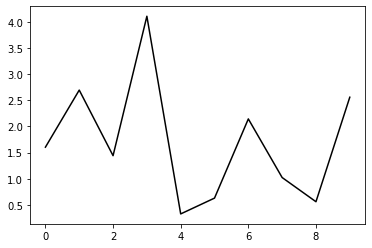

In [4]:
h=tf.zeros(layer)
h_in=[]
for i in range (layer):
    h_inn=np.float64(np.random.normal(2, 1))
    h_in.append(h_inn)
h=tf.Variable(h_in)
m2=tf.Variable(np.float64(np.random.normal(2, 1)))
lam=tf.Variable(np.float64(np.random.normal(1, 1)))
alpha=tf.Variable(np.float64(np.random.uniform(-0.5, 0.5)))
beta=tf.Variable(np.float64(np.random.uniform(-0.5, 0.5)))
#m2=tf.constant(np.float64(5.6))
#lam=tf.constant(np.float64(0.61))
#alpha=tf.constant(np.float64(1.444635))
#beta=tf.constant(np.float64(0.00615))
print("m^2=", m2)
print("lam=", lam)
print("alpha=", alpha)
print("beta=", beta)
print(h)
plt.plot(h.numpy(), 'k-')
plt.show()

In [5]:
def F_func(m, la, a,b):
    return 2*b/n_fin-m*a-la*(a**3)

def t_func(a):
    return 0.5*(tf.math.tanh(100*(a-0.1))-tf.math.tanh(100*(a+0.1))+2)

In [6]:
x=[i*0.2 for i in range (30)]
y=[0.0, 0.018, 0.035, 0.053, 0.0715, 0.0895, 0.107, 0.125, 0.146, 0.1665, 0.1875, 0.2085, 0.229, 0.25, 0.265, 0.281, 0.296, 0.3115, 0.3275, 0.343, 0.3565, 0.385, 0.4375, 0.5, 0.6, 0.675, 0.735, 0.815, 0.865, 0.885]
y[:]=[2*v for v in y]
fp1 = np.polyfit(x, y, 15)
print(fp1)

[ 1.59046394e-05 -6.81729682e-04  1.31412795e-02 -1.50525136e-01
  1.14052774e+00 -6.02241647e+00  2.27455168e+01 -6.20704699e+01
  1.22166922e+02 -1.71187074e+02  1.66428955e+02 -1.07461552e+02
  4.28229887e+01 -9.20544914e+00  9.55260239e-01 -1.30911492e-04]


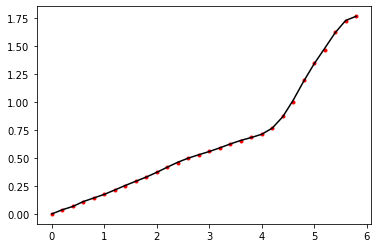

In [7]:
def f(x):
    y=0
    for i in range (16):
        y=y+fp1[i]*x**(15-i)
    return y
yy=[f(i*0.2) for i in range (30)]
plt.plot(x, y, 'r.')
plt.plot(x, yy, 'k-')
plt.show()

In [8]:
def NN_func_p(f):
    Positive=[]
    append=Positive.append
    while len(Positive)<batch:
        H=np.random.uniform(0.0, 6.0)
        M=np.random.uniform(0.0, 2.0)
        noise=np.abs(np.random.normal(0, 0.1))
        if np.abs(M-f(H))<=noise: append([H, M])
        else: continue
    return Positive
def NN_func_n(f):
    Negative=[]
    append=Negative.append
    while len(Negative)<batch:
        H=np.random.uniform(0.0, 6.0)
        M=np.random.uniform(0.0, 2.0)
        noise=np.abs(np.random.normal(0, 0.1))
        if np.abs(M-f(H))>noise: append([H, M])
        else: continue
    return Negative

In [9]:
Positive=[]
Negative=[]
for i in range (set):
    Positive.insert(i, NN_func_p(f))
    Negative.insert(i, NN_func_n(f))

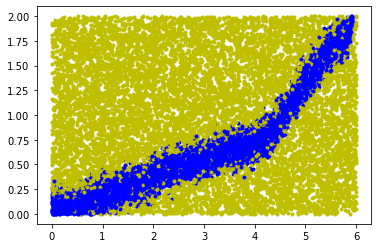

In [10]:
x_data1=[]
y_data1=[]
x_data2=[]
y_data2=[]
for i in range (set):
    x_data1.insert(i, [v[0] for v in Positive[i]])
    y_data1.insert(i, [v[1] for v in Positive[i]])
    x_data2.insert(i, [v[0] for v in Negative[i]])
    y_data2.insert(i, [v[1] for v in Negative[i]])
    plt.plot(x_data2[i], y_data2[i], 'y.')
    plt.plot(x_data1[i], y_data1[i], 'b.')
plt.show()

In [11]:
def Dfunc(hh, m):
    D=tf.math.sqrt(tf.math.abs(1+4*m/(hh[0]**2)))
    return D

In [12]:
def LP2(hh, m, la, alpha, beta, HH, MM):
    D=Dfunc(hh, m)
    phi=alpha*HH+beta*MM
    pi=(d/2)*(D-1)*alpha*HH+(d/2)*(-D-1)*beta*MM
    for j in range (layer-1):
        phi1=phi+dn*pi
        pi1 =phi*m*dn+(1-dn*hh[j])*pi+dn*la*(phi1**3)
        phi=phi1
        pi=pi1
    return phi, pi
def NN_func_01(hh, m, la, alpha, beta, list_hr):
    PP=[]
    NN=[]
    H=np.array(list_hr)[:, 0]
    M=np.array(list_hr)[:, 1]
    F=np.array(tf.math.abs(LP2(hh, m, la, alpha, beta, H, M)[1]))
    for i in range (len(H[F<0.1])):
        PP.append([H[F<0.1][i], M[F<0.1][i]])
    for i in range (len(H[F>=0.1])):
        NN.append([H[F>=0.1][i], M[F>=0.1][i]])
    return PP, NN

In [13]:
Positive0=[]
Positive1=[]
Negative0=[]
Negative1=[]
for i in range (set):
    Positive0.insert(i, NN_func_01(h, m2, lam, alpha, beta, Positive[i])[0])
    Positive1.insert(i, NN_func_01(h, m2, lam, alpha, beta, Positive[i])[1])
    Negative0.insert(i, NN_func_01(h, m2, lam, alpha, beta, Negative[i])[0])
    Negative1.insert(i, NN_func_01(h, m2, lam, alpha, beta, Negative[i])[1])

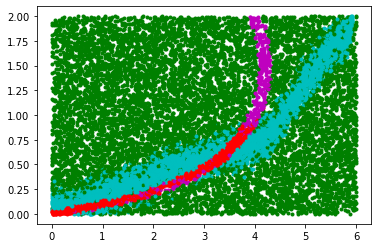

In [14]:
x_data1=[]
y_data1=[]
x_data2=[]
y_data2=[]
x_data3=[]
y_data3=[]
x_data4=[]
y_data4=[]
for i in range (set):
    x_data1.insert(i, [v[0] for v in Positive0[i]])
    y_data1.insert(i, [v[1] for v in Positive0[i]])
    x_data2.insert(i, [v[0] for v in Positive1[i]])
    y_data2.insert(i, [v[1] for v in Positive1[i]])
    x_data3.insert(i, [v[0] for v in Negative0[i]])
    y_data3.insert(i, [v[1] for v in Negative0[i]])
    x_data4.insert(i, [v[0] for v in Negative1[i]])
    y_data4.insert(i, [v[1] for v in Negative1[i]])
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

# Error function

$E=\sum_{data} \left\vert y(\bar{x}^{(1)}) - \bar{y} \right\vert+E_{reg}(W)$
, $E_{reg}=c_{reg}^{(1)}\sum_{n=1}^{N-1}(\eta^{(n)})^{4}(h(\eta^{(n+1)})-h(\eta^{(n)}))^{2}+c_{reg}^{(2)}(h(\eta^{(N)})-1/\eta^{(N)})^{2}$

In [26]:
def Error_func(hh, m, la, alpha, beta, list1, list2):
    H0=np.array([v[0] for v in list1])
    M0=np.array([v[1] for v in list1])
    H1=np.array([v[0] for v in list2])
    M1=np.array([v[1] for v in list2])
    H_0, M_0=LP2(hh, m, la, alpha, beta, H0, M0)
    H_1, M_1=LP2(hh, m, la, alpha, beta, H1, M1)
    PPlist=t_func(M_0)
    NNlist=t_func(M_1)
    sum_p=sum(PPlist)/batch
    sum_n=(batch-sum(NNlist))/batch

    inside=0
    for k in range (layer-1):
        second=((n_ini+k*dn)**4)*((hh[k+1]-hh[k])**2)
        inside=inside+second
    E_reg1=c_reg1*inside
    E_reg2=c_reg2*((hh[layer-1]-1/n_fin)**2)
    return sum_n+sum_p+E_reg1+E_reg2

In [16]:
for i in range (set):
    print(Error_func(h, m2, lam, alpha, beta, Positive[i], Negative[i]))

tf.Tensor(0.9911698514710544, shape=(), dtype=float64)
tf.Tensor(1.0553797940064267, shape=(), dtype=float64)
tf.Tensor(0.9437050770027098, shape=(), dtype=float64)
tf.Tensor(1.0246899687726552, shape=(), dtype=float64)
tf.Tensor(0.9593685004282622, shape=(), dtype=float64)
tf.Tensor(0.9623796871739194, shape=(), dtype=float64)
tf.Tensor(1.0289097056280212, shape=(), dtype=float64)
tf.Tensor(1.0195560394583818, shape=(), dtype=float64)
tf.Tensor(0.9792056040015341, shape=(), dtype=float64)
tf.Tensor(0.954342118184434, shape=(), dtype=float64)
tf.Tensor(0.935542911007283, shape=(), dtype=float64)
tf.Tensor(0.9806546584166009, shape=(), dtype=float64)
tf.Tensor(0.975211312366805, shape=(), dtype=float64)
tf.Tensor(0.9663092005908228, shape=(), dtype=float64)
tf.Tensor(0.9550461740170876, shape=(), dtype=float64)
tf.Tensor(0.9398378361586697, shape=(), dtype=float64)
tf.Tensor(1.018306574597933, shape=(), dtype=float64)
tf.Tensor(0.9791033871918889, shape=(), dtype=float64)
tf.Tensor(0.94

# Optimize

0 0.96079349932929
1.0280074411299758 -0.6854518676496986 -0.2303146872739331 -0.20047707127264763
[1.65297174 2.64343125 1.49046328 4.05380722 0.27819734 0.58017069
 2.09269991 0.97300966 0.51093481 2.60710633]


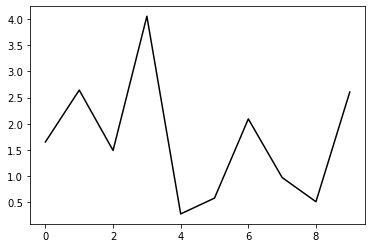

1100 0.8710674237041772
0.9859704587353275 -0.7136554909338136 -0.259094830128048 -0.15999608159930398
[1.50456117 2.28714183 1.93991976 3.59442976 0.42101091 0.31562758
 1.70584738 0.57418332 0.02742881 3.14317825]


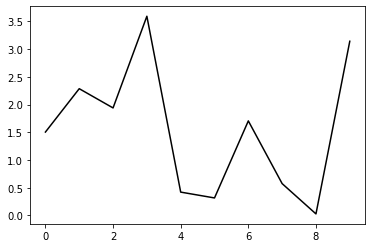

2200 0.7664997194257841
0.9649189506212208 -0.7019328649201472 -0.239479861734689 -0.1507691716196017
[ 1.58229015  1.96917908  1.94858934  3.12370876  0.35284789 -0.03349568
  1.25024639  0.10870104 -0.47746059  3.65958185]


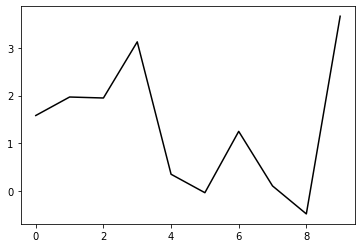

3300 0.5584825454525333
0.9667579645689323 -0.6714814563537884 -0.20663553416165392 -0.12007903921790226
[ 1.60339063  1.75599991  1.83226432  2.66900123  0.14980012 -0.46484118
  0.70514247 -0.48023668 -1.10175766  4.1609863 ]


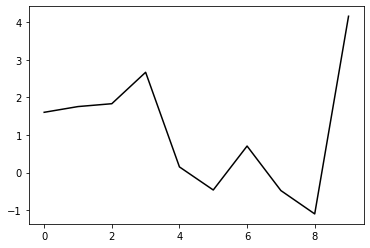

4400 0.2735469587889686
0.9901243955048332 -0.6278345133438168 -0.16813711578014226 -0.09149281105964419
[ 1.52802718  1.75929208  1.84767717  2.3775272   0.06026364 -0.73245544
  0.28160679 -0.98333616 -1.67223441  4.64987569]


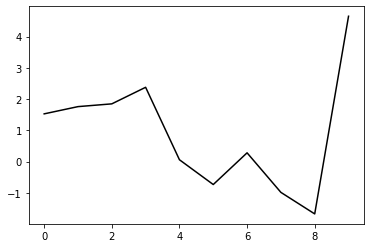

5500 0.21416448565131266
1.00792889523239 -0.6151359673883773 -0.16078211817994886 -0.09022632999434287
[ 1.4478977   1.84391351  1.99302483  2.34169413  0.27781248 -0.56701272
  0.37326939 -0.85400481 -1.56226179  5.13231261]


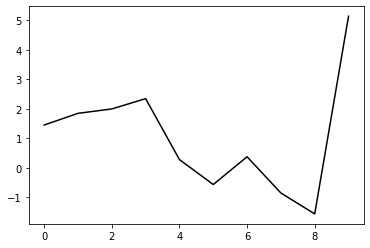

6600 0.19226461900555927
0.984168712271208 -0.6201713167565152 -0.16332374837126692 -0.08437169136430032
[ 1.47063893  1.74664379  1.92113985  2.1249164   0.25428408 -0.65629531
  0.17530918 -1.06499815 -1.83387374  5.6066495 ]


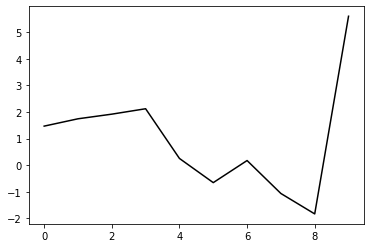

7700 0.15099210547663738
0.9956823632301355 -0.6164309738581697 -0.16326766191122402 -0.0848235319509061
[ 1.4197017   1.79505517  1.99358765  2.08827204  0.41770942 -0.51708267
  0.24448835 -0.94991195 -1.72481071  6.07226402]


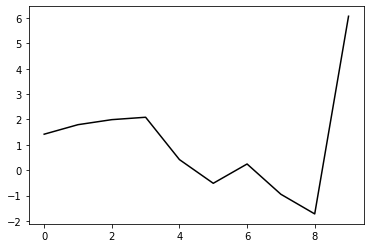

8800 0.1705746128126293
1.0042433724429212 -0.6089147389645247 -0.1567556626985327 -0.08999832025639498
[ 1.4571176   1.74023247  1.95205203  1.94643438  0.48833891 -0.46892486
  0.18895469 -0.94893061 -1.70924923  6.52536541]


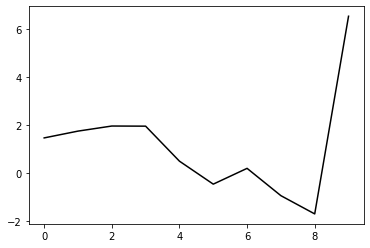

9900 0.22797367971057683
0.997794141627001 -0.6154623430567135 -0.16274731749782118 -0.09015540310487671
[ 1.38870143  1.77966485  1.99269792  1.9223277   0.67648886 -0.28022637
  0.26444991 -0.83134231 -1.62981088  6.95872353]


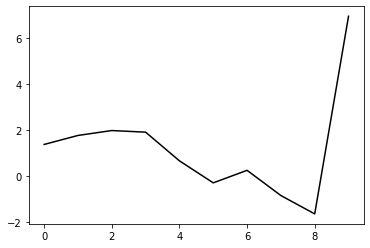

11000 0.22103287532444246
0.9846203380951601 -0.615184642780649 -0.16053844785297344 -0.0887663314147847
[ 1.41639549  1.72138214  1.91198306  1.79547344  0.66452043 -0.30971941
  0.11585171 -0.98353969 -1.81879714  7.36209746]


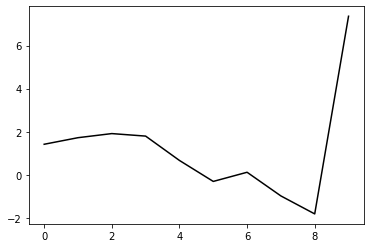

12100 0.26032504884962404
0.9816148531348097 -0.6152186033378997 -0.1604362090198273 -0.08898443534397989
[ 1.46197034e+00  1.62590214e+00  1.80518248e+00  1.66390940e+00
  6.35443493e-01 -3.37576061e-01 -5.30850559e-03 -1.07987006e+00
 -1.90799411e+00  7.72755342e+00]


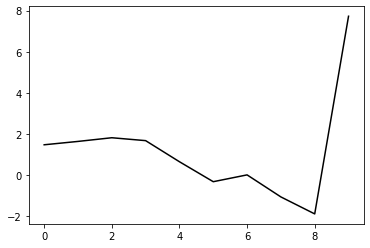

13200 0.19836845464488276
0.9844245804591649 -0.6132662519471692 -0.15951996916629957 -0.09154690749004103
[ 1.41894335  1.68889698  1.86055621  1.71665877  0.78749238 -0.15882166
  0.11356804 -0.91600532 -1.74246809  8.03025426]


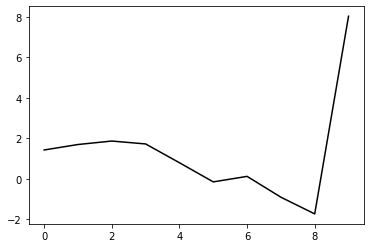

14300 0.17362029110244093
0.9905754968383879 -0.61064670591549 -0.1593717334723409 -0.09180904930987008
[ 1.38274496  1.69099208  1.85507943  1.71187942  0.89003406 -0.02716496
  0.16179335 -0.83174591 -1.6662987   8.2583419 ]


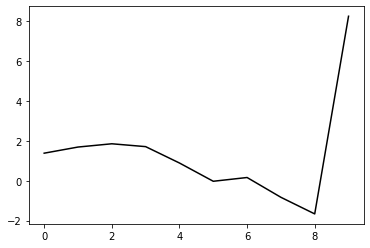

15400 0.20869817875110072
0.9596175200331941 -0.6197345352929009 -0.16292070905155692 -0.08778648140596686
[ 1.41468646  1.60399726  1.74060117  1.58390121  0.81715859 -0.10166158
 -0.02638493 -1.03585683 -1.89640787  8.34734441]


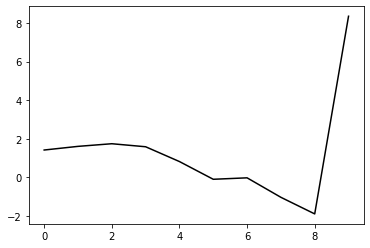

16500 0.21587714357457402
0.9799317822403651 -0.6101944922472531 -0.15806557153691672 -0.09268606468656432
[ 1.41576163  1.62612136  1.75827852  1.60929375  0.89763371  0.00853822
  0.04799578 -0.92550009 -1.76588912  8.37497709]


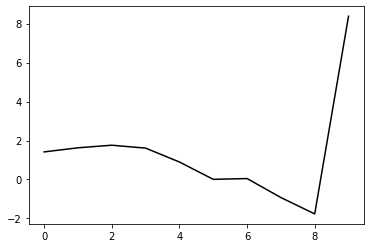

17600 0.19462091017481964
0.9786418253515216 -0.6089998418095891 -0.15715748095237675 -0.09346515603921743
[ 1.41668311  1.60010866  1.72582272  1.58239434  0.92929619  0.07200287
  0.04508324 -0.90442986 -1.74875816  8.37647805]


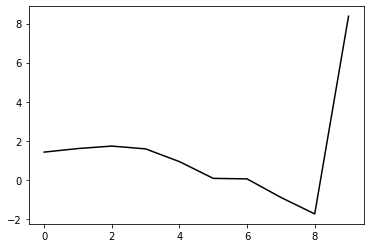

18700 0.1289598827779556
0.965999375168556 -0.6133551784150779 -0.15940473082224543 -0.09299571911091592
[ 1.38219027  1.61346315  1.7279042   1.58464474  0.9683632   0.12518644
  0.01483792 -0.95635308 -1.83961619  8.36370189]


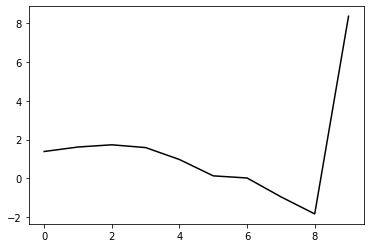

19800 0.18919617119411844
0.9636634379236425 -0.6140790436431924 -0.16134192025562052 -0.09034749559302661
[ 1.35471888  1.62625691  1.7347087   1.5930371   1.00877487  0.18520939
  0.01491729 -0.95847322 -1.86923443  8.36391798]


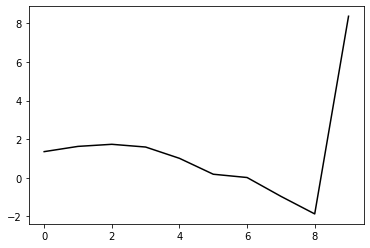

20900 0.24297747127422933
0.9624687373394675 -0.6127620030767548 -0.15975759629367534 -0.09307809409864996
[ 1.32788894  1.62370327  1.728532    1.59367744  1.04471347  0.24431241
  0.00948337 -0.97391817 -1.90185731  8.37141243]


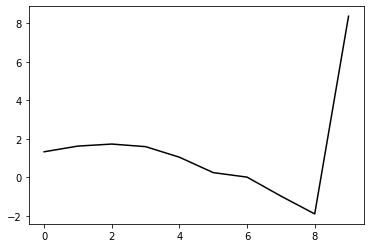

22000 0.2430371817731363
0.9579380925842238 -0.6140112841330689 -0.15977404039032655 -0.09526581291656262
[ 1.40169931  1.53349284  1.62933784  1.50539306  0.99790022  0.23287145
 -0.0422485  -0.99414915 -1.886372    8.36023066]


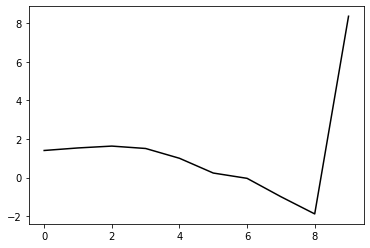

23100 0.3740512371459066
0.9604177455952772 -0.6094349816766677 -0.15649394649490628 -0.09628210207954449
[ 1.44932844  1.46969658  1.55853739  1.44286087  0.97424707  0.24289943
 -0.07928149 -1.01510697 -1.90294982  8.33884822]


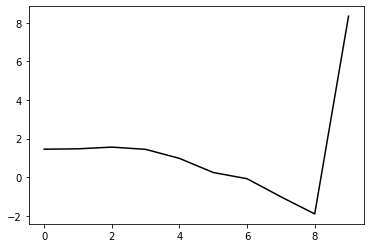

24200 0.19248715102454425
0.9591306116746904 -0.6087380590624475 -0.15666372062534048 -0.0965092216270677
[ 1.41101947  1.52382882  1.60839792  1.50980196  1.08516882  0.39734429
  0.0496753  -0.86601631 -1.76789295  8.38060975]


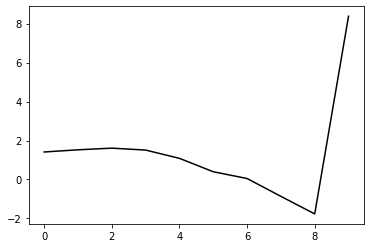

25300 0.18035415871164104
0.9467278140254055 -0.609519472706292 -0.15615022126295447 -0.09384987020041484
[ 1.38419134  1.50742717  1.57108542  1.45733888  1.02958561  0.33040879
 -0.09247093 -1.0599826  -2.01457315  8.33413859]


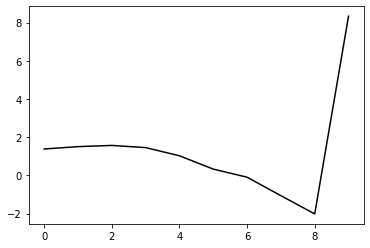

26400 0.20212348402614397
0.9530531474917556 -0.6060191521848147 -0.1543424218101231 -0.09599510800832797
[ 1.39293699  1.51041061  1.57992534  1.47738264  1.07984585  0.41379284
 -0.02428866 -0.96769033 -1.9018991   8.3814174 ]


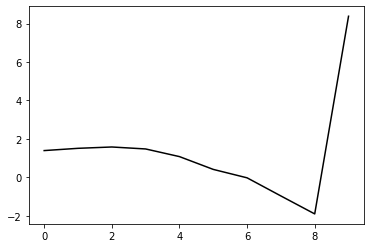

27500 0.21907208333478856
0.9472562460061688 -0.6086249347289244 -0.1556866976439791 -0.09738264278175365
[ 1.38069678  1.52006131  1.59702487  1.50445939  1.13014159  0.48880707
  0.0308305  -0.90400202 -1.83180841  8.37187687]


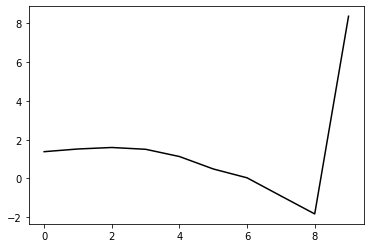

28600 0.16399237388043802
0.9376154999505913 -0.6135615138931743 -0.15885054410455418 -0.09662188087378179
[ 1.37253603  1.5094862   1.58421512  1.50036662  1.14767677  0.5266344
  0.03095398 -0.9212637  -1.86589391  8.40280137]


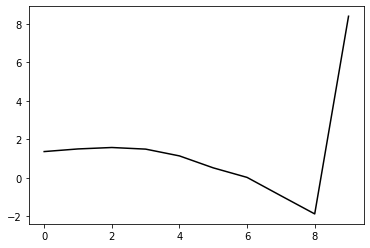

29700 0.13972232983346325
0.9315092493189796 -0.6149091664229966 -0.15964912070809129 -0.09609187850827419
[ 1.33891387e+00  1.50478087e+00  1.56890697e+00  1.48526501e+00
  1.14651570e+00  5.37654008e-01 -4.92477185e-03 -9.85161749e-01
 -1.97189208e+00  8.34791890e+00]


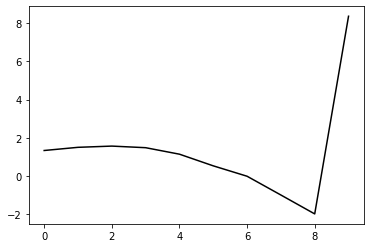

30800 0.19284097198423963
0.9336142161433214 -0.6099904021918297 -0.15609135989961173 -0.09845524321905717
[ 1.42251656e+00  1.44533405e+00  1.50557865e+00  1.43264627e+00
  1.11725388e+00  5.36475524e-01 -6.00453037e-03 -9.63751990e-01
 -1.91928160e+00  8.35935830e+00]


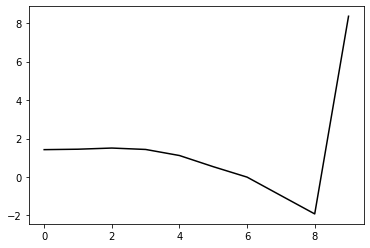

31900 0.18290788901454186
0.9199222482573775 -0.6134407906486705 -0.1588371137780899 -0.09517963272497548
[ 1.37035149  1.47111053  1.5092673   1.42302613  1.09932318  0.50624537
 -0.08300555 -1.08241772 -2.0833529   8.34730659]


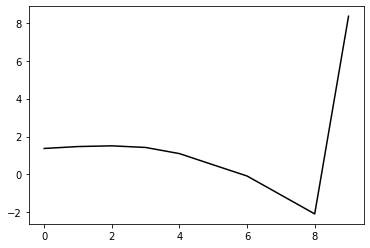

33000 0.22813332319525279
0.9277693604234475 -0.6088954350116785 -0.15714644983510184 -0.09537332428855677
[ 1.37683875  1.46979096  1.51316323  1.43214263  1.12542365  0.55329134
 -0.04168713 -1.03314597 -2.0309947   8.31736173]


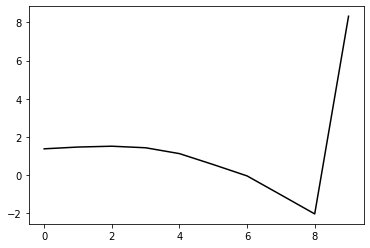

34100 0.24871596531165194
0.9216670863089088 -0.6097217675632649 -0.15720720337624697 -0.09549567850340114
[ 1.40554958  1.41646486  1.46430825  1.38886281  1.0970697   0.54276133
 -0.06206746 -1.04991943 -2.04366971  8.33110353]


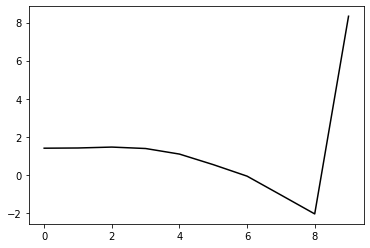

35200 0.1788514281545499
0.9319696683287572 -0.6021596061092973 -0.1532598964456733 -0.09685859619822867
[ 1.36223248  1.48715553  1.53888017  1.47145423  1.19797526  0.66661382
  0.05697323 -0.92587472 -1.92264492  8.37833743]


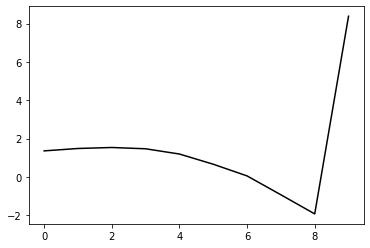

36300 0.17882198883896372
0.8986968524939981 -0.617377923061731 -0.16027442110874007 -0.09636996937543459
[ 1.36832442  1.44125598  1.48771266  1.41651303  1.14059202  0.60315307
 -0.04321105 -1.07089825 -2.12128935  8.36477806]


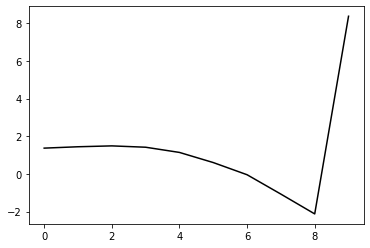

37400 0.19370984395590374
0.915519271832374 -0.6088859828914149 -0.15743959320918205 -0.09613454314035362
[ 1.33836319  1.49542924  1.54478414  1.47971581  1.21852826  0.70118581
  0.05708773 -0.95967401 -2.00158969  8.31223475]


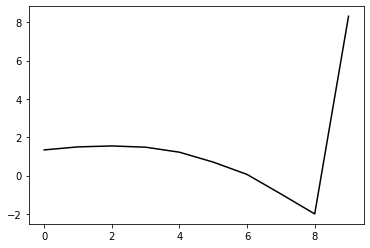

38500 0.2129431799978141
0.9031015550916786 -0.6118542710401802 -0.15805065614675776 -0.0962673005621978
[ 1.36231706  1.44640415  1.4897142   1.42292933  1.16439765  0.65075265
 -0.01555456 -1.04533271 -2.08274376  8.33225258]


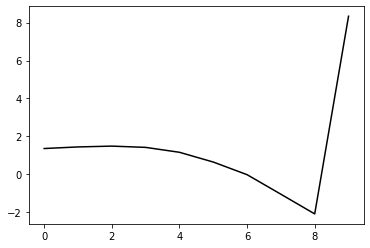

39600 0.16193656062772843
0.9092978428882337 -0.6079145616857143 -0.1562992569033762 -0.0979832018985836
[ 1.33784227  1.47806242  1.52375774  1.46202441  1.21589137  0.71900056
  0.05047005 -0.97880289 -2.02121216  8.31630172]


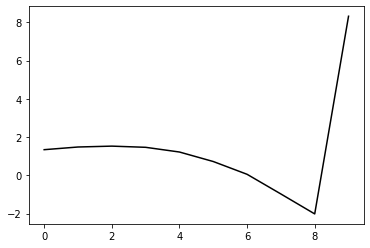

40700 0.1437884179714836
0.8934648854198273 -0.6117063519433101 -0.15757996699457688 -0.0989397793832666
[ 1.38048777  1.41753446  1.44850324  1.37772712  1.12262874  0.61340208
 -0.08521962 -1.12819289 -2.14944969  8.32386852]


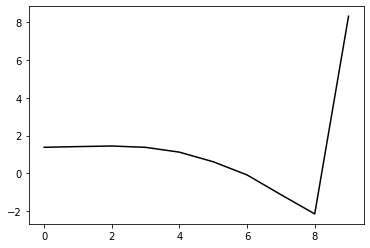

41800 0.1819193317987988
0.9063147357351421 -0.6049735497661162 -0.15468740271597817 -0.10150676763571383
[ 1.39395427  1.43402167  1.47894277  1.42152821  1.18714178  0.70366069
  0.02113284 -1.00339099 -2.01103343  8.31124875]


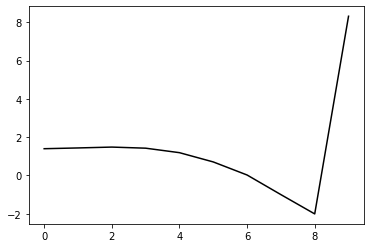

42900 0.1880451274146164
0.8923993393494066 -0.6140331318159372 -0.16150808843714856 -0.0978263488733719
[ 1.3564295   1.42730053  1.47229546  1.41933726  1.19233692  0.71568539
  0.0213933  -1.02044485 -2.04871244  8.3429146 ]


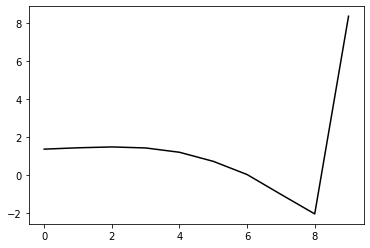

44000 0.22853084264534396
0.8987201908588304 -0.6049279540155101 -0.1563383571080746 -0.09738738658649909
[ 1.36104343e+00  1.43212001e+00  1.46657348e+00  1.40678110e+00
  1.17730008e+00  6.99783401e-01 -7.89300897e-03 -1.06799290e+00
 -2.12322665e+00  8.33563012e+00]


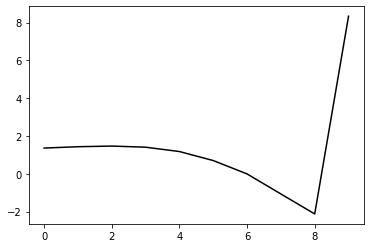

45100 0.21566758697688757
0.8863779558994052 -0.6092359245352508 -0.15884025432682636 -0.09510826560221033
[ 1.3661882   1.39216935  1.42739163  1.36679527  1.13907251  0.66443676
 -0.05169783 -1.12052761 -2.18036577  8.34309997]


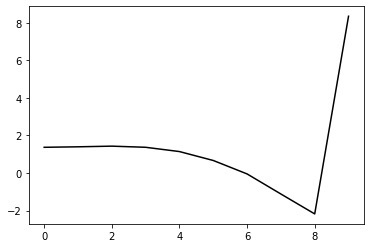

46200 0.18414083494442482
0.8984911472880942 -0.6027027060280639 -0.1551704291358454 -0.10031498299912846
[ 1.3789763   1.44176751  1.49097129  1.45510111  1.26143057  0.82728894
  0.14058874 -0.90479402 -1.95478698  8.34648339]


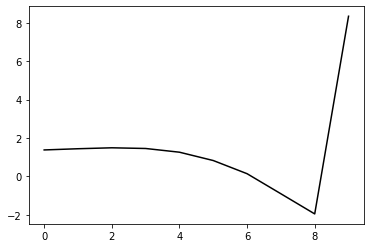

47300 0.17483916315785908
0.8852238970560776 -0.6074355663309607 -0.15833924153262638 -0.09627052076972505
[ 1.34273082  1.41717447  1.44986728  1.39778034  1.18842379  0.73747471
  0.01836427 -1.0600373  -2.12898706  8.33894229]


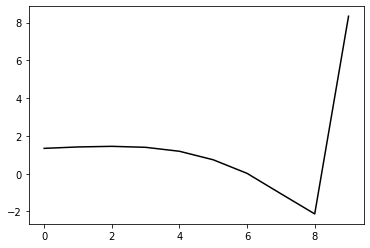

48400 0.18493734158525615
0.8975774160750881 -0.599303226390098 -0.1541066397508162 -0.09763490585073749
[ 1.36075351  1.4180521   1.45687732  1.41229686  1.22114512  0.79749159
  0.09690239 -0.96754914 -2.03023936  8.29008944]


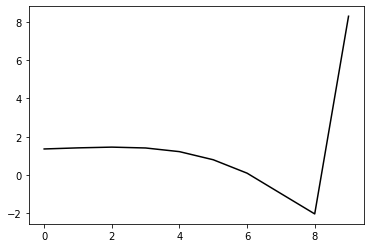

49500 0.21125542306331585
0.8650366109079528 -0.6110912108014075 -0.15880692971182925 -0.09644679497118189
[ 1.37290215e+00  1.37590756e+00  1.40736319e+00  1.36008206e+00
  1.16304715e+00  7.28202598e-01  3.26984246e-03 -1.08685895e+00
 -2.16841988e+00  8.32664454e+00]


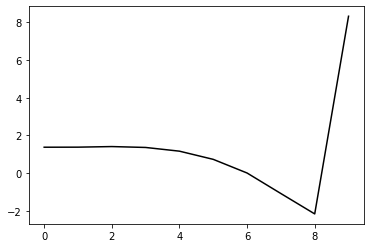

50600 0.15741087763880346
0.8870661956490317 -0.6004267887016494 -0.15454743206548432 -0.09866357478780495
[ 1.33629879  1.45065777  1.48870116  1.44808074  1.26251477  0.84216789
  0.12700198 -0.9584684  -2.04195153  8.34062718]


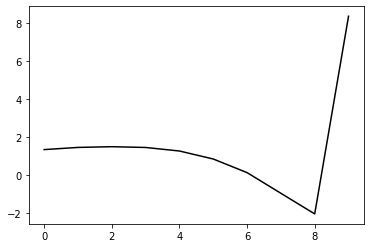

51700 0.1227942308615744
0.8760433519575642 -0.6037712404473652 -0.15610624077253094 -0.0986760410781295
[ 1.3628602   1.40501208  1.44307136  1.40590476  1.22650497  0.81469393
  0.10215634 -0.9854528  -2.07074288  8.34392249]


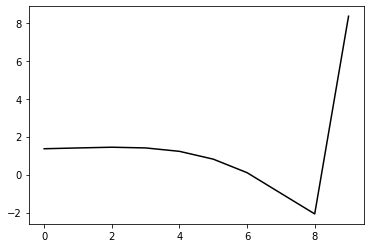

52800 0.13423660718328195
0.882001531702876 -0.5992218971407877 -0.15430016581353223 -0.09766056078034986
[ 1.35883686  1.39810264  1.43667207  1.39716729  1.21934007  0.81296457
  0.10202612 -0.98616681 -2.06971433  8.33806001]


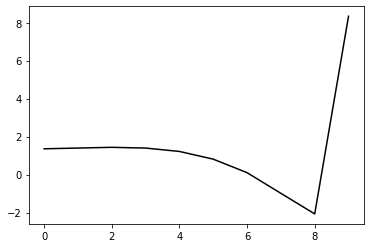

53900 0.20736666684866367
0.8733905852916091 -0.6023742760066266 -0.1560100084267357 -0.09680490823815184
[ 1.3012917   1.41894677  1.4479627   1.3992312   1.20952862  0.78787209
  0.05111679 -1.0655516  -2.16268352  8.32664904]


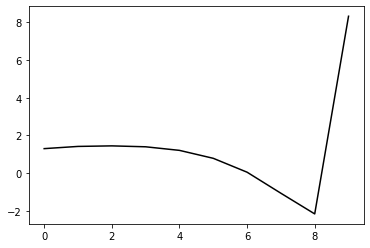

55000 0.21400274807307182
0.8742422906876571 -0.6042703545826 -0.158275976016337 -0.09859645161477483
[ 1.33603543  1.41527131  1.45634847  1.42811203  1.26634933  0.87763877
  0.16976481 -0.92598082 -2.01168697  8.31323575]


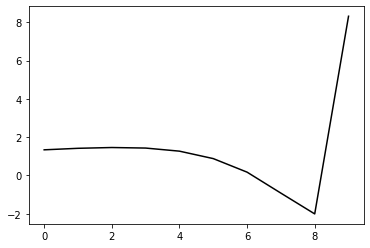

56100 0.2056372581481031
0.8594460463996509 -0.6029761238936692 -0.15595938831440295 -0.09554728439664922
[ 1.34454375  1.38471302  1.40588045  1.3562228   1.17157268  0.75766031
  0.01809012 -1.11261921 -2.22204248  8.33421466]


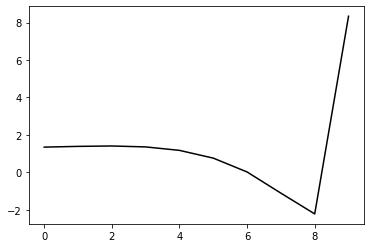

57200 0.19284326729636117
0.8680328980410321 -0.5982788938769279 -0.1526986674072288 -0.10068806797694373
[ 1.3615689   1.40774897  1.44091301  1.40661156  1.24345614  0.85708688
  0.14443705 -0.96471456 -2.05810264  8.33375039]


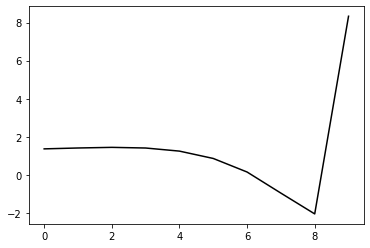

58300 0.18274051521157822
0.8642026517673703 -0.5980022392241946 -0.15298844068077855 -0.09838336897695286
[ 1.34302643  1.38540374  1.40966278  1.36268729  1.18699379  0.78979174
  0.06393623 -1.06119807 -2.16351931  8.33416294]


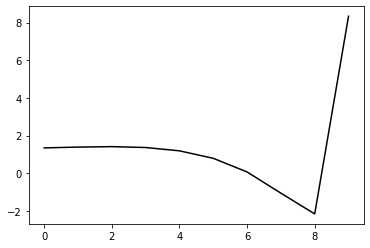

59400 0.1911028266273009
0.8614936237145038 -0.5965402293539898 -0.1510978758853368 -0.10066231833899174
[ 1.33829225  1.41191235  1.44019811  1.39469269  1.22168102  0.82874557
  0.10498926 -1.02097989 -2.12160663  8.28306711]


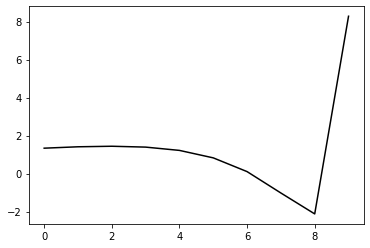

60500 0.2149091547251446
0.8529389407717339 -0.6003730192894291 -0.15357439032529135 -0.10011020521876092
[ 1.33935171  1.39429563  1.42637838  1.37849906  1.2019995   0.80551733
  0.07464646 -1.06455474 -2.17282928  8.34218178]


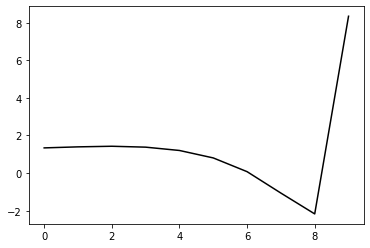

61600 0.15801936937228309
0.856924811746611 -0.5971697654706328 -0.1523244636660697 -0.10031736813475464
[ 1.30672076  1.42574924  1.46588962  1.42448414  1.25541529  0.86911775
  0.14540992 -1.00024549 -2.12787947  8.29883787]


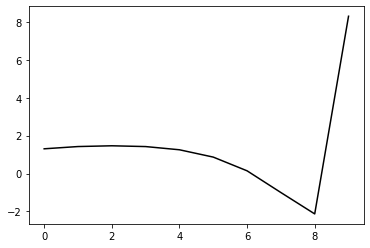

62700 0.11851567229538129
0.853742528455058 -0.5975728852801295 -0.1522975653570432 -0.10113136846603711
[ 1.31904592  1.40062716  1.44117941  1.40308325  1.23723793  0.85656023
  0.13900509 -1.00284118 -2.12346188  8.32913351]


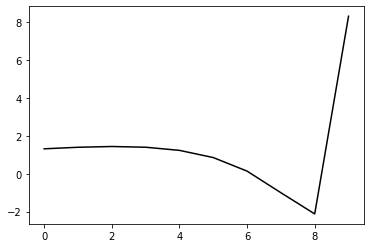

63800 0.13608608573026254
0.8497703247741327 -0.5966235508843267 -0.15157293387057152 -0.10160720146244726
[ 1.32721247  1.38761566  1.42466495  1.3896139   1.22839478  0.85474838
  0.1448067  -0.99436782 -2.11925318  8.32118341]


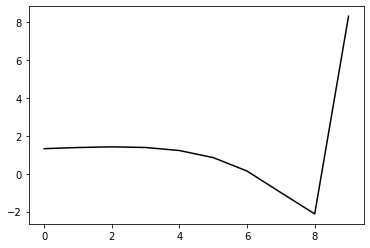

64900 0.18847540355272585
0.839471213440323 -0.6007463002915862 -0.15381481979650735 -0.10192253045815912
[ 1.30439089  1.39673939  1.43766136  1.40413806  1.24408949  0.87009812
  0.15487695 -1.000616   -2.14830293  8.32584089]


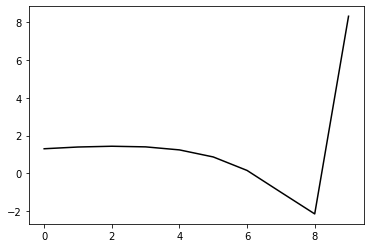

66000 0.20295589334528724
0.8510265842448698 -0.5940921041723815 -0.15176595716493296 -0.10116020986228293
[ 1.29703758  1.41097695  1.46208705  1.43614388  1.28611284  0.92521437
  0.22465893 -0.91907913 -2.05895439  8.32056472]


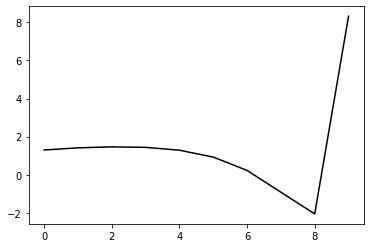

67100 0.20207828967026353
0.8243287983887769 -0.6026307826092968 -0.15424821592955096 -0.10086859949789209
[ 1.32847412  1.34463698  1.38850348  1.35693982  1.19805569  0.82516359
  0.10718101 -1.0636962  -2.23438409  8.34472719]


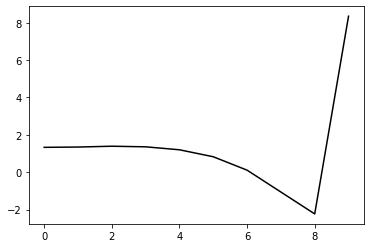

68200 0.1800248169703446
0.8378422903161756 -0.594535116025641 -0.1503645707434921 -0.10297981430372609
[ 1.32348108  1.38524664  1.43495621  1.41698404  1.27626129  0.92569905
  0.23203879 -0.91978458 -2.08217897  8.32581942]


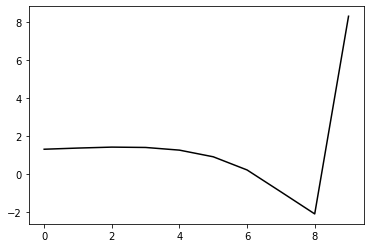

69300 0.17618893044055473
0.8225584385870107 -0.6025833841272271 -0.15593181902550543 -0.09957747434777063
[ 1.30991201  1.34807841  1.38180899  1.35643601  1.20798488  0.84799148
  0.14373867 -1.01962726 -2.18669742  8.33628795]


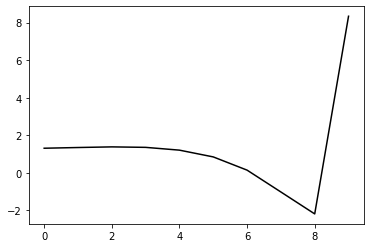

70400 0.20427420781676847
0.8185570754429768 -0.6010022943682108 -0.15502272573922346 -0.09823000024953825
[ 1.32502318  1.33562284  1.35535565  1.32080512  1.16788419  0.80404604
  0.09215997 -1.08955968 -2.28099903  8.2768367 ]


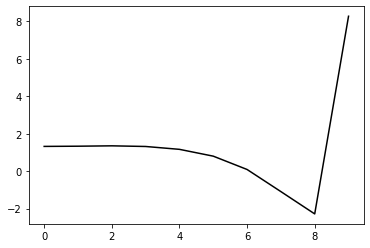

71500 0.2861288488872743
0.8291177297168315 -0.5946034407564433 -0.15230780405618022 -0.09884635240584728
[ 1.24180534  1.4511957   1.47610349  1.44611344  1.30248935  0.95045588
  0.24887318 -0.93354876 -2.14569426  8.3721658 ]


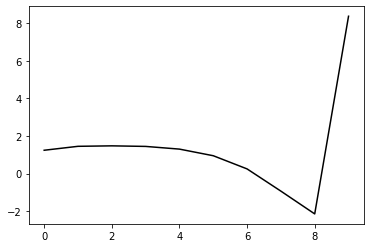

72600 0.15977577803360798
0.8187830621836544 -0.5955603770899157 -0.150908046153154 -0.10215809685841303
[ 1.31268053  1.3719007   1.39900762  1.36452656  1.2177327   0.86480037
  0.16442718 -1.01518352 -2.21446547  8.30625816]


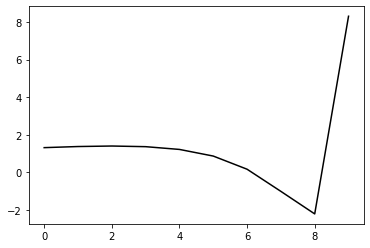

73700 0.16524216863483063
0.818998870630382 -0.5957619634706756 -0.15261608032001855 -0.0999760641408945
[ 1.24512623  1.43157031  1.46767298  1.43573221  1.29128993  0.94168995
  0.24150281 -0.9505216  -2.17738555  8.34470074]


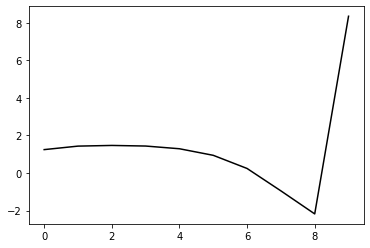

74800 0.12943992025582296
0.8173417432332821 -0.5949645559738083 -0.15189931332802234 -0.1019586557491775
[ 1.31149402  1.35924564  1.4029367   1.38143756  1.25030277  0.9209611
  0.24847112 -0.91362698 -2.11399337  8.32727231]


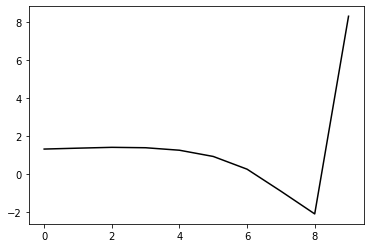

75900 0.191363959943402
0.8168114118013465 -0.5940753932690522 -0.15209833884425739 -0.10226610535089325
[ 1.3013797   1.36631131  1.40910848  1.39174238  1.26490876  0.94056989
  0.27318393 -0.88667164 -2.08727555  8.30972932]


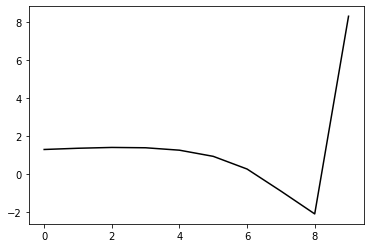

77000 0.227064319203844
0.8059670457150057 -0.5961052139492936 -0.1541615721593252 -0.09763534133919524
[ 1.26543413  1.38073095  1.41137111  1.38590689  1.25004281  0.91464093
  0.23233185 -0.95145557 -2.18505355  8.31285556]


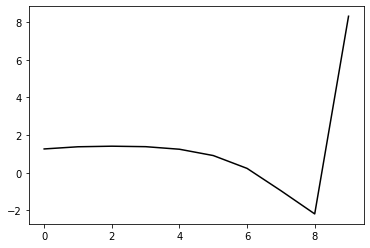

78100 0.21575051466917836
0.8038787043084996 -0.5943969145593017 -0.1526180575223439 -0.10132888511288152
[ 1.33628092  1.33945503  1.37296179  1.35680594  1.23503864  0.91786206
  0.25759461 -0.90339359 -2.11381079  8.33606228]


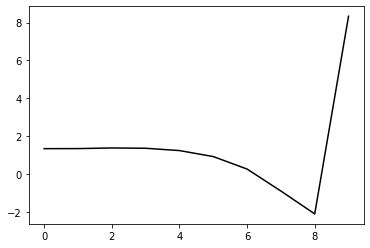

79200 0.22826859204102684
0.8041814799978972 -0.5942667172241053 -0.15435762182190327 -0.09801063125729563
[ 1.26147319  1.40544176  1.44001285  1.42045341  1.29619937  0.97672873
  0.31361399 -0.85419742 -2.07671482  8.33403752]


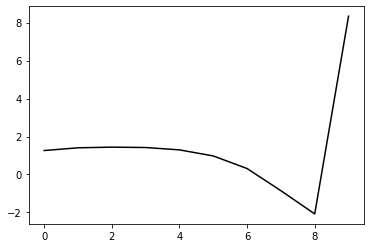

80300 0.18479868342126915
0.788056022335048 -0.5985992609462546 -0.1559161478469454 -0.09862128137925562
[ 1.2696338   1.35446748  1.37547331  1.34895137  1.21788649  0.8919596
  0.22233901 -0.95466777 -2.18892158  8.34113607]


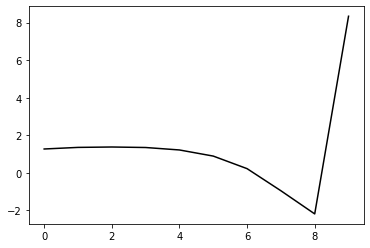

81400 0.21783573207231882
0.7900535758971645 -0.5954456545073409 -0.15553929908610512 -0.0967743036750758
[ 1.28531886  1.36980465  1.37962084  1.34446329  1.20642116  0.87304477
  0.19414836 -0.99576373 -2.24008024  8.26403207]


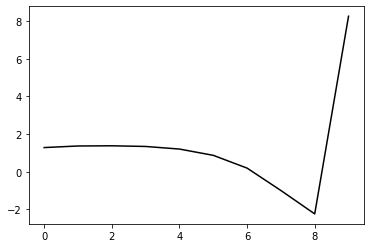

82500 0.20842780012008172
0.802159775538295 -0.5849432608162278 -0.14882013036560576 -0.10151015591685354
[ 1.29019377  1.38814161  1.41534771  1.38949595  1.26532842  0.95133208
  0.29641772 -0.87075234 -2.10460587  8.35474197]


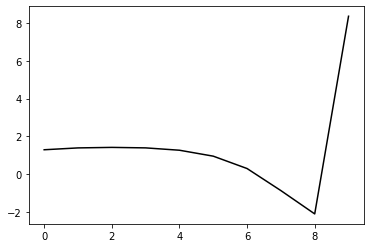

83600 0.21438028909286436
0.7921881670927411 -0.5883351902175324 -0.15006259997101 -0.10277436804653999
[ 1.33340558  1.32627516  1.35155423  1.32324981  1.19656001  0.88279946
  0.23221608 -0.92665953 -2.14621309  8.31566866]


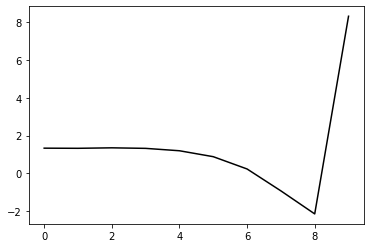

84700 0.12315269522250612
0.7934170693891849 -0.5878028016280525 -0.15142464404589756 -0.10064687722510766
[ 1.29297482  1.36257193  1.39323518  1.36484538  1.23724667  0.92297651
  0.27083444 -0.89570978 -2.13108098  8.32732333]


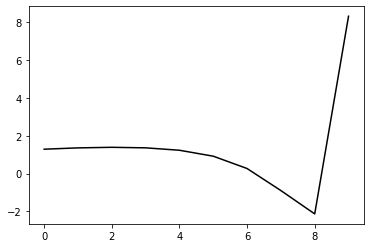

85800 0.12874939588780335
0.7887443424357058 -0.5915148989859212 -0.1534015179103078 -0.10430908700148955
[ 1.30696165  1.38393601  1.42879168  1.42354385  1.32015372  1.02810215
  0.39196865 -0.76779645 -2.00494179  8.32313442]


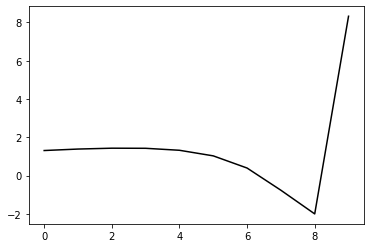

86900 0.23060672752116856
0.7904244379442817 -0.5871424222187824 -0.15201027712226742 -0.10119813341094594
[ 1.25449544  1.41427062  1.45289426  1.43363104  1.31521786  1.00975181
  0.363086   -0.80813056 -2.0621007   8.35808143]


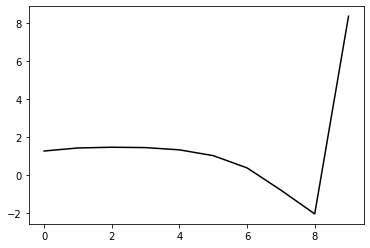

88000 0.24271047265322232
0.7764937849254817 -0.5917502437722061 -0.15490496766054068 -0.09960776166657685
[ 1.25397624  1.39426145  1.42092063  1.39844103  1.27644973  0.96737991
  0.31677031 -0.8619173  -2.12836092  8.31526111]


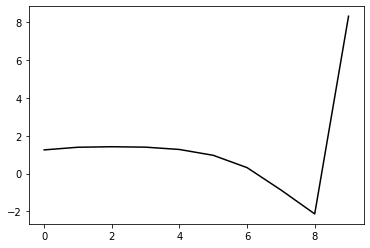

89100 0.20851190276269527
0.7820786459249961 -0.582404503303753 -0.14863686839242227 -0.10144686620705128
[ 1.30454437  1.36253053  1.38628988  1.35456813  1.2238856   0.90688519
  0.250069   -0.93315155 -2.19913809  8.32436676]


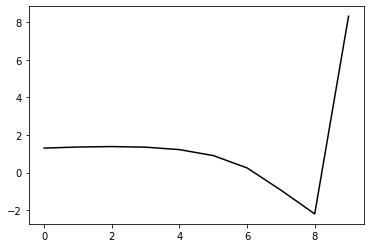

90200 0.1818785226521649
0.7787380347741312 -0.5831619579106171 -0.14917065636952584 -0.10268489880258964
[ 1.28879033  1.37296491  1.4120085   1.38962729  1.26737699  0.96011982
  0.31469174 -0.85731106 -2.11726012  8.31489658]


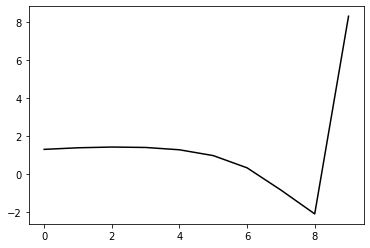

91300 0.17143860729854696
0.7818666052815825 -0.5798277680011625 -0.14850973956522057 -0.10075077345720757
[ 1.24737169  1.39808128  1.43161434  1.4027184   1.27098621  0.95231176
  0.29331058 -0.89708157 -2.18180506  8.35098759]


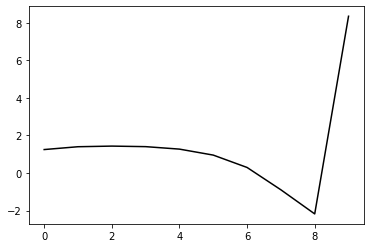

92400 0.20858701306389804
0.7640923878771981 -0.5891826094923892 -0.15458167728751948 -0.09888710907292778
[ 1.27401439  1.33990713  1.37517171  1.35337673  1.22811717  0.91747427
  0.27058905 -0.90400462 -2.17151927  8.28846435]


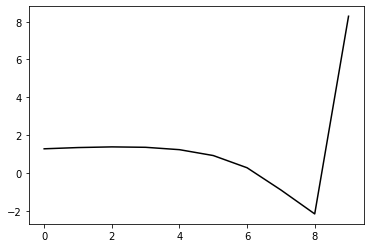

93500 0.19607298527658953
0.7813623632980603 -0.5791162651461905 -0.14956087946166532 -0.10153020398982561
[ 1.28638422  1.38609054  1.43445198  1.42815901  1.3223165   1.03311019
  0.40802253 -0.74986222 -2.01226466  8.37767709]


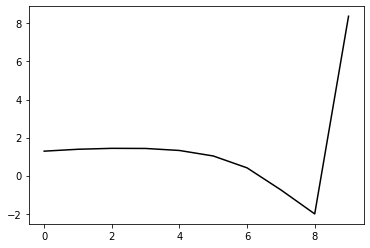

94600 0.2008214520739299
0.7754181457994546 -0.5787189546317113 -0.14891758640376643 -0.10179921743735383
[ 1.32199447  1.30829888  1.35826361  1.34188939  1.2225245   0.91863442
  0.28105365 -0.88389208 -2.1432514   8.31579464]


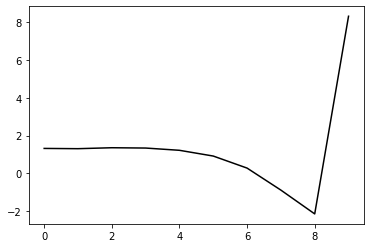

95700 0.12426966890201373
0.7680211310176047 -0.5800084408004157 -0.14979576375130418 -0.10071084986366913
[ 1.27036842  1.35810836  1.40546926  1.38836031  1.26682919  0.96000649
  0.31834969 -0.85521548 -2.133452    8.3235484 ]


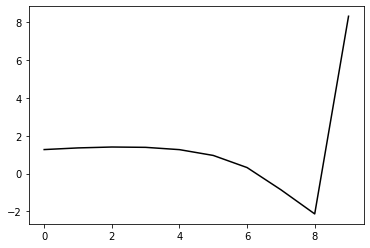

96800 0.1385760551952655
0.7621218383121966 -0.5811546709053111 -0.1494067455364085 -0.10352968792123918
[ 1.30395423  1.32298412  1.3661418   1.35398155  1.23964775  0.94242706
  0.31342943 -0.84657215 -2.11339207  8.32687481]


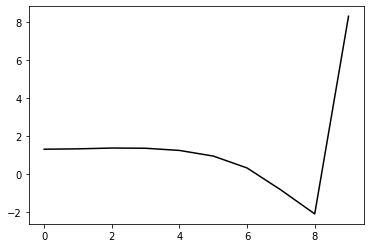

97900 0.19055716243521664
0.7547717525558569 -0.5845560105283187 -0.15212324545556669 -0.1020442808499079
[ 1.30086994  1.28843731  1.33208621  1.32045311  1.20801103  0.91364015
  0.28843787 -0.87012829 -2.14132509  8.33254292]


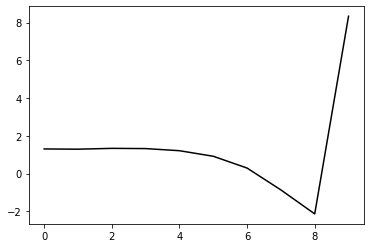

99000 0.21376293099913543
0.7520222028264439 -0.5842513060335629 -0.15234717102350892 -0.10107802411055555
[ 1.26714995  1.33003664  1.36543998  1.35425813  1.24487253  0.95457175
  0.33362655 -0.82468611 -2.1062376   8.2972149 ]


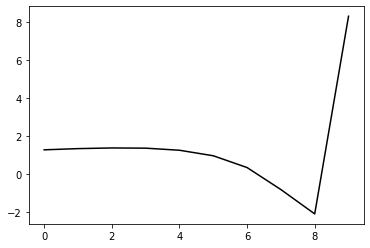

100100 0.2202381784883929
0.7514050397780736 -0.5803446114396221 -0.14996457221761156 -0.10099323986989417
[ 1.31046604  1.2731441   1.29740966  1.27989669  1.16952455  0.88496374
  0.2789826  -0.85903158 -2.12441787  8.3230042 ]


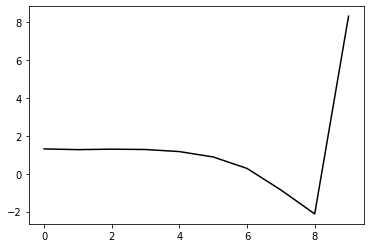

101200 0.21466169687249143
0.7642057443445772 -0.5735256721841598 -0.14764727570038796 -0.10058922014115979
[ 1.22104769  1.42227111  1.45962315  1.45287701  1.35757849  1.08780411
  0.48955707 -0.65581058 -1.95069088  8.32257094]


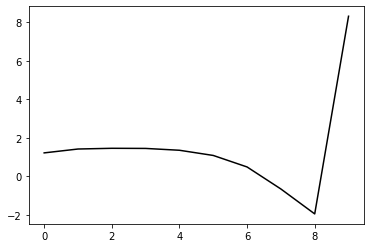

102300 0.177665914474575
0.7283357165133146 -0.5864409090627882 -0.15366525751417917 -0.100114291843972
[ 1.26947404  1.29361938  1.30763425  1.28263121  1.16522074  0.87302172
  0.25736774 -0.89524952 -2.18467556  8.35244214]


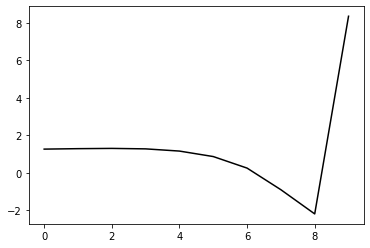

103400 0.21753229283718067
0.7382252361547305 -0.5822013149972046 -0.1522336763376793 -0.10359611573980138
[ 1.35168745  1.27674897  1.30472858  1.29986454  1.21116935  0.95278211
  0.3715998  -0.75253651 -2.02623406  8.32968276]


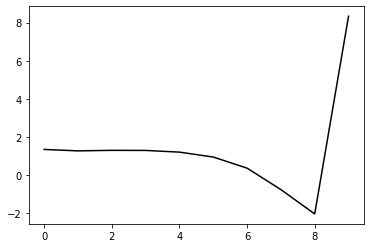

104500 0.20449625210398628
0.7320699838463239 -0.5826340640793499 -0.15319249000373666 -0.10144618494990074
[ 1.3020386   1.32591019  1.34872445  1.34217577  1.25366646  0.99524879
  0.41154091 -0.72093838 -2.01408027  8.35391482]


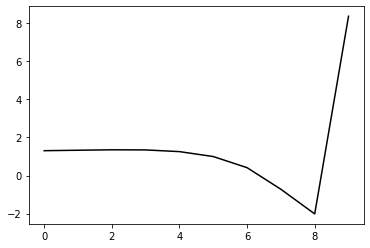

105600 0.1658600622750178
0.7294042563368202 -0.580391913973225 -0.15191960552854109 -0.10142500237053602
[ 1.29549509  1.33744069  1.35295224  1.33915855  1.24589254  0.98452769
  0.39848315 -0.73798762 -2.04151447  8.33225433]


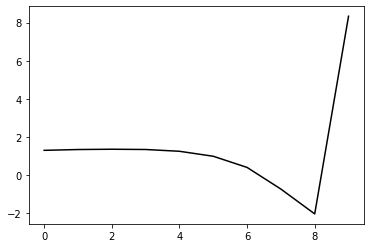

106700 0.13007867989837044
0.7372220875532706 -0.5732092381091617 -0.14939042219730725 -0.0984129430509089
[ 1.26351571  1.38058575  1.39554071  1.36658283  1.25726234  0.9815531
  0.38585158 -0.75362484 -2.05744049  8.33788486]


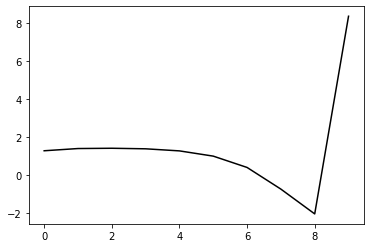

107800 0.14042372747697443
0.7423569065607383 -0.5690241000026521 -0.14658807588146838 -0.10182044015342695
[ 1.30079342  1.33919978  1.38448755  1.36886586  1.27162271  1.01097398
  0.43238684 -0.69019566 -1.98148845  8.34473256]


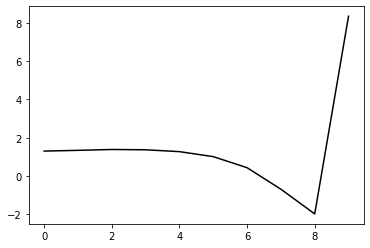

108900 0.18146520441853556
0.7145568001962427 -0.5775990867345543 -0.151329732056711 -0.10061857601043292
[ 1.27810827  1.32752604  1.34821778  1.31944918  1.20260489  0.91755477
  0.30946931 -0.84880075 -2.18368196  8.32503882]


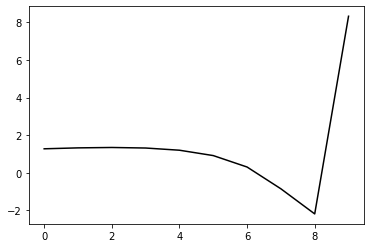

110000 0.21772387205264765
0.7182317402644475 -0.578778741621427 -0.15409767862908744 -0.10028995057387571
[ 1.26390697  1.36257752  1.39385919  1.37489793  1.26864505  0.99562791
  0.40080807 -0.74522888 -2.07384327  8.28510891]


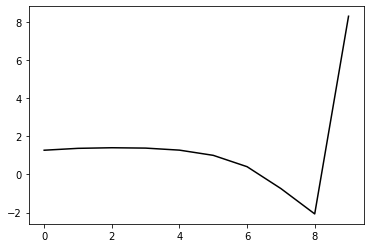

111100 0.23390401753425372
0.7247272845706673 -0.5727162586982846 -0.15111340452842928 -0.1007694863563071
[ 1.24658811  1.38815839  1.42613679  1.4131442   1.31331628  1.04742828
  0.45947645 -0.68373811 -2.02043534  8.34387208]


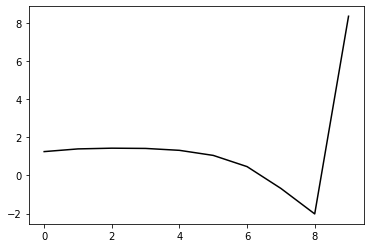

112200 0.20270868882082704
0.7044694383387172 -0.5811463048166241 -0.1560560583090433 -0.0994198202930877
[ 1.28365216  1.31633133  1.35466956  1.35103645  1.26118131  1.00748069
  0.43530586 -0.68982744 -2.01030315  8.32148356]


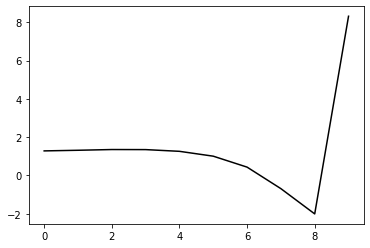

113300 0.19052605561600522
0.7118532489711497 -0.5757826460447224 -0.15361251145356572 -0.10027765502300469
[ 1.3371034   1.27926633  1.31591116  1.31814435  1.23849088  0.99619776
  0.4358442  -0.67994853 -1.99869081  8.37689143]


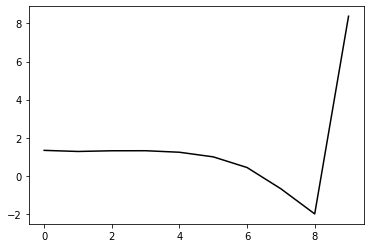

114400 0.20348284298205685
0.7026305908393614 -0.5741309528128631 -0.15174043242684437 -0.102704787255826
[ 1.34461703  1.31015815  1.34313934  1.34833236  1.2745196   1.03888538
  0.48506294 -0.62685562 -1.95061247  8.31338737]


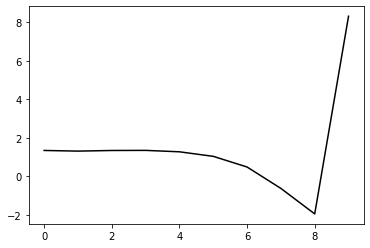

115500 0.2555348418500469
0.6986611060933713 -0.5750475259212036 -0.15304893100207229 -0.10219261213220619
[ 1.36259617  1.30159016  1.33731833  1.34743711  1.28259999  1.0585124
  0.51808128 -0.58048389 -1.89620286  8.39122766]


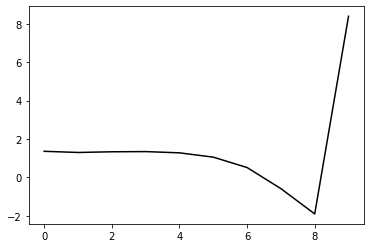

116600 0.17003847902393604
0.6998541473914542 -0.5743851727864269 -0.15397552091429398 -0.10043160662424172
[ 1.28751561  1.38402259  1.41215158  1.41389414  1.34213741  1.11062597
  0.56063844 -0.55258907 -1.89522164  8.35267589]


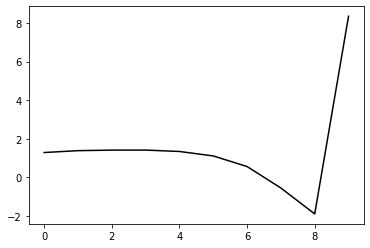

117700 0.11740700000090193
0.7056322060336415 -0.5656074612075832 -0.14908193054970778 -0.09976219902978885
[ 1.29759212  1.38088952  1.40228057  1.39049128  1.30613958  1.06381988
  0.50484164 -0.61650543 -1.97125972  8.33943619]


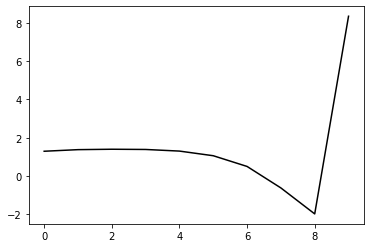

118800 0.13754032602480348
0.7112897357989305 -0.5614147595812727 -0.14720216714102136 -0.09916845413667426
[ 1.31178499  1.34326413  1.38113534  1.37002079  1.28680535  1.04989451
  0.49983016 -0.61177578 -1.96154811  8.32465654]


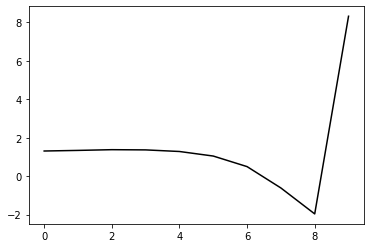

119900 0.18139111583049275
0.6833924657302278 -0.5724571215556967 -0.1534585361743821 -0.0975929008742637
[ 1.33329951  1.26810339  1.3036312   1.2899929   1.19866575  0.9527648
  0.39475613 -0.72306856 -2.07830423  8.35151187]


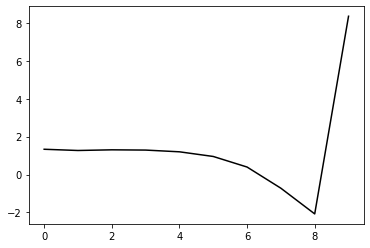

121000 0.21127580284174186
0.6837658387942877 -0.5734472613841539 -0.15551132300872356 -0.09804539256946276
[ 1.2900661   1.32788662  1.36542987  1.36269945  1.28261295  1.04900224
  0.50424954 -0.60180891 -1.95274281  8.33550285]


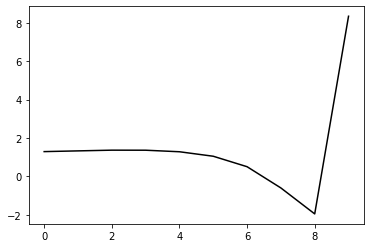

122100 0.20439231563585952
0.6875721344173443 -0.5657939462580813 -0.15083906400471989 -0.09839976576088365
[ 1.32367693  1.32223214  1.35074432  1.3469491   1.26857559  1.03843018
  0.49894834 -0.60232411 -1.95418086  8.36631963]


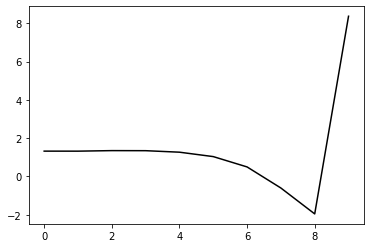

123200 0.17513941562594595
0.7067784183935863 -0.5540289777477518 -0.14511997809537786 -0.09874066044448988
[ 1.28237718  1.40698506  1.45249374  1.45149801  1.37634957  1.14998354
  0.61433661 -0.48570809 -1.84546952  8.34515447]


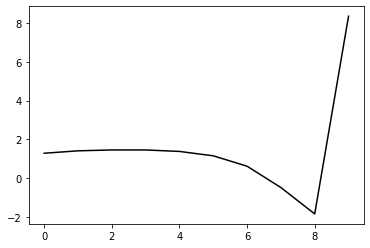

124300 0.1811828911199797
0.6822715775326631 -0.5649490397870078 -0.1512032387384401 -0.0972555331053833
[ 1.31592296  1.31080596  1.35399747  1.34977876  1.26776811  1.03425104
  0.49290752 -0.61129835 -1.97628038  8.37761058]


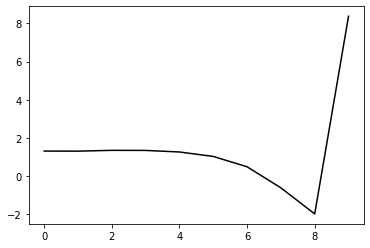

125400 0.19891073759457759
0.6870766389947408 -0.5613713209037591 -0.1507553400560843 -0.09552640714978815
[ 1.27693281  1.35893577  1.40030507  1.39893396  1.31996353  1.08995461
  0.55316954 -0.54721674 -1.91529708  8.33622952]


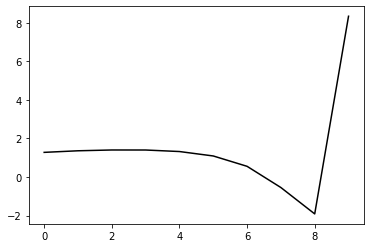

126500 0.22622600798816664
0.6897727213939199 -0.5557954984184182 -0.14667267552910945 -0.09868865479489299
[ 1.31319739  1.34469123  1.3954393   1.40390014  1.33711522  1.12157442
  0.60142151 -0.48369453 -1.84581313  8.36402039]


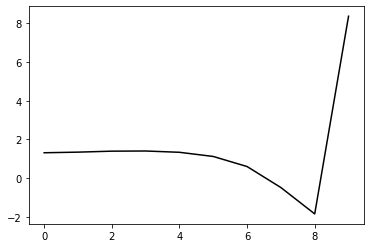

127600 0.1765795863899645
0.6625985276024794 -0.5631175050061679 -0.15057418818200005 -0.09754600105459331
[ 1.32006073  1.26997753  1.27782871  1.25380305  1.14990022  0.89943187
  0.35975337 -0.72355465 -2.07040172  8.31410817]


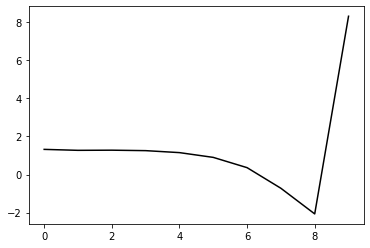

128700 0.12318158264217856
0.6833187787167573 -0.5585820896677292 -0.14975329102009163 -0.10203221740599677
[ 1.30662146  1.38170965  1.41927844  1.41875951  1.34318568  1.1212139
  0.60738777 -0.45655464 -1.79892459  8.3871939 ]


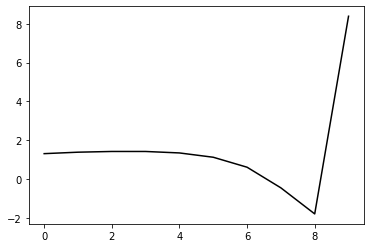

129800 0.17525373085559603
0.679128840691435 -0.5539910369304331 -0.1466870705700234 -0.10098332835245276
[ 1.33512055  1.32061268  1.35064638  1.34017807  1.25539513  1.02624949
  0.50807088 -0.5574762  -1.90465587  8.36840723]


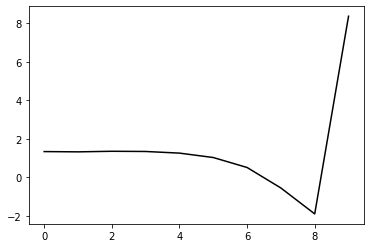

130900 0.20640228824938056
0.6773973160801101 -0.5586030314400295 -0.15096877195602446 -0.1007543362895617
[ 1.26610349  1.39918115  1.4343282   1.42670018  1.34265047  1.11105733
  0.5879062  -0.48372393 -1.84214676  8.37613032]


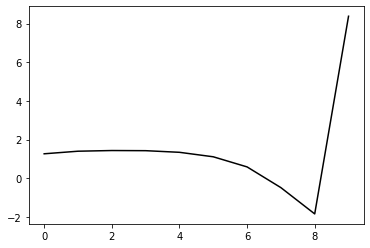

132000 0.25873719166420495
0.6713109711992675 -0.5562329707215449 -0.14904212352063848 -0.09926001711638512
[ 1.33408159  1.26696171  1.30035107  1.28378457  1.19018464  0.95055068
  0.42220051 -0.65020004 -2.00791195  8.38425809]


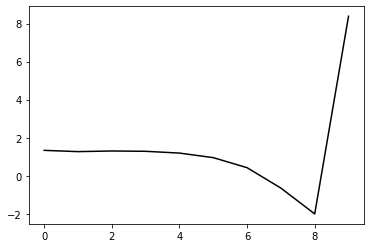

133100 0.2145532508650648
0.6699095411589845 -0.5549169866517781 -0.14862467233055743 -0.10013614462570428
[ 1.3122077   1.33409299  1.37776846  1.37382903  1.29284189  1.06634834
  0.55093238 -0.51020005 -1.86522052  8.38227458]


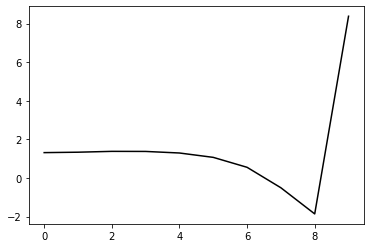

134200 0.190611234709823
0.6730981194533061 -0.5495057158394717 -0.14543752076895414 -0.10126462503604196
[ 1.3047922   1.35772366  1.40185052  1.40182012  1.32428923  1.10181878
  0.59144732 -0.46394457 -1.81804838  8.3551766 ]


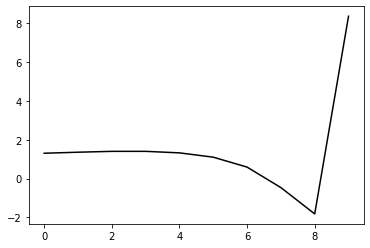

135300 0.21290074020379646
0.6730442788291434 -0.5489504592509267 -0.14713953348268494 -0.09666192648044965
[ 1.21561     1.39888324  1.42925389  1.40997588  1.30708372  1.05601738
  0.52019076 -0.5543736  -1.92735226  8.39666671]


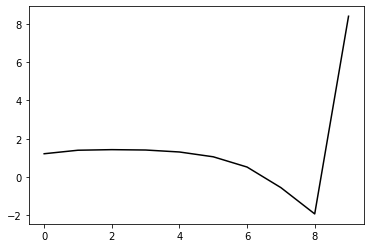

136400 0.2724039624745907
0.6329338411094705 -0.563258377582773 -0.1548753967392167 -0.09373770399411467
[ 1.24948919  1.27707775  1.28226185  1.2444732   1.12283532  0.85849695
  0.32016115 -0.74984581 -2.1197862   8.28647364]


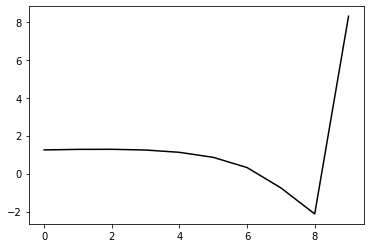

137500 0.20399681658289137
0.6556097733314835 -0.5532494801136406 -0.14960830181462753 -0.10129016400544653
[ 1.27291582  1.3577314   1.38133695  1.36431586  1.2680853   1.02953643
  0.51580662 -0.53231651 -1.88992546  8.3631466 ]


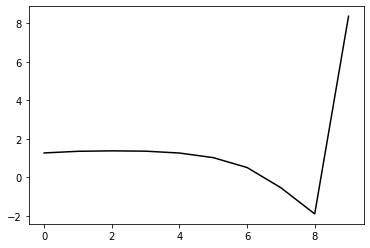

138600 0.18162652666501616
0.6582207074091807 -0.5504638089949 -0.14889928946115166 -0.10095466704148896
[ 1.30656921  1.31925041  1.35744521  1.34420043  1.25224281  1.017963
  0.50838785 -0.53477312 -1.89066323  8.36609335]


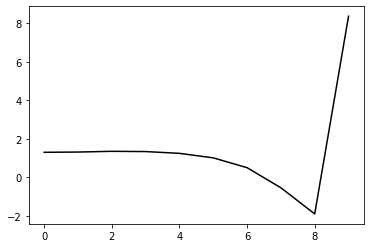

139700 0.11647754844958423
0.6570918641508449 -0.5486043573994702 -0.14793363098030887 -0.10119252225271864
[ 1.27713064  1.34881612  1.38776872  1.37492453  1.28221214  1.04679066
  0.53564331 -0.50870205 -1.87080439  8.36491347]


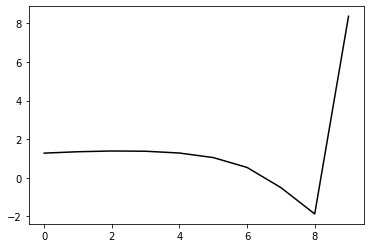

140800 0.16370103497148272
0.6499540714920153 -0.5516795498917034 -0.15070001062869237 -0.09839452184350901
[ 1.26452551  1.30930011  1.34762137  1.33468055  1.24048991  1.00401559
  0.49414699 -0.54451898 -1.90239733  8.34807002]


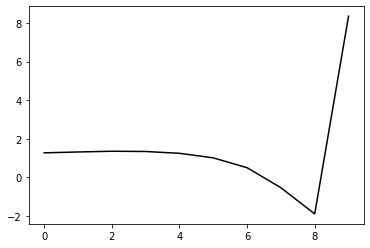

141900 0.20872223864110176
0.6539083742202808 -0.5484489318721836 -0.14896012843917275 -0.09961157171139624
[ 1.24094888  1.36214589  1.39586924  1.38712466  1.29903652  1.06774372
  0.56087158 -0.47757663 -1.84564116  8.39509316]


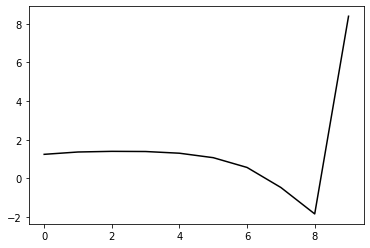

143000 0.2322706870888785
0.6533105197084027 -0.5474526204668394 -0.14935837887898634 -0.09862741004539513
[ 1.2305895   1.36234495  1.39972468  1.3940141   1.31096532  1.08588724
  0.58652409 -0.44229479 -1.80507542  8.35386657]


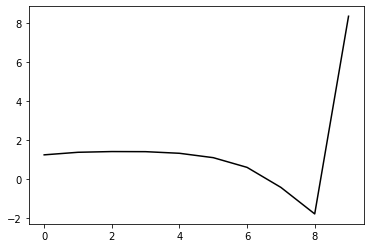

144100 0.2018558582408601
0.642074847866316 -0.5458886266887762 -0.14776670286283017 -0.09777642306137331
[ 1.29487163  1.30057105  1.32458048  1.31445525  1.22829849  0.99983308
  0.49656829 -0.53525796 -1.9033308   8.32208683]


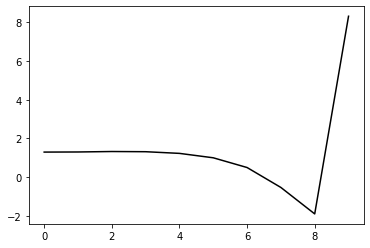

145200 0.1839873886699235
0.6460295198062478 -0.541414511609213 -0.14501957658901213 -0.10082370009487104
[ 1.28284605  1.35309208  1.3831275   1.37093529  1.28290173  1.0532539
  0.55274055 -0.46978446 -1.8311936   8.35686654]


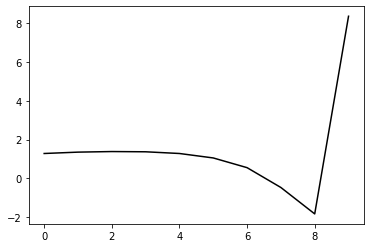

146300 0.17774982399562264
0.6442895401771457 -0.5434072505736827 -0.14775865939337393 -0.099231974379608
[ 1.22350534  1.38026401  1.4151345   1.40099555  1.30790042  1.07073014
  0.56060286 -0.47086349 -1.84472594  8.38754861]


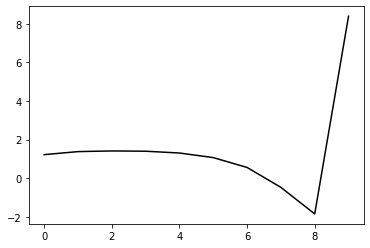

147400 0.17842271363449708
0.6362651672146127 -0.5444355313025908 -0.14782983566441607 -0.10049622841466727
[ 1.2841543   1.31850788  1.3618531   1.35904563  1.27936684  1.05887191
  0.56820754 -0.44141251 -1.79759413  8.31629722]


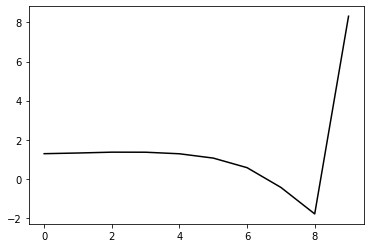

148500 0.22356948274002983
0.6161639648044309 -0.5496710229801796 -0.15160255016840518 -0.09708094373867562
[ 1.29352192  1.25440384  1.26468503  1.24387268  1.14672987  0.91129137
  0.41079008 -0.60133603 -1.95517127  8.38206722]


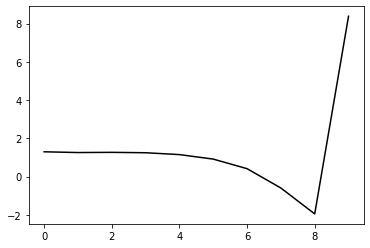

149600 0.14693124801004434
0.6431582806795926 -0.5394446031792056 -0.14742227056489066 -0.10028161843760702
[ 1.25701386  1.4046039   1.4488885   1.44865431  1.37360347  1.15662407
  0.66774582 -0.34076667 -1.7031596   8.35525298]


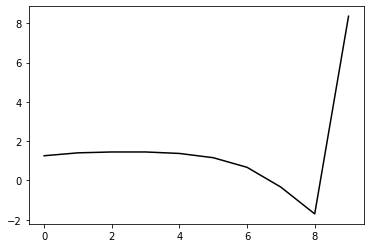

150700 0.12244842631398278
0.6302825084022271 -0.544211728572614 -0.1502334095456675 -0.10024095355073183
[ 1.26968831  1.3342428   1.38043892  1.38116579  1.3070966   1.09380438
  0.61172064 -0.38596455 -1.73623875  8.36741576]


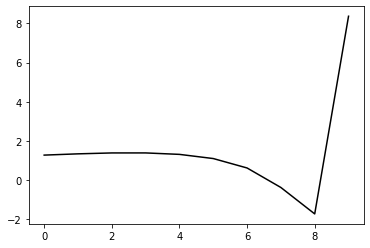

151800 0.14338370035137468
0.6283141564809224 -0.5405838939878789 -0.14817327404575809 -0.09892458643810038
[ 1.26407027  1.34019806  1.36529566  1.35251675  1.26460827  1.03676291
  0.54003521 -0.47063195 -1.83341692  8.39037823]


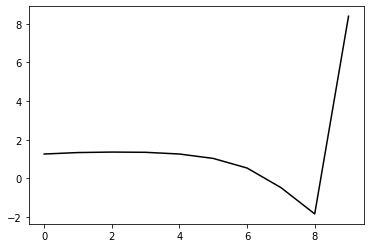

152900 0.18248954094747807
0.6252135444732343 -0.5420430076288455 -0.14988729339010706 -0.09827146342685415
[ 1.27428198  1.29166643  1.33310843  1.3258493   1.2438163   1.02262998
  0.53254842 -0.47110727 -1.82954782  8.41256612]


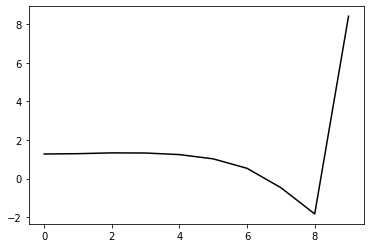

154000 0.2115700348819213
0.6222450510697125 -0.5406974032489599 -0.14901642998628312 -0.09759194492887041
[ 1.24441151  1.31434362  1.34505207  1.33278748  1.24504928  1.02013257
  0.52937682 -0.47208726 -1.83103303  8.36650469]


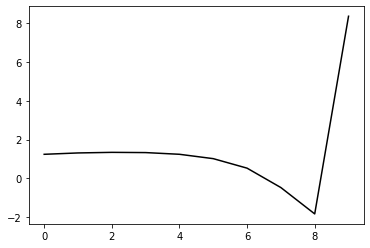

155100 0.18745856414043494
0.6290740414504922 -0.5344600820868293 -0.14548639811913794 -0.09838351916616192
[ 1.26251292  1.30926402  1.33785773  1.32813891  1.2453974   1.02699738
  0.54278722 -0.45359243 -1.81344952  8.38670219]


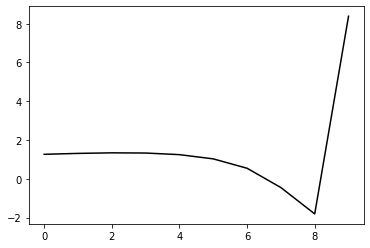

156200 0.22027402540549948
0.6121172333225023 -0.5405654769408952 -0.14863224178190396 -0.09807128161999917
[ 1.28977237  1.21454005  1.22300839  1.21134942  1.13417648  0.93093873
  0.47002344 -0.50012644 -1.83724797  8.34847127]


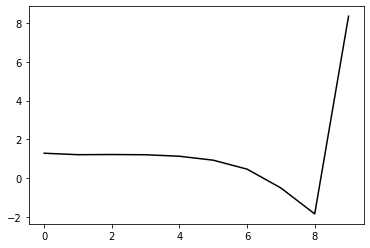

157300 0.23982004977316107
0.6067925784577295 -0.548279044524152 -0.15489474703951392 -0.09739970373806213
[ 1.2266874   1.30791998  1.31780151  1.31040308  1.24416571  1.05198546
  0.59776168 -0.37153001 -1.71570052  8.39007758]


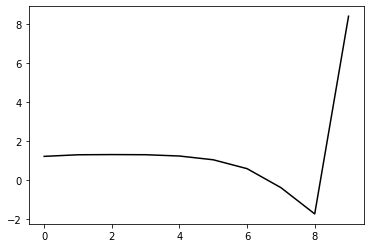

158400 0.2027932520895351
0.6229687492843318 -0.5372202562984292 -0.14930806637461186 -0.09695426945724464
[ 1.2391596   1.33855461  1.34799618  1.32729707  1.25151231  1.05253365
  0.59344702 -0.3796677  -1.73060443  8.39999429]


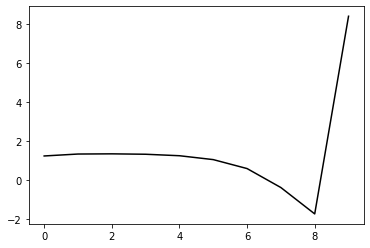

159500 0.214154661770788
0.6170741737084036 -0.5355962392083102 -0.1477424417586027 -0.0975812813475197
[ 1.26439967  1.28548613  1.3019757   1.28031652  1.20242535  1.00596874
  0.5543819  -0.40828967 -1.75106899  8.41055306]


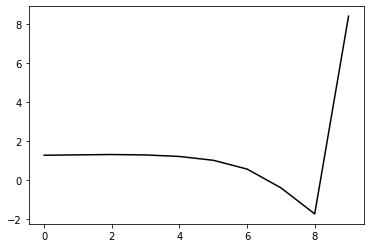

160600 0.1915784349126068
0.616482894203193 -0.5364867699486895 -0.1489521209706878 -0.09931044240034897
[ 1.22293897  1.34293863  1.36769799  1.35304707  1.27862676  1.08388972
  0.63316273 -0.32936115 -1.67739833  8.39628859]


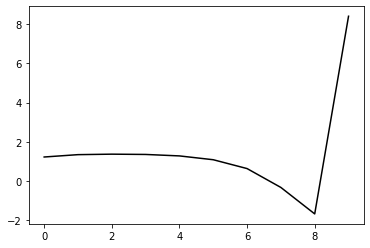

161700 0.1355261386186068
0.6102536647448682 -0.536542043757331 -0.14955000939568308 -0.0969139156298053
[ 1.2467249   1.28324607  1.30202587  1.28130973  1.19873459  0.9995117
  0.55262424 -0.39913724 -1.73673455  8.36190932]


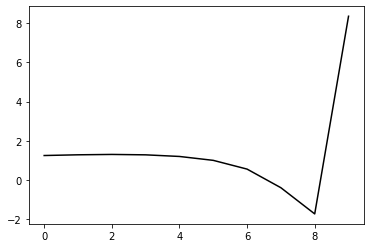

162800 0.25718881189884407
0.6159663085549862 -0.5288820773287664 -0.1440274100997254 -0.10086059026866098
[ 1.32318188  1.25022749  1.28326594  1.28197341  1.2226706   1.04748145
  0.6227868  -0.31172829 -1.64127942  8.37467765]


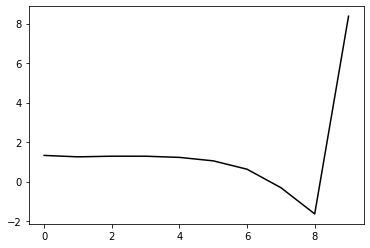

163900 0.1805216454795224
0.6021153805520806 -0.5342260828090608 -0.14829132413501883 -0.09770629181274154
[ 1.25636431  1.27637218  1.25404593  1.21959305  1.13446559  0.94295321
  0.51187639 -0.42268126 -1.75143704  8.39766405]


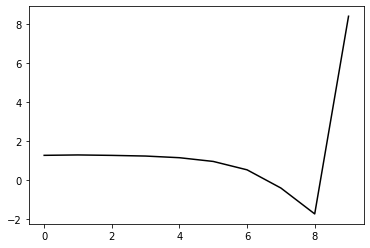

165000 0.21587445066003483
0.599627620093802 -0.5351863495985133 -0.14930083189015078 -0.09879882085218646
[ 1.25902895  1.27302083  1.27389042  1.24070848  1.15709644  0.9675713
  0.54021555 -0.38871897 -1.71370301  8.36271143]


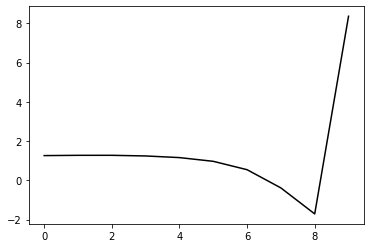

166100 0.2233156082425185
0.6043823380630295 -0.5316572421836424 -0.14759734863820365 -0.0998322352667221
[ 1.28775215  1.25397663  1.26720259  1.24060582  1.16126627  0.97705938
  0.55726685 -0.36229779 -1.68103999  8.40612126]


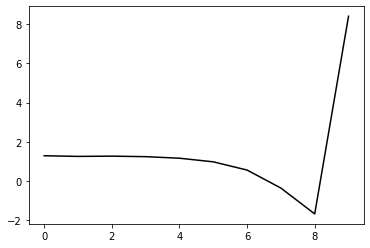

167200 0.18939226182588345
0.6106575956354702 -0.5245346749486967 -0.14316176343676795 -0.10116909490526842
[ 1.26509464  1.31888978  1.3391821   1.31502678  1.23468486  1.04836585
  0.62653158 -0.2959091  -1.6235921   8.38980939]


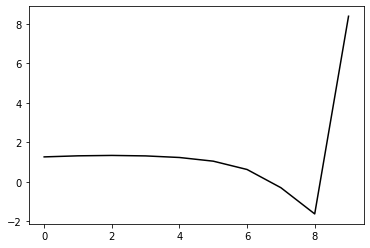

168300 0.20778971559357984
0.6055212048073252 -0.5277195441132475 -0.14672809610490403 -0.09850965643778395
[ 1.18788516  1.34298003  1.35742782  1.32699164  1.23302736  1.02914144
  0.59128868 -0.34209119 -1.68053885  8.42204257]


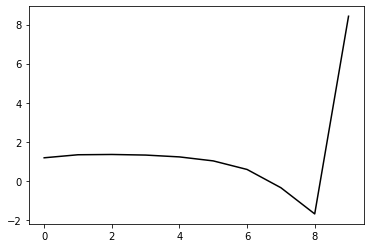

169400 0.20720998045257408
0.5897146801056119 -0.5334215470951105 -0.14979574532887002 -0.09745412094486998
[ 1.22202228  1.27903865  1.27806633  1.24260241  1.14451746  0.93988533
  0.50985766 -0.40677752 -1.72639624  8.35049642]


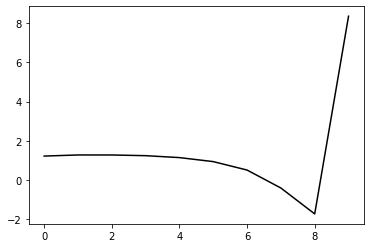

170500 0.20677443446951
0.5966318572329082 -0.5289998665179295 -0.14727035305236247 -0.10113080756892245
[ 1.27252218  1.26728222  1.28842087  1.27075879  1.19515933  1.01482515
  0.60997643 -0.28307547 -1.58882706  8.42903029]


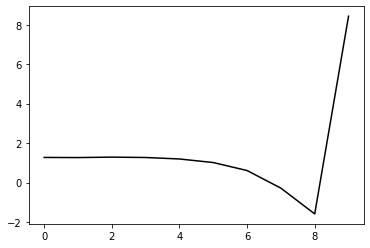

171600 0.15994713015637385
0.5924167232903317 -0.5291015698712133 -0.1476323178202453 -0.1008264511391694
[ 1.25441688  1.29156279  1.31704028  1.30347818  1.22893556  1.04570141
  0.63691678 -0.2572998  -1.56620476  8.39138183]


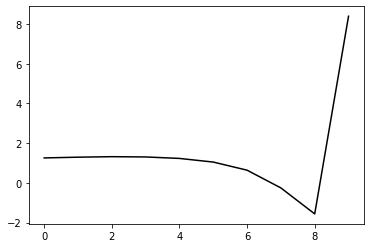

172700 0.12746409651075327
0.5936746961648366 -0.52841352716381 -0.1482033688868781 -0.0992822505043669
[ 1.23401309  1.27143832  1.29542214  1.27403146  1.18971725  0.99720305
  0.58259751 -0.31140714 -1.61881294  8.40101917]


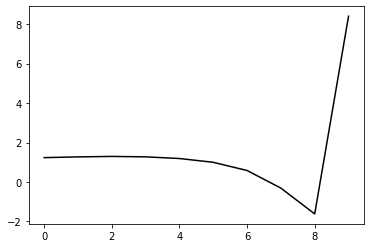

173800 0.19574846944851873
0.5884330147193362 -0.5253264485927935 -0.14523958876584658 -0.10310505642135484
[ 1.30136586  1.24683029  1.26489449  1.25689041  1.18947665  1.01492375
  0.62006917 -0.25191351 -1.54146581  8.41438228]


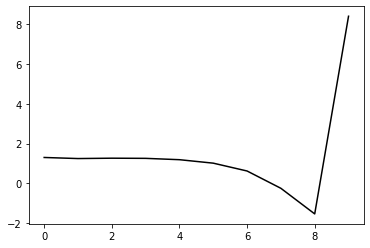

174900 0.18022148555378184
0.57307952481965 -0.5291755761200589 -0.14863692369147044 -0.10011286539578218
[ 1.23923792  1.25786567  1.22565756  1.18418757  1.0860372   0.8834251
  0.46823851 -0.41343504 -1.70562217  8.3893674 ]


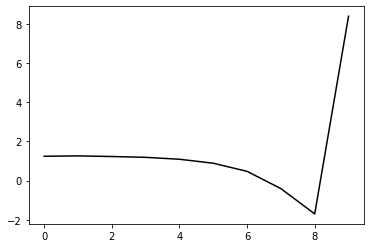

176000 0.2553093727831413
0.5699193710333197 -0.5346572308654687 -0.15453340438250637 -0.09657128122703686
[ 1.21903809  1.23457471  1.21671622  1.16949151  1.07104525  0.87171474
  0.46254189 -0.40987435 -1.69324848  8.36841285]


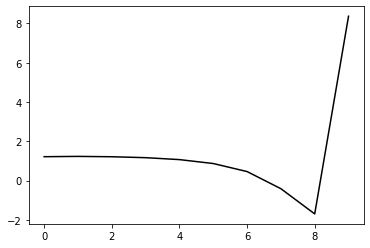

177100 0.20911059827506354
0.5762024947596937 -0.5267138525841364 -0.14959635216740255 -0.09921180460412288
[ 1.24659701  1.29439913  1.27168145  1.21988193  1.11754672  0.91402773
  0.50060487 -0.3739124  -1.659265    8.39895828]


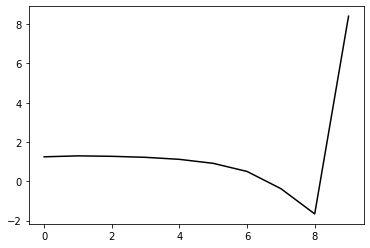

178200 0.18726385584857924
0.5825829423736509 -0.5249643567200897 -0.14977542193026538 -0.09926005556433158
[ 1.20769292  1.35206151  1.36320236  1.32343276  1.22849078  1.02997313
  0.61811688 -0.25662669 -1.54650472  8.39546609]


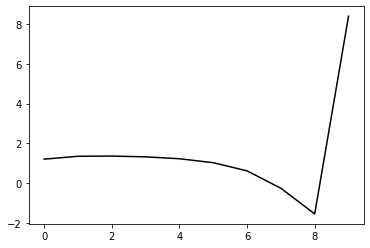

179300 0.19172195732777567
0.5809093403869208 -0.5215937632977461 -0.1476168583745455 -0.10000099461320272
[ 1.18692708  1.34069803  1.34973605  1.30781632  1.20592907  0.99928532
  0.57838526 -0.30464772 -1.60470205  8.41472239]


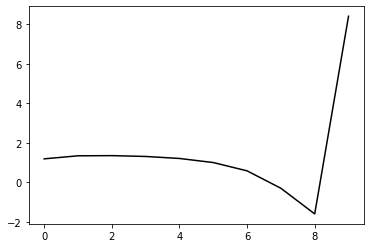

180400 0.17749416871934903
0.5786556664060674 -0.5216020125830941 -0.14752393750319018 -0.10079158203926067
[ 1.25209081  1.2782844   1.30541246  1.28007609  1.19194914  0.99947098
  0.59425276 -0.26960682 -1.54904828  8.39025953]


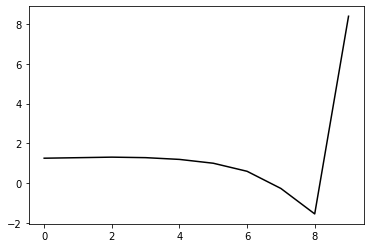

181500 0.24332210677531999
0.5528880407063865 -0.5284347295270179 -0.15145518270279304 -0.09833838104345081
[ 1.24775636  1.21384002  1.19582463  1.14995139  1.03987472  0.82722273
  0.40847934 -0.45923436 -1.73541294  8.384779  ]


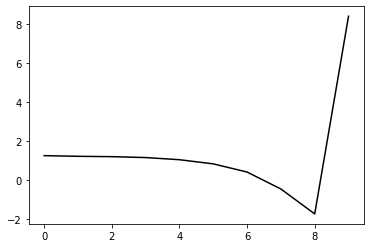

182600 0.1589689189507124
0.5759044107127751 -0.5203260741144387 -0.14826204165479542 -0.10232344796714742
[ 1.22182529  1.33583434  1.34102955  1.30467283  1.2054777   1.00014805
  0.58491331 -0.28211195 -1.56304084  8.40253376]


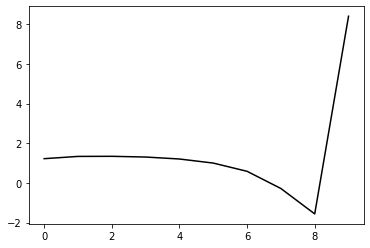

183700 0.11984698297794107
0.5715898132840577 -0.5215663087813288 -0.14940720015462228 -0.10304670096424823
[ 1.24458493  1.32164928  1.33627196  1.30948055  1.21935719  1.02238114
  0.61543204 -0.24138416 -1.51193211  8.40241189]


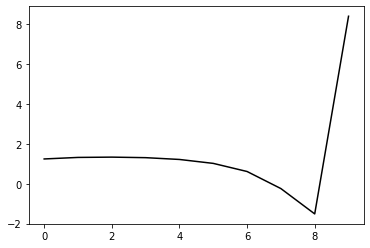

184800 0.1593422464573317
0.5650493387132017 -0.522888406209324 -0.1513405298837008 -0.0993522846639979
[ 1.24010958  1.26370967  1.26348014  1.23130041  1.13958333  0.94236432
  0.53595354 -0.31850678 -1.58712924  8.38842358]


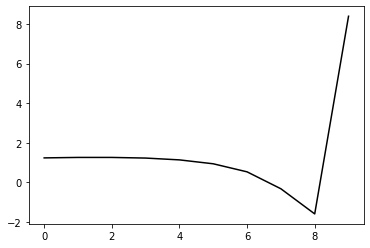

185900 0.1870695441553692
0.564430579373571 -0.5210195715277846 -0.15005736100347367 -0.10199280581168942
[ 1.2406185   1.28527668  1.28997693  1.26453781  1.18086716  0.98996284
  0.5869749  -0.26565252 -1.5361455   8.41760309]


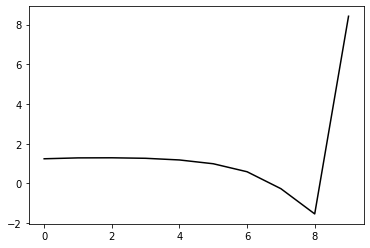

187000 0.2145576539105442
0.5631229546466854 -0.5205195329086482 -0.15099704178192302 -0.09829267839412315
[ 1.20795183  1.27093418  1.28019178  1.24577486  1.15109783  0.94832391
  0.53322309 -0.32852608 -1.60573303  8.39004674]


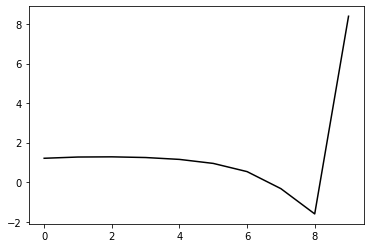

188100 0.3250294442510543
0.5562102078219048 -0.5167440640673923 -0.14686818630577106 -0.10219922435042923
[ 1.32309256  1.11814108  1.12676136  1.09377544  1.00220461  0.80737328
  0.40653966 -0.43194639 -1.67759454  8.41234938]


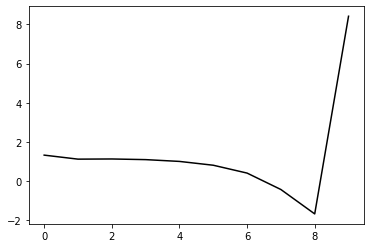

189200 0.19751810178301965
0.5616704865034977 -0.5156044077842193 -0.1478871228200259 -0.10170030570031259
[ 1.22869977  1.30393579  1.30780182  1.27321862  1.17669286  0.97044645
  0.551206   -0.31054964 -1.58443947  8.39309047]


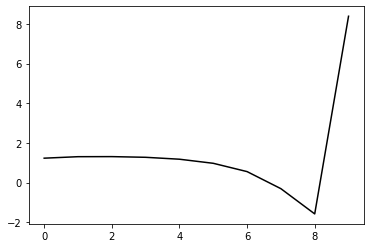

190300 0.21270135097952927
0.5334266731208701 -0.5198130129790685 -0.14843047748607144 -0.10241694854293837
[ 1.251729    1.11364979  1.08585811  1.02862701  0.91432486  0.70002187
  0.28264325 -0.5678669  -1.82337262  8.42422121]


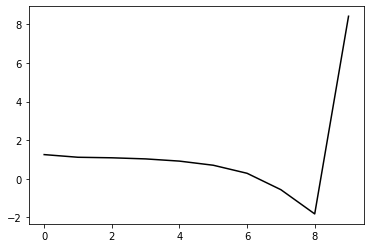

191400 0.2375027954853806
0.5504917537311999 -0.5174274791775979 -0.14946479094483217 -0.10522855597738483
[ 1.30421201  1.21547349  1.21321121  1.17838222  1.08632329  0.89000144
  0.48602072 -0.35445469 -1.6035887   8.39708658]


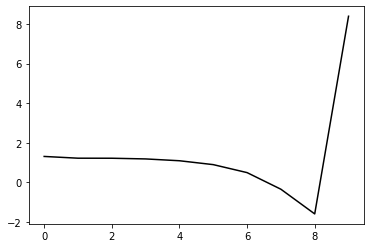

192500 0.20447345140185416
0.5477181414040675 -0.517559857555792 -0.1502559155869456 -0.1041336213870545
[ 1.25728605  1.28862258  1.28870553  1.24894658  1.15081525  0.94687788
  0.53377858 -0.31567584 -1.57423646  8.39506922]


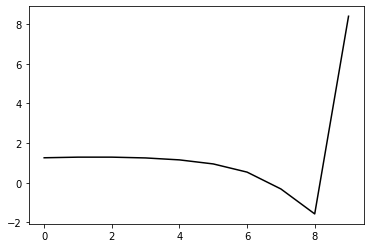

193600 0.16038025225565264
0.5605574544831305 -0.5113932689546397 -0.1478826976605842 -0.10327817216143059
[ 1.21155347  1.31153091  1.33782768  1.29941018  1.19481002  0.98183081
  0.55787479 -0.30215638 -1.57180185  8.38579324]


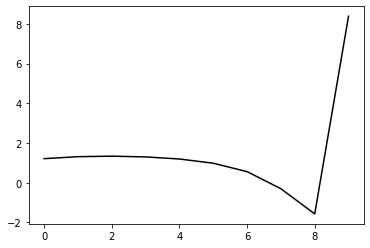

194700 0.14113125906876467
0.5444021762273833 -0.5139390591476929 -0.14880092308197831 -0.1044388844058614
[ 1.25855336  1.23102207  1.21801797  1.17441813  1.06970691  0.86635136
  0.46065226 -0.37651099 -1.62244402  8.39534235]


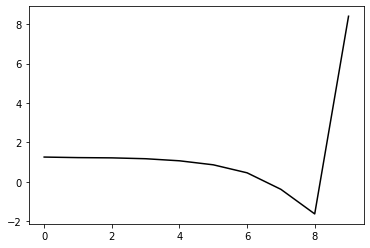

195800 0.16352708221579773
0.554631377582587 -0.5131693186170286 -0.15048869546556756 -0.10238460800238597
[ 1.2058571   1.28662015  1.29456469  1.25269138  1.1474293   0.93932592
  0.52682141 -0.31716904 -1.57053605  8.37451709]


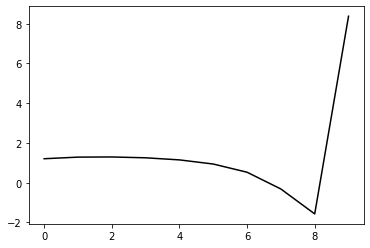

196900 0.19289073293110529
0.5575526275728797 -0.5060468333579194 -0.14613164787106148 -0.10252473191881936
[ 1.22230889  1.25348789  1.26596124  1.21880133  1.10634421  0.8924899
  0.47756074 -0.36520881 -1.61618166  8.39639067]


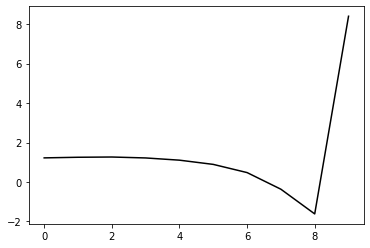

198000 0.21035634582169274
0.5489868132750406 -0.5117183031034509 -0.15059306590105456 -0.1005719126985092
[ 1.20561256  1.17656337  1.19813038  1.16151808  1.05506353  0.84632413
  0.43752863 -0.39698016 -1.63861454  8.39142994]


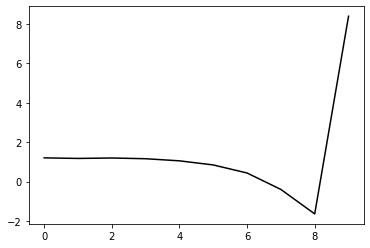

199100 0.22142156680678235
0.549865574770812 -0.5078642266893393 -0.14779089893746344 -0.1036916751514679
[ 1.24896498  1.21370193  1.23070445  1.21282563  1.12561413  0.92994125
  0.52966776 -0.29868823 -1.53713207  8.4321106 ]


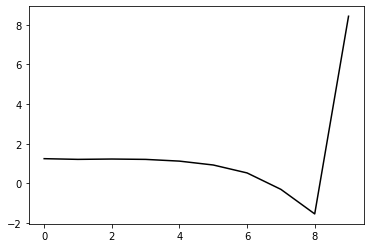

200200 0.18283429481114066
0.5524564365696094 -0.5036719824078779 -0.14560470625851585 -0.1029321454004884
[ 1.23326293  1.26133462  1.27131568  1.25265121  1.16829521  0.97284107
  0.57025905 -0.26041464 -1.50191954  8.40733312]


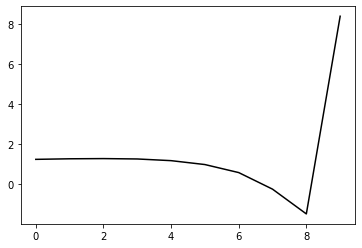

201300 0.3756249450215232
0.5641887002832207 -0.49682636782342504 -0.1421316498176398 -0.10380044321232056
[ 1.28197271  1.23204766  1.27906204  1.27098917  1.1932422   0.99996986
  0.5952322  -0.23814617 -1.48225005  8.4466948 ]


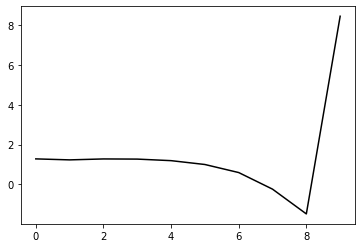

202400 0.17948318597391177
0.5498137298817456 -0.5030459308868029 -0.14662340954846 -0.10076323551361789
[ 1.21856947  1.25416827  1.27934665  1.26179606  1.1729775   0.96817836
  0.55281232 -0.28776317 -1.53569713  8.37927816]


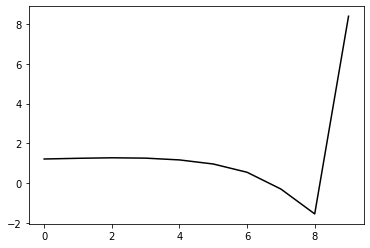

203500 0.22090392891256896
0.5373749209557592 -0.5065633652646263 -0.14872554762986342 -0.09940252831349813
[ 1.23695998  1.19650771  1.1977568   1.16842117  1.07144396  0.86123253
  0.44405613 -0.39271037 -1.63144846  8.40823218]


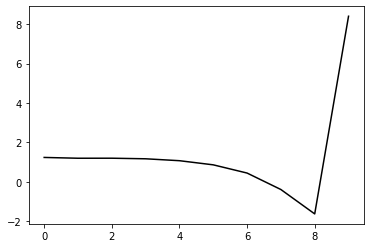

204600 0.15837035742057587
0.5441476220805077 -0.5027631602400466 -0.14675746741539197 -0.10279889987771487
[ 1.22950958  1.24884482  1.26913558  1.25418936  1.17513695  0.98040285
  0.57189039 -0.26249118 -1.50446589  8.40177051]


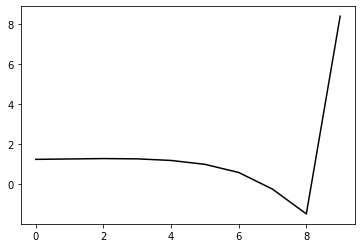

205700 0.12053944112709532
0.5362361804634743 -0.5048949804496322 -0.14785027263830572 -0.10471985778909142
[ 1.23580132  1.25683888  1.2676132   1.25872397  1.18981828  1.00699393
  0.61024809 -0.21218019 -1.44301626  8.42597946]


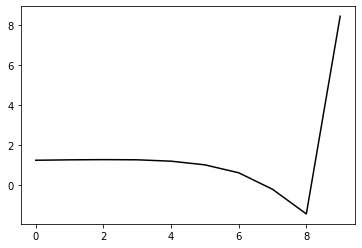

206800 0.1630002614069469
0.5411038904757631 -0.5025198413393674 -0.14816414143708367 -0.10074574034665029
[ 1.19770508  1.27589372  1.29181614  1.27232607  1.19404389  1.00238144
  0.59622387 -0.23465794 -1.47253142  8.41041025]


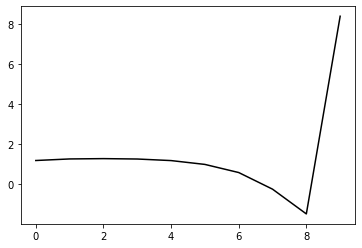

207900 0.19274855456396328
0.5364490137387188 -0.503055810276094 -0.1482965392488622 -0.10254381057523021
[ 1.23159905  1.2045699   1.23071157  1.22291649  1.15715705  0.98014849
  0.58781884 -0.23016821 -1.45551766  8.42910236]


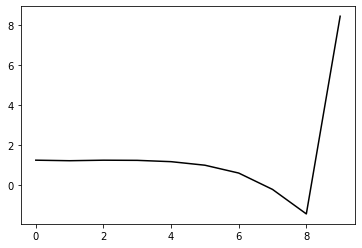

209000 0.204323272669248
0.5368530682645697 -0.4988644934918668 -0.14610136501203722 -0.10114524448856466
[ 1.19154634  1.25491164  1.26432543  1.23943704  1.1558979   0.96253741
  0.55577384 -0.27389017 -1.50831996  8.40393515]


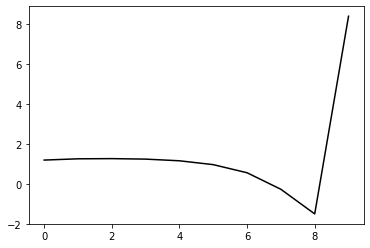

210100 0.20411895445118103
0.5318006366948156 -0.49999598027800135 -0.14746997449363702 -0.09912533299813282
[ 1.22995346  1.13131602  1.14154913  1.11763851  1.04001575  0.86130326
  0.47429941 -0.33454491 -1.54848961  8.41464636]


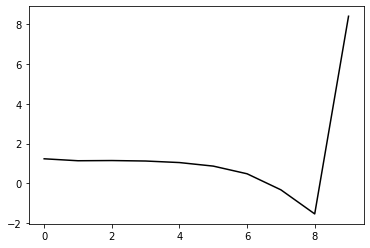

211200 0.18279884313324612
0.5356067581073112 -0.4956585002841706 -0.1439548786522589 -0.1051246798040659
[ 1.22596332  1.27302804  1.29254522  1.28565876  1.22398935  1.05672021
  0.67657011 -0.12960397 -1.34506939  8.42434366]


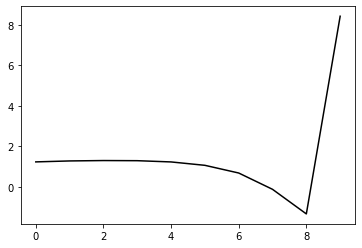

212300 0.189553555016232
0.5223769893856957 -0.5021779221957569 -0.14938319204662284 -0.10061546324962878
[ 1.15535841  1.22514273  1.22310987  1.19546626  1.11153641  0.92358757
  0.52773278 -0.28718569 -1.50445222  8.45889092]


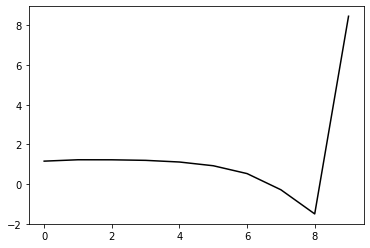

213400 0.18821916010340758
0.5258507323809983 -0.49945489227621526 -0.148012475106513 -0.10207805199857004
[ 1.19713677  1.23288256  1.23170723  1.20688602  1.13021199  0.95184653
  0.56744014 -0.23473649 -1.43869259  8.38798929]


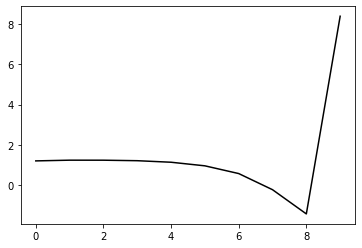

214500 0.23444067362996068
0.5123977049052729 -0.5022891213265221 -0.1490311629488652 -0.10323529173858037
[ 1.25449422  1.13602355  1.11591235  1.08117229  0.99807132  0.81885387
  0.4405681  -0.34826102 -1.53207045  8.43153109]


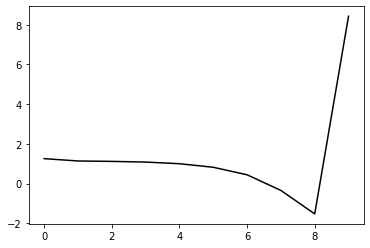

215600 0.15784010512079716
0.5272172994311493 -0.4975192534142945 -0.14828143000238525 -0.10324767874353756
[ 1.18508023  1.29986785  1.30519081  1.28164913  1.20855983  1.03373186
  0.65145796 -0.14999949 -1.35501669  8.41945999]


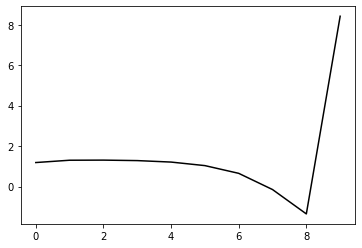

216700 0.11757542757626202
0.5207869828300802 -0.49447869418241924 -0.146339140016922 -0.10312209697599813
[ 1.2074283   1.25081544  1.24663219  1.21496973  1.13129172  0.94610766
  0.55505386 -0.25123538 -1.45467743  8.40939716]


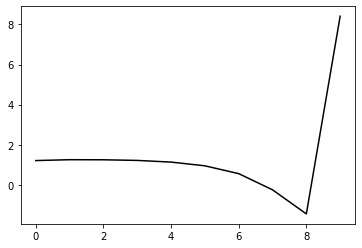

217800 0.12949235984515123
0.5309343143732009 -0.49074464049166366 -0.14518413851881626 -0.10447194360789189
[ 1.21232492  1.27739186  1.30523888  1.290176    1.22061724  1.04763129
  0.66558196 -0.13514209 -1.33590551  8.3974594 ]


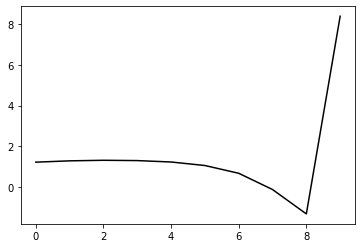

218900 0.2069519460972112
0.5231231738543628 -0.4953518581533006 -0.14833626029853547 -0.10390867709705369
[ 1.17459588  1.26164011  1.28224017  1.26607201  1.19333494  1.01819034
  0.63640458 -0.1608276  -1.35404722  8.42330521]


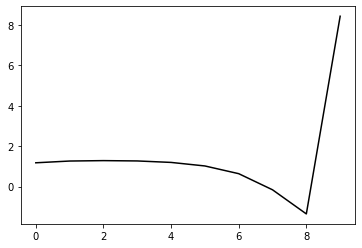

220000 0.21324020510593342
0.5144142656659357 -0.49621775771097143 -0.14896200681089686 -0.10231337574754301
[ 1.20173779  1.20091663  1.21005568  1.1899985   1.1139767   0.93578479
  0.55180015 -0.24653872 -1.43938134  8.43429859]


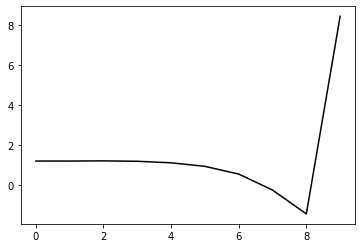

221100 0.20792376987012995
0.5154136521373756 -0.4938550451776451 -0.14784529310569916 -0.10250744401061433
[ 1.17512913  1.2364719   1.244965    1.22414001  1.14835774  0.96997366
  0.58558182 -0.21309075 -1.40579894  8.41863062]


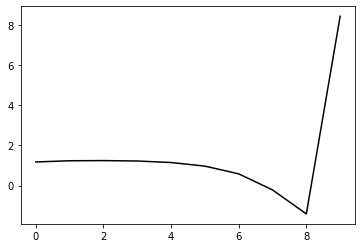

222200 0.21505359190945944
0.5006965381636269 -0.5017156770080236 -0.1527020128088438 -0.10292811106727377
[ 1.17759342  1.21605554  1.23327748  1.2261096   1.16550559  1.00253886
  0.63320354 -0.15087461 -1.32888373  8.41337662]


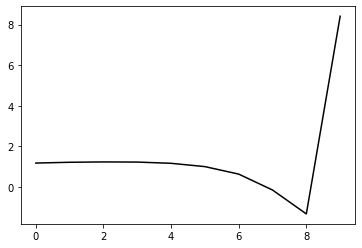

223300 0.1784553167673592
0.48843500137388907 -0.4987752547618742 -0.1506277071588619 -0.10404754791229402
[ 1.18649162  1.18393324  1.1674977   1.14084497  1.06314794  0.88299707
  0.49662111 -0.30376237 -1.49703502  8.44202544]


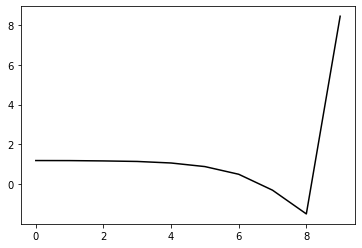

224400 0.18356622492370947
0.507449515767085 -0.49185331908631114 -0.14872705539957387 -0.1031493705275862
[ 1.21252584  1.26331163  1.27103578  1.2485177   1.17744055  1.00334227
  0.62067529 -0.17855568 -1.37295988  8.40066961]


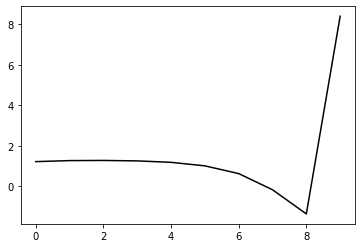

225500 0.217638366197698
0.5066808118415942 -0.4888262906283591 -0.14749222746383878 -0.10075170096689784
[ 1.20858991  1.23853007  1.24166855  1.20141532  1.1086853   0.91634328
  0.52050144 -0.28611841 -1.4822358   8.42928538]


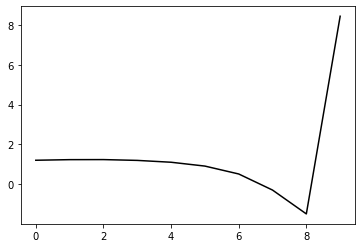

226600 0.16601543956858097
0.4989648106986204 -0.4915454185541919 -0.14879285119346372 -0.10485865210065594
[ 1.18916152  1.25930495  1.26488241  1.22842166  1.13580254  0.94667001
  0.55958648 -0.23504432 -1.41854475  8.41787487]


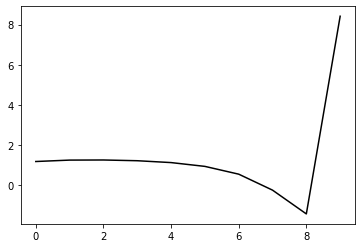

227700 0.11708359911698786
0.5017666577250198 -0.48934292131138835 -0.14772356117147606 -0.10545949692712527
[ 1.20005202  1.28075417  1.28857993  1.25597551  1.16544652  0.97747713
  0.59209829 -0.20004355 -1.38033358  8.42507094]


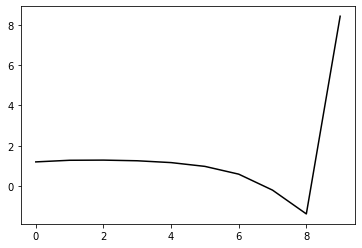

228800 0.2443150477852694
0.4974243322278679 -0.49602154726010367 -0.15398687968817376 -0.09990008526186948
[ 1.15720475  1.25054886  1.27670766  1.24255218  1.14392746  0.9455098
  0.55114635 -0.24634105 -1.42764193  8.39287107]


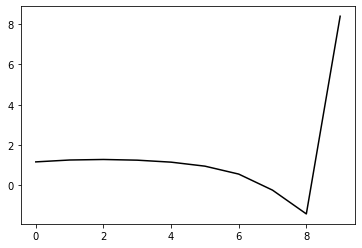

229900 0.18704281572581374
0.4901488038212654 -0.4945600609582526 -0.15172875648321818 -0.10562374525646281
[ 1.20891937  1.21772338  1.24284108  1.2259898   1.14479669  0.96351724
  0.58663615 -0.19333471 -1.35748449  8.44667578]


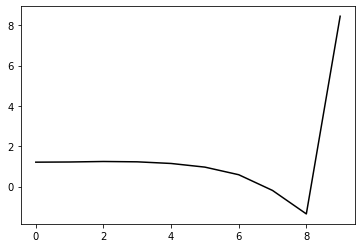

231000 0.21157422479222765
0.48975889391074945 -0.4935499123213093 -0.151696578028406 -0.10442613594545051
[ 1.17452531  1.2599172   1.2729993   1.2489353   1.16093827  0.9701904
  0.58319769 -0.20571695 -1.37721406  8.4285495 ]


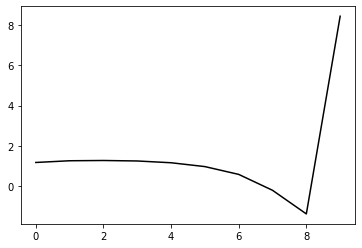

232100 0.2837830809836316
0.4863792295259571 -0.4880719952534305 -0.14756013210894936 -0.1044974030892574
[ 1.27051385  1.0870949   1.09114508  1.05408728  0.95754073  0.76372511
  0.38052301 -0.39685301 -1.54902984  8.44002532]


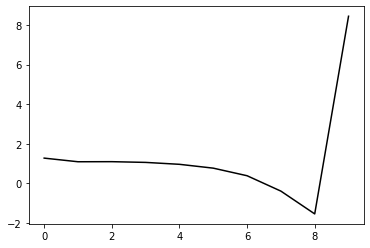

233200 0.18289598982488156
0.5036004956326241 -0.48096664767128 -0.14463284659698367 -0.10727667636774751
[ 1.20828127  1.32290359  1.34206489  1.31135452  1.21602334  1.01598385
  0.62045553 -0.17296991 -1.3445979   8.42262831]


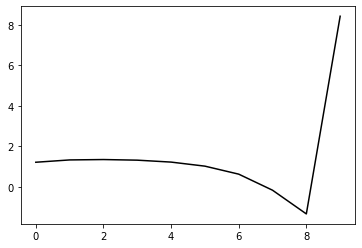

234300 0.1814138687635781
0.49863082296299166 -0.48286024570469827 -0.14635299237723945 -0.10504383820843463
[ 1.18020408  1.2395467   1.25329442  1.22162317  1.12284043  0.92016675
  0.5236359  -0.26780458 -1.43421715  8.44653328]


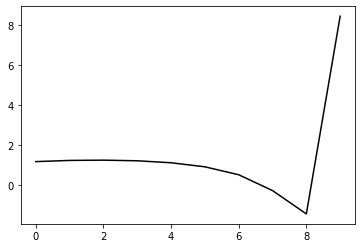

235400 0.18534007649438575
0.5029816804135755 -0.48188337232966505 -0.14746352762446446 -0.10272487127653998
[ 1.18286546  1.21978125  1.25122246  1.23288176  1.14421586  0.94755672
  0.55409224 -0.23525096 -1.3997385   8.39379359]


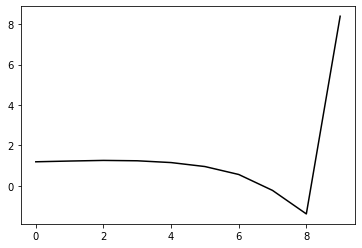

236500 0.19895412688580552
0.5033439909570513 -0.4802032087692968 -0.14637353543729628 -0.10449882479344601
[ 1.17060164  1.30204184  1.3328496   1.32972465  1.25748909  1.07125786
  0.68250608 -0.10511135 -1.2693777   8.47421856]


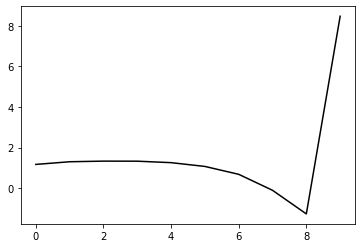

237600 0.18647800177104998
0.4945520086194605 -0.48138579631722733 -0.1468627513671871 -0.10353569750140934
[ 1.23027036  1.11254085  1.15554246  1.14591786  1.06663083  0.87631977
  0.4880758  -0.2909042  -1.43662363  8.40123593]


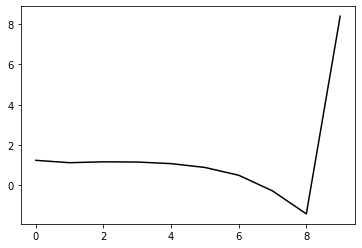

238700 0.12553343720134416
0.4940411030277643 -0.4801438693513257 -0.14651412969717129 -0.10377881903409214
[ 1.15205922  1.23465611  1.25829925  1.24871726  1.17069061  0.97984838
  0.58805255 -0.1972043  -1.35312489  8.43250603]


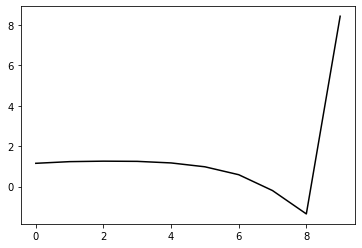

239800 0.16394699000271032
0.49030862275504133 -0.4833937317620612 -0.14947786771344548 -0.10281872692767048
[ 1.16481232  1.2102583   1.23611894  1.23556534  1.17189281  0.99510871
  0.61443036 -0.16167361 -1.30894444  8.43251188]


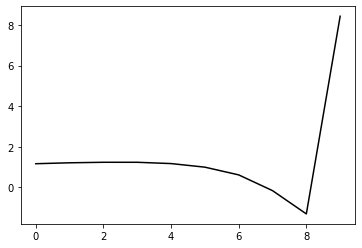

240900 0.18248382161099597
0.4821412172486023 -0.48206252607549266 -0.14764402944940877 -0.10526311866269646
[ 1.17004766  1.15025821  1.15302965  1.14208992  1.07644547  0.90272152
  0.52766366 -0.24009261 -1.37570945  8.4502168 ]


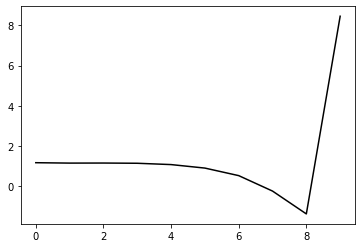

242000 0.21866362582590396
0.48337958900184336 -0.48200126398852533 -0.148386371546183 -0.10458090653513424
[ 1.18990713  1.16710359  1.16952198  1.15687376  1.09655445  0.93042611
  0.56161314 -0.20076103 -1.33039334  8.44017661]


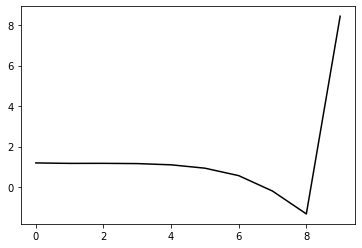

243100 0.238552754807276
0.48504737863652553 -0.47994175049875143 -0.1480618144158287 -0.10292999031367074
[ 1.13648363  1.21439408  1.22751418  1.21596892  1.15579432  0.990414
  0.61840509 -0.15108677 -1.29001431  8.43563726]


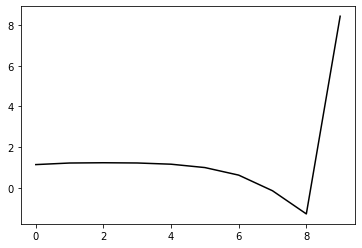

244200 0.38752870339652606
0.46795549552390076 -0.4748112815096841 -0.14112687218426564 -0.10929061255587705
[ 1.25491483  1.03692681  1.01407771  0.99065564  0.92803045  0.77231669
  0.41926439 -0.32487554 -1.43192196  8.41634372]


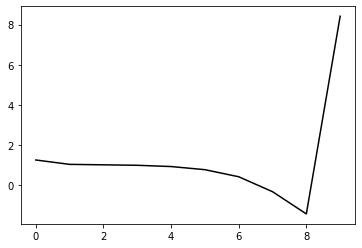

245300 0.17510218205310393
0.48681779168904343 -0.4749979504973161 -0.14602011834399922 -0.1054386224131033
[ 1.15438474  1.25147834  1.2472385   1.22124168  1.15413106  0.98878159
  0.6194745  -0.14715004 -1.28130525  8.45755758]


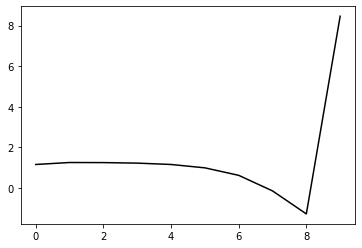

246400 0.18608081588475153
0.4859677064973619 -0.47575930109450454 -0.1475014750330581 -0.1034230107902094
[ 1.16657557  1.21238542  1.22838443  1.20813763  1.14413745  0.98497284
  0.62279247 -0.13765491 -1.26529977  8.41647793]


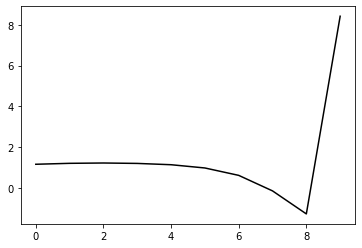

247500 0.21377709417156257
0.4696382660130806 -0.47722173456343076 -0.14785142598652148 -0.10374159402501365
[ 1.18781255  1.15752227  1.1238715   1.08767576  1.01332509  0.85293842
  0.49695503 -0.25429348 -1.3703107   8.44558158]


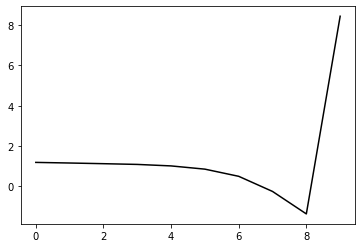

248600 0.1616718584927024
0.47977229121844844 -0.4739620278277685 -0.1467509318010843 -0.10606572378359398
[ 1.18713494  1.19020888  1.19283535  1.1637236   1.09548363  0.94039758
  0.58864451 -0.16079706 -1.27664996  8.42622032]


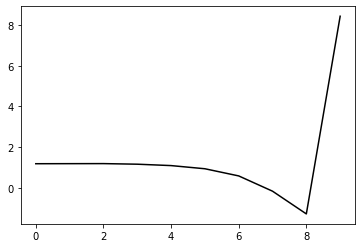

249700 0.11857960939415568
0.4872533707200995 -0.47181756408900566 -0.146770973362751 -0.1055812713069484
[ 1.15279862  1.26918062  1.28673167  1.26458619  1.19723918  1.04158017
  0.68931259 -0.06202133 -1.18086306  8.45280229]


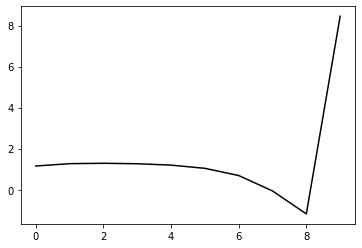

250800 0.13235549581078662
0.4770182592940738 -0.47319961876100713 -0.1473891854402214 -0.10428442535966631
[ 1.1854554   1.18687357  1.1690056   1.13944023  1.06760435  0.90999165
  0.5602369  -0.18542941 -1.29510053  8.44350458]


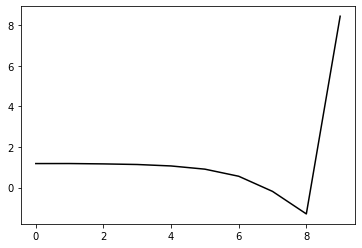

251900 0.21134554600264707
0.478694987357452 -0.47364072579759336 -0.14845286705462268 -0.10411362333767961
[ 1.13026145  1.18976785  1.18878332  1.15743234  1.08254746  0.92237972
  0.57195342 -0.17318657 -1.28076063  8.46246602]


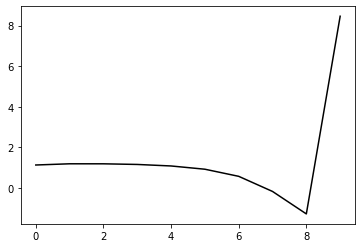

253000 0.2159535323523261
0.4752576504308065 -0.4734328720616877 -0.14860523339187262 -0.10362514559874104
[ 1.17669913  1.14415129  1.12235886  1.08882065  1.01925205  0.86640666
  0.52486725 -0.21143751 -1.31024723  8.44158342]


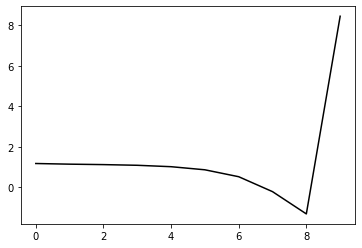

254100 0.2221991187160622
0.4709398288735475 -0.473250831198102 -0.14836657377471374 -0.10471622363684759
[ 1.21074564  1.11865917  1.11116698  1.09057472  1.03516689  0.89793418
  0.571665   -0.15183018 -1.240799    8.46750243]


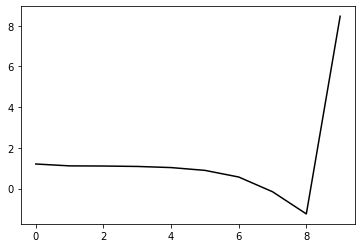

255200 0.2253373042437896
0.46083449693705336 -0.47272099196557626 -0.14677415559639959 -0.1067716713076965
[ 1.22211592  1.07276929  1.0425394   1.00769532  0.94345491  0.80465392
  0.48423399 -0.22814719 -1.3020005   8.40221538]


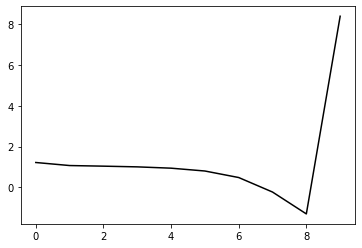

256300 0.2208632445542914
0.48071245144073704 -0.4685701084488096 -0.14729733798975236 -0.1040053539725877
[ 1.10464912  1.25809318  1.24969376  1.20853998  1.13185993  0.97555472
  0.63369889 -0.10336133 -1.20503009  8.47272687]


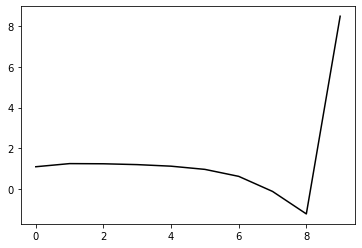

257400 0.19774653754658225
0.47988955235251535 -0.4675059657173885 -0.14739353194380758 -0.10228823215493875
[ 1.14950233  1.17716765  1.18870563  1.15547999  1.07900999  0.92458949
  0.58931377 -0.13770945 -1.22737446  8.43059521]


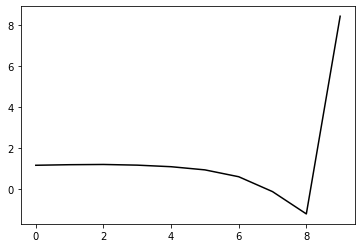

258500 0.19472207146534426
0.4723897244098395 -0.46896912993786183 -0.14761954970919583 -0.10567217969268046
[ 1.18879037  1.18348809  1.20896273  1.21265565  1.17005725  1.04263057
  0.72924171  0.01867522 -1.05977419  8.50161048]


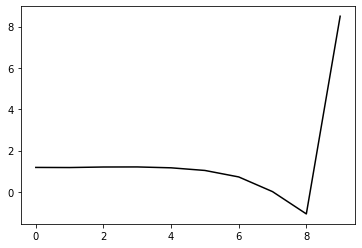

259600 0.17439396710502297
0.4526971643272561 -0.47338789002268566 -0.15025636360361874 -0.10305660066979018
[ 1.19303534  1.09139988  1.03788761  1.00771456  0.94878529  0.81506965
  0.503903   -0.19851158 -1.2648559   8.44355714]


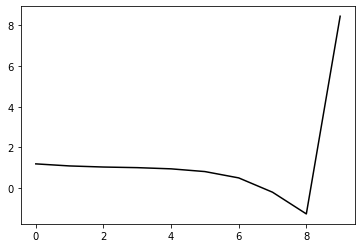

260700 0.11631650169102027
0.46887538446405375 -0.4677647440634013 -0.14807831191932166 -0.10678016623542742
[ 1.17047341  1.21300084  1.18614027  1.15495688  1.10032013  0.97103386
  0.66338583 -0.03632528 -1.10140077  8.48964401]


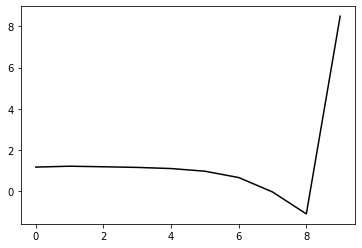

261800 0.1391129269278781
0.4676630331765328 -0.46459584683752103 -0.14610401147094051 -0.10806099436840362
[ 1.18413018  1.21501368  1.19674148  1.16012115  1.09896771  0.965116
  0.65364119 -0.04915815 -1.11726165  8.43214087]


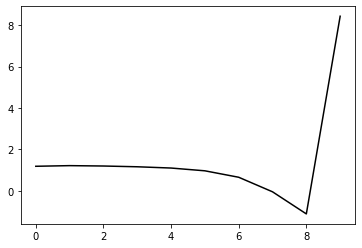

262900 0.1967057622936906
0.46430514574471304 -0.4677418264776709 -0.14902648475737448 -0.106531134901005
[ 1.15117603  1.21181154  1.19593261  1.15980997  1.09616071  0.96153164
  0.65118112 -0.04852931 -1.11190849  8.47384225]


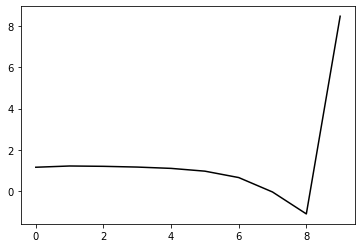

264000 0.22237362250357917
0.4661193057591247 -0.46419401887391504 -0.14799726205035438 -0.10279642951348561
[ 1.13212337  1.21025347  1.19912148  1.15159657  1.07070665  0.92031846
  0.59726236 -0.11253457 -1.1849931   8.45010404]


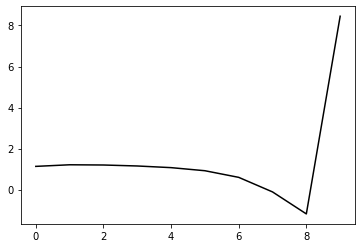

265100 0.1901210019741399
0.4564498042932385 -0.46490486722065133 -0.1477096359529935 -0.10518198783923152
[ 1.17257962  1.16898709  1.16310335  1.13006078  1.05848716  0.9168752
  0.6045748  -0.09292852 -1.15273123  8.47343427]


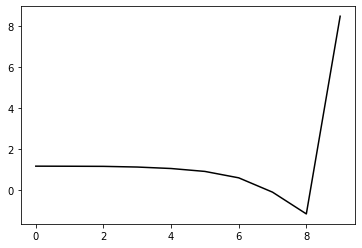

266200 0.3252729819361216
0.4395943327934824 -0.46136880415320924 -0.14317683142621218 -0.10852186577411556
[ 1.24772892  0.96448054  0.94730293  0.91455236  0.84622014  0.71179516
  0.41212823 -0.26817768 -1.30719303  8.39990734]


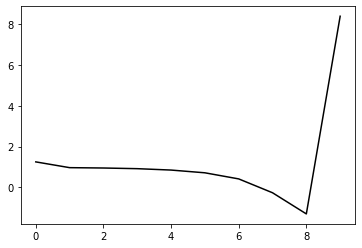

267300 0.1880355259831697
0.459664958190738 -0.4656152900722344 -0.15098373709285895 -0.10366031414013577
[ 1.13022522  1.21252672  1.18839874  1.1506523   1.07808218  0.93539399
  0.6256478  -0.06564854 -1.11749512  8.48018574]


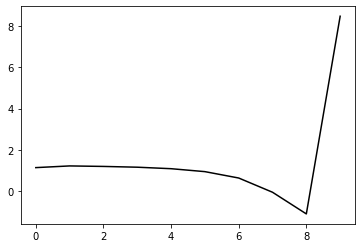

268400 0.2677048513071467
0.45851000735437075 -0.46440791173988694 -0.15145911144184035 -0.09994841280097976
[ 1.12557828  1.18625067  1.15294193  1.09540215  1.00321826  0.84216114
  0.51787634 -0.1828658  -1.24030234  8.4367061 ]


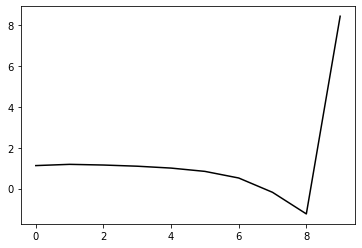

269500 0.19942199710642286
0.46534662084123984 -0.45614677127750786 -0.14555212213166274 -0.10592647789768356
[ 1.16041445  1.2428218   1.25508482  1.21953862  1.14146375  0.98852377
  0.66759066 -0.03240735 -1.09116358  8.49451215]


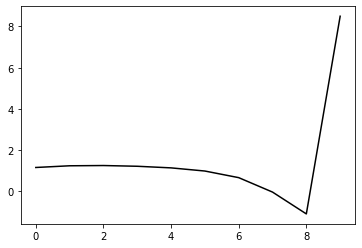

270600 0.14760680931107928
0.4672644300885222 -0.45509837932674085 -0.14539626301588393 -0.10658009544332563
[ 1.13708095  1.26589248  1.27082556  1.23514615  1.15191627  0.99320121
  0.66864763 -0.03198561 -1.08974769  8.47386815]


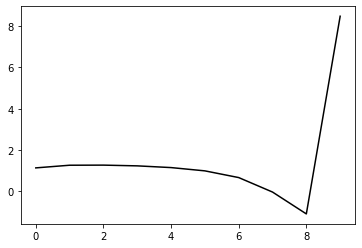

271700 0.30569410036979433
0.459466926228115 -0.4607450399495489 -0.15031860710208436 -0.10155198904111891
[ 1.07603475  1.20799168  1.20237462  1.1678958   1.07924475  0.91240333
  0.58290309 -0.11731519 -1.17065502  8.48039984]


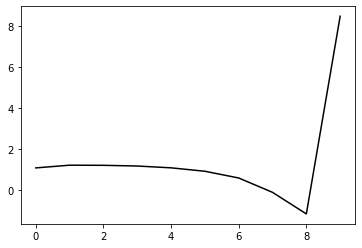

272800 0.13324615686136845
0.456595387250375 -0.4548328129291905 -0.14481766553814085 -0.10743771709161999
[ 1.15878205  1.18633556  1.18719757  1.15797269  1.08180573  0.92837488
  0.61320878 -0.07143377 -1.10940664  8.4425269 ]


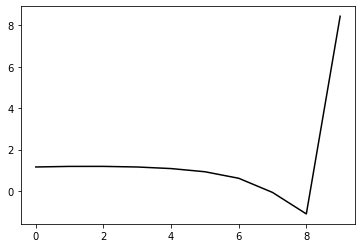

273900 0.19126599642961914
0.45152039195446814 -0.45902786057117045 -0.1489893019731082 -0.10646357555287016
[ 1.1399393   1.19051472  1.17076241  1.13287243  1.0508373   0.89149835
  0.57229179 -0.11219834 -1.14653626  8.46831869]


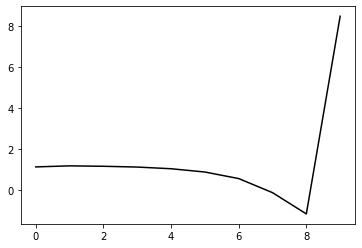

275000 0.20871714105236738
0.4523213047948314 -0.458713487726127 -0.14936989679180754 -0.10610542297748382
[ 1.14251226  1.15819685  1.15454085  1.12043523  1.04229044  0.88653389
  0.5706588  -0.10833872 -1.13552943  8.44604039]


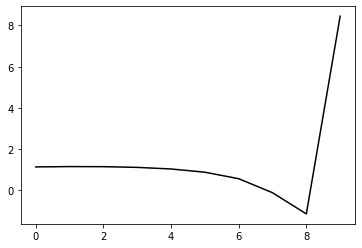

276100 0.19283278281711047
0.4475720870767785 -0.4578459891398942 -0.1486751279577521 -0.10534356865849108
[ 1.16248463  1.10552929  1.08979336  1.06143231  0.99004014  0.84102729
  0.53117507 -0.14042644 -1.15910962  8.46680445]


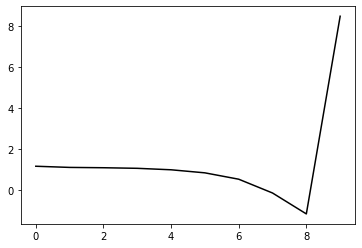

277200 0.2641425719965432
0.4244678135290185 -0.4590154775034338 -0.14704316832156838 -0.10797694664531357
[ 1.23087291  0.91703546  0.87517307  0.84507684  0.78608449  0.65542286
  0.36576461 -0.28360939 -1.27793191  8.41176373]


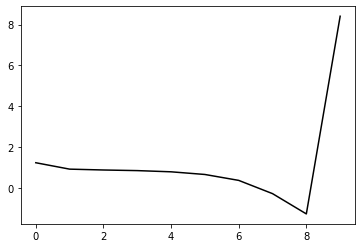

278300 0.18398722493503067
0.44263166118359903 -0.46015062780036375 -0.1513170896739619 -0.10787941023137243
[ 1.17929555  1.09930236  1.06279216  1.02986618  0.97308478  0.84337095
  0.55215766 -0.10013873 -1.09893529  8.50294827]


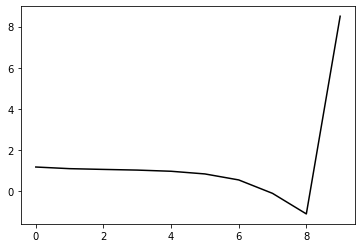

279400 0.18941141407516152
0.440449099130703 -0.45995676238793687 -0.15188278864521368 -0.10715276790059092
[ 1.13217422  1.16367534  1.12456802  1.08518076  1.02372317  0.8915251
  0.59749513 -0.0573995  -1.05892621  8.45702989]


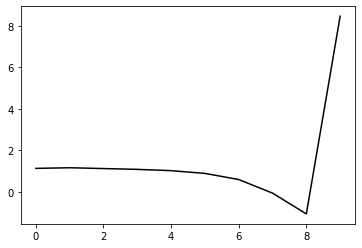

280500 0.19590091003308915
0.4463987337039816 -0.4564512557026545 -0.14995160727326778 -0.10856493015418328
[ 1.14645004e+00  1.21113424e+00  1.18515095e+00  1.14257034e+00
  1.07823347e+00  9.46500623e-01  6.54213956e-01  2.91179454e-03
 -9.92998349e-01  8.48204227e+00]


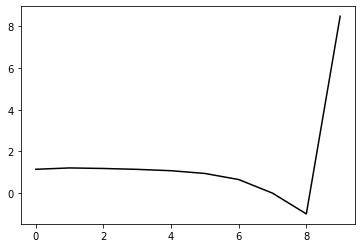

281600 0.15461239539465407
0.44553844214254673 -0.45157800066857723 -0.14701028839523775 -0.10881743115580728
[ 1.13401202  1.17488684  1.1615725   1.11657762  1.04195137  0.90184148
  0.60260676 -0.05426443 -1.05482847  8.44655678]


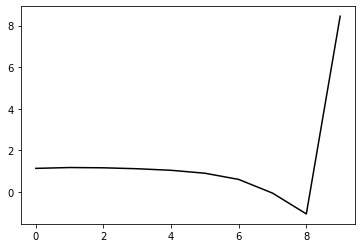

282700 0.11974990940312161
0.4468237177667544 -0.45308221674599014 -0.14853880815524945 -0.11001944417205362
[ 1.16013084  1.19804116  1.19383242  1.16014802  1.09399665  0.96262481
  0.6736161   0.0285429  -0.95844321  8.49520282]


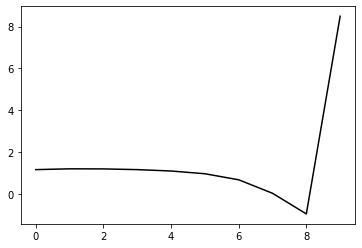

283800 0.12944296027929533
0.44760428656301615 -0.44990963675783824 -0.1470306794364707 -0.10769554177616353
[ 1.15612121  1.13618242  1.13511657  1.0980793   1.02480875  0.88690531
  0.59411199 -0.05182487 -1.03718462  8.47109836]


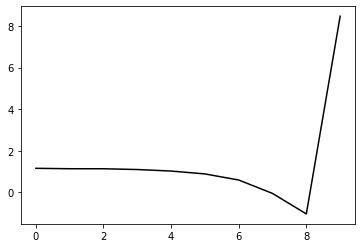

284900 0.18375452649037222
0.4361831500630672 -0.45265371033182994 -0.14861867642463134 -0.10619420656927536
[ 1.12030788  1.06798809  1.04123944  1.00056719  0.92324508  0.78171818
  0.48817623 -0.15527949 -1.13531789  8.4998626 ]


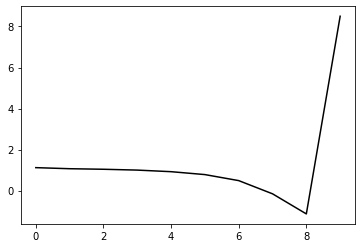

286000 0.20815734685734585
0.4384339249803829 -0.4529005808620639 -0.15051650074779058 -0.10563613622808177
[ 1.12667955  1.16299051  1.12448231  1.07616356  0.99498438  0.84748836
  0.54778061 -0.10082386 -1.08497834  8.46337663]


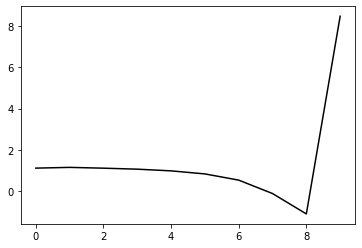

287100 0.19357438314107328
0.4404560148481004 -0.4490202096524597 -0.14835750988944144 -0.10705207216893395
[ 1.16322045  1.16880875  1.15970806  1.12023494  1.04599547  0.90355938
  0.60722444 -0.03857173 -1.02040568  8.49396432]


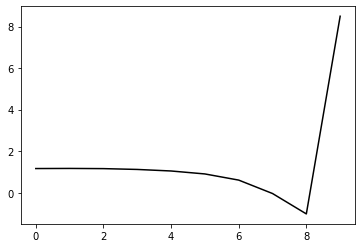

288200 0.18602208346725027
0.43779602891733194 -0.44507402854869993 -0.14547911456088158 -0.10887107045626122
[ 1.16160355  1.17099572  1.16043491  1.11864079  1.03954329  0.89472984
  0.598646   -0.04456625 -1.02233897  8.45445285]


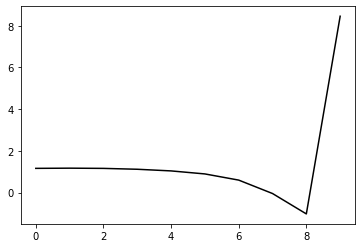

289300 0.17515301014246515
0.42487243747346914 -0.45090767103829665 -0.1494644122600697 -0.1063636819077606
[ 1.1208038   1.05340023  1.00831046  0.95725164  0.87041484  0.72041121
  0.42337757 -0.21612578 -1.18591756  8.49659805]


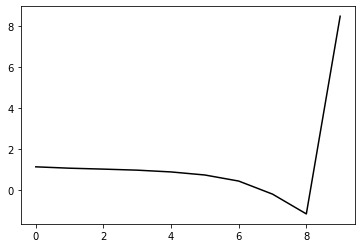

290400 0.20190576976759605
0.4436437972596723 -0.4444276781619768 -0.1480782769043007 -0.10420111102529098
[ 1.1130724   1.18877736  1.16545499  1.11152344  1.02098971  0.86221254
  0.55371056 -0.09721985 -1.07772232  8.43915584]


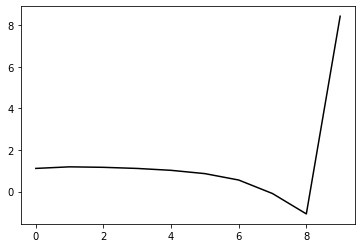

291500 0.21552500781214814
0.4450889241539085 -0.44291075311033423 -0.14726220349460248 -0.10766058486451739
[ 1.10636788  1.23861959  1.24267935  1.20256955  1.12025451  0.96800087
  0.66510107  0.01998791 -0.95453668  8.5061537 ]


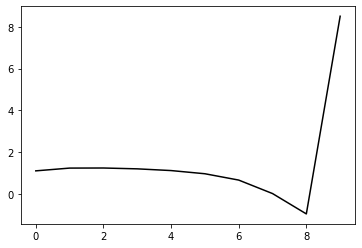

292600 0.1539829614458938
0.4314631343139206 -0.44447711145138324 -0.14705734910789622 -0.10924265165711676
[ 1.1333492   1.1321209   1.12360927  1.08643938  1.00528365  0.85528633
  0.55726649 -0.07927698 -1.04152222  8.47363232]


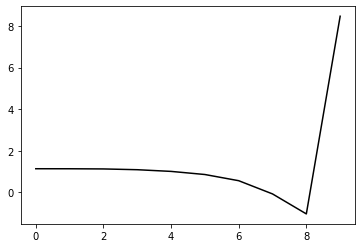

293700 0.11605460139903317
0.4415330527811515 -0.4415489880149764 -0.14715326173037035 -0.10782557204594269
[ 1.12028097e+00  1.20114950e+00  1.20061331e+00  1.16575659e+00
  1.08702636e+00  9.36217802e-01  6.35924619e-01 -2.58773794e-03
 -9.66640446e-01  8.48564832e+00]


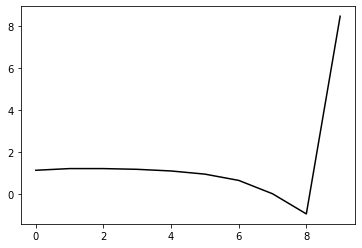

294800 0.13977120141011687
0.42842987363851726 -0.44552006189793175 -0.14924800168151062 -0.10651580276068215
[ 1.15109587  1.06955724  1.05373036  1.0197555   0.94626816  0.80212551
  0.51006981 -0.11733605 -1.06695826  8.45714341]


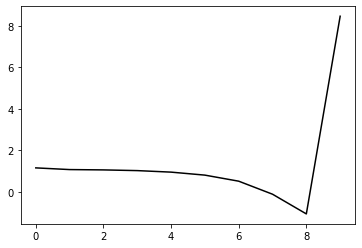

295900 0.2230486226924919
0.43462548546910074 -0.4429976588655464 -0.14886169573255162 -0.1062418668765193
[ 1.09283911  1.17781183  1.16889039  1.1340252   1.0576581   0.90703539
  0.60604871 -0.02971433 -0.98647275  8.48721707]


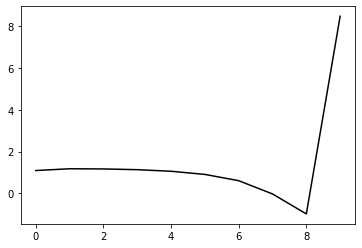

297000 0.21050765800236992
0.4252875884670491 -0.44566967130153273 -0.1510715232608625 -0.10576674731765773
[ 1.13742025  1.11883559  1.09966077  1.07137894  1.0067669   0.86797526
  0.57748138 -0.04776381 -0.99334268  8.46629659]


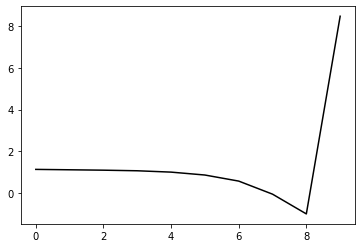

298100 0.30584365417933695
0.4173662148443537 -0.4426067597218285 -0.14825749576096156 -0.10756702229368707
[ 1.23238979  0.96436575  0.93365117  0.90164533  0.84234292  0.71499338
  0.43855661 -0.17016322 -1.09654153  8.49569637]


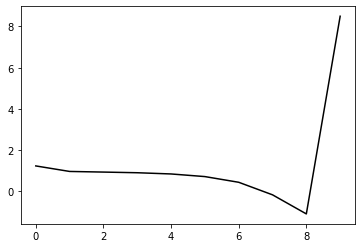

299200 0.17967366060556766
0.4342895138646799 -0.4352186651694311 -0.14566195899998455 -0.10817199475551911
[ 1.15417672  1.21856488  1.18839318  1.14110355  1.06585292  0.91986401
  0.62189715 -0.00916465 -0.95795484  8.48178492]


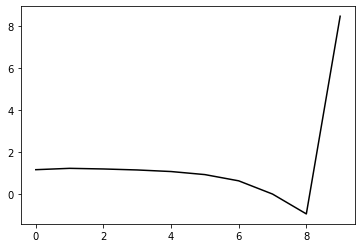

300300 0.1874668564185011
0.4409431037578241 -0.43352944842078783 -0.14653932518434679 -0.1047869497781687
[ 1.08699863  1.2043905   1.20193837  1.15405028  1.06786241  0.91146146
  0.60319246 -0.0367117  -0.99191617  8.50474843]


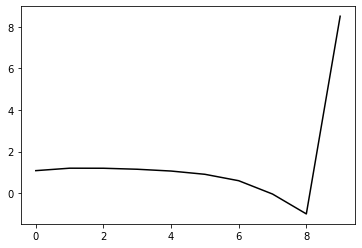

301400 0.22376246139532965
0.4118362699477554 -0.44132387166419473 -0.14959393566267032 -0.10491559185493682
[ 1.15983279  0.98362582  0.93287909  0.89630105  0.8276996   0.69529908
  0.41479465 -0.19544553 -1.11851709  8.42491268]


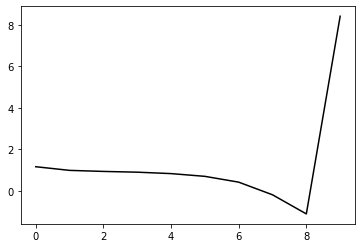

302500 0.20158148088445252
0.4320475891452518 -0.43770395625056363 -0.1495366878631192 -0.1072105387688112
[ 1.14448702e+00  1.13492820e+00  1.10494748e+00  1.07021997e+00
  1.00941712e+00  8.83235359e-01  6.07635214e-01  1.79980703e-03
 -9.16243380e-01  8.50430211e+00]


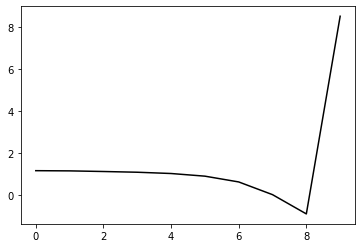

303600 0.17961213267888462
0.41730496577950793 -0.44132252637317715 -0.1509496778298337 -0.10727777452416092
[ 1.17672696  1.0556386   0.99576153  0.94649938  0.87849782  0.74979896
  0.47533108 -0.12544302 -1.03355977  8.46929116]


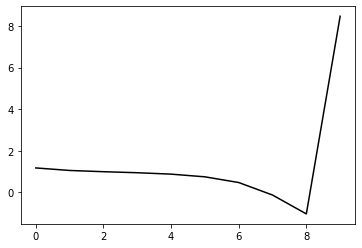

304700 0.11829407707941463
0.43711667069022997 -0.4351951704198346 -0.14933105233892494 -0.10705469783258316
[ 1.13339267  1.18973929  1.16818352  1.10899227  1.02824747  0.88755738
  0.60102304 -0.01138659 -0.93029343  8.51215002]


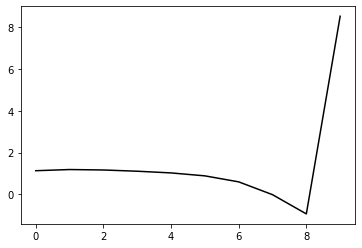

305800 0.13886381218236077
0.41646870100575306 -0.43833166049412203 -0.14992603322955902 -0.10809966228363906
[ 1.15179732  1.10991982  1.04109794  0.97734334  0.89495132  0.7574052
  0.47728569 -0.12639253 -1.03389144  8.47507823]


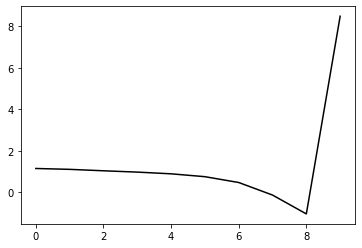

306900 0.20091086476680814
0.4278141722099381 -0.4372385390587391 -0.15130411119619927 -0.10942681899353285
[ 1.10886284  1.16695695  1.13402386  1.07347369  0.99181625  0.85477976
  0.57509997 -0.02823697 -0.93499366  8.51542266]


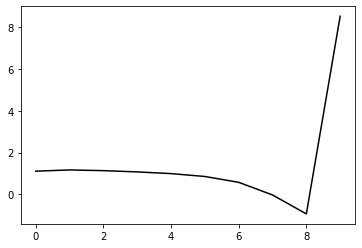

308000 0.22991035026129553
0.4221196759684325 -0.4406863281406123 -0.15440984870563237 -0.10710324889181203
[ 1.10987649  1.17798895  1.13916223  1.08161607  0.99888991  0.86075529
  0.58099886 -0.0216336  -0.9264484   8.45276546]


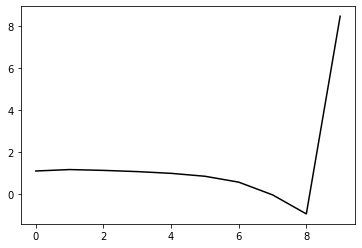

309100 0.20423602911259958
0.42707928240332865 -0.4325954459042417 -0.14910410810867017 -0.10821526726671507
[ 1.15900738  1.16600024  1.13713855  1.06827678  0.97032753  0.81744951
  0.52615147 -0.08445217 -0.99329419  8.48506616]


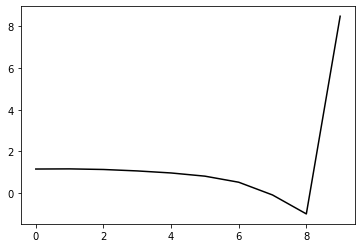

310200 0.19268142879035116
0.4296395914476891 -0.42899161329004254 -0.14715466471376806 -0.10924204398144662
[ 1.17629465  1.2159215   1.21256865  1.17024712  1.08302574  0.93397364
  0.64394454  0.03314262 -0.8762875   8.47721978]


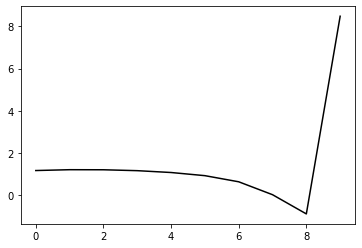

311300 0.17348417156461682
0.41847663738685786 -0.43533036073078213 -0.15144187846922147 -0.10705895544117895
[ 1.13288921  1.10509951  1.07746205  1.02889496  0.93953     0.78962729
  0.50313296 -0.09963745 -0.99639128  8.51972233]


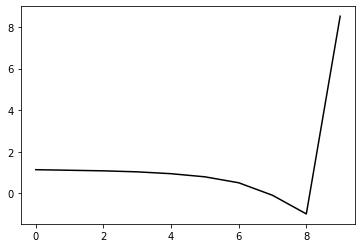

312400 0.19450417893265448
0.4205753566916803 -0.43390404977328056 -0.15130468370047165 -0.10636321073341014
[ 1.14859822  1.09311214  1.0732404   1.0254264   0.9373372   0.78602262
  0.49854434 -0.10280134 -0.99496809  8.45041216]


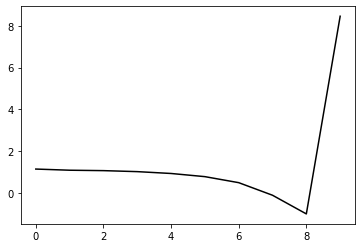

313500 0.19087816015788073
0.42356210995204235 -0.43101695323149747 -0.14949505093064203 -0.10879953279103931
[ 1.14030809  1.18407653  1.18718715  1.15483076  1.07895564  0.93398601
  0.64866049  0.0479351  -0.84393732  8.52958713]


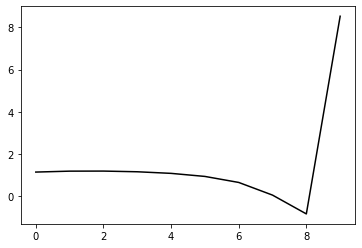

314600 0.18557124358058452
0.39704413352039386 -0.4372709573152098 -0.15241337170170274 -0.10642560050331422
[ 1.17062674  0.98598424  0.91606837  0.86880217  0.78884424  0.64631838
  0.36908656 -0.21806618 -1.09097979  8.46844353]


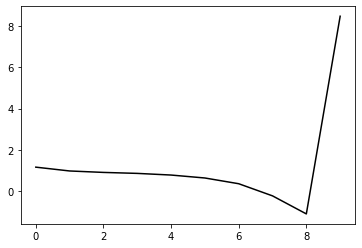

315700 0.11646180955866334
0.4233033630069212 -0.4282012522133542 -0.14927669643996933 -0.10939777206543824
[ 1.14432259  1.18185683  1.13608238  1.08021477  0.99770507  0.8513636
  0.56841242 -0.02518943 -0.90517428  8.47852048]


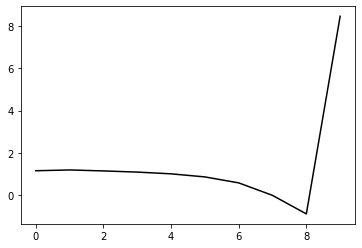

316800 0.19682179501895317
0.4257924535312336 -0.43211390751177975 -0.1538547395843914 -0.10487566710425537
[ 1.09040494  1.17197911  1.16015189  1.10580371  1.01901355  0.86937777
  0.58310162 -0.01224035 -0.89135744  8.49430014]


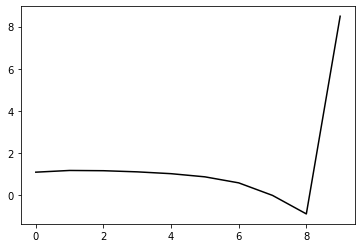

317900 0.19582881615049852
0.4242575258295938 -0.42762869954671673 -0.15022385115489878 -0.10888996290125469
[ 1.11497846e+00  1.15044470e+00  1.14536195e+00  1.10101660e+00
  1.01796171e+00  8.70966708e-01  5.86715177e-01 -6.05946440e-03
 -8.81256678e-01  8.53052771e+00]


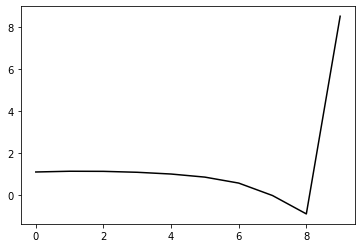

319000 0.21016988681270182
0.41565834509734206 -0.43017084193662386 -0.151802697169084 -0.10741441214135386
[ 1.12401276  1.08894245  1.07963987  1.04404894  0.96658828  0.82369277
  0.54381336 -0.04285648 -0.90908042  8.4817722 ]


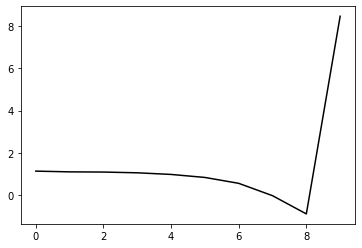

320100 0.21474770251395114
0.4087299221364195 -0.43192219291881817 -0.15278197088128131 -0.10754404789654726
[ 1.15377777  1.02848059  1.00010204  0.96312846  0.88894718  0.74989969
  0.47547526 -0.10280692 -0.95667466  8.50933735]


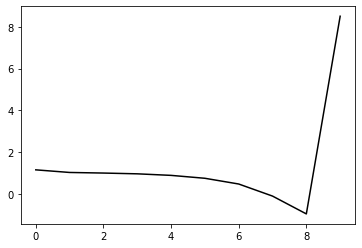

321200 0.26303565684054525
0.40167559256653373 -0.42743496745451964 -0.14813950676935825 -0.11215332163729179
[ 1.19894948  1.01433929  0.9720232   0.93237215  0.8635403   0.73073521
  0.46252672 -0.10821998 -0.95203355  8.44744627]


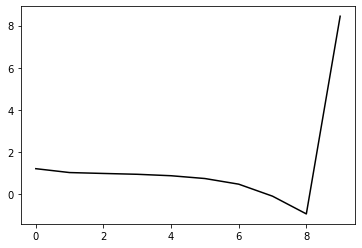

322300 0.1720042928659072
0.40610583738460354 -0.42893637757874103 -0.15138806878156777 -0.10832294604319102
[ 1.09901109  1.12873732  1.06056255  0.98420817  0.88384602  0.72240008
  0.42835487 -0.16374047 -1.024032    8.50658785]


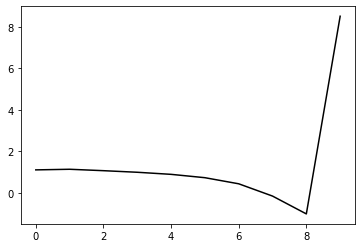

323400 0.19568222080223577
0.4188920093362874 -0.4250437942955549 -0.15131822404522013 -0.10618707082062384
[ 1.11116738  1.15413288  1.13456788  1.06593777  0.96445966  0.80058959
  0.50204243 -0.09478875 -0.95826805  8.46168531]


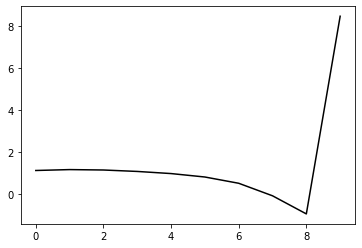

324500 0.21011948479208883
0.4176851550910886 -0.42154197052430814 -0.14905094259506313 -0.10653612669506884
[ 1.1387944   1.10361536  1.09901695  1.0475213   0.95377587  0.79548996
  0.5006408  -0.09369792 -0.95436238  8.50801587]


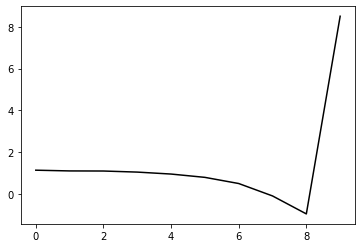

325600 0.1736651619725254
0.41295501136429996 -0.42285313228687677 -0.14954685975913556 -0.1093243382332307
[ 1.14973688  1.12376749  1.12496333  1.09140328  1.01026235  0.86011342
  0.57161926 -0.01674103 -0.87015019  8.4841709 ]


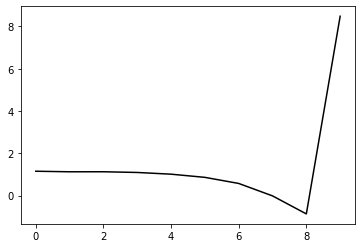

326700 0.13684685194814752
0.4127254594393392 -0.4237195516531415 -0.151252629075184 -0.10585441117701959
[ 1.09982649  1.13118993  1.11098138  1.06365442  0.9716947   0.81026215
  0.51192338 -0.08342914 -0.93995543  8.48473971]


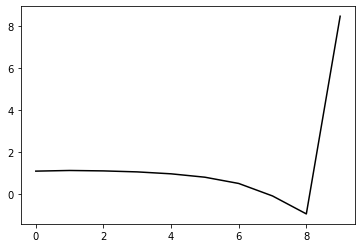

327800 0.16408346102983068
0.41237284207236313 -0.4241935252168499 -0.15199530047027843 -0.1069088420914616
[ 1.10479556e+00  1.14591150e+00  1.14284554e+00  1.11267679e+00
  1.03616339e+00  8.84362633e-01  5.91028883e-01 -9.83240335e-04
 -8.53324921e-01  8.48371503e+00]


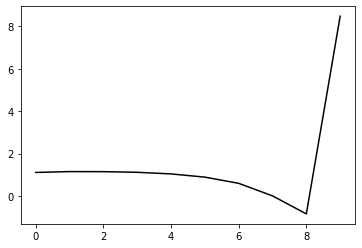

328900 0.19008001410814143
0.4105779773760034 -0.4198727954225261 -0.14910079155616035 -0.10746427644515036
[ 1.13522257  1.08595349  1.07551393  1.04492225  0.97288897  0.82552416
  0.53510774 -0.05420414 -0.9024747   8.50075909]


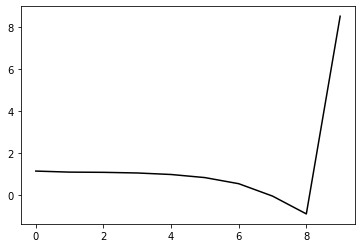

330000 0.20672279521838996
0.40828508942941666 -0.42034221340415023 -0.15016686410763713 -0.10624990280921143
[ 1.1050674   1.09748922  1.08855956  1.06395343  0.99582235  0.84945269
  0.55639367 -0.03669495 -0.88745932  8.49159163]


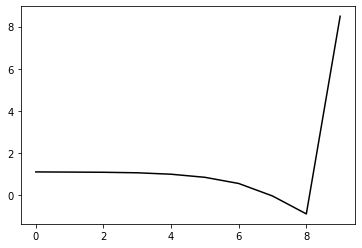

331100 0.2005991602393561
0.40874897970003715 -0.4182775940090039 -0.14895070837880217 -0.107329931182338
[ 1.14765104e+00  1.09884175e+00  1.08557957e+00  1.06587673e+00
  1.00903738e+00  8.73241572e-01  5.87435765e-01  3.70735347e-04
 -8.42682447e-01  8.52301180e+00]


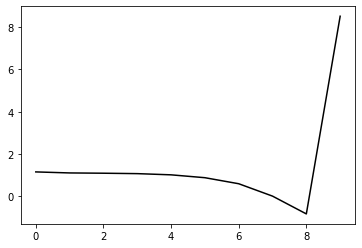

332200 0.1923862722137459
0.4002280528732642 -0.4218311204739256 -0.15077526211758685 -0.10818801629235761
[ 1.12498406  1.11154174  1.0926406   1.06482597  1.00762903  0.87882152
  0.60236942  0.02540282 -0.8058176   8.49313491]


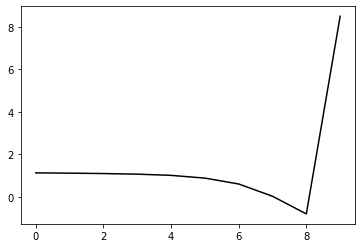

333300 0.18659065490682325
0.3963471859824436 -0.422034807930383 -0.1506879100987226 -0.10990915639853426
[ 1.14772914  1.0745091   1.0561147   1.03296125  0.98140343  0.86057464
  0.59175356  0.02189147 -0.80017003  8.53348295]


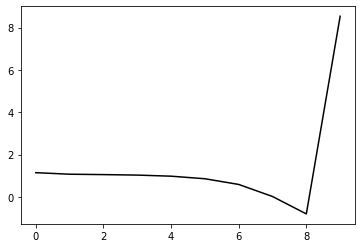

334400 0.18792825327363055
0.39657459658037214 -0.4223924609170696 -0.15210862948294937 -0.10680779568437358
[ 1.12675303e+00  1.08524820e+00  1.06739826e+00  1.03826711e+00
  9.80219766e-01  8.53748397e-01  5.79226524e-01  3.77683321e-03
 -8.21385086e-01  8.48680763e+00]


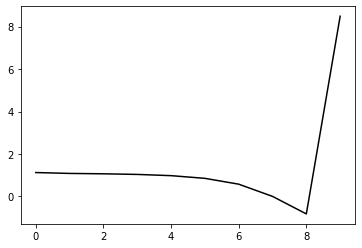

335500 0.20780467383841653
0.392712270408114 -0.4232076133458349 -0.15233645282196345 -0.10866657741868117
[ 1.11720859e+00  1.06891882e+00  1.05069046e+00  1.02252318e+00
  9.64918046e-01  8.40038363e-01  5.67774062e-01 -4.65681618e-03
 -8.23412579e-01  8.52725869e+00]


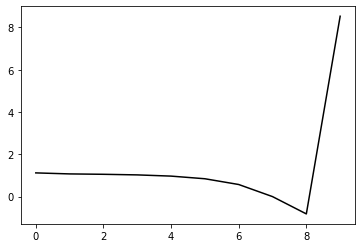

336600 0.20756242452081367
0.3941967135085623 -0.41416774777632354 -0.1467444511519705 -0.10783335555396938
[ 1.15606001  1.12525049  1.06802023  1.00959344  0.92460945  0.77330501
  0.47736997 -0.11464881 -0.94625236  8.47227657]


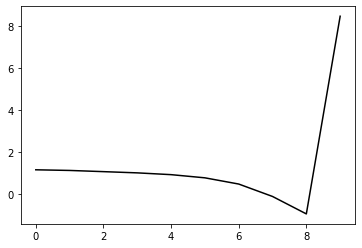

337700 0.11556574012267411
0.3965164158333782 -0.4171884083658546 -0.1501962226531287 -0.10884197237506121
[ 1.13744295  1.17327152  1.15507983  1.10831177  1.03309208  0.89213243
  0.60616809  0.02343197 -0.79788596  8.52079482]


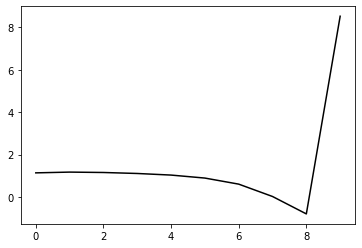

338800 0.1331670175131031
0.3961409099157486 -0.4136834011929226 -0.14791237278398825 -0.10936596012222
[ 1.12700785  1.13258489  1.12965497  1.08207778  0.99835931  0.84908594
  0.55576857 -0.03325878 -0.85763365  8.48841625]


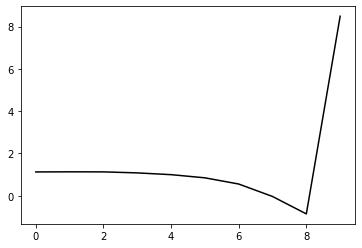

339900 0.18472797022127024
0.38923408180037145 -0.41808690051456987 -0.15136551173580026 -0.10620814169846456
[ 1.15309975  1.07684019  1.05956356  1.01487032  0.93045069  0.7796392
  0.48599312 -0.10206562 -0.92204004  8.53016012]


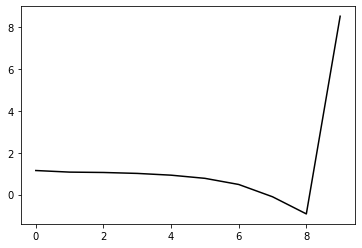

341000 0.19672247431086917
0.39125316986077213 -0.4189941105249091 -0.15342305936776937 -0.10278838337115265
[ 1.1053514   1.04074164  1.02438107  0.97862787  0.89267612  0.73969056
  0.44441507 -0.14514174 -0.96522363  8.48157687]


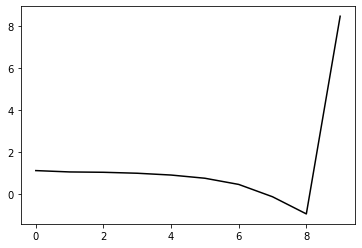

342100 0.23303107015736974
0.38691151742136565 -0.4172935039785636 -0.15175056906455753 -0.10686327098909572
[ 1.17358153  1.08232547  1.05166121  1.00917912  0.92994217  0.78151296
  0.49013736 -0.09549457 -0.90978801  8.50847502]


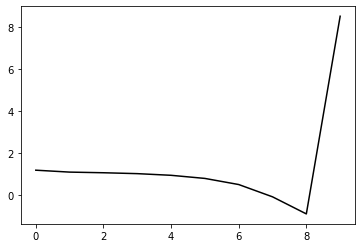

343200 0.19224742151016394
0.39481294842810893 -0.40847802491078783 -0.14689723427222334 -0.1088694632472735
[ 1.1516965   1.23428339  1.22581209  1.17956441  1.09345377  0.934764
  0.63031056  0.0299398  -0.79916625  8.48755146]


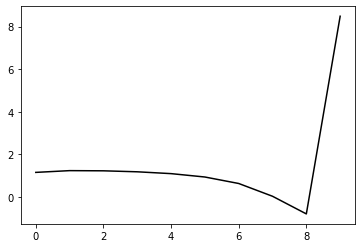

344300 0.17676055882044653
0.3957679847538032 -0.41128007419857443 -0.15033056662840164 -0.10611525339202431
[ 1.08043168e+00  1.19375951e+00  1.19462931e+00  1.15374487e+00
  1.06630681e+00  9.05107193e-01  5.97687099e-01 -5.49862763e-03
 -8.35522866e-01  8.53856004e+00]


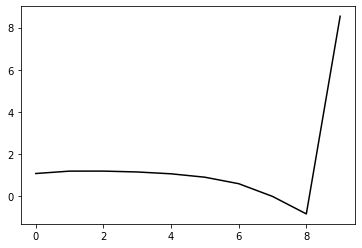

345400 0.2407820783020181
0.38628031730950096 -0.4180851441889834 -0.15464353023318528 -0.10374706871916857
[ 1.09849602  1.12463881  1.10531403  1.07173449  0.99186232  0.83748597
  0.53770276 -0.05609693 -0.87261568  8.45508839]


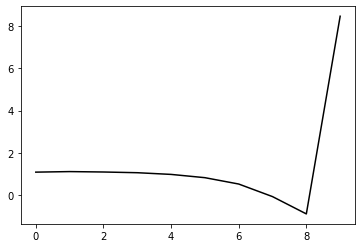

346500 0.2063738320031574
0.39290510051625904 -0.4109476555462859 -0.15038708436882572 -0.1076182317137489
[ 1.15527681  1.16713618  1.19415609  1.18196177  1.12039998  0.97791122
  0.68420152  0.09266416 -0.72237034  8.5443489 ]


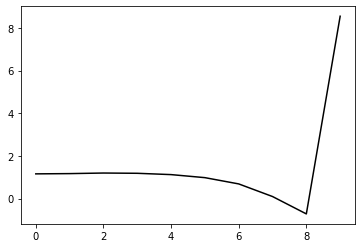

347600 0.16527588040671776
0.3897766850730795 -0.40879309692319105 -0.14939408189411743 -0.105552120013723
[ 1.10241741  1.1465843   1.13350928  1.10261188  1.02767291  0.87356314
  0.56942305 -0.03085431 -0.85154663  8.50723912]


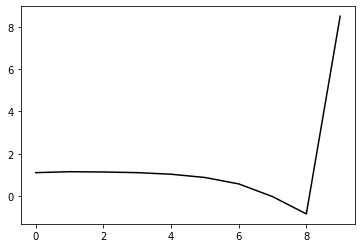

348700 0.18798026647177005
0.392244921816484 -0.40345447399267625 -0.14661541928894678 -0.10439982776347992
[ 1.16933109  1.00796906  1.01488444  0.98181239  0.90452964  0.74904001
  0.44390298 -0.15621648 -0.97382036  8.50944412]


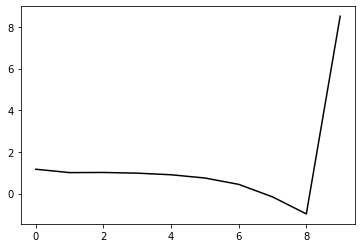

349800 0.1272686270925912
0.38724319295469894 -0.4081287857616401 -0.14930696506087188 -0.10857232606789381
[ 1.12150341e+00  1.16013831e+00  1.15330037e+00  1.12515311e+00
  1.05175142e+00  8.98600901e-01  5.94773828e-01 -3.88333241e-03
 -8.17908652e-01  8.49781695e+00]


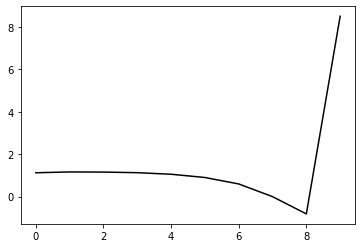

350900 0.19097196716060552
0.3858656832165694 -0.4097526782509837 -0.1509979783244662 -0.10702057453959558
[ 1.10330105  1.13235816  1.12884046  1.10018625  1.02697117  0.87377854
  0.56930897 -0.02974384 -0.84194763  8.50681718]


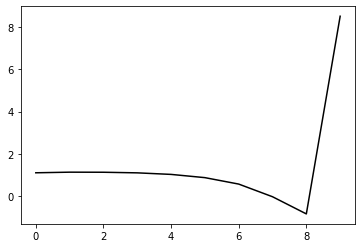

352000 0.2097455046732664
0.3816703067198854 -0.41143170215853914 -0.1522392174477171 -0.10610612874271397
[ 1.10835021  1.073537    1.06873     1.05106636  0.9888967   0.84613104
  0.55045554 -0.04058123 -0.84289836  8.47181205]


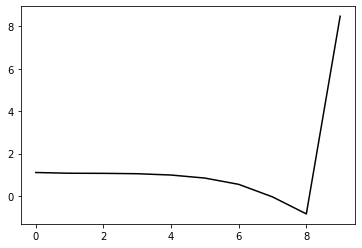

353100 0.19600890006675623
0.38598842244987497 -0.4057933440862459 -0.14927894452609944 -0.1062214779391105
[ 1.13794916  1.10800959  1.10470002  1.08422662  1.02291597  0.8798029
  0.58153501 -0.01340849 -0.81879692  8.50643997]


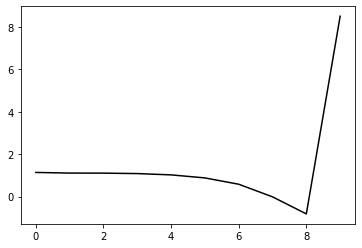

354200 0.17975774888694715
0.3877551890554411 -0.4031339830901171 -0.14779119550016065 -0.10847193414807467
[ 1.13792968  1.16834719  1.18167836  1.16826714  1.11196508  0.97227423
  0.67475033  0.07915309 -0.72549009  8.51286281]


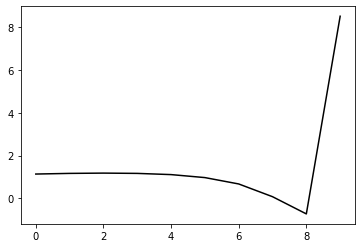

355300 0.22178948800969542
0.3583370461104449 -0.4106729281637145 -0.14989542033709202 -0.10740019789202912
[ 1.1412171   0.83680971  0.78542168  0.7647562   0.71193466  0.58194795
  0.2970438  -0.28367287 -1.0687588   8.53196963]


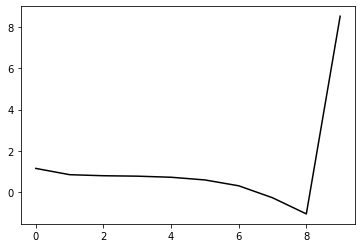

356400 0.1890460579929482
0.38201675583456524 -0.40823268680723646 -0.15253185404659006 -0.10745451803783433
[ 1.12144098  1.11152432  1.05966405  1.02902773  0.97714249  0.84834474
  0.56302787 -0.01950546 -0.80636083  8.49978733]


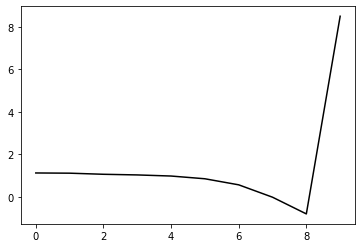

357500 0.21651699125039323
0.37268969210924774 -0.41177694492835604 -0.15490118418844825 -0.1070191904375746
[ 1.12012414  1.10084498  1.04113175  0.99736106  0.93853542  0.80791771
  0.52174535 -0.06126198 -0.84658893  8.50171638]


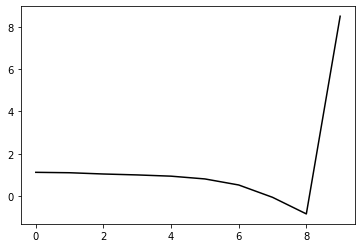

358600 0.15810269862758866
0.38509818967470005 -0.40507523314837396 -0.15199244126237296 -0.10961646990932375
[ 1.11448797  1.14990115  1.13472338  1.08816469  1.02271046  0.88861155
  0.59876292  0.0108831  -0.77912596  8.50103406]


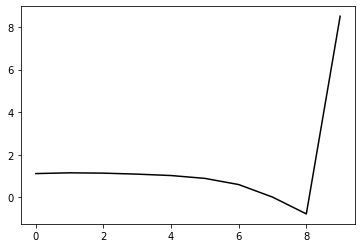

359700 0.12169747366826328
0.3801771340254305 -0.40799220384593093 -0.1542679775370538 -0.10901003002343572
[ 1.12312668  1.14335659  1.12444704  1.09604784  1.04181062  0.9196088
  0.64067657  0.06108975 -0.72122717  8.52191865]


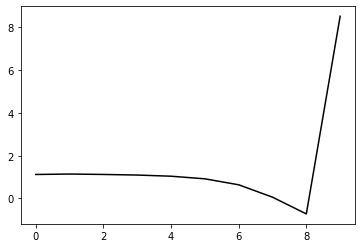

360800 0.12766216085723023
0.37654728743445665 -0.4057678966641334 -0.1529385287082372 -0.11035211227375274
[ 1.12637383e+00  1.17467815e+00  1.11855215e+00  1.07070683e+00
  1.00332613e+00  8.71559061e-01  5.85851160e-01  5.16111996e-04
 -7.85606183e-01  8.50566717e+00]


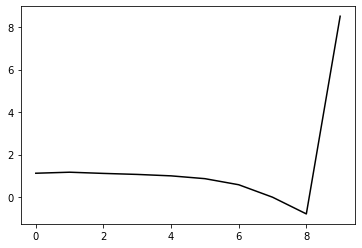

361900 0.20166264822988203
0.38056344963303856 -0.4068153959441732 -0.15488398797217123 -0.11069153681584457
[ 1.1093542   1.19398029  1.17971692  1.13843238  1.07465716  0.94746186
  0.66646763  0.08438368 -0.69851794  8.53485586]


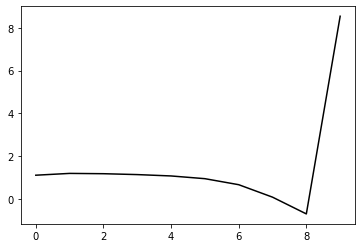

363000 0.21275507019151368
0.3792039902007176 -0.4061481746810457 -0.1555323668576668 -0.10597708033265321
[ 1.09592047  1.09540619  1.08083535  1.04473764  0.97799614  0.84985042
  0.57023693 -0.01084439 -0.79217769  8.49711915]


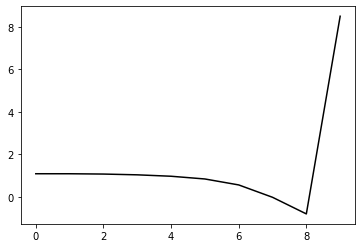

364100 0.2410549146940563
0.37197020257350444 -0.4013346974267257 -0.15083339915757493 -0.10878143657719656
[ 1.15102963  1.01919712  1.01356631  0.98022313  0.91464669  0.7863219
  0.50753471 -0.07313443 -0.85335449  8.5006365 ]


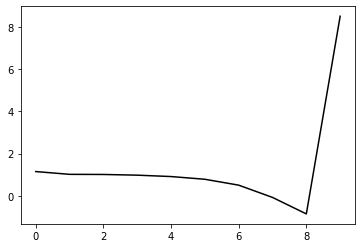

365200 0.18297741057661418
0.3828907053611468 -0.3999190886025263 -0.15201735642108788 -0.10810632652410662
[ 1.11006679  1.13726211  1.13113184  1.10260738  1.03900278  0.91066032
  0.63205034  0.05121223 -0.72851228  8.49784912]


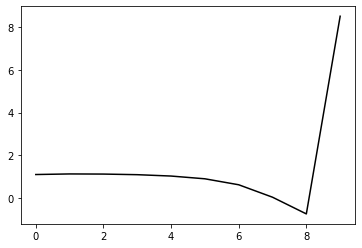

366300 0.16722066514556866
0.389549319708691 -0.394087991446577 -0.14966752588135024 -0.10612278778780586
[ 1.07356924  1.12571566  1.12514329  1.09580083  1.02709667  0.89100391
  0.60477285  0.01585994 -0.77153777  8.5571363 ]


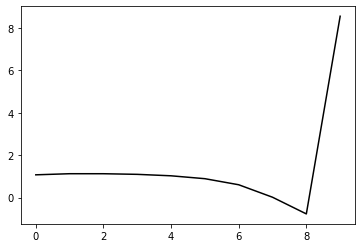

367400 0.19334084981553123
0.3729005657486719 -0.40310481230120715 -0.15440775593206343 -0.10582356377070273
[ 1.10559735  1.04783579  1.0293956   1.00969742  0.95185863  0.82608508
  0.55194712 -0.02309565 -0.79308215  8.50267736]


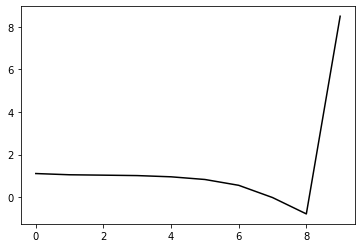

368500 0.19590946289573088
0.37808569666134995 -0.3989988383165537 -0.1521271375386192 -0.10912125395436877
[ 1.12328466  1.10743214  1.09826641  1.07855692  1.0269018   0.90649261
  0.63763656  0.06800262 -0.69527654  8.51812317]


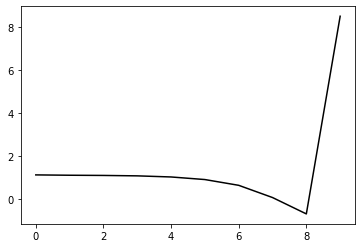

369600 0.18147074518021192
0.3800386039674614 -0.39847956234511844 -0.15278196969676702 -0.10781147822141834
[ 1.07618111  1.10733244  1.09285729  1.06614796  1.01002107  0.88637913
  0.61497824  0.04336871 -0.72057769  8.51059213]


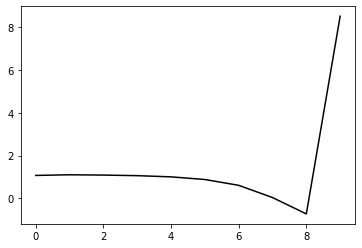

370700 0.11464873461167428
0.38365312815640396 -0.39496805028776805 -0.15130920855563532 -0.10837631451412053
[ 1.11684251  1.16505815  1.14599966  1.1184036   1.0673521   0.94914032
  0.68215314  0.11379813 -0.64722501  8.53111845]


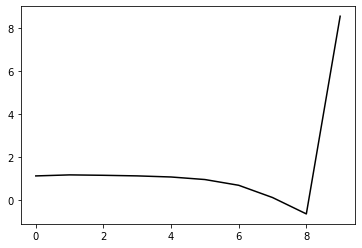

371800 0.14190602401142982
0.374984770507596 -0.3957742109186152 -0.15076804210630546 -0.11065431066381363
[ 1.13562544  1.07374584  1.04033389  1.01260349  0.96646729  0.85660151
  0.59948985  0.04228471 -0.70510013  8.48205126]


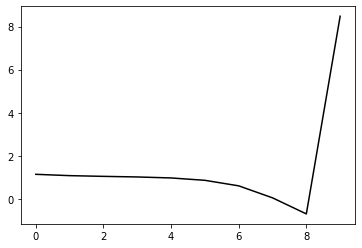

372900 0.19509944548061464
0.3724460778430281 -0.3995315388703653 -0.15420656520418538 -0.10829750206300506
[ 1.06797337  1.00118136  0.96784969  0.9340234   0.88540754  0.77748299
  0.52419279 -0.02824347 -0.7692508   8.52326866]


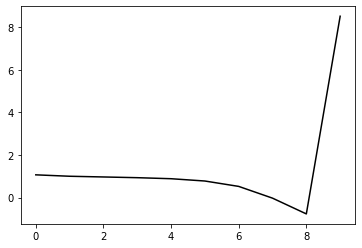

374000 0.20844650192481204
0.3733474873605324 -0.3970484445817893 -0.15341810395971578 -0.10721979361779437
[ 1.09856819e+00  1.11818491e+00  1.04739671e+00  9.95396709e-01
  9.35335346e-01  8.18080670e-01  5.56305241e-01 -4.19378452e-03
 -7.52182909e-01  8.51251060e+00]


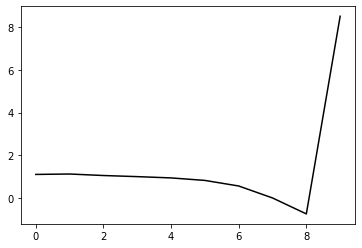

375100 0.20877685607017643
0.3767578289948674 -0.3948464590518564 -0.15263743228696852 -0.10761133713359451
[ 1.08098261  1.11625286  1.08713567  1.03456796  0.96830659  0.84832106
  0.58523027  0.02367086 -0.7244222   8.54718227]


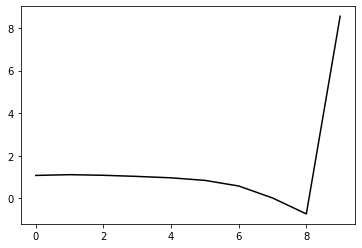

376200 0.17107958415226227
0.3734328614385478 -0.3956301048611352 -0.15337748648105604 -0.10737382086551434
[ 1.09879278  1.12484069  1.10072868  1.06332073  1.00548779  0.89388386
  0.63974898  0.08631814 -0.65380966  8.52076165]


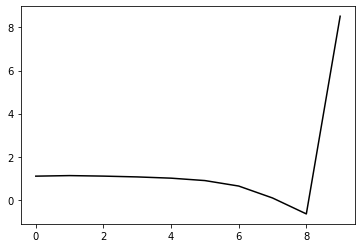

377300 0.18867359687031804
0.35950499822055615 -0.3960668722899051 -0.15233827902448616 -0.10849179835763535
[ 1.12361115  0.93074859  0.87098083  0.82593028  0.76165975  0.64789928
  0.39695576 -0.15011661 -0.8806312   8.52762446]


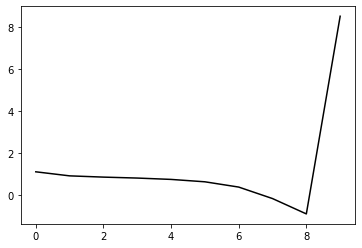

378400 0.19400483514643496
0.3645374589146099 -0.3988399118193469 -0.15596304105536893 -0.10932312508210006
[ 1.1402738   1.07791094  1.03832879  0.99789973  0.94148789  0.8339252
  0.58906118  0.04755358 -0.67741037  8.49327388]


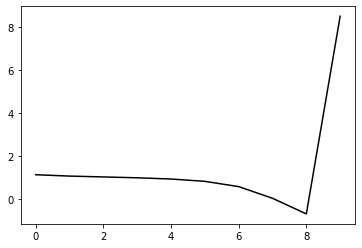

379500 0.2911107941001752
0.3585804275328393 -0.4034485758506691 -0.16058618385501272 -0.10406672384865448
[ 1.12751384  1.02804008  0.96533396  0.91500359  0.85187176  0.73983933
  0.49280184 -0.04965533 -0.77453991  8.53347981]


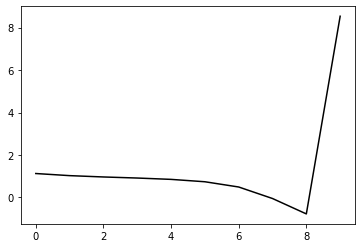

380600 0.16322397060287328
0.36652383752506573 -0.3950624315577788 -0.15527317660321474 -0.10902211358322249
[ 1.12227095  1.17601815  1.12505914  1.05678261  0.97510462  0.84611587
  0.58431828  0.02869564 -0.70821974  8.5076328 ]


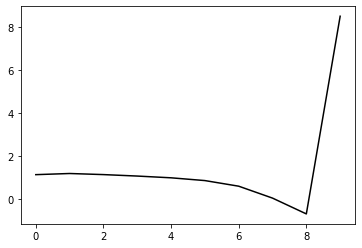

381700 0.1179120647188112
0.36925876196182567 -0.3919402836934235 -0.1541155691460922 -0.10951102173565568
[ 1.13936671  1.19347509  1.15218467  1.08398818  0.99684305  0.86387728
  0.60046081  0.04461024 -0.69154236  8.52338146]


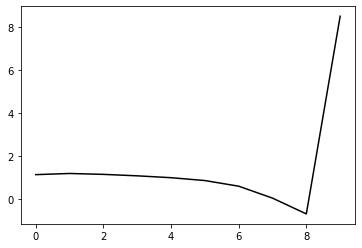

382800 0.1279297179250353
0.3760303373498333 -0.38810217513528456 -0.1524436658591327 -0.10908734755329223
[ 1.13354625  1.17577343  1.17140725  1.1112649   1.01960922  0.88108523
  0.61424932  0.05660627 -0.68009006  8.49753553]


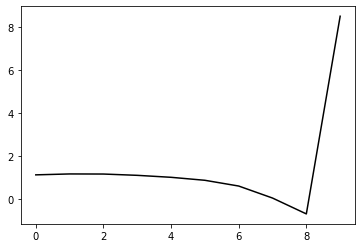

383900 0.20642578549524612
0.3774462354219358 -0.38868868206913265 -0.15403605461885064 -0.10729529771897946
[ 1.09375325  1.16192942  1.16953539  1.12584351  1.0369036   0.89532799
  0.6261851   0.06718171 -0.67044501  8.54660391]


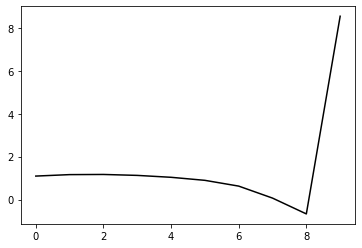

385000 0.21297439935701773
0.3691823440828791 -0.39210763582919206 -0.15631323076788253 -0.10492546365580667
[ 1.09401105e+00  1.11460331e+00  1.09650025e+00  1.05773781e+00
  9.72965943e-01  8.30925460e-01  5.62114962e-01  5.23702738e-03
 -7.28907857e-01  8.51372483e+00]


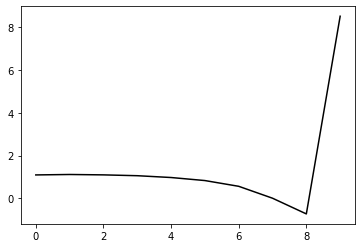

386100 0.21648573334542148
0.3707766263766401 -0.3886478925332679 -0.15405778651237884 -0.1073068284405246
[ 1.16016449  1.07176265  1.0771538   1.04992814  0.97874092  0.84574245
  0.58513396  0.03770811 -0.68568612  8.54628698]


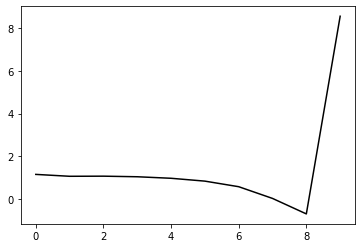

387200 0.19103493952012526
0.3653700945186296 -0.39287055054882314 -0.1572168219744057 -0.10680028609778935
[ 1.08945554  1.13539597  1.11978894  1.09209977  1.02416037  0.89223663
  0.63234576  0.08731531 -0.63208353  8.51512123]


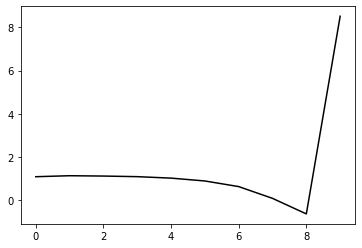

388300 0.25054179307137525
0.37071321942637475 -0.3893691136734206 -0.15625164951251902 -0.10715212382799014
[ 1.04592993  1.16965328  1.15399315  1.12166343  1.05388913  0.92067133
  0.65755769  0.10908319 -0.61464377  8.57148522]


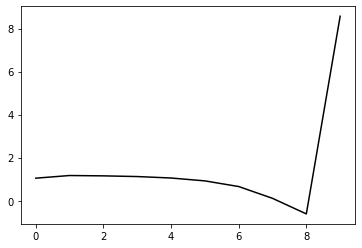

389400 0.1975485294574143
0.36924335938159736 -0.3850672864650325 -0.15376652022221618 -0.10402938022998666
[ 1.10357824e+00  1.08663928e+00  1.06186933e+00  1.02172133e+00
  9.49649245e-01  8.13016025e-01  5.46363376e-01 -4.01435783e-03
 -7.27935462e-01  8.47903138e+00]


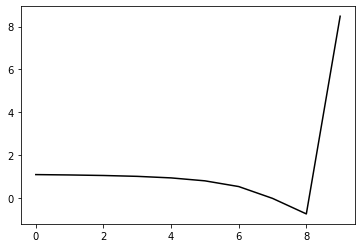

390500 0.19755602160527236
0.3668017016975539 -0.38518280245516545 -0.15339949952975265 -0.10736643013508786
[ 1.14010544  1.10361313  1.10345899  1.07690571  1.01649386  0.89005085
  0.631342    0.08914586 -0.62546822  8.56198804]


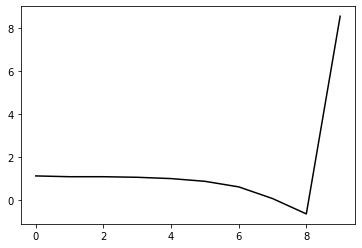

391600 0.16070848812132624
0.36399811415288397 -0.3865980241169766 -0.15434920214685208 -0.10810613774284085
[ 1.12820485  1.12891226  1.12188666  1.10097239  1.04632798  0.92475383
  0.66918884  0.13054496 -0.57939472  8.53221601]


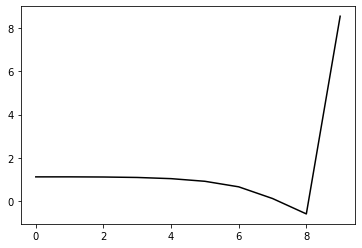

392700 0.11412019821290922
0.37202843673027214 -0.38138340811647703 -0.1520860636859632 -0.10745411906850631
[ 1.10249619  1.17247581  1.18162395  1.15191194  1.08598719  0.95401614
  0.68829603  0.14162202 -0.57391049  8.54405411]


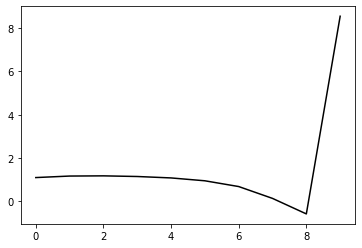

393800 0.14711628331452645
0.3643278640327264 -0.38230706997554365 -0.15166010314012318 -0.10917008278317401
[ 1.1456927   1.06612557  1.03697873  1.01613133  0.96400392  0.8457453
  0.59300845  0.05993576 -0.63990759  8.53022543]


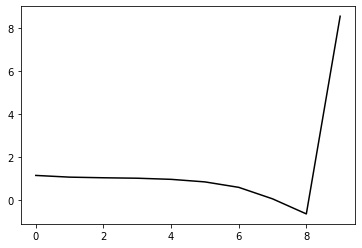

394900 0.18844732686005927
0.35952017172457484 -0.38761936201279973 -0.1558237104847868 -0.10870068733825446
[ 1.09416585  1.04167947  1.009225    0.98229988  0.93315829  0.81985264
  0.57185248  0.04423265 -0.64859624  8.54810695]


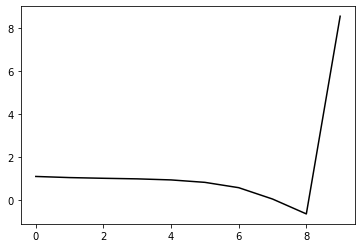

396000 0.20768682985227252
0.36224564323427105 -0.38628670282245575 -0.15624903315946145 -0.10670468661605806
[ 1.09145733  1.15561979  1.08753091  1.0311047   0.96077934  0.8297927
  0.56526692  0.02261466 -0.68369289  8.51220288]


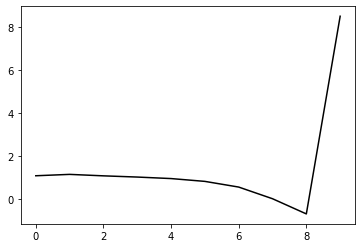

397100 0.19291640012199712
0.3641205028836605 -0.38252418833464163 -0.1540234507762141 -0.10828408270603081
[ 1.13110449  1.14717843  1.12768674  1.07793065  1.00837412  0.88021253
  0.61746755  0.0758094  -0.62931727  8.54425955]


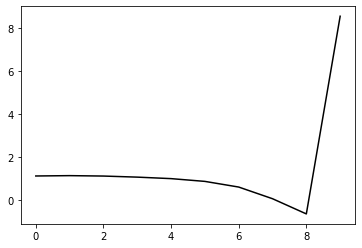

398200 0.1669244955922093
0.3597934480248422 -0.3859734229350582 -0.15654413789956015 -0.10778344686056815
[ 1.09302085  1.12517965  1.11233059  1.07633794  1.01125026  0.88867668
  0.6325448   0.09836912 -0.59724469  8.50558462]


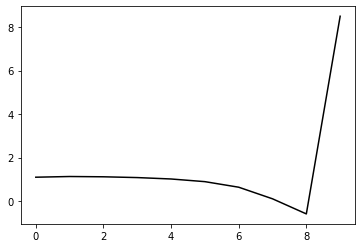

399300 0.18884054609601378
0.3537441991235419 -0.39123148988911577 -0.1604818217274572 -0.10778656166695444
[ 1.09969649  1.13337588  1.11642373  1.09654441  1.0495928   0.94282645
  0.70106375  0.17960346 -0.50387308  8.58293069]


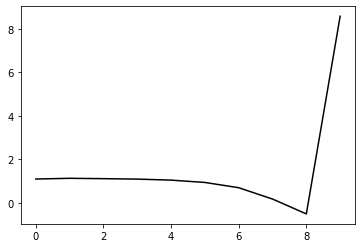

400400 0.16182024768248096
0.35888356624422385 -0.3802443962429089 -0.15367770114005003 -0.10764310397032253
[ 1.123874    1.20018654  1.17371436  1.12549119  1.05177729  0.91897211
  0.6521878   0.10687129 -0.59896564  8.49951411]


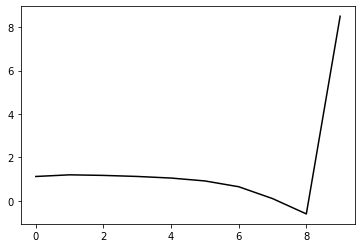

401500 0.22036341405107773
0.3430594039208424 -0.38472061356910464 -0.1560875420089349 -0.10530621856552641
[ 1.15253033  1.00052721  0.94855369  0.89854537  0.82165809  0.68920421
  0.42605998 -0.11268982 -0.80819019  8.52236696]


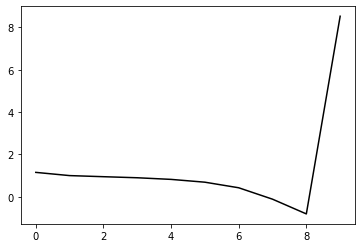

402600 0.14943031953577704
0.3669882531814311 -0.3771623979080487 -0.1537450687894642 -0.1079399465013343
[ 1.10756025  1.22771127  1.20763916  1.15053647  1.06560323  0.92395011
  0.65152287  0.10357661 -0.60086092  8.50903143]


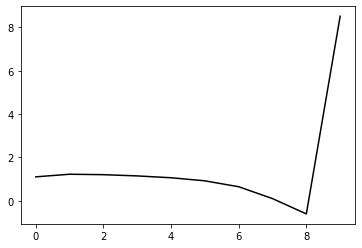

403700 0.12395072867803811
0.35760718547753517 -0.3787594967674194 -0.15430425430354366 -0.10671579738661392
[ 1.11134891e+00  1.15209409e+00  1.11125971e+00  1.05593647e+00
  9.67972550e-01  8.22999279e-01  5.48473250e-01 -1.15859859e-04
 -7.03032569e-01  8.53839561e+00]


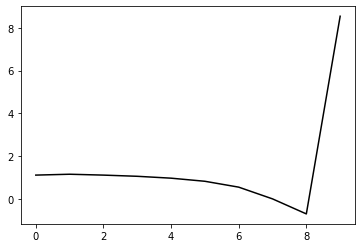

404800 0.2726494957444741
0.36430812349262215 -0.38313935732266236 -0.16007867451460128 -0.10075154510754863
[ 1.07037822  1.12866404  1.11477714  1.05595876  0.96106954  0.80889421
  0.5287767  -0.02365595 -0.72835695  8.50553089]


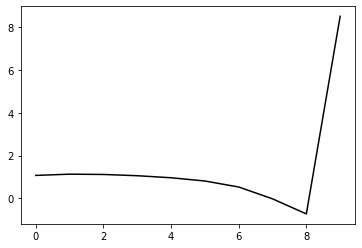

405900 0.1923968646196178
0.35796538079051626 -0.3799998813734982 -0.15616760719015574 -0.10770826965626741
[ 1.09011541e+00  1.07814478e+00  1.06825053e+00  1.02788006e+00
  9.47593891e-01  8.07476562e-01  5.39506535e-01  1.82980710e-04
 -6.89207305e-01  8.54233463e+00]


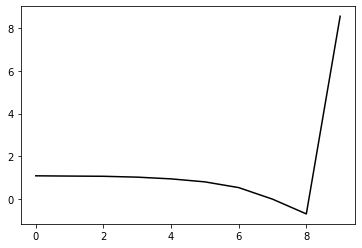

407000 0.20800607135502497
0.3605087266353321 -0.38006166617585324 -0.15744946675073884 -0.10754920094197651
[ 1.10017603  1.16344443  1.13376426  1.08877827  1.00797198  0.86528055
  0.59430437  0.05233152 -0.638988    8.52886648]


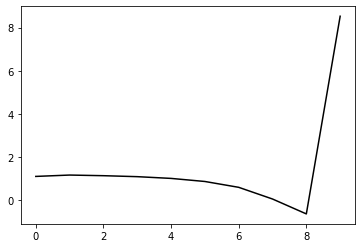

408100 0.18869034656758904
0.36299061748517464 -0.3748922648956991 -0.1543597330428934 -0.10747661892108731
[ 1.12534141  1.14482458  1.13729625  1.09210149  1.00751969  0.85971607
  0.58332365  0.03671201 -0.65809329  8.5535936 ]


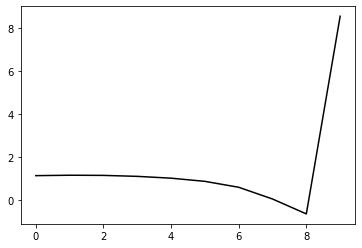

409200 0.17653966297764093
0.36448233334594815 -0.37176513686039336 -0.15255542441519374 -0.10863398801391778
[ 1.1316008   1.18773684  1.19293642  1.16104508  1.08055723  0.93180883
  0.65273759  0.10382661 -0.59202409  8.53176951]


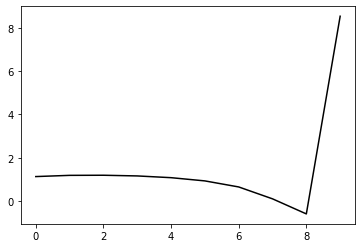

410300 0.23182829015845424
0.3441631523327106 -0.3747458721136155 -0.1522010333458251 -0.1119607938565953
[ 1.13669345  0.98024037  0.93060139  0.88727979  0.80691618  0.66375043
  0.3947474  -0.13989837 -0.81713045  8.54376515]


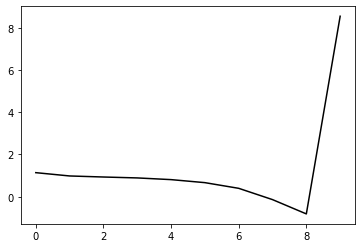

411400 0.1687052137493968
0.35940166020871117 -0.37662098284379836 -0.15674712637670005 -0.10998707291251707
[ 1.14241437  1.160946    1.15135461  1.11187519  1.03698443  0.89521196
  0.62401739  0.08593443 -0.59470895  8.51789525]


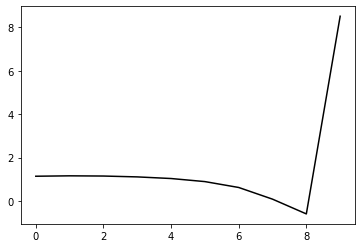

412500 0.1985416665224623
0.3602104628922176 -0.37356302530212876 -0.1551754949988524 -0.10886902165319792
[ 1.13433778  1.08586359  1.09227469  1.06031862  0.98653048  0.84519419
  0.57341363  0.03536766 -0.64348048  8.54171262]


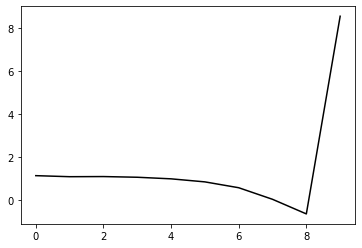

413600 0.20276704275597351
0.36204761670149344 -0.37411450972371985 -0.1564498471999895 -0.107770674879249
[ 1.07010656  1.12079098  1.12338018  1.09371126  1.01781423  0.87099173
  0.59222788  0.04797506 -0.63501852  8.53223833]


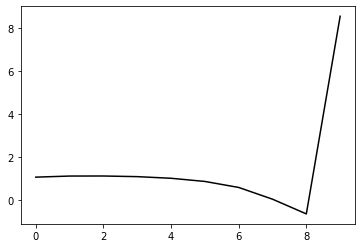

414700 0.11653588634914133
0.3597471717132698 -0.3728057474094223 -0.1555846620379612 -0.10930428418623406
[ 1.12652108  1.19048916  1.19021778  1.16966115  1.10759738  0.96909188
  0.69372783  0.15082482 -0.53093726  8.54852037]


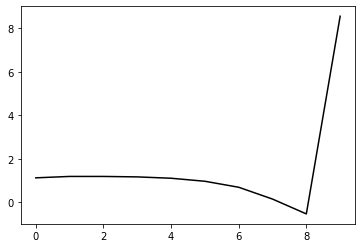

415800 0.12700655968776298
0.35262105000231475 -0.37556173080956406 -0.15732607668657556 -0.10883449788678357
[ 1.14600756  1.12345266  1.10478057  1.08843149  1.03921429  0.91480211
  0.65107751  0.11892789 -0.55100011  8.52095237]


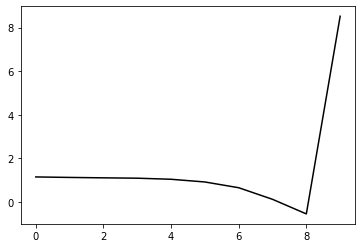

416900 0.18177943625350954
0.35634131740484387 -0.37338332771017113 -0.1570172915667104 -0.10653050013949114
[ 1.12145093  1.07093716  1.06263318  1.03153987  0.97108016  0.8396326
  0.56894765  0.03080262 -0.64240071  8.53929907]


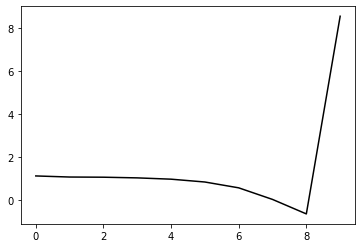

418000 0.208753255710145
0.35325237709546115 -0.3723588497079076 -0.1563257931604222 -0.10584061003929988
[ 1.10109813  1.06828838  1.04851974  1.01787387  0.95472638  0.82204342
  0.54939271  0.00884521 -0.66546669  8.52229391]


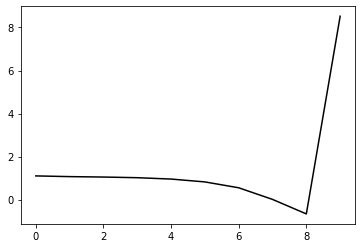

419100 0.18770389379015515
0.35873500437000766 -0.36695234713013286 -0.15365079244353363 -0.106188244116614
[ 1.12289801  1.12233507  1.11434793  1.08450469  1.01934023  0.88346817
  0.60579562  0.05880847 -0.6215377   8.54398203]


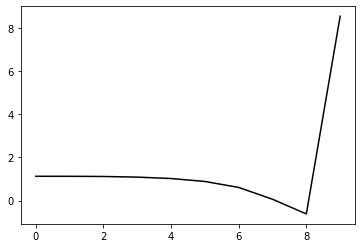

420200 0.24833488147565272
0.3417823903011019 -0.3697510121499546 -0.1530378317849134 -0.10995289387219476
[ 1.17839752  0.96396309  0.92653158  0.89867069  0.84195692  0.72031599
  0.46104714 -0.06441401 -0.71810444  8.51110612]


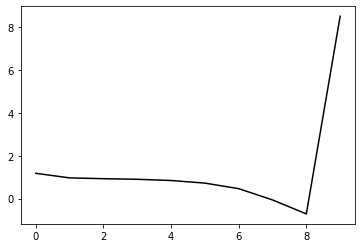

421300 0.1660466392479216
0.3591183407627902 -0.36703718308899935 -0.15439369596793182 -0.10737643547778393
[ 1.07515286  1.19474471  1.16179922  1.10227061  1.01590701  0.86424415
  0.57553152  0.02225279 -0.65622377  8.54783744]


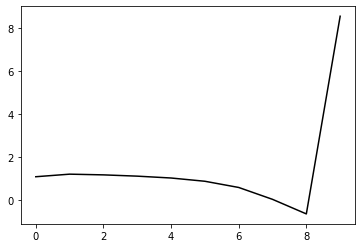

422400 0.2079772818745341
0.3461832081224635 -0.3734808015888889 -0.1578131412967986 -0.10862879483991589
[ 1.17733169  1.05391328  1.03635774  1.00374896  0.9387379   0.80892557
  0.54153119  0.00891414 -0.64711872  8.52542828]


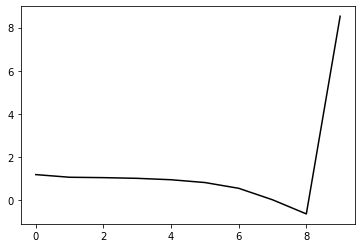

423500 0.19991235367326485
0.3550137382307085 -0.36687200571660467 -0.15483058393064686 -0.10718503919715905
[ 1.13579138  1.14147381  1.13917674  1.1005177   1.02604415  0.88556756
  0.60712758  0.06286151 -0.60425158  8.56718598]


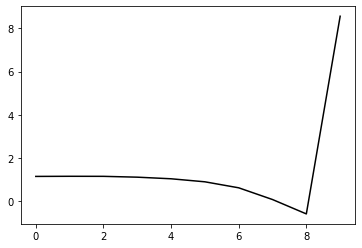

424600 0.16020461505757314
0.3529169076580207 -0.368733656044538 -0.1566412996460271 -0.10537062651688427
[ 1.14475637  1.02268731  1.02791076  0.99884819  0.92941008  0.79361947
  0.52089925 -0.01693058 -0.67517235  8.51042432]


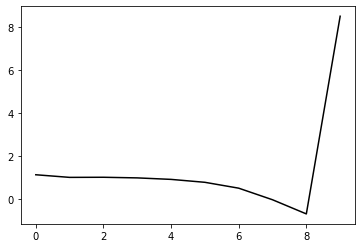

425700 0.11926984227415932
0.34803120596946613 -0.36818993781646675 -0.15579752553219992 -0.10858162248000902
[ 1.12541692  1.14267716  1.093088    1.0508189   0.97392633  0.83038493
  0.55126889  0.0085629  -0.65188191  8.52770479]


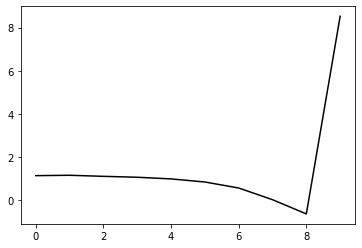

426800 0.14767263845303302
0.3545715052210226 -0.36449311839338056 -0.15422132548234274 -0.10883636101919043
[ 1.15087855  1.08059402  1.08352336  1.04657385  0.97428947  0.83500129
  0.55937074  0.01974675 -0.63653409  8.51166077]


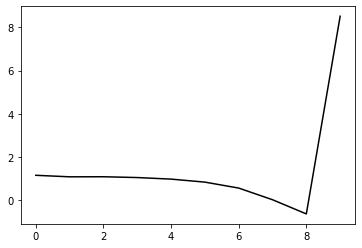

427900 0.19578321524953962
0.35132139785698663 -0.3681261393634272 -0.15676159925378969 -0.10884661780804535
[ 1.13699419  1.08718939  1.0754395   1.04199059  0.97291487  0.83673636
  0.56483071  0.03009057 -0.61835201  8.53223824]


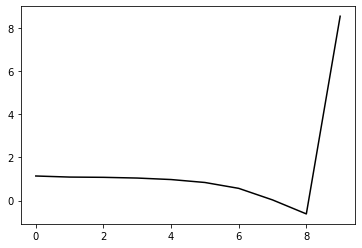

429000 0.24599125646221845
0.34844136297729794 -0.37362002074477113 -0.16150231133119392 -0.10486963845799414
[ 1.07998897  1.00958096  1.00096762  0.97346476  0.90858742  0.77658128
  0.50899564 -0.02100356 -0.6626622   8.53406585]


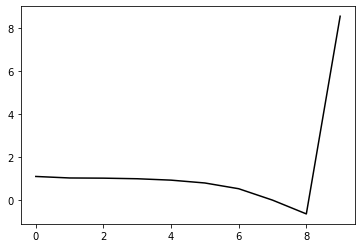

430100 0.19764366165489625
0.35631372512213394 -0.3632148369278033 -0.15507267265463223 -0.10782142583639973
[ 1.13366849  1.15328845  1.11912143  1.07145872  0.99411821  0.84970602
  0.56962406  0.02727281 -0.62580884  8.54018587]


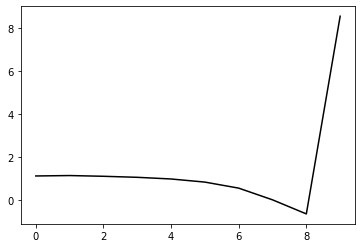

431200 0.18786869560921135
0.35427391052881113 -0.3612691880508325 -0.15344158621726608 -0.10986315134955518
[ 1.13917512  1.17133849  1.15776953  1.11733366  1.04276146  0.90145683
  0.62376976  0.08334249 -0.5667555   8.54005702]


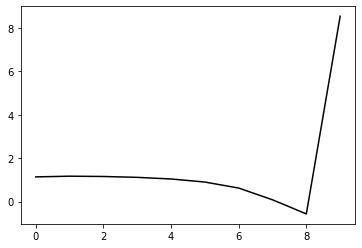

432300 0.174417332777674
0.35764333068223303 -0.36313622299936493 -0.15605784940901485 -0.10765819489782542
[ 1.06604196  1.15545184  1.14215729  1.09843353  1.01785865  0.87097107
  0.58864498  0.04471462 -0.60632788  8.56623686]


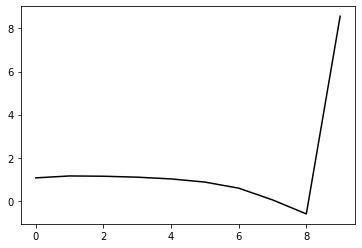

433400 0.19581211793823508
0.35696330357340345 -0.36464301942881305 -0.1578493319160201 -0.1058207442368642
[ 1.09501491  1.11046186  1.10797984  1.07664406  1.00535824  0.86588669
  0.59012459  0.05231721 -0.59121435  8.49771816]


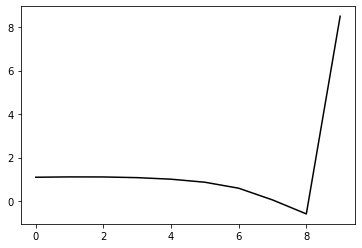

434500 0.20082786954644294
0.3552536905165249 -0.3615890836822418 -0.1555053158032255 -0.10680331408519413
[ 1.13469799  1.10191602  1.09066564  1.05996746  0.99300161  0.85617883
  0.58218715  0.04601869 -0.59430082  8.57246807]


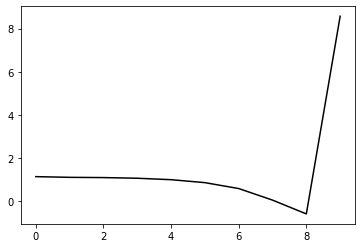

435600 0.1760722977058316
0.342148340002131 -0.3667014836576829 -0.15825380089155044 -0.10555088167322688
[ 1.15255084  1.00333653  0.94320337  0.90072284  0.83170161  0.69682834
  0.42722738 -0.10219553 -0.732157    8.50918454]


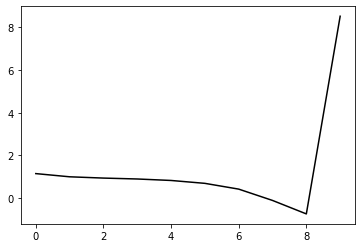

436700 0.13254176925090155
0.35438962468104196 -0.3635054471048209 -0.15802493315132832 -0.1062956175256701
[ 1.09449013  1.16213221  1.10897738  1.04199168  0.95598476  0.80739388
  0.52517454 -0.01566619 -0.65515463  8.53553644]


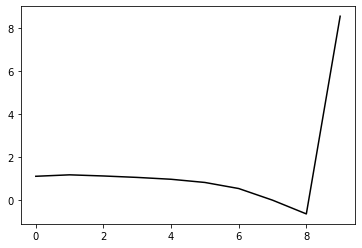

437800 0.1391281523042432
0.35338751069500457 -0.3603553760563164 -0.15580679893965346 -0.10835308177529177
[ 1.14698588  1.09799447  1.09916492  1.05611409  0.98016843  0.84122194
  0.56697194  0.03256436 -0.60022985  8.54288013]


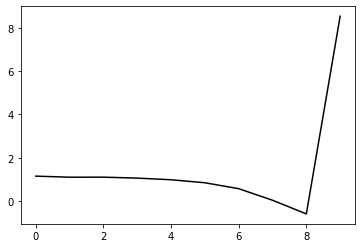

438900 0.1969200705825805
0.352649267635036 -0.3615856413830671 -0.15707648335382382 -0.1071380203170084
[ 1.07818122  1.08042078  1.05765728  1.00998233  0.92667571  0.78175828
  0.50437833 -0.03100805 -0.66163058  8.54803853]


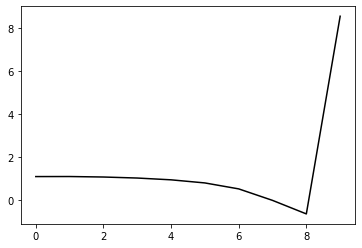

440000 0.20950124172437812
0.34762110941995616 -0.3674895002257867 -0.16166177465593162 -0.1060474172180414
[ 1.0955697   1.04519427  1.03320519  0.99691231  0.92433089  0.7878501
  0.51837619 -0.00951102 -0.63163576  8.51629065]


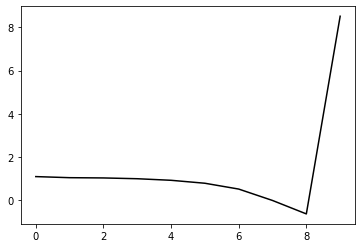

441100 0.21107642471793892
0.345787648766829 -0.36472454123402487 -0.15996318640431686 -0.10639249426042939
[ 1.12142116e+00  1.11342177e+00  1.07602328e+00  1.02836518e+00
  9.49607949e-01  8.05570736e-01  5.28078899e-01 -7.79898667e-03
 -6.36674593e-01  8.54797943e+00]


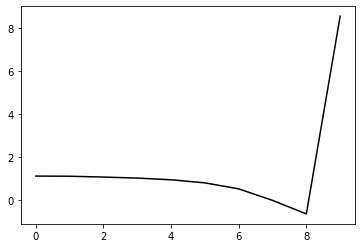

442200 0.17100031556551165
0.3422417269817449 -0.3672427960082235 -0.1617796997053184 -0.1071417094353604
[ 1.11978716  1.10951997  1.10691897  1.07932861  1.01329226  0.88093612
  0.61378196  0.0874079  -0.53103099  8.5351957 ]


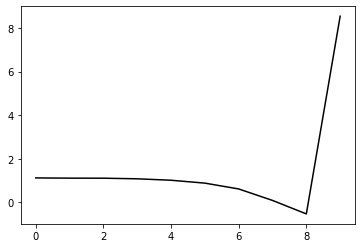

443300 0.1805964654600333
0.3437284306794562 -0.36405422725625153 -0.1603695571767927 -0.10684671876368894
[ 1.15476186  1.0980955   1.09257168  1.05958593  0.98741768  0.84725372
  0.57218879  0.03831103 -0.5860361   8.55496453]


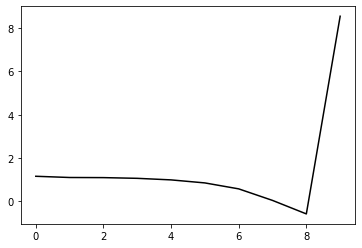

444400 0.20574018075610045
0.33712265197701025 -0.36655988674817375 -0.162024341369549 -0.10709709715962658
[ 1.18335039  1.06757619  1.05362458  1.0274813   0.96208661  0.82774314
  0.55808898  0.02964224 -0.5880315   8.52616973]


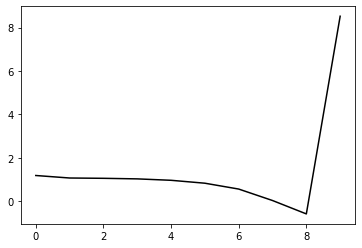

445500 0.32235444291424714
0.3535957422783288 -0.3584248629961808 -0.15883293096843878 -0.10386263790151454
[ 1.05105841  1.17228525  1.1676449   1.11884547  1.02978755  0.87204781
  0.57954127  0.02903205 -0.60979189  8.56326368]


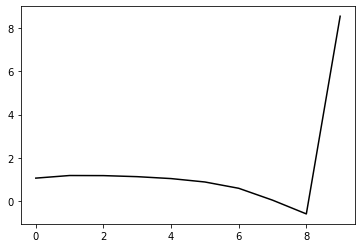

446600 0.16731053143730776
0.3341305349147689 -0.3618712759817639 -0.1592286895046251 -0.1074873136285688
[ 1.13838411  1.09555183  1.04968349  1.00233071  0.91578153  0.76052623
  0.47138095 -0.07415066 -0.70475513  8.50819195]


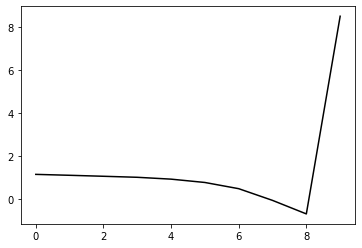

447700 0.11648780435065942
0.34761749315665835 -0.3586698190057295 -0.15898327973531165 -0.10860777453108077
[ 1.11693693  1.19558978  1.19832922  1.15523241  1.07062292  0.91535223
  0.6244118   0.07600586 -0.5576402   8.54891419]


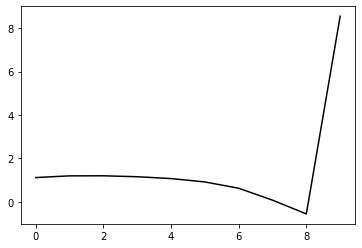

448800 0.13000326258274578
0.3373539237166443 -0.35944553937164825 -0.15869712589309223 -0.10995056837121392
[ 1.13108878  1.15934179  1.11028411  1.05922086  0.96973     0.81114428
  0.51845747 -0.02995309 -0.66110441  8.52871009]


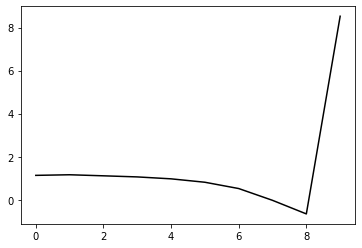

449900 0.188314320791092
0.3459796354457289 -0.3564711995924421 -0.1585122612632504 -0.10798279369338258
[ 1.09220899  1.07241792  1.08311513  1.03734563  0.94938605  0.7915308
  0.49862477 -0.05047614 -0.6819089   8.55782813]


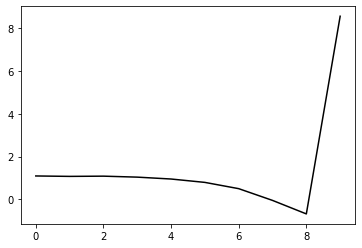

451000 0.2092697127082617
0.34763156036529874 -0.3568574400893419 -0.15976332374533714 -0.10654730026724858
[ 1.09482779  1.17618022  1.15046472  1.09817196  1.00216361  0.83559763
  0.53450272 -0.02180769 -0.65880506  8.52083379]


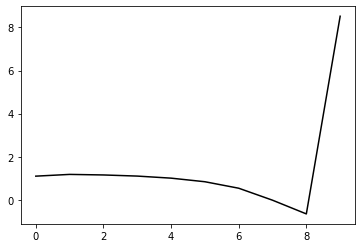

452100 0.19538381505663352
0.35031317918632493 -0.3521418430599817 -0.15686703991867157 -0.10773497760025215
[ 1.1354123   1.16121229  1.16873804  1.126658    1.03407068  0.86798248
  0.56610147  0.0087586  -0.62833337  8.55779683]


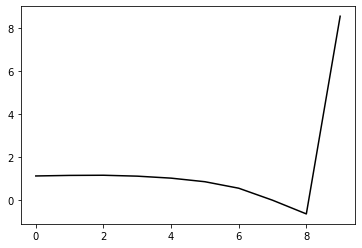

453200 0.22752098038593535
0.33337887791792403 -0.3563548911089366 -0.15728835183271617 -0.1112911825298942
[ 1.17593273  0.97388228  0.95788471  0.9310791   0.85492302  0.70570664
  0.42225585 -0.1144841  -0.72706687  8.50686489]


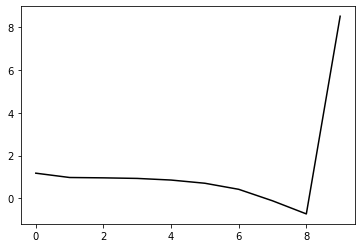

454300 0.16964047620810888
0.3507667021951602 -0.35224183273088544 -0.15753227786906593 -0.1088831361353275
[ 1.06616861e+00  1.18781095e+00  1.17719943e+00  1.13063855e+00
  1.03723599e+00  8.66121118e-01  5.57950874e-01 -4.13519647e-03
 -6.41690712e-01  8.56135424e+00]


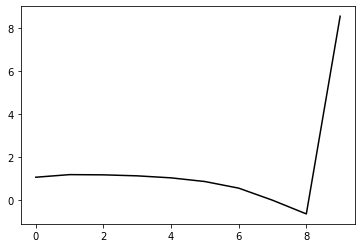

455400 0.1863677724569289
0.34985517198851923 -0.34982648117152326 -0.15601104297438126 -0.10906078959143764
[ 1.13573028  1.15329768  1.16953082  1.14084089  1.05834821  0.89461757
  0.59084195  0.03220833 -0.60090584  8.48459697]


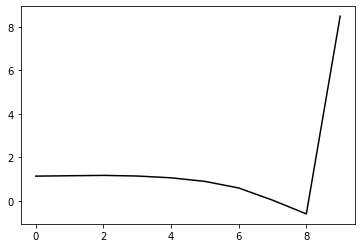

456500 0.20870496104296513
0.3481354029877803 -0.35108299043868174 -0.15706646255246706 -0.10975902267621476
[ 1.13190144  1.17971082  1.19815141  1.1841133   1.11650711  0.96312629
  0.66558456  0.11135783 -0.51677563  8.56013928]


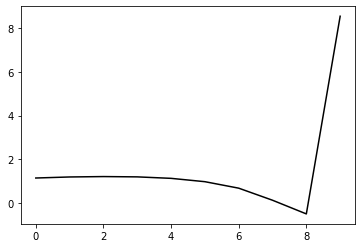

457600 0.16927943932801712
0.3331228617451277 -0.35574455078974204 -0.15968595023727647 -0.10778773278197964
[ 1.13760837  1.02519331  0.97998895  0.96040551  0.89751904  0.75055135
  0.45914485 -0.08837041 -0.70756167  8.52062024]


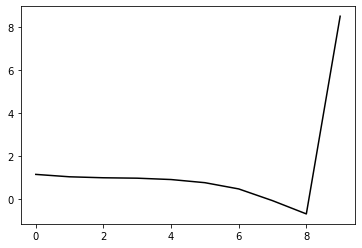

458700 0.12488457755125261
0.3457592068054525 -0.35260053049492435 -0.1593442214009785 -0.10936961975984386
[ 1.0868351   1.1574642   1.13157163  1.09643306  1.02777951  0.87681073
  0.58004869  0.0268423  -0.5969115   8.5516939 ]


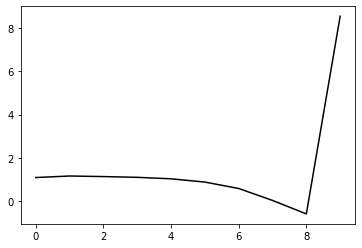

459800 0.12748561619064833
0.3478220302384801 -0.3496348573768601 -0.1580127010475079 -0.10872926174155696
[ 1.12053242  1.13182877  1.13585645  1.10737927  1.04139352  0.89490965
  0.60028856  0.04731992 -0.57617714  8.54876923]


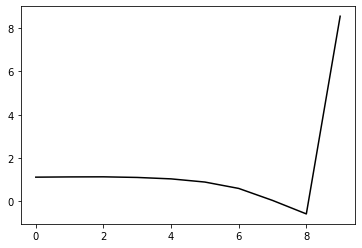

460900 0.17530077532065771
0.3349999361270857 -0.35339448738460827 -0.15915671020817065 -0.10722071372760221
[ 1.09820347  1.01063187  0.98027451  0.9341206   0.85113571  0.69403905
  0.39262098 -0.16423352 -0.7870764   8.52299694]


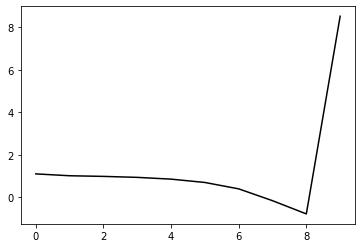

462000 0.20918550858152227
0.33906300680234747 -0.35194804908394095 -0.15924975879800168 -0.10836789332313106
[ 1.09688039  1.10285394  1.08269855  1.04450096  0.96986645  0.82028232
  0.52442232 -0.02940884 -0.64997477  8.55905661]


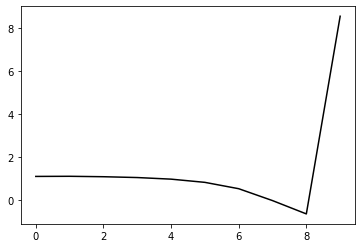

463100 0.26048360838561124
0.3319629262934054 -0.35387233061932394 -0.16003486975781706 -0.10873749558316109
[ 1.18081265  0.90894475  0.89992041  0.87957098  0.82314459  0.69274314
  0.41550241 -0.12104216 -0.72326512  8.51520192]


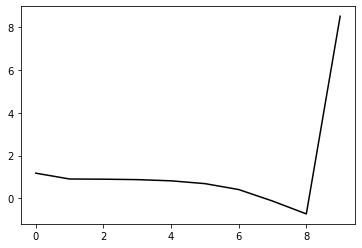

464200 0.18273134438994482
0.3365650308156207 -0.3546273021312245 -0.1622242227673538 -0.10779489868889969
[ 1.08617554  1.15220345  1.10367923  1.06167415  0.99430388  0.85407146
  0.56708608  0.02044651 -0.59104595  8.52824144]


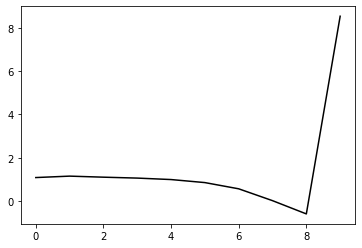

465300 0.1714900040952556
0.33088830061735514 -0.3567289853198912 -0.16347192245670797 -0.10794249654213646
[ 1.07476522  1.09384923  1.05978535  1.00553083  0.92523737  0.77613114
  0.48147235 -0.07269455 -0.69033037  8.56618336]


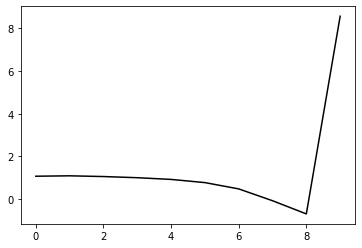

466400 0.17017074392985554
0.3347393271937492 -0.3499216232692347 -0.15940395819357053 -0.11035350175056075
[ 1.13366594  1.16398249  1.15596791  1.11021675  1.03224815  0.88483209
  0.59052376  0.034299   -0.58622727  8.49896015]


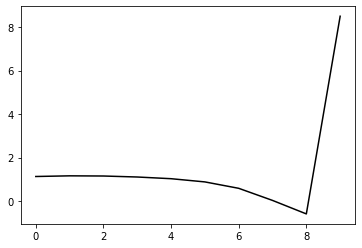

467500 0.2108415393989814
0.33993907851756844 -0.34617225635686416 -0.15816960212464257 -0.10970978675683232
[ 1.1352745   1.19816296  1.23126037  1.20455426  1.12882777  0.97961289
  0.68215265  0.12068173 -0.50540806  8.57659798]


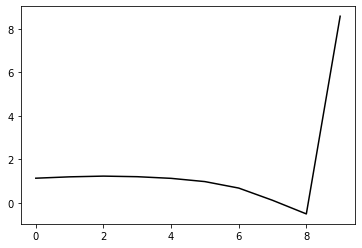

468600 0.18372892252300527
0.3189931927491525 -0.35278634144383664 -0.16075346287660985 -0.10748889208740903
[ 1.14716803  0.94560857  0.90230186  0.88329339  0.81739847  0.67769843
  0.39118401 -0.15876532 -0.77130435  8.51219157]


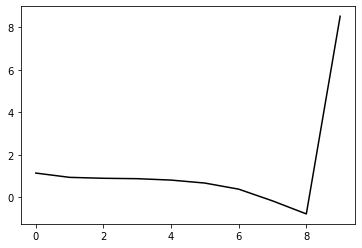

469700 0.12089632271542206
0.3334822718269415 -0.3488941684070877 -0.16070040907153338 -0.10898133092597342
[ 1.12372725  1.16013962  1.11988963  1.08512419  1.01579352  0.87140056
  0.57945732  0.02308622 -0.59632177  8.56479287]


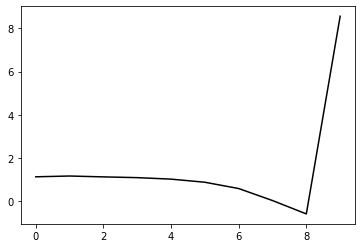

470800 0.1267974468979669
0.33568375128000794 -0.34794815457860345 -0.16058581686839168 -0.11198533198672492
[ 1.1281229   1.19557075  1.16796454  1.12842605  1.05960977  0.91735352
  0.62779309  0.07395263 -0.54157927  8.54647999]


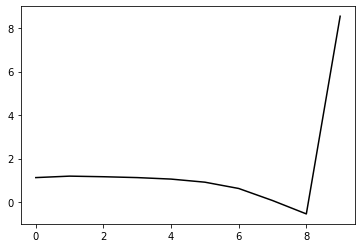

471900 0.1947033634228237
0.33050386080687233 -0.3527385122923673 -0.16495435822773782 -0.10368685499911438
[ 1.08633714  1.02228831  1.01069178  0.95678697  0.8704685   0.71476748
  0.41397486 -0.14999473 -0.77430227  8.51525778]


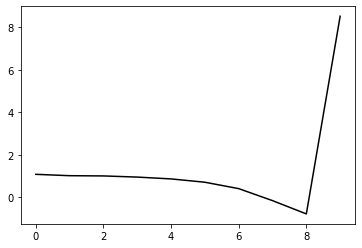

473000 0.20737974746191026
0.337212138025679 -0.3481035866079238 -0.16197589782404406 -0.10956953912351765
[ 1.09861009  1.18359903  1.17674127  1.12764793  1.04011293  0.88294502
  0.58141302  0.01728874 -0.60548719  8.52291997]


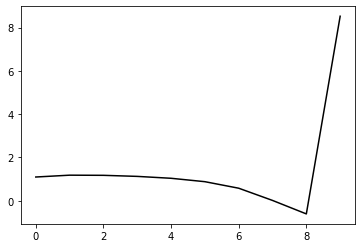

474100 0.1922708593991113
0.33627356030354255 -0.3446298553933345 -0.15962312912598087 -0.10992997068092139
[ 1.1220128   1.122073    1.13532409  1.09890365  1.01337181  0.85623374
  0.55470798 -0.0102082  -0.63401257  8.53188894]


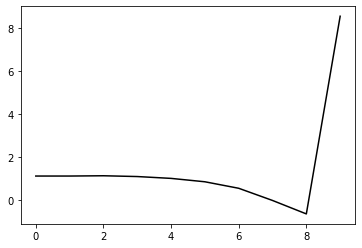

475200 0.20934313517077782
0.32680022480744464 -0.34617435345374176 -0.15976030624595583 -0.11051709175545557
[ 1.16495432  0.97545923  0.98984044  0.97644401  0.90663081  0.76073203
  0.46982855 -0.08480977 -0.69709716  8.50166586]


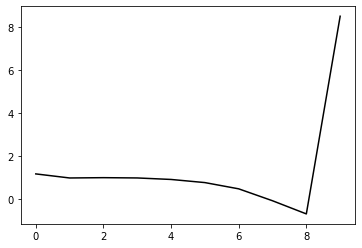

476300 0.1747971990600467
0.33727963762918106 -0.3427412623850725 -0.15936504423799297 -0.1091295088467242
[ 1.10343457e+00  1.13390151e+00  1.13145370e+00  1.10663360e+00
  1.03081745e+00  8.74477580e-01  5.71621096e-01  4.08724227e-03
 -6.21539467e-01  8.56557929e+00]


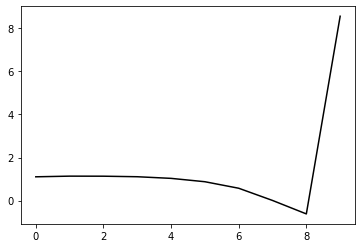

477400 0.16616578729065914
0.3388833308072009 -0.3406379669163379 -0.15824021258274684 -0.10963598331335445
[ 1.12365404  1.15414674  1.16880596  1.14779967  1.07636345  0.92201443
  0.61930485  0.05119714 -0.57441102  8.51422978]


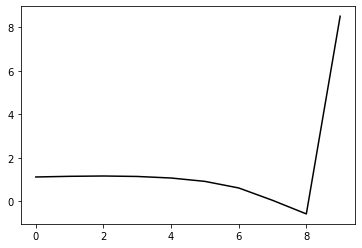

478500 0.3235742701037031
0.3330051138985105 -0.33890207344219797 -0.1562913118769047 -0.11122762560031482
[ 1.15580679e+00  1.06137167e+00  1.06962264e+00  1.06187428e+00
  1.00273279e+00  8.58257527e-01  5.63331183e-01  2.29340252e-03
 -6.15190583e-01  8.54947232e+00]


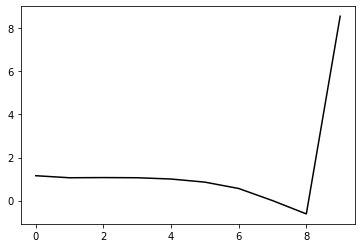

479600 0.19761662080554046
0.33438988422189353 -0.34470586949593335 -0.16153891655936947 -0.10881121164912878
[ 1.06708286  1.1396526   1.10246852  1.0634898   0.98852337  0.83159395
  0.52586054 -0.04348247 -0.66573738  8.50238359]


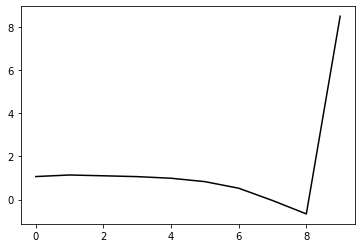

480700 0.11933286416990993
0.3357240741426463 -0.3414095050366337 -0.15943599593715385 -0.10935853236751096
[ 1.08754533  1.14681961  1.13182269  1.09655698  1.02776339  0.87838082
  0.57746143  0.01095622 -0.60865211  8.55206429]


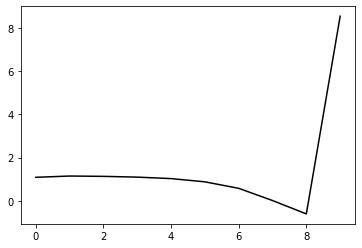

481800 0.14640034528586368
0.33003482365502307 -0.34026313562133503 -0.15736488178917452 -0.11288071489920572
[ 1.12465295  1.09439772  1.09193675  1.0683286   1.00678391  0.86720522
  0.57545803  0.01722369 -0.59307011  8.54109686]


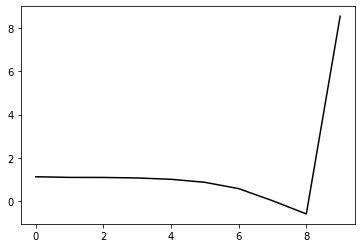

482900 0.18377463509986075
0.32818144821047646 -0.3452506447551333 -0.1621218474557869 -0.11124981302656589
[ 1.09296445  1.11214713  1.05975779  1.01860798  0.9488353   0.8040744
  0.50882651 -0.05196921 -0.66287993  8.53556461]


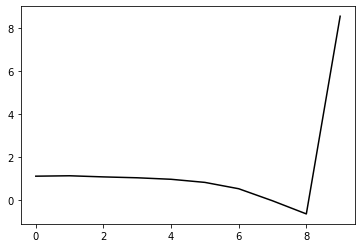

484000 0.2790061543188298
0.32936263720391545 -0.34939783135677827 -0.16628044048369708 -0.10974560376958589
[ 1.06270962  1.0996769   1.09344336  1.06577188  1.00861158  0.87779407
  0.59489192  0.04384774 -0.55872009  8.51695935]


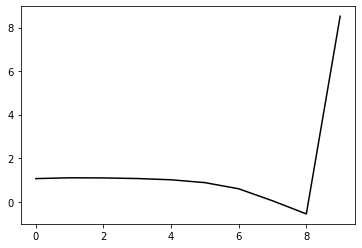

485100 0.2293137426031968
0.33044877701849246 -0.34226462687336107 -0.16145119778264844 -0.11221775194338991
[ 1.14531735  1.09463492  1.07655168  1.03737602  0.97128516  0.83437974
  0.54658888 -0.00946955 -0.61659794  8.54131884]


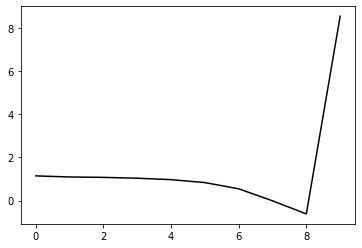

486200 0.18139517715058234
0.33686645408280763 -0.33484346805087695 -0.1570651457430492 -0.11201686776046388
[ 1.11525374  1.19062242  1.18529044  1.13198477  1.04439637  0.88897356
  0.58539719  0.01467271 -0.60577203  8.52536754]


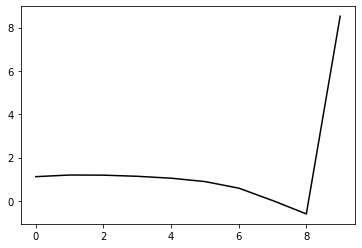

487300 0.17774710426153215
0.32120903664487094 -0.3416212264847592 -0.16056855732506609 -0.11171086015066817
[ 1.10416881  0.94663005  0.92275139  0.89548888  0.82456981  0.68388984
  0.39549329 -0.1607034  -0.76573088  8.54252566]


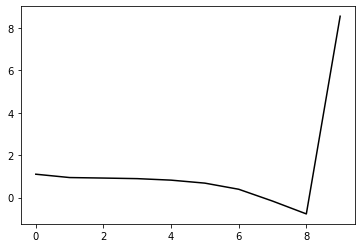

488400 0.183252265367597
0.3379490231947481 -0.33481124334257406 -0.15839034086536669 -0.11142840375549841
[ 1.11980796  1.15739561  1.14491694  1.10404454  1.02476294  0.87377727
  0.57527908  0.00864522 -0.60695415  8.497101  ]


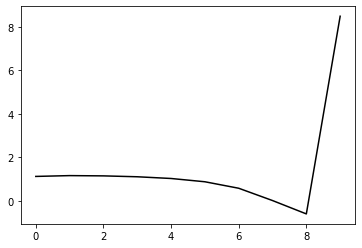

489500 0.27895163914537824
0.3379731227888917 -0.33818551472233693 -0.16155209445095237 -0.10885184534535329
[ 1.03375016  1.11366926  1.10878935  1.06849184  0.98672945  0.8332798
  0.53370588 -0.03313559 -0.64731505  8.57065665]


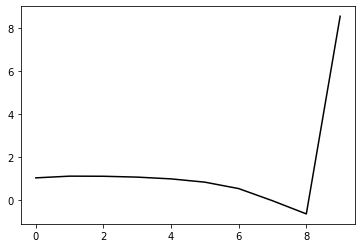

490600 0.16601456689853902
0.32640753077545853 -0.34542305631177705 -0.16505954639732853 -0.11330463259895611
[ 1.11295507  1.11768482  1.11297273  1.10315145  1.05358294  0.92963325
  0.65785783  0.11714201 -0.47097804  8.53170219]


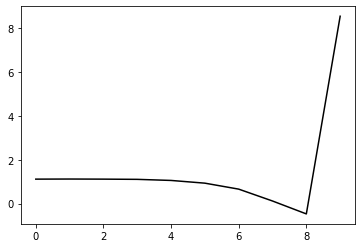

491700 0.1266377107808913
0.323021980029403 -0.34047829923855116 -0.16146553121938317 -0.1121054264164659
[ 1.10643288  1.08392573  1.03621076  0.99446835  0.92087036  0.77486033
  0.48295332 -0.07607564 -0.68055581  8.5181403 ]


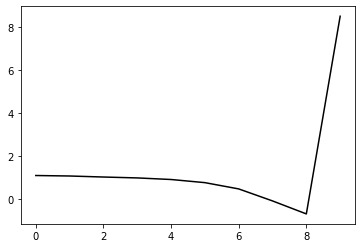

492800 0.13984331941360922
0.3341658521412049 -0.33432142107380264 -0.15893977665808554 -0.11338491800122234
[ 1.12339393  1.15212957  1.17706941  1.14645341  1.07728832  0.93379138
  0.64146277  0.07930344 -0.53027862  8.54577157]


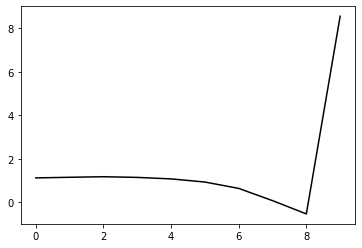

493900 0.1893756676155282
0.32712716281850973 -0.34107478982443495 -0.16328014672092567 -0.11155543668978325
[ 1.07087173  1.02939987  1.01961808  0.99548049  0.93221412  0.79597139
  0.5127331  -0.03878437 -0.63515714  8.55723286]


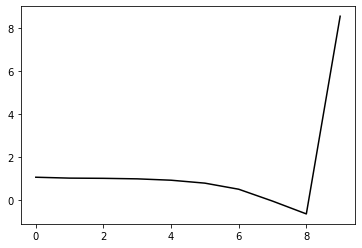

495000 0.22225501727463715
0.3309037045490841 -0.3402745115130831 -0.16445885896210746 -0.10851668773371542
[ 1.06955967  1.15077688  1.09420995  1.04545619  0.96852621  0.81981215
  0.52476843 -0.03841179 -0.64657694  8.52704298]


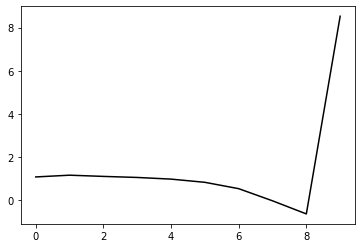

496100 0.1887815776566623
0.3344289153261312 -0.33404456225636864 -0.16037126124647447 -0.11044505469928449
[ 1.11028022  1.17125038  1.14683954  1.08773377  1.00127411  0.84571982
  0.5445626  -0.02441054 -0.63783758  8.54432484]


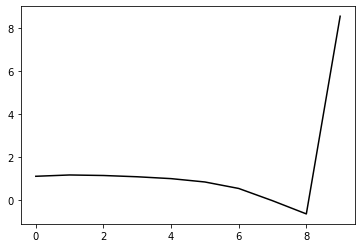

497200 0.17962026685610455
0.3260718235072056 -0.3413978459500428 -0.16526666797724326 -0.10978964665469282
[ 1.08963430e+00  1.05546876e+00  1.06712036e+00  1.04312954e+00
  9.75060777e-01  8.36354740e-01  5.51211915e-01 -2.67204623e-03
 -6.00651390e-01  8.52311795e+00]


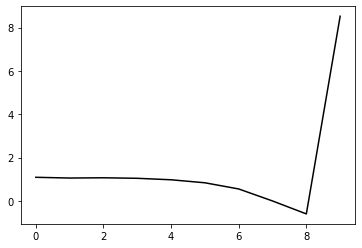

498300 0.23421929918979423
0.32719508003277115 -0.34295281955960694 -0.16739234854608334 -0.10914883189924997
[ 1.06791389  1.15188761  1.13992202  1.11797887  1.05508019  0.91776918
  0.63248748  0.0765552  -0.52521201  8.56955035]


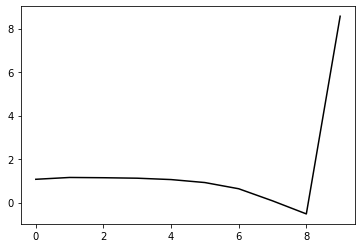

499400 0.19038292003474008
0.3359950296235617 -0.328771465844002 -0.15848639698836217 -0.10998112537064329
[ 1.12964439  1.2042554   1.21957322  1.178381    1.09031936  0.92634514
  0.61433268  0.03166778 -0.59716675  8.49420623]


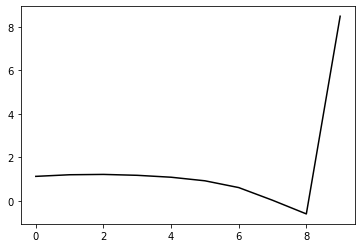

In [17]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

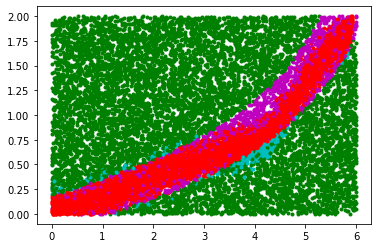

In [18]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 0.2814174284560486
0.32373808375882906 -0.3426550815990472 -0.15382590628445392 -0.1163977136149168
[ 1.11175681  1.05668328  1.0552957   1.01413206  0.9238962   0.75911951
  0.44857319 -0.13031117 -0.75257435  8.49319186]


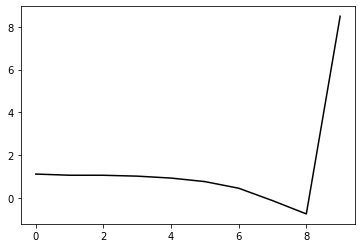

1100 0.23257438110258355
0.33575048975723004 -0.33845775972428194 -0.15491962006322377 -0.11503299623679192
[ 1.09293084  1.13756429  1.13343961  1.08675345  0.99035843  0.81806981
  0.50039705 -0.08499711 -0.71302914  8.50017573]


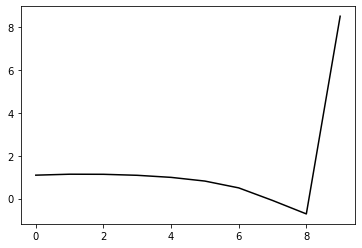

2200 0.18860761819145783
0.3280370554979195 -0.34111716024539407 -0.15649255221593072 -0.11455312793313847
[ 1.06894988  1.10833664  1.08121055  1.02502526  0.91876184  0.73707279
  0.41251929 -0.17661065 -0.80458715  8.49696272]


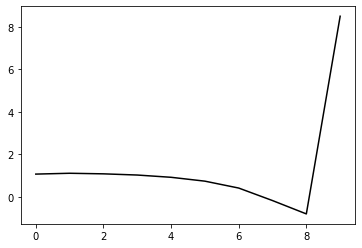

3300 0.1797469713370069
0.3230229705063222 -0.35326824785915395 -0.1656972403265743 -0.11190470088615181
[ 1.05265218  1.0549076   1.03075137  0.98037182  0.87936257  0.7008955
  0.37907607 -0.20703474 -0.83114122  8.52067267]


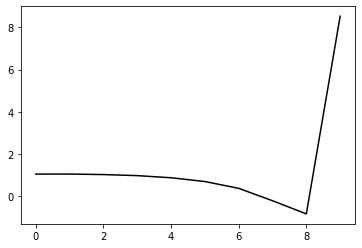

4400 0.20096507855617995
0.3351207770772091 -0.333735571909358 -0.15469033899706502 -0.11655493582813485
[ 1.08271057  1.18969719  1.17646072  1.11982521  1.01262166  0.82418641
  0.48969811 -0.11070304 -0.75058537  8.48455969]


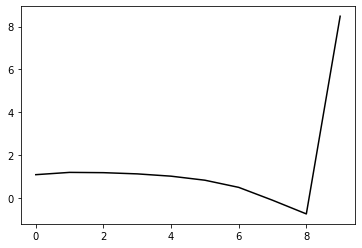

5500 0.25111511803298897
0.32629188925848046 -0.3407600852570946 -0.1578364255606674 -0.12145594467914969
[ 1.08115814  1.14713752  1.13926335  1.08674805  0.98008077  0.7916955
  0.45776239 -0.14011768 -0.77432415  8.5026394 ]


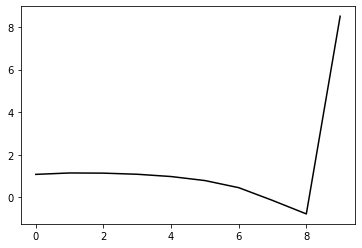

6600 0.21789325629811074
0.32401245291833186 -0.3401943899912469 -0.15762779670643837 -0.11942176728998753
[ 1.10291593  1.06191789  1.03893192  0.98067605  0.8668698   0.67138821
  0.33214806 -0.26780539 -0.89990049  8.45966403]


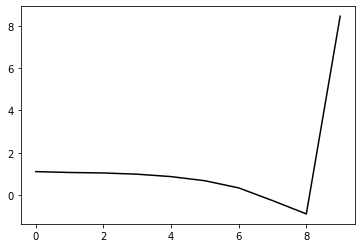

7700 0.11881449975102125
0.3286130420039191 -0.3427065231534738 -0.16107282483909852 -0.12127068504803182
[ 1.08171236  1.16646697  1.14240684  1.08385481  0.97176136  0.77593418
  0.43532518 -0.16557029 -0.7973586   8.51655523]


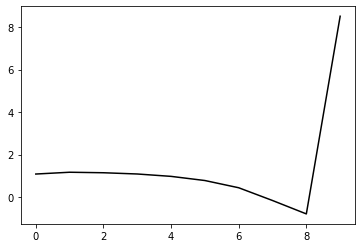

8800 0.1283559008434688
0.3333562038444819 -0.3398943935114013 -0.16062332400573748 -0.11911663151296101
[ 1.07120141  1.10789202  1.120362    1.06942073  0.9555521   0.75590421
  0.41042962 -0.19502945 -0.83057836  8.49914327]


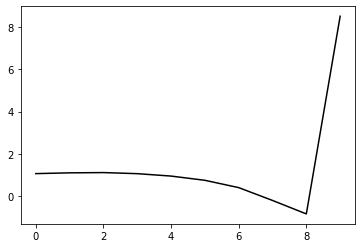

9900 0.1854821628859706
0.3336582370807895 -0.33910434752648694 -0.16082084350898146 -0.11774599377521199
[ 1.07431617  1.00247921  1.02671015  0.99839073  0.89600765  0.70122192
  0.35829761 -0.24449994 -0.87603083  8.50931204]


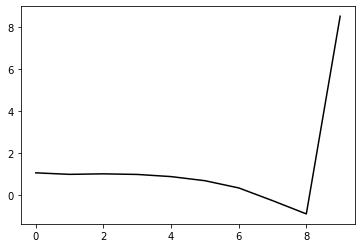

11000 0.2092531280477998
0.3320078265528832 -0.33950850988919934 -0.16146360182329156 -0.1169890856529089
[ 1.05002083  1.02950043  1.02938181  1.00741674  0.91373078  0.71987032
  0.37396426 -0.23192282 -0.86511757  8.48568456]


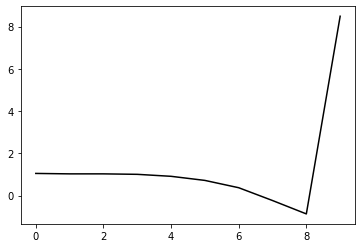

12100 0.20787383796225448
0.3325003840422863 -0.3363733702731837 -0.1596856825414811 -0.11759946071562397
[ 1.08970212  1.06251704  1.05485069  1.03631781  0.95419764  0.766449
  0.4201614  -0.18821903 -0.82382333  8.51457642]


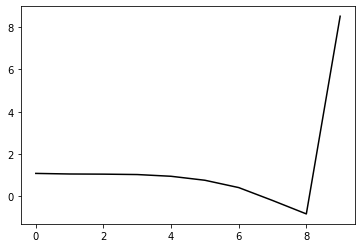

13200 0.17938416293192472
0.33534368738279613 -0.33203611786819676 -0.15739214079626582 -0.1190176681498607
[ 1.07942475  1.15073599  1.14558081  1.12472252  1.04721415  0.86264389
  0.51370224 -0.09955925 -0.73975652  8.50471092]


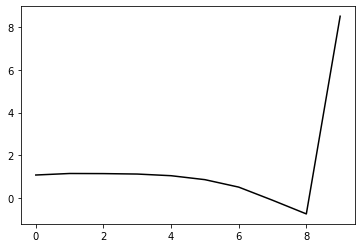

14300 0.22306899058909363
0.340046182525266 -0.3332532379119868 -0.1602431725402435 -0.11519631157667108
[ 1.0005483   1.12980888  1.12868947  1.09790475  1.0157652   0.82980483
  0.47598112 -0.14334807 -0.78785798  8.54742435]


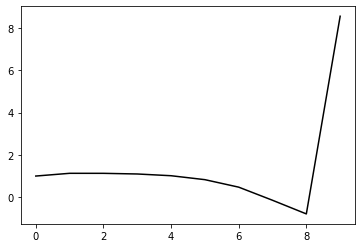

15400 0.1784039320371058
0.3370111529174715 -0.3344767010983921 -0.1610073364069406 -0.11541033997021477
[ 1.06766796  1.07529859  1.08309556  1.06300348  0.99535866  0.82556969
  0.48334575 -0.12734598 -0.76186188  8.47914429]


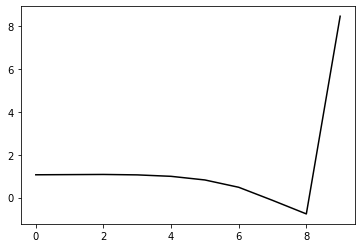

16500 0.27583679574298037
0.3315666010247387 -0.3303003113579093 -0.15755039356790856 -0.11711340874270497
[ 1.10267716  1.02139464  1.03926509  1.03688404  0.98237383  0.82505597
  0.4903883  -0.11765472 -0.75074852  8.52094451]


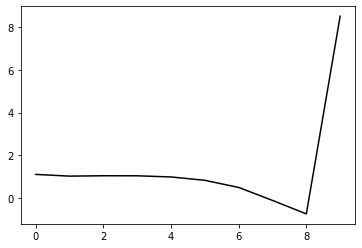

17600 0.1499288065735433
0.3319829175197335 -0.3304014887460924 -0.15870873145690226 -0.11527959171252421
[ 1.06974191  1.04684983  1.03373729  1.01630968  0.9558127   0.79476154
  0.45484682 -0.16097064 -0.8016187   8.46964989]


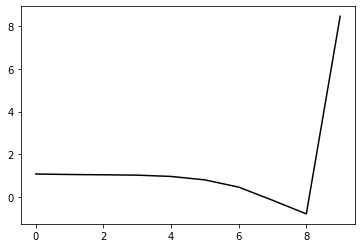

18700 0.13499876700111196
0.32978908447630334 -0.33226198913746896 -0.16056089415625438 -0.11361326397108414
[ 1.03960901  1.06632194  0.99328715  0.94955367  0.87933442  0.71569295
  0.37470224 -0.24248868 -0.88239577  8.51863655]


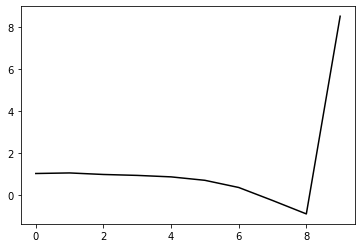

19800 0.13027828357650473
0.3285905639558043 -0.332565846003513 -0.16137085108794205 -0.11708908668381597
[ 1.07335342  1.13214162  1.07105233  1.0232924   0.95764164  0.8028491
  0.46899318 -0.14450647 -0.78165878  8.5098666 ]


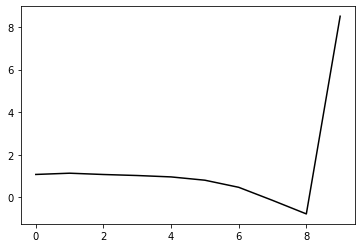

20900 0.19986529308786083
0.33449818786351293 -0.33207949902227324 -0.1625352256106269 -0.11673397844567752
[ 1.05361502  1.11921847  1.11209592  1.06806191  0.99827454  0.84517539
  0.5135815  -0.10016895 -0.73796178  8.55380393]


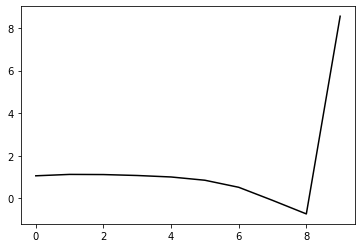

22000 0.20331667523352287
0.32927009374316746 -0.33672299490053176 -0.166244299264217 -0.11380309807186564
[ 1.06324506  1.00907269  1.01059232  0.98269543  0.91880864  0.77408
  0.45234164 -0.15403758 -0.7850924   8.50143244]


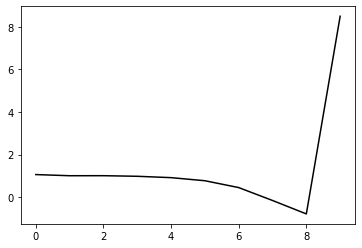

23100 0.24186997192509888
0.31944493142937497 -0.3378668302306764 -0.16598921756460666 -0.11361498834924603
[ 1.12500002  0.92369689  0.91022767  0.89195354  0.83732354  0.70216345
  0.39129719 -0.20627159 -0.82890151  8.50975345]


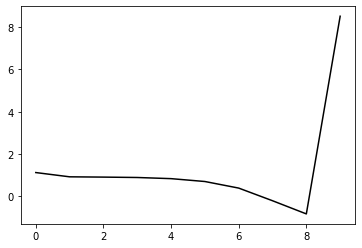

24200 0.20764292393035222
0.32308572983513456 -0.33401741241314264 -0.16398343998907416 -0.11429123541715769
[ 1.09991034  1.01844181  0.9848409   0.95311374  0.89265042  0.75359958
  0.44098709 -0.15912783 -0.78400369  8.46915531]


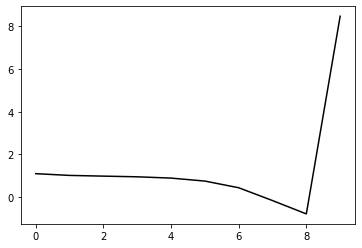

25300 0.17911243693621554
0.3316036767941647 -0.3296134302949145 -0.16216062778483306 -0.11621942549128163
[ 1.07737805  1.13164587  1.11124152  1.06986388  1.00235657  0.85902843
  0.54373229 -0.06101497 -0.69188904  8.55463991]


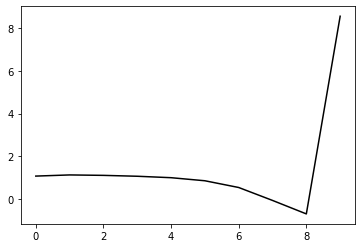

26400 0.19436450265964283
0.318016298529499 -0.33442692500117527 -0.16391615398393256 -0.11502402762928783
[ 1.06933587  1.06665876  1.01758401  0.96291689  0.8815128   0.72766561
  0.40519521 -0.2058679  -0.84169679  8.4861789 ]


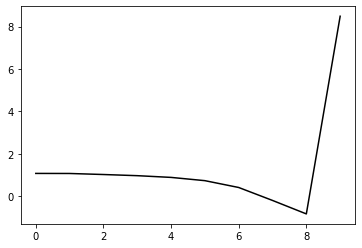

27500 0.20260824707535785
0.32745119736371303 -0.32931287227014944 -0.16212505311769196 -0.11694088994537376
[ 1.10193316  1.08137594  1.08408159  1.03838548  0.95950765  0.80814188
  0.48893193 -0.12048717 -0.75572669  8.53485996]


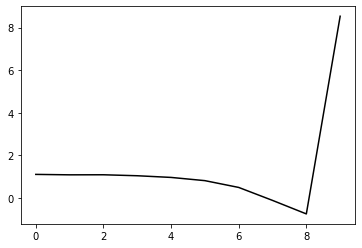

28600 0.15176472795166127
0.3250471124246862 -0.33350732231192076 -0.16489431779276797 -0.11801387429379862
[ 1.06518726  1.15162414  1.15154417  1.11856209  1.04391873  0.89579168
  0.58200458 -0.02209711 -0.65150556  8.5101511 ]


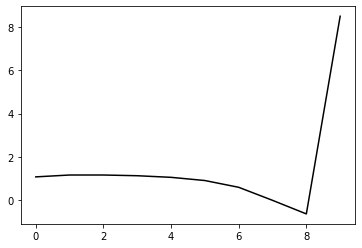

29700 0.1358251194087429
0.31917594225662393 -0.33179968389153414 -0.16315656308673615 -0.11911519401055294
[ 1.10912977  1.07481156  1.07215429  1.04907118  0.98087812  0.83683351
  0.52849629 -0.07103045 -0.69678545  8.52350073]


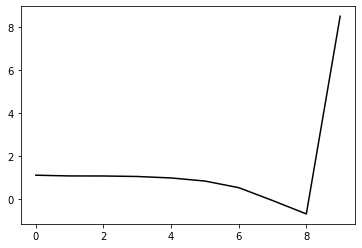

30800 0.14359448617946055
0.32758487273590225 -0.32775617838883353 -0.16241418605516672 -0.11582258905835954
[ 1.06718065  1.09878793  1.09901542  1.06717185  0.99067004  0.83675081
  0.51966865 -0.08908776 -0.72537217  8.50985532]


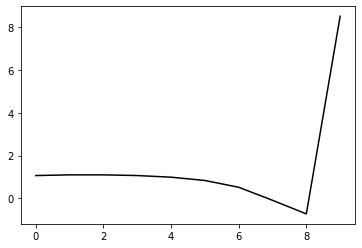

31900 0.26432115931663297
0.33281432856887305 -0.3257355638636322 -0.16259943236816227 -0.11325639956279229
[ 0.99899096  1.06361951  1.08493544  1.05530888  0.97473014  0.8151581
  0.49349343 -0.11974869 -0.7609208   8.52456573]


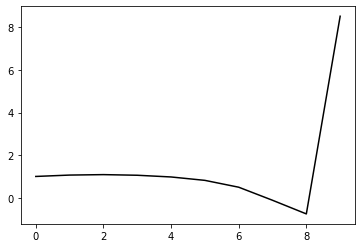

33000 0.22214094027576667
0.32400184952147193 -0.33038032949083146 -0.16451232456575926 -0.11569239375085442
[ 1.09130973  0.95083458  0.96453668  0.95222821  0.88874811  0.74429644
  0.43804343 -0.15960487 -0.78451186  8.47651011]


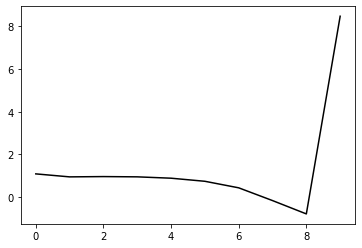

34100 0.2204791224656406
0.3229799432221952 -0.32581297704825646 -0.1612700774577145 -0.1170535181506444
[ 1.09761615  1.02012355  1.0101961   0.99521166  0.93405904  0.78984575
  0.48314788 -0.11586741 -0.74370822  8.52113745]


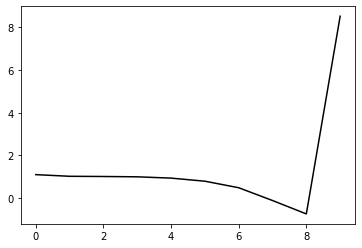

35200 0.2816246793497477
0.305103150266786 -0.3272354882351378 -0.15940422016148897 -0.11956406210259075
[ 1.15845699  0.81168334  0.77637271  0.76267949  0.71233507  0.58003694
  0.28587507 -0.29972984 -0.91267791  8.46895179]


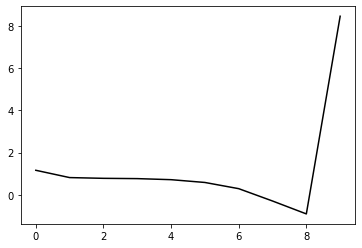

36300 0.1646416548110794
0.31993479839399164 -0.3328898100110923 -0.16776426988780166 -0.11467395059398403
[ 1.05344552  1.05501091  0.98809703  0.95207735  0.89532037  0.75861483
  0.45982667 -0.13083368 -0.74986817  8.54087375]


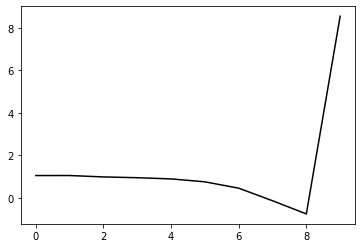

37400 0.17880438667288337
0.32589715519918366 -0.325661868337626 -0.16392507530059972 -0.11664145978302479
[ 1.0655205   1.15562762  1.12521727  1.07782282  1.0135345   0.87327383
  0.56981137 -0.02751114 -0.6559795   8.50766253]


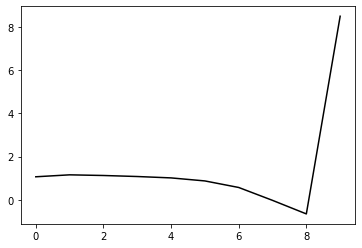

38500 0.21037718349147655
0.31671340679861365 -0.32858729607764897 -0.16559331449726108 -0.11469062420368145
[ 1.10125028  1.03743161  0.98602587  0.93983933  0.87384021  0.73683438
  0.43786333 -0.1550765  -0.77940027  8.5194387 ]


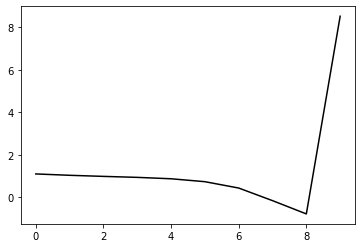

39600 0.15029644632903746
0.32986955338323226 -0.319537764336208 -0.1611891560683394 -0.11721705953198645
[ 1.05671683  1.17795499  1.16330766  1.10565746  1.02381177  0.8745087
  0.56537052 -0.03741524 -0.67222223  8.50406939]


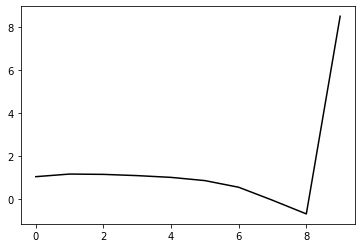

40700 0.13682099658282393
0.31590755756647243 -0.32122867944267286 -0.16116147637740189 -0.1144750151448895
[ 1.07402848  0.97139114  0.95529786  0.90079342  0.80809829  0.64915148
  0.33338532 -0.27460716 -0.91364543  8.51440463]


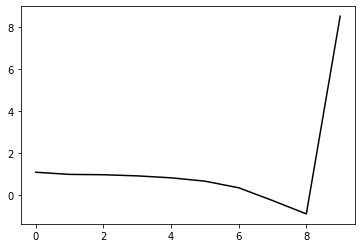

41800 0.15112560876939032
0.325788375651406 -0.3187274050567521 -0.1608699951391424 -0.1180685793364376
[ 1.11011975  1.11783752  1.12692699  1.08916484  1.00677515  0.85415487
  0.54465358 -0.05757397 -0.69133691  8.5099649 ]


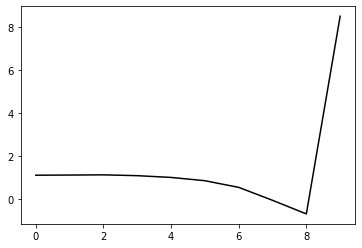

42900 0.18941446762444453
0.3209321547562546 -0.3226976482062097 -0.16397389760812853 -0.11661509424360426
[ 1.08349164  1.09763633  1.09138143  1.05958453  0.98178833  0.83047606
  0.5228086  -0.07785894 -0.71126245  8.53457719]


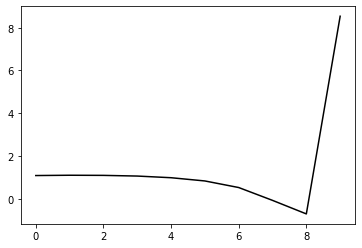

44000 0.23115399532504713
0.3147192524682452 -0.32468805870071676 -0.16520961518062052 -0.11464619102510532
[ 1.10572363  0.96667952  0.95248077  0.9193558   0.84261817  0.69210838
  0.38727234 -0.20910868 -0.83759857  8.4920578 ]


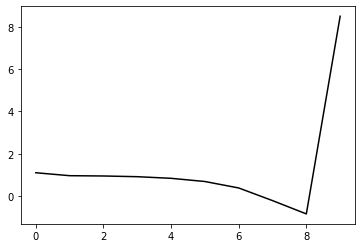

45100 0.2490470625447583
0.3159429783509121 -0.32450140673569383 -0.16579247528697566 -0.11500213151483732
[ 1.14287663  0.95264076  0.93784567  0.90879037  0.8384013   0.69246633
  0.39181811 -0.20064732 -0.82638826  8.48966715]


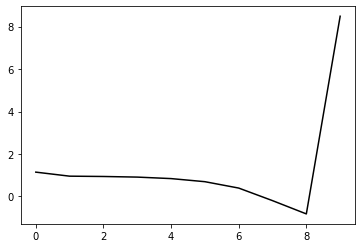

46200 0.1804516269723539
0.3255077452838344 -0.31651062168184285 -0.161448162278823 -0.11709366288429907
[ 1.10020243  1.18626118  1.15995864  1.11191546  1.02749563  0.86727721
  0.5525663  -0.05346069 -0.69350792  8.52709895]


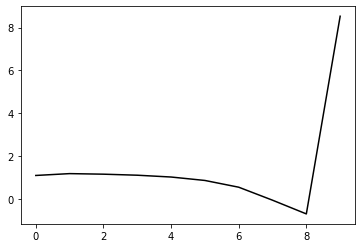

47300 0.2019015896980524
0.32179696582671713 -0.32583551671919964 -0.1686999599858353 -0.1131009392472282
[ 1.04416861  1.08740046  1.07824311  1.04496308  0.96994779  0.819527
  0.51513237 -0.07956994 -0.70749145  8.5401848 ]


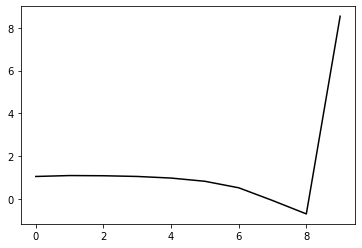

48400 0.2262013037769655
0.3166736293307127 -0.3256898748207278 -0.16837178174711015 -0.11106042574179283
[ 1.05964842  1.0003352   0.95806002  0.91033405  0.82295034  0.66173556
  0.34885206 -0.25203891 -0.88489149  8.45903717]


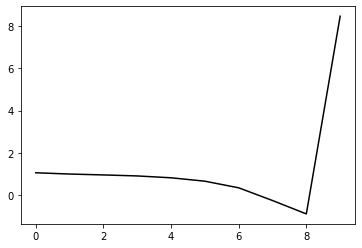

49500 0.2010514850043188
0.3268935328893058 -0.3173615549174334 -0.16363594851121308 -0.1158658392654027
[ 1.10402419  1.16614613  1.17121354  1.12734665  1.04139377  0.87855005
  0.56214502 -0.0431367  -0.68172776  8.55085019]


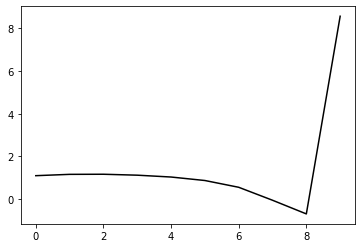

50600 0.15087369827551783
0.32772970724025385 -0.3176433823438442 -0.1648799893581314 -0.11365180648411212
[ 1.07753875  1.14282342  1.1665222   1.13927385  1.05774635  0.89553468
  0.57836903 -0.02813867 -0.66904797  8.51125177]


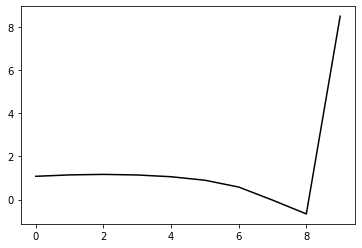

51700 0.11796045525571863
0.32196546250015956 -0.3211651087412651 -0.1668488843445131 -0.11527917976065209
[ 1.10789924e+00  1.13952976e+00  1.14280312e+00  1.12936408e+00
  1.06278362e+00  9.10524540e-01  6.01602852e-01  3.31025661e-03
 -6.29639219e-01  8.56332901e+00]


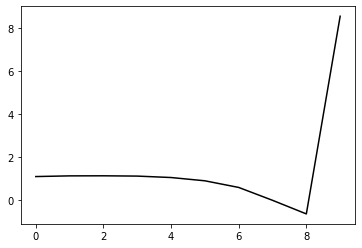

52800 0.14557345541186062
0.3252569645866474 -0.31505688001310483 -0.1629565571976996 -0.11540021512270368
[ 1.12456291  1.11075092  1.09943796  1.064411    0.98755754  0.82682551
  0.5101807  -0.09376414 -0.73130987  8.5206085 ]


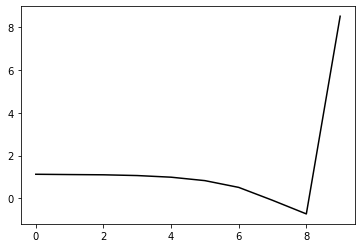

53900 0.2031643294766455
0.32529239922492065 -0.31978442482616887 -0.16685019798498113 -0.11571378124499831
[ 1.07148292  1.15144023  1.1560358   1.12580084  1.05363968  0.89882401
  0.58730322 -0.01102661 -0.64259918  8.54050528]


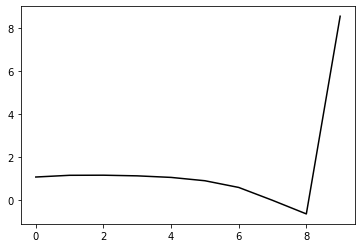

55000 0.41115653587557793
0.32076174441836247 -0.32395461499255357 -0.1708345794737794 -0.10657430057721709
[ 1.0236495   0.98875093  0.96435504  0.92597641  0.84612774  0.68611702
  0.37032979 -0.23125098 -0.86570379  8.48476113]


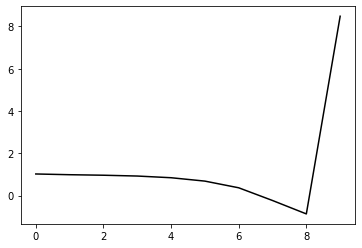

56100 0.19936653072276125
0.3202025330352604 -0.3176829141302145 -0.16601105235233884 -0.11280212410412593
[ 1.08978354  1.07414019  1.02418824  0.98046135  0.90265857  0.74466002
  0.43008567 -0.17073673 -0.80496393  8.51662087]


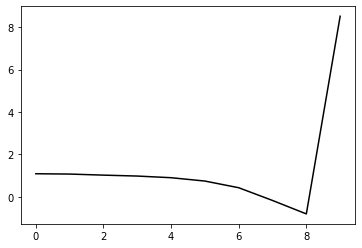

57200 0.1939148742077071
0.3232685497324304 -0.3117340919706862 -0.1620804629357157 -0.11710660967061912
[ 1.1181228   1.17942288  1.16362438  1.1192582   1.04052433  0.88224883
  0.5659689  -0.03773534 -0.67632752  8.50580353]


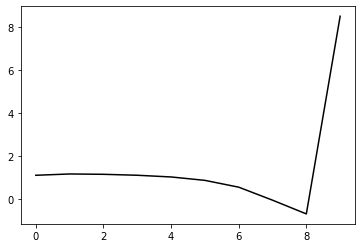

58300 0.1829008941885386
0.33246468282776276 -0.30858901066171013 -0.1622674004229898 -0.1132822850182142
[ 1.03974321  1.20625853  1.21029654  1.16085965  1.06880617  0.89818812
  0.56987074 -0.04577001 -0.69689996  8.56000972]


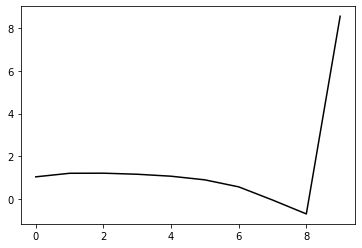

59400 0.18864194159392939
0.32545415558715735 -0.3102963583464885 -0.16207403108029214 -0.11537077802392165
[ 1.10289168  1.10403966  1.11995276  1.09178456  1.01067461  0.84942454
  0.53124361 -0.07322805 -0.71167132  8.49330428]


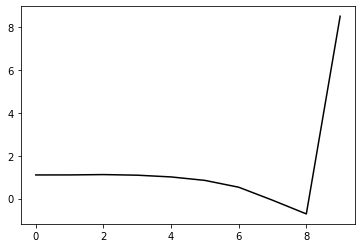

60500 0.2009997343188843
0.3215305100519537 -0.31477691350796566 -0.1652639760633711 -0.11460700492339777
[ 1.09982394  1.04238043  1.04522069  1.02922028  0.96431367  0.81637634
  0.51084329 -0.08108171 -0.70679271  8.55070502]


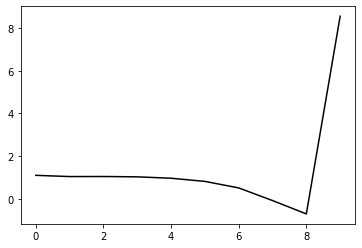

61600 0.1835067821728547
0.31459697211058824 -0.3210920042021944 -0.16942354950798882 -0.11454788840504639
[ 1.07224342  1.05702681  1.01731338  0.9959171   0.93827345  0.79785344
  0.49908758 -0.086364   -0.70615391  8.51452858]


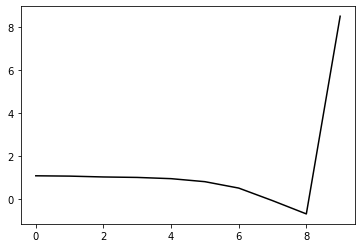

62700 0.11686290463974477
0.32058542845752114 -0.3122182479686883 -0.16411283289768142 -0.11433464208908008
[ 1.08842102  1.17565048  1.103295    1.0418042   0.96087595  0.80345657
  0.48907886 -0.11068784 -0.74427034  8.510608  ]


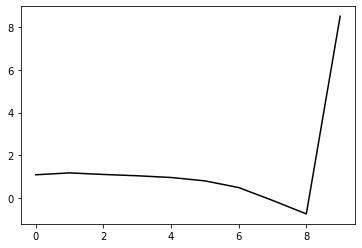

63800 0.15227989994363275
0.3251103692923031 -0.31215130688643156 -0.1653357264581148 -0.11270862765401003
[ 1.08162591  1.15224622  1.13482685  1.07820765  0.99562572  0.84131118
  0.53034033 -0.06659829 -0.69798778  8.53371881]


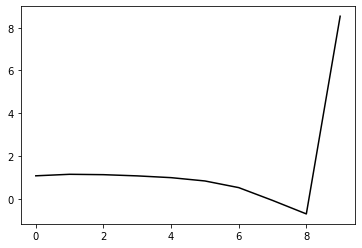

64900 0.1955684028379683
0.3280367040924557 -0.30857769272242835 -0.16381228719031266 -0.11103174964366475
[ 1.06367608  1.08570926  1.10251342  1.05064787  0.95564116  0.78996983
  0.46953306 -0.13618284 -0.77619802  8.50871418]


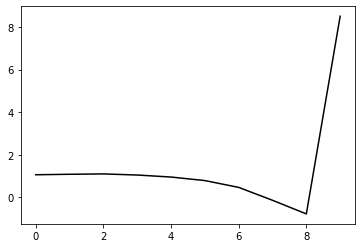

66000 0.20426446353166514
0.3176157845533318 -0.3178300552720881 -0.1693534886390318 -0.11099870056078054
[ 1.07790555  1.04281598  1.04700168  1.02209326  0.94573136  0.79535163
  0.49146235 -0.0970149  -0.71883879  8.49802084]


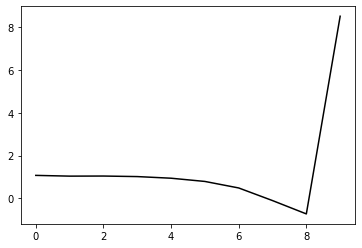

67100 0.237734290217517
0.3138835488095236 -0.3180432036732589 -0.1689839776361357 -0.11508552387629373
[ 1.15438669  1.01847103  1.02338931  1.0152317   0.96279703  0.83289506
  0.54866049 -0.0212797  -0.62614486  8.53630568]


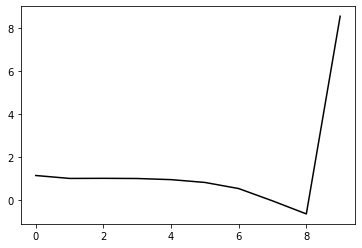

68200 0.2836620842163903
0.3070768697489536 -0.3129043915144121 -0.16379846523392472 -0.11854170030251451
[ 1.1736455   1.00382195  0.98026425  0.95537675  0.89501259  0.75897366
  0.47042143 -0.10181252 -0.7073705   8.49257629]


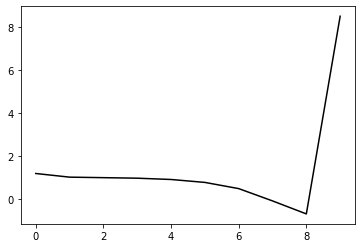

69300 0.20406613183777403
0.3223732719626264 -0.31244409575609156 -0.1673266776929089 -0.11238493080248797
[ 1.02813055  1.12928846  1.09218851  1.03453106  0.94796874  0.78952988
  0.48078429 -0.10997626 -0.73391804  8.55005507]


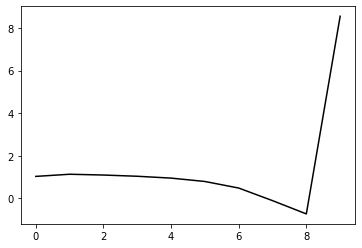

70400 0.18991727354980226
0.3182187767493163 -0.31416384526025093 -0.16812972551389885 -0.1130316126460818
[ 1.07621818  1.08372144  1.05197266  1.00389219  0.924708    0.77579251
  0.47745298 -0.10218938 -0.71415305  8.50276764]


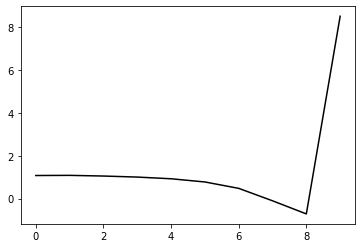

71500 0.25372497781690023
0.32445388526715424 -0.3102174782501646 -0.1665458338317458 -0.11321638055255868
[ 1.02893189  1.10291621  1.09072368  1.0418199   0.95742463  0.80369397
  0.50113867 -0.08246735 -0.69887589  8.54834309]


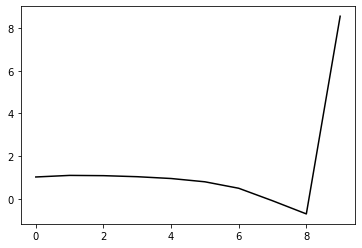

72600 0.18722949754598936
0.3139752170958169 -0.3159242628928564 -0.16948385820327358 -0.11416210685161506
[ 1.06654375  1.06451596  1.02315204  0.97851578  0.89861831  0.74947105
  0.45272889 -0.12416827 -0.73343944  8.50377001]


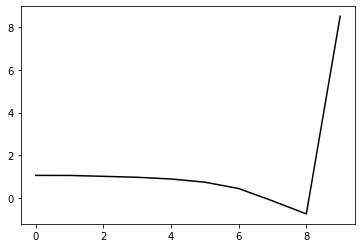

73700 0.13290446459644414
0.31811439888210635 -0.31425532670134027 -0.16956135278626497 -0.11323068786996533
[ 1.08127841  1.11793982  1.09118615  1.04082353  0.95996913  0.81022343
  0.5129995  -0.06464231 -0.67605023  8.52165646]


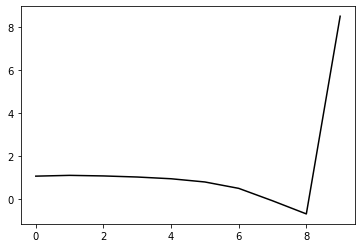

74800 0.12745217190651537
0.31705254621708967 -0.3100334292078727 -0.16661119646618314 -0.1160872226915742
[ 1.11043731  1.14977452  1.14097346  1.10836789  1.0417088   0.90432125
  0.61689799  0.0459452  -0.56283057  8.54286675]


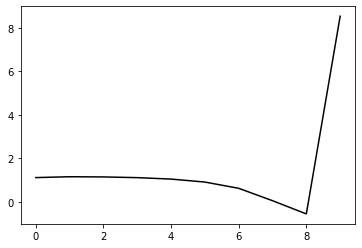

75900 0.23310828519972582
0.3193049834831953 -0.3109665603499215 -0.16845537213285403 -0.11226911427476015
[ 1.03509641  1.06616886  1.06163845  1.02827356  0.95782043  0.81785263
  0.52965615 -0.04061725 -0.6481939   8.54756309]


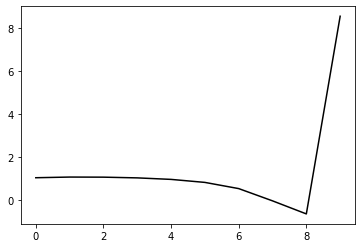

77000 0.22464964278752295
0.31769304391007885 -0.3117159994109272 -0.16917178411666134 -0.11010701496422087
[ 1.04934828  1.03106419  1.00457771  0.96625233  0.8922152   0.74921967
  0.45943719 -0.11110237 -0.71823778  8.50885319]


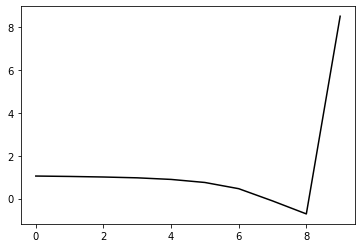

78100 0.19546368064985742
0.31720840589668003 -0.3071919226948813 -0.1656342319826547 -0.11365818158919845
[ 1.10816322  1.12834154  1.08267595  1.03039062  0.94880857  0.79827825
  0.50155853 -0.07493738 -0.68744051  8.53026381]


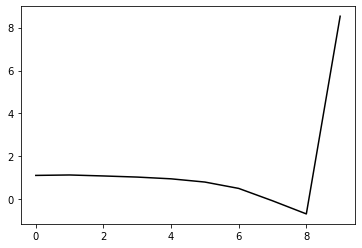

79200 0.27372958755577176
0.30814556566250983 -0.3057774049029712 -0.16325594636992338 -0.11642095042339569
[ 1.16987815  0.96261272  0.94994529  0.91577996  0.84676991  0.70893894
  0.42451554 -0.13979962 -0.74007688  8.48032734]


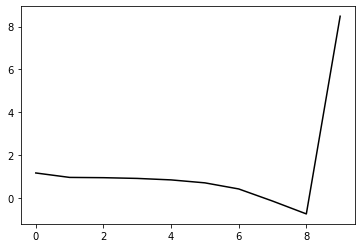

80300 0.16474986307106257
0.3230621941296916 -0.3042366118897489 -0.1656481503420804 -0.11299157532296047
[ 1.05140267  1.15844655  1.12452104  1.0675957   0.97861945  0.82156031
  0.51913674 -0.06219084 -0.67978763  8.54678415]


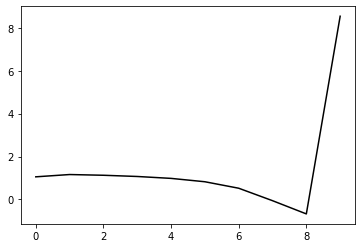

81400 0.19124013705020224
0.3092297739296478 -0.31353070015314466 -0.17084646117889174 -0.11417177515756675
[ 1.11147726  1.03618948  1.01656387  0.99184366  0.93022017  0.79875945
  0.52082873 -0.03660984 -0.63045569  8.50592016]


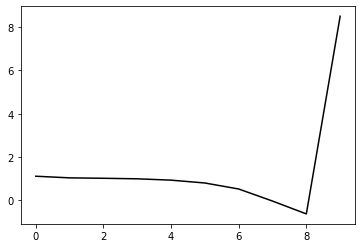

82500 0.2470439764890581
0.3056550388507256 -0.30902829187976233 -0.16717613477743812 -0.1153956092711973
[ 1.14701131  1.02272753  0.97855736  0.93466171  0.85973761  0.716334
  0.42827658 -0.13723714 -0.73780859  8.52629017]


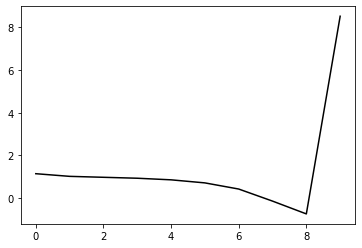

83600 0.198308507150485
0.3180394200863284 -0.3072221809136616 -0.1687419736270422 -0.11281852462861021
[ 1.05876785  1.1627088   1.14924687  1.0978613   1.01333112  0.85933858
  0.55921163 -0.01966983 -0.63608774  8.53797044]


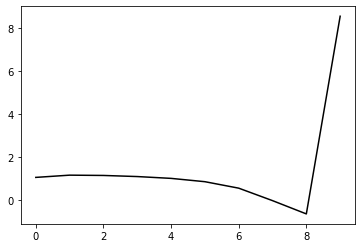

84700 0.11764598955602801
0.31102830370639645 -0.31105480875827346 -0.17062212976021873 -0.11560644333947395
[ 1.10946868  1.18027678  1.17079632  1.14035793  1.072451    0.93378236
  0.64820393  0.08344477 -0.51917571  8.56069779]


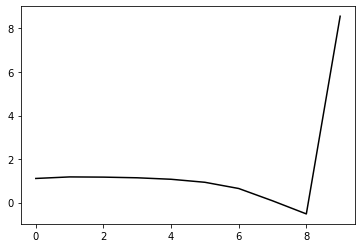

85800 0.13880340462489651
0.30797820604830245 -0.3060491337906151 -0.1667599589524583 -0.11427553980107348
[ 1.1233193   1.1298294   1.09081242  1.03781578  0.95071694  0.79545729
  0.49656404 -0.0783021  -0.6887618   8.52862088]


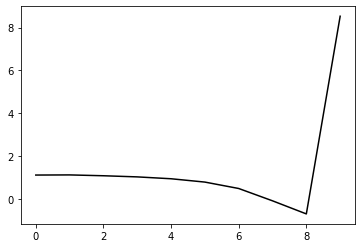

86900 0.20565660497096777
0.3141567908315795 -0.3074072041049811 -0.1694480021339984 -0.11479198952459677
[ 1.07324811  1.1643333   1.18483115  1.14812602  1.06824295  0.91735839
  0.62104332  0.0474769  -0.56341642  8.55879007]


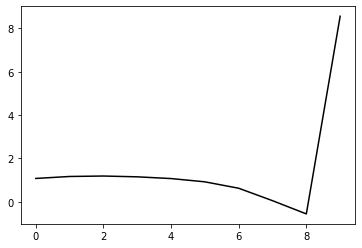

88000 0.2037846233470645
0.31298074901995576 -0.3068135644870434 -0.1698098961471292 -0.1112201673795203
[ 1.09060689  1.06067051  1.07683043  1.05497073  0.98318736  0.83729845
  0.54500029 -0.02545806 -0.6350059   8.52442   ]


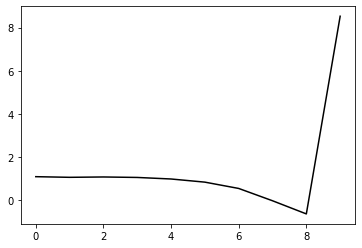

89100 0.19123207623345714
0.3099599038525544 -0.3038230998474122 -0.16737318019071462 -0.1125150405520414
[ 1.11056303  1.10583325  1.10080625  1.07686965  1.00441536  0.85492885
  0.55854753 -0.01557893 -0.62889887  8.55831088]


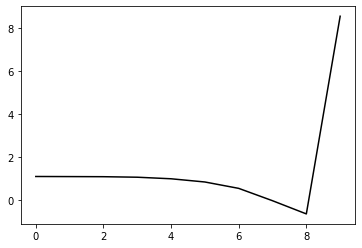

90200 0.17708837983590944
0.3128176297574063 -0.2999638208788271 -0.16512572153553903 -0.11398942425027285
[ 1.11518836  1.1764334   1.18343341  1.16143615  1.09180831  0.94250465
  0.6450192   0.07004979 -0.54419206  8.53668432]


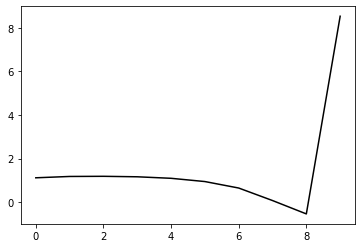

91300 0.18075981006211914
0.2984086383748442 -0.3057627203734213 -0.16741788419323944 -0.11331657091794363
[ 1.09916852  0.92028919  0.87373778  0.84816714  0.78268387  0.63953991
  0.34966697 -0.21511985 -0.81640017  8.54998107]


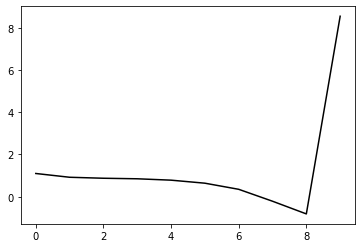

92400 0.17298957454670813
0.3157521968237957 -0.2996910560163397 -0.16656298702025485 -0.11154351191520771
[ 1.08732287  1.16988046  1.13943652  1.09564778  1.02120925  0.86868616
  0.56716901 -0.01031515 -0.62577484  8.50583952]


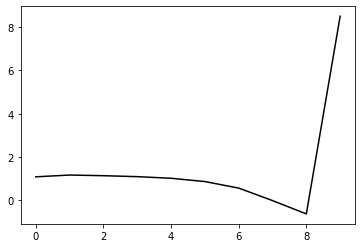

93500 0.27238670946724186
0.32138878328605375 -0.2957173039523255 -0.16537738076907377 -0.11023377280045793
[ 1.02102853  1.15144082  1.16287773  1.12051126  1.03719487  0.87757918
  0.56866043 -0.0160067  -0.63878876  8.55620522]


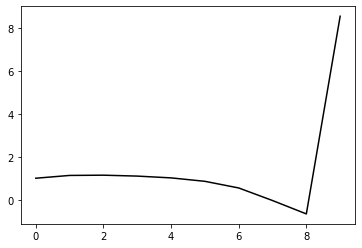

94600 0.1679518475172219
0.3106478783670806 -0.300790396520053 -0.16706760547735494 -0.11184231343131111
[ 1.1289916   0.98125293  0.9932455   0.9769032   0.91383513  0.77404168
  0.48540746 -0.07775081 -0.67675551  8.50019011]


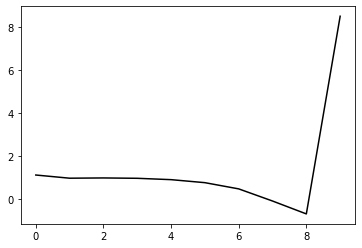

95700 0.2444520852268314
0.3132276854112764 -0.30261660838158283 -0.1695402793050023 -0.10891933468859803
[ 1.01897797  1.03630435  1.00961083  0.97532832  0.90151085  0.75103441
  0.45225544 -0.11998703 -0.72734667  8.54914651]


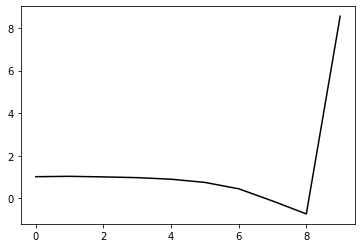

96800 0.13673702030774781
0.31436077602480517 -0.2982929661682391 -0.1666068978167194 -0.11210367523436279
[ 1.09001821  1.08588793  1.05770892  1.02717518  0.9647696   0.8246992
  0.53396734 -0.03175685 -0.63345813  8.52696265]


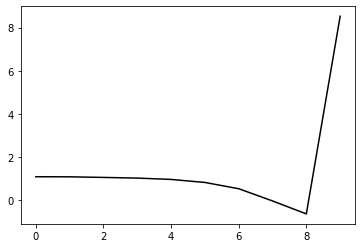

97900 0.18575874067531295
0.3114949945823299 -0.2997308440343131 -0.16732549218652726 -0.11307849866020234
[ 1.07715768  1.05635855  1.0446447   1.01529133  0.95284791  0.81569412
  0.52832816 -0.03319965 -0.62931692  8.54020486]


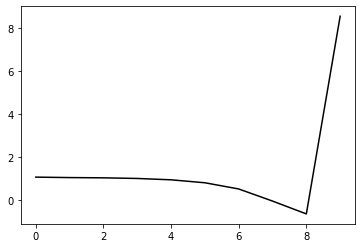

99000 0.21071572550855833
0.31036689632951303 -0.302354958562856 -0.16937764021008653 -0.1121119888199108
[ 1.0618947   1.07013538  1.05258929  1.0241779   0.96147552  0.82598406
  0.54114043 -0.01721526 -0.60933322  8.52160407]


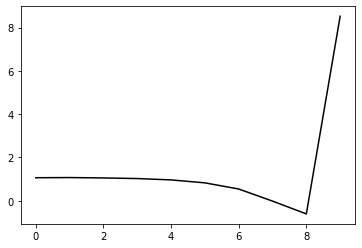

100100 0.21483783758950745
0.3029505372193705 -0.30569958045080753 -0.17099822195560832 -0.11240488780516114
[ 1.12195011  0.94399876  0.93421792  0.92360868  0.87993375  0.76293006
  0.49514568 -0.04763757 -0.62483071  8.54343938]


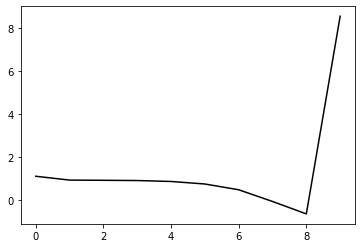

101200 0.23352607115314786
0.29938812400661013 -0.3020020218844414 -0.16770861776680301 -0.11669992108775375
[ 1.16912279  1.03707572  1.00168348  0.98534538  0.94741635  0.83794693
  0.57694642  0.03951746 -0.53372209  8.52013849]


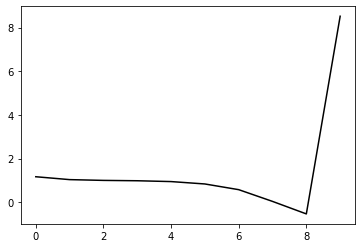

102300 0.188774027171826
0.29724745170608624 -0.3018100611279591 -0.16790985440924489 -0.11517277955999208
[ 1.10662069  0.98244809  0.91699172  0.86383262  0.80024966  0.67398438
  0.4007519  -0.14591364 -0.72595757  8.56437815]


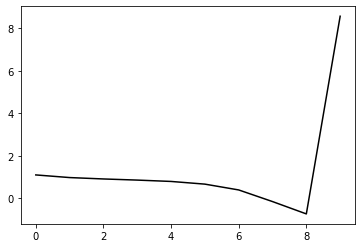

103400 0.15660928629272353
0.3128777532341712 -0.29730137098795845 -0.1678175544316614 -0.1142776367003564
[ 1.10311789  1.18308524  1.15810256  1.09655571  1.01966543  0.88303554
  0.60012398  0.04301225 -0.54897173  8.51220753]


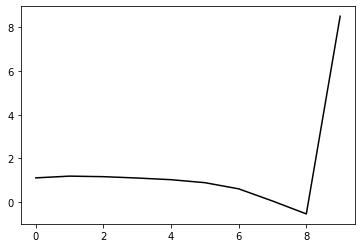

104500 0.19942598162968203
0.30789864151875507 -0.3016783411182175 -0.17033571332917377 -0.11404518674910026
[ 1.10499566  1.10598484  1.09344475  1.05061604  0.97936894  0.85065187
  0.57861824  0.03400416 -0.54330296  8.55151396]


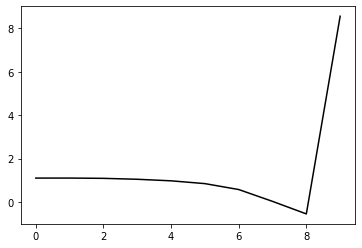

105600 0.1648965125965707
0.30227184016004155 -0.30297902201964877 -0.17061867666509908 -0.11540920203373804
[ 1.10652944  1.08413031  1.03917702  0.99444551  0.92049833  0.78862609
  0.51576885 -0.02885186 -0.60583883  8.49884197]


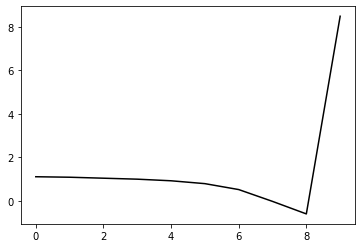

106700 0.12012584608559389
0.30547906776535744 -0.3016697016790741 -0.17069870149871558 -0.11619353832654036
[ 1.11137059  1.16230646  1.11883794  1.06631612  0.98866991  0.85319254
  0.5784105   0.03252602 -0.54572088  8.54809902]


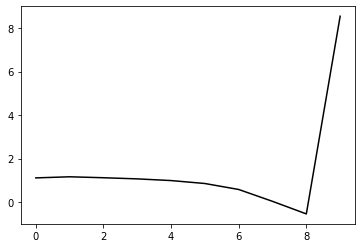

107800 0.12635361520613725
0.31018356536990954 -0.2994078620595963 -0.17041565537525194 -0.11494672135097017
[ 1.11174857  1.15336904  1.15207117  1.10688338  1.02884156  0.8919526
  0.61629727  0.06928389 -0.51106584  8.54713513]


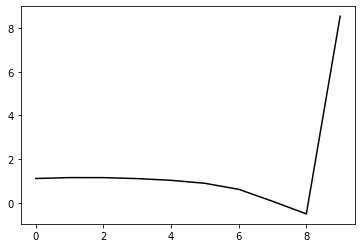

108900 0.19126632977726502
0.30720406953691276 -0.3012055536395521 -0.1719886559580619 -0.11352362987607653
[ 1.06758639  1.04237061  1.0356216   1.00325216  0.93090609  0.7972557
  0.52634734 -0.01498897 -0.58935659  8.57811614]


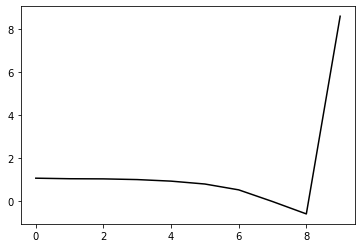

110000 0.20680031126987797
0.3059983542596273 -0.30039980098696933 -0.1718474406878396 -0.11142880647193426
[ 1.0958113   1.07484432  1.03626207  0.99170728  0.913394    0.77195656
  0.49435118 -0.05246148 -0.63209965  8.51229514]


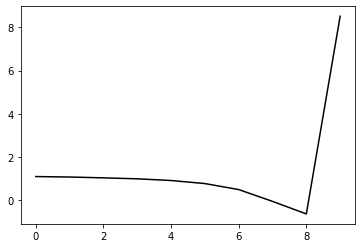

111100 0.19516186091337515
0.30583755981637784 -0.2996746255952263 -0.1717063049225683 -0.11305136276400231
[ 1.12453611  1.11126529  1.09403503  1.05655472  0.98660664  0.85188689
  0.57976499  0.03745233 -0.53987776  8.54906092]


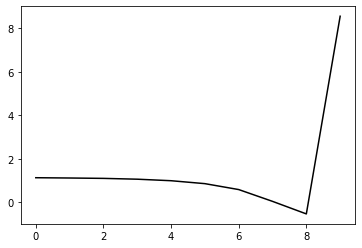

112200 0.17731362322042057
0.31230571597279116 -0.29079901022204946 -0.1665795689690167 -0.11273966095097845
[ 1.11655151  1.18991923  1.18953676  1.14447995  1.05980156  0.90960167
  0.62265456  0.0667072  -0.52454541  8.52046475]


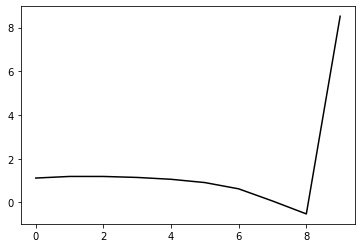

113300 0.1661202784077489
0.3066704170092621 -0.2963834478137288 -0.16989967704633827 -0.11272254693436023
[ 1.07704456e+00  1.09062493e+00  1.06924022e+00  1.03437825e+00
  9.57661558e-01  8.14661242e-01  5.36684360e-01 -7.80034922e-03
 -5.85768671e-01  8.56760679e+00]


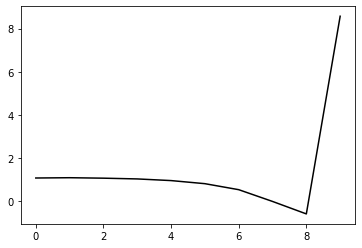

114400 0.20621592796422036
0.29925080811260435 -0.3019349542808094 -0.17350308490680857 -0.11084934472920428
[ 1.08908184  1.0207851   0.96071832  0.92421145  0.85528508  0.72094047
  0.45306076 -0.07910996 -0.64323161  8.48991045]


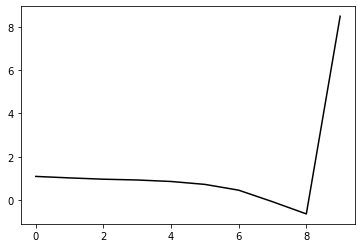

115500 0.1972791126953864
0.3134105807300208 -0.29084841052499694 -0.16751123308356577 -0.11330319574968306
[ 1.10638836  1.17865416  1.16460467  1.11512326  1.03497959  0.8888719
  0.60809603  0.06324595 -0.51406079  8.57329695]


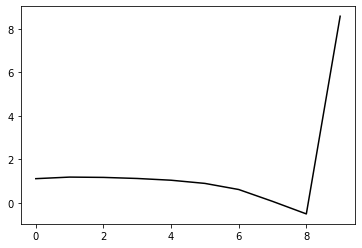

116600 0.16156716896307582
0.305993253528524 -0.2968619130728751 -0.17108763557945295 -0.11283693084534696
[ 1.09735540e+00  1.10734208e+00  1.06347247e+00  1.01888203e+00
  9.43713472e-01  8.04337112e-01  5.31281774e-01 -4.15718315e-03
 -5.70439115e-01  8.54575654e+00]


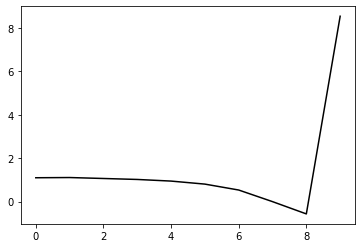

117700 0.1362002244248348
0.2980636094760302 -0.29777031935299214 -0.17104719947705935 -0.11265718539945704
[ 1.12710421  1.05197265  0.98104358  0.93018935  0.85532035  0.71772272
  0.44705985 -0.08496626 -0.64699738  8.5302313 ]


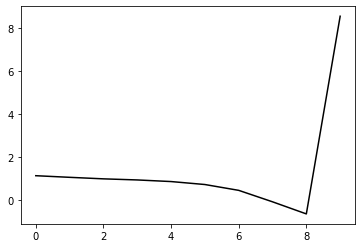

118800 0.12890442814977648
0.30890889141644645 -0.2955859276138992 -0.171354248591606 -0.11670137035468504
[ 1.12100518  1.20333671  1.18726024  1.1414427   1.07225306  0.94054834
  0.67467634  0.14684252 -0.41171673  8.53474472]


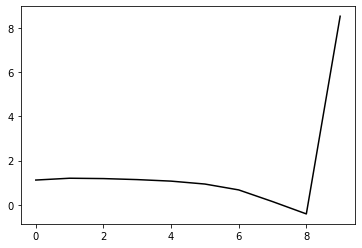

119900 0.20197392034900535
0.3096493106353647 -0.29388490244330734 -0.1709671789408001 -0.11359817928858586
[ 1.07166787  1.13002931  1.11988245  1.07201165  0.99191548  0.85136806
  0.57810497  0.04417073 -0.52011628  8.56714612]


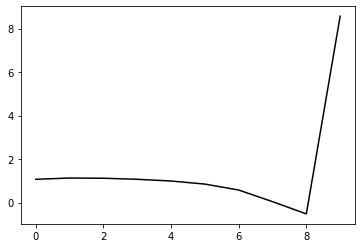

121000 0.2003280452976664
0.31168058870809096 -0.2887137320324042 -0.16817240836542663 -0.11211744759869999
[ 1.08188384  1.15830056  1.14231794  1.09496621  1.00896213  0.86013807
  0.57800344  0.03451748 -0.54103192  8.53742754]


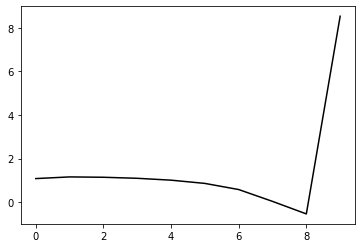

122100 0.22194579609616638
0.30610885060818704 -0.2923848710944758 -0.1708881072513561 -0.1077717136326772
[ 1.12698916  0.91563833  0.91035753  0.87841975  0.80289571  0.66383737
  0.39334273 -0.13604331 -0.69481055  8.53660873]


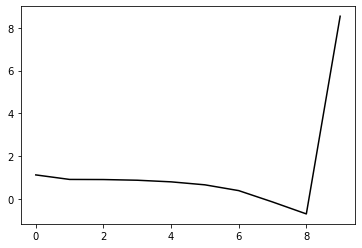

123200 0.21486336739515055
0.30017039808021656 -0.2904271658613175 -0.1679330286690364 -0.11514130020824193
[ 1.15164987  1.03056376  1.00186866  0.98048639  0.92050182  0.79233809
  0.53071909  0.00963507 -0.54135624  8.53041686]


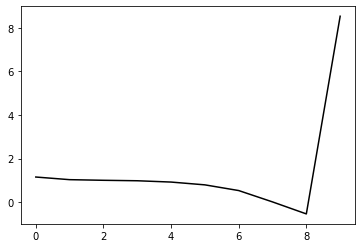

124300 0.20818697133664532
0.3086193260823959 -0.2953448856461943 -0.17406921385861462 -0.10974393617856369
[ 1.06063151  1.10371525  1.07072118  1.03505245  0.96998292  0.83776975
  0.57231942  0.04846755 -0.50462316  8.57622465]


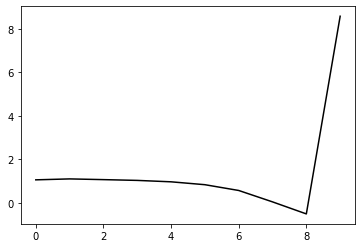

125400 0.1858642980304876
0.3090244310628107 -0.28830350962501683 -0.1690414282354776 -0.11252437201515168
[ 1.13645772  1.08800742  1.06545788  1.02266751  0.95338393  0.81902976
  0.55147138  0.02643638 -0.52703465  8.52848155]


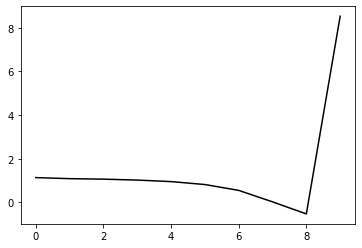

126500 0.24353882634723184
0.3131638571765444 -0.2881777267133981 -0.17007790206020676 -0.11108754332175143
[ 1.04850738  1.15722322  1.14552135  1.09854556  1.02043206  0.87900795
  0.60497296  0.07455427 -0.48368088  8.59015436]


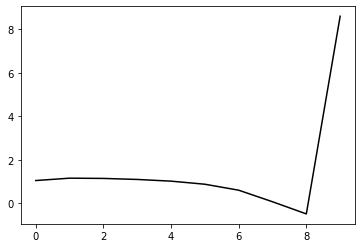

127600 0.15384423015499796
0.3093694415536405 -0.287916216288599 -0.16969367641985275 -0.11031418138509942
[ 1.12182383  1.03543195  1.02959381  0.9895819   0.91400878  0.77484998
  0.50321684 -0.02442117 -0.57969365  8.51045135]


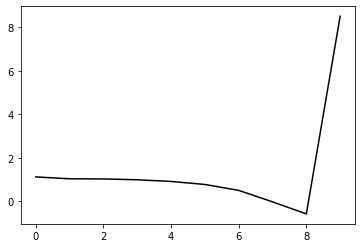

128700 0.13788643368776896
0.3054104381082816 -0.29376755488082834 -0.17316976850802776 -0.11111372916584555
[ 1.07553040e+00  1.09491918e+00  1.06140875e+00  1.01806070e+00
  9.41312632e-01  8.01606039e-01  5.31525237e-01  8.37272994e-03
 -5.39050356e-01  8.55610019e+00]


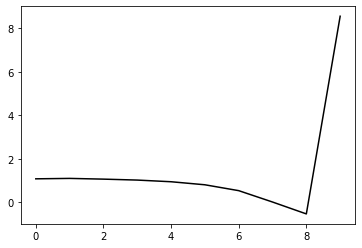

129800 0.14049385603644174
0.3031523293201535 -0.2907765350168639 -0.17077262478159075 -0.11588490195292198
[ 1.13480675  1.13845037  1.09836975  1.05731324  0.98994227  0.85952947
  0.59809323  0.08332209 -0.45599494  8.55926155]


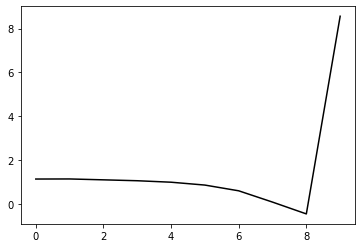

130900 0.19115286072484466
0.30494985131261076 -0.29071330559179653 -0.17166442110828511 -0.11273764914431204
[ 1.07207672  1.07347033  1.03093234  0.96975694  0.88716975  0.74603697
  0.47653606 -0.04369085 -0.58632779  8.55824584]


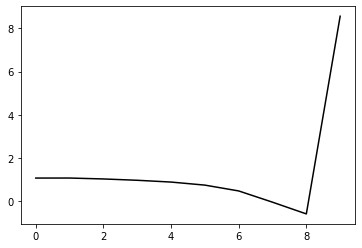

132000 0.20377233755266708
0.30612246176657754 -0.2903013888178212 -0.17231227895484474 -0.11130980051752994
[ 1.07980539  1.15437132  1.08552431  1.00066384  0.89628587  0.73669614
  0.45111476 -0.08306749 -0.63812614  8.52399476]


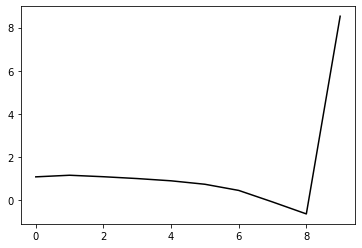

133100 0.22214938601675147
0.30310922294280307 -0.2899316217808416 -0.1720817154992036 -0.11121120072505097
[ 1.14034418  0.98892916  0.98114565  0.91816893  0.82221936  0.6710287
  0.39399816 -0.13156805 -0.67773375  8.55749796]


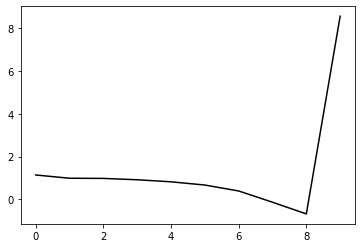

134200 0.18241163974044566
0.30402589458991214 -0.29242912232730367 -0.17421086750829462 -0.11187809149246238
[ 1.07655299e+00  1.09670513e+00  1.08397148e+00  1.03511931e+00
  9.44799320e-01  7.96628674e-01  5.23620551e-01  3.19625517e-03
 -5.36889063e-01  8.53133255e+00]


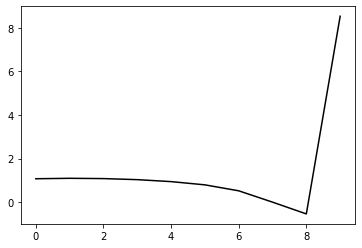

135300 0.18592199250334823
0.3026316716196625 -0.2925721634533733 -0.17405338460966793 -0.11456091380194384
[ 1.13670164  1.07615725  1.07137556  1.03700869  0.95952878  0.82046936
  0.55631998  0.04510258 -0.48562593  8.568229  ]


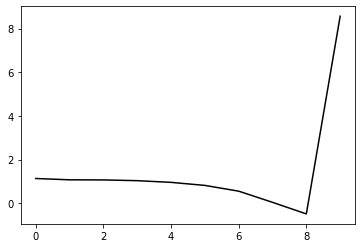

136400 0.19184470896258593
0.3003462515217309 -0.29276395000532834 -0.174164062344 -0.11381431692818572
[ 1.12557879e+00  1.10216005e+00  1.07337108e+00  1.02484726e+00
  9.38072499e-01  7.88745043e-01  5.15782449e-01 -1.63377051e-03
 -5.36234121e-01  8.52564510e+00]


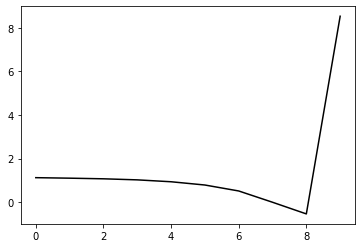

137500 0.19282437468324104
0.3042192090165196 -0.29002859859327634 -0.17321354345052278 -0.11377123685824404
[ 1.09631903  1.19076121  1.16996547  1.1184751   1.0258526   0.86892718
  0.58789081  0.06328006 -0.47814271  8.56380592]


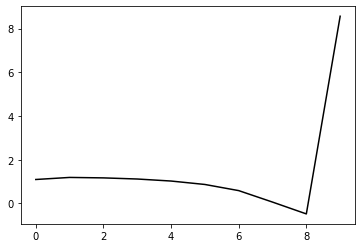

138600 0.2866231403180817
0.3132054896231281 -0.28585356675214596 -0.17248264537884667 -0.11219647766157312
[ 1.03582549  1.24159588  1.25089192  1.20493303  1.11022048  0.94822344
  0.66058332  0.12883264 -0.42099845  8.5382469 ]


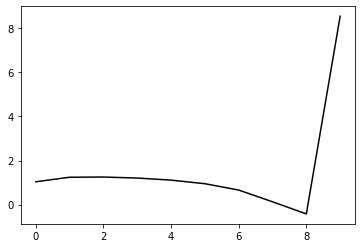

139700 0.11922589476686704
0.30182750062021557 -0.2880161539550397 -0.17207581242373973 -0.11483767274872184
[ 1.11934346  1.15081479  1.13266001  1.090309    0.99874274  0.83860177
  0.55327097  0.02559969 -0.51784268  8.53447263]


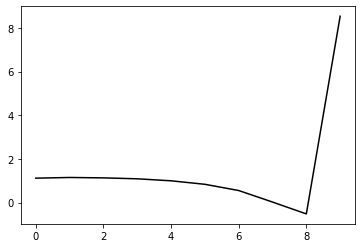

140800 0.12603207376720404
0.30437623564239147 -0.285664390022764 -0.17094032332230244 -0.11528159315416851
[ 1.10133212  1.14151558  1.14448162  1.10484796  1.01467054  0.85361494
  0.5664605   0.03753362 -0.50664567  8.55170374]


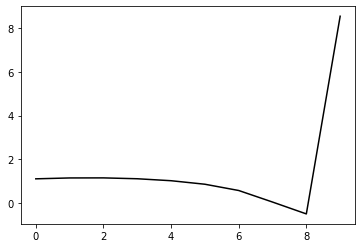

141900 0.1911903957658019
0.3053455320414567 -0.2861901903077627 -0.17182402347004563 -0.11426029193579489
[ 1.08377821e+00  1.09997681e+00  1.10440113e+00  1.06918182e+00
  9.80520190e-01  8.18520506e-01  5.29494485e-01 -3.69521225e-04
 -5.44413706e-01  8.55401508e+00]


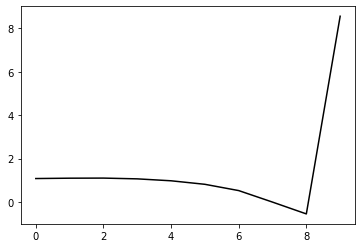

143000 0.20794659197803655
0.30585165198885816 -0.2862342050691604 -0.17228783364161096 -0.11316864945209902
[ 1.08662168  1.07340788  1.07322769  1.04205981  0.95693316  0.79584245
  0.50650933 -0.02266743 -0.56462974  8.52901181]


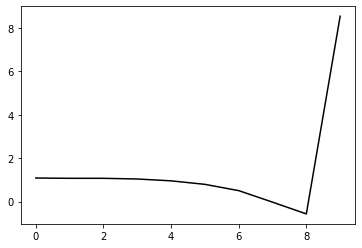

144100 0.19826860516256622
0.2996736673084749 -0.28858631730289547 -0.17312531802538164 -0.11420000392380959
[ 1.09076164  1.04804741  1.04034365  1.01521449  0.93797116  0.78275816
  0.49775583 -0.02633491 -0.56169086  8.55074392]


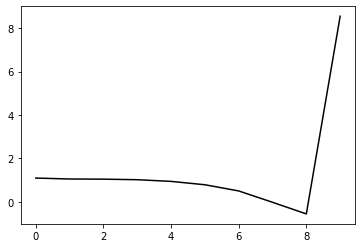

145200 0.2384982118552483
0.296054465341389 -0.28451535121325955 -0.16920699219786806 -0.11932651783104399
[ 1.14550889  1.03306514  1.01547228  0.99065186  0.92142861  0.77373835
  0.49485355 -0.0223482  -0.54899812  8.50779842]


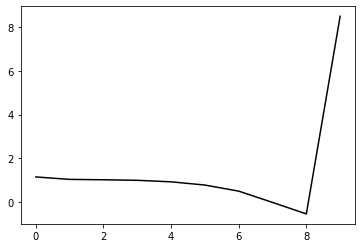

146300 0.1743912972182717
0.30656956774884625 -0.2801972010982745 -0.16875562658625728 -0.11448990622655413
[ 1.07802258  1.15076045  1.12372556  1.06823086  0.97369875  0.80118311
  0.49578344 -0.04735111 -0.59894171  8.56143744]


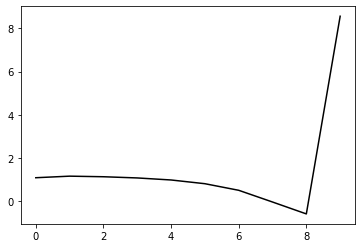

147400 0.19152374214622353
0.305692645999237 -0.2844405764941745 -0.1721571951495693 -0.11267390567262418
[ 1.07029824  1.07832939  1.07789846  1.04160081  0.9576194   0.79590252
  0.49982776 -0.03369222 -0.57378835  8.52858112]


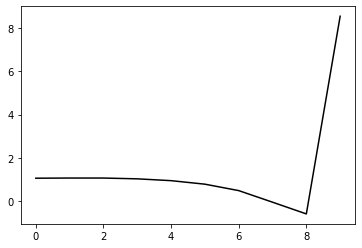

148500 0.21636802396306223
0.2974313396594491 -0.28723214478729764 -0.17335229057852702 -0.11209562101419157
[ 1.1208915   1.01371986  0.96557066  0.92347314  0.83811425  0.67532419
  0.37804195 -0.15569321 -0.69376944  8.52993767]


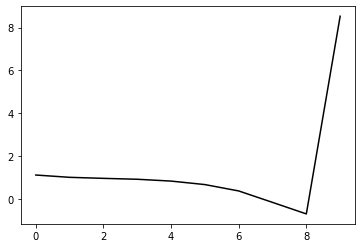

149600 0.15177803241913973
0.3071717208756571 -0.28289948273935706 -0.17200530366170402 -0.11368745339187061
[ 1.0857463   1.14976579  1.13853237  1.09343707  1.00926281  0.84748367
  0.54943643  0.01431045 -0.52463291  8.51248148]


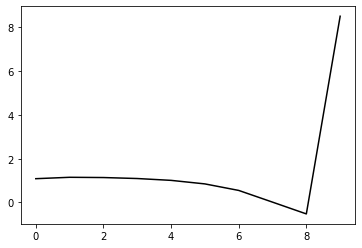

150700 0.11923905160593494
0.299313058563751 -0.2889187646525918 -0.17517204597302374 -0.11674881075442141
[ 1.1115807   1.15580376  1.13781884  1.1108492   1.04310842  0.89745431
  0.61377811  0.09246529 -0.43127333  8.57116386]


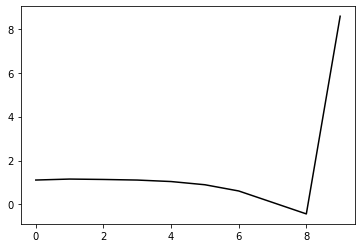

151800 0.13097324665922613
0.3005113050587837 -0.2826611840158301 -0.17131780848541459 -0.1142456042443138
[ 1.11606714  1.12146808  1.07829445  1.0235556   0.933921    0.76850419
  0.4651192  -0.07556871 -0.61764275  8.53914127]


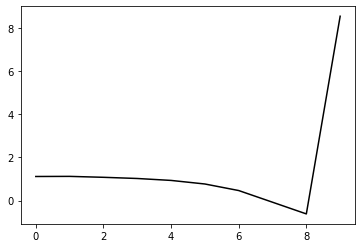

152900 0.2045763413213214
0.30659058479529233 -0.28034226846448107 -0.17130942427972565 -0.11241176841744718
[ 1.05411914  1.0763112   1.0871257   1.03601252  0.94182444  0.77294937
  0.46531109 -0.08033233 -0.62685499  8.55398418]


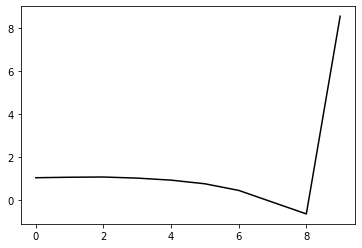

154000 0.2211402839882795
0.30181411898419575 -0.28579714048584975 -0.17523202546472466 -0.11191588090040562
[ 1.06866858  1.10914086  1.09824493  1.06228444  0.9778111   0.81599981
  0.51388651 -0.02763391 -0.56993697  8.50827244]


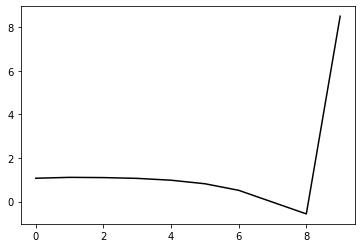

155100 0.1881718228179117
0.30524160089631813 -0.27933784563067315 -0.17107078498231595 -0.11194167665814554
[ 1.11177762  1.13129885  1.1154031   1.06601953  0.97178843  0.80078054
  0.49022408 -0.05908443 -0.60756528  8.54181267]


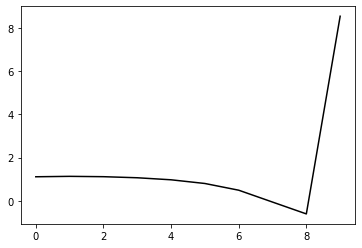

156200 0.18653807313728682
0.29836494464161617 -0.2872343428207054 -0.17627340693724775 -0.11168110921736207
[ 1.08504752  1.04302267  1.0499288   1.03159436  0.95943635  0.80712904
  0.51328986 -0.02020966 -0.55144694  8.53497115]


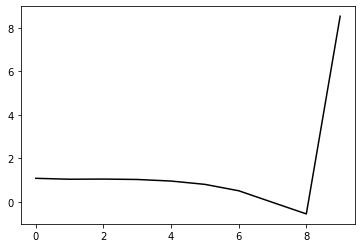

157300 0.1850248054995309
0.3048578935298557 -0.2831722882044673 -0.17512207108515984 -0.1106181951794557
[ 1.07442768  1.17532926  1.16125106  1.12616628  1.04576083  0.88196694
  0.57389588  0.02415724 -0.52420319  8.6037347 ]


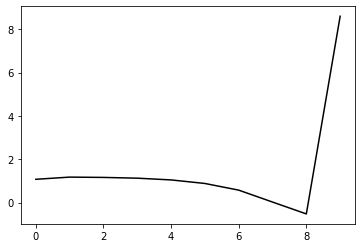

158400 0.1520222743505328
0.30577345054798427 -0.27644972511738264 -0.1703658802504815 -0.11273839187692986
[ 1.10464438  1.18796234  1.18121886  1.14546703  1.06299885  0.89687409
  0.58447256  0.02884646 -0.52555469  8.51921877]


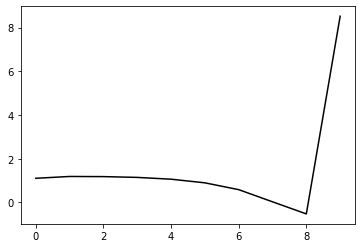

159500 0.19653708123689986
0.29647224628423674 -0.285391297742524 -0.17584920838912574 -0.11225093675016275
[ 1.11178245  1.06817662  1.0777259   1.06412003  1.00068308  0.85311886
  0.55840275  0.0203968  -0.51404083  8.56648635]


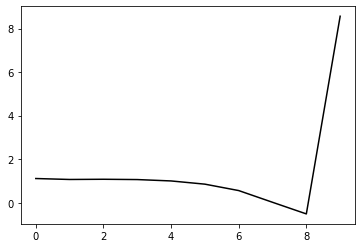

160600 0.17430945810958845
0.29604263736391795 -0.27670732245339125 -0.1693991241252346 -0.11259966797084509
[ 1.12138787  1.06249532  1.0168383   0.96962557  0.87997481  0.70884369
  0.39268056 -0.16477228 -0.71597713  8.5185817 ]


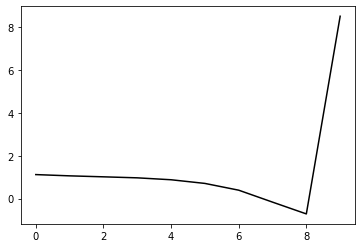

161700 0.11499612296349317
0.30484041168442433 -0.2766180242979044 -0.17111802428345332 -0.11374978991293058
[ 1.09360719  1.19140337  1.20267528  1.16507245  1.08341842  0.91853499
  0.6056356   0.04934495 -0.50069855  8.57301971]


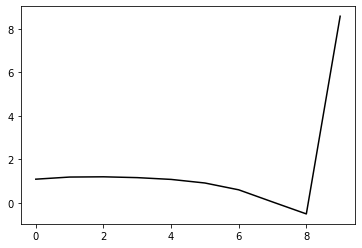

162800 0.1417006516445454
0.2965607686246727 -0.2822463176108454 -0.17451339412807193 -0.11130139482831228
[ 1.12253623  1.07495068  1.04690073  1.01239187  0.93501883  0.77560002
  0.46822851 -0.08250689 -0.62492289  8.53085065]


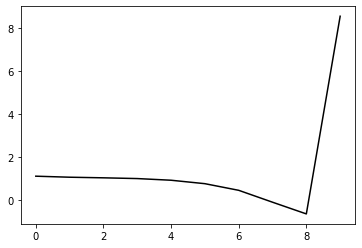

163900 0.19416592294043755
0.2998105783224969 -0.27921544809696713 -0.1733003780472824 -0.10995137130180663
[ 1.06188566  1.00655331  1.0074129   0.97004725  0.89033777  0.7290506
  0.418622   -0.13652427 -0.6831052   8.54495087]


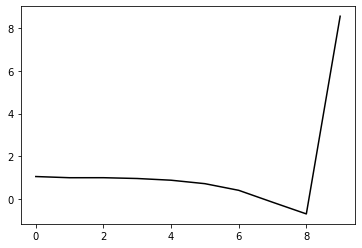

165000 0.21033752340302672
0.295759999157805 -0.280651114309082 -0.17439692238010254 -0.10973158589410138
[ 1.09264997  1.08281107  1.01946275  0.97326398  0.89051308  0.7265639
  0.41305482 -0.14580349 -0.69566992  8.51604585]


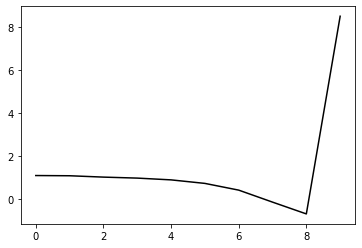

166100 0.22034256069131433
0.2924764732401565 -0.28422689213447705 -0.17687299633542775 -0.11146052377476848
[ 1.14638915  1.01498392  1.00118092  0.96736401  0.89937497  0.75097454
  0.45162979 -0.09442568 -0.6308636   8.54327012]


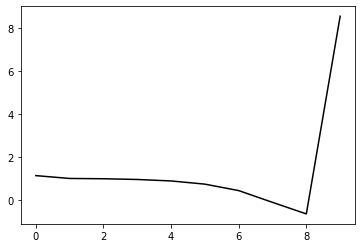

167200 0.17013559282415872
0.30140561971039886 -0.2757756164444809 -0.17245826905652653 -0.11187569016653968
[ 1.10443472  1.24770662  1.21220667  1.1574468   1.07037246  0.90495232
  0.58826426  0.02326136 -0.53343584  8.5234723 ]


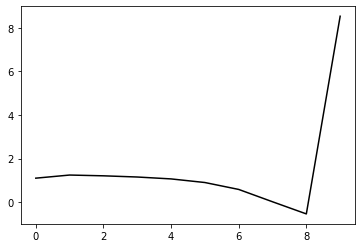

168300 0.18664248614764786
0.30149493639342545 -0.27733294615079485 -0.17413237362651737 -0.11127872852474223
[ 1.05575325  1.15142974  1.14571976  1.09874684  1.01072306  0.84644068
  0.53144669 -0.03270801 -0.58811734  8.58671602]


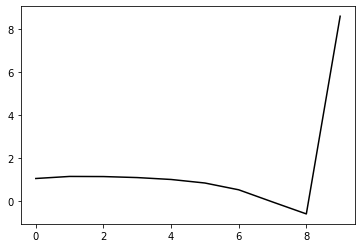

169400 0.1611931288075236
0.30207158303551346 -0.2756250085774024 -0.17310752415670158 -0.11227778072568724
[ 1.1110681   1.19166653  1.19858565  1.16482966  1.08336454  0.92359002
  0.61267032  0.05117453 -0.50159329  8.51924579]


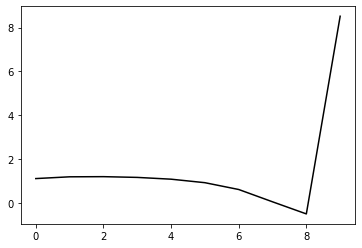

170500 0.20270028350745434
0.2926384004912455 -0.28162480223885267 -0.1763817457453865 -0.11112512093120348
[ 1.11310647  1.12696739  1.11652944  1.07988165  0.99434174  0.83102559
  0.5188814  -0.042004   -0.59104016  8.5586099 ]


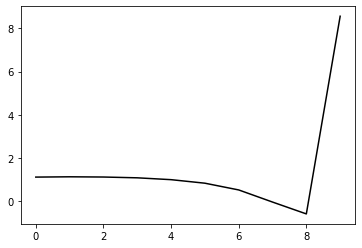

171600 0.1584575100400921
0.2967240477938053 -0.2787494132993123 -0.17499333293751157 -0.11276332658415737
[ 1.09428283  1.13407936  1.14499216  1.10897658  1.02060539  0.85292806
  0.5368144  -0.02817409 -0.58063608  8.5389232 ]


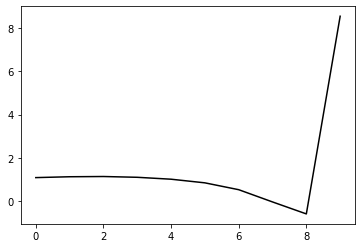

172700 0.14137321586334656
0.2941734087377572 -0.2763730333890097 -0.1728701670108956 -0.11418914303226063
[ 1.13835462  1.0973209   1.11902429  1.09886923  1.01810828  0.85405153
  0.54113919 -0.02114115 -0.57014372  8.56049357]


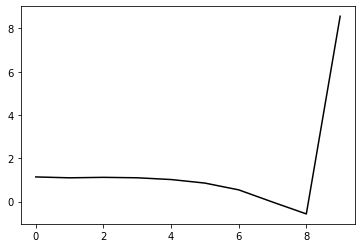

173800 0.17045357185733648
0.2984172322770004 -0.27173115758616784 -0.17048113437338278 -0.11355950488041631
[ 1.15700296  1.08244596  1.10733301  1.09134196  1.01445535  0.84941241
  0.53366557 -0.0327588  -0.58624915  8.52626454]


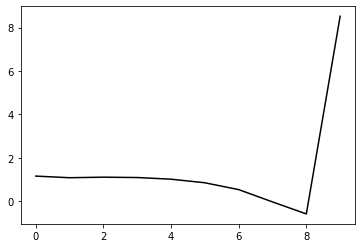

174900 0.18730139402974497
0.29490648600863056 -0.2785298324607513 -0.17553301943511604 -0.11222485377788116
[ 1.09031781  1.05662186  1.05236614  1.03589659  0.96756741  0.80966616
  0.50026179 -0.05965857 -0.60513415  8.54809057]


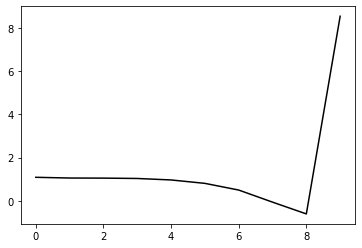

176000 0.20368350252433817
0.29695910113697893 -0.2771765027683403 -0.175636218031249 -0.11067704226417792
[ 1.09266787  1.17059907  1.12349316  1.07902669  0.99471198  0.8224804
  0.49841376 -0.07637628 -0.63684091  8.5253908 ]


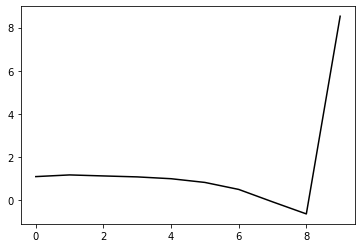

177100 0.26687576037787103
0.29035192296204027 -0.27679558625532474 -0.17437059461081406 -0.1121263657958493
[ 1.18588485  0.94587442  0.96136538  0.92793151  0.85235086  0.69064216
  0.37600377 -0.18994076 -0.74057824  8.54400461]


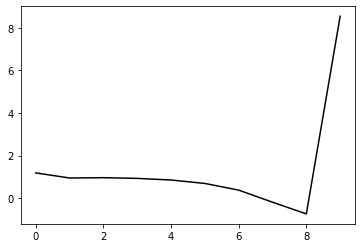

178200 0.18407471679307533
0.29870558454969 -0.2716430513157701 -0.17207093778409896 -0.11467177727968532
[ 1.13352940e+00  1.21435494e+00  1.20331566e+00  1.16175753e+00
  1.07580640e+00  9.04197426e-01  5.78942328e-01  1.55913043e-03
 -5.60950159e-01  8.52025509e+00]


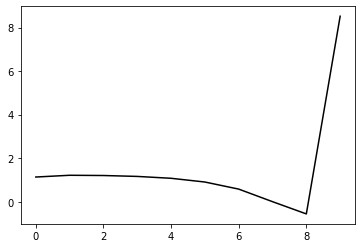

179300 0.17331941726724598
0.3013256376012111 -0.27019368084405293 -0.17207984541494345 -0.11254561408091078
[ 1.09690654  1.14672887  1.14977213  1.11238233  1.02442177  0.85084207
  0.52289608 -0.05815    -0.62434322  8.55678199]


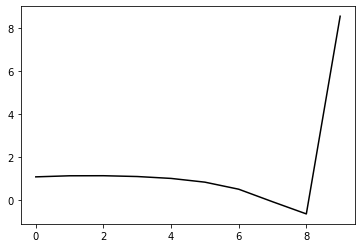

180400 0.19212237552222589
0.2922346034457918 -0.27839648254959865 -0.17707896770909407 -0.11107244553908265
[ 1.10601481  1.06330756  1.04436661  1.01788245  0.94135908  0.77933588
  0.46340837 -0.10511357 -0.65647371  8.5130691 ]


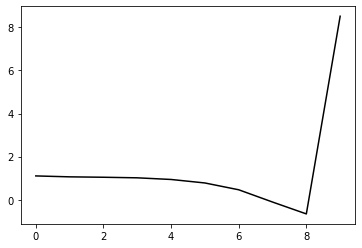

181500 0.21017266843879562
0.2960371815198967 -0.27459646246738806 -0.17470513104625654 -0.11404952935870541
[ 1.14578474  1.10493556  1.10634602  1.08023115  1.00850503  0.85085777
  0.53840467 -0.02743106 -0.57547714  8.54774603]


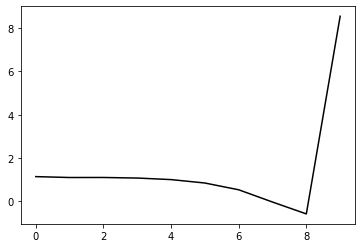

182600 0.1786675495663956
0.30120836705753345 -0.27463541222033505 -0.17633926196760685 -0.10978041275198325
[ 1.10298728  1.04600496  1.06444315  1.03135361  0.95044326  0.78615267
  0.46818197 -0.10292007 -0.65526058  8.49699486]


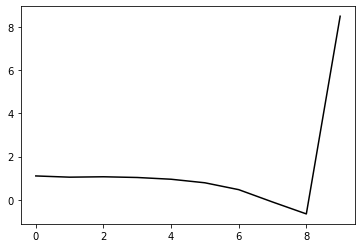

183700 0.14838708168841486
0.29572031757787604 -0.27121569989510846 -0.17272544177688928 -0.11495146514363215
[ 1.13185993e+00  1.10464786e+00  1.12672825e+00  1.11140690e+00
  1.04143665e+00  8.83777835e-01  5.69284546e-01 -1.42409711e-03
 -5.55088168e-01  8.55904738e+00]


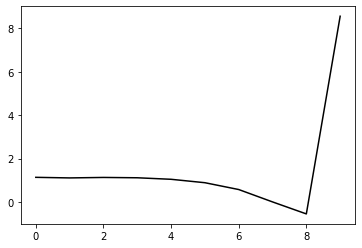

184800 0.14907949761352932
0.2943083239712248 -0.2677081106071271 -0.17006028741545415 -0.11547171832382376
[ 1.11630907  1.04686177  1.04458243  1.018001    0.94033356  0.77533098
  0.45427336 -0.12254689 -0.68097278  8.50928004]


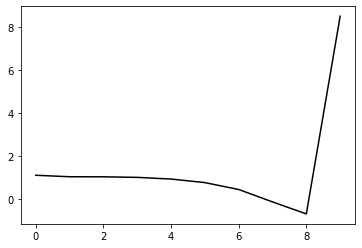

185900 0.17852342849200806
0.29293888317816735 -0.2705943246686878 -0.17283361511203563 -0.11229740866500884
[ 1.0955037   1.07033378  1.01738103  0.9789342   0.8983382   0.73085278
  0.40716078 -0.17260889 -0.73369708  8.52561311]


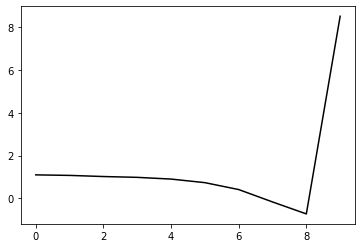

187000 0.20136708054678262
0.2968746747284564 -0.2740389936782805 -0.17645596258314522 -0.11160519358163888
[ 1.0782869   1.04245831  1.04196855  1.00731856  0.93334352  0.77380879
  0.45752011 -0.11524063 -0.66837826  8.51675663]


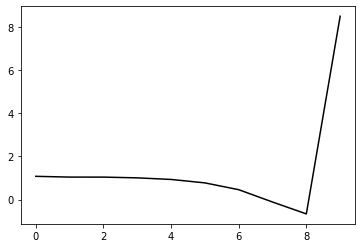

188100 0.19210063300277827
0.2944624076198717 -0.27112607186923265 -0.17395928285447954 -0.11293450734818294
[ 1.11176789  1.08635828  1.06389345  1.02699615  0.94855272  0.78607183
  0.46663797 -0.1099951  -0.66679542  8.5639481 ]


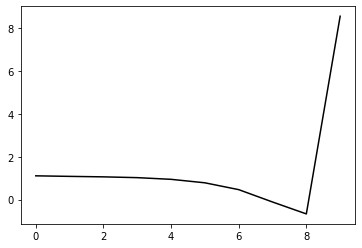

189200 0.17809801150976148
0.29672436421984766 -0.2687166594895252 -0.17252703894882712 -0.11525654106643698
[ 1.11786051  1.18598184  1.18423456  1.15318779  1.07782515  0.91817632
  0.60067654  0.02465341 -0.53158599  8.53492959]


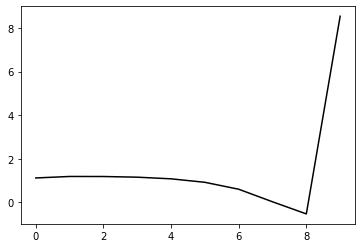

190300 0.17814597113647482
0.29336746462701846 -0.27751162892440945 -0.1790718779492496 -0.11248672780135999
[ 1.07238721e+00  1.10316321e+00  1.09043173e+00  1.06979780e+00
  1.00579018e+00  8.59015853e-01  5.55306663e-01 -6.74341660e-03
 -5.47244851e-01  8.55145136e+00]


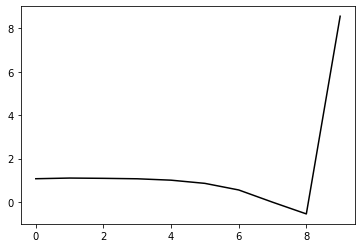

191400 0.2301129339307309
0.3039429962749546 -0.2659683346551596 -0.1730632021453698 -0.1117262786711501
[ 1.03995932  1.21395637  1.22096958  1.18550937  1.10594431  0.94211673
  0.61922429  0.03458744 -0.53237276  8.53106791]


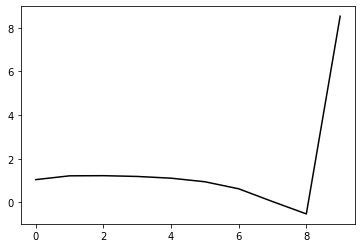

192500 0.2010851156252109
0.29540300405251063 -0.27069809389226407 -0.17508028058606168 -0.11234339600964209
[ 1.11657195  1.09960389  1.09860532  1.07330649  1.00168722  0.8470323
  0.53483837 -0.03803772 -0.59050313  8.54632707]


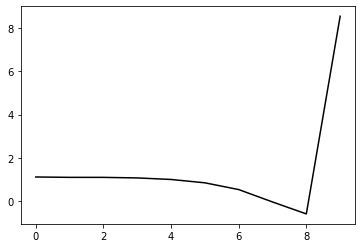

193600 0.16991469493842065
0.2992482013951788 -0.2694461999660373 -0.1750297681209102 -0.11298341509887591
[ 1.07324895  1.21029725  1.22026344  1.19548308  1.12418367  0.96864053
  0.65484991  0.0790401  -0.47697313  8.53858357]


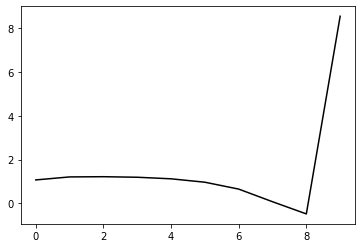

194700 0.12150583937721142
0.2965506005358182 -0.2688259127637598 -0.17422687714233134 -0.11215463471768101
[ 1.08365637  1.12148586  1.10552531  1.07296615  0.99543397  0.83485977
  0.51743261 -0.0613133  -0.61893385  8.52926724]


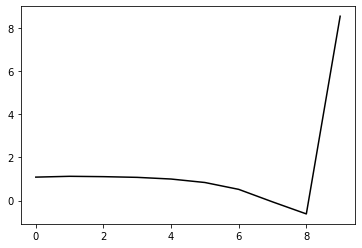

195800 0.1656438159449651
0.2959602945700656 -0.2724711570421909 -0.17691233817162447 -0.11172240522694539
[ 1.07262416  1.08420598  1.08671178  1.05976639  0.98796096  0.83376906
  0.52330414 -0.04826989 -0.59734198  8.53592123]


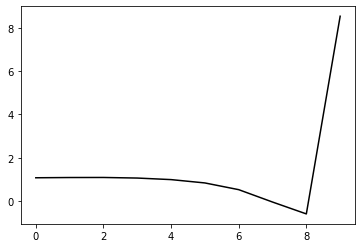

196900 0.17884667248020628
0.2910487679125992 -0.2707952756395207 -0.1751810036649085 -0.11247880022843573
[ 1.08521567  1.056885    1.01081553  0.97011012  0.89155521  0.73050461
  0.41327211 -0.16488741 -0.7190589   8.54717474]


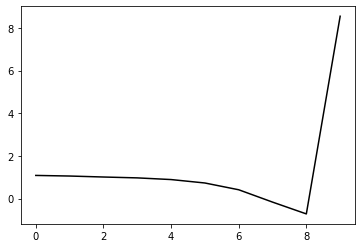

198000 0.21962062408168842
0.28984692889109087 -0.27665978790263285 -0.17984016356720103 -0.11154925459509106
[ 1.08338014  1.07370703  1.05654206  1.02773952  0.96607626  0.82396529
  0.52408503 -0.03930041 -0.58018679  8.53602766]


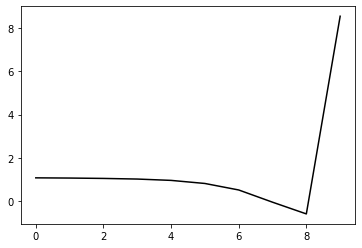

199100 0.2406130194607101
0.28789860001096146 -0.27361615425776775 -0.17708725780371562 -0.11470347209438729
[ 1.15793474  1.05306874  1.03804451  1.00850906  0.94857157  0.81110856
  0.5159176  -0.04425423 -0.58293217  8.55398525]


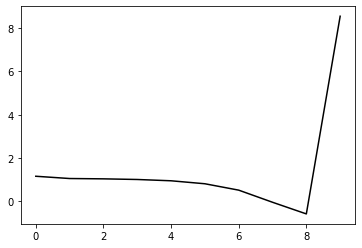

200200 0.1545775805242582
0.2984423998114882 -0.2657208290820862 -0.17372438653499506 -0.11276226129830441
[ 1.08183181  1.23927161  1.24058225  1.19526037  1.11359342  0.95530108
  0.63935125  0.05688115 -0.50620155  8.53059869]


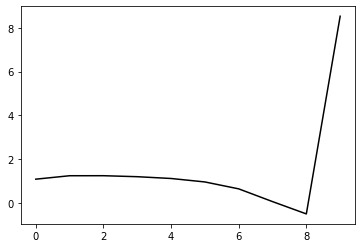

201300 0.22112939713470015
0.27830974632687255 -0.26985876387525637 -0.17314464924102055 -0.11366045616001845
[ 1.13161197  0.89190372  0.85815207  0.81132144  0.72156267  0.5588079
  0.24278956 -0.3366822  -0.89283858  8.51226618]


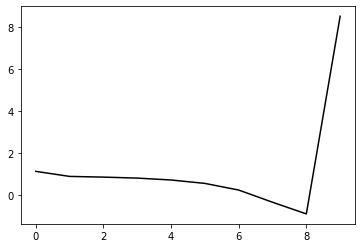

202400 0.1604010790685606
0.2974636090185415 -0.26390093063190406 -0.17269479991181136 -0.11388953544260372
[ 1.10348843  1.20269014  1.17334702  1.12001189  1.02661855  0.85799816
  0.53571188 -0.05130808 -0.61664597  8.49448376]


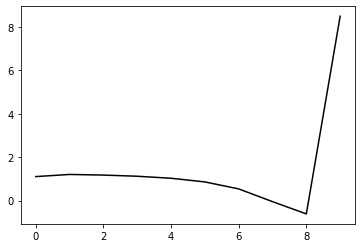

203500 0.19290094986891
0.2971967968245595 -0.2648161533223339 -0.17335954454124297 -0.11518428571448389
[ 1.09092192  1.17007132  1.17563878  1.13574601  1.04932652  0.88659182
  0.57063373 -0.00998302 -0.56826146  8.55838742]


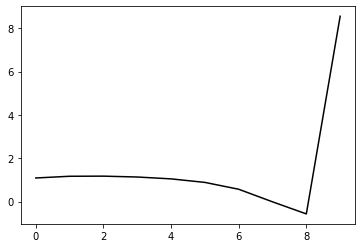

204600 0.16495662845084727
0.29077100125835864 -0.2684544728096996 -0.17539665212613378 -0.11458211795921447
[ 1.12286348  1.09625297  1.07471428  1.03959175  0.95672405  0.79617401
  0.48303967 -0.09439765 -0.64875272  8.52623205]


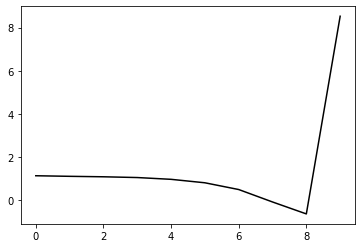

205700 0.22842702427755418
0.2965686462227125 -0.2707332733090009 -0.17845071315806627 -0.11286372626301364
[ 1.03023303  1.08842411  1.08349346  1.04077929  0.95300911  0.78818987
  0.47257598 -0.10594246 -0.66008083  8.56139572]


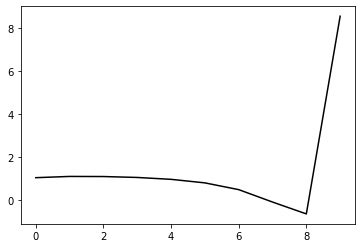

206800 0.12684491253213115
0.29197551751362993 -0.2695496414811921 -0.1766145826797923 -0.11604219761927807
[ 1.11160318  1.12500633  1.10421226  1.0670298   0.98579136  0.82580837
  0.51439272 -0.06045895 -0.6111616   8.53901336]


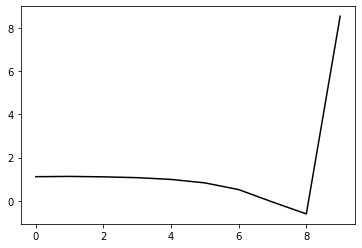

207900 0.19982046341725482
0.2949997677655942 -0.26792253314844794 -0.1761792360668826 -0.11569622487284788
[ 1.06350783  1.12605686  1.12281202  1.08289385  0.99693834  0.83200734
  0.51580548 -0.06384576 -0.61973285  8.5384843 ]


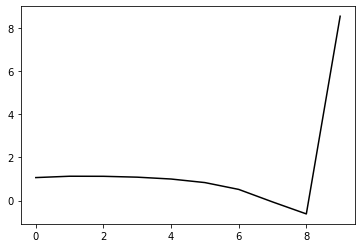

209000 0.23151434259278383
0.2850867690820926 -0.2720592075150458 -0.17783762331598033 -0.11574140813296513
[ 1.11854203  0.95338005  0.95026378  0.92448958  0.85112566  0.69841413
  0.3946595  -0.17240054 -0.71524523  8.49304022]


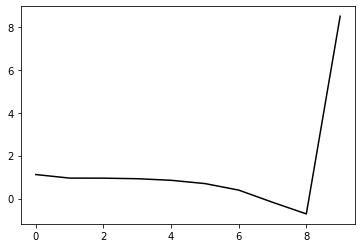

210100 0.2638824232766633
0.28966334264960114 -0.26858419545465534 -0.17634659175939643 -0.1177012680030413
[ 1.15261978  1.0390346   1.02858532  1.00575607  0.93978196  0.79330864
  0.495033   -0.06721864 -0.60610646  8.55655164]


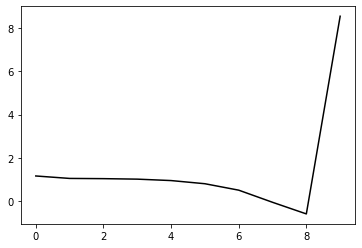

211200 0.17585801028780898
0.2947615905399903 -0.26385713720102383 -0.17401542687213944 -0.1174271041466094
[ 1.09702853e+00  1.18671268e+00  1.17447977e+00  1.13320225e+00
  1.05243699e+00  8.91460471e-01  5.78590632e-01  1.97652980e-03
 -5.51415387e-01  8.53326642e+00]


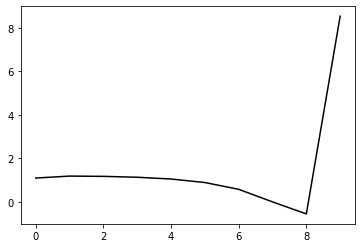

212300 0.17684012202968777
0.29468137450308857 -0.26346205533568895 -0.17398946385894637 -0.11735011926949138
[ 1.07564997  1.11447777  1.11138421  1.07556014  0.99639894  0.83799924
  0.52766886 -0.04668357 -0.59829212  8.558857  ]


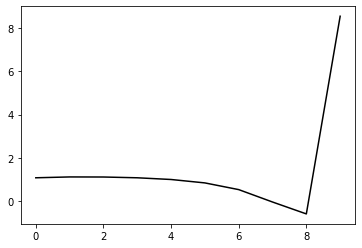

213400 0.21843688004337358
0.29602507929595184 -0.2614450181476783 -0.172929321685568 -0.11820804251823724
[ 1.12128957  1.15503107  1.17395869  1.14855626  1.07492786  0.9204759
  0.61328046  0.04131176 -0.5086727   8.5269595 ]


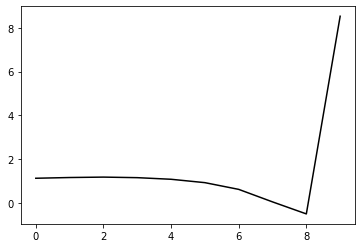

214500 0.18537981951532467
0.2955206052894948 -0.2642370954066553 -0.17524978201012054 -0.11809287191309523
[ 1.07725037  1.176173    1.19016658  1.17092057  1.10296828  0.95295341
  0.65002359  0.08243411 -0.46284454  8.5823867 ]


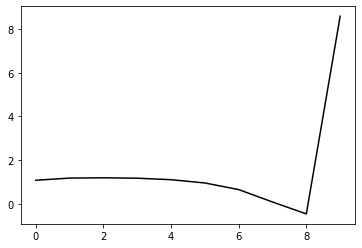

215600 0.16322798174913167
0.2814485767643297 -0.2673596922677839 -0.17548649034239452 -0.11596981288145478
[ 1.09826828  1.02621842  0.97881746  0.93834952  0.85399369  0.68930435
  0.37357327 -0.20517056 -0.7604204   8.50342307]


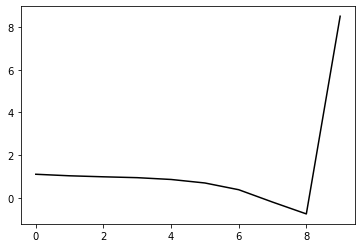

216700 0.11759349989421441
0.2966350002696789 -0.2624607882993667 -0.1750241432921529 -0.11606058977474727
[ 1.06373877  1.1577482   1.14984961  1.10045706  1.01057185  0.84057515
  0.51928047 -0.06510442 -0.62630513  8.54575713]


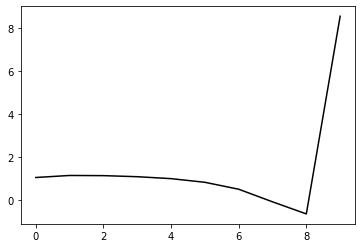

217800 0.1282092098175959
0.2890932405090838 -0.2647478205574708 -0.17508032700873233 -0.11768996411566554
[ 1.09207902  1.04908691  1.0563608   1.022352    0.94002624  0.77807817
  0.46546192 -0.10924264 -0.65915339  8.51634282]


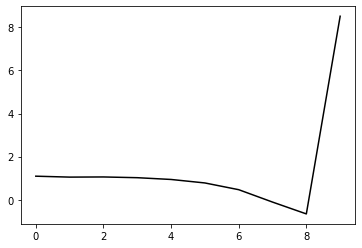

218900 0.2163665522674276
0.29251311497959526 -0.26413712567539943 -0.17569810900787128 -0.11565326240039131
[ 1.02639604  1.07379315  1.06960476  1.03209717  0.9430637   0.77285768
  0.45199757 -0.13086006 -0.68929088  8.53748814]


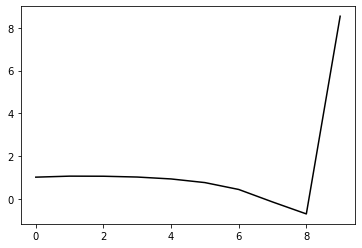

220000 0.1914831757895894
0.29379302856193806 -0.26035740998178275 -0.17331892651343953 -0.11735154838524235
[ 1.05649429  1.13419722  1.129779    1.09630343  1.01334872  0.84632626
  0.52659511 -0.05665329 -0.61688265  8.50952911]


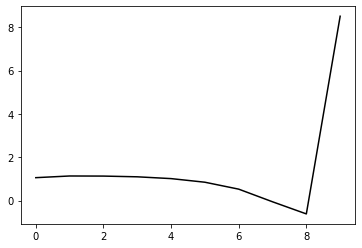

221100 0.1925292929836394
0.28749375706451863 -0.26506745286338296 -0.17610974302376967 -0.11512359194214254
[ 1.08174409  1.04130169  1.02062367  0.98779957  0.90738993  0.74295516
  0.42610084 -0.15321907 -0.70780749  8.52723198]


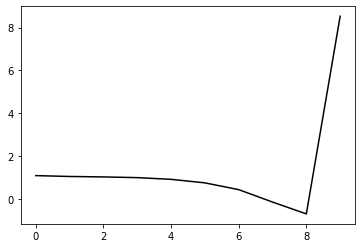

222200 0.1727016114116427
0.2921897671392907 -0.2603392750641252 -0.1736673102422846 -0.117364218261787
[ 1.07100852  1.16618296  1.16442444  1.13093616  1.05058018  0.8848676
  0.56492459 -0.01860991 -0.57851752  8.50685884]


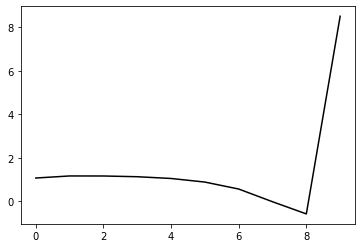

223300 0.16944318745180745
0.2911817356632685 -0.2615815286078197 -0.17463003267749186 -0.11754703953503685
[ 1.05539438e+00  1.15222557e+00  1.15421497e+00  1.12850155e+00
  1.05363094e+00  8.92719268e-01  5.76373852e-01 -4.22190294e-03
 -5.61522271e-01  8.58324432e+00]


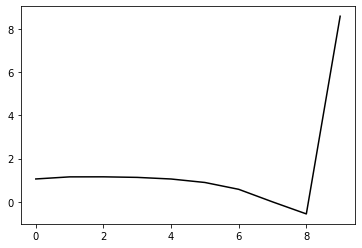

224400 0.194310947328981
0.2822534951279855 -0.26849281408959436 -0.17841585808916444 -0.11701818974477718
[ 1.0942718   0.99773216  0.98227031  0.9677612   0.90792922  0.76284036
  0.46246514 -0.10139423 -0.63999009  8.50818227]


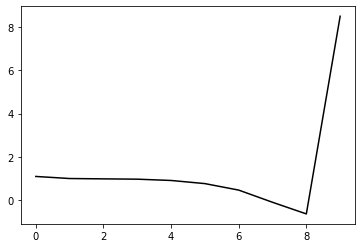

225500 0.20309174170427016
0.279073557883449 -0.27154803210210454 -0.18077682688321814 -0.11682608416879726
[ 1.0913388   1.05201526  0.99854478  0.96991216  0.907479    0.76154146
  0.46025408 -0.10445904 -0.64370443  8.5404469 ]


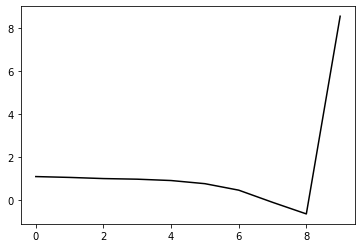

226600 0.16002927880280948
0.28430359750316797 -0.26715552473588516 -0.17837548728150993 -0.11972118733157733
[ 1.079941    1.10417082  1.0780191   1.03559751  0.96595596  0.81680257
  0.51252866 -0.05532367 -0.59788666  8.52421411]


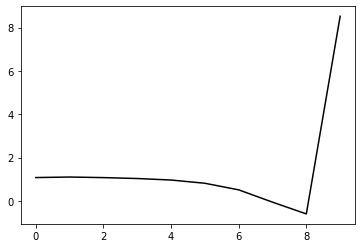

227700 0.13079522517715406
0.28821037462429505 -0.2653741239142257 -0.17860948572164984 -0.11593954041774643
[ 1.06999717  1.04038977  1.04634234  1.00980628  0.93577774  0.78456915
  0.47786189 -0.09364771 -0.64088099  8.52789617]


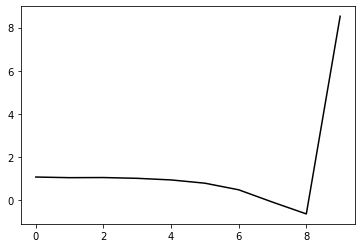

228800 0.12708574455137675
0.2894720203740036 -0.25999548366230907 -0.17515241940248677 -0.11866444756335388
[ 1.09266169  1.14830428  1.16745833  1.13841232  1.06304999  0.90825371
  0.59720186  0.01993809 -0.53429528  8.52759806]


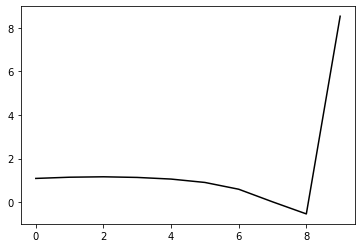

229900 0.201477152452231
0.2846326671278715 -0.26660035664254156 -0.17969436754901305 -0.11679323389103179
[ 1.0422494   1.01182264  1.01691845  1.00196955  0.9396845   0.79701472
  0.4984657  -0.06635517 -0.60757648  8.56727618]


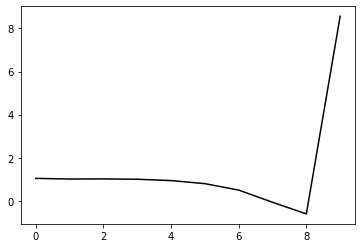

231000 0.20687967692827194
0.2861869811550223 -0.2622427417371779 -0.1772155315797355 -0.11511541446996867
[ 1.06083436  1.10602164  1.07342003  1.03524618  0.95849878  0.80105904
  0.48785505 -0.09202121 -0.64918777  8.53256984]


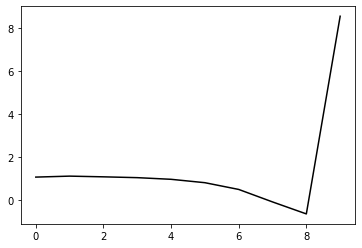

232100 0.1946033559542981
0.2838258457535912 -0.2625254679914307 -0.17712958078678095 -0.11611673490850333
[ 1.10294339  1.05061268  1.04680249  1.01840301  0.95052677  0.80261161
  0.49832931 -0.07371109 -0.62387126  8.52978775]


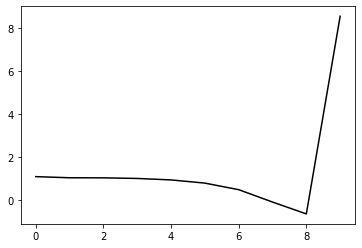

233200 0.288721787203545
0.27463394908445576 -0.25943948556103547 -0.17336407796233702 -0.11906693972819875
[ 1.17111715  0.94433686  0.93062389  0.91552077  0.85950053  0.72250766
  0.42783495 -0.13616096 -0.67934164  8.480979  ]


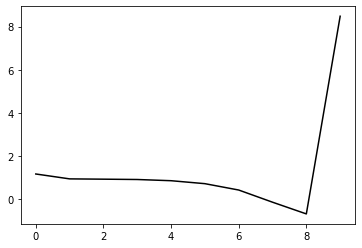

234300 0.1725802504626065
0.2889627836742674 -0.2572463146947355 -0.17513481993286106 -0.11677242127336022
[ 1.07114199  1.12638427  1.10096167  1.06396949  0.9943963   0.84567871
  0.54006194 -0.03477653 -0.5892676   8.55570939]


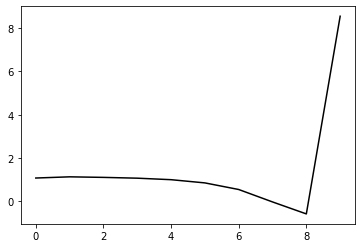

235400 0.2070732404935793
0.2780000370882257 -0.26519764614544544 -0.1787822045882362 -0.11856776683643021
[ 1.14441983  1.00774357  0.98248603  0.95385557  0.89446022  0.75884003
  0.4676599  -0.09173674 -0.62876772  8.52586046]


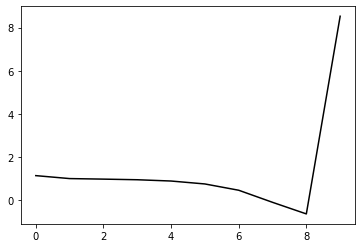

236500 0.2156810145364856
0.2885703573727486 -0.25584552087781237 -0.17456402896778872 -0.11747362990334329
[ 1.09322626  1.18574692  1.17056764  1.12464716  1.04885162  0.89789805
  0.59090021  0.01401784 -0.5430146   8.55278787]


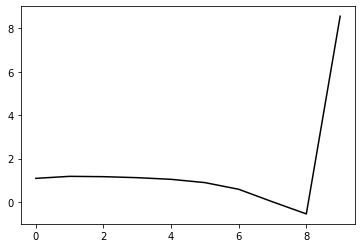

237600 0.1829321278811489
0.28514033730494814 -0.25834060513957646 -0.17621359444569862 -0.11590806585227076
[ 1.12163597  0.9881395   1.00924127  0.98154635  0.91216974  0.76948955
  0.47255942 -0.09372045 -0.63929223  8.50436617]


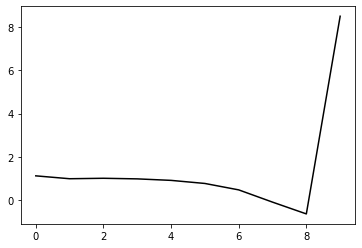

238700 0.1359186556247563
0.28158539674607697 -0.2588413760057476 -0.17567909953520972 -0.11817780569929587
[ 1.10596888  1.05401604  1.05937445  1.03782266  0.97277384  0.83240631
  0.5384522  -0.02513989 -0.56860114  8.5469481 ]


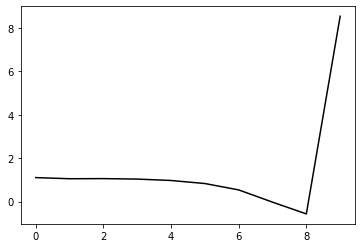

239800 0.1668989470406439
0.28244750903364296 -0.25532901280022346 -0.1737031444475371 -0.11806665929679724
[ 1.1255048   1.03389369  1.03429761  1.01453253  0.95212237  0.81262566
  0.51916246 -0.04495895 -0.59050076  8.51533482]


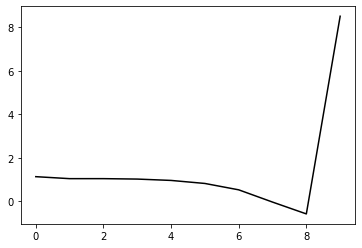

240900 0.17465583175779792
0.27850121980237796 -0.26070550369802514 -0.17756783018884914 -0.11478873978598929
[ 1.09748703  0.96662832  0.92523714  0.8940425   0.83052797  0.69135114
  0.39953873 -0.16186567 -0.70359093  8.51963268]


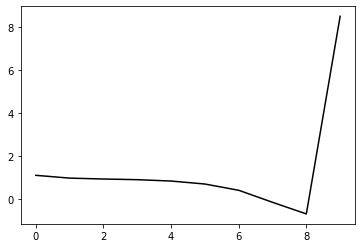

242000 0.22363468744326498
0.28411139237645966 -0.26175515582380376 -0.18022993487959665 -0.11182734371082811
[ 1.04564988  0.97920045  0.97165883  0.93679077  0.87217315  0.73339841
  0.44176327 -0.12004591 -0.6631155   8.478601  ]


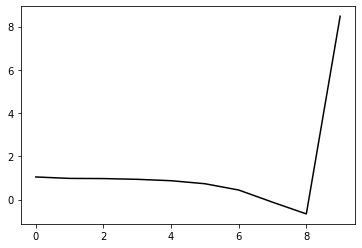

243100 0.2207862951497212
0.2785889148368194 -0.2624731653887133 -0.17973321660390576 -0.11297844042935642
[ 1.10089339  1.00228761  0.93452873  0.88438193  0.81337684  0.671845
  0.37943328 -0.18175028 -0.72280658  8.53013355]


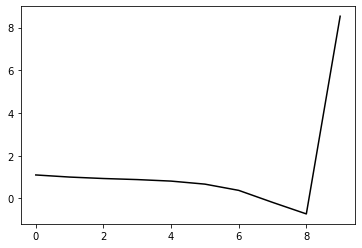

244200 0.17667602460370768
0.28533240987939834 -0.254920099675751 -0.175460740620253 -0.1168977531368267
[ 1.09492958  1.2088713   1.18555465  1.12286466  1.03741127  0.88483812
  0.58221077  0.01038936 -0.54272569  8.51668488]


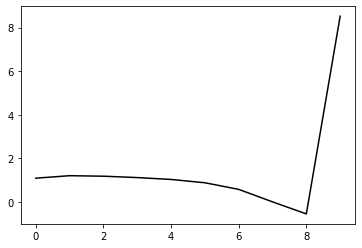

245300 0.16566355338899752
0.28568577978083237 -0.2564736413275462 -0.17711319653567278 -0.11569874003537944
[ 1.03748537  1.11114894  1.10268483  1.05385187  0.96796196  0.81615479
  0.51590864 -0.05362053 -0.60530638  8.55591544]


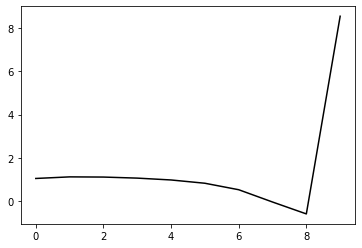

246400 0.2013902607052642
0.28856607464094614 -0.25120422772447415 -0.17401681471973704 -0.11658039581389376
[ 1.11039971  1.14509736  1.16150457  1.12583641  1.04501994  0.89479544
  0.59622716  0.0277226  -0.52409387  8.53040949]


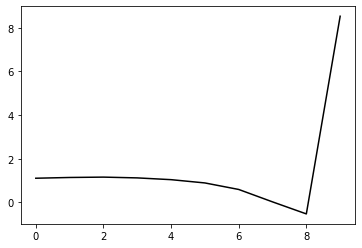

247500 0.19321229441274487
0.2879509171091216 -0.25309526540270305 -0.1753155100227979 -0.11672753729878005
[ 1.06182901  1.16058028  1.16554013  1.13602826  1.0587076   0.90961625
  0.61372478  0.04905815 -0.49843532  8.59114736]


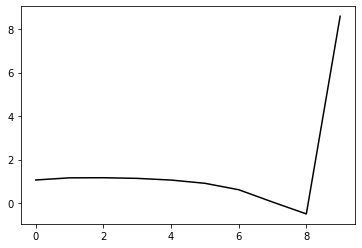

248600 0.1911395594368688
0.283802219970118 -0.25702265582826767 -0.17736417426737344 -0.11554208156279941
[ 1.03382323  1.04798241  1.02495098  0.9926283   0.91425684  0.76333068
  0.46741102 -0.09525922 -0.63908652  8.52850977]


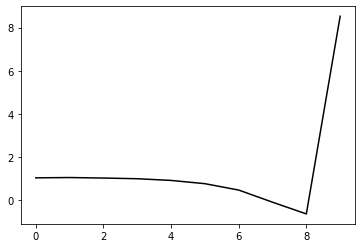

249700 0.12318565747147618
0.27880693536809614 -0.2569905583340728 -0.17652423203812473 -0.11721582313284216
[ 1.08461898  1.00966381  0.98905137  0.96145653  0.89397831  0.75205347
  0.46462725 -0.08920772 -0.62382601  8.5328959 ]


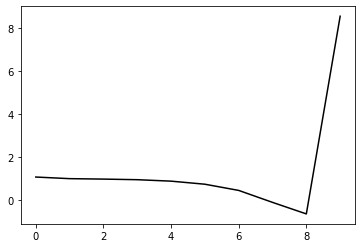

250800 0.13215992704757706
0.2816672265192521 -0.25604144689456676 -0.17685770667499104 -0.11709821878812497
[ 1.10680077e+00  1.04848232e+00  1.05199017e+00  1.03059139e+00
  9.70734304e-01  8.34639812e-01  5.51016745e-01 -1.02370130e-04
 -5.33536704e-01  8.53892319e+00]


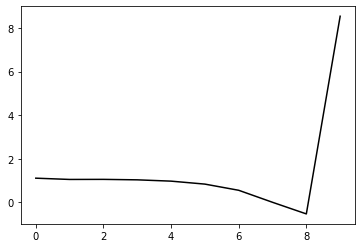

251900 0.19310816821670915
0.2807228101530578 -0.25726325276790296 -0.17826851549599373 -0.11475357990622566
[ 1.04275004  0.95147772  0.9486771   0.92927826  0.87218004  0.73926501
  0.45855555 -0.08920829 -0.61913536  8.54685772]


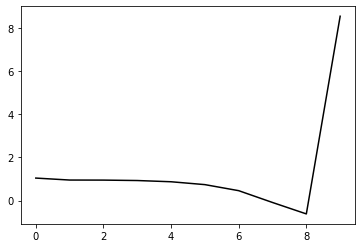

253000 0.20035189339021373
0.2778332744086003 -0.25977746935969476 -0.1802849808954431 -0.11300781014089216
[ 1.06978963  1.05367171  0.96874883  0.92355831  0.85752058  0.71791971
  0.43102615 -0.1222004  -0.65736265  8.52280347]


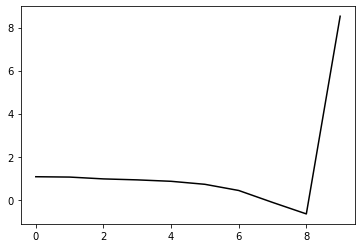

254100 0.3511839843497586
0.273279282346233 -0.2578814604191768 -0.17773508232053184 -0.11976693111619671
[ 1.18373229  0.98965293  0.968569    0.92628925  0.86802672  0.74048112
  0.4650859  -0.07710819 -0.60165646  8.57950045]


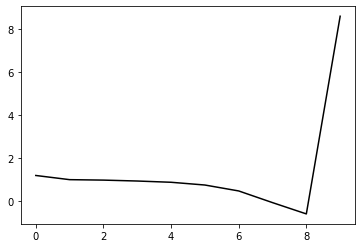

255200 0.17668671843246675
0.27653568452554356 -0.25978868289975837 -0.1806309957211207 -0.11440906418010945
[ 1.08711967  1.12572246  1.05710434  0.98885021  0.90794073  0.7638302
  0.47473486 -0.07933339 -0.61483547  8.51897441]


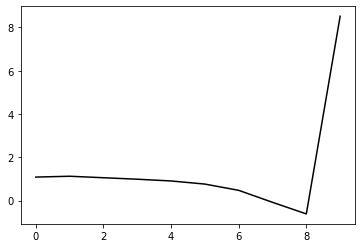

256300 0.16572034376378209
0.28942748528861323 -0.2487238152191556 -0.17543964954584493 -0.11372393367398903
[ 1.05511818e+00  1.24147906e+00  1.23071702e+00  1.15208997e+00
  1.04766534e+00  8.81851173e-01  5.71248188e-01 -5.91635728e-03
 -5.67915644e-01  8.56462845e+00]


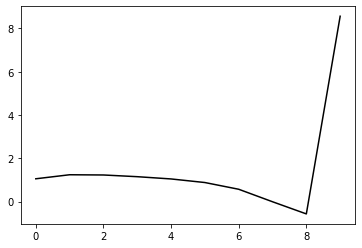

257400 0.2307303850680008
0.2664969109850373 -0.2574880890814909 -0.1775637073407812 -0.1151232461041798
[ 1.09050265  0.93241361  0.88615316  0.818289    0.71419606  0.55184682
  0.24958288 -0.31555409 -0.8616492   8.4719023 ]


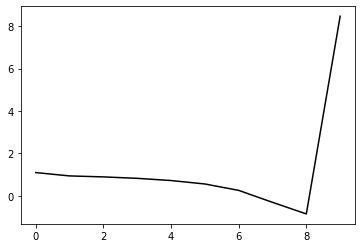

258500 0.20368736101173138
0.27566701608389044 -0.2548196259367781 -0.17748471167591087 -0.11920821590387934
[ 1.09855993  1.13897612  1.10772541  1.04463409  0.94402135  0.78203073
  0.48041756 -0.08418849 -0.63031476  8.54477781]


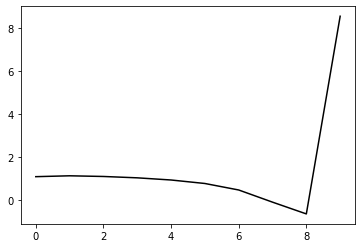

259600 0.15346026086187914
0.28057438812677166 -0.2541314462529883 -0.17844145438175954 -0.11734042671766669
[ 1.06914057  1.1541683   1.14716436  1.09012408  0.98960922  0.82490259
  0.52113883 -0.04547751 -0.59439114  8.54785557]


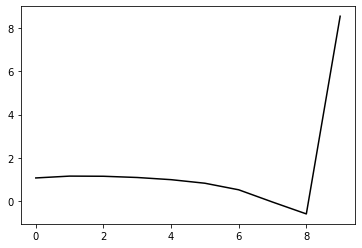

260700 0.1147461192177641
0.2767555574779448 -0.2597828095585089 -0.18193718367821995 -0.1193364162321428
[ 1.08441671  1.1761126   1.17796443  1.14534547  1.06251206  0.91105079
  0.62047385  0.06750403 -0.46749921  8.59059806]


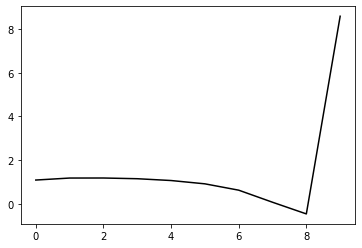

261800 0.12681078516236283
0.2742922778159289 -0.257506546884577 -0.17985320603185467 -0.11944075428222456
[ 1.08549339e+00  1.12373649e+00  1.11398806e+00  1.08025658e+00
  9.97616773e-01  8.43510804e-01  5.50916324e-01 -2.87642262e-03
 -5.38817585e-01  8.53599008e+00]


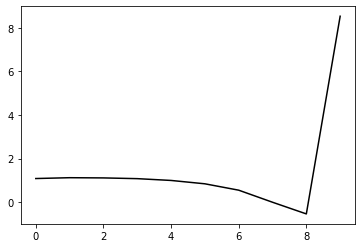

262900 0.19291855099829924
0.2790747147630219 -0.25450479604207515 -0.17898288801157775 -0.11672799313268928
[ 1.05433236  1.10775135  1.07910854  1.02394654  0.92657784  0.75750466
  0.45148739 -0.11321194 -0.65899409  8.53558994]


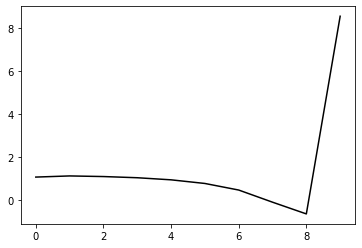

264000 0.20021416437738987
0.28096469000399565 -0.2559206999247943 -0.1807308933934073 -0.11380450664621182
[ 1.05311987  1.03607561  1.01515409  0.95620256  0.85515673  0.68346353
  0.37605348 -0.18788619 -0.73183089  8.50912333]


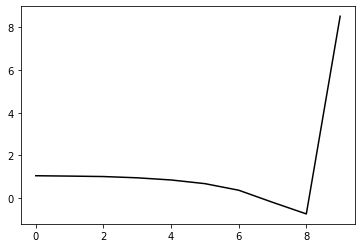

265100 0.20744348312811675
0.27462495615202853 -0.2601965265284216 -0.1828773941243395 -0.11708395766611975
[ 1.09796418  1.07499385  1.05951099  1.02266875  0.94124442  0.78561407
  0.49168957 -0.05975859 -0.59270101  8.55555139]


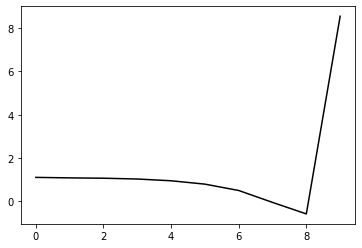

266200 0.18536600513190335
0.2781620400020687 -0.2508617793662677 -0.1767768484548377 -0.11899608769293449
[ 1.11224031  1.22083364  1.20323125  1.15428651  1.05952954  0.88894373
  0.57875712  0.01114972 -0.53936729  8.5057394 ]


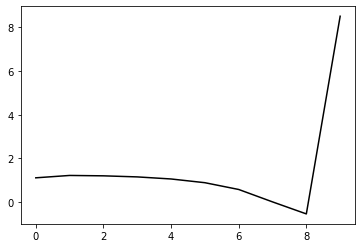

267300 0.2428328921997253
0.2840760662215037 -0.24553066130710208 -0.17467320452505353 -0.11686225647562389
[ 1.12133     1.13799828  1.15422284  1.10699207  1.00716842  0.82974966
  0.51177257 -0.06329715 -0.62163416  8.56836653]


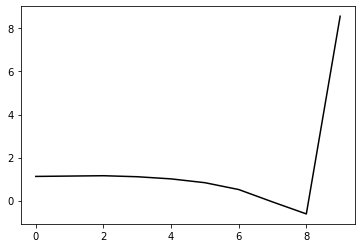

268400 0.16743572712462054
0.28179516584410624 -0.24878328889043394 -0.17666192179316778 -0.11633355674353688
[ 1.09866406  1.15955144  1.17138417  1.13268488  1.03449529  0.85592
  0.53686289 -0.037272   -0.59261284  8.50064043]


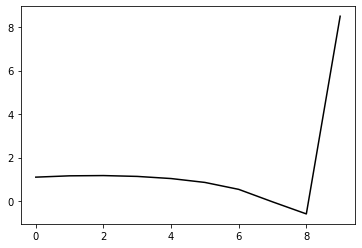

269500 0.19940592899707313
0.27799677729139943 -0.25454029988256555 -0.1803766974575331 -0.11642768490427388
[ 1.10854872  1.10342792  1.08585067  1.05808523  0.9756508   0.81053916
  0.50443144 -0.05532434 -0.59427091  8.55259968]


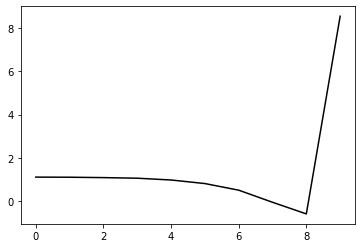

270600 0.19906501010821848
0.28470557916812284 -0.25059803948786025 -0.1791612208230916 -0.11568629102125962
[ 1.03938415  1.15265401  1.15072258  1.1113626   1.02173445  0.84843123
  0.53257401 -0.03680222 -0.58584713  8.55119088]


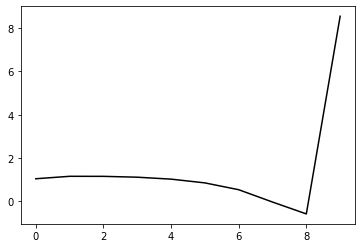

271700 0.11431686639554887
0.2809163401648673 -0.2532041214971015 -0.18026031649673852 -0.11753949299927319
[ 1.08924953  1.15811043  1.15013599  1.12383913  1.04859265  0.88821673
  0.58346172  0.02541986 -0.5111689   8.56138263]


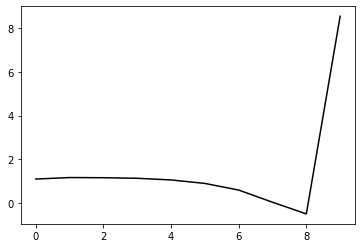

272800 0.15889989952045544
0.2796039159210681 -0.2563257649624023 -0.1828797638131942 -0.11410369866004916
[ 1.08273599  1.08118456  1.05793953  1.02196286  0.9446454   0.78371448
  0.4779493  -0.08008738 -0.61532776  8.53357202]


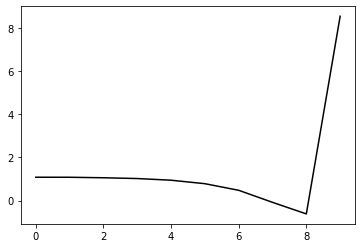

273900 0.1796805293679683
0.2777643344577567 -0.25224975010647427 -0.17974535113347956 -0.11470072842979888
[ 1.0745246   1.07257347  1.02461901  0.96746063  0.87456191  0.70076672
  0.38204367 -0.18747679 -0.73232652  8.5363458 ]


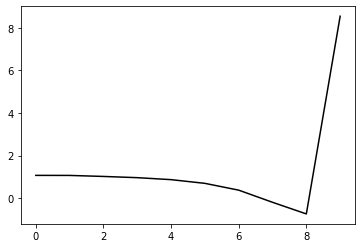

275000 0.20567038485822428
0.275605312698922 -0.25824639713166303 -0.1844497948428045 -0.11431920367195475
[ 1.09093593  1.098016    1.08054094  1.0377856   0.95806487  0.79896534
  0.49290567 -0.06545795 -0.59993954  8.51552829]


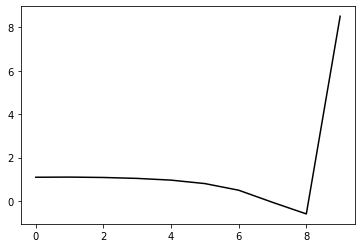

276100 0.1840033922563215
0.28474010195707145 -0.2452043873898459 -0.17681140366567855 -0.11329655402951873
[ 1.07730194  1.19276525  1.18788333  1.12040192  1.00459318  0.80923185
  0.46605276 -0.13003099 -0.70298259  8.54292575]


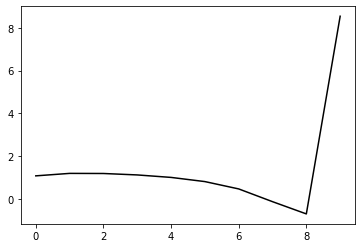

277200 0.2135273271903003
0.27751057024843967 -0.2495621310715341 -0.17863010352899472 -0.11295206772566986
[ 1.1015513   1.03964699  1.0450099   1.00254606  0.89743652  0.71159364
  0.37936302 -0.20393977 -0.76096352  8.49214304]


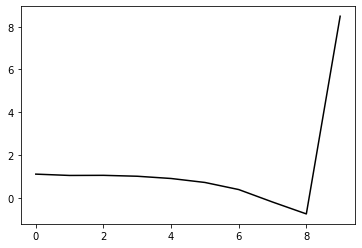

278300 0.2286879984100637
0.2858324727376374 -0.24286879639810707 -0.1755013880420612 -0.11529814221888514
[ 1.12964682  1.11880145  1.14123637  1.10514812  1.00309784  0.81459698
  0.47766401 -0.1116811  -0.67583327  8.58073332]


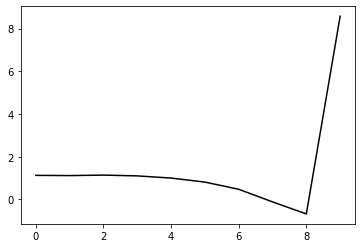

279400 0.22540366804385364
0.2767765160596225 -0.25551250408993925 -0.18382505489521525 -0.11121558534493921
[ 1.07566077  1.0516289   1.05026826  1.02602783  0.93446883  0.75310306
  0.4229417  -0.15845379 -0.71212632  8.49540714]


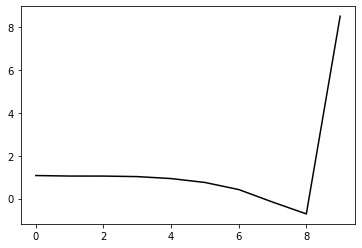

280500 0.22730516147661683
0.273051483319387 -0.25493983678421034 -0.1829909374546644 -0.11192913928245084
[ 1.12241238  1.04295331  0.99855367  0.9579829   0.86035681  0.67127715
  0.33295231 -0.25550174 -0.81434334  8.52732102]


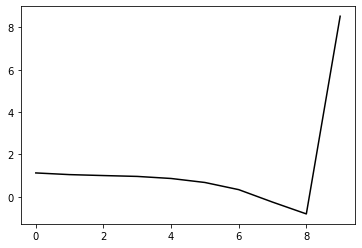

281600 0.16398173531543234
0.28547156534823326 -0.2483751679793732 -0.1804233368373193 -0.11431832233676141
[ 1.06989465  1.19719797  1.20183935  1.15572282  1.05595361  0.86366223
  0.51975485 -0.07509411 -0.64052672  8.50675491]


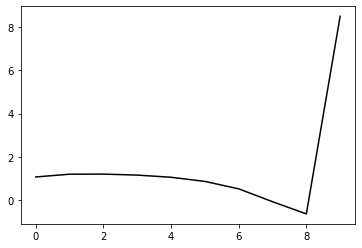

282700 0.12236543741022188
0.27936881435061817 -0.2500366061101355 -0.18078493623178343 -0.11623718218311943
[ 1.11993099  1.1592114   1.14178054  1.10560529  1.01408417  0.82932344
  0.49119839 -0.09821383 -0.65733636  8.53257438]


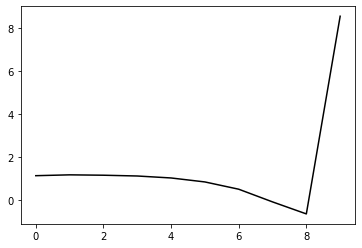

283800 0.1440350322288658
0.28308836380795477 -0.24790987213361895 -0.18016667043862722 -0.11787215970836286
[ 1.13863491  1.16013954  1.19002583  1.16434184  1.07961384  0.89983668
  0.56396163 -0.02461503 -0.58320806  8.52488504]


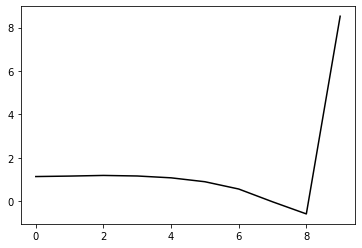

284900 0.15673217060655964
0.27226158207982326 -0.2581467603380204 -0.186652588943738 -0.11396534646549608
[ 1.12634244  0.9860801   0.95967946  0.94132528  0.87051909  0.70447148
  0.38130876 -0.19428487 -0.73776693  8.54787168]


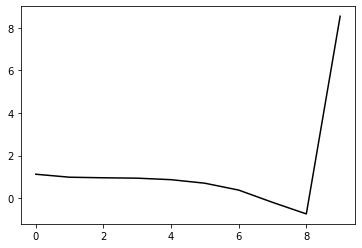

286000 0.207679116244393
0.27753682716307726 -0.2563011977116066 -0.18631472225891293 -0.11308856714486108
[ 1.11202074  1.04372373  1.02658659  0.98588909  0.90770119  0.73748918
  0.40897682 -0.1724627  -0.72114457  8.50902473]


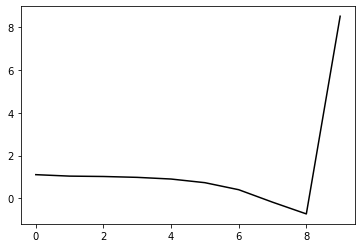

287100 0.2294103155366022
0.27131425728988423 -0.2580262953318489 -0.18675955227775437 -0.11372814449346688
[ 1.14361744  1.07418349  1.03511177  0.99404637  0.91717439  0.75217033
  0.42837659 -0.14883338 -0.69232725  8.53909815]


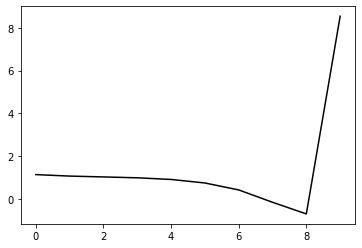

288200 0.1648683153005591
0.2829366345233226 -0.2482598523207257 -0.181758671662385 -0.11347260556485918
[ 1.09784016  1.27706327  1.26513576  1.20089082  1.09637287  0.9067929
  0.55791833 -0.04600491 -0.61755933  8.49428475]


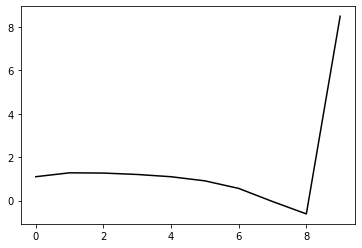

289300 0.16849781587603757
0.2852497176033797 -0.2449006889787963 -0.17983848924134646 -0.11384921802640735
[ 1.08765739  1.17897781  1.20136118  1.15513009  1.04446603  0.84755236
  0.49243014 -0.11790199 -0.69460062  8.54721779]


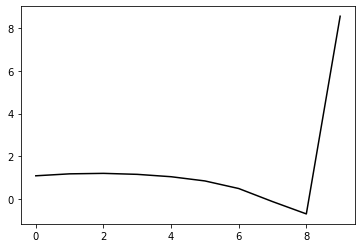

290400 0.15865002668585138
0.2842905814934802 -0.24501904175238576 -0.17984674287508226 -0.11427617668695689
[ 1.11626521  1.16907071  1.19844174  1.17946335  1.08408996  0.89475903
  0.54571766 -0.0597244  -0.63117265  8.51913328]


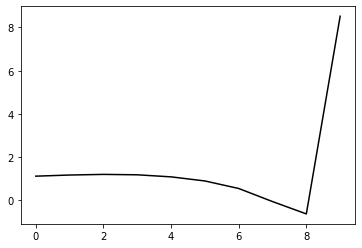

291500 0.22319930248811487
0.2699070535920346 -0.2502621589906922 -0.1818767524020762 -0.11239050102664548
[ 1.12963126  0.99245591  0.96097689  0.93634723  0.8423096   0.65115078
  0.30039596 -0.30600862 -0.87645898  8.50007279]


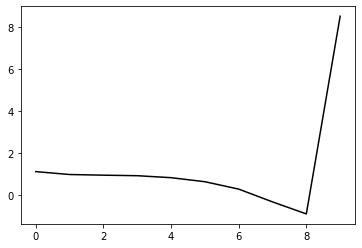

292600 0.14709643767837047
0.28662619315263577 -0.24528381654540668 -0.18133910205816287 -0.11510545049587949
[ 1.10005732  1.24318182  1.24594951  1.21432697  1.12357003  0.93303495
  0.58054712 -0.02907651 -0.60348439  8.49599844]


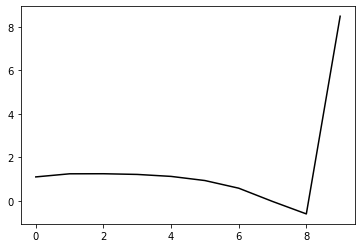

293700 0.11984594031288927
0.2794391823174709 -0.2488978127835529 -0.1827396373001059 -0.1158119000481037
[ 1.10799903  1.16913541  1.15950925  1.13097907  1.04455052  0.85862202
  0.50972315 -0.09615873 -0.66507256  8.53484682]


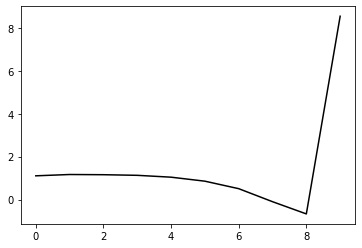

294800 0.12928017374836737
0.27535468361106097 -0.2496315670201787 -0.18303501202404918 -0.11689377880314737
[ 1.1182696   1.17583778  1.12930848  1.08473099  0.99215253  0.80201492
  0.44863463 -0.16167079 -0.73417409  8.51875025]


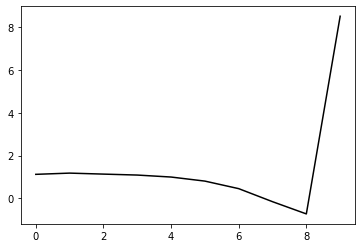

295900 0.17811864909797934
0.27949133145830013 -0.24876010078954813 -0.1837090928616326 -0.11453875599869125
[ 1.1235238   1.0871832   1.08541554  1.041311    0.95072252  0.76469797
  0.41388028 -0.19534909 -0.76715636  8.52125556]


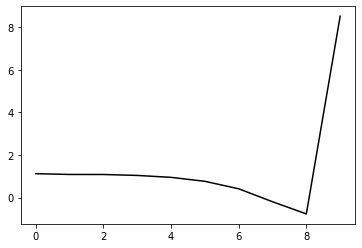

297000 0.24515713063903266
0.2695754646332596 -0.25168738389000406 -0.18445284800933415 -0.11562059761934294
[ 1.15159121  0.96408502  0.97178292  0.94181425  0.85747971  0.67867235
  0.33413235 -0.27008412 -0.83671117  8.49001062]


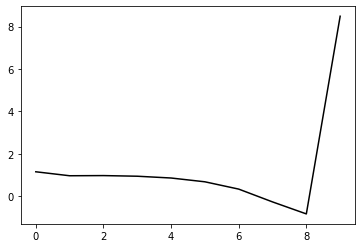

298100 0.2738556026396218
0.2744447714849444 -0.24893932814334363 -0.18336274603067546 -0.1168358950291304
[ 1.18679731  1.03027251  1.0245332   0.9936064   0.91069467  0.73311984
  0.38922004 -0.21533335 -0.78217993  8.55157292]


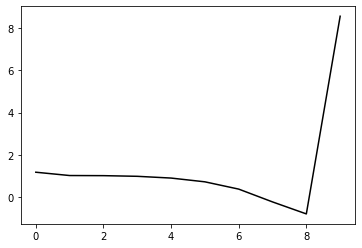

299200 0.19238319195173903
0.2802896345981688 -0.24444589396047642 -0.1813012684275663 -0.11951010790210433
[ 1.14002677  1.21022602  1.21239254  1.1741773   1.08509022  0.90141115
  0.55062376 -0.06202272 -0.63760772  8.5221054 ]


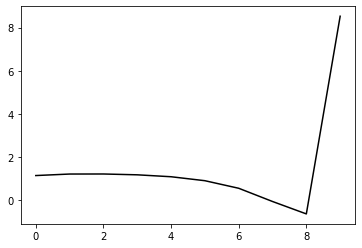

300300 0.2059831722010224
0.27103378345668555 -0.24704956451748478 -0.18182895648994854 -0.11954252656235473
[ 1.13093268  1.02037371  1.01053429  0.97899535  0.89380924  0.71495447
  0.36913456 -0.23887412 -0.80884787  8.55037489]


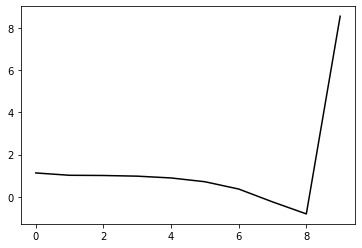

301400 0.1930059798019193
0.28358006417896814 -0.24868651236268577 -0.18602613242052918 -0.11427799851052872
[ 1.09946062  1.12184779  1.1117445   1.06408375  0.96538984  0.77466327
  0.41820303 -0.19996985 -0.77918088  8.48495451]


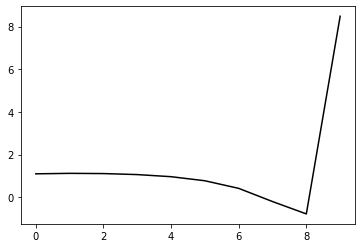

302500 0.2247488622214101
0.2890440346395472 -0.24250641677658485 -0.18251542753407898 -0.11657115016248512
[ 1.05894072  1.22822507  1.25714044  1.21299429  1.10987805  0.91362694
  0.55108604 -0.07426508 -0.66105155  8.56351494]


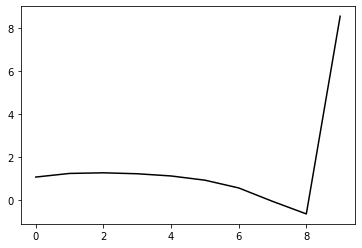

303600 0.35516268559568587
0.29121589547689075 -0.24349378859545195 -0.18412814717467157 -0.11484616070408707
[ 1.01944671  1.25053283  1.29265033  1.26203212  1.15940328  0.95915696
  0.59149329 -0.04037024 -0.63407374  8.51346636]


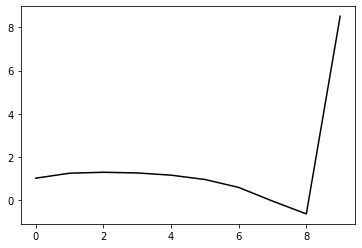

304700 0.11847472289209715
0.2793787993147703 -0.24707900355622037 -0.1841153534698249 -0.11868156478675976
[ 1.11143291  1.19238154  1.20351672  1.17613916  1.07712053  0.87912296
  0.51487729 -0.11194488 -0.69754982  8.54458669]


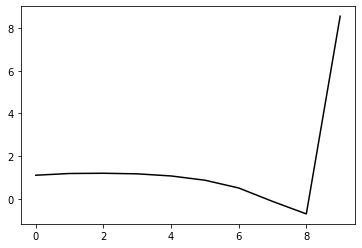

305800 0.14955619533710557
0.28264367531952117 -0.24614649577304248 -0.18458933503834934 -0.11596199328438074
[ 1.09859082  1.1216505   1.15132437  1.1287141   1.03301679  0.83462097
  0.46851172 -0.16108289 -0.74953667  8.51992111]


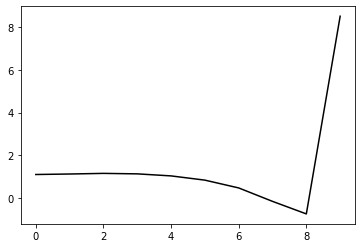

306900 0.19505314032929685
0.2834939264721546 -0.243868441763239 -0.1832749309359748 -0.11667097015576632
[ 1.07985929  1.15435366  1.17754863  1.15577805  1.06034071  0.85844512
  0.48686123 -0.14925266 -0.74446617  8.53358116]


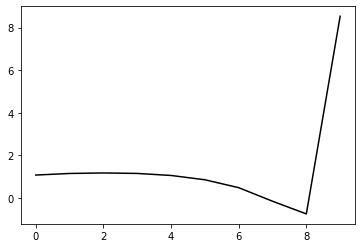

308000 0.20686782607551876
0.28361412526258617 -0.24454376593689456 -0.18412439067509268 -0.11617301965456767
[ 1.08761466  1.10860541  1.14081975  1.13325716  1.05130644  0.85901247
  0.49384537 -0.13771603 -0.72884057  8.5028122 ]


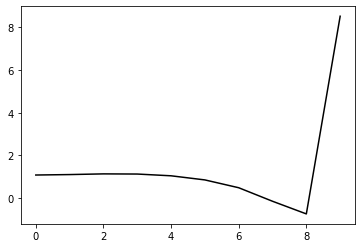

309100 0.19244586106079312
0.2832278801089028 -0.24313766024959457 -0.18322202448634495 -0.11668908743315631
[ 1.11385945  1.13288097  1.15721206  1.15366423  1.07971823  0.89233085
  0.52846314 -0.10403861 -0.69699558  8.53087282]


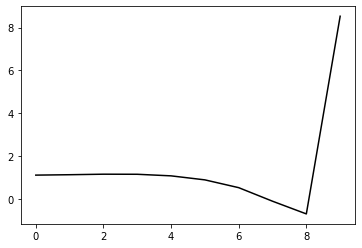

310200 0.17509805454278404
0.2835576615116696 -0.24086194836461122 -0.18167093411963556 -0.11827639580440738
[ 1.10851198  1.1773201   1.20277563  1.20297724  1.13790656  0.95820678
  0.5983926  -0.03242341 -0.62437787  8.51961585]


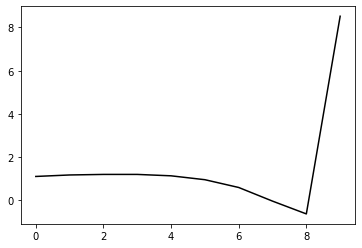

311300 0.17446898508579597
0.27638815296570396 -0.2430418444352561 -0.18226530207646788 -0.11634108491775699
[ 1.10866294  1.0329758   1.02449097  1.01149493  0.93970851  0.75610496
  0.39206693 -0.24295346 -0.83782768  8.51481863]


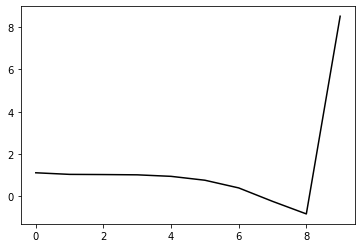

312400 0.19326255371498624
0.2870791873988351 -0.23497320927761245 -0.1787714220628519 -0.11723742044927682
[ 1.11177916  1.18581302  1.19827146  1.17809895  1.10379396  0.91846259
  0.55028166 -0.09124078 -0.69411943  8.47397245]


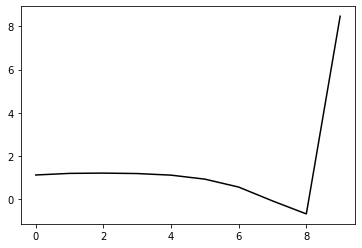

313500 0.26634858404974876
0.2868298002707348 -0.2398592462978398 -0.18260659204564272 -0.11520670319733511
[ 1.02936968  1.11519312  1.14351111  1.12972323  1.05977949  0.88155059
  0.51948087 -0.1169917  -0.71348967  8.5494031 ]


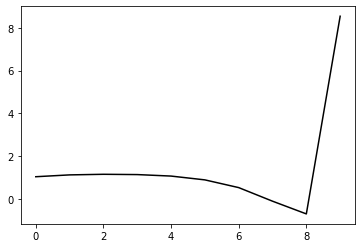

314600 0.20391135900607316
0.28190778008201467 -0.24009291156319126 -0.18144987051671319 -0.1187448956010825
[ 1.13209484  1.07771007  1.11265191  1.11424855  1.06039075  0.89944949
  0.55312483 -0.0698337  -0.65216137  8.5213596 ]


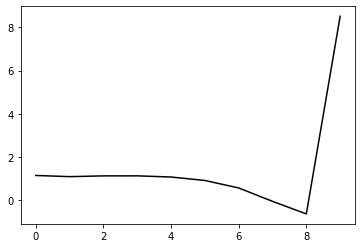

315700 0.13227882541423336
0.281279166578705 -0.24322256974412834 -0.18434587767055646 -0.11522823310482379
[ 1.06918495  1.10017022  1.07526903  1.06035318  1.00017902  0.8358229
  0.48578427 -0.14329441 -0.73362537  8.51766308]


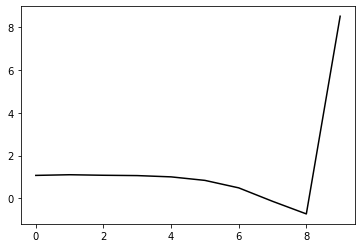

316800 0.20619333599074738
0.2846875577291572 -0.2462339829090827 -0.1877407334698635 -0.11303818435835775
[ 1.05616     1.06817671  1.07760382  1.06412933  1.0111358   0.85804753
  0.51872928 -0.10198642 -0.68448169  8.51786992]


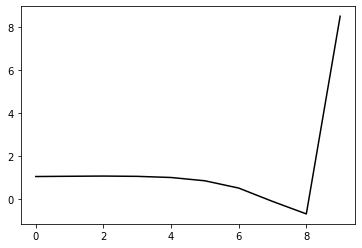

317900 0.19322930798383445
0.2790732556656328 -0.24484662433059368 -0.1854379927297449 -0.11760302599200725
[ 1.06012862  1.03303802  1.02882732  1.02093481  0.97719383  0.83686838
  0.51029518 -0.09984742 -0.67248379  8.53994374]


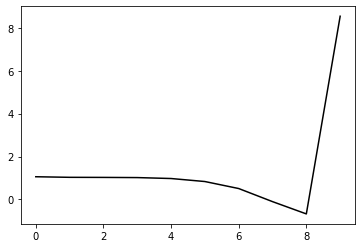

319000 0.21903660543249315
0.27672769346762044 -0.24781949805269063 -0.18780523013625372 -0.11462350516580604
[ 1.07576804  1.04803378  1.01615882  0.99633326  0.95000389  0.81198646
  0.48849744 -0.120719   -0.6936132   8.51634034]


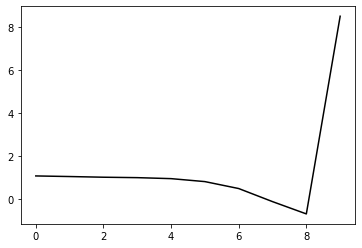

320100 0.269722615835704
0.2779252237903379 -0.2403260350675975 -0.18235213089706076 -0.11876471575547616
[ 1.153515    1.09577156  1.08574126  1.04912461  0.98940947  0.8454596
  0.51818443 -0.09698976 -0.67748158  8.55999772]


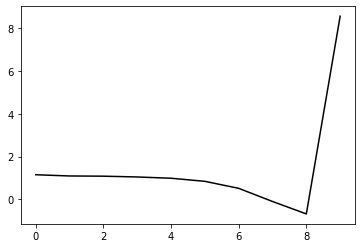

321200 0.17870386258741094
0.2811672650142412 -0.23619302973117878 -0.1802195039360627 -0.11758522535044086
[ 1.10206667  1.21762973  1.2011718   1.14239794  1.05301637  0.88665082
  0.5428924  -0.08769699 -0.68250818  8.51417852]


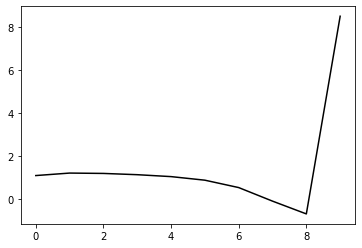

322300 0.18085603472844172
0.2731298731677878 -0.23950424758712682 -0.1812383869173506 -0.11782637380931055
[ 1.09846794  0.94870882  0.95257551  0.91648235  0.83219585  0.67200045
  0.33822823 -0.2825503  -0.86717985  8.53568887]


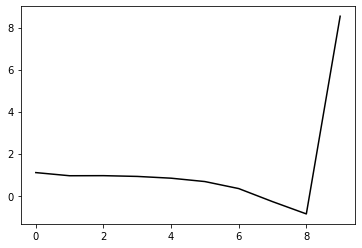

323400 0.20250635581463008
0.2838022847615429 -0.2359354844350977 -0.18105942568603306 -0.11858335315263481
[ 1.12980141  1.12966444  1.14242625  1.11305263  1.03190939  0.87073711
  0.53697424 -0.08503576 -0.67238394  8.50355652]


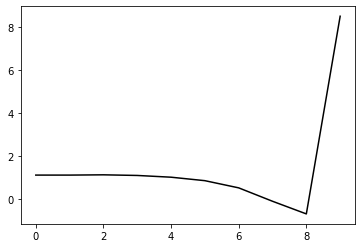

324500 0.21170983042375813
0.2758270768093777 -0.24462978806496496 -0.18615211091250877 -0.11679826137451167
[ 1.10191618  1.05523185  1.02445697  0.99395515  0.91619498  0.75788718
  0.43011746 -0.18464598 -0.76351272  8.52845477]


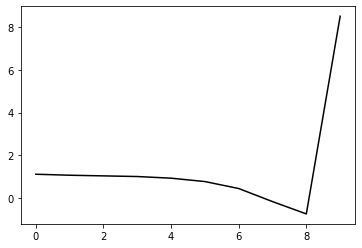

325600 0.16173372596684912
0.2824139667250136 -0.24211356141005935 -0.1858486053003873 -0.1172456525095227
[ 1.10027348  1.06343392  1.06572432  1.03031834  0.95220572  0.79278451
  0.46478508 -0.15067228 -0.73124664  8.48929699]


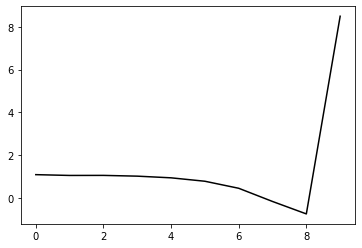

326700 0.11786655188901377
0.2802546528197267 -0.24063467686150936 -0.18436142612673942 -0.11953926282019676
[ 1.10398081  1.08858185  1.10994127  1.08657401  1.01351756  0.85754984
  0.53330392 -0.07925542 -0.65843596  8.54628166]


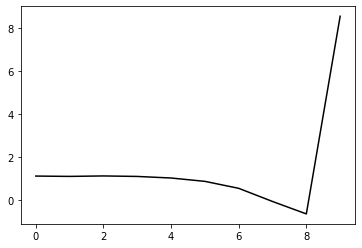

327800 0.14802100799200135
0.2829603168962668 -0.23623781093443666 -0.1816382566864063 -0.12133847780307125
[ 1.12089882  1.11398804  1.14319099  1.1254318   1.0542283   0.89773679
  0.57362289 -0.03892045 -0.61902455  8.52257929]


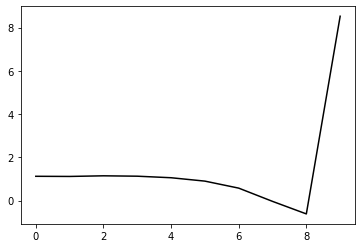

328900 0.17503950680459957
0.2785555210126233 -0.2423295846955114 -0.18585792458968206 -0.11707606834121519
[ 1.0985093   1.00204855  0.9807959   0.95679934  0.88734416  0.73208046
  0.41038533 -0.19891922 -0.77544929  8.51538646]


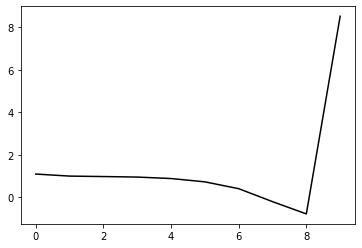

330000 0.20529199956061575
0.2813440294135224 -0.2407537372361975 -0.18543900506225125 -0.11763327935114203
[ 1.07505015  1.05381934  1.04595368  1.01590485  0.94431085  0.78696713
  0.46266852 -0.1501055  -0.732162    8.521326  ]


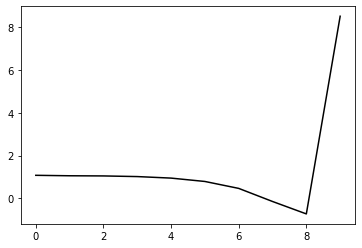

331100 0.20449040980401012
0.271009283275799 -0.24348367436113266 -0.1856731045432609 -0.11937082084362699
[ 1.10916321  1.00906214  0.99108898  0.96862547  0.90471674  0.75581663
  0.4397912  -0.16533764 -0.74110646  8.53411442]


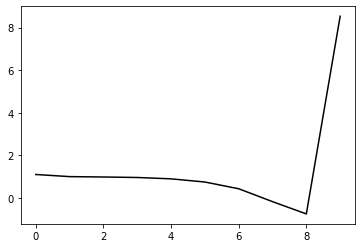

332200 0.17422621280480025
0.2800671838647372 -0.23801814157193477 -0.18374634167332105 -0.12032327009704333
[ 1.09830832  1.14666641  1.14165791  1.11840637  1.05639706  0.90958829
  0.5949952  -0.0097612  -0.58710383  8.49283811]


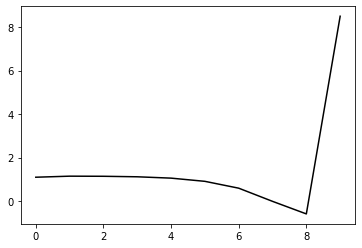

333300 0.15893858925297108
0.2797956594176552 -0.23699318008494263 -0.18339305228801434 -0.11782694982498419
[ 1.04478226  1.03956976  1.02246223  0.98850318  0.91395771  0.75662882
  0.43257685 -0.18147182 -0.76942437  8.52840672]


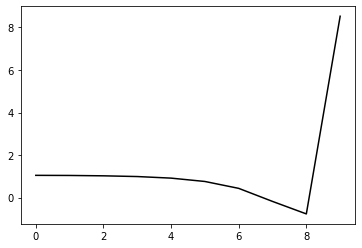

334400 0.15060305944672459
0.2847864429092854 -0.23453251156679938 -0.18255182468917644 -0.11963872453268133
[ 1.09007357  1.14595368  1.14783934  1.119577    1.05103661  0.89940805
  0.58090909 -0.02788579 -0.61116571  8.5183417 ]


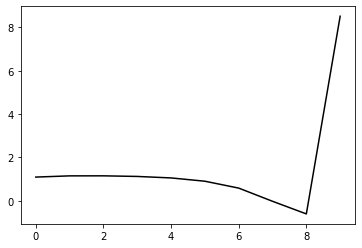

335500 0.19970953363559674
0.2832080862168629 -0.2338805681881547 -0.1815987695618797 -0.12101077044093148
[ 1.08215806  1.10462363  1.10300856  1.07782302  1.00875678  0.8577699
  0.54154093 -0.06373176 -0.64267871  8.55433144]


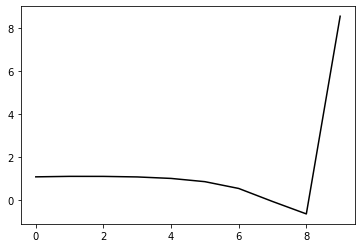

336600 0.20758604129045877
0.2814990013678497 -0.2380106619914022 -0.18472271621261346 -0.11842866667054662
[ 1.03391237  1.05435739  1.01601704  0.97720552  0.90054805  0.74358701
  0.42337286 -0.18444109 -0.76532483  8.52255679]


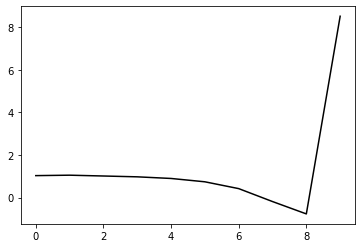

337700 0.11903576297520421
0.279772813246191 -0.23682554646857018 -0.1835602893921783 -0.12020052044107257
[ 1.07104194  1.06956797  1.04653652  1.00983426  0.94038225  0.79138939
  0.47898347 -0.12136121 -0.69548428  8.54781039]


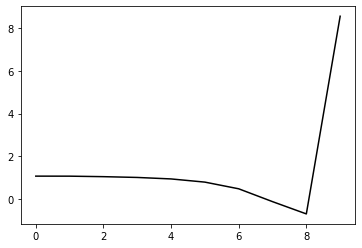

338800 0.12808656118700426
0.277761820358078 -0.23745480120233395 -0.1838208874435431 -0.12138871299621724
[ 1.0796576   1.09777935  1.08530646  1.05456782  0.99012398  0.84753818
  0.54138821 -0.05364453 -0.62435359  8.52161862]


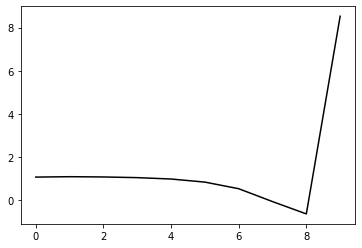

339900 0.19536874694687922
0.27955491117880277 -0.23847617074639882 -0.1851243904958497 -0.1198282840157847
[ 1.0603786   1.07985194  1.06171845  1.02626219  0.95503407  0.80773972
  0.49863482 -0.09872735 -0.67249509  8.53586005]


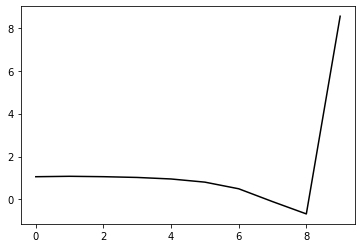

341000 0.20273451288405064
0.27665539967728264 -0.241007834933187 -0.18701957559742075 -0.11829365560923204
[ 1.07693601  1.01536115  1.00404222  0.97816596  0.9161204   0.77844224
  0.47955019 -0.10806674 -0.6736527   8.51102368]


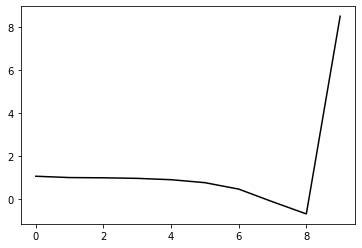

342100 0.18940082946530312
0.2810432204743408 -0.2340442179990442 -0.18318572069292133 -0.11822719634880403
[ 1.09304509  1.08717785  1.07419776  1.04100487  0.97124536  0.82558646
  0.51895041 -0.07738835 -0.65477951  8.55278364]


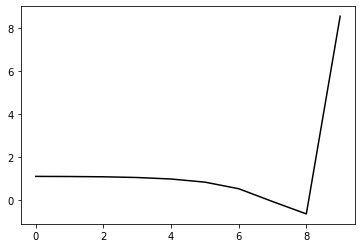

343200 0.17954178765572668
0.2795238473084003 -0.2332867507933185 -0.1824555591109831 -0.11965625258597831
[ 1.10727296e+00  1.10042529e+00  1.09418426e+00  1.07775654e+00
  1.01797950e+00  8.80458082e-01  5.81968009e-01 -6.75085025e-03
 -5.78325749e-01  8.52209973e+00]


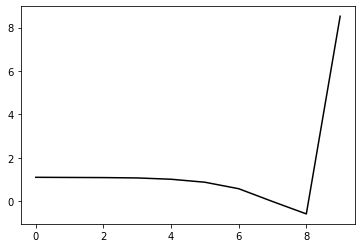

344300 0.16846807456328597
0.28038917892695553 -0.23366527286611363 -0.18310696513639466 -0.11941992961011527
[ 1.05958822e+00  1.13074484e+00  1.10446643e+00  1.07828764e+00
  1.01844560e+00  8.80823193e-01  5.82761427e-01 -5.38462784e-03
 -5.77823285e-01  8.56288684e+00]


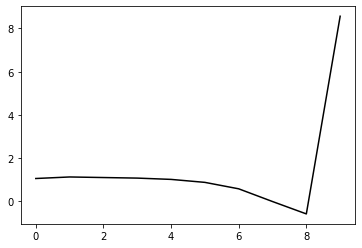

345400 0.1901599337507184
0.2726091235987835 -0.23988028066300116 -0.18647760191196835 -0.11699385531714801
[ 1.08647085  1.04925215  1.00487869  0.96456918  0.89580974  0.75286227
  0.45204083 -0.13656151 -0.70794652  8.50225702]


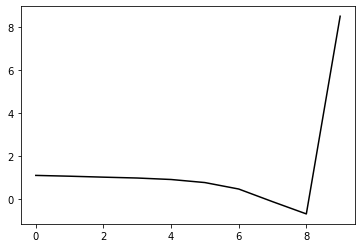

346500 0.18879428268245893
0.27944044252070893 -0.23424299346537672 -0.18348934588237 -0.12043894452557809
[ 1.08384125e+00  1.18386361e+00  1.17120003e+00  1.12295363e+00
  1.04522043e+00  8.95607197e-01  5.89302565e-01 -4.14311042e-03
 -5.80943979e-01  8.55442199e+00]


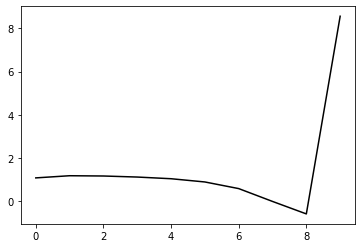

347600 0.15684797624294997
0.2744570974180719 -0.24004349237693295 -0.1869096756939586 -0.12033074947051225
[ 1.08480258  1.09146364  1.07418355  1.04003986  0.97025891  0.82943226
  0.53324052 -0.04901764 -0.61383769  8.53415951]


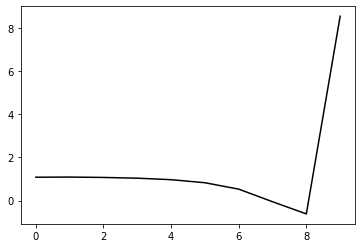

348700 0.11938243501025318
0.2740066264326091 -0.23971612799878145 -0.18686906120126934 -0.12187477421457246
[ 1.09818552  1.1405038   1.10160836  1.06448872  0.99507242  0.85444026
  0.55912227 -0.02203782 -0.5866195   8.54250957]


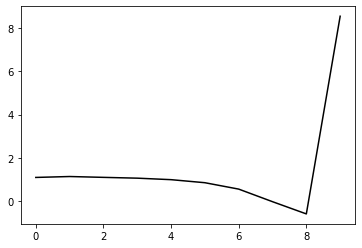

349800 0.13637968382257082
0.2736206354166739 -0.23614483279334003 -0.1841891031216196 -0.1212757067938765
[ 1.10872617  1.11733896  1.0671236   1.01147393  0.92898319  0.77787722
  0.47436069 -0.11339899 -0.68445406  8.51521587]


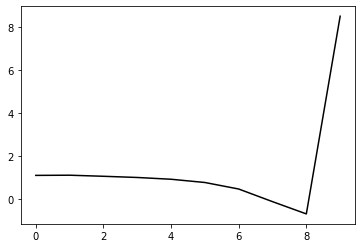

350900 0.1825717083608709
0.2764408975756435 -0.23554053984826862 -0.18467254643278322 -0.12001484647625582
[ 1.07287806  1.05501114  1.0477707   0.99302799  0.90472431  0.74980751
  0.4443185  -0.14441214 -0.7170026   8.53176335]


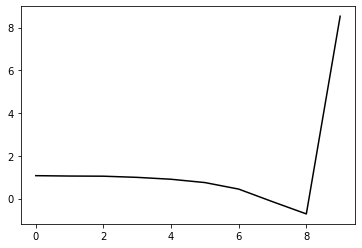

352000 0.2336608525471975
0.2763900322512711 -0.23648487106374289 -0.18560930178635138 -0.11879732947410795
[ 1.11552062  0.94864082  0.96525299  0.92578217  0.83992051  0.68556634
  0.38213401 -0.20333599 -0.7727611   8.51218223]


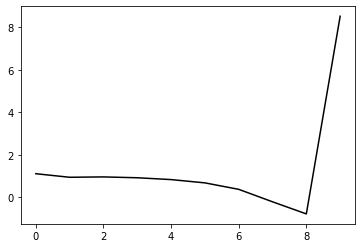

353100 0.19084462701368596
0.2785203665873034 -0.23375776231669537 -0.18399323724032157 -0.11976161943328874
[ 1.09121406  1.08765166  1.08219015  1.04482911  0.95743128  0.79773572
  0.48972839 -0.09925794 -0.67281867  8.52203103]


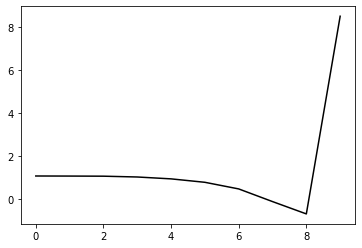

354200 0.1706584150180971
0.27886398220145286 -0.23297270609097298 -0.18328533150727558 -0.12159316191541038
[ 1.07352197  1.14338796  1.1444763   1.1136104   1.0328834   0.87655065
  0.57220322 -0.01180686 -0.58059605  8.52819862]


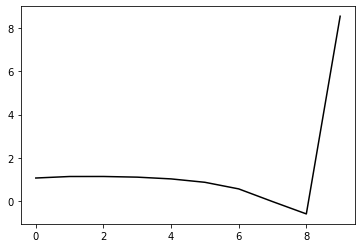

355300 0.17324667465177754
0.2783942722489097 -0.2326897950985322 -0.18303138491493431 -0.12173526177154094
[ 1.0614129   1.08093494  1.06823591  1.03237388  0.94932974  0.78928103
  0.48194576 -0.10304611 -0.67243418  8.54423465]


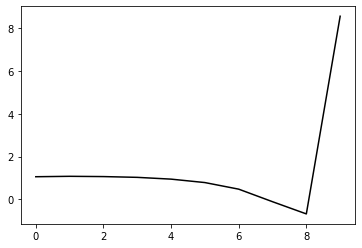

356400 0.18980270992993106
0.2772540634856436 -0.23778779636846178 -0.1868340640079595 -0.1192295532364407
[ 1.06238258  1.02009664  1.00408644  0.97518016  0.89906531  0.74512633
  0.44431539 -0.13207501 -0.69154648  8.5082593 ]


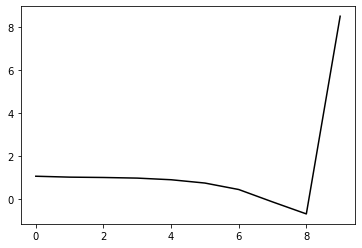

357500 0.2094259586980302
0.2718014691401979 -0.24008853147966785 -0.18778883100501784 -0.12009632207259058
[ 1.08853583  1.02920759  0.97277567  0.93396355  0.85836953  0.7054914
  0.40603521 -0.16737131 -0.72313926  8.5246829 ]


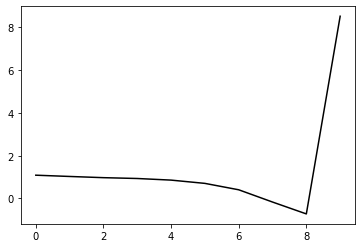

358600 0.16923873835166778
0.277600149768111 -0.23668225143420113 -0.1865784579445177 -0.12125058136321688
[ 1.05166101  1.06460334  1.03452725  0.98468412  0.9039662   0.74784012
  0.44461845 -0.13220256 -0.69216521  8.51601729]


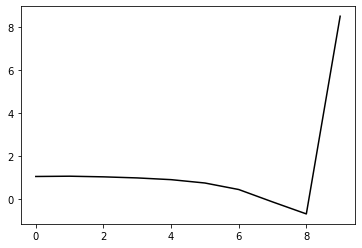

359700 0.12080229421898685
0.27638744370776946 -0.23254495270935363 -0.18339915630593928 -0.12239241600433153
[ 1.08294226  1.05654818  1.04234448  0.99358435  0.90901248  0.75074041
  0.44529628 -0.13311121 -0.69501765  8.53201963]


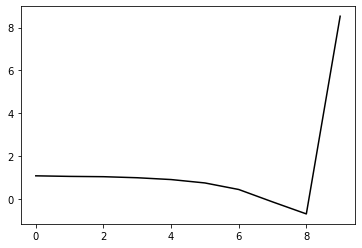

360800 0.12740954695317072
0.2794163131511972 -0.23201511359258495 -0.1838147078147354 -0.1230598137076258
[ 1.08768185  1.10353217  1.12325304  1.0910045   1.01267144  0.85907306
  0.55736089 -0.01741372 -0.57662908  8.52056705]


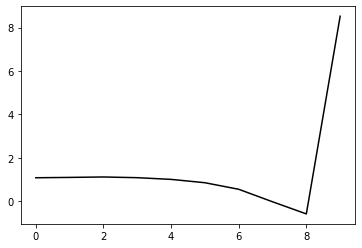

361900 0.18670830302627395
0.2760634784422555 -0.23398612649910136 -0.18476689470294874 -0.12103248226280298
[ 1.09108612  0.99695757  0.96933945  0.93405963  0.85575066  0.70204747
  0.40163077 -0.16971797 -0.72397169  8.54272376]


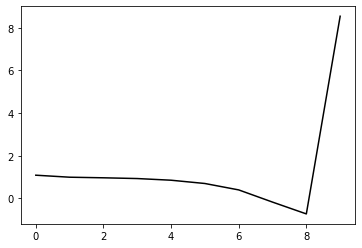

363000 0.21101747852515257
0.27719187000142753 -0.2362271031140762 -0.18692251899799614 -0.11931381284956398
[ 1.03859093  1.01965854  0.98907052  0.94738693  0.867599    0.71235101
  0.41025478 -0.16208575 -0.71761927  8.51817517]


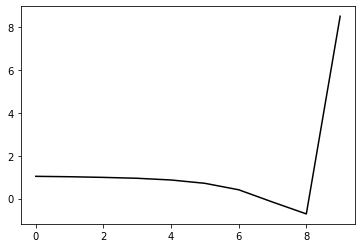

364100 0.3121978066911396
0.2690831637680518 -0.23305377866801386 -0.18303917597794464 -0.12229234903306421
[ 1.16288198  0.87984921  0.85692088  0.82308631  0.75314745  0.60784733
  0.3148137  -0.24857841 -0.79551525  8.54922535]


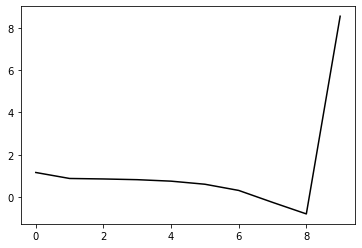

365200 0.18515939181498298
0.277791107932322 -0.22870237320077896 -0.1818152402082936 -0.12302021972865272
[ 1.09009869  1.14527778  1.09154525  1.0335438   0.94768456  0.78819935
  0.48128719 -0.09557283 -0.65676243  8.52006458]


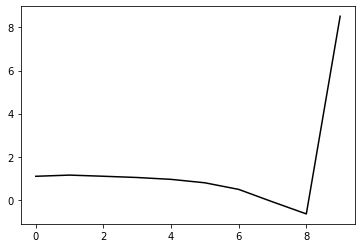

366300 0.19261102061668128
0.27429307299360967 -0.24026006346365544 -0.19049301318285267 -0.11923894101441812
[ 1.04304287  1.03565299  1.00327022  0.95984281  0.88613993  0.74112705
  0.44895663 -0.11244781 -0.6573021   8.54462186]


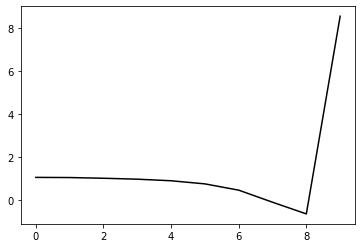

367400 0.22265323233494733
0.2697790567500109 -0.23763185715586324 -0.1877289062446153 -0.12409790245496215
[ 1.15770049  1.04807137  1.02252012  0.98293038  0.91443835  0.77568162
  0.48938433 -0.06667544 -0.60720587  8.50307734]


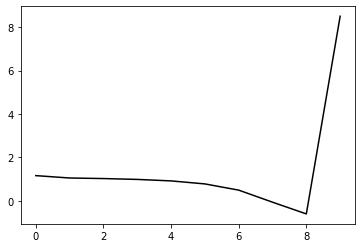

368500 0.23766798721090782
0.2722085242268468 -0.23362587806189875 -0.1854713138174963 -0.12268871416591084
[ 1.12365648  1.10323471  1.06342741  0.99868739  0.90622024  0.74722747
  0.44392825 -0.12606776 -0.6784025   8.53802439]


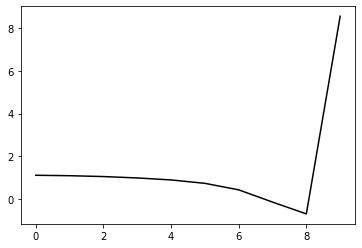

369600 0.1767131075356964
0.26477846272056316 -0.23822232782979086 -0.18828655087535065 -0.1204279882441808
[ 1.10119941  1.0123049   0.93742925  0.86342425  0.76046376  0.5942325
  0.28691806 -0.28459164 -0.83677048  8.50423422]


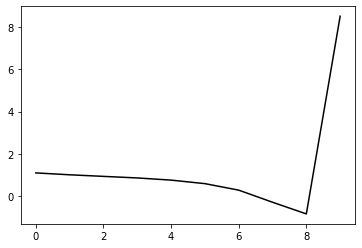

370700 0.1191999144392299
0.2773455228262553 -0.2323326301548492 -0.1865511758424947 -0.12034226942248208
[ 1.07013153  1.18142116  1.14105394  1.05868298  0.94495818  0.76767894
  0.44935503 -0.13389549 -0.70005512  8.53000083]


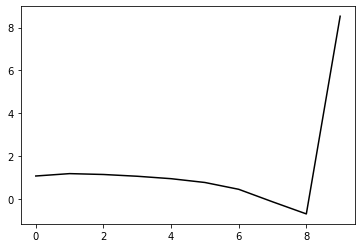

371800 0.14405798873014564
0.2729333328975431 -0.23015574205718597 -0.1838913555343882 -0.12396013995381601
[ 1.10016562  1.088613    1.08984836  1.03398059  0.92784743  0.75606484
  0.44450259 -0.1310123  -0.68909668  8.52987115]


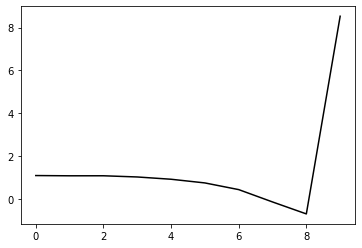

372900 0.1869527474361494
0.2760659550461049 -0.23207802440379124 -0.18647345045518063 -0.12182282206329133
[ 1.0635762   1.12391662  1.07830953  1.01264175  0.89974524  0.7182819
  0.39833407 -0.18410993 -0.74864301  8.52540497]


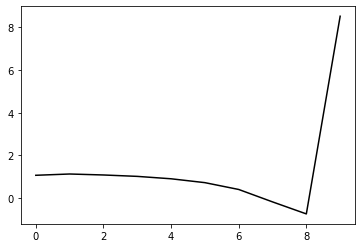

374000 0.2078947891338541
0.2784241931805142 -0.2321708988713816 -0.18716763222111651 -0.12056804409101636
[ 1.06152094  1.05194867  1.04312653  0.9840047   0.87307213  0.69096544
  0.37096309 -0.21013413 -0.77282414  8.5102269 ]


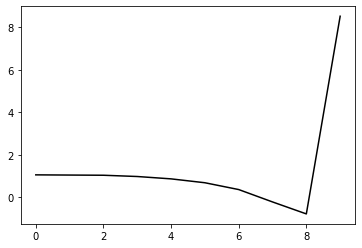

375100 0.21314195657534626
0.2723175596704118 -0.2358145647602546 -0.1890232780668602 -0.12073574644156103
[ 1.10258246  0.94437348  0.94710473  0.91259454  0.81972026  0.65125779
  0.34433984 -0.22253758 -0.76996519  8.51764448]


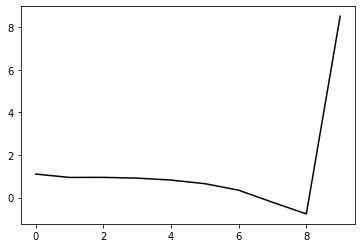

376200 0.18669886230590807
0.27681302866262725 -0.2276076281745932 -0.183613039462675 -0.12424247074672533
[ 1.10028008  1.13797848  1.12499759  1.08186363  0.9855218   0.80879358
  0.49154894 -0.08570023 -0.64479872  8.49774242]


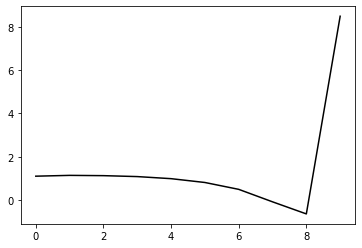

377300 0.16382016043749256
0.28080616020370014 -0.2273787571779275 -0.18467334438503247 -0.12087226651242608
[ 1.02860598  1.12338701  1.08891394  1.03284875  0.92853673  0.74289389
  0.41604341 -0.16916271 -0.73546351  8.53123794]


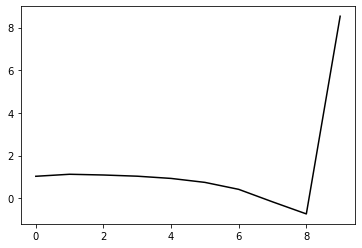

378400 0.1780467174994106
0.27206669644366843 -0.23367386976736615 -0.1880704612267421 -0.12248407732404275
[ 1.10774696  1.03616582  1.02509578  0.99902401  0.92387314  0.76504396
  0.46161958 -0.10117696 -0.64560967  8.51393529]


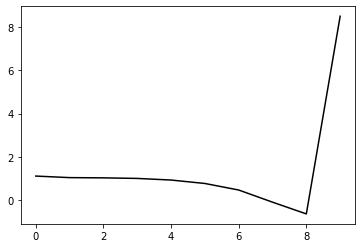

379500 0.21632891653364342
0.2712863499179511 -0.23264115620189754 -0.18767906038108736 -0.1186940383753505
[ 1.11266201  1.01060059  0.93367281  0.87599816  0.78186119  0.60690819
  0.2883642  -0.28717541 -0.84237634  8.52153185]


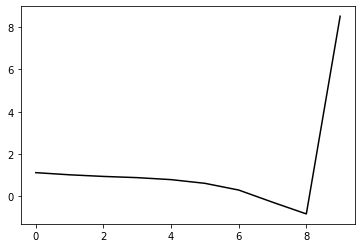

380600 0.15593400041387256
0.2741596590032974 -0.22979600471491915 -0.18628190793337618 -0.12118690675282631
[ 1.09196059  1.10138935  1.03176622  0.96272694  0.86522041  0.68958072
  0.36940949 -0.207693   -0.76437132  8.5026474 ]


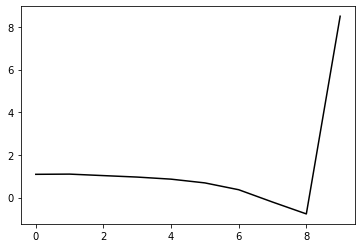

381700 0.3459787827677231
0.2845355653211587 -0.23149069156725816 -0.18965269971719606 -0.11915330824162076
[ 0.98474775  1.10721716  1.09377655  1.02399595  0.92077388  0.74353474
  0.4226135  -0.15396005 -0.70873875  8.56507633]


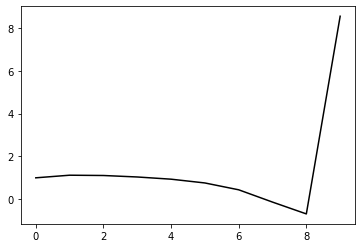

382800 0.13008894177038388
0.2779146198799938 -0.22855011198075464 -0.1860555814697383 -0.12257232482976851
[ 1.07530092  1.09677896  1.08090329  1.01980838  0.91574098  0.7378187
  0.41620715 -0.16088318 -0.71587173  8.51073654]


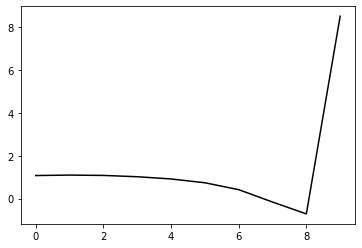

383900 0.19292806220898853
0.27837017803747494 -0.22832582548943275 -0.18591064905432086 -0.12232275725986969
[ 1.04458062  1.07326241  1.0595185   1.00066658  0.89048021  0.70581232
  0.3789373  -0.20174089 -0.75866448  8.51958059]


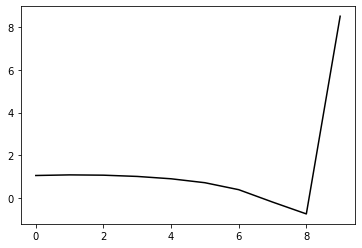

385000 0.2340105632894073
0.27014504863620314 -0.2308590565430037 -0.1861500901177918 -0.12355719409595739
[ 1.08727231  0.91653722  0.90892286  0.86442637  0.76394106  0.58626784
  0.26683972 -0.3051354  -0.8514936   8.49119475]


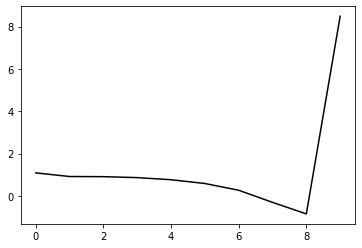

386100 0.31067227722707363
0.2672719201488696 -0.2318372161720377 -0.1863898813440673 -0.12653672189547177
[ 1.15857657  0.94002081  0.91449752  0.87685836  0.78837439  0.61991554
  0.30893186 -0.2542535  -0.79100874  8.55211737]


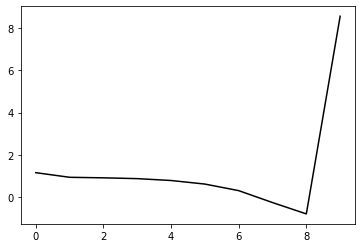

387200 0.1654005948644357
0.273431585580901 -0.2340665822063714 -0.18984159053792177 -0.12487766202521168
[ 1.05892347  1.10380079  1.06667652  1.01341633  0.91881728  0.7445376
  0.42755569 -0.14118699 -0.68339396  8.50873747]


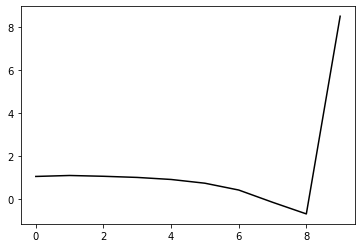

388300 0.1686919017016322
0.27854282435929395 -0.22746254242306377 -0.1860715928034572 -0.12501948459293438
[ 1.03579488  1.11804195  1.09344191  1.02754093  0.91682968  0.72743356
  0.39480465 -0.18962356 -0.74819821  8.54229323]


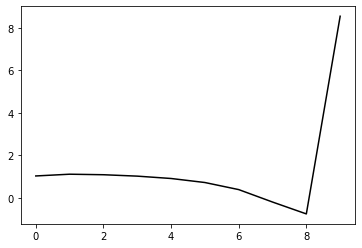

389400 0.20492025342270875
0.27444000653649564 -0.23225013288903096 -0.18961154563765598 -0.12109215385716461
[ 1.04371483  1.01827292  0.98788537  0.93508838  0.83140891  0.64796512
  0.32075469 -0.2578886  -0.80963283  8.46849559]


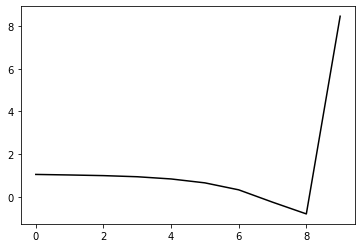

390500 0.25524776457130777
0.2828764758446506 -0.226334990242508 -0.18653233160615043 -0.12317198498810311
[ 1.0044259   1.15068025  1.14264504  1.08546312  0.97710272  0.7875617
  0.45368816 -0.13124933 -0.68887489  8.56118735]


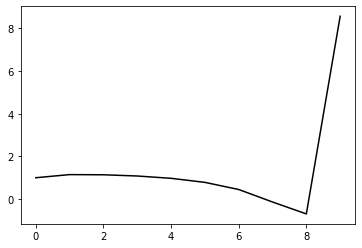

391600 0.21364290741198053
0.27844082628783273 -0.22941360989750315 -0.18826606496184228 -0.12284904179397947
[ 1.01951085  1.05240229  1.03201002  0.97812201  0.87076018  0.68151167
  0.34812412 -0.23528369 -0.79001275  8.50461079]


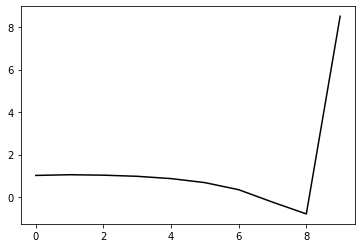

392700 0.12094591143412554
0.2798520134415086 -0.22651779122369134 -0.1868660977938357 -0.12215723514775416
[ 1.06811474  1.05370899  1.04576015  0.99975067  0.90229198  0.71910692
  0.38865154 -0.19340142 -0.74757003  8.51739687]


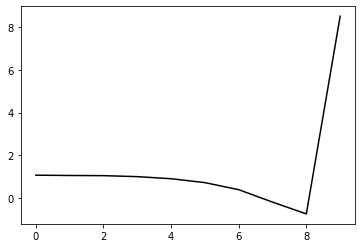

393800 0.1503645800061495
0.2739941970277182 -0.22785173474019854 -0.18681951845711914 -0.12543847573504988
[ 1.11793991  1.10487215  1.07368902  1.03302394  0.94645657  0.77327774
  0.45119193 -0.12276452 -0.66809356  8.52029704]


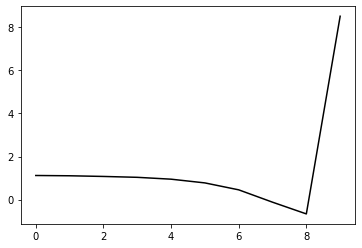

394900 0.19830138869142172
0.2698264055457056 -0.22972973756124787 -0.18789684108946947 -0.12573124936756974
[ 1.09485048  1.08569549  1.01492061  0.95475641  0.86019329  0.68165813
  0.35421253 -0.22474308 -0.77458416  8.52341361]


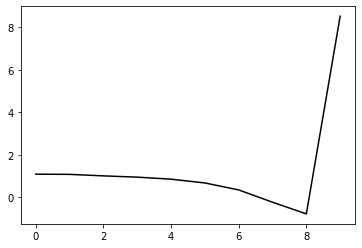

396000 0.21317499605827706
0.2791921379654377 -0.22765342411787287 -0.1887348448786059 -0.12265203154447396
[ 1.04914299  1.13525632  1.12129776  1.05615748  0.95215853  0.76722973
  0.43274098 -0.15392062 -0.71204359  8.49244275]


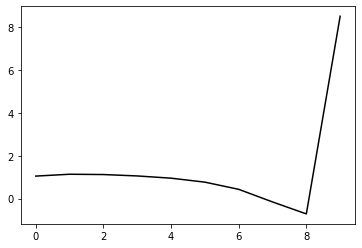

397100 0.27912599948500344
0.26788230085619297 -0.2247480949221026 -0.18425027257174884 -0.12589730456212686
[ 1.11312831  0.91820781  0.92930481  0.88003893  0.77407139  0.58732352
  0.25163367 -0.33552339 -0.89249701  8.50072358]


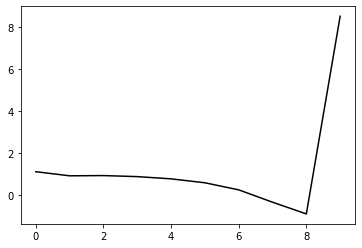

398200 0.17461324908866227
0.2781802090447954 -0.22413340874176976 -0.18605617853506032 -0.12491572456796556
[ 1.06975802  1.15959858  1.15725211  1.11311686  1.00972081  0.82147048
  0.48303769 -0.10781995 -0.66900658  8.50625815]


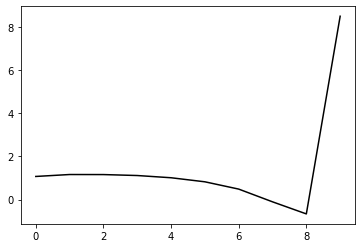

399300 0.17372402563990247
0.27772222091088594 -0.2228388079789421 -0.18530127955765174 -0.12421341620277633
[ 1.05401673  1.0749378   1.06570592  1.02248649  0.91965194  0.72937512
  0.38830547 -0.20538951 -0.76913792  8.53644693]


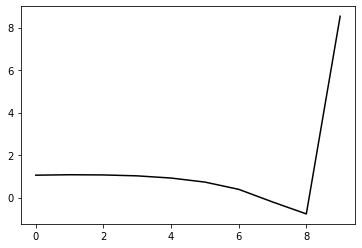

400400 0.20662518733086488
0.27011077338142386 -0.23053915161449706 -0.18971360819949604 -0.12450324111893299
[ 1.1343046   0.9744669   0.96424915  0.93954198  0.85570195  0.68179761
  0.35617045 -0.22144397 -0.76654163  8.51174885]


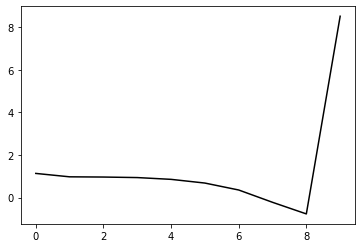

401500 0.19972820003266006
0.2780112147113857 -0.22387846083072666 -0.1867748735866391 -0.12392295507174086
[ 1.08844788  1.15146986  1.1395693   1.10134016  1.01247385  0.8310517
  0.49462047 -0.09624692 -0.65695654  8.48115363]


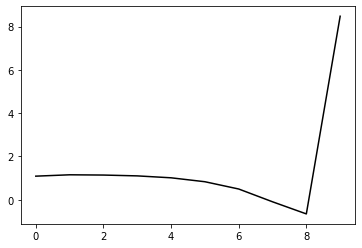

402600 0.17694313521501084
0.2709464489602703 -0.22528875165823373 -0.18693964796133028 -0.12238246170931429
[ 1.1077679   1.03970672  0.98699398  0.94223618  0.85232352  0.67140632
  0.33484862 -0.25605432 -0.81571252  8.49012196]


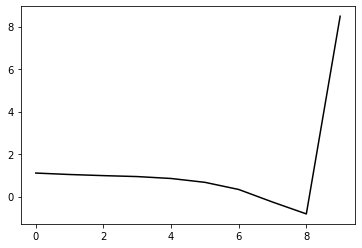

403700 0.23396682219697376
0.2780929639322408 -0.2285451693389264 -0.19101512842487517 -0.12022978985853738
[ 1.00980003  1.04963114  1.02817256  0.97258602  0.87775561  0.69557623
  0.35815499 -0.23288732 -0.79107201  8.53135611]


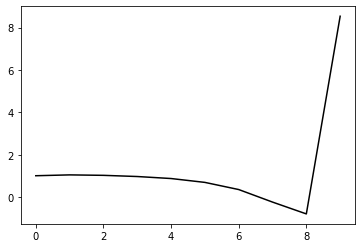

404800 0.13892885315303663
0.27345062488195016 -0.22424614554618105 -0.1868179965748686 -0.12384817024133858
[ 1.10096332  1.09680284  1.0585383   1.00422822  0.90992899  0.72912124
  0.39169761 -0.20072957 -0.76080558  8.52252918]


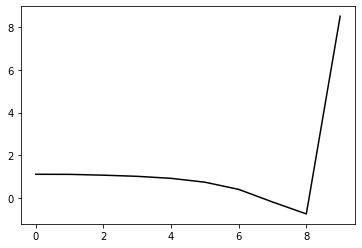

405900 0.21720037019163024
0.27933832604421605 -0.22361253003885703 -0.18795037086448607 -0.12136762419833294
[ 1.01890116  1.06536394  1.05885385  1.00031128  0.89781528  0.71099204
  0.36772193 -0.23090687 -0.79689993  8.51662709]


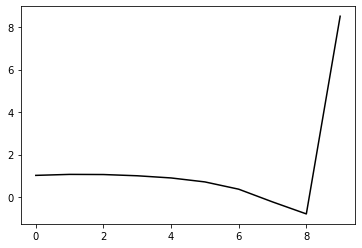

407000 0.2075419589214358
0.275167041569827 -0.22526792543854304 -0.1885766339335727 -0.1213052421257315
[ 1.05487934  1.0852341   1.04139539  0.98020401  0.87434248  0.68436668
  0.33800582 -0.2640515  -0.83288899  8.4880472 ]


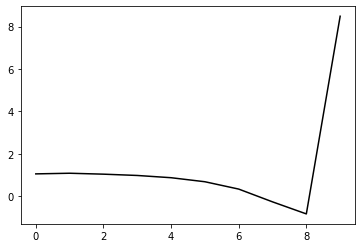

408100 0.2034772973484842
0.2728167656040066 -0.2266270345003946 -0.1891947318824164 -0.12221814944861945
[ 1.0560315   1.04996605  1.03518664  0.98053147  0.87650877  0.68828833
  0.34357538 -0.25728256 -0.82439187  8.51430813]


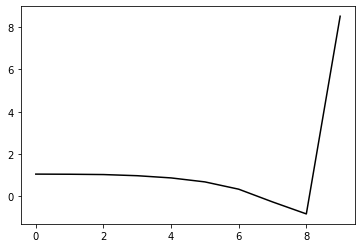

409200 0.20514771857308048
0.2713115707820984 -0.223725260650693 -0.18663104477876816 -0.1269962404880358
[ 1.11744204  1.09739264  1.08786921  1.04726497  0.9550777   0.77697523
  0.44152509 -0.15115338 -0.71000431  8.48688125]


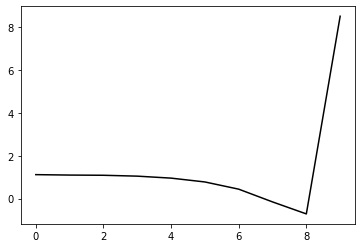

410300 0.16539621194158188
0.28255762226434117 -0.21888767570643028 -0.18576151309326716 -0.12233007939851644
[ 1.03861117  1.17304786  1.16277292  1.09982277  0.98460829  0.7838907
  0.42706399 -0.18640155 -0.7655409   8.53810201]


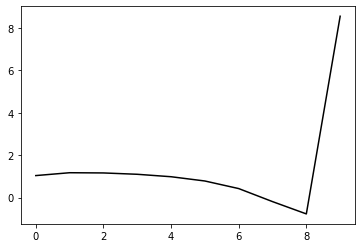

411400 0.1899496095010674
0.28111087521364436 -0.21851166387225623 -0.18510894064547756 -0.12438214562853941
[ 1.08828484  1.13898046  1.16384757  1.1249191   1.02266415  0.83129871
  0.48278533 -0.12316025 -0.69419612  8.49910789]


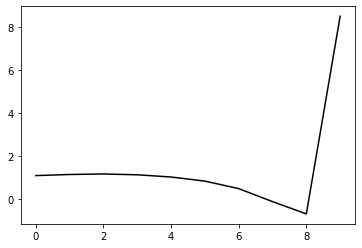

412500 0.2478719930307683
0.2801824967247127 -0.2217756948949718 -0.1874510091043022 -0.12222003167189192
[ 1.00677827  1.05964296  1.05906168  1.01834246  0.91382544  0.7179918
  0.36628149 -0.24105662 -0.81049449  8.54763467]


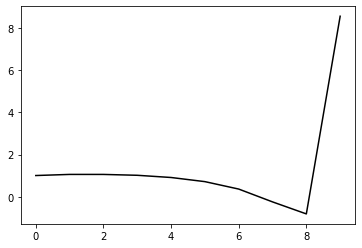

413600 0.18842050027284332
0.2747797422351313 -0.2253883463175974 -0.18908512735383118 -0.12333523512126139
[ 1.02737191  1.0368153   0.99479776  0.95047015  0.85263371  0.66240544
  0.3160596  -0.28519229 -0.84645619  8.4991952 ]


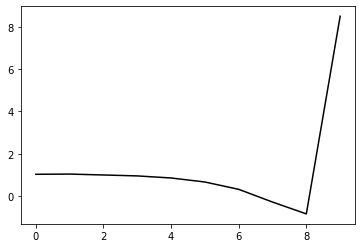

414700 0.12159104524427339
0.2721468026071084 -0.22981227167888613 -0.19202820065575307 -0.1251461379415717
[ 1.07273405  1.08785798  1.06242635  1.03111339  0.95800978  0.7912246
  0.46371899 -0.12189211 -0.66875563  8.51963372]


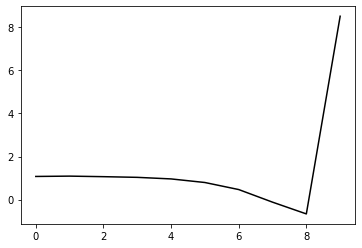

415800 0.14998891494479175
0.2715684559006477 -0.22526445568563025 -0.18854703363646597 -0.12678558599598602
[ 1.11728465  1.12682364  1.08625105  1.04130421  0.96473864  0.79854931
  0.47044011 -0.11698684 -0.66602171  8.52129966]


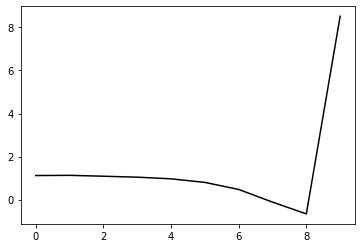

416900 0.1853677509530538
0.2707482900067058 -0.22827152845779825 -0.1909360355879077 -0.12470316070729257
[ 1.05536419  1.03764896  0.99820304  0.94009079  0.85547569  0.68839635
  0.36098047 -0.22520666 -0.77157517  8.52284159]


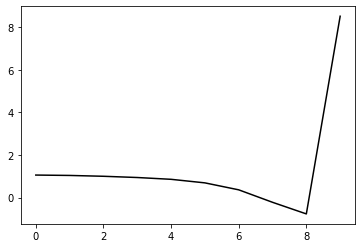

418000 0.22705118527687282
0.27453140731998193 -0.2292189210919364 -0.19301813062226966 -0.12270354084787018
[ 1.04186723  1.14024254  1.08165909  1.00316542  0.90030715  0.72026219
  0.38164531 -0.2158345  -0.77380655  8.50037977]


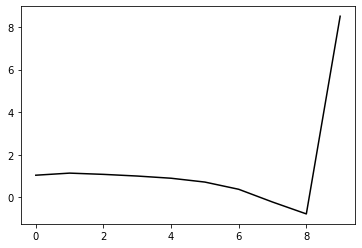

419100 0.19047052102102646
0.27725971687382656 -0.2231839800417728 -0.18900147638985104 -0.12450160751837024
[ 1.07973594  1.12834967  1.11695581  1.04102344  0.9284531   0.74183296
  0.3981575  -0.20496547 -0.76889075  8.52021072]


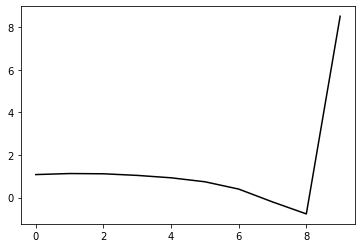

420200 0.19907589166745845
0.2684517040202383 -0.22643883370514328 -0.19006660371169573 -0.12244651067716338
[ 1.07667457  1.03829518  1.0227514   0.95270127  0.83017102  0.63402857
  0.28373099 -0.32485843 -0.89284163  8.49028522]


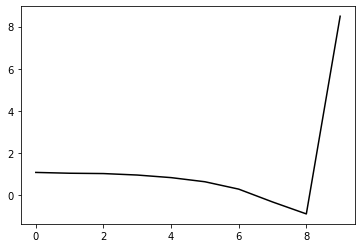

421300 0.17531013975149562
0.2763200624329292 -0.22254700922782414 -0.18846793556521874 -0.12640004070445987
[ 1.05825478  1.14767234  1.14756043  1.08131088  0.95600788  0.75402575
  0.39905858 -0.21409825 -0.78648907  8.54006014]


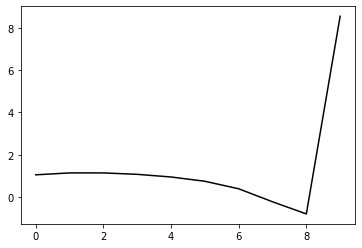

422400 0.1887409950628112
0.27140439898554003 -0.2292279389692041 -0.19284732135724061 -0.12499740942677338
[ 1.08681282  1.04059375  1.05919783  1.02456306  0.91822321  0.72954188
  0.38850858 -0.21025115 -0.7667474   8.48171346]


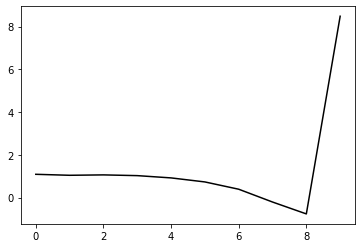

423500 0.19955011620989138
0.27209591502173847 -0.22561509201377547 -0.19036714475204608 -0.12568725806997408
[ 1.09319225  1.07076741  1.06000379  1.02097161  0.9132501   0.71686186
  0.36810891 -0.23792559 -0.80125918  8.52379104]


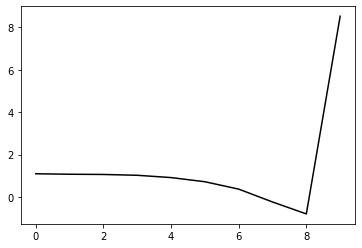

424600 0.18650357535873702
0.27296459982566795 -0.2217597870478898 -0.1876155226755878 -0.12595403670140898
[ 1.09622333  1.10060197  1.06067291  1.00216877  0.88361099  0.67420531
  0.31265979 -0.30501995 -0.87900786  8.4842163 ]


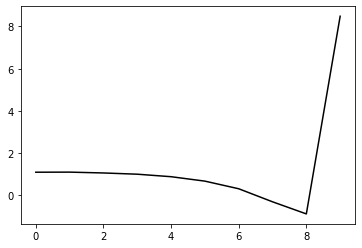

425700 0.1270905306308593
0.2762361763663364 -0.21993076104193898 -0.18684417699590916 -0.1268491921830461
[ 1.07750681  1.10088844  1.10982536  1.05435925  0.93712533  0.72758261
  0.36467201 -0.25406314 -0.82837504  8.52370324]


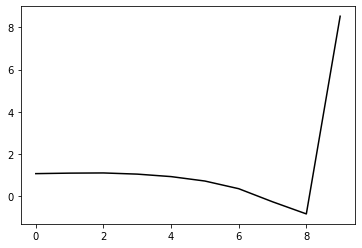

426800 0.12680711169747777
0.27574695671473426 -0.22055272635036013 -0.1872738645399324 -0.12650339355989823
[ 1.06342438  1.08990491  1.10127981  1.05986438  0.94680281  0.73791282
  0.37397521 -0.24570939 -0.82017389  8.50150699]


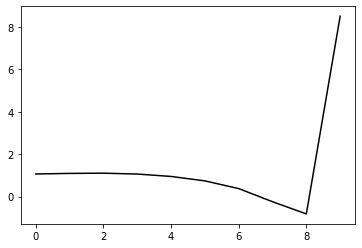

427900 0.2114295073871095
0.2797618608472249 -0.22108967565622337 -0.1886037852841135 -0.12472271910287373
[ 1.01257113  1.01718153  1.03494658  0.99806123  0.88982093  0.68256732
  0.31901058 -0.29958209 -0.87143097  8.52598589]


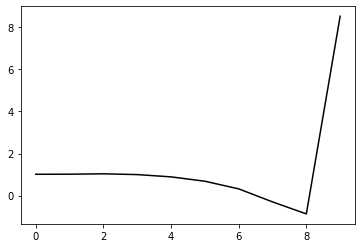

429000 0.20832201401110215
0.2781584968343894 -0.22350567523954612 -0.19063829245715944 -0.1235782607074038
[ 1.03639549  1.07780381  1.04212865  0.99959287  0.89363429  0.68624672
  0.32039138 -0.30128593 -0.87650087  8.49130242]


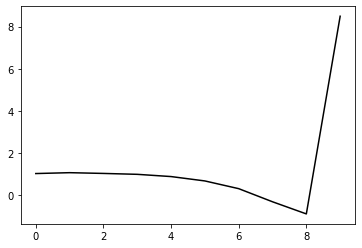

430100 0.198258476140445
0.2762564691264175 -0.2233075066590138 -0.190585154577688 -0.1237756178687599
[ 1.09093613  0.96511921  0.97380463  0.94512559  0.85489584  0.66088522
  0.30453677 -0.30936821 -0.87710419  8.50905544]


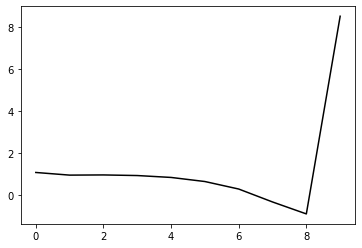

431200 0.2749938671858345
0.26810749953859336 -0.2201733220872281 -0.18657196325220365 -0.12765099937765634
[ 1.15487882  0.92875201  0.9150931   0.89341736  0.81261165  0.62726167
  0.27681277 -0.33233988 -0.89513754  8.46197818]


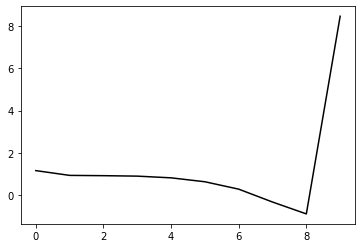

432300 0.17770473533775677
0.2806463920848414 -0.21793452117328596 -0.18764950946852355 -0.12589043926488297
[ 1.06123556  1.11174355  1.079315    1.03234695  0.93786583  0.74109048
  0.37804911 -0.24428646 -0.82065593  8.53025971]


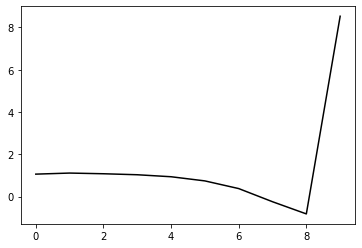

433400 0.17960979364703333
0.2730485193563495 -0.22276968848372639 -0.18975373773001955 -0.12790937430466018
[ 1.09985022  1.09882632  1.0701745   1.03098134  0.94570636  0.7607497
  0.40824128 -0.20420443 -0.76971821  8.49371689]


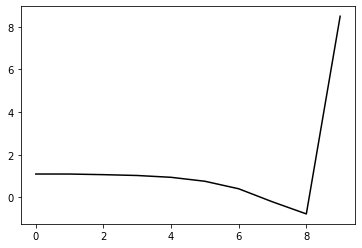

434500 0.23337121313530043
0.28320165394277397 -0.2203803804883217 -0.1904159725121215 -0.1252117241338122
[ 1.02304349  1.14311989  1.14237945  1.09798183  1.00753479  0.82021647
  0.46434011 -0.15288533 -0.72389956  8.5465295 ]


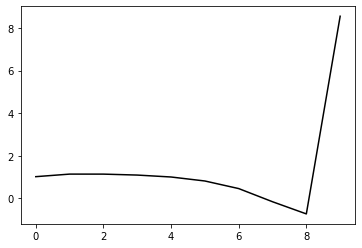

435600 0.2040986817354095
0.27961064466751295 -0.2186177794689105 -0.1883652547019005 -0.12661118456878334
[ 1.10945719  1.05761432  1.06773975  1.03231092  0.9446793   0.76187709
  0.40985923 -0.20485606 -0.77300611  8.49897181]


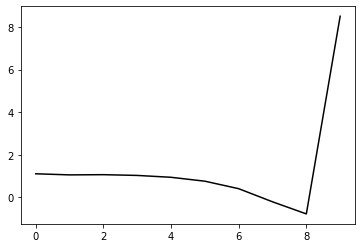

436700 0.11731820380650454
0.27738572609181855 -0.2218173119841701 -0.19056103574477207 -0.12634189075607621
[ 1.06902863  1.08606222  1.06014644  1.02253671  0.93673917  0.75743155
  0.40947516 -0.20165309 -0.76571582  8.52084253]


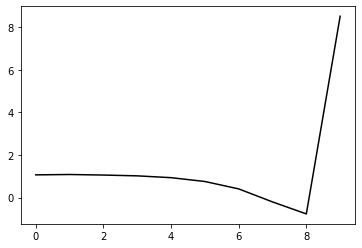

437800 0.1299124996973356
0.27458668157449634 -0.2225818475296196 -0.19084809734442437 -0.12751911624534368
[ 1.07012726  1.1207493   1.05946653  1.00283856  0.90748522  0.7214184
  0.36782313 -0.24874648 -0.81725997  8.50645455]


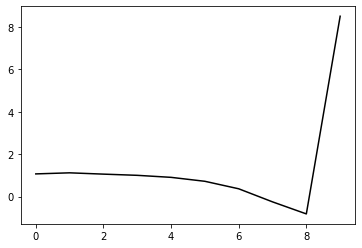

438900 0.20313873655409978
0.2806132435985093 -0.21964496872636546 -0.19018818293238998 -0.12553369309216109
[ 1.02635101  1.07463631  1.05381927  0.98470985  0.87640805  0.68124029
  0.3195308  -0.30566925 -0.88291212  8.52728814]


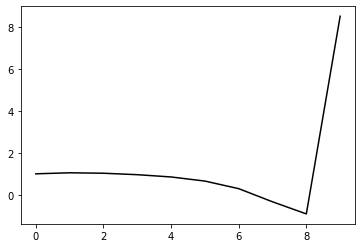

440000 0.20975244675297444
0.27741042125666227 -0.22111367192355189 -0.19101060607382503 -0.12491574796654278
[ 1.05684624  1.06261832  1.03663537  0.97442188  0.86588227  0.67127875
  0.31053897 -0.3147369  -0.89210963  8.50582649]


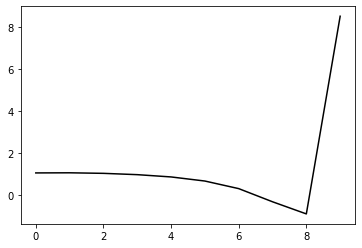

441100 0.22165937794016832
0.2698730752090636 -0.22901878257087233 -0.19573011013556812 -0.1244939789730967
[ 1.07195329  0.97074669  0.95605003  0.91161599  0.81492668  0.63202235
  0.28394727 -0.32879517 -0.89223909  8.50282389]


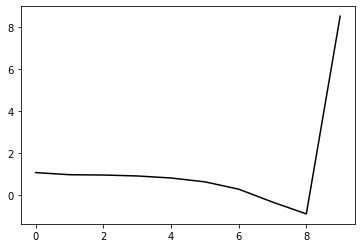

442200 0.19678729171426398
0.2768269515875604 -0.21766389604567404 -0.18827707096534052 -0.12932718405974933
[ 1.10529222  1.12637256  1.12123812  1.07678259  0.97806699  0.79049106
  0.43691902 -0.183281   -0.75598958  8.48967646]


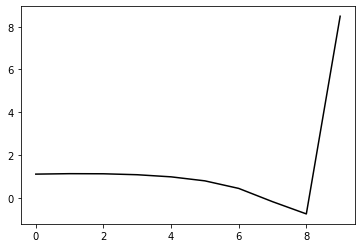

443300 0.19681570806229187
0.27938128485382385 -0.2243582979873667 -0.19420955681133456 -0.12421493667974606
[ 1.02695146  1.09078399  1.07332455  1.02524187  0.92351803  0.73327287
  0.37895132 -0.24088715 -0.81140589  8.53521659]


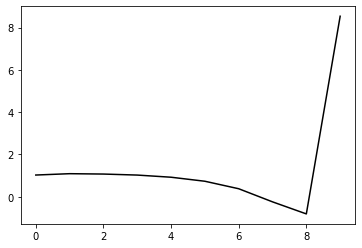

444400 0.16650718351050522
0.28097903527226425 -0.21707792001794257 -0.18884540158302945 -0.1271342921649656
[ 1.08180492  1.12897514  1.12644219  1.0726299   0.96227258  0.76201068
  0.39814553 -0.23136645 -0.81129962  8.47134549]


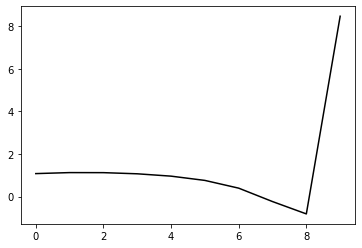

445500 0.3941985950351512
0.28381035779461916 -0.21993674528699292 -0.19214803789243318 -0.1245353578492582
[ 0.97893409  1.08934984  1.08615697  1.05077829  0.95380889  0.76295365
  0.40696993 -0.21637516 -0.79127564  8.55309581]


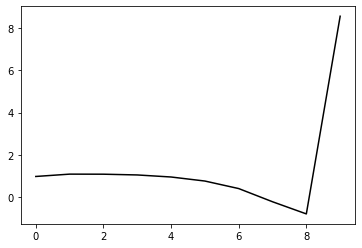

446600 0.16984114143515736
0.2758476674727756 -0.2204861733926077 -0.19072957858370027 -0.12661588594527184
[ 1.03409203  1.07402629  1.02265227  0.9707822   0.86733503  0.67003323
  0.3080988  -0.32057613 -0.89977991  8.49309272]


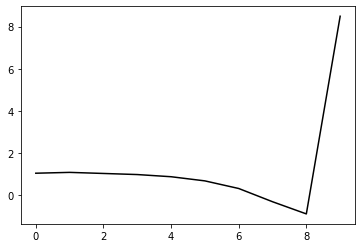

447700 0.11538959843719863
0.28293542514148906 -0.2148679841073958 -0.18820646499228494 -0.12643652249442297
[ 1.04437298  1.12830727  1.12413829  1.06972292  0.9649055   0.7663468
  0.40189324 -0.23049106 -0.81439418  8.50303371]


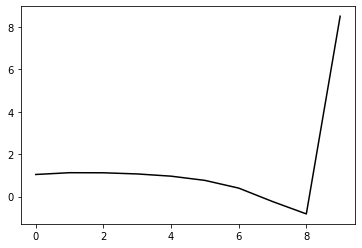

448800 0.1335840367763495
0.2781405134735228 -0.21735441219508073 -0.18919915225948356 -0.1272327188944166
[ 1.08968909  1.08708037  1.07823063  1.0349855   0.93851749  0.7483907
  0.3919266  -0.23264527 -0.8078384   8.51790912]


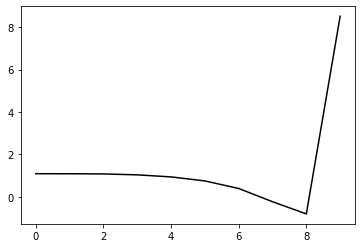

449900 0.17569218761093622
0.2704372745605659 -0.22148434879534898 -0.19149206563862772 -0.12367269849304792
[ 1.0483468   0.92868994  0.90219037  0.8522159   0.75117762  0.55784323
  0.19868998 -0.42841312 -1.00560606  8.48348496]


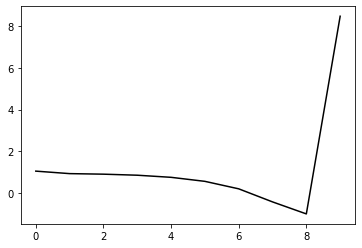

451000 0.19587809797618672
0.2775666726817523 -0.2151539768626145 -0.18828654939306014 -0.12568731945726824
[ 1.058524    1.13161745  1.10829365  1.04979861  0.94145527  0.73999459
  0.37137453 -0.26675618 -0.85670418  8.48037208]


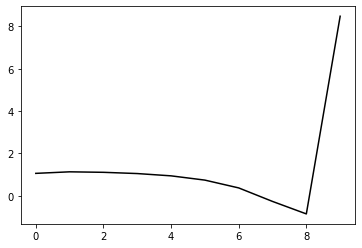

452100 0.18539882058312038
0.27980441017198415 -0.21423470370150943 -0.1882686073664314 -0.1250679648865245
[ 1.05268341  1.09414006  1.09847834  1.05021017  0.94256736  0.741317
  0.37261983 -0.26599933 -0.85617548  8.51460635]


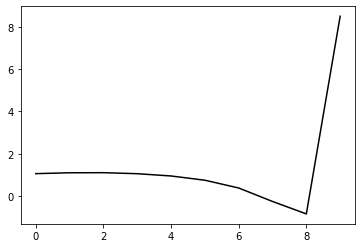

453200 0.184008854405137
0.27204318646989906 -0.22162718360309813 -0.1921722090927702 -0.12459124617429447
[ 1.05694919  0.96229625  0.95453097  0.92633786  0.83591233  0.65084444
  0.29928657 -0.32081632 -0.88928807  8.47676526]


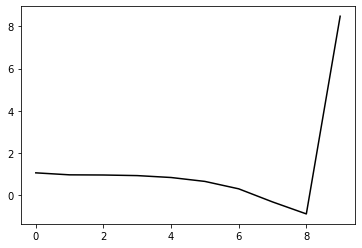

454300 0.2015480662366374
0.26336805548761716 -0.22142008462344698 -0.1903265476778325 -0.129034603630868
[ 1.08724043  0.89854413  0.85082079  0.82196485  0.74134423  0.56442108
  0.21978101 -0.39418463 -0.95633509  8.52744336]


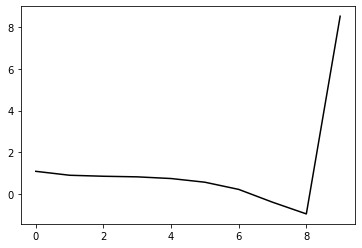

455400 0.18671571668268977
0.27648811533110473 -0.2207251775002414 -0.19291368615500182 -0.126513388713409
[ 1.07106589  1.05222531  1.0245884   0.9804901   0.89517748  0.71493915
  0.36592958 -0.25351866 -0.82228639  8.47742183]


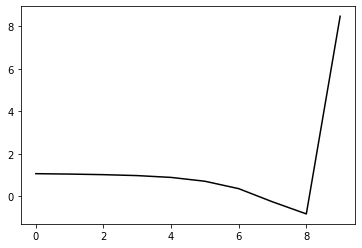

456500 0.22399408601994336
0.26920738736221606 -0.22042732176237653 -0.19122252267549442 -0.12981074028599118
[ 1.1005652   1.05618634  1.01820873  0.97379394  0.88884416  0.7110829
  0.36373023 -0.25504477 -0.82355873  8.52676569]


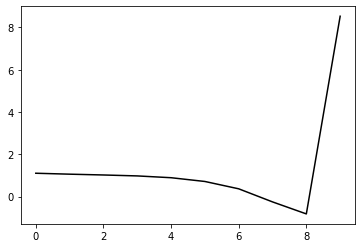

457600 0.16504340385930194
0.2779884057513034 -0.2191419755957722 -0.19275329217675977 -0.12427843272762254
[ 1.07497523  1.01051293  1.01021756  0.95996571  0.86764252  0.68566042
  0.33404174 -0.29011031 -0.86494723  8.48408103]


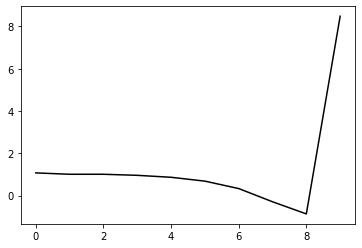

458700 0.11470508975258069
0.282945569531645 -0.21403957347545996 -0.18982985027120933 -0.125640425786713
[ 1.06247899  1.11946506  1.12726891  1.07644714  0.97463833  0.78405434
  0.42456142 -0.20805807 -0.79209808  8.53152351]


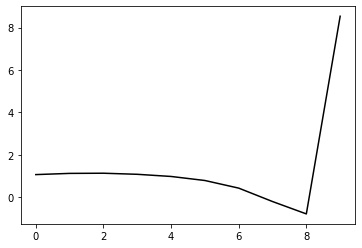

459800 0.14315809887398273
0.26867675629504656 -0.21848130523083875 -0.19055710417322955 -0.12772865005056103
[ 1.09083784  1.01463923  0.95985407  0.91488906  0.82033601  0.63642643
  0.28391129 -0.34182385 -0.91811019  8.49423152]


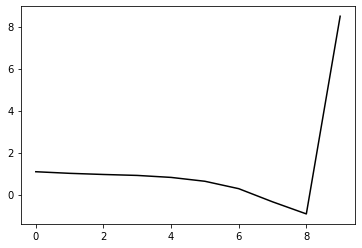

460900 0.18888154288415487
0.27290355240321784 -0.22094171050378433 -0.19377229605133245 -0.12834206609431076
[ 1.05968674  1.04556122  1.02781434  0.98721636  0.90333332  0.7292755
  0.38541297 -0.23328153 -0.80350761  8.53546259]


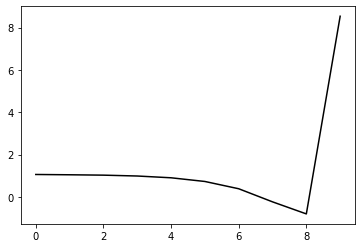

462000 0.20751686051070703
0.27639441004204723 -0.21792752542495317 -0.19244709035461083 -0.12573193388215065
[ 1.05528786  1.12161124  1.07362267  1.00502203  0.89909233  0.70679115
  0.3466734  -0.28768465 -0.87359023  8.48409008]


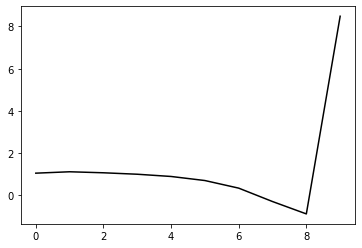

463100 0.19007384578118935
0.2766538437306065 -0.21635559758948242 -0.1913925523222505 -0.12658746589060463
[ 1.07680341  1.07741955  1.07076444  1.01486515  0.91156617  0.7227678
  0.36623446 -0.265756   -0.85039275  8.50407451]


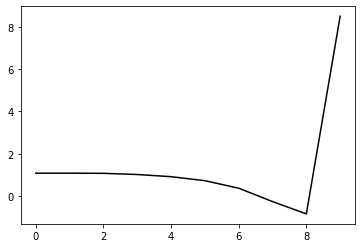

464200 0.17700921194285457
0.2701202134874374 -0.22137237277517907 -0.19414559676001897 -0.1259284232257559
[ 1.05574349  1.02271479  1.00149987  0.95663406  0.85855808  0.67460598
  0.32419648 -0.30131433 -0.87868251  8.48790023]


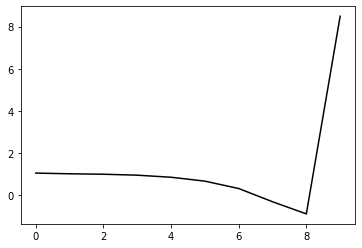

465300 0.17578771300282087
0.2728868936558714 -0.22166593877092966 -0.19520027566277065 -0.12687685171226698
[ 1.07853429  1.03222111  1.00962131  0.96907146  0.87895897  0.70183194
  0.35853629 -0.26025161 -0.831079    8.55012113]


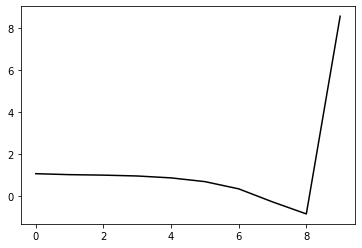

466400 0.20454512662139437
0.2733596676419237 -0.22204030887589227 -0.1958787924186406 -0.124920929741758
[ 1.05221746  1.00155305  0.96500699  0.90899953  0.80753573  0.62081743
  0.27017972 -0.35434124 -0.92941222  8.46004076]


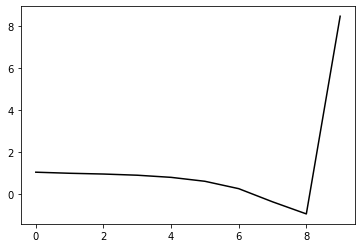

467500 0.26198937009307544
0.2820654639861088 -0.21371311029988588 -0.19135840851148966 -0.12620841391179535
[ 1.00008298  1.15660154  1.1524739   1.09088189  0.97893434  0.78024157
  0.41696752 -0.221244   -0.81163218  8.53821549]


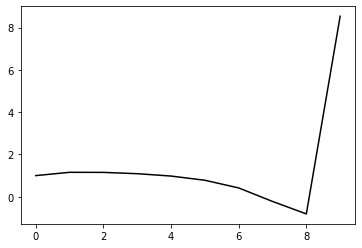

468600 0.15453516605017015
0.2781808089962871 -0.21425522476879658 -0.19088241503635187 -0.1260731889086891
[ 1.07614934  0.98029554  0.9844826   0.93502853  0.82580581  0.62914899
  0.26974686 -0.36319506 -0.94668628  8.46589519]


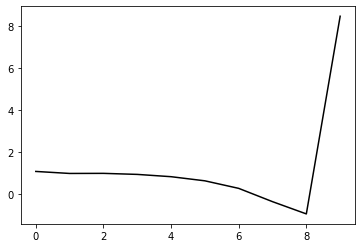

469700 0.12329865233750176
0.2771446687263871 -0.21523629046382772 -0.1911897024996539 -0.12852633730951332
[ 1.02635318  1.09934455  1.0691878   1.01640036  0.9068032   0.70726088
  0.34560049 -0.2886249  -0.87242558  8.5142694 ]


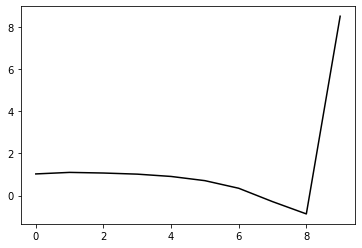

470800 0.15587419831552476
0.27311115594562974 -0.21482333217291913 -0.19049429935080925 -0.12973264040288643
[ 1.11026653  1.00941655  1.00798156  0.97698453  0.88908142  0.70742013
  0.36052376 -0.26129213 -0.83463593  8.50566438]


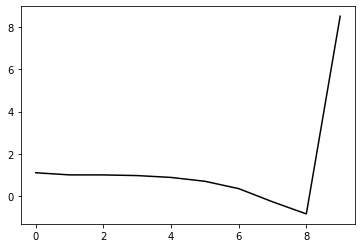

471900 0.17987499963506004
0.27260737464746504 -0.2208577983147254 -0.19559821179824033 -0.12611801319867308
[ 1.06514781  0.99242205  0.96218237  0.92588593  0.84328227  0.66710032
  0.32499315 -0.29217812 -0.86089513  8.51688781]


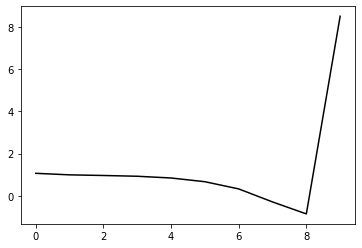

473000 0.2503223740661836
0.274030454939592 -0.2226317279038727 -0.19739509006772463 -0.1258107654014052
[ 1.0315122   1.06427313  1.027444    0.97652023  0.88921313  0.71190926
  0.36867965 -0.24956327 -0.81954142  8.49821284]


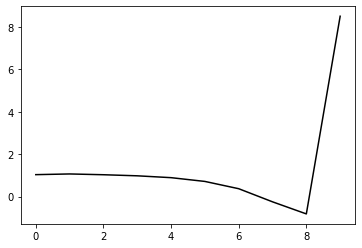

474100 0.21749401728921264
0.27589997169226327 -0.2162182633211653 -0.19299318109903327 -0.12921124515771232
[ 1.10256723  1.1045307   1.07638391  1.01733268  0.92339865  0.74216907
  0.39462203 -0.2287389  -0.80493959  8.51616198]


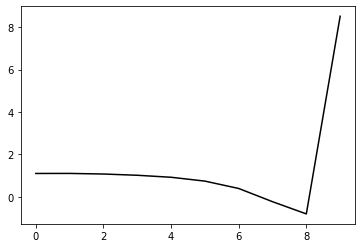

475200 0.17678995407633083
0.28061153435687847 -0.2103532177883111 -0.18989866325603072 -0.12782105577806044
[ 1.06381532  1.1520102   1.13693693  1.07043214  0.96062687  0.76668626
  0.40763912 -0.22713549 -0.81534639  8.48495365]


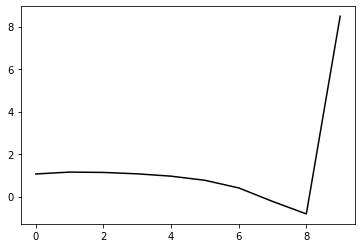

476300 0.16877725211532513
0.28071206958706657 -0.21111176326930756 -0.19059725125366292 -0.12788033126178175
[ 1.03944352  1.13282106  1.12642824  1.07401479  0.96678648  0.77375746
  0.41599138 -0.21807242 -0.80630034  8.53588434]


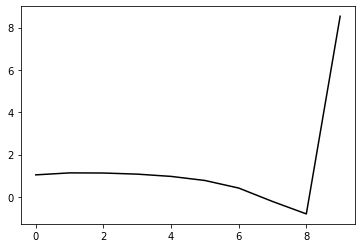

477400 0.2217461051963536
0.27936415487308414 -0.21049478477456887 -0.18980344016992304 -0.13001271596055244
[ 1.10165606  1.11573546  1.12812911  1.09429085  1.00199113  0.82046207
  0.47384263 -0.14966448 -0.72775991  8.4882974 ]


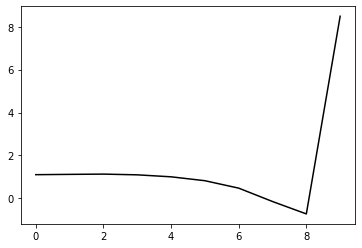

478500 0.30927859515773004
0.28193796824053713 -0.21482640083862997 -0.19396870241193145 -0.12651176002578712
[ 0.99420595  1.07892659  1.08051666  1.04366842  0.95072625  0.76734395
  0.41949683 -0.20466733 -0.78324518  8.55146264]


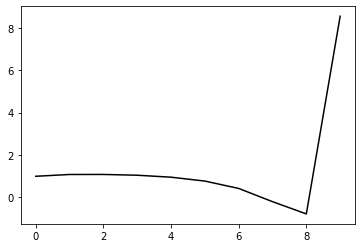

479600 0.20221073566708445
0.2772565307949833 -0.21250701051248885 -0.1910465829741483 -0.1295478026784023
[ 1.09698896  1.01395215  1.01500062  0.98745689  0.90644419  0.73321566
  0.39463115 -0.22050428 -0.78994061  8.49291862]


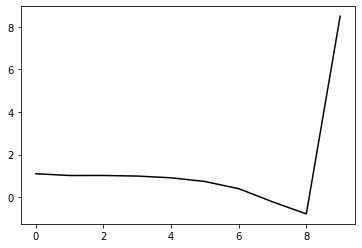

480700 0.12305699051985451
0.27902697945731647 -0.2120483886823637 -0.1915417073391476 -0.12903014974257482
[ 1.07575346  1.09307886  1.09036884  1.06270854  0.98619278  0.81649135
  0.47961051 -0.13546765 -0.70707029  8.54135253]


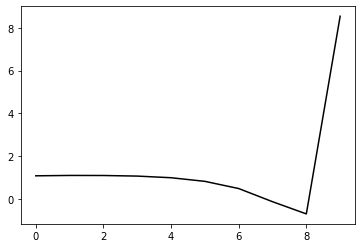

481800 0.15270588503777632
0.2758038549568301 -0.21495563712318883 -0.19340756655958086 -0.12574379111155365
[ 1.0572513   1.00328925  0.96934558  0.93213909  0.85216109  0.68093789
  0.34282567 -0.27294446 -0.84456248  8.50688955]


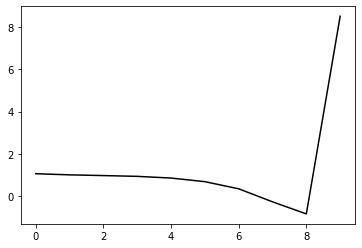

482900 0.1944335050195477
0.2757338177710322 -0.21226324858763562 -0.19189254104220904 -0.125308929632642
[ 1.02152125  0.92309193  0.89971121  0.85840284  0.77915521  0.61054136
  0.27394833 -0.34143608 -0.91373257  8.51315029]


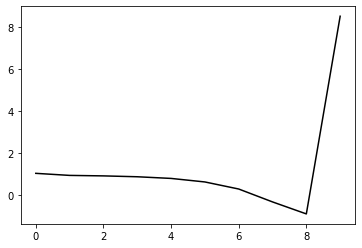

484000 0.20988968794366236
0.27260783002128774 -0.2142855545788741 -0.19343243873992452 -0.12461570512471258
[ 1.04871484  1.01639647  0.93623657  0.88197231  0.79868751  0.62799737
  0.28886253 -0.32995177 -0.9066786   8.48629914]


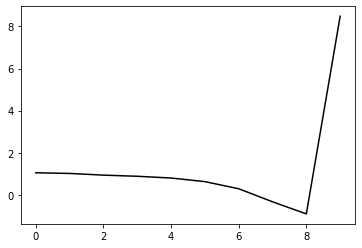

485100 0.19612876496191112
0.272805971229585 -0.21532010963881476 -0.1943887067154796 -0.12733479014951615
[ 1.0905698   1.04803483  1.01824386  0.97046217  0.89495575  0.73510704
  0.40605089 -0.20413272 -0.77338219  8.52207748]


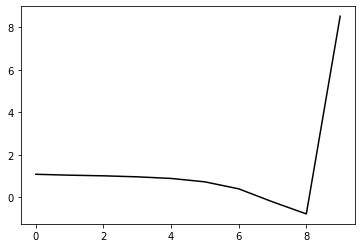

486200 0.1782288923139868
0.2756330453742619 -0.20871030878703456 -0.19027646380080687 -0.12803835039354347
[ 1.08164475  1.12905035  1.10286268  1.05005279  0.96415222  0.79668075
  0.46022285 -0.15899259 -0.73987404  8.50166109]


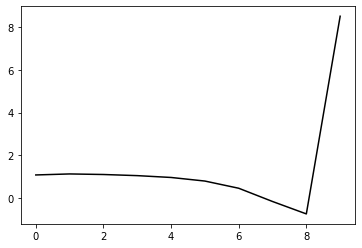

487300 0.17075567227376007
0.2771729290831522 -0.21145040975229934 -0.19315504825400234 -0.1270319976077174
[ 1.0407751   1.14169991  1.13052611  1.08919224  1.00842615  0.84720529
  0.5176546  -0.0959641  -0.67297479  8.55247675]


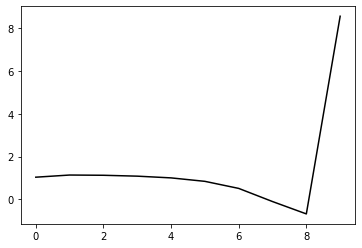

488400 0.16017629453985455
0.27554392775579467 -0.2109705042512001 -0.19292241386002873 -0.12650375036529563
[ 1.07100844  1.10195444  1.09016057  1.05512061  0.97869458  0.82165881
  0.49693626 -0.11309812 -0.68841985  8.49496913]


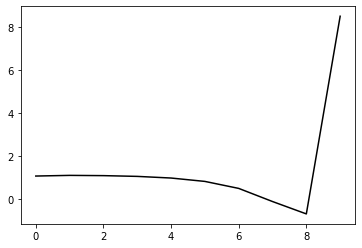

489500 0.25237247766562343
0.26441796251720195 -0.21225753625666097 -0.19162548208349808 -0.12813574838862007
[ 1.10864775  1.02592664  0.98428544  0.93757845  0.85171403  0.68647433
  0.35574984 -0.25892755 -0.83773573  8.50208861]


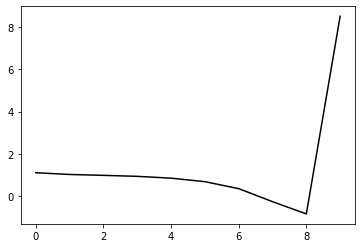

490600 0.29946934878888304
0.27859300459458514 -0.21120158220513593 -0.1942471195826352 -0.12426259291997718
[ 0.99969714  1.18641668  1.16774176  1.10616758  1.00770752  0.83118463
  0.49054673 -0.1340591  -0.72402383  8.52943827]


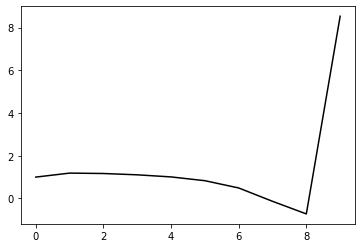

491700 0.1315197209353899
0.2634311907506877 -0.21213322255797942 -0.19195436200111315 -0.12605558754036292
[ 1.08924108  1.01700661  0.95921053  0.89792886  0.79842789  0.62176049
  0.28222338 -0.3408479  -0.92902602  8.49198982]


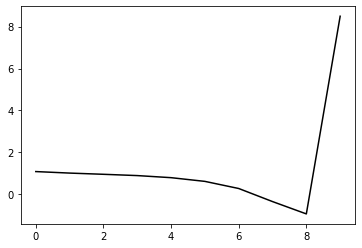

492800 0.16709543812046634
0.2725904926413758 -0.20632999850652464 -0.1895974503392028 -0.1277526102635087
[ 1.10863016  1.08995322  1.07283883  1.01198839  0.91233112  0.73513589
  0.3952157  -0.22887166 -0.81930352  8.4959052 ]


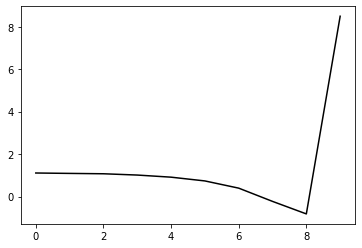

493900 0.1924259314962593
0.2708296092903688 -0.2112755351588651 -0.19340058924526202 -0.124935685513115
[ 1.03646948  0.99262309  0.97982144  0.92729405  0.83124463  0.65787028
  0.32317424 -0.2949387  -0.87885438  8.51231029]


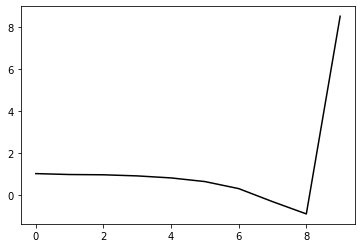

495000 0.20789650481237096
0.27038345924010376 -0.2123049920777389 -0.19435523319240156 -0.1253677486826961
[ 1.05613454  1.08399474  1.0364805   0.9782045   0.87958598  0.70308427
  0.36606843 -0.25423034 -0.84097413  8.49905025]


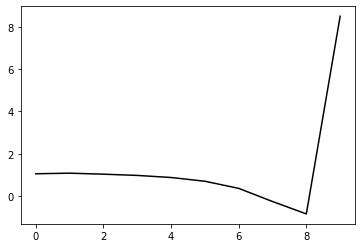

496100 0.1901559955227943
0.27150461665360753 -0.21086755967454282 -0.1936100098967943 -0.12646669848805153
[ 1.07269896  1.08084476  1.06852635  1.01695289  0.92151479  0.7474414
  0.41294265 -0.20529531 -0.79126527  8.52638055]


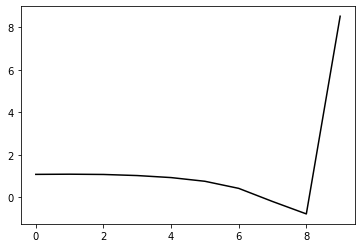

497200 0.18295414204023863
0.270188552398953 -0.20774999365824728 -0.19127144497529194 -0.12793272432835828
[ 1.09306903  1.10689346  1.10102904  1.06076948  0.96990902  0.79802617
  0.46524045 -0.15231078 -0.73981983  8.5109974 ]


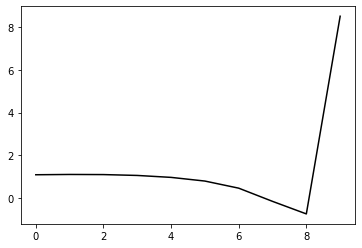

498300 0.18860363042258432
0.2619271036316997 -0.20992477289879583 -0.19160587033656132 -0.1267174407398933
[ 1.077306    0.89653155  0.85374111  0.81101052  0.71949707  0.54635012
  0.2135465  -0.40285134 -0.98864625  8.51178769]


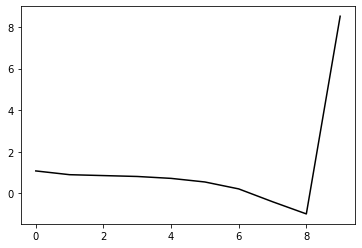

499400 0.15388950152182707
0.27517904557046635 -0.20628781968374554 -0.1917316077688732 -0.12712372330495836
[ 1.05669148  1.13708005  1.1064545   1.05446939  0.95964893  0.78244166
  0.44534231 -0.17553215 -0.76708937  8.48185181]


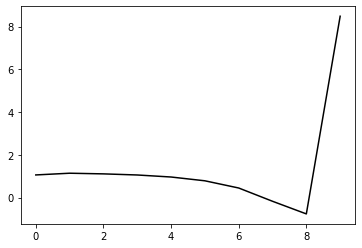

In [19]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

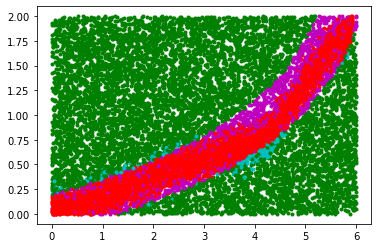

In [20]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 0.22889499859980011
0.26099800932474276 -0.22148335697435395 -0.18746656936868875 -0.1155857867762649
[ 1.09075988  0.93031468  0.90212045  0.84572374  0.74756959  0.56846225
  0.23082463 -0.38905105 -0.97809803  8.46205132]


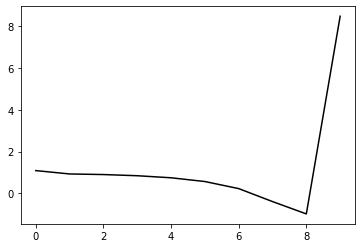

1100 0.2601943788754609
0.25892629986029336 -0.22697610203969046 -0.18319152933654276 -0.13416680028564032
[ 1.05221671  0.8535033   0.81504588  0.75827809  0.66046517  0.48326468
  0.14936228 -0.46433358 -1.04408363  8.50661551]


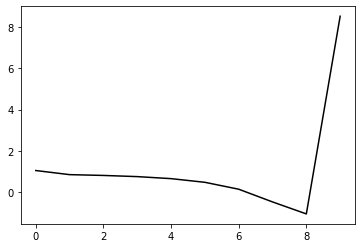

2200 0.3322286414762548
0.2572269324627843 -0.2216595648554615 -0.17898288566193093 -0.14139370918966762
[ 1.0560887   0.92848002  0.87219062  0.8124416   0.71498495  0.53817486
  0.20450126 -0.40900286 -0.98904809  8.47996402]


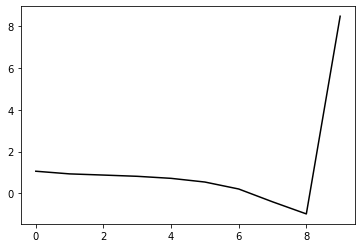

3300 0.16976700350727564
0.26599250544658576 -0.22777606113423654 -0.18605805638746184 -0.13543405938676756
[ 0.96837272  0.93223021  0.86005253  0.78168801  0.67141811  0.48503091
  0.14377853 -0.47549929 -1.060332    8.49116216]


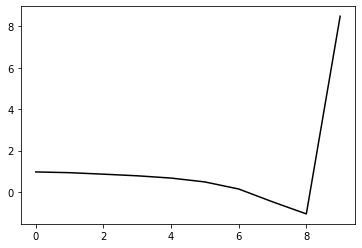

4400 0.17744949613292244
0.27285519835599203 -0.2239335321417603 -0.1844819972002898 -0.13657878506150237
[ 0.99058833  1.00837088  0.93853081  0.85439126  0.73977835  0.55133083
  0.20928797 -0.40944607 -0.99259472  8.46506046]


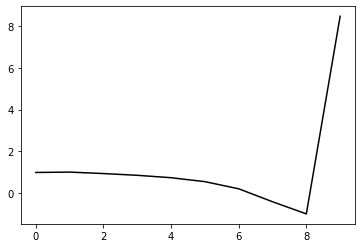

5500 0.20360372655659592
0.2719970009666987 -0.2274427618741674 -0.18679595583293668 -0.13793895622869803
[ 1.01739538  0.97731815  0.92252938  0.84275408  0.73040782  0.54638179
  0.21046243 -0.40043772 -0.97396985  8.49530322]


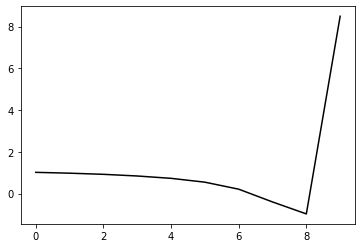

6600 0.1827802464966837
0.2671086017826546 -0.22954974819533738 -0.18741133820984268 -0.1384596123794067
[ 1.04030134  0.936253    0.8636234   0.77801436  0.65901975  0.47041002
  0.13221627 -0.47910513 -1.05186431  8.45788596]


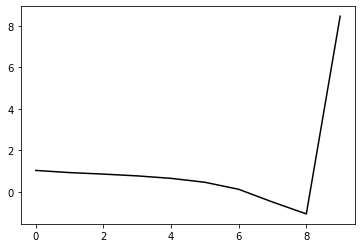

7700 0.11629275990302584
0.27727747535232117 -0.22699880004694903 -0.1878924299342304 -0.1405033422957502
[ 1.01432478  1.06393744  1.0507409   0.97418456  0.85646932  0.66821673
  0.33040779 -0.28104257 -0.85557785  8.54158995]


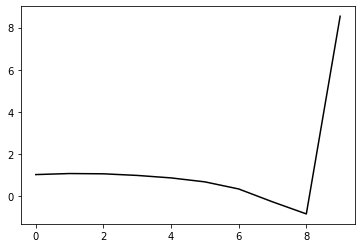

8800 0.14217130052143337
0.2728840089957322 -0.22874648071672027 -0.1888395692919355 -0.13678681984187893
[ 1.02814281  0.95165925  0.89334644  0.81571982  0.69109391  0.49442063
  0.15082953 -0.46397404 -1.04057913  8.47051961]


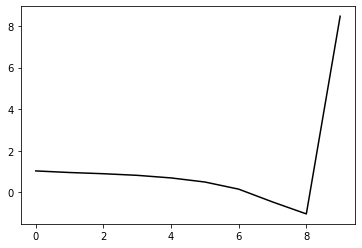

9900 0.17155365549971646
0.2742666393791962 -0.2279956846548989 -0.18926982157845185 -0.13338828416129744
[ 1.02845929  0.83033138  0.79746718  0.71901741  0.59363077  0.39385188
  0.04707608 -0.57058227 -1.15050483  8.4724338 ]


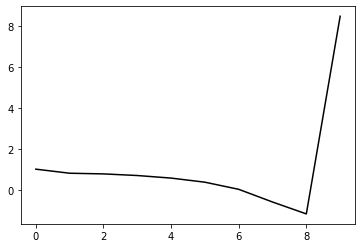

11000 0.21198749909671796
0.2733019839596742 -0.22932436919277466 -0.1899065899872805 -0.13827952772209615
[ 1.00277605  0.96166096  0.93025281  0.86451322  0.74847932  0.55527551
  0.21485707 -0.39561582 -0.96814462  8.4425329 ]


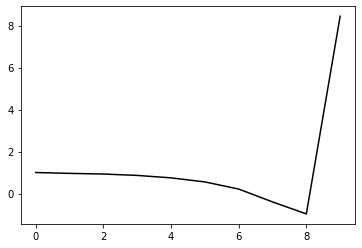

12100 0.19753090425492156
0.27541594477148673 -0.22732337001931596 -0.18923822159948075 -0.13747561024198024
[ 1.00177309  0.99320944  0.95612066  0.88909202  0.77003097  0.57066611
  0.22301589 -0.39464984 -0.97542401  8.47989243]


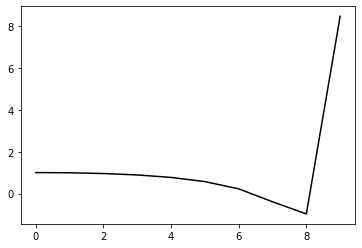

13200 0.1797189626766113
0.2762974282990179 -0.2211860707590254 -0.18529081494326793 -0.14053102753391594
[ 1.02614769  1.07255461  1.05381722  0.99576285  0.88472597  0.68981075
  0.34394306 -0.2735602  -0.85722747  8.49444834]


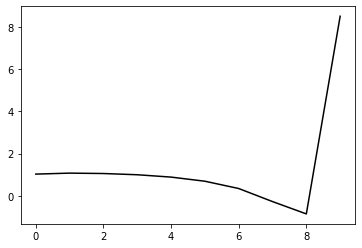

14300 0.18039737730348382
0.2850200130873969 -0.21491205028696359 -0.18347998732948187 -0.13611886801014225
[ 0.98889439  1.07748072  1.06680258  1.00474101  0.88585824  0.67990813
  0.32072622 -0.3111613  -0.9118641   8.54702165]


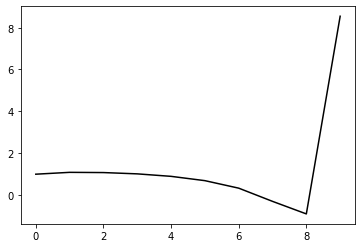

15400 0.18868136475182884
0.27276620068629337 -0.22629244015050953 -0.18989664068727335 -0.13588188449290292
[ 1.01530302  0.95267163  0.93118643  0.88627077  0.78314693  0.59131028
  0.24617883 -0.36944556 -0.95073     8.46029689]


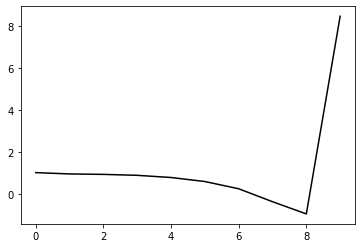

16500 0.20154330180284458
0.2728806778844688 -0.2234656080424085 -0.187700934960244 -0.1394312353585786
[ 1.02502227  1.01691407  0.98715328  0.93717207  0.8346161   0.64181679
  0.29413272 -0.32397178 -0.90812924  8.51495038]


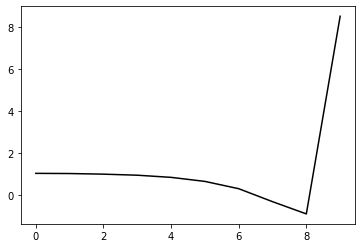

17600 0.15409570856510002
0.2744815030337441 -0.22141778534244544 -0.18706277406223965 -0.13746740294394857
[ 1.00022016  1.02883963  0.98566246  0.92395827  0.81696772  0.62073609
  0.26853014 -0.35367364 -0.94188586  8.47865204]


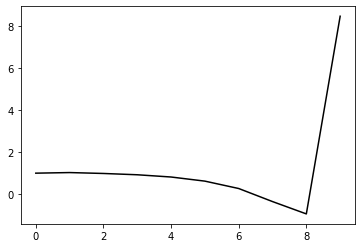

18700 0.13088164425243237
0.27351367677939364 -0.22305993323043727 -0.18842732220133362 -0.1351495163939259
[ 0.99460749  1.01327701  0.92491648  0.85061553  0.73980285  0.542659
  0.18949907 -0.43251367 -1.01917221  8.48081642]


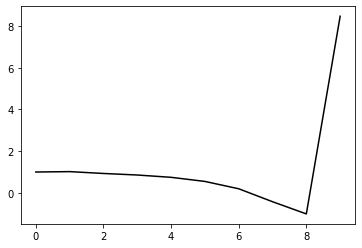

19800 0.14488449751637855
0.2763791698299259 -0.22354748606414568 -0.18988547070828793 -0.13453770653563168
[ 1.02033035  0.97617375  0.95456293  0.88967225  0.7842537   0.59423412
  0.24613384 -0.37210298 -0.95587577  8.47196751]


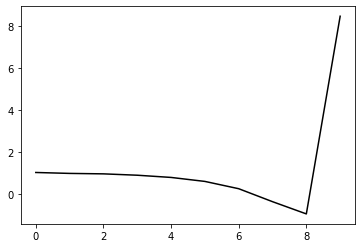

20900 0.1870332563924817
0.2762300022949865 -0.2212230117310097 -0.18860150567293518 -0.13467196302682133
[ 1.02842346  0.98338219  0.9639614   0.90568611  0.79874133  0.60618127
  0.25415084 -0.36919253 -0.95919058  8.49214177]


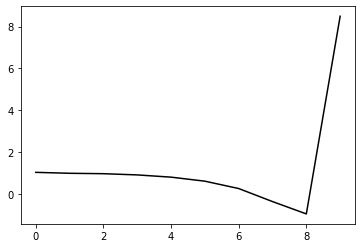

22000 0.21429949432349998
0.2749133040897931 -0.2264339693382971 -0.1928885674840079 -0.13162227712163208
[ 0.98903624  0.88406675  0.87628511  0.83328516  0.73526713  0.55028384
  0.20557655 -0.41033545 -0.9922178   8.4646074 ]


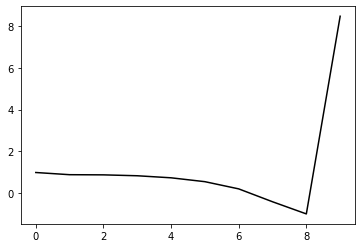

23100 0.32659664851385267
0.2653366893179513 -0.2242372963900835 -0.18886560784778528 -0.13871859581458149
[ 1.11640199  0.88180703  0.83802034  0.7900556   0.69838105  0.51915988
  0.18010693 -0.42971481 -1.00456092  8.52450641]


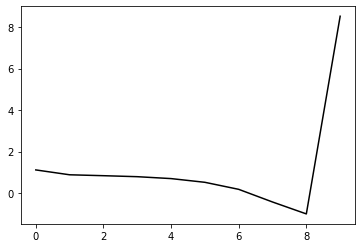

24200 0.1704655533328985
0.2736577145815917 -0.22749553360308752 -0.19364150627363153 -0.1358658812474613
[ 1.00416526  1.04666945  0.99297668  0.92527515  0.82550811  0.64164244
  0.29857927 -0.31502065 -0.89392124  8.48428944]


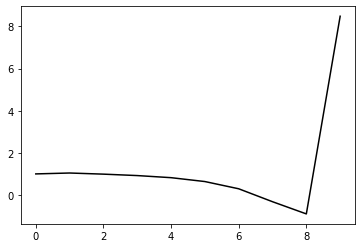

25300 0.20392523484148278
0.27232188523697026 -0.22974854611907813 -0.19591563966252132 -0.13441888927923595
[ 0.99410701  1.03913871  0.99720353  0.93235131  0.83238215  0.6510456
  0.30962788 -0.30390439 -0.88445296  8.52012215]


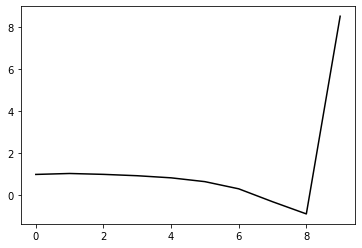

26400 0.1947067553723425
0.28028997547432527 -0.21524713481443464 -0.18667418249584203 -0.1345933683705473
[ 1.05224255  1.08617918  1.07986557  1.00360212  0.8757117   0.6663714
  0.29740037 -0.34416477 -0.95395293  8.44796053]


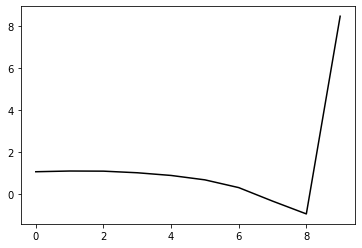

27500 0.2060208375305753
0.2701769847284389 -0.22357536839571535 -0.1912712099183621 -0.13586642630293352
[ 1.03500796  0.97472802  0.94613093  0.89440594  0.78510547  0.59187798
  0.24019904 -0.38332517 -0.97358965  8.49324113]


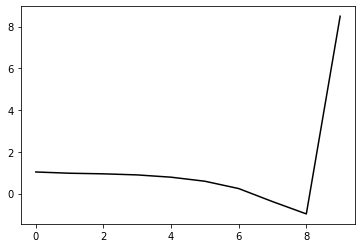

28600 0.16431843226291087
0.27283919950880325 -0.22458465179388343 -0.19314631746220953 -0.1346130376218018
[ 1.04587978  1.05320501  1.00379461  0.9471721   0.83916326  0.64451053
  0.29072284 -0.33545852 -0.92906754  8.49210263]


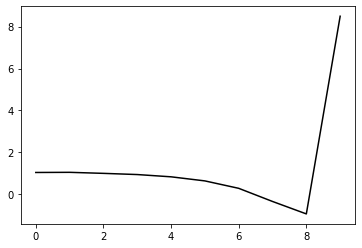

29700 0.11645617141229778
0.2810527334990453 -0.21832361104533796 -0.190352236974769 -0.13409272991496268
[ 1.02797649  1.06410883  1.04904482  0.98642676  0.87283874  0.67186554
  0.31084181 -0.32360212 -0.92721045  8.5022089 ]


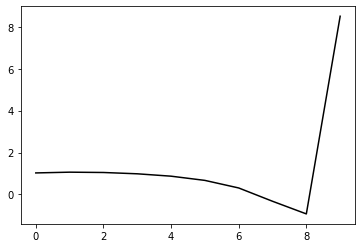

30800 0.1413111368430597
0.278931375523534 -0.21892570981965195 -0.1900466312891491 -0.13771568861538225
[ 1.06459166  1.08963373  1.07518013  1.023809    0.9198741   0.72743846
  0.37462932 -0.25114909 -0.84494239  8.50464915]


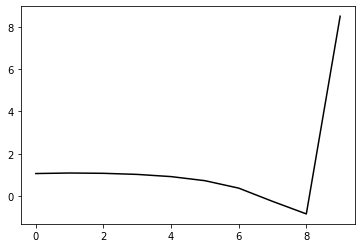

31900 0.17780299451924805
0.27190956501943764 -0.22672275513447868 -0.19543244610030353 -0.13408431506502527
[ 1.05005625  0.96207017  0.93496264  0.89132346  0.79817788  0.61579479
  0.27238977 -0.34404635 -0.92800152  8.50914173]


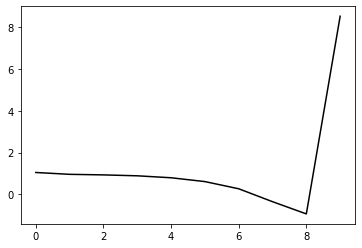

33000 0.23687747335841888
0.2654615181510297 -0.22642189779906488 -0.19404067287232712 -0.1354522506247139
[ 1.06102411  0.89860173  0.85188998  0.79480181  0.69430068  0.50583174
  0.15641661 -0.46542239 -1.05387685  8.453309  ]


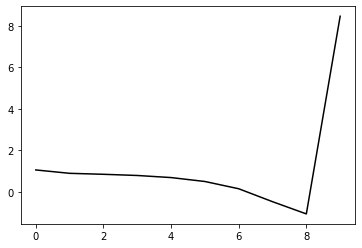

34100 0.2518342717716468
0.2738626409765343 -0.22174444917383923 -0.19229596203752705 -0.13648232698907534
[ 1.09054543  0.99519741  0.96880593  0.91188333  0.81406204  0.62941974
  0.28289239 -0.33722006 -0.92557831  8.52193083]


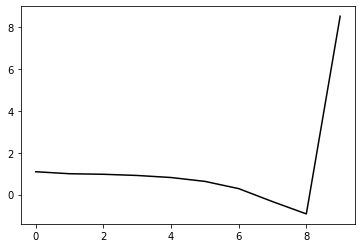

35200 0.17597769855601397
0.2796743178133061 -0.2163684810508116 -0.18957120650566733 -0.13466117327775168
[ 1.03606822  1.13635825  1.10723033  1.03396259  0.91635635  0.71308295
  0.34758589 -0.29247859 -0.90275254  8.48365794]


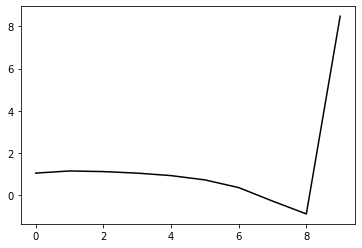

36300 0.16176630777000264
0.2761329390244801 -0.22204153266208276 -0.1936045013481644 -0.13262460423189432
[ 1.01350586  0.9867721   0.97506201  0.92241888  0.81101893  0.61364669
  0.25512601 -0.3769326  -0.97736492  8.49463494]


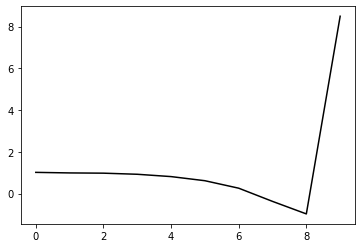

37400 0.22130157146967835
0.26358673336555094 -0.22336925805439195 -0.19251974621568435 -0.13396147770155042
[ 1.05114918  0.88291866  0.81763548  0.76194646  0.65240161  0.45517571
  0.09736303 -0.53335119 -1.13149001  8.41355799]


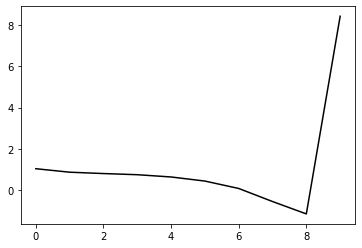

38500 0.1986560993047036
0.2765995234977683 -0.2188290721265493 -0.19145842522539844 -0.13585748430042818
[ 1.03798854  1.05206397  1.01699282  0.95155125  0.84075272  0.64191738
  0.28188195 -0.35148232 -0.95288422  8.49680425]


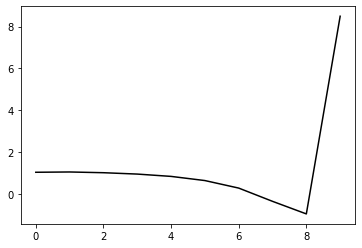

39600 0.16846976644774325
0.27288091802011577 -0.21912332370533033 -0.19136843892896754 -0.1345050555309456
[ 1.06029313  1.01344866  0.949538    0.87746304  0.7603365   0.55635006
  0.19132425 -0.44685572 -1.0529328   8.47364927]


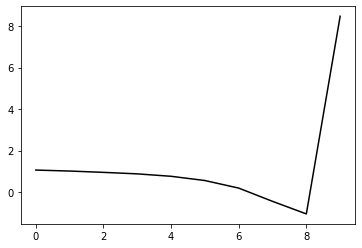

40700 0.1445301840319341
0.277147151687757 -0.21610717968741097 -0.18970711787347574 -0.13581608258319175
[ 1.06313536  1.0207401   0.99845369  0.92741856  0.80882032  0.60459807
  0.23976845 -0.39771093 -1.00230051  8.49999037]


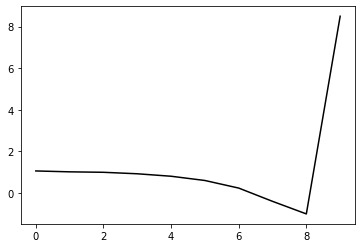

41800 0.13485751490149842
0.2788442769024389 -0.2167701371951823 -0.19071953359152394 -0.13612869589936222
[ 1.05785554  1.04183069  1.02721872  0.96973065  0.85723583  0.65757774
  0.29681497 -0.33704091 -0.93817148  8.47481094]


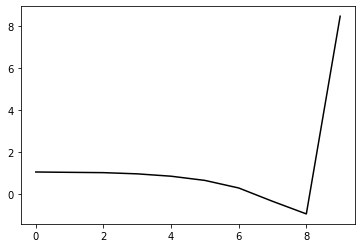

42900 0.18508887539370408
0.2808081963069083 -0.21664679478154109 -0.19127257677882845 -0.13462120736685704
[ 1.03007072  1.02004498  1.00586272  0.95067051  0.83741895  0.634818
  0.27097462 -0.36591384 -0.97004666  8.49241799]


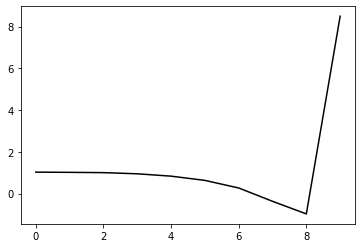

44000 0.27840997626204234
0.27834247985257277 -0.22320400442264837 -0.19613981347188686 -0.1308898282579791
[ 0.98078887  0.943899    0.90861835  0.85700845  0.74808824  0.54848263
  0.18815208 -0.44398768 -1.04158877  8.46726729]


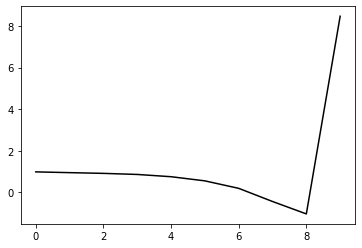

45100 0.1907805226098385
0.28043875874750324 -0.21646531627915408 -0.19136561974399569 -0.13602234715135633
[ 1.03753189  1.06164516  1.02275165  0.9589689   0.84692313  0.64282255
  0.27629228 -0.36316619 -0.96934517  8.49536367]


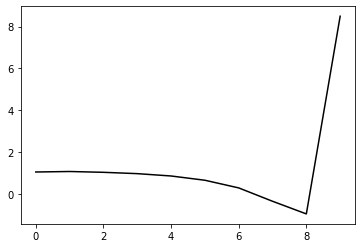

46200 0.17876169409016332
0.2813760450007165 -0.21253359384337997 -0.18891292714774927 -0.13679454259961843
[ 1.04947045  1.10122181  1.08624015  1.02909187  0.91780328  0.71355709
  0.34481308 -0.29837845 -0.90978008  8.4851072 ]


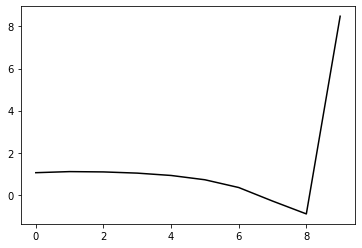

47300 0.17312889635758008
0.27965103305754385 -0.21589640204076013 -0.19158202923904757 -0.13583266942839822
[ 1.0120827   1.02286327  1.00183702  0.96011081  0.86099789  0.66657055
  0.30575349 -0.33051735 -0.93520073  8.5257356 ]


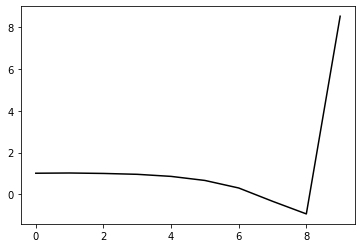

48400 0.2041355620088625
0.272844088493991 -0.2223404938946297 -0.19565157347027362 -0.1345236386732151
[ 1.08197278  0.920263    0.8832159   0.8514374   0.76867343  0.58997812
  0.24374188 -0.37805005 -0.96689273  8.4693242 ]


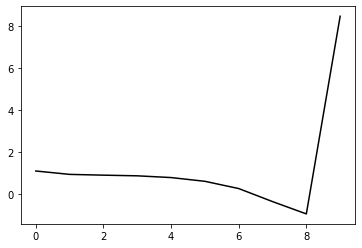

49500 0.216002480316623
0.27247169891889156 -0.22096194194003246 -0.19489264038933335 -0.13308627303172235
[ 1.05170818  0.98395205  0.90238726  0.83804453  0.73745189  0.54438174
  0.18390956 -0.45221125 -1.05590718  8.48210574]


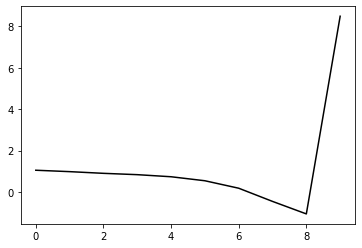

50600 0.1556018966611933
0.2825943077276202 -0.21565642661716886 -0.19282451885084162 -0.13419378427501752
[ 1.03289591  1.06580035  1.0438151   0.97564217  0.87080692  0.67696451
  0.31499091 -0.3236825  -0.93069579  8.45383678]


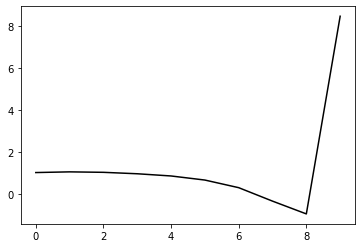

51700 0.1306548567218294
0.2710139259277061 -0.2211876307485492 -0.19527963737709808 -0.13554172439378118
[ 1.06081863  1.00808825  0.94734387  0.89305645  0.79753194  0.61461154
  0.26352234 -0.36481466 -0.96087545  8.50061861]


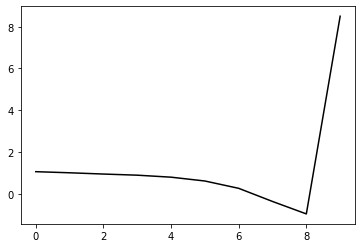

52800 0.1285979204054588
0.27810830129975006 -0.21332771792070843 -0.19069816607569506 -0.1356726606774061
[ 1.04554021  1.05248855  1.02809191  0.96384995  0.85771298  0.66539623
  0.30419245 -0.33663311 -0.94828895  8.49036615]


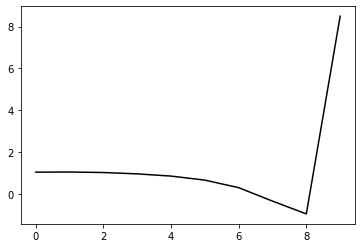

53900 0.18502433101299084
0.28067534744504674 -0.21370149883152703 -0.19190550724103805 -0.13395592156504724
[ 1.03758639  1.01610105  0.99590821  0.93894658  0.83363622  0.64206476
  0.28183379 -0.35907545 -0.97164743  8.50787804]


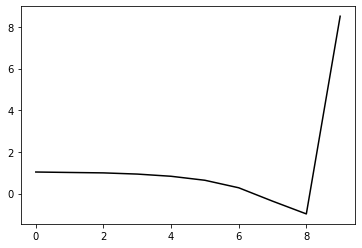

55000 0.20877880165976487
0.2804398172731849 -0.21447695580208112 -0.19258973050768807 -0.13234895401765492
[ 1.02724287  0.98520876  0.9565159   0.89952443  0.79160665  0.59704748
  0.23522336 -0.40697828 -1.02030821  8.47084391]


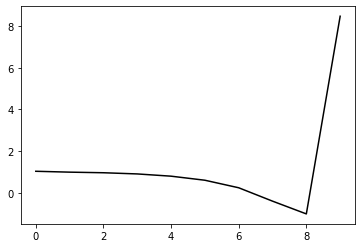

56100 0.1910908002101283
0.28019933577238637 -0.21282813647730478 -0.1910917527660918 -0.13395336895355625
[ 1.04595173  1.03380566  1.00664097  0.95159606  0.84632601  0.65320918
  0.29322043 -0.34736411 -0.95908629  8.4924131 ]


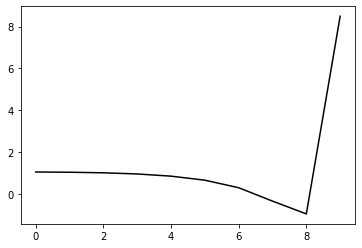

57200 0.17395537336144531
0.27669961529598425 -0.21824507779421146 -0.19472363401792317 -0.13301194974802474
[ 1.00862653  0.99972058  0.96771376  0.92166518  0.82790497  0.64645587
  0.299109   -0.32795938 -0.92434452  8.47830295]


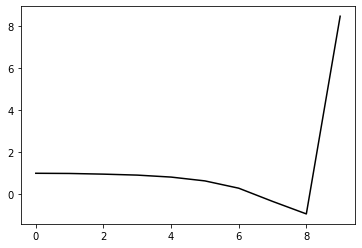

58300 0.21468573957996173
0.2803640250532935 -0.21544835454725822 -0.1935785762938731 -0.13446424553879244
[ 0.97342092  1.04411921  1.02162495  0.97341528  0.87956528  0.69744095
  0.34807633 -0.28299031 -0.88584564  8.53636157]


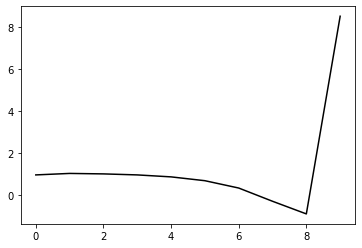

59400 0.25593207215613634
0.2679007470310919 -0.21889095726484487 -0.19385298525708786 -0.13694003718905406
[ 1.13119475  0.92648373  0.87820382  0.84184595  0.76478239  0.59958671
  0.26695323 -0.34724569 -0.93176965  8.47211725]


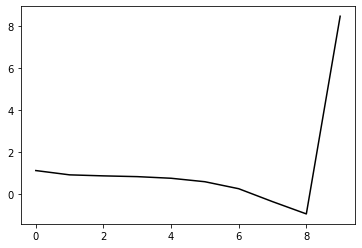

60500 0.21242958104184895
0.2730324297160183 -0.21753437489145389 -0.19403289062838489 -0.13497865823303665
[ 1.08475288  1.06327488  0.98805314  0.91360546  0.81612251  0.63666251
  0.29165115 -0.33419195 -0.93037252  8.51023531]


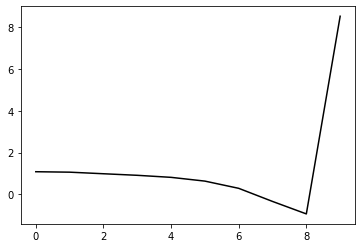

61600 0.15203878833155535
0.2774226205180907 -0.21786282136412455 -0.19521586500047103 -0.13529204018084814
[ 1.04295628  1.14581079  1.12214751  1.05320925  0.95242678  0.77445605
  0.43174795 -0.1927621  -0.78886929  8.49658662]


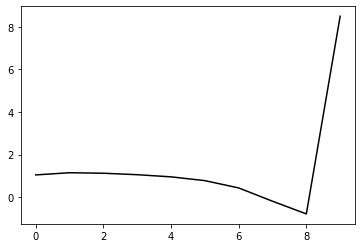

62700 0.1248656187522978
0.276163719651592 -0.2181519567187679 -0.195859804479773 -0.1331126690465853
[ 1.04136852  1.03185951  1.01405087  0.96101233  0.86407152  0.69022285
  0.35281841 -0.26721634 -0.86017382  8.51442612]


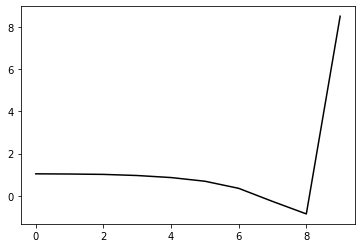

63800 0.12981643736876564
0.2781640195343657 -0.2106257143120807 -0.19062046459105608 -0.1336170936153644
[ 1.05310816  1.08040461  1.03913087  0.96718188  0.85238835  0.66067
  0.30817025 -0.32584853 -0.93269762  8.49217437]


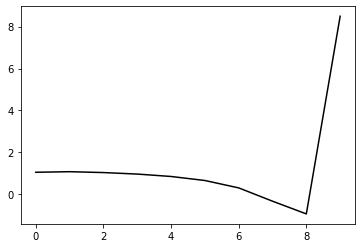

64900 0.20230453367636503
0.28009401628667835 -0.21186587328711354 -0.1925393859601492 -0.13112489818941694
[ 1.00023196  0.97041484  0.95386684  0.89136076  0.78102107  0.59288841
  0.24525745 -0.3836657  -0.98557973  8.5241489 ]


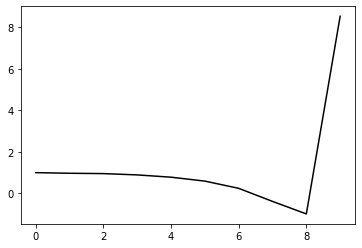

66000 0.31428209406915747
0.2755377839155385 -0.2215749694094786 -0.19988597658701213 -0.12861258103454312
[ 1.00411004  0.97109646  0.94072877  0.89214271  0.79665661  0.62034102
  0.28406378 -0.33422561 -0.92642297  8.46422553]


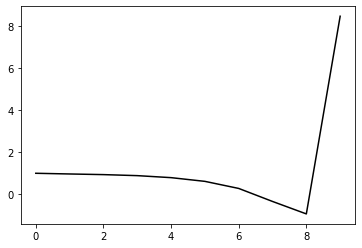

67100 0.1903596959801964
0.2801591253848574 -0.21218894470282257 -0.19345905087164042 -0.1318871275544081
[ 1.06090138  1.10603474  1.04705254  0.97158997  0.85879182  0.66568962
  0.31311591 -0.32167683 -0.93215172  8.49172774]


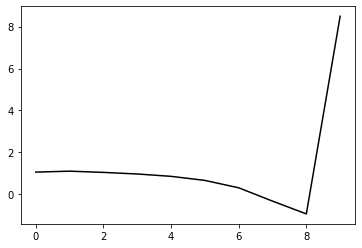

68200 0.18482148830486725
0.27672090885572986 -0.21656946136912655 -0.19692961638020562 -0.1296835713386546
[ 1.02688643  1.00636509  0.9917602   0.93828739  0.83784065  0.65649682
  0.31513429 -0.30880568 -0.90867725  8.46696608]


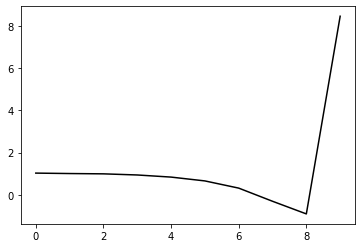

69300 0.18377687812462082
0.28029166787442567 -0.2129215339711763 -0.19512467012330553 -0.13212134115268012
[ 1.00756632  1.08069146  1.06042805  1.00961158  0.9096328   0.72601203
  0.38102876 -0.24817501 -0.85608979  8.53428442]


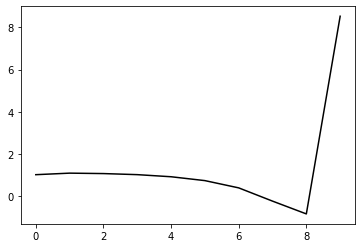

70400 0.18400521428574498
0.27870259599131597 -0.2115642048831858 -0.1944340488280198 -0.12947889048343408
[ 1.04865948  1.04164589  1.01776064  0.96951146  0.87132661  0.68773192
  0.34237647 -0.28730728 -0.89633621  8.46602608]


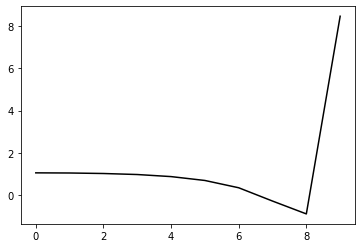

71500 0.2074455305637205
0.27995875353089184 -0.20977264528403786 -0.19361639463679514 -0.13009063423434958
[ 1.03338219  1.0554742   1.04122337  0.99839328  0.90388515  0.72194706
  0.37727324 -0.25215472 -0.86191389  8.53251209]


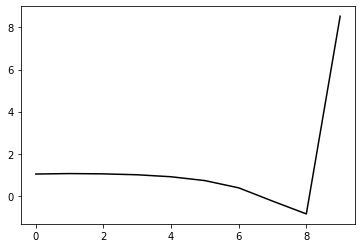

72600 0.19762641709560028
0.271615297867881 -0.2125607684394554 -0.19480058279829995 -0.13064383342381547
[ 1.11079837  0.93775941  0.91537993  0.88212441  0.79899319  0.62684825
  0.29079384 -0.33055927 -0.93296361  8.47598459]


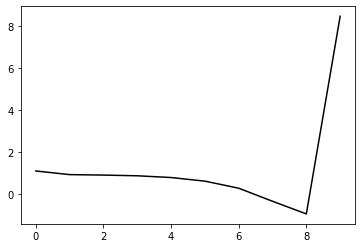

73700 0.11708528059929822
0.2725794660385027 -0.21175104796548555 -0.19453439154180382 -0.13129434599722117
[ 1.0539988   1.07821151  1.03804859  0.99072281  0.90234323  0.72541173
  0.38397914 -0.24290836 -0.85166802  8.51930061]


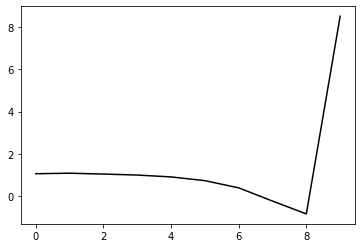

74800 0.12753367282322628
0.26963946789356186 -0.2119397240819944 -0.19432165565801152 -0.13263689035451667
[ 1.05839821  1.09521579  1.01684407  0.94770544  0.8480732   0.6645398
  0.31825347 -0.31190278 -0.92293574  8.49076287]


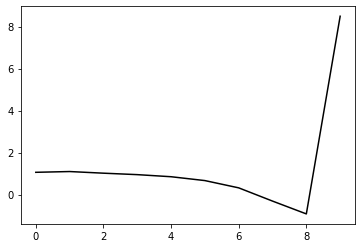

75900 0.19435868104994372
0.27564491327401425 -0.21017592430878398 -0.19444266027594592 -0.13091812098693992
[ 1.02801795  1.0654884   1.02783626  0.95171167  0.84405299  0.65697971
  0.30808872 -0.32434773 -0.93797033  8.49894778]


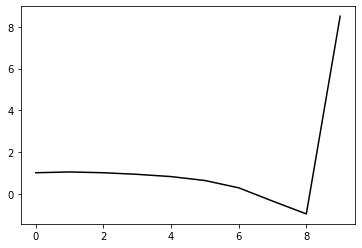

77000 0.20251439927023177
0.2723944531212573 -0.21583810330373324 -0.19855010508008222 -0.1286846328563818
[ 1.04858694  0.92782158  0.9189983   0.8656987   0.76821539  0.59142344
  0.25274767 -0.36993894 -0.97405349  8.46872757]


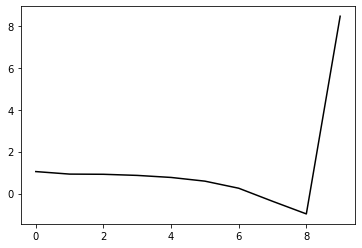

78100 0.18950741997488452
0.27495133006377426 -0.20962991622287425 -0.19476953091410967 -0.12962098169517564
[ 1.05967915  1.1086671   1.05752969  0.99213839  0.88509757  0.69708637
  0.3466697  -0.28939264 -0.91009422  8.52279252]


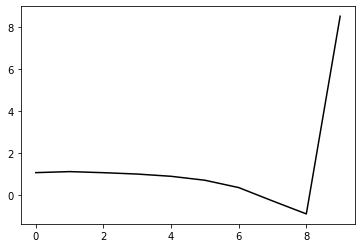

79200 0.17953961559404738
0.2757991494443493 -0.20652049169525613 -0.1925807275156264 -0.132105997189963
[ 1.08267858  1.14215624  1.1334414   1.0769517   0.97131427  0.78415177
  0.43506048 -0.19952451 -0.81902858  8.49178815]


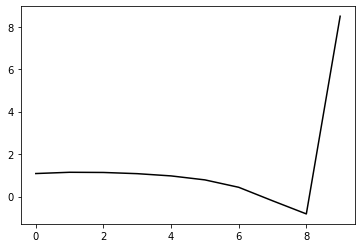

80300 0.17488134153317025
0.27205179152975445 -0.21199281102958725 -0.19711293614034034 -0.12743079242791336
[ 1.08017098  0.9784066   0.95358819  0.92146247  0.83696309  0.66542766
  0.32960391 -0.29365837 -0.9035568   8.51978316]


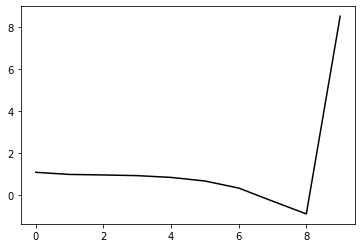

81400 0.20051360183090639
0.2675147820501393 -0.21048708227337193 -0.19525733315011015 -0.13154676517802252
[ 1.11474843  1.04529413  1.03209675  1.00292275  0.92627518  0.76058579
  0.42885143 -0.19172532 -0.80096204  8.4701559 ]


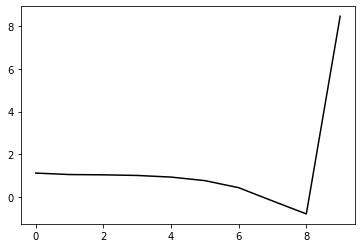

82500 0.2705370477565536
0.26898639497274895 -0.2076055370201329 -0.1934831579611 -0.13182888860007286
[ 1.10039504  1.10335266  1.07285442  1.02207034  0.92977283  0.7502374
  0.40540486 -0.22728681 -0.84836576  8.52008728]


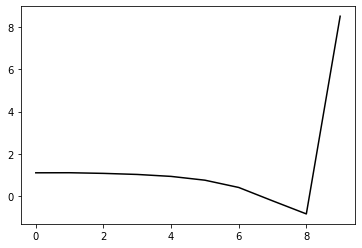

83600 0.176687031515649
0.2714069910270037 -0.21028138493454307 -0.19667772315684584 -0.12831362770228905
[ 1.03397071  1.05469477  1.01952304  0.96763169  0.87560197  0.69868348
  0.35680563 -0.27312989 -0.89257684  8.49829544]


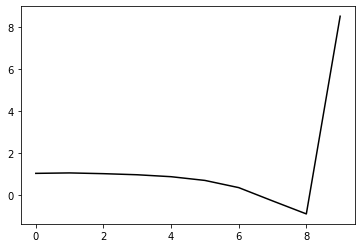

84700 0.14900096289581446
0.26721023539947175 -0.2061508394406896 -0.19287267435567945 -0.13053418660785734
[ 1.08835983  1.00404609  0.98256974  0.93527952  0.84760014  0.67575268
  0.3384768  -0.28758852 -0.90419304  8.51621468]


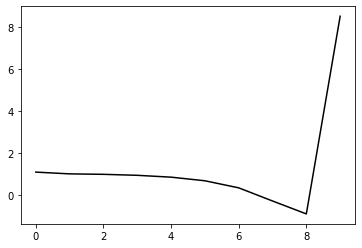

85800 0.19506609160320176
0.2739643153208628 -0.20171686199055527 -0.1908497660478674 -0.1315728544644898
[ 1.09625231  1.0928037   1.09345321  1.04660157  0.95568528  0.7807789
  0.4403056  -0.18942479 -0.81082698  8.49609886]


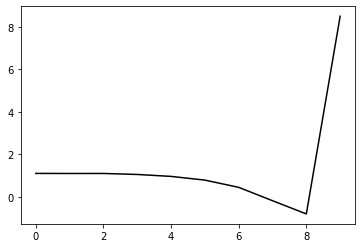

86900 0.19399412795512735
0.2738323999934527 -0.20619358761393353 -0.19459796850022976 -0.12834151348699593
[ 1.03736371  1.07401691  1.03055631  0.97512454  0.87734362  0.69632542
  0.35063079 -0.2838373  -0.90995441  8.49895184]


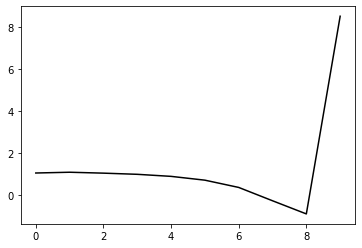

88000 0.23110491902370636
0.27190371121983403 -0.20767035229393294 -0.19526526402766678 -0.12799443436845243
[ 1.08726061  0.91788277  0.90752604  0.85402805  0.75765549  0.57951683
  0.23815679 -0.39062389 -1.00951157  8.47830427]


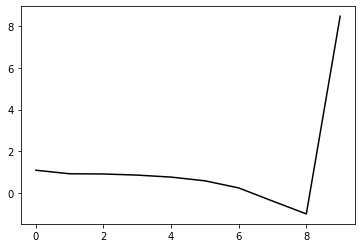

89100 0.21376306659663066
0.2685599092559382 -0.20973834264042676 -0.19631008501683372 -0.12850467899559392
[ 1.09089452  0.93379868  0.91351137  0.8683134   0.77729657  0.60412364
  0.26807    -0.35514322 -0.96824579  8.53607749]


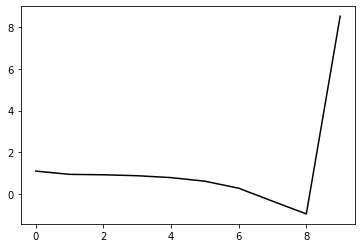

90200 0.184428236990947
0.27249909890050944 -0.20299328042089507 -0.1920195414821584 -0.13111218846163847
[ 1.07584859  1.0796121   1.0525076   1.00320733  0.90922884  0.73233801
  0.39246316 -0.2349584  -0.85341288  8.4963738 ]


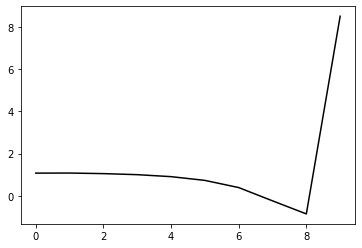

91300 0.17154976005074885
0.2614569964796385 -0.20952743667708124 -0.19540095623957032 -0.1285963403031619
[ 1.05204914  0.84903719  0.7943562   0.74726788  0.65806419  0.48677753
  0.15346961 -0.46643771 -1.0762136   8.49948411]


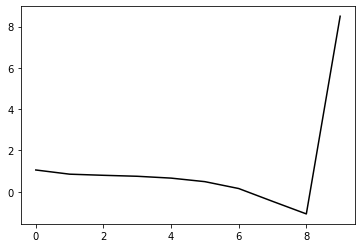

92400 0.16668599672052742
0.27578953731448946 -0.20168550325874865 -0.1923431953064515 -0.13008260871853328
[ 1.06451519  1.15880495  1.1010869   1.03040474  0.92673082  0.74178641
  0.39480575 -0.23906345 -0.86417397  8.46788243]


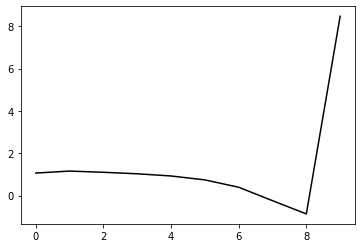

93500 0.2558340036125482
0.2782927152716163 -0.20421899554106726 -0.1947525267573957 -0.1288347722149415
[ 0.99522309  1.12694312  1.11058685  1.044466    0.93849755  0.75438237
  0.41005454 -0.21968935 -0.83944548  8.53577874]


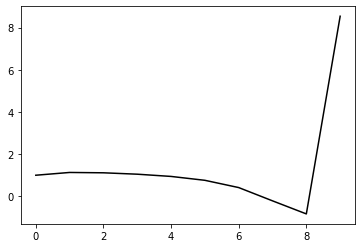

94600 0.19413113961983275
0.2688591488489125 -0.2104162786635494 -0.1976456354785272 -0.1325138445714357
[ 1.09368933  1.08872991  1.08527145  1.05221759  0.97132694  0.81003312
  0.4879309  -0.12041051 -0.71932108  8.51122033]


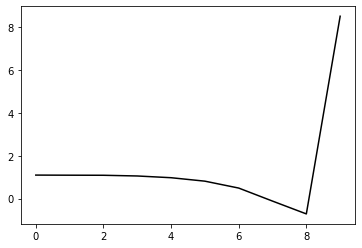

95700 0.12465235977002524
0.2665508817061109 -0.2075698541342351 -0.195330993478292 -0.13025423056460284
[ 1.06494395  1.04779963  0.98606022  0.92075147  0.81504457  0.63138239
  0.29095322 -0.33238351 -0.94446714  8.47887846]


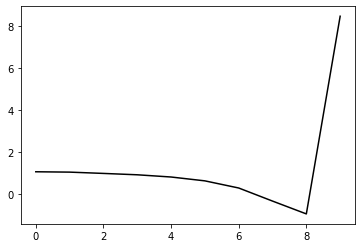

96800 0.1285283007932631
0.27085524256552485 -0.20236571285709684 -0.1923051400045276 -0.13131038680402937
[ 1.05736582  1.08904305  1.07078153  1.00486472  0.89277374  0.70180297
  0.35382975 -0.27715514 -0.89792861  8.49297541]


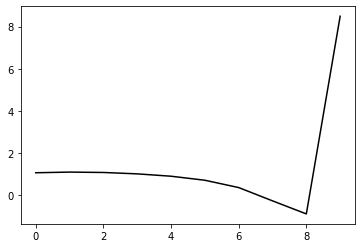

97900 0.19331262028372678
0.26847184670367075 -0.21133936236907708 -0.198690246030461 -0.13090867436944637
[ 1.0243357   0.99237411  0.97793675  0.93422646  0.84204175  0.66959757
  0.34072459 -0.27006392 -0.86915252  8.51946354]


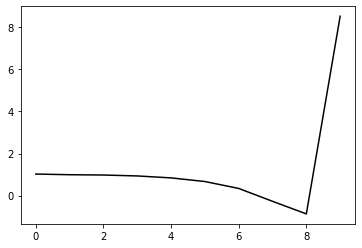

99000 0.3045258996169207
0.270693761387665 -0.2122901987538915 -0.20000202357802405 -0.1300122428680693
[ 0.99818168  1.07048013  1.04304298  0.99364271  0.9012649   0.72815155
  0.39883608 -0.21195689 -0.8114686   8.49974865]


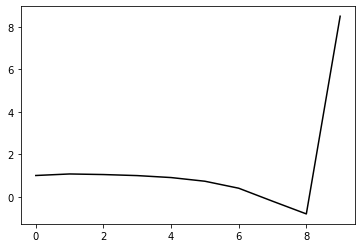

100100 0.19034219606636932
0.2693422064174419 -0.20433642157003018 -0.19427497704858074 -0.1282065100433766
[ 1.06828133  1.0807096   1.02512271  0.94958837  0.83524884  0.64042754
  0.28913792 -0.3437157  -0.96667194  8.50077205]


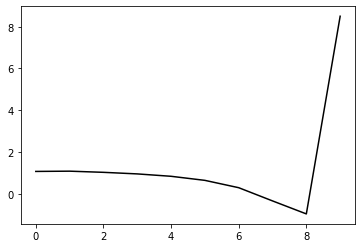

101200 0.18773313451913476
0.26968109427379 -0.2032262438219083 -0.19357167085583538 -0.1312040455036774
[ 1.09355854  1.11758888  1.1130895   1.0606177   0.9582804   0.77397656
  0.43157538 -0.19367226 -0.81080201  8.5042548 ]


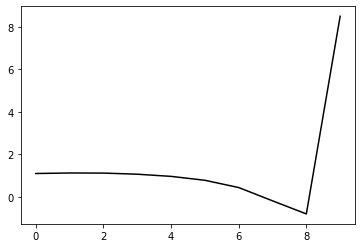

102300 0.16686898692950827
0.2738139404280681 -0.2007865288651991 -0.19312739431904608 -0.1279279935170062
[ 1.02970371  1.09026876  1.06227126  1.00303241  0.89162765  0.69655988
  0.34379728 -0.29106772 -0.91792678  8.53149722]


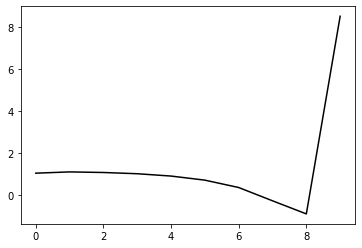

103400 0.16573013417469226
0.2721331419421373 -0.2015255277622324 -0.19347215561869838 -0.1289853918342077
[ 1.07471272  1.13309605  1.11450099  1.06260767  0.95981895  0.77071624
  0.42266549 -0.20778581 -0.83089399  8.47140055]


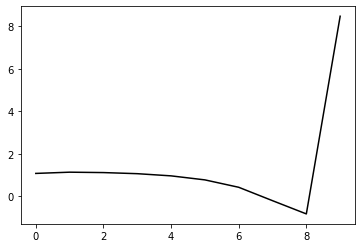

104500 0.28877816711909043
0.2736011517933729 -0.20471168232407366 -0.19650447137261196 -0.12586431444992352
[ 0.99458276  1.05694201  1.04705125  0.9957771   0.89268058  0.70305386
  0.35470528 -0.27483665 -0.89625166  8.53567291]


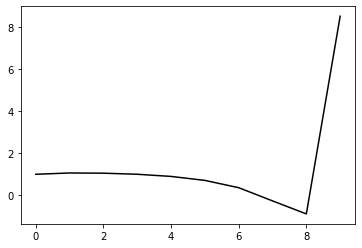

105600 0.16215315029507638
0.2705060626380021 -0.20653474434954947 -0.19711421007827948 -0.12683254373350653
[ 1.07233828  0.97541718  0.97361931  0.93688258  0.84763447  0.67062144
  0.33420673 -0.28288718 -0.89101202  8.46586013]


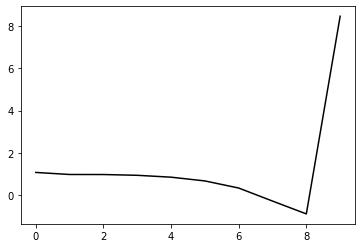

106700 0.1792527509619063
0.27077251048342016 -0.20700513439592957 -0.19750576918790566 -0.1274833002340415
[ 1.00260619  1.01626581  1.00322848  0.9622991   0.87096484  0.69176994
  0.35305591 -0.26570821 -0.87543261  8.52813578]


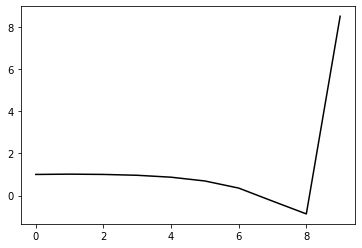

107800 0.1456761006689316
0.2702465449973104 -0.20406559444969116 -0.1956753861165707 -0.1277334243371118
[ 1.05464282  1.07864903  1.04413607  1.00147176  0.91353365  0.73626906
  0.39697876 -0.22457688 -0.84017687  8.50912325]


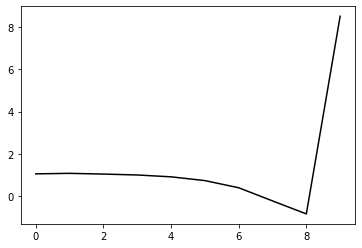

108900 0.20216048867924152
0.2699822406654993 -0.20360296117248558 -0.19585365872382546 -0.127066419969219
[ 1.02047615  0.99243941  0.98287114  0.9414104   0.85482069  0.68008831
  0.34267382 -0.27704725 -0.89084556  8.50984486]


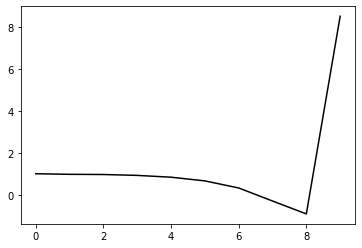

110000 0.21053353747985307
0.2643170449829763 -0.21080817657991402 -0.2005789287178136 -0.1259293395867088
[ 1.05303007  1.00845749  0.97473783  0.93948562  0.86446378  0.70251059
  0.37739271 -0.23015032 -0.83150012  8.5013925 ]


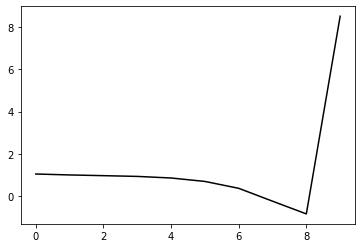

111100 0.19319097800093551
0.2658473429174335 -0.20642389416638413 -0.19775974974867275 -0.12701375810483992
[ 1.08701312  1.08793707  1.05641183  1.00736088  0.92249589  0.7537139
  0.42108473 -0.19510943 -0.80694637  8.50871953]


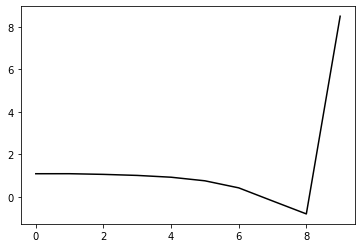

112200 0.21628383754849118
0.2580643574622559 -0.2035245454433343 -0.1941577757035732 -0.13069100909214307
[ 1.11835412  0.9484831   0.93177946  0.89261493  0.81033701  0.64589458
  0.31805108 -0.29349744 -0.90060678  8.46276655]


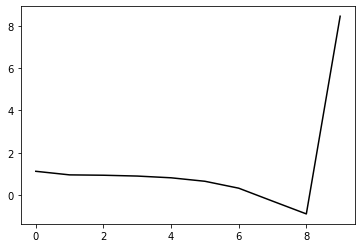

113300 0.17501918812778583
0.272468467949329 -0.2015982439552529 -0.19659067301100616 -0.12294491401100999
[ 1.04073212  1.16898492  1.14058523  1.07733408  0.97149506  0.78195567
  0.42816213 -0.2108035  -0.84781779  8.52658609]


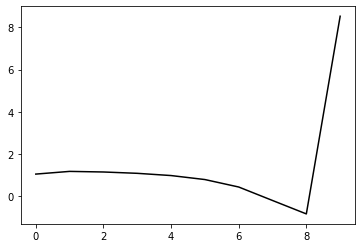

114400 0.16417634857249136
0.2694726753735872 -0.19898745961740552 -0.19408937405939952 -0.12530886575743166
[ 1.08833783  1.15073473  1.12900881  1.0730425   0.97083984  0.78491721
  0.43517011 -0.19974286 -0.83251501  8.47266207]


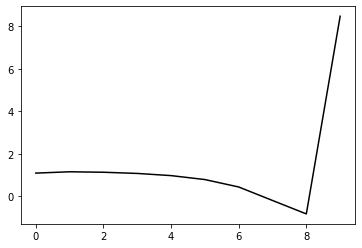

115500 0.19586153158493125
0.26259372134419284 -0.20725220735538363 -0.19921385162441912 -0.12620100045836596
[ 1.06893021  1.08458465  1.06923199  1.0342718   0.95108038  0.78331102
  0.45173386 -0.16540148 -0.78051523  8.5458092 ]


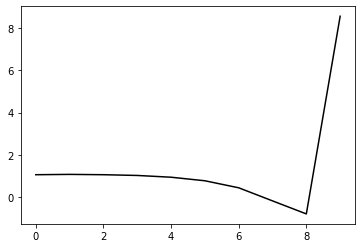

116600 0.22275066449069544
0.2656779798193344 -0.20436696277734592 -0.19806182573159498 -0.12263337189849295
[ 1.03301575  1.05312185  1.01972589  0.97203812  0.87935132  0.70235212
  0.36230069 -0.26299707 -0.886658    8.48906785]


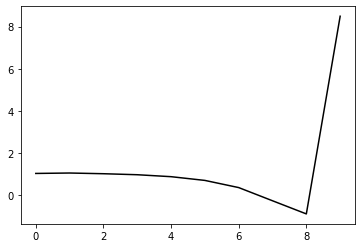

117700 0.12385421428292721
0.2657309680886507 -0.20333814076693973 -0.1974273284744236 -0.12304965570338834
[ 1.06719308  1.138997    1.09339015  1.03505133  0.93790528  0.75745924
  0.41453033 -0.2131644  -0.83893669  8.49716455]


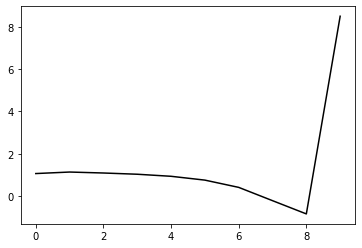

118800 0.13332105199662453
0.2646641825043613 -0.20126708214731587 -0.19589587011978815 -0.12457217229155593
[ 1.10928381  1.08269421  1.08029635  1.03288557  0.94075217  0.765806
  0.42812747 -0.19477939 -0.81627978  8.50085663]


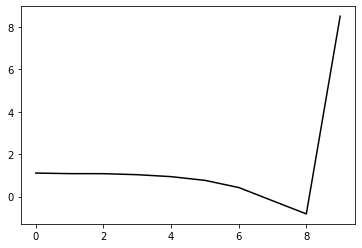

119900 0.2658341085125233
0.26867493523975483 -0.20311116381805494 -0.19855910671720428 -0.1222078039645833
[ 1.01429015  1.08443625  1.09342773  1.05187382  0.95816921  0.78043757
  0.44020609 -0.18520862 -0.80951231  8.52597504]


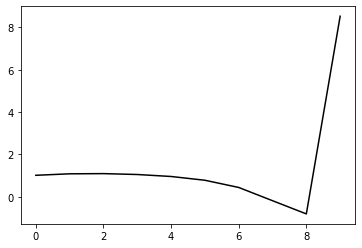

121000 0.20362590515733842
0.2647855034738896 -0.20456054033589352 -0.19884721698062519 -0.12075441669419561
[ 1.05481911  1.03527444  1.01203875  0.96441086  0.86746037  0.68594765
  0.34305308 -0.28380469 -0.90838303  8.53209547]


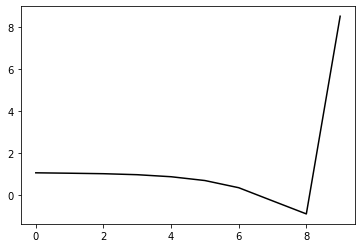

122100 0.19126597431004888
0.26263474567753853 -0.20331968848210283 -0.19763809693235523 -0.12369041755406406
[ 1.09358333  1.12341361  1.10802216  1.06254832  0.96780375  0.78673695
  0.44324682 -0.18502989 -0.81231154  8.51677893]


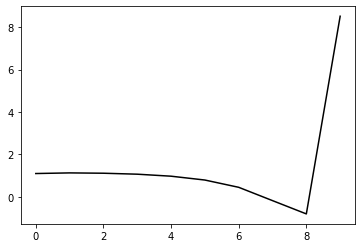

123200 0.3061242096283548
0.2488602980096374 -0.20082209301057724 -0.1929285319710285 -0.13033819178926004
[ 1.15966992  0.9357974   0.92316962  0.89483874  0.8124286   0.6416926
  0.30751404 -0.31183501 -0.93015626  8.48103444]


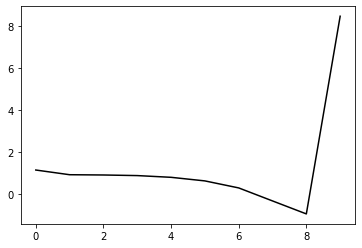

124300 0.219892491054276
0.26310151646067287 -0.2091661464918435 -0.2030017262978415 -0.12272730363849439
[ 1.04832649  1.15590548  1.1269255   1.07967963  0.98888033  0.81051284
  0.46903597 -0.1572873  -0.78300859  8.5499477 ]


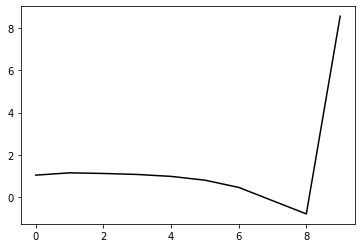

125400 0.18165174540900755
0.2673276580903391 -0.19885916923456787 -0.19606011526746112 -0.1257123282190779
[ 1.11226632  1.19557694  1.21506029  1.1654713   1.06312174  0.87401722
  0.52169375 -0.11569379 -0.75351916  8.48749557]


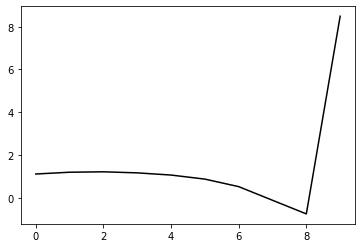

126500 0.18477686540891367
0.2681367599927311 -0.1993735230091557 -0.19679397515629754 -0.12530048243565106
[ 1.07526191  1.19495726  1.22209321  1.18803953  1.091054    0.90449749
  0.55432668 -0.08096931 -0.71690015  8.54964103]


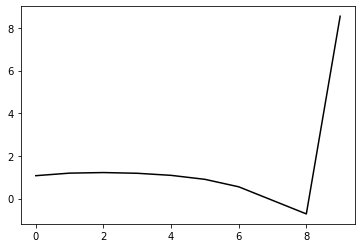

127600 0.16038142577176814
0.2596220638585329 -0.20393909270027513 -0.19844836999748167 -0.12465657394136408
[ 1.07960744  1.09577401  1.07495807  1.03017515  0.92365426  0.72737856
  0.36951222 -0.27107257 -0.90997089  8.49796209]


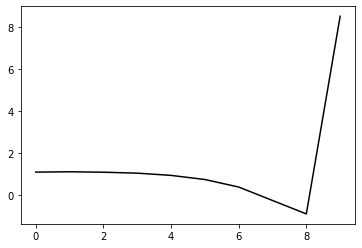

128700 0.12832728480510444
0.26250263323671835 -0.20073751135738743 -0.19676720994441732 -0.125361695353942
[ 1.10746321  1.10895697  1.12670599  1.08730073  0.98417691  0.78833239
  0.42974996 -0.21188672 -0.85237736  8.50125358]


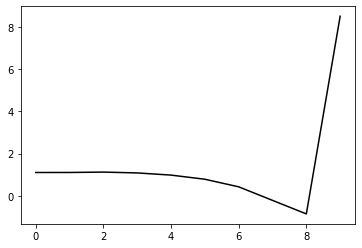

129800 0.12595602974477912
0.2633083381758641 -0.20040177789256253 -0.19676577865083142 -0.12550482797652024
[ 1.09051348  1.12447083  1.14405567  1.11390866  1.01357089  0.81692431
  0.45647006 -0.18684469 -0.82890905  8.50524757]


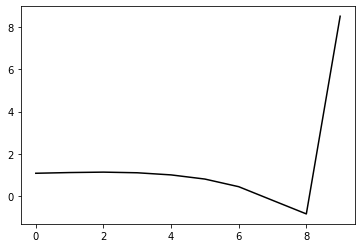

130900 0.19069977968275387
0.2652016004387279 -0.2008480966775259 -0.19783045970141755 -0.12360304564357542
[ 1.07266065  1.09638305  1.10745502  1.08162628  0.98482947  0.78743678
  0.42426633 -0.22216887 -0.8679759   8.52302262]


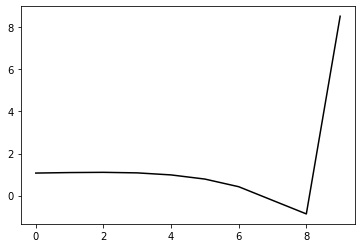

132000 0.20672011405532537
0.2665986805942395 -0.20111610045134623 -0.19850521053368547 -0.12240535686623445
[ 1.06950936  1.09920804  1.10840611  1.08593101  0.9947324   0.79956437
  0.43625165 -0.21061594 -0.8569094   8.49267867]


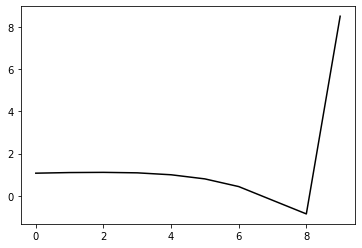

133100 0.19015322714107236
0.26608828684157954 -0.2002847519712849 -0.1978890715889801 -0.12309914566614302
[ 1.09466205  1.09949632  1.10839197  1.09063314  1.00804609  0.81898662
  0.4586563  -0.18615509 -0.83073104  8.51112387]


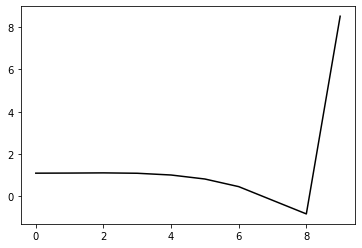

134200 0.15212672943162087
0.26783123460416014 -0.1985675822266174 -0.19717397386309746 -0.12333671600501815
[ 1.07646496  1.18712651  1.19922773  1.18201999  1.10332062  0.91685158
  0.55578441 -0.09122257 -0.73897033  8.49601802]


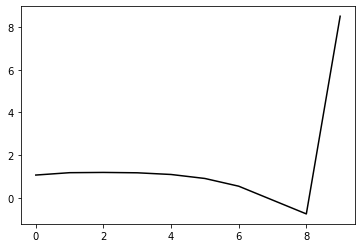

135300 0.16795713223491576
0.2698177774970977 -0.19704396338244332 -0.19662654075559236 -0.12219483641673856
[ 1.05258612  1.15215238  1.16159396  1.1372839   1.05291449  0.8621383
  0.49514946 -0.15818865 -0.81221025  8.53330679]


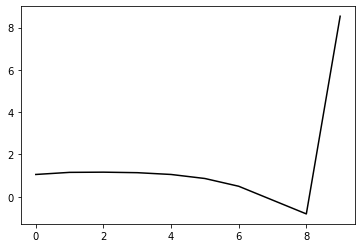

136400 0.1768575729901213
0.268186825978403 -0.1950985833161697 -0.19485470829514576 -0.12383453974077839
[ 1.1029109   1.14629432  1.15014971  1.12890928  1.05285322  0.87087918
  0.51003532 -0.13871046 -0.7882687   8.48152006]


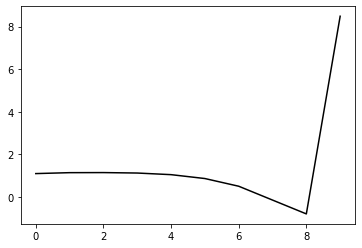

137500 0.19004225925930304
0.2683695369475553 -0.19706232042216604 -0.19629152172413844 -0.12369391835458048
[ 1.07081564  1.140576    1.15548242  1.13752288  1.06791469  0.89467323
  0.54103884 -0.10133618 -0.74346808  8.54351558]


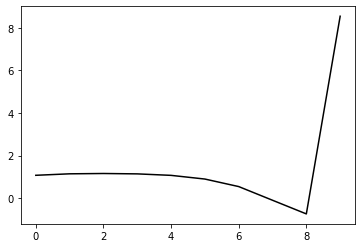

138600 0.1944932678205953
0.2599736070195471 -0.20598497410552116 -0.20153618060107853 -0.12211947653848378
[ 1.0709084   0.99132584  0.95747447  0.94566235  0.88655636  0.72636532
  0.38539001 -0.24485492 -0.87348967  8.49579697]


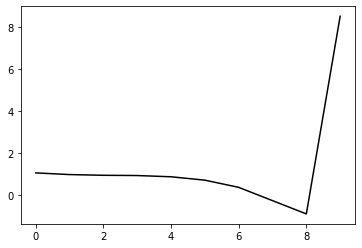

139700 0.1184797820621905
0.2655534697434559 -0.20045950181238179 -0.1985579130312489 -0.12211686579825315
[ 1.08097731  1.17501545  1.13315722  1.08653377  1.00913535  0.83604248
  0.48190129 -0.1628868  -0.80668158  8.50028745]


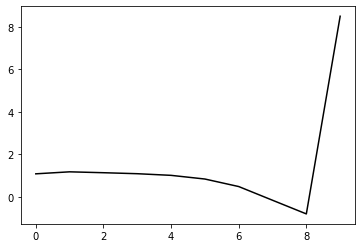

140800 0.12783666227302587
0.2640669715341772 -0.19850193955006862 -0.1969921492080191 -0.12338312314378032
[ 1.11169705  1.12874131  1.13403914  1.09667251  1.0191884   0.85030209
  0.500327   -0.14223473 -0.78456681  8.5077288 ]


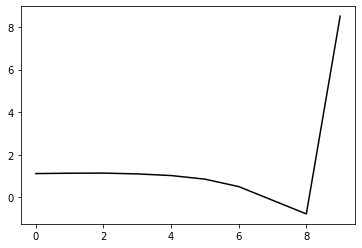

141900 0.17799770703004528
0.25766708942518507 -0.20293077711220125 -0.19951801058284405 -0.11951151487404887
[ 1.07402078  0.98421205  0.97393929  0.93252055  0.84576215  0.67003091
  0.31520547 -0.33238805 -0.97942     8.49425234]


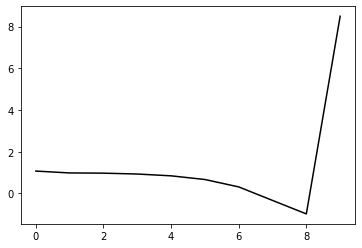

143000 0.21594505747022713
0.25788073101499503 -0.2005835553220574 -0.19803561016254773 -0.11973945643237162
[ 1.08268991  1.07799434  1.01945753  0.96352225  0.86769436  0.68377595
  0.3218828  -0.33307993 -0.98768754  8.47227308]


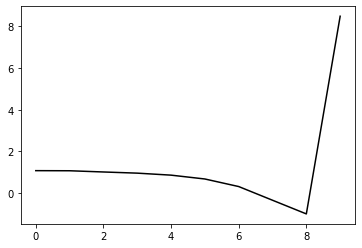

144100 0.25526784398579583
0.2564093248596344 -0.20163190693049224 -0.19862047155729773 -0.12191735420577789
[ 1.15781708  0.97803609  0.97458663  0.92966135  0.84314871  0.669149
  0.31752522 -0.32788588 -0.97254868  8.51354385]


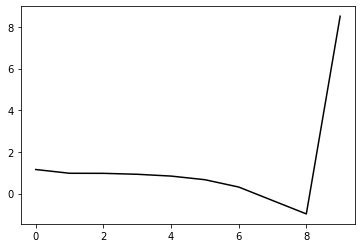

145200 0.1757209201193683
0.26219064970847467 -0.1979115101676899 -0.19703227634566203 -0.12389900250626719
[ 1.09677558  1.21659783  1.20361203  1.15234954  1.05683176  0.87404427
  0.51427645 -0.14016701 -0.79492621  8.48893619]


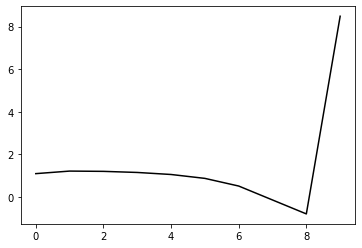

146300 0.17262075519436773
0.26245872934253967 -0.19822657192628013 -0.19744695106379012 -0.12400994602644945
[ 1.07723267  1.14193079  1.15163464  1.11140289  1.01850879  0.83782561
  0.48114761 -0.17087329 -0.82362719  8.52591947]


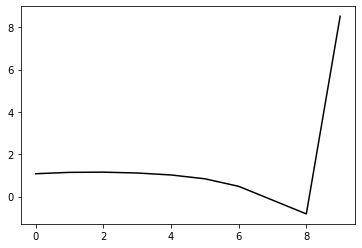

147400 0.19403009379306646
0.25644103709075794 -0.20271785934983372 -0.19946274811645912 -0.12371531224372317
[ 1.1327462   1.03775176  1.03374292  1.00125299  0.91105258  0.73204944
  0.37935192 -0.26724251 -0.91225325  8.48690829]


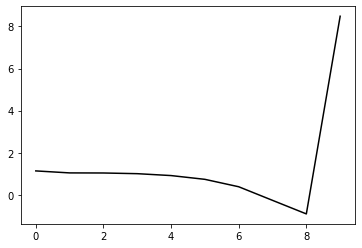

148500 0.27619748712132236
0.26523269436946334 -0.19897250258951218 -0.19893805999371164 -0.12192611652903579
[ 1.02239805  1.13807342  1.14336559  1.09987854  1.00036083  0.810017
  0.44631881 -0.21205019 -0.87049151  8.4915259 ]


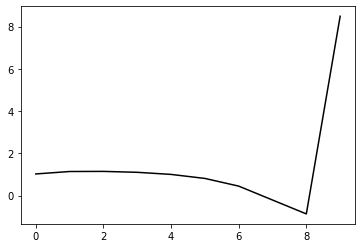

149600 0.18878960708141568
0.2629883406118442 -0.19739592446992416 -0.19708348714609936 -0.12475309454392966
[ 1.10879558  1.13330763  1.15582762  1.12777361  1.03928921  0.85721108
  0.50140888 -0.14942799 -0.80023543  8.52424787]


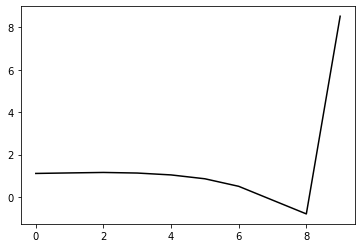

150700 0.122134667591677
0.25784372854654836 -0.20120648193277263 -0.19905297171431252 -0.1253131211132969
[ 1.10109262  1.1129381   1.0892515   1.06183344  0.97791536  0.79897361
  0.44658821 -0.20048528 -0.84691368  8.52333376]


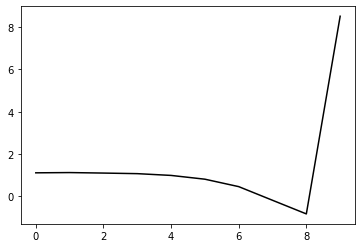

151800 0.13877783698704313
0.2607190142703136 -0.19783685259354086 -0.1971073207341508 -0.12616017453899322
[ 1.11238077  1.12737952  1.12000582  1.08540906  1.00016169  0.81992136
  0.46592793 -0.18285227 -0.83113418  8.51273527]


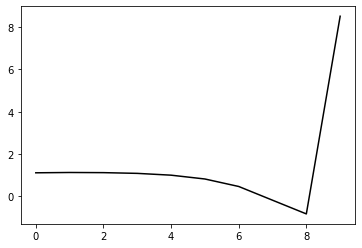

152900 0.19309543899262796
0.2617355915011805 -0.2009315769118433 -0.1999273751324354 -0.12605721029045328
[ 1.07149278  1.13812507  1.10988403  1.06801707  0.98157621  0.80158639
  0.44807401 -0.19997432 -0.84721524  8.5069465 ]


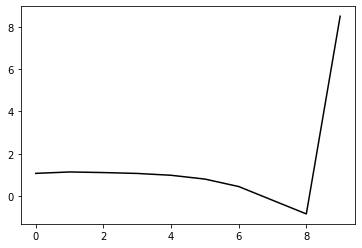

154000 0.19603315041591893
0.2646911919595394 -0.19532950930388063 -0.19665563308735687 -0.1250226786351708
[ 1.07123396  1.16541645  1.14885077  1.09368438  0.99255243  0.80002013
  0.43421478 -0.22646311 -0.88743026  8.47338489]


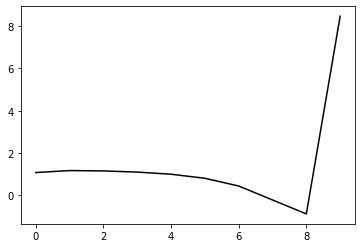

155100 0.2074985652916657
0.2614756531638949 -0.19876828050399595 -0.19887577397383185 -0.12396627321622454
[ 1.11681577  1.05917633  1.0665061   1.03149121  0.94248387  0.76197567
  0.40821679 -0.24054303 -0.88914366  8.49700911]


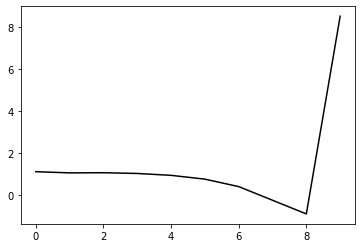

156200 0.3198446228515183
0.24810455450106722 -0.19517323583018886 -0.19329951350543764 -0.12924838504455177
[ 1.16774498  0.89188586  0.87862394  0.85370174  0.77331296  0.59993319
  0.25307582 -0.38896787 -1.03048216  8.4549952 ]


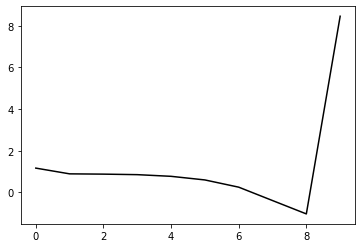

157300 0.1805164178631679
0.2633794363700685 -0.19295894396184063 -0.19585720325148234 -0.12409146833718285
[ 1.09008065  1.15715549  1.10726877  1.05496276  0.95941142  0.77054033
  0.40736822 -0.25243943 -0.91450419  8.52120555]


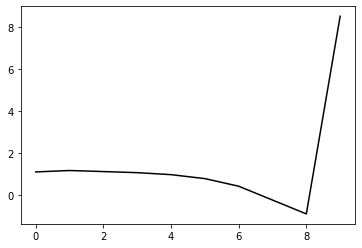

158400 0.16957342364297867
0.2658275748886491 -0.1968772020158447 -0.19976481912543684 -0.12356422570430013
[ 1.08831669  1.1575944   1.1710615   1.1352761   1.05105725  0.87388679
  0.52149032 -0.12828798 -0.78050656  8.49858561]


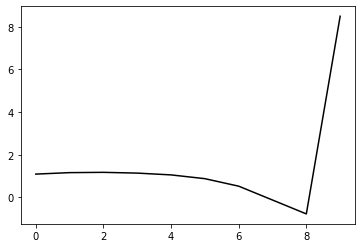

159500 0.35096361805092197
0.26709276717804115 -0.19662904342883875 -0.20025804996456006 -0.12054044983585283
[ 1.00742767  1.0509043   1.06041878  1.02675688  0.9372457   0.75568454
  0.40023336 -0.25173696 -0.90538631  8.54603788]


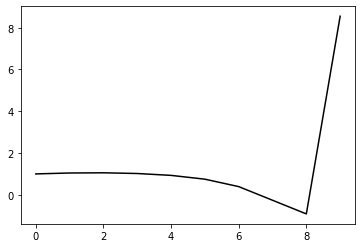

160600 0.16335471121845915
0.2581388858743434 -0.19809045665549493 -0.19913907690998253 -0.12396195915251394
[ 1.10874973  1.07013979  1.01237698  0.97175901  0.88707225  0.7095706
  0.3583142  -0.28906651 -0.93696725  8.47177767]


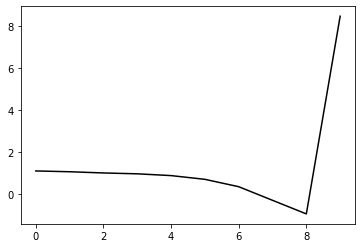

161700 0.11746142053839101
0.26640895360580313 -0.1944711309562921 -0.1980143782420027 -0.12603521622787506
[ 1.08262903  1.19081032  1.20203105  1.15344793  1.06073411  0.87780764
  0.52146854 -0.13099139 -0.78429257  8.5308071 ]


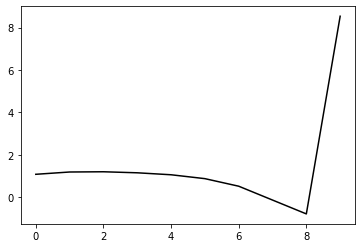

162800 0.15523162484322944
0.2585582109133611 -0.20384051374649398 -0.20393951477472483 -0.12212011664176109
[ 1.0765396   1.03953754  1.0047052   0.96849003  0.88544124  0.7128018
  0.36726946 -0.27414513 -0.91560063  8.48088701]


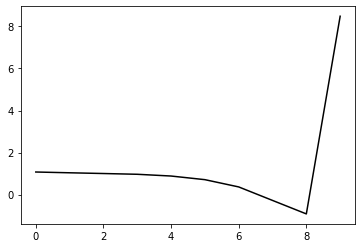

163900 0.18065004127633483
0.2600954770719193 -0.1982569452231944 -0.20003894358709862 -0.1227706555233074
[ 1.06834175  1.05869374  1.00760829  0.94139543  0.83709474  0.64512685
  0.2814967  -0.37692377 -1.0343792   8.50031204]


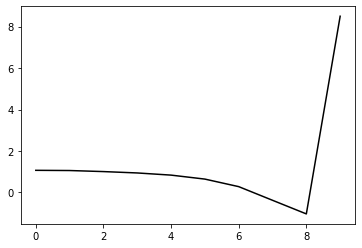

165000 0.20622586653471953
0.26438995317079295 -0.19681711602222202 -0.20006692283632077 -0.12275774808602445
[ 1.06858697  1.16922185  1.1247345   1.04693778  0.9321256   0.73183197
  0.36043916 -0.30604258 -0.97246949  8.47828343]


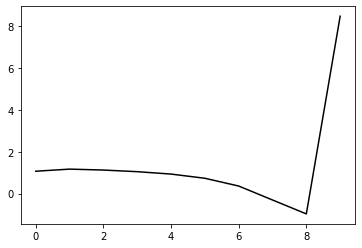

166100 0.19305265817413236
0.26411407334560255 -0.19576661421149502 -0.1994135934424769 -0.1235004015198995
[ 1.10720061  1.1094296   1.11479337  1.05628602  0.94613748  0.7504857
  0.38373207 -0.27909027 -0.94303986  8.48980672]


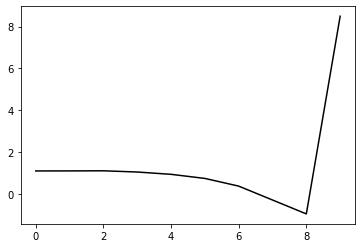

167200 0.17928147143965104
0.26302791648010604 -0.1964843488952956 -0.19987728571170332 -0.12441834349187468
[ 1.09105756  1.10751193  1.12730907  1.09097785  0.98944337  0.79899613
  0.43775194 -0.21957183 -0.87794339  8.49352998]


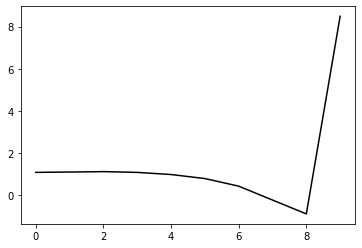

168300 0.17081354190886916
0.258906886617334 -0.19930914490380217 -0.20129665827753154 -0.12235094514124903
[ 1.09039217  1.05111153  1.03947999  0.99800849  0.89055797  0.69213078
  0.32417072 -0.33876553 -1.00211255  8.50535388]


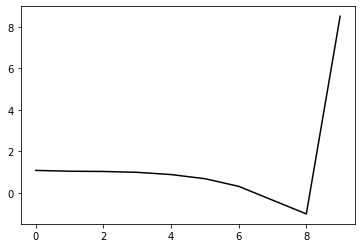

169400 0.1563507514075369
0.26510551768301205 -0.19489599127766927 -0.1989310288930879 -0.12603336847095178
[ 1.09293029  1.18771996  1.19138157  1.14545834  1.03563776  0.8323431
  0.45973498 -0.20733672 -0.87479637  8.45961495]


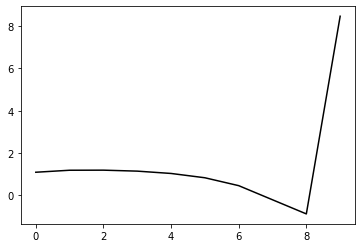

170500 0.21324896073837807
0.26012038431600276 -0.2003618091566988 -0.20244184715174918 -0.12356585543849637
[ 1.07948739  1.07315457  1.06023229  1.02203278  0.91721336  0.71677066
  0.34722928 -0.31572311 -0.97777792  8.50143634]


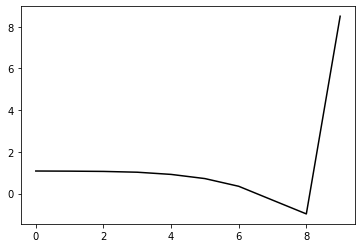

171600 0.18316780704184332
0.26647769859227133 -0.1955260689670248 -0.19988744575230138 -0.12715933876345462
[ 1.11039394  1.11733838  1.13941031  1.10439365  1.00358436  0.80443528
  0.43505653 -0.22795439 -0.8904933   8.46149578]


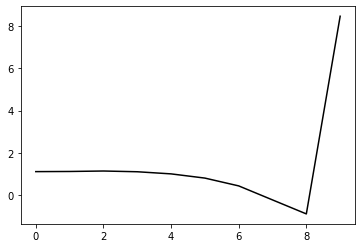

172700 0.13013426942390666
0.2623520360958881 -0.19713236037761883 -0.20017768683911688 -0.1274287782929688
[ 1.11277763  1.0774537   1.09313898  1.06700422  0.97144297  0.77507104
  0.40793578 -0.25172342 -0.90963879  8.51122365]


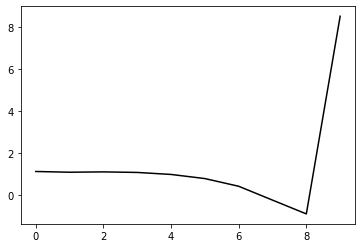

173800 0.1270400663900411
0.26374926239155416 -0.19472350289242718 -0.1986403913720886 -0.12788752613393842
[ 1.09063646  1.10050524  1.10720413  1.08049863  0.98510435  0.78582185
  0.4138954  -0.25083062 -0.91456721  8.48787467]


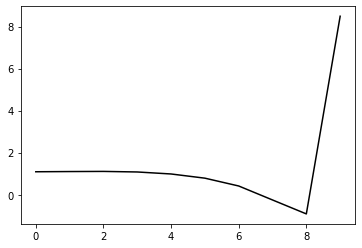

174900 0.18653682177473319
0.26726261537693136 -0.1959242557782156 -0.20045169582270578 -0.12627516023929866
[ 1.08970976  1.05816317  1.0829212   1.06414308  0.97858125  0.78665004
  0.41955973 -0.2407296  -0.90003244  8.5144433 ]


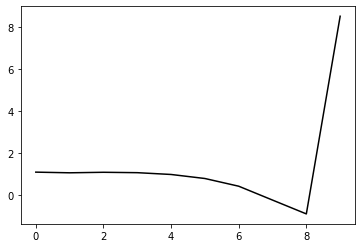

176000 0.20779808623008145
0.26778616710699965 -0.19573574247765166 -0.20061676196699382 -0.12506172686950276
[ 1.06593439  1.09810215  1.10166688  1.07864564  0.99000473  0.79354502
  0.41972509 -0.24788246 -0.91527512  8.46940187]


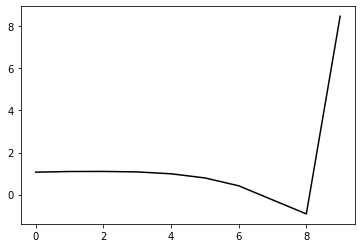

177100 0.1910340051280169
0.2658463846683795 -0.1962265751118286 -0.20067644368504767 -0.12592047423165992
[ 1.09222471  1.05355406  1.06761466  1.05567907  0.97999032  0.79543516
  0.43071126 -0.22902503 -0.88896391  8.49943512]


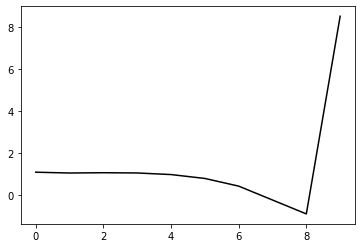

178200 0.16605821694319797
0.26691306678298066 -0.19427423064464058 -0.19958261904232247 -0.12707335261741454
[ 1.08514754  1.15780381  1.16430696  1.15194626  1.08133979  0.90111592
  0.53777657 -0.12237421 -0.78403609  8.49686273]


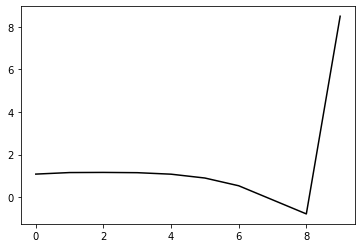

179300 0.17690508043396422
0.27008893141297285 -0.1933073931407752 -0.19991089025822645 -0.12517178401657705
[ 1.05054892  1.16989667  1.17374416  1.15137365  1.07552639  0.89197916
  0.52323427 -0.14401072 -0.81422713  8.53577629]


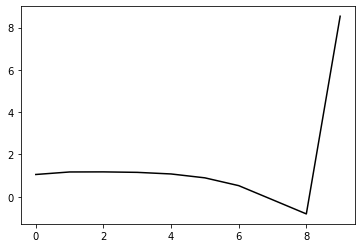

180400 0.16298607681741906
0.26748466663837245 -0.19367919538332914 -0.19957617467921585 -0.1256698241121137
[ 1.08551202  1.12682072  1.12078876  1.09524057  1.02052223  0.84156583
  0.47703144 -0.18623703 -0.85139102  8.46122844]


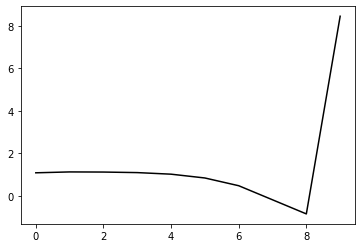

181500 0.22825909150960794
0.25556431473404395 -0.19420498529006744 -0.19759509128885097 -0.1252477323670712
[ 1.10254354  0.955451    0.89778395  0.85924217  0.77693405  0.59403577
  0.22665725 -0.43887384 -1.10500425  8.4800736 ]


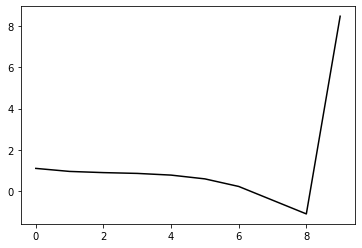

182600 0.14706579465862998
0.26942758532312316 -0.19099644245768763 -0.19836381763039226 -0.1260495198171457
[ 1.06026166  1.16507389  1.13866429  1.09087793  1.00546577  0.82149209
  0.45232213 -0.2163151  -0.88648782  8.47788735]


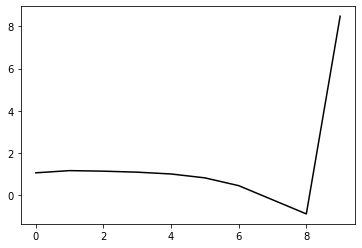

183700 0.1622759980542312
0.26264212571662754 -0.19977361526216347 -0.20406415227220415 -0.12349608033445782
[ 1.05458082  1.09071495  1.05185491  1.00917471  0.92764028  0.75071755
  0.38867269 -0.27382701 -0.9378445   8.50320019]


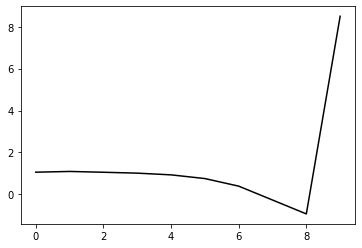

184800 0.15735467769375885
0.2639246643972727 -0.1981032223547771 -0.20314362877474273 -0.12367755442166864
[ 1.08195431  1.06620682  1.04011862  0.98798611  0.90067531  0.72331581
  0.36279973 -0.29842794 -0.96073469  8.48992154]


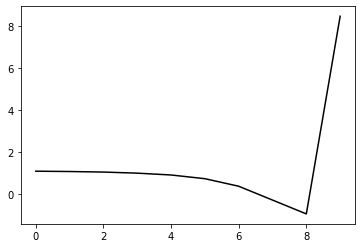

185900 0.1919259634904605
0.2649852373653036 -0.19311881999553973 -0.19978512055682987 -0.1252910320565601
[ 1.10454338  1.1082493   1.10003784  1.03925142  0.93833749  0.75142899
  0.38364044 -0.28609694 -0.9582278   8.50790508]


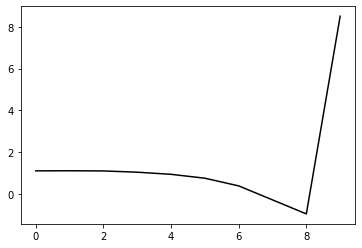

187000 0.21395231630776093
0.26418058386125337 -0.19926146651452953 -0.2048902117518855 -0.12084501301361521
[ 1.07050915  1.02524542  1.0481005   1.0045301   0.90301344  0.71356087
  0.34432698 -0.32749387 -1.0019091   8.47384526]


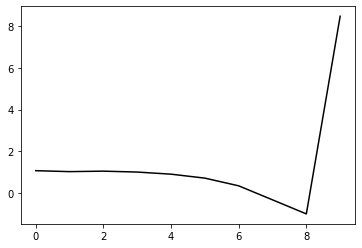

188100 0.20109038988387706
0.2604939643241313 -0.19921488126702425 -0.20423672766076026 -0.12291490549010194
[ 1.12079766  1.08191719  1.08367076  1.05203141  0.95975542  0.77556498
  0.41204716 -0.25500689 -0.92562177  8.51586576]


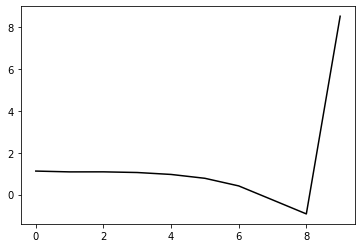

189200 0.16722206863541117
0.2595633474467062 -0.20015461789854797 -0.20501508300959542 -0.12338380255342786
[ 1.09487646  1.13983811  1.13849408  1.11412844  1.03265684  0.85554204
  0.49847543 -0.16378415 -0.83153803  8.46405653]


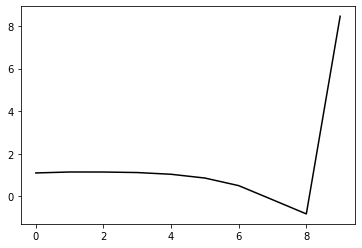

190300 0.1658680788331711
0.26396742712436594 -0.19639590356870879 -0.2034066987897189 -0.1217358300488624
[ 1.10205262  1.14988252  1.14787764  1.10041295  1.00033178  0.80599496
  0.43388083 -0.24214849 -0.9235354   8.5009151 ]


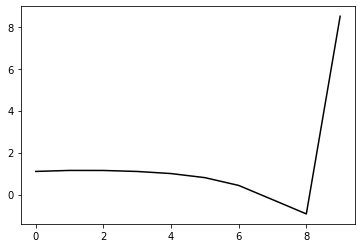

191400 0.1900851683248722
0.25893778358399927 -0.19909047990885034 -0.20490012771844865 -0.12196883961135926
[ 1.11951317  1.08646671  1.08431482  1.06078765  0.97841162  0.798516
  0.43912669 -0.22574968 -0.89725     8.4869687 ]


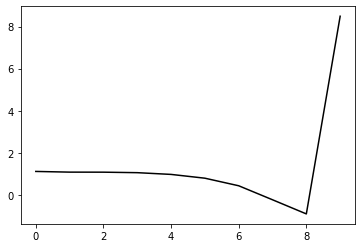

192500 0.19171806437410546
0.2626950047130695 -0.19405981417958562 -0.20190290262175226 -0.12356906564331827
[ 1.11273976  1.16100375  1.17562123  1.14908909  1.06331097  0.8780187
  0.51215593 -0.16007445 -0.84036002  8.54060607]


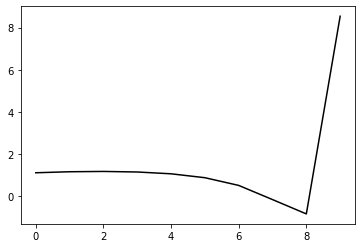

193600 0.15710958249888757
0.26649681355006866 -0.19081570858113397 -0.20083549866588665 -0.12182946987973274
[ 1.07485193  1.18869551  1.19982747  1.17018625  1.08097454  0.89071546
  0.51877879 -0.16055766 -0.84957906  8.49571842]


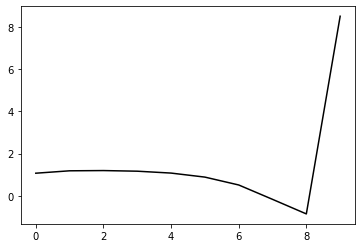

194700 0.20765831758822312
0.26124447853286187 -0.1976033799572044 -0.20547009065464672 -0.11652576288512376
[ 1.07364908  1.09670472  1.06146939  1.03330663  0.95094093  0.76665305
  0.3999906  -0.27409477 -0.95744835  8.4939428 ]


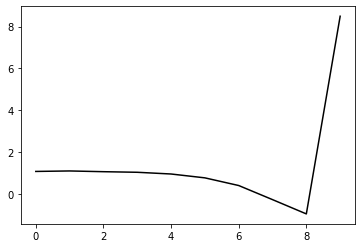

195800 0.18929874962157295
0.2617994808079691 -0.1999930554898339 -0.2076933953951405 -0.11561941667791935
[ 1.10079658  1.03322307  1.02719141  0.99473341  0.916125    0.7369559
  0.37449852 -0.2957589  -0.97517929  8.46779914]


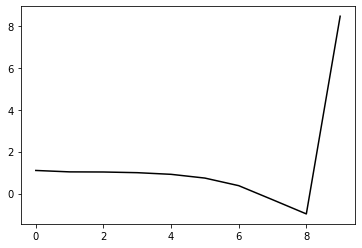

196900 0.19448125743133698
0.2620114567784449 -0.1934799373097971 -0.20223663841566866 -0.12268089512559026
[ 1.12158388  1.17716567  1.17101045  1.13512248  1.05536822  0.8768065
  0.51408465 -0.15716052 -0.83807192  8.51513373]


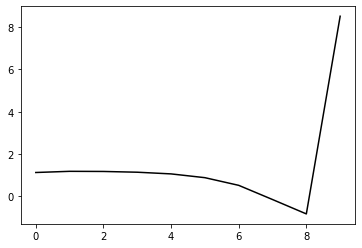

198000 0.20327197475822656
0.2617467966467583 -0.19646194263947137 -0.2051824579381511 -0.11750276060979112
[ 1.10717228  1.04876258  1.06825977  1.03713895  0.95320192  0.77231274
  0.407702   -0.26551646 -0.94841728  8.49100945]


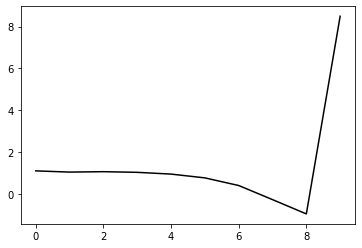

199100 0.2689566168232777
0.25894619987612827 -0.19322704854982278 -0.20213594282577144 -0.12118374633251734
[ 1.18385876  1.08670183  1.09674411  1.07574225  1.00049745  0.82719634
  0.46953936 -0.19795254 -0.8763395   8.53498314]


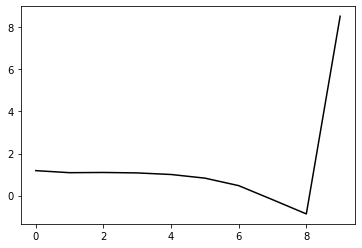

200200 0.17871864259120995
0.26500763668885174 -0.1877014848404745 -0.19921584057145617 -0.1203674945230649
[ 1.11315533  1.2392971   1.2273139   1.17568765  1.0756811   0.88046983
  0.50348321 -0.18163295 -0.87679924  8.48812323]


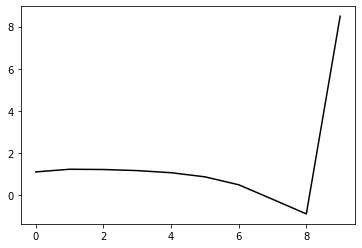

201300 0.17294702074426144
0.2642804896537463 -0.18866825839788368 -0.19977640433564334 -0.121142427261399
[ 1.1019503   1.14705629  1.15706012  1.11813538  1.02256921  0.83195452
  0.45996317 -0.22047454 -0.91124592  8.514389  ]


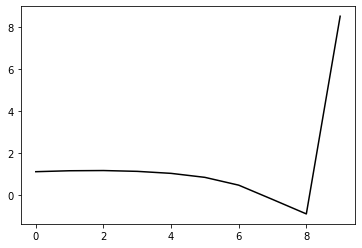

202400 0.2631747739751905
0.26398519975997115 -0.18720718731098415 -0.19849205217393862 -0.12279448407121152
[ 1.1663841   1.14983751  1.17570972  1.15069836  1.06382148  0.87928162
  0.51338537 -0.16115998 -0.84615654  8.48369061]


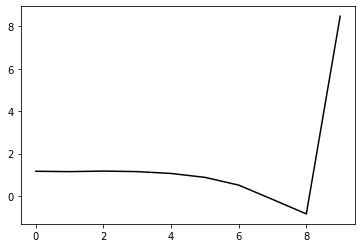

203500 0.2171490042179874
0.2546121328772946 -0.19815503265778828 -0.20542565603364538 -0.11883699599661562
[ 1.12337607  1.06763102  1.02847568  0.99655636  0.90839849  0.72265035
  0.35710268 -0.31556461 -0.99715786  8.49870757]


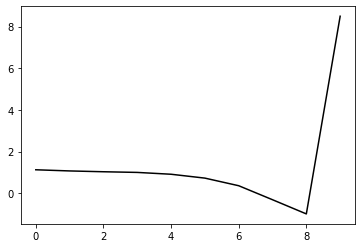

204600 0.18691406942207467
0.2609472572645006 -0.1901245902439393 -0.20050226622611833 -0.1218533746329846
[ 1.1391717   1.17658637  1.14114148  1.08471817  0.9818092   0.78265596
  0.40414324 -0.28124013 -0.97613418  8.47304568]


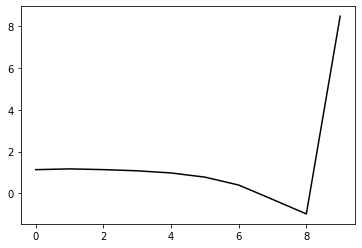

205700 0.1334125415385648
0.26278359646869015 -0.18970744853961605 -0.20052459401843847 -0.12193222530432264
[ 1.13476827  1.14099467  1.15631487  1.10592092  1.00020637  0.80042752
  0.42220016 -0.26225865 -0.95578371  8.50667403]


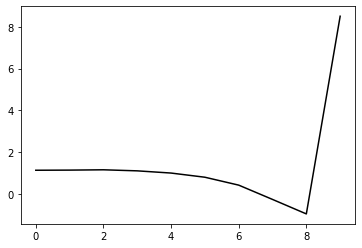

206800 0.129110083277395
0.26396862154247436 -0.19110026874439262 -0.20184629738989965 -0.12246285536592895
[ 1.11134286  1.15284772  1.17837458  1.14902143  1.05008356  0.85351811
  0.47829999 -0.20321832 -0.89392275  8.48283596]


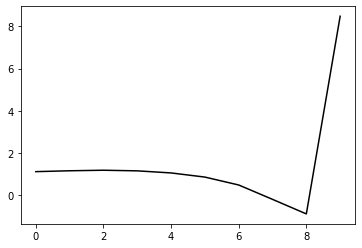

207900 0.1929306306729543
0.2665859794775321 -0.19033058558224922 -0.2018732780257281 -0.12148332999204707
[ 1.09006806  1.13022712  1.15851437  1.1354003   1.0378345   0.83775461
  0.45853717 -0.22692873 -0.92221102  8.50828923]


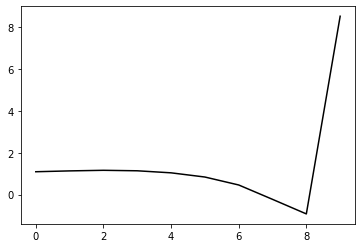

209000 0.21316277387173227
0.26651230306842993 -0.19335423209483865 -0.20423522225022886 -0.12021867558659631
[ 1.08504141  1.12209103  1.14047214  1.12664641  1.03991235  0.84592195
  0.47142754 -0.20905041 -0.89895639  8.48392583]


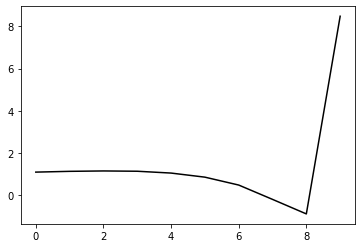

210100 0.24913936006721443
0.2590810739381221 -0.19281858276828598 -0.20222290934297285 -0.12018395295570201
[ 1.16584377  0.92843181  0.93002525  0.9109456   0.8256879   0.63215844
  0.25756793 -0.42198297 -1.10957297  8.48344056]


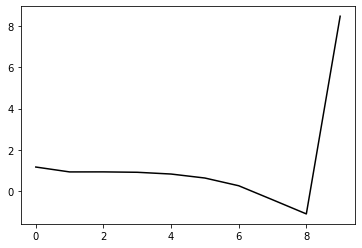

211200 0.16855110542533738
0.26655669432231444 -0.18898793201377137 -0.20097966771801024 -0.12208792779917861
[ 1.10098738  1.24937674  1.22312588  1.18030265  1.08404061  0.87947137
  0.49194195 -0.20128308 -0.90398628  8.47243592]


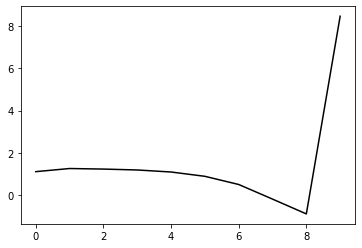

212300 0.16520935190575178
0.26795534132533716 -0.18990285716838148 -0.20203904378736526 -0.12228626353506564
[ 1.07446812  1.20595685  1.22417097  1.19024394  1.09607948  0.89535516
  0.51008662 -0.18128912 -0.88214714  8.52495467]


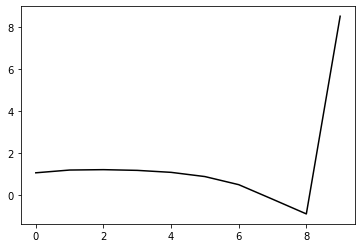

213400 0.16312823123774287
0.26799111382836255 -0.1895471208119001 -0.2018712465981535 -0.12251550538679563
[ 1.10403297  1.20271436  1.22822297  1.20406112  1.11655806  0.92148196
  0.53988295 -0.14899907 -0.84797398  8.47087897]


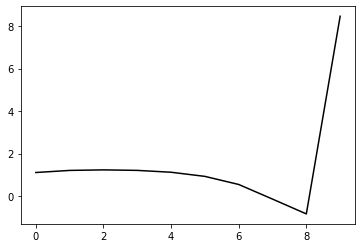

214500 0.20980484165517888
0.26039601188231487 -0.19469458785698934 -0.204351164721134 -0.12096942280185456
[ 1.09691443  1.14209064  1.1299917   1.10068427  1.00821336  0.80900433
  0.42416403 -0.26657645 -0.96550195  8.50100919]


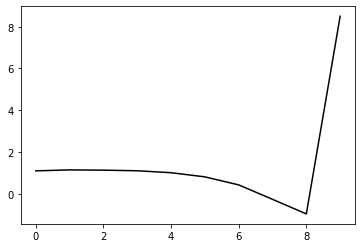

215600 0.32276029299240855
0.26876307321415027 -0.19266137246586126 -0.2046516820324495 -0.12181109562674963
[ 1.03338098  1.25943345  1.28644442  1.25478672  1.15887057  0.95549192
  0.5653667  -0.13147463 -0.83737244  8.49771614]


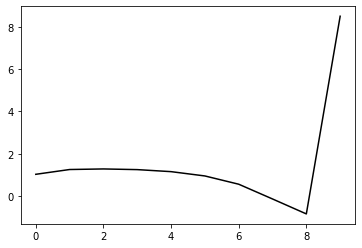

216700 0.1411551270934175
0.25635216998703875 -0.19371980726268492 -0.20305668797404702 -0.1215546537503516
[ 1.11418252  1.09434369  1.05761184  1.01783357  0.91758208  0.71069956
  0.31763261 -0.38136647 -1.0881138   8.48256527]


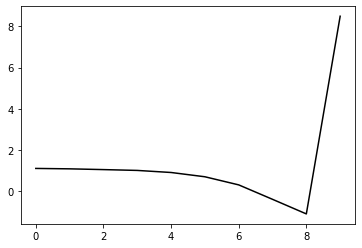

217800 0.17731083425351443
0.263478658410258 -0.1866022547082213 -0.1991252947692747 -0.1252554539892039
[ 1.14671756  1.17591744  1.2064503   1.16600443  1.06493921  0.85686069
  0.46111219 -0.24183811 -0.95368349  8.47028474]


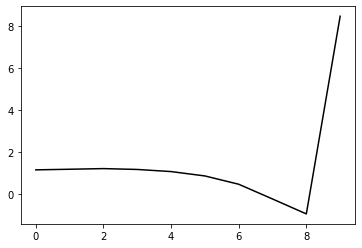

218900 0.18416097109717328
0.26254894369750315 -0.19330611135477502 -0.2041746764611633 -0.12165407192257004
[ 1.09606847  1.08119748  1.09678207  1.06507976  0.9682821   0.76461333
  0.37343672 -0.32447469 -1.02987309  8.48817602]


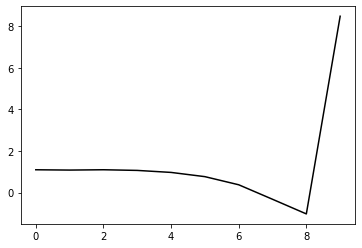

220000 0.2025724773751982
0.2638492201147429 -0.1889735717299948 -0.20134117257131284 -0.12331840777731236
[ 1.08664776  1.1932579   1.19961366  1.1628022   1.05992937  0.84831915
  0.44776297 -0.26104577 -0.97907211  8.47934092]


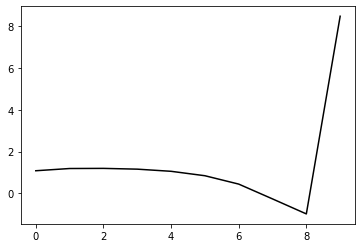

221100 0.19163367462527936
0.2622361369419031 -0.19117023533349034 -0.20304389192821465 -0.12253840171125319
[ 1.11533455  1.13044883  1.15903977  1.14330569  1.05611256  0.85762416
  0.46826954 -0.23080561 -0.93961179  8.50603948]


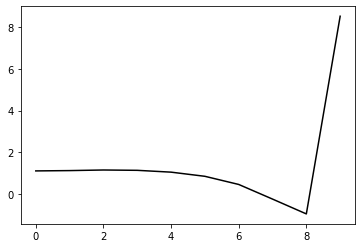

222200 0.1603182046925639
0.2620700477955699 -0.1909307729785208 -0.20316912343197263 -0.12350722877980738
[ 1.11137128  1.16463904  1.20815899  1.21772489  1.15064753  0.96726885
  0.5893393  -0.10128599 -0.80388205  8.48078571]


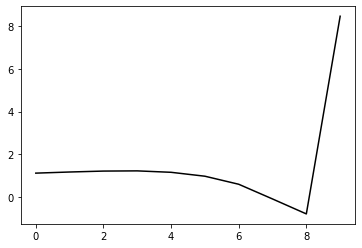

223300 0.15494981090730306
0.26128097120163213 -0.19390334310849905 -0.20566937931109644 -0.11988342495087645
[ 1.09706609  1.09240907  1.08924206  1.08610912  1.01985169  0.83706657
  0.45881112 -0.23266645 -0.93620033  8.50990177]


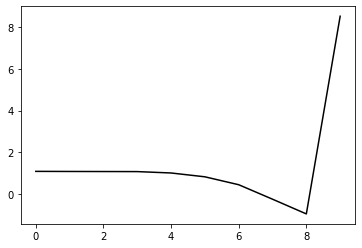

224400 0.16946798921388284
0.263975447501674 -0.18557788545638865 -0.20017619356080665 -0.12235911597417588
[ 1.12173465  1.20109776  1.19375289  1.16912761  1.0936678   0.90399562
  0.51681194 -0.18545357 -0.90153897  8.4335622 ]


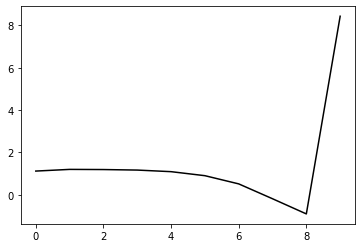

225500 0.2461557587872137
0.265109816423858 -0.18938042269094368 -0.20318915440745866 -0.12151683640822071
[ 1.04938224  1.14023663  1.15701493  1.13415673  1.06067633  0.87745898
  0.49655304 -0.19987422 -0.90931431  8.51579248]


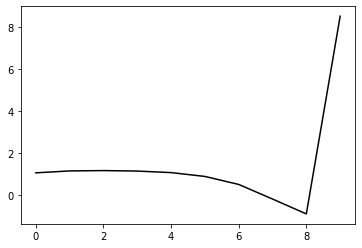

226600 0.15879686816658092
0.2637136738010636 -0.189082984910039 -0.2025922956899121 -0.12191264543240714
[ 1.1259817   1.07283158  1.10605988  1.0916124   1.02130649  0.84330228
  0.46711002 -0.22612959 -0.93294519  8.47809695]


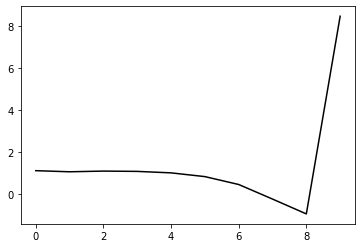

227700 0.13390773255898475
0.259278672836065 -0.18897938019565907 -0.2013528672280849 -0.12324763130687431
[ 1.12912835  1.05853438  1.07171021  1.06007901  0.99058316  0.81479516
  0.44171598 -0.24882376 -0.95240152  8.49813354]


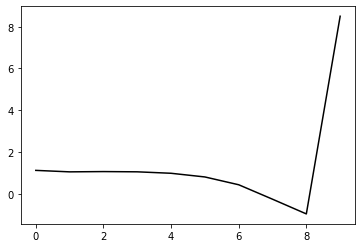

228800 0.13221107970130858
0.26275227891202674 -0.1881555326022983 -0.20139264060210277 -0.12347222014451208
[ 1.0952075   1.12791018  1.13717644  1.11925713  1.04644835  0.86812882
  0.49298267 -0.20044583 -0.90726696  8.48005379]


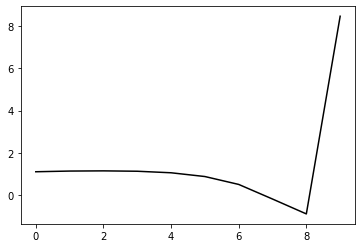

229900 0.18387331536121354
0.2605164322195288 -0.19158679944781348 -0.20356756510618915 -0.12279951521473598
[ 1.08694886  1.00374475  1.01901467  1.01061227  0.94744964  0.77995608
  0.41613514 -0.2666584  -0.96229348  8.510773  ]


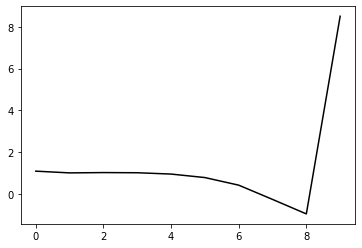

231000 0.21484434777896574
0.2623594946130127 -0.19279368554969065 -0.20503586262752924 -0.1220700971296256
[ 1.07482508  1.14615426  1.11161969  1.08379257  1.01305227  0.83936217
  0.46963666 -0.21993864 -0.92329447  8.48426154]


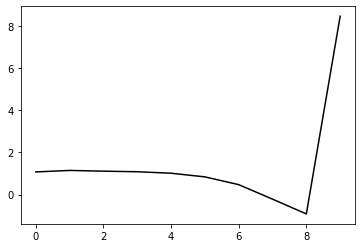

232100 0.21147102002947696
0.25656930612687423 -0.19270614653040868 -0.20392183522276078 -0.12024062787068347
[ 1.11605195  1.01905298  0.99793971  0.95755642  0.87723236  0.69798015
  0.32397269 -0.36980048 -1.07703083  8.46424069]


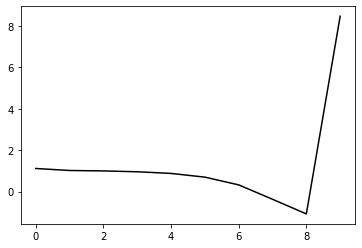

233200 0.1887157514702551
0.25435813723236605 -0.19531529867669697 -0.20541762981689224 -0.1232518022867648
[ 1.1212268   1.08772059  1.05600045  1.01962553  0.94372376  0.77080011
  0.40354769 -0.28396794 -0.9846629   8.50823009]


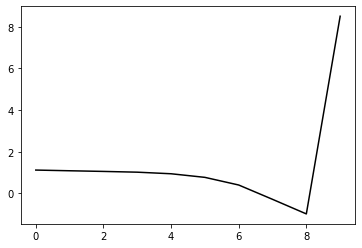

234300 0.16097394345012964
0.2589756236336975 -0.19513225645639987 -0.2063353909712391 -0.12315447537059951
[ 1.1022046   1.10601289  1.09784526  1.06526842  0.99390038  0.82782978
  0.46781695 -0.2138735  -0.91001908  8.47735409]


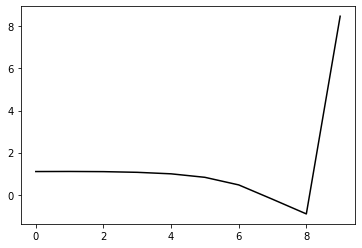

235400 0.19789924267173264
0.26035796276188283 -0.19268088198393335 -0.20508047152931352 -0.12090623246193662
[ 1.10045869  1.05353522  1.03092507  0.97584904  0.87978176  0.69537987
  0.32211766 -0.37103884 -1.07776374  8.46903337]


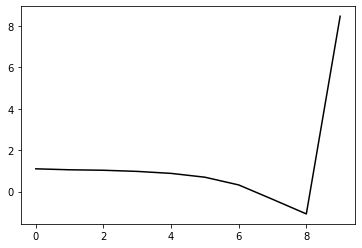

236500 0.24397314658409572
0.2633166544996869 -0.18982702302304758 -0.2034537106858402 -0.12284273512209007
[ 1.04529383  1.11278022  1.12877191  1.08246846  0.98192281  0.79241075
  0.416298   -0.27995837 -0.99055276  8.49443859]


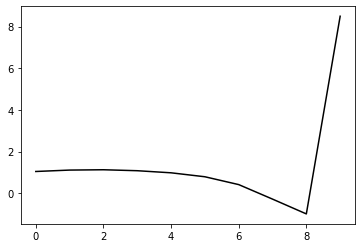

237600 0.17647068442797523
0.2639065115358802 -0.18754989862568633 -0.20161169992864167 -0.12488765132579391
[ 1.1097255   1.1655423   1.19303388  1.16272236  1.06909015  0.88173092
  0.50855382 -0.18529309 -0.89439261  8.48749312]


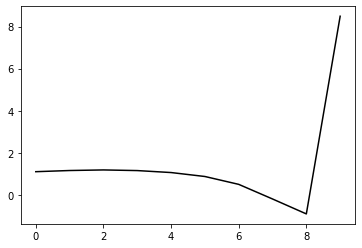

238700 0.11494665032034522
0.2597361832259364 -0.19239905106669958 -0.20443858797755288 -0.12672834296352645
[ 1.10359879  1.18235058  1.19243195  1.18098149  1.10688642  0.93421787
  0.57556047 -0.10427549 -0.79991652  8.52163002]


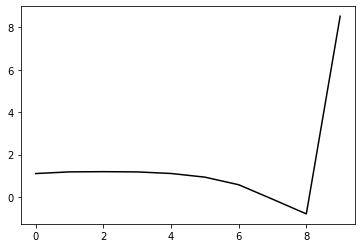

239800 0.13066457471065898
0.25875476490709337 -0.1913497531840895 -0.20372526978861163 -0.1262697539547618
[ 1.1265949   1.17595719  1.17536615  1.15474816  1.08042029  0.90568473
  0.54444284 -0.13841917 -0.83850882  8.51472757]


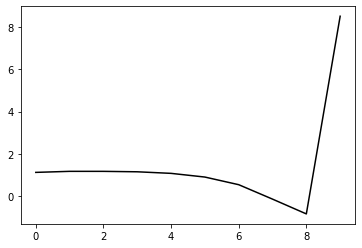

240900 0.19066352414907875
0.26236049711305826 -0.18750967441405492 -0.20174080528587368 -0.12300118696538748
[ 1.06222928  1.09149109  1.06837576  1.01253047  0.91032256  0.71452941
  0.33714541 -0.35794518 -1.0680443   8.5065764 ]


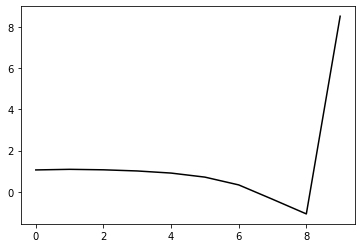

242000 0.217407360597275
0.2623509229188434 -0.19179136925221066 -0.20523935621721204 -0.12113177919634828
[ 1.05476461  1.04071391  1.04788547  1.00989765  0.91664034  0.72866228
  0.35820085 -0.33071951 -1.0356252   8.46444351]


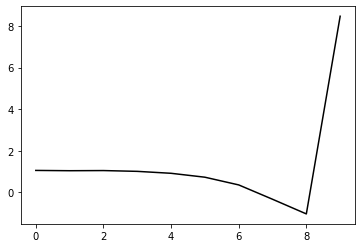

243100 0.19447746285335987
0.2598620529912135 -0.1915766181052481 -0.20442000061423812 -0.12502733561359392
[ 1.11263658  1.08379619  1.08962534  1.0657947   0.98625151  0.80947911
  0.44906276 -0.23076166 -0.92774857  8.49078707]


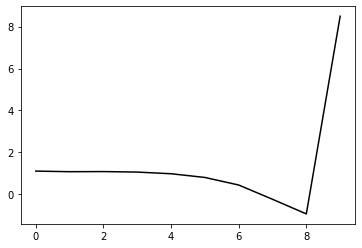

244200 0.18498907217650817
0.25198616717690897 -0.1948722794228668 -0.2054298857620091 -0.12314273420189469
[ 1.09767531  1.02535433  1.01273169  0.97973695  0.89142386  0.70660726
  0.33936879 -0.34609915 -1.04826224  8.46974944]


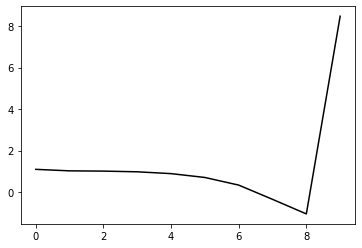

245300 0.17187270118374084
0.25959328408889015 -0.18936661932243634 -0.2028106127324984 -0.12630382096337978
[ 1.07457175  1.15223856  1.14511167  1.10303397  1.00817004  0.81654909
  0.44238037 -0.25028216 -0.96099715  8.52646952]


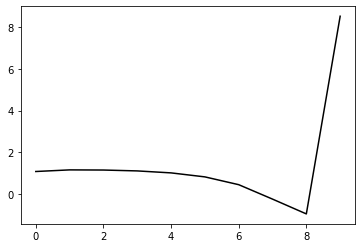

246400 0.19616735599224439
0.2524419560562411 -0.19226626109515732 -0.20415873585664635 -0.12422242391090176
[ 1.08961483  1.03030825  1.01065188  0.97852672  0.88982143  0.70325472
  0.33343919 -0.35531021 -1.06276852  8.45183516]


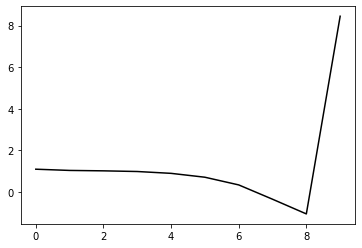

247500 0.19869018022861937
0.2567786233888923 -0.19101128288254465 -0.20395818088427314 -0.12583020175041207
[ 1.11357904  1.09519759  1.09280305  1.06075601  0.97583809  0.79253342
  0.42564743 -0.26003153 -0.96448478  8.4978712 ]


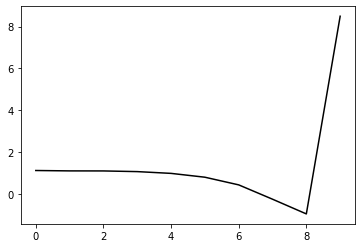

248600 0.1924189719168072
0.2620856248000707 -0.18648962542514091 -0.20172456048122647 -0.126362535657777
[ 1.11579024  1.16036433  1.18261529  1.14873927  1.05784308  0.86849875
  0.4953789  -0.19672645 -0.90886378  8.45793442]


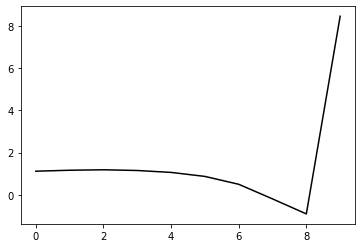

249700 0.1287831247763636
0.256939334596101 -0.19026363816907763 -0.20357588506473007 -0.12649741863501265
[ 1.11920241  1.08408558  1.09998215  1.08302105  1.00380135  0.82430739
  0.4604755  -0.22260292 -0.9263232   8.50791476]


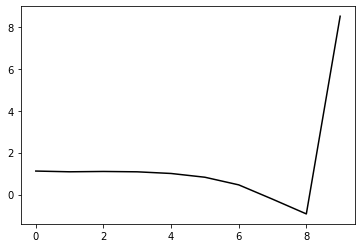

250800 0.12946319609950505
0.2579138654074115 -0.18960748178698167 -0.203200922484483 -0.1270575024970468
[ 1.11375831  1.10905589  1.1234409   1.10785053  1.03208626  0.85458164
  0.49226393 -0.18920856 -0.89180403  8.49777746]


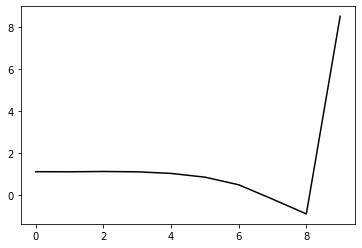

251900 0.19500703580939505
0.2614884888978313 -0.1881034267339015 -0.20313854631742376 -0.12433029160289844
[ 1.06543926  1.09882318  1.09683572  1.0698458   0.98498073  0.79815096
  0.42602809 -0.26568313 -0.98047194  8.4952658 ]


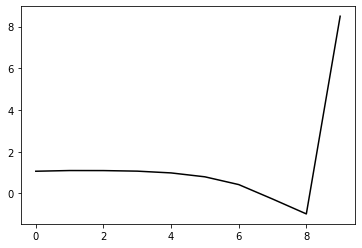

253000 0.20157320311268628
0.2612611776617043 -0.19168429509086993 -0.20610825257222187 -0.12236228259936022
[ 1.07686509  0.97791051  0.99549956  0.9812612   0.91020854  0.73649045
  0.37624075 -0.30402545 -1.00759286  8.468167  ]


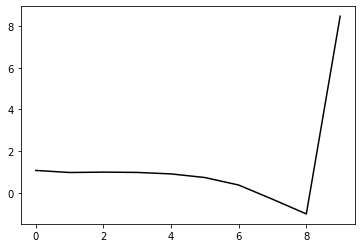

254100 0.19182918413311212
0.2587411469568747 -0.18961448077351867 -0.20432711226655476 -0.12350876965292047
[ 1.1070846   1.11282197  1.08288628  1.05917986  0.98849578  0.81470184
  0.45232689 -0.23185873 -0.94201456  8.50874369]


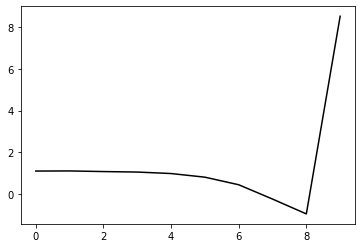

255200 0.18232967010483245
0.2550407014595436 -0.19379551141149456 -0.20725312659041242 -0.12237321519073535
[ 1.09379347  1.01481664  1.00769325  0.99913024  0.94590623  0.79128927
  0.44665625 -0.22063693 -0.91393203  8.49832079]


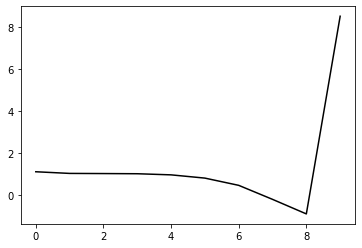

256300 0.1759115449675982
0.2615163545667288 -0.18370060593366125 -0.20114071740962972 -0.123418656850371
[ 1.09373907  1.15847107  1.12249203  1.07828526  1.00121403  0.82719663
  0.46331209 -0.22427117 -0.94051743  8.50587779]


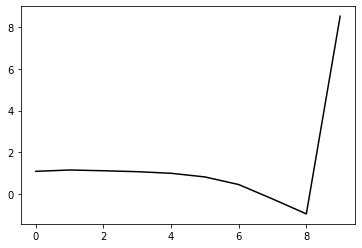

257400 0.19252465836148147
0.25443803505310336 -0.19066180065864508 -0.20495844556567186 -0.12465503171390958
[ 1.1610842   1.08695165  1.07454561  1.04345259  0.9770254   0.81809408
  0.47017817 -0.20128846 -0.90044819  8.4869782 ]


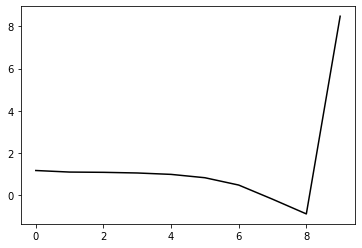

258500 0.19050263925948918
0.2615774387907554 -0.18688057460937352 -0.2040204989363859 -0.12333378966020866
[ 1.08732437  1.24112483  1.25358144  1.21802902  1.14083177  0.97329617
  0.61709108 -0.0646927  -0.77768528  8.52823507]


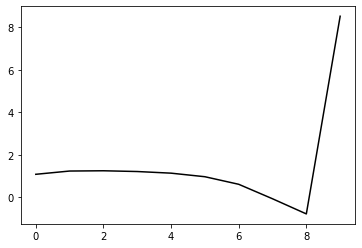

259600 0.24382303965839075
0.26170919236448037 -0.18917960326496755 -0.20593543901758868 -0.12197108439278107
[ 1.0554557   1.1759951   1.18595513  1.16103571  1.08622234  0.92090242
  0.56800576 -0.11096071 -0.82212671  8.50784323]


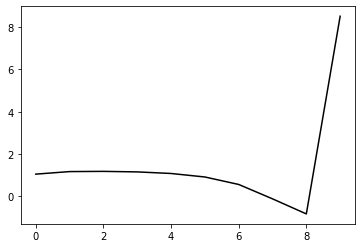

260700 0.16548594937959282
0.2551171501843698 -0.19330476683788997 -0.20814118382896066 -0.11924892490757408
[ 1.08589227  1.09684164  1.05974288  1.02812141  0.95091361  0.78341064
  0.43036022 -0.24794706 -0.95806659  8.48088288]


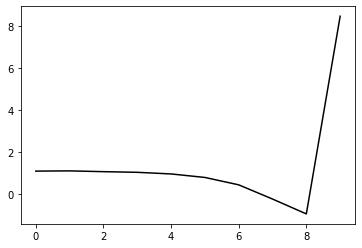

261800 0.1495744570574415
0.2536653817727266 -0.18683698591826983 -0.2028752323961259 -0.1221363445710468
[ 1.0845669   1.053496    1.01415014  0.96379856  0.8763799   0.70072061
  0.34102595 -0.34378239 -1.06146523  8.45895607]


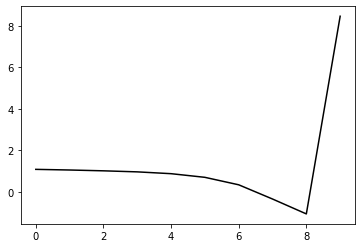

262900 0.18873214181920103
0.25928321869023246 -0.18510326830155416 -0.20253909701342546 -0.12234961187623197
[ 1.11569536  1.13444999  1.12071608  1.06692999  0.97618993  0.79922426
  0.43936742 -0.24547824 -0.96371768  8.50544504]


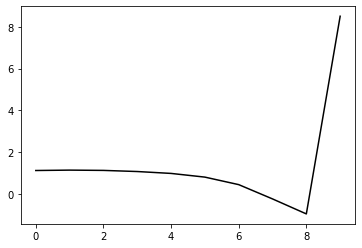

264000 0.3612253996327679
0.2584571030419959 -0.19217348381493726 -0.2085705922118431 -0.1170263424093994
[ 1.04306736  1.04753829  1.05601877  1.01718452  0.92934108  0.75597254
  0.40141909 -0.27762049 -0.99029813  8.46432767]


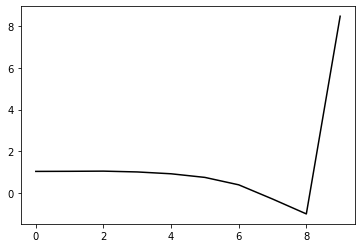

265100 0.19131049921279406
0.25476180221802475 -0.18626850673338313 -0.20343913888737578 -0.1206631850110814
[ 1.1145657   1.14792619  1.10450951  1.05155153  0.95291618  0.76750887
  0.40147152 -0.28952141 -1.01610562  8.48644902]


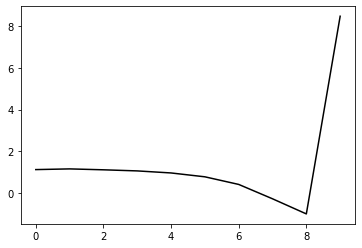

266200 0.18625332880127105
0.2527296175672317 -0.1913079296384389 -0.20708080539777396 -0.12030395853384958
[ 1.09538271  1.0591204   1.06127744  1.02526899  0.93969251  0.76690797
  0.41452712 -0.26194614 -0.97305338  8.46351467]


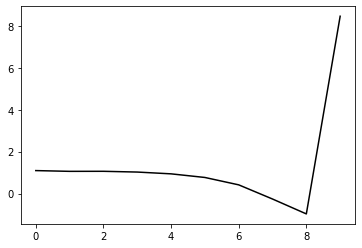

267300 0.1613516251200316
0.2594287620358099 -0.18507078899589102 -0.2038956190019509 -0.12104976653415299
[ 1.08205271  1.2285893   1.21123909  1.16015116  1.05909975  0.86942818
  0.50049332 -0.19315479 -0.92434653  8.4962407 ]


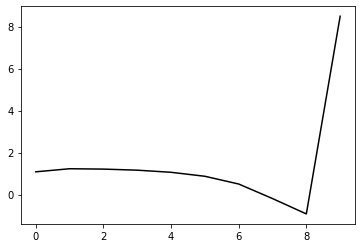

268400 0.19917549839022433
0.2495562809673261 -0.18842776842303288 -0.20462784316088947 -0.12162973455524607
[ 1.10149537  1.07814364  1.04674138  0.99835626  0.89835867  0.70957346
  0.34306214 -0.34674736 -1.07342105  8.45406139]


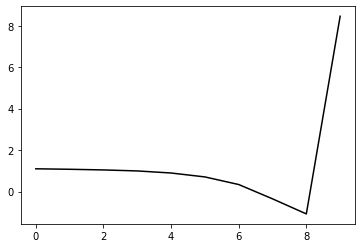

269500 0.19644338690624175
0.2548586071910995 -0.1870959595357412 -0.2046195331740173 -0.12336798583536361
[ 1.11962758  1.14032854  1.14672707  1.10702384  1.0139917   0.83030927
  0.46868539 -0.21602379 -0.93792489  8.51274708]


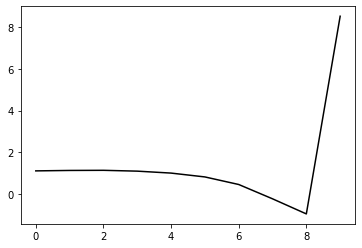

270600 0.2550714415482552
0.25831457357838183 -0.18268751877928632 -0.20200395363933438 -0.12562089242798588
[ 1.15588106  1.15227734  1.20606077  1.18028564  1.08833551  0.90273114
  0.53912701 -0.14732031 -0.87210584  8.46786057]


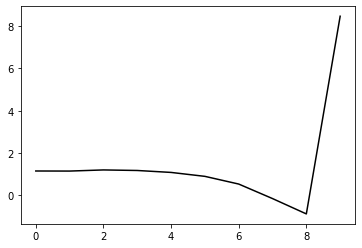

271700 0.12279662979363942
0.2566234908105179 -0.18556522325865252 -0.20408130553052725 -0.12304576905908222
[ 1.08818668  1.12755323  1.11282944  1.0813976   0.98656804  0.79576602
  0.42767595 -0.26205325 -0.99034182  8.4762981 ]


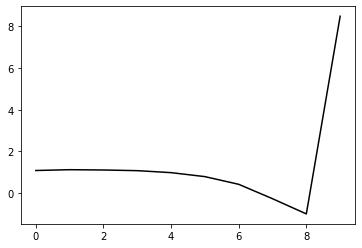

272800 0.13419303991929643
0.2561822091379645 -0.1844306344088899 -0.20321519412047742 -0.12444953847968046
[ 1.12515678  1.12289534  1.1351131   1.10860388  1.02181634  0.83628817
  0.47199507 -0.21400982 -0.93949088  8.52681658]


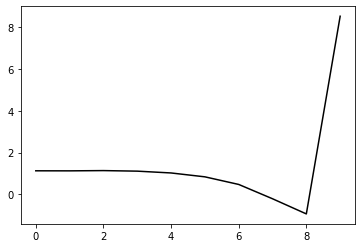

273900 0.180219218085635
0.257861603717761 -0.18512791654624589 -0.20423705818380017 -0.12231478639434447
[ 1.10188919  1.09408663  1.09771772  1.06705126  0.97721827  0.78816097
  0.42017518 -0.26855531 -0.99691727  8.51453051]


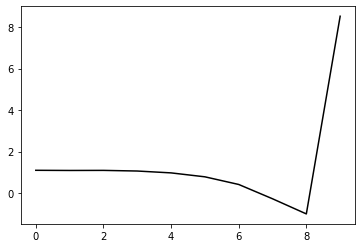

275000 0.2066358951349084
0.2570784893056591 -0.18620724348891765 -0.20501709417332986 -0.12179505464374922
[ 1.08460027  1.10047419  1.10015472  1.07174423  0.9834993   0.79503658
  0.4266929  -0.26210674 -0.99118722  8.47205568]


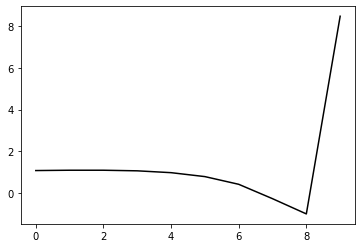

276100 0.20319863461084892
0.2549655268741908 -0.18995586681497026 -0.20763363560937434 -0.12176592964515132
[ 1.1160206   1.05682876  1.0658747   1.05336282  0.9813974   0.80719322
  0.45120724 -0.2254294  -0.94238744  8.49872114]


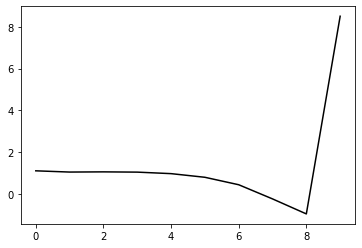

277200 0.17906522225493576
0.25704295285666723 -0.18326907888543653 -0.20275673995687024 -0.12495805998653703
[ 1.12407504  1.20717266  1.20822978  1.18130524  1.10279189  0.92252044
  0.55938728 -0.12413621 -0.84862681  8.45556132]


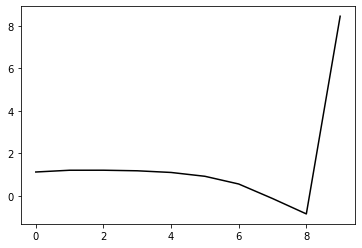

278300 0.1705538079376186
0.25252622018753335 -0.18833867838056156 -0.20568374685284624 -0.12087135650515235
[ 1.10457355  1.07405152  1.0559305   1.01596859  0.92505027  0.73603078
  0.36589512 -0.3225006  -1.05024494  8.48292087]


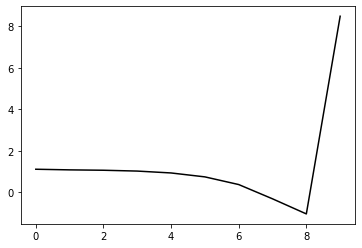

279400 0.15911032149113305
0.25898524974251236 -0.18440356908811703 -0.2038357500307256 -0.12472258264963902
[ 1.11955893  1.22167899  1.24013198  1.19921308  1.1046606   0.91273174
  0.5395554  -0.15172538 -0.88272522  8.47862834]


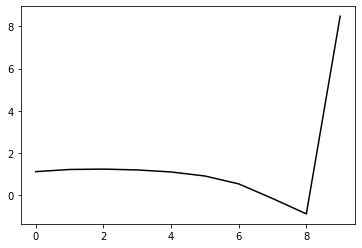

280500 0.22074588507468945
0.25878109657875425 -0.18295798853329 -0.20319154940160528 -0.12378342828813212
[ 1.12970166  1.15988593  1.2127105   1.19491684  1.10701847  0.91890089
  0.54838846 -0.14097503 -0.87123819  8.51715903]


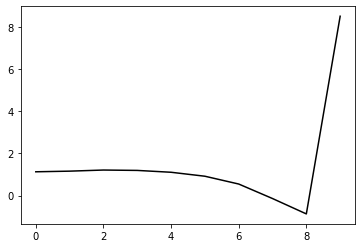

281600 0.15096684491599316
0.2588261137730497 -0.18239830925063075 -0.20345254770048463 -0.12162925662532088
[ 1.09983932  1.14180672  1.18761527  1.17912243  1.09374266  0.90296284
  0.52833626 -0.1658193  -0.90221483  8.48635056]


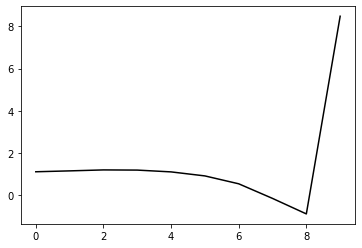

282700 0.13800069179755461
0.25532283438690867 -0.1844288286963846 -0.20450033504964865 -0.11899981209669921
[ 1.13219695  1.00741436  1.01185017  0.99933487  0.91627008  0.72563046
  0.35119861 -0.34159026 -1.07568683  8.50325851]


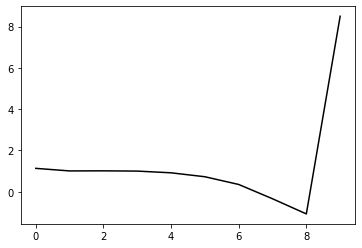

283800 0.14733799691955252
0.2549742841556913 -0.18280017907815502 -0.20281377014330423 -0.1234986105699588
[ 1.14358003  1.16552182  1.16067437  1.14126096  1.06465239  0.87924624
  0.50834128 -0.18074299 -0.91067425  8.49708736]


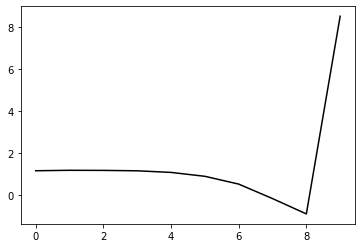

284900 0.1731117165863193
0.25138121271445835 -0.18621228124923034 -0.20512524963607454 -0.12121023746073857
[ 1.1087629   1.10826185  1.05576516  1.01299869  0.92566367  0.73268341
  0.35392226 -0.3426895  -1.08030379  8.47860023]


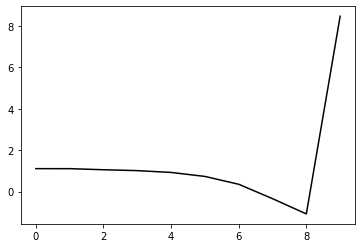

286000 0.20502785149740205
0.25442934440901255 -0.18901810563771232 -0.20823838088946248 -0.1170615854672687
[ 1.08915613  1.05622107  1.05464997  1.00363654  0.90784085  0.7102065
  0.32656258 -0.37483375 -1.11727721  8.45105455]


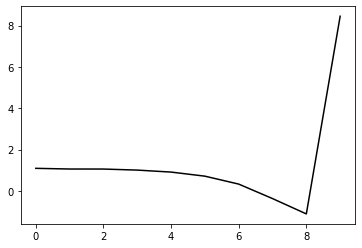

287100 0.187937321900109
0.2556132923943042 -0.1829926340179654 -0.20363476193214833 -0.12072810237679246
[ 1.10479047  1.14228416  1.1354707   1.08671709  0.98583378  0.78500449
  0.39813366 -0.30658706 -1.0525019   8.48822756]


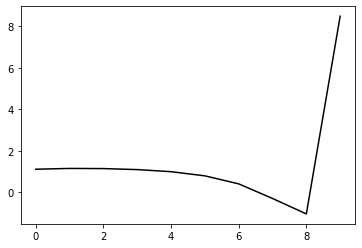

288200 0.2034114375983325
0.2624970017624855 -0.18122458919596918 -0.20398097950861663 -0.12121472648281759
[ 1.04650944  1.24064594  1.28824963  1.26034224  1.16472215  0.967036
  0.5822273  -0.12140141 -0.86703437  8.47828094]


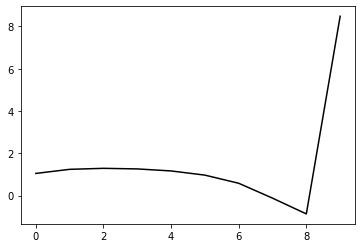

289300 0.18013643628025566
0.2554076115718017 -0.185975260339004 -0.20667111506907765 -0.1211219371577872
[ 1.12508009  1.10185819  1.14860604  1.15053055  1.0765176   0.89579948
  0.52635997 -0.16315808 -0.89533977  8.529106  ]


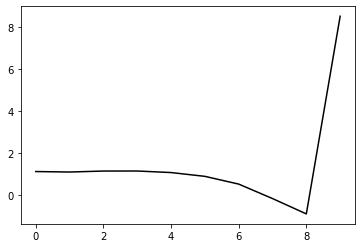

290400 0.1944140540956061
0.24879186196544897 -0.190583242117009 -0.2092515975355109 -0.11884879379924972
[ 1.1181121   1.08400271  1.06602986  1.06134188  0.99060331  0.81103112
  0.44230102 -0.24647704 -0.97769724  8.4764422 ]


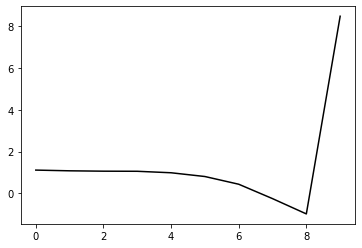

291500 0.24831409469452242
0.2569752016403154 -0.18434411393027317 -0.20623458105941384 -0.1193467391597078
[ 1.06208299  1.14774188  1.15241882  1.12563089  1.04524521  0.85708062
  0.47885902 -0.21985884 -0.96190218  8.51284918]


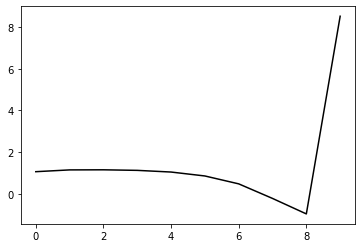

292600 0.1727537059926715
0.2551101513371634 -0.1851242753626641 -0.20633901314972197 -0.12019016321746329
[ 1.08818292  1.11211047  1.1215038   1.09834305  1.02053203  0.83694099
  0.46258919 -0.23250304 -0.97054425  8.4794817 ]


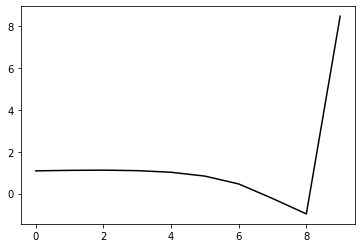

293700 0.12475368709486649
0.2570530861285904 -0.18270589739830403 -0.20515658167682016 -0.11950881853966275
[ 1.12291322  1.10466794  1.1231652   1.10223719  1.02592082  0.84424094
  0.47037446 -0.22570386 -0.96596404  8.51121494]


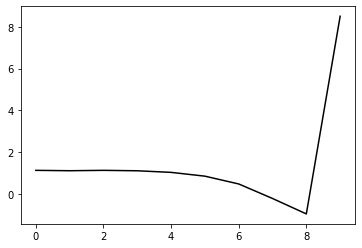

294800 0.13800023621235982
0.24769421899451563 -0.18469494112172313 -0.2048356307999161 -0.12179777996989048
[ 1.13148604  1.10708805  1.04936717  1.02110201  0.94692891  0.76834924
  0.39723245 -0.29645324 -1.03398878  8.47571666]


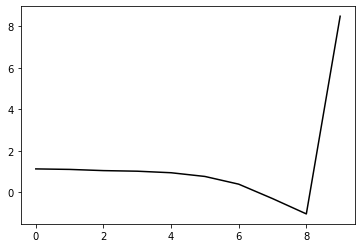

295900 0.18521405127372464
0.2524706788096523 -0.18896215350005913 -0.20957003464586238 -0.11628493370243
[ 1.08899226  1.02608204  1.01896949  0.97427297  0.89085861  0.70661247
  0.33006714 -0.36935327 -1.11290521  8.46827091]


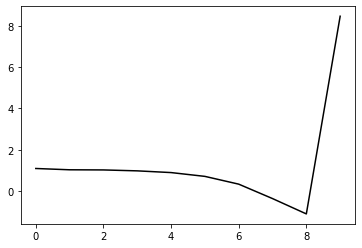

297000 0.2231334484105782
0.24484838275663132 -0.1899209437215107 -0.20852460833264394 -0.12007603979038826
[ 1.12948005  0.99388223  0.97512907  0.93776981  0.85840926  0.68045222
  0.31048487 -0.38236785 -1.11835423  8.49091375]


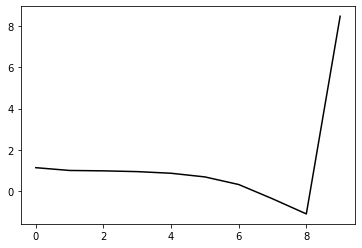

298100 0.19018569228376633
0.25392331319378925 -0.18371489906171648 -0.20540450833624518 -0.12167489464375401
[ 1.11277561  1.1629743   1.15093978  1.10300832  1.01206966  0.82497641
  0.44667098 -0.25502633 -1.0008674   8.46774745]


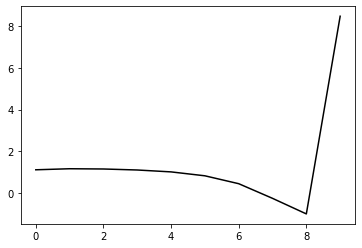

299200 0.16534049899543596
0.2549465545559999 -0.1843819156001281 -0.20659440753998157 -0.12096741141542275
[ 1.09322214  1.199012    1.20560241  1.17098777  1.08362958  0.89979019
  0.52443315 -0.17585522 -0.92178464  8.47213727]


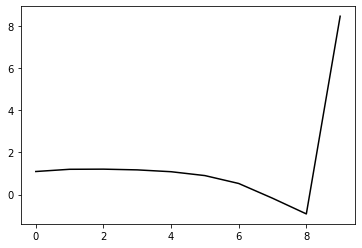

300300 0.16696145454058917
0.25950532252941505 -0.17944703306482762 -0.2040423105651383 -0.12008294653441288
[ 1.06831923  1.22736106  1.2342239   1.19242101  1.09220602  0.89503666
  0.50774641 -0.2048376  -0.96421811  8.51190772]


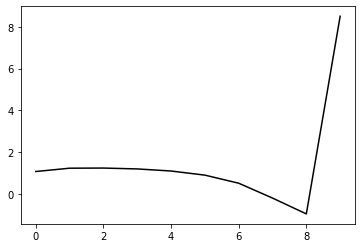

301400 0.19552691230054206
0.2515229608638283 -0.18517548361824154 -0.20666711239362465 -0.12227138837187393
[ 1.16982632  1.07527268  1.0907214   1.07615618  1.00039123  0.82465225
  0.45880563 -0.23238387 -0.96884144  8.48225146]


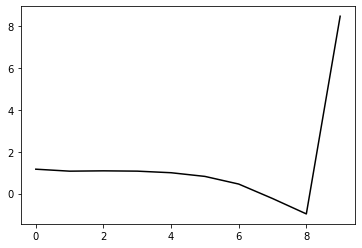

302500 0.315344111352566
0.2551388680683521 -0.18125303294454007 -0.20464954881250835 -0.12323460535218517
[ 1.17302912  1.19422686  1.23224114  1.21798082  1.14335233  0.96591378
  0.59710583 -0.09871318 -0.84193701  8.51350114]


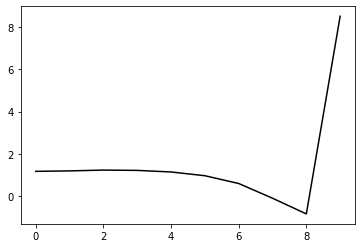

303600 0.1889651784163388
0.25661877547756723 -0.18727589128691127 -0.20957540908978436 -0.12089424792873417
[ 1.09889775  1.19118452  1.21929741  1.20754612  1.13647128  0.96230781
  0.59746638 -0.09377255 -0.83178681  8.48190529]


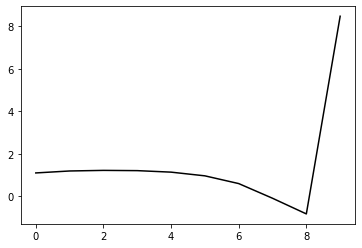

304700 0.1322830832510594
0.25568033915521265 -0.18557206790931155 -0.2081418319912285 -0.11929628395702585
[ 1.11399258  1.12352964  1.11733462  1.09199862  1.01214326  0.82973717
  0.45717256 -0.24163509 -0.98765452  8.47961312]


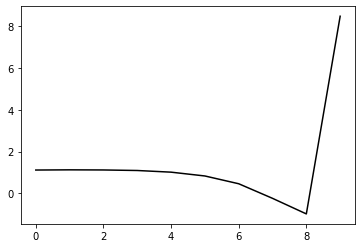

305800 0.14366030862036755
0.25461144372561056 -0.17941646059052396 -0.2035305618003572 -0.11944967934187384
[ 1.14739391  1.10533567  1.10188172  1.06646903  0.97932266  0.79067821
  0.4113201  -0.29534977 -1.05102385  8.46357902]


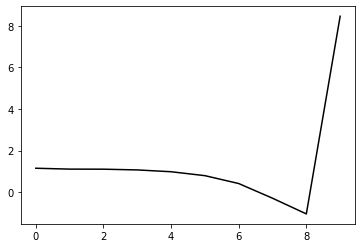

306900 0.16181161029470648
0.2531081210066758 -0.1871178960836147 -0.20944145994570887 -0.11719896555677549
[ 1.13694271  1.00080941  1.0177217   0.99632283  0.92102915  0.7447905
  0.37770696 -0.31674775 -1.05945259  8.50503786]


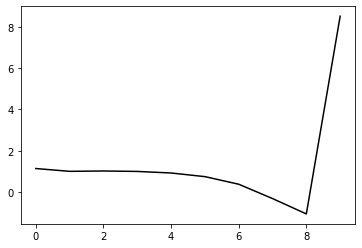

308000 0.23377057722526698
0.25522522406855475 -0.18738820597491979 -0.21006788932631815 -0.11959790419759524
[ 1.08863397  1.14276973  1.15782711  1.14360208  1.07749351  0.90987347
  0.55048581 -0.13743526 -0.87478389  8.48425451]


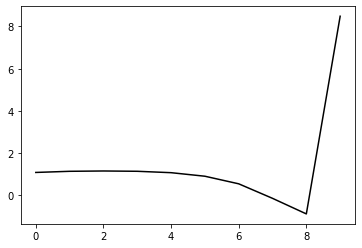

309100 0.18881475085636346
0.25598622235446716 -0.18047628855535425 -0.20503659106223046 -0.11840508185897625
[ 1.12760577  1.19344973  1.16372285  1.11307462  1.0190457   0.82700786
  0.44505208 -0.26452949 -1.02375501  8.48461183]


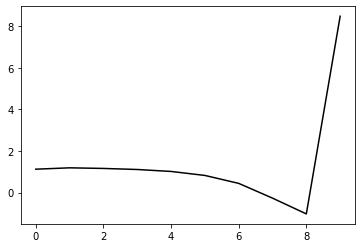

310200 0.17688824717679247
0.25448964367819676 -0.1842706901980276 -0.20767752694570754 -0.11812262837546844
[ 1.1143151   1.15053315  1.14890076  1.11179842  1.02450032  0.84102961
  0.46828052 -0.23204854 -0.9815581   8.46540679]


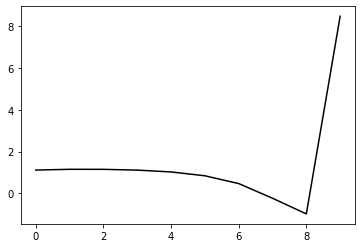

311300 0.17674589200685337
0.2618374999841752 -0.1788010484405319 -0.20490429451399841 -0.11896631110537735
[ 1.07918597  1.26964326  1.29733466  1.25230252  1.14741047  0.94610032
  0.55691116 -0.15969041 -0.92657666  8.51719313]


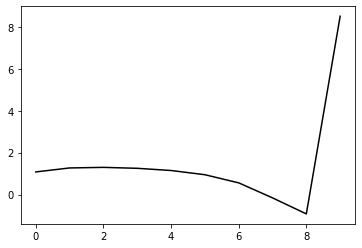

312400 0.18025548512885373
0.25259464477090593 -0.18600354526469487 -0.2085124561827437 -0.12108423400397161
[ 1.17095888  1.08476581  1.12026653  1.1218909   1.05209326  0.88013608
  0.51976764 -0.16809479 -0.90494438  8.47029237]


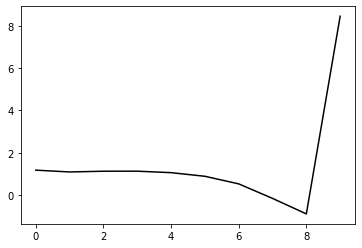

313500 0.18942427863831077
0.25854386379359207 -0.18022059499690504 -0.20588403497697516 -0.11860802105110524
[ 1.1156172   1.21130394  1.24787881  1.23276103  1.14940394  0.95989586
  0.58109267 -0.12584996 -0.88406947  8.5042039 ]


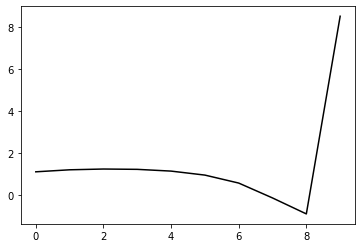

314600 0.15681382850619885
0.2515076248269038 -0.18329026371204607 -0.20661723761667655 -0.11991409904390253
[ 1.12382343  1.14643837  1.15009077  1.13453368  1.05181878  0.86158241
  0.4822156  -0.22406752 -0.98022102  8.47534201]


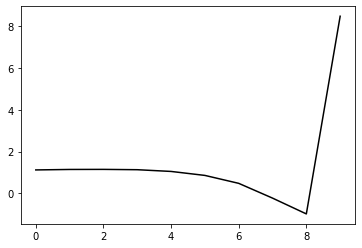

315700 0.11887109626030483
0.25835942723003663 -0.18036524534623347 -0.20600749903964627 -0.11908546601129852
[ 1.13509958  1.17476327  1.20493759  1.18706325  1.10613959  0.91654104
  0.53643976 -0.17103546 -0.92920742  8.48637677]


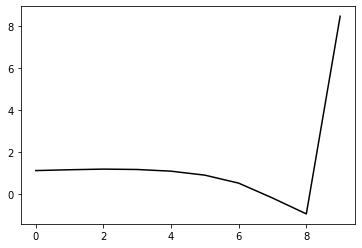

316800 0.13341826191653183
0.24907417935873485 -0.18205394935124233 -0.2054127617117756 -0.1200030655439157
[ 1.13074008  1.12955755  1.09213859  1.06764749  0.98705833  0.7983533
  0.41890444 -0.28743858 -1.04384584  8.4706349 ]


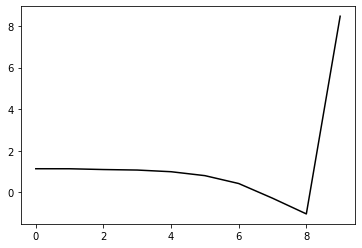

317900 0.18351242220927533
0.25328964673621635 -0.1856811608791412 -0.20933092956435698 -0.11616431799073972
[ 1.09819898  1.05375436  1.05979471  1.02451052  0.9394401   0.74832843
  0.36610048 -0.34286199 -1.10174974  8.47649446]


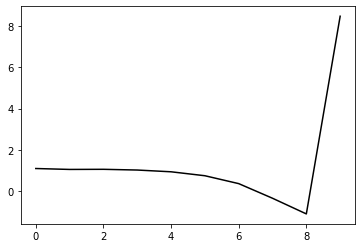

319000 0.20633400257148138
0.25432994816261634 -0.18452418275760732 -0.20819135939420158 -0.11983257759862416
[ 1.0920941   1.16927266  1.17149579  1.13578234  1.04793031  0.856376
  0.47411634 -0.23416988 -0.99144704  8.44846494]


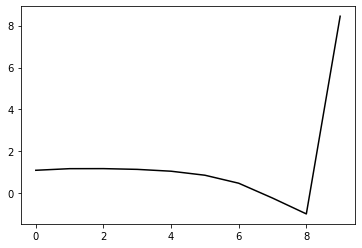

320100 0.18898272596333085
0.2549340698524704 -0.1809880229794 -0.2057082290213049 -0.1200256855784656
[ 1.11769098  1.16521364  1.17744997  1.14588306  1.05478108  0.86042614
  0.47510283 -0.2367431  -0.99842918  8.50392631]


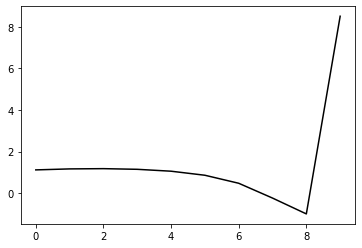

321200 0.17017883385515523
0.25371821915207754 -0.1850051029689535 -0.2087632536287523 -0.11951785689979988
[ 1.10189319  1.15939606  1.18088051  1.16834254  1.09023092  0.90667731
  0.53138694 -0.17077407 -0.92241616  8.47583809]


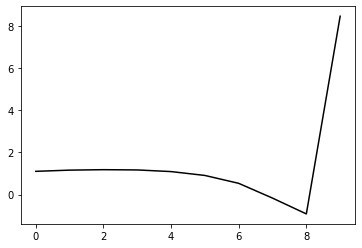

322300 0.23894079706022936
0.2539677520311389 -0.18822324879218316 -0.21163669966147003 -0.11857281864428763
[ 1.07295659  1.17694234  1.18914544  1.18151693  1.1145015   0.93986752
  0.57182079 -0.12448756 -0.87153866  8.53190556]


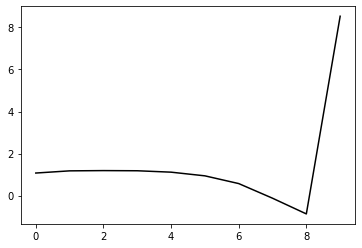

323400 0.18874864479154102
0.25292792033514666 -0.18560001493416034 -0.20914900097476502 -0.1195178344262185
[ 1.13446579  1.1624017   1.15969113  1.13145593  1.05097788  0.86545394
  0.48760842 -0.21696825 -0.97049228  8.47042976]


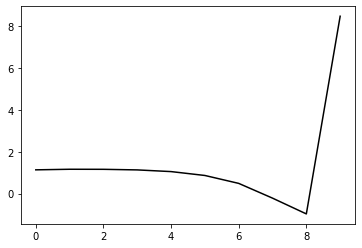

324500 0.20727359491824457
0.24821303213919574 -0.18629435392832075 -0.20883487573455642 -0.1199831062637436
[ 1.16028383  1.10774296  1.09040478  1.06283396  0.98200413  0.79773904
  0.4211462  -0.28232282 -1.03477368  8.49249899]


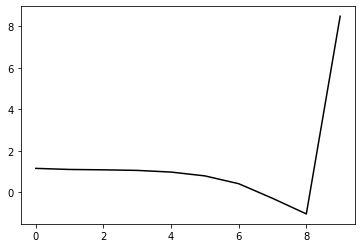

325600 0.1595471967753696
0.2555025480411245 -0.18277803194018882 -0.20777205810474655 -0.11889490308735581
[ 1.14341053  1.10637326  1.12482026  1.09084129  1.00444826  0.81582294
  0.43465049 -0.27418028 -1.03313056  8.44843631]


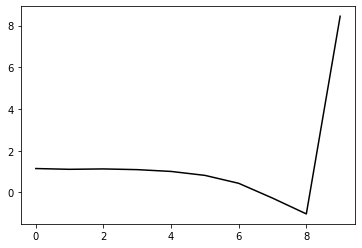

326700 0.12646444956767483
0.253149082134268 -0.18058643711778186 -0.2053234164494036 -0.12146332532345415
[ 1.13180351  1.17439694  1.16986001  1.13234734  1.03844331  0.84361491
  0.45749794 -0.25571987 -1.01874005  8.48326096]


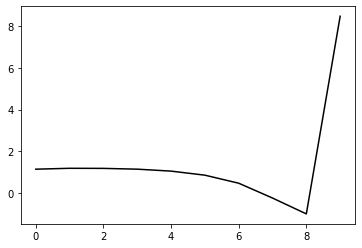

327800 0.12729848457025436
0.2562111883341756 -0.1819507666024677 -0.20701248410046705 -0.12106707778392845
[ 1.13185438  1.17854131  1.21002315  1.18507147  1.0953574   0.90315028
  0.51959193 -0.19130535 -0.95194602  8.48573811]


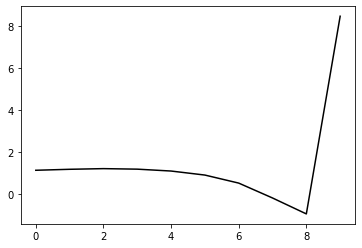

328900 0.18441795534475014
0.25605711189292363 -0.18184427097197028 -0.20713010536664364 -0.12032138708245696
[ 1.10786247  1.10054111  1.13420818  1.11715551  1.02757773  0.83264364
  0.44659057 -0.26681561 -1.03028063  8.50612733]


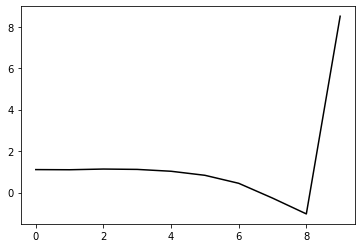

330000 0.21670222110166304
0.25761715015034686 -0.18315532824987546 -0.2087273740113179 -0.11849328860111219
[ 1.12993315  1.02439013  1.07062227  1.06430218  0.98384334  0.79371468
  0.41135011 -0.29881364 -1.05937095  8.46359005]


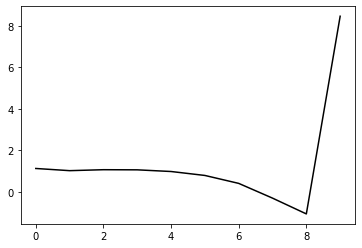

331100 0.21057059003034367
0.2540918177188584 -0.18275651681627114 -0.20783610160937585 -0.11744439786419066
[ 1.14192618  0.99921979  1.01011817  1.00567704  0.93139615  0.74492916
  0.36524991 -0.34223772 -1.09981673  8.47388036]


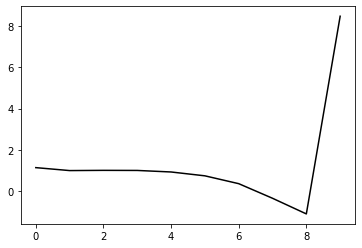

332200 0.18640814058067304
0.25164723982087706 -0.1851772374653438 -0.2093717267188196 -0.11939333008762276
[ 1.14665778  1.12651871  1.10140292  1.09175878  1.02867873  0.85263684
  0.4810837  -0.21952685 -0.97111379  8.46358582]


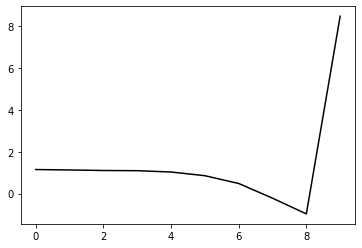

333300 0.17889774945889905
0.2549611917134931 -0.18305301931367182 -0.20851771475055753 -0.1201136746115472
[ 1.15033814  1.11591986  1.12495472  1.10906745  1.04728687  0.87634528
  0.50822596 -0.19016548 -0.94056783  8.50535065]


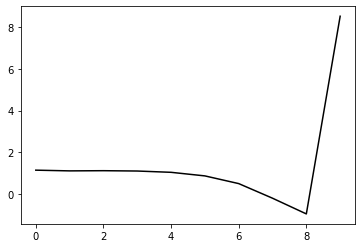

334400 0.20288469317788965
0.25123068348602623 -0.18290986717769936 -0.20770725842563037 -0.12138172064585795
[ 1.18270504  1.0956777   1.09475234  1.07485758  1.01179755  0.84348582
  0.47758763 -0.21938011 -0.9688337   8.48658826]


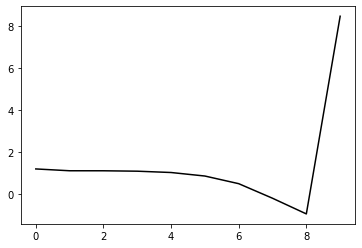

335500 0.2058211915861533
0.24902322694350934 -0.18483002765706855 -0.2090767026201282 -0.12127276638777898
[ 1.13398423  1.07686126  1.07493916  1.05359466  0.99035547  0.82651211
  0.46557395 -0.22733163 -0.97346672  8.49768695]


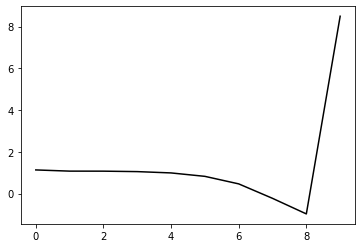

336600 0.1821423823614876
0.24669336782330628 -0.18574434302795925 -0.209836955554954 -0.11722485530524387
[ 1.14029576  1.08133413  1.02651834  0.97663365  0.88794418  0.7021848
  0.3212488  -0.39095889 -1.15589296  8.45501215]


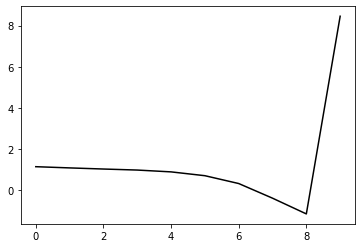

337700 0.1227606094901186
0.2554510792342882 -0.18310879941990543 -0.20940023270384886 -0.12002846015904665
[ 1.11104369  1.27495247  1.25579823  1.19496096  1.09649709  0.90393608
  0.51701998 -0.20197942 -0.9748331   8.49709463]


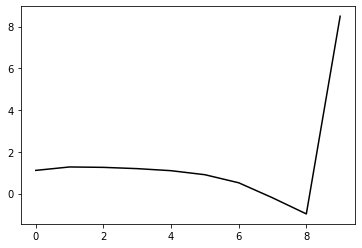

338800 0.1400626316619064
0.25480036198865963 -0.17845189198321018 -0.2061885634505578 -0.12123079887122662
[ 1.1581393   1.19857548  1.2439047   1.2054426   1.10760348  0.9153651
  0.5292257  -0.19068496 -0.96652198  8.48502693]


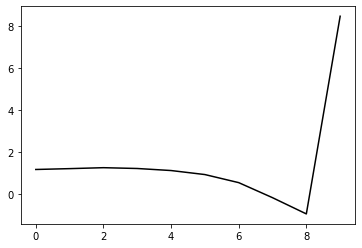

339900 0.1817440440409149
0.2523530087621761 -0.1818518206091406 -0.20861652913336232 -0.11837084988346315
[ 1.10557828  1.08212952  1.09346455  1.06460306  0.97057149  0.78000517
  0.39823706 -0.31612421 -1.08522332  8.49897025]


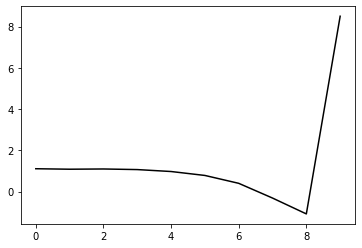

341000 0.21597290300302552
0.2500425291031423 -0.18168901183193636 -0.20842097518894143 -0.11778508356793299
[ 1.11931423  1.15502663  1.11482814  1.06822157  0.96556434  0.76450505
  0.37302925 -0.35108145 -1.13085665  8.45546532]


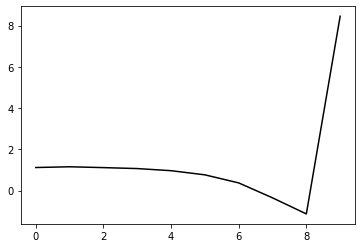

342100 0.20994249528923817
0.24809439416976659 -0.18215119156221626 -0.20828558424892948 -0.11766020049323274
[ 1.14320947  1.09846818  1.10357169  1.05476398  0.9480457   0.74262697
  0.3473484  -0.38020781 -1.16334043  8.45482349]


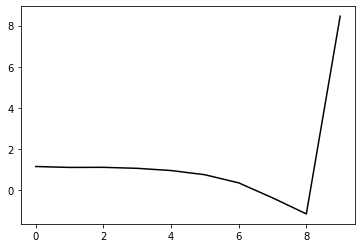

343200 0.1586423860694093
0.2559538068960283 -0.1794762462263675 -0.2077688451333969 -0.12092352100608088
[ 1.11601933  1.28751956  1.31192183  1.26969741  1.16204337  0.95407893
  0.55637324 -0.1736938  -0.95997951  8.51808925]


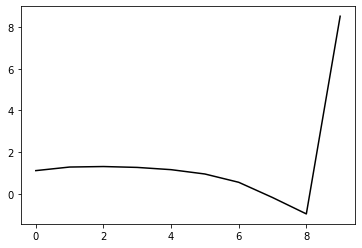

344300 0.17282550576910524
0.2513957859272683 -0.18296160364042277 -0.2097633332850599 -0.12003714442880783
[ 1.12791556  1.13917661  1.16480153  1.14304268  1.0462434   0.84520453
  0.45427452 -0.26869878 -1.04736314  8.50629998]


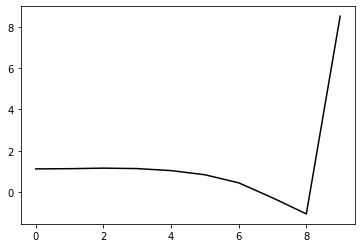

345400 0.19131154929568478
0.25661506529774775 -0.18092392052449716 -0.20937344577661127 -0.11811245516640594
[ 1.11544978  1.14180772  1.17454833  1.15032865  1.05102006  0.84387622
  0.44716536 -0.28053705 -1.06361501  8.42713527]


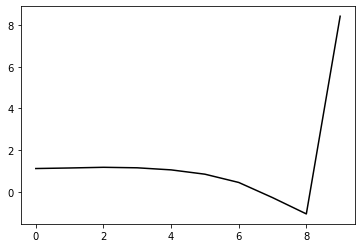

346500 0.18615442971972498
0.256612144655518 -0.17901316574010062 -0.20783708734588416 -0.1217001663855344
[ 1.13081429  1.27277994  1.32119393  1.31369995  1.22810465  1.02724211
  0.63307184 -0.09368023 -0.87757687  8.5283626 ]


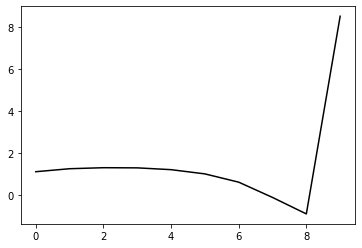

347600 0.18467618142405573
0.24522700269372893 -0.1829364521318624 -0.20838522848991456 -0.12359643966478912
[ 1.14444047  1.15399925  1.16150604  1.15259784  1.07152752  0.87491059
  0.48498221 -0.23607443 -1.01248673  8.48314209]


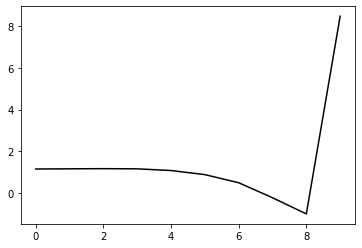

348700 0.1251911939413286
0.25027203979553625 -0.1794708727642385 -0.2071454927914203 -0.1214410431312098
[ 1.11134911  1.12424859  1.14941452  1.13100279  1.0457992   0.84480433
  0.44852341 -0.2795181  -1.06418571  8.48572879]


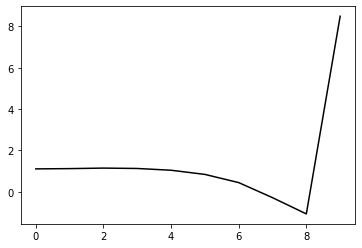

349800 0.16251415161011584
0.2477106999982958 -0.174311674469755 -0.20275431845790592 -0.12395932212772034
[ 1.1408543   1.10298478  1.13739367  1.11636445  1.02598676  0.81958633
  0.41618337 -0.31930961 -1.11199094  8.43782388]


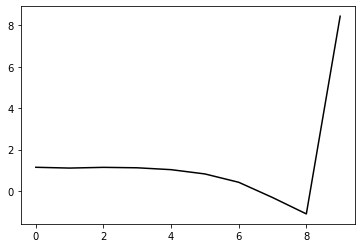

350900 0.16071158212263806
0.2440008541118938 -0.18477606293049315 -0.21029721721951697 -0.11899158573725599
[ 1.1241209   1.05377511  1.02794418  1.00515655  0.92120907  0.72103283
  0.32275674 -0.40762843 -1.19435147  8.46681957]


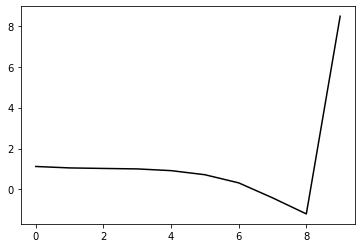

352000 0.2139042103833216
0.25098736216291334 -0.1813041389887848 -0.2090386808556429 -0.11944614991096955
[ 1.07776738  1.1997258   1.19193867  1.14891154  1.0523665   0.84235523
  0.43341321 -0.30824015 -1.10745197  8.45739968]


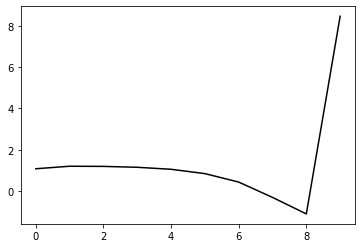

353100 0.2549288887550351
0.2442499837679953 -0.18212569790489982 -0.20799628138558474 -0.12112378043946269
[ 1.17855946  0.97099202  1.00850332  0.98039493  0.88939761  0.6865218
  0.28406481 -0.45117356 -1.24292725  8.49066377]


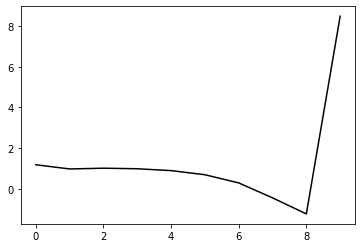

354200 0.17532620507147545
0.2476447436642834 -0.18204395456673783 -0.20876704067538673 -0.1215392284369667
[ 1.08715909  1.20232511  1.18167311  1.14652923  1.05033795  0.84236031
  0.4345593  -0.30640419 -1.1043622   8.45416937]


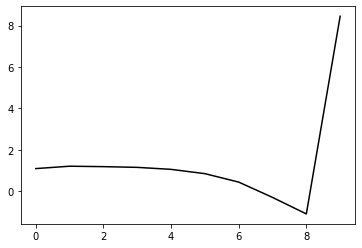

355300 0.1662737287093105
0.2548130838722298 -0.17658812318201333 -0.2061327638050496 -0.12225073541865482
[ 1.06559163  1.25821081  1.28361057  1.23939853  1.13138509  0.91290048
  0.49476154 -0.25690168 -1.06634825  8.48949153]


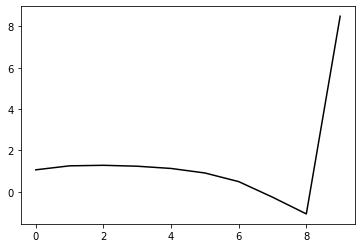

356400 0.18507742913731254
0.253080259771167 -0.17619046028250082 -0.20531842737345216 -0.1241134595565071
[ 1.13165756  1.20418877  1.25620199  1.23574753  1.13911126  0.92913861
  0.51850177 -0.22639155 -1.02872399  8.44579367]


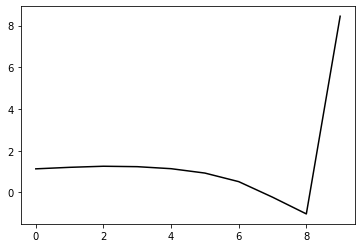

357500 0.22117588156201987
0.24667125870680054 -0.17925248427115523 -0.20617053207545247 -0.12568989070618214
[ 1.13222438  1.13816159  1.15103883  1.13808202  1.05138036  0.84835539
  0.44421367 -0.29407945 -1.08861626  8.48461097]


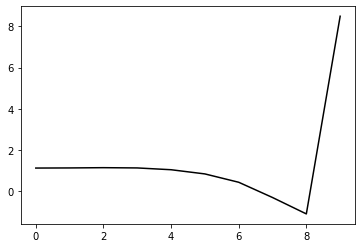

358600 0.19285309565969808
0.2558447428588074 -0.17756274183608436 -0.2072214080394231 -0.12309054611369764
[ 1.06298537  1.25345828  1.30895348  1.29631489  1.20840149  1.00163939
  0.59173799 -0.1537917  -0.95703894  8.48437086]


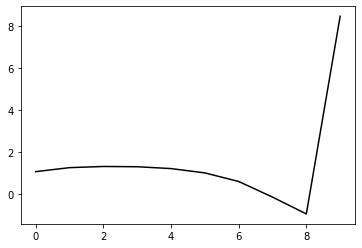

359700 0.12884949900954853
0.2543629079070806 -0.17614399311119425 -0.20588105027678055 -0.12387916311662357
[ 1.1247      1.15366326  1.20388784  1.19740813  1.11195144  0.9059729
  0.49614295 -0.24930005 -1.05176035  8.48900697]


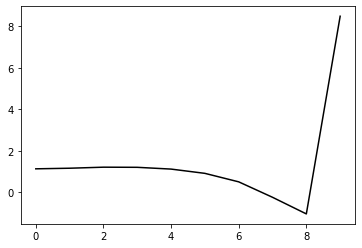

360800 0.1539301830926198
0.2505519943312012 -0.18155961357207268 -0.209227688562305 -0.12103854141613739
[ 1.10221109  1.0962577   1.10773942  1.09921078  1.01729484  0.81349711
  0.40510523 -0.33874824 -1.13853485  8.47327717]


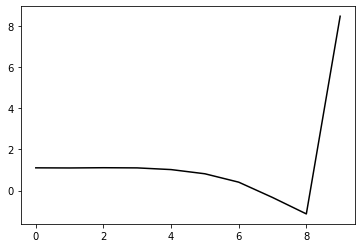

361900 0.24550402784283631
0.2536254311897246 -0.1797215193937616 -0.20868696971001238 -0.12287654556608686
[ 1.03698328  1.12963709  1.16965047  1.16287247  1.08771277  0.88965111
  0.48428663 -0.25828686 -1.05780231  8.53362165]


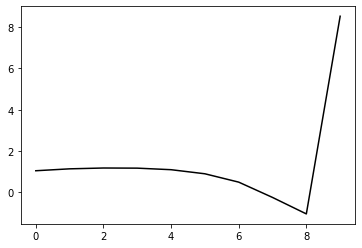

363000 0.2193747270381453
0.24931647295997944 -0.18459120842046078 -0.21155604775975992 -0.1219710987173751
[ 1.07579776  1.04915994  1.07978974  1.08551251  1.0241198   0.83997577
  0.44684978 -0.28443745 -1.07216433  8.45866268]


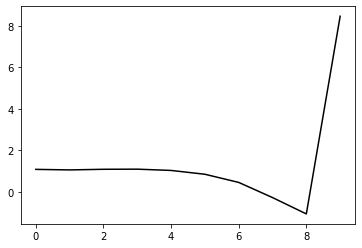

364100 0.18834821560980386
0.25009723535771167 -0.17765434104041863 -0.20669227729089393 -0.12299490980789715
[ 1.09540067  1.14219123  1.13549132  1.12048877  1.04848692  0.85539301
  0.45180165 -0.29173827 -1.09359052  8.47030035]


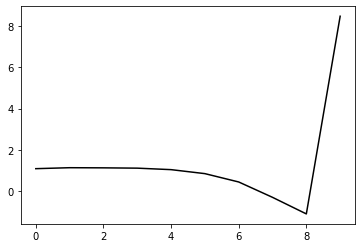

365200 0.17807104847526803
0.24893616761666482 -0.17817347122181776 -0.2066923513548073 -0.12321217514416892
[ 1.08255598  1.1613661   1.1485972   1.12794123  1.05445558  0.86300377
  0.46049583 -0.28262558 -1.08364571  8.46088892]


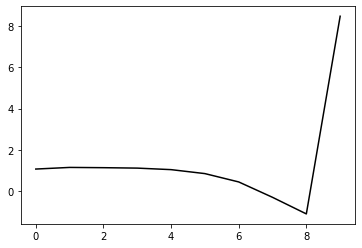

366300 0.17873147935914754
0.2500413709875594 -0.17419160576745196 -0.2041617142150685 -0.12452015336764705
[ 1.09397132  1.1538896   1.14402957  1.11686356  1.04061984  0.84940774
  0.44618167 -0.29956211 -1.10447501  8.44530481]


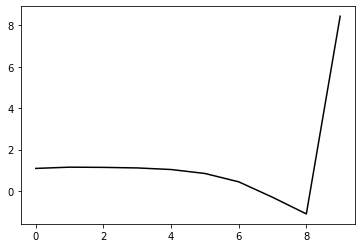

367400 0.1712090127665758
0.25268769736297897 -0.1731227397618232 -0.2045070644042943 -0.12357498277531011
[ 1.11213454  1.13322879  1.17392349  1.16190001  1.0925119   0.90971182
  0.51367465 -0.22731628 -1.02876622  8.46382637]


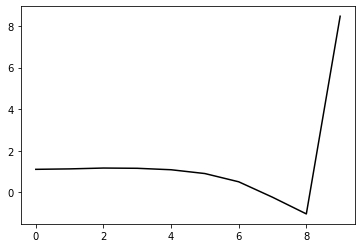

368500 0.3175293898351695
0.2517273177290797 -0.1793018704927846 -0.20943844110904664 -0.121416891677143
[ 1.03191332  1.11446949  1.1215451   1.11663179  1.05950428  0.88968604
  0.50580289 -0.22610717 -1.02090289  8.50558622]


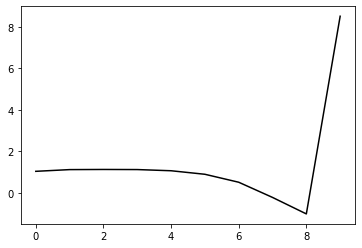

369600 0.1577511833231488
0.24544065381185898 -0.18267624563749263 -0.21016005670578997 -0.1245995210452134
[ 1.09644123  1.13989826  1.13102536  1.12444635  1.07393455  0.91324749
  0.53899972 -0.1838462  -0.96853143  8.47716104]


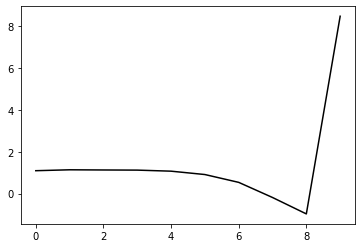

370700 0.1256080975458913
0.24356363431492642 -0.18236305151937524 -0.20946805673509494 -0.12605168740218625
[ 1.115189    1.14862899  1.11998768  1.10317682  1.05030127  0.89132139
  0.51963112 -0.20158775 -0.98515917  8.48465608]


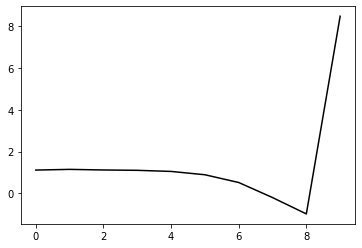

371800 0.13128094001551327
0.24535126200744417 -0.17871281222096144 -0.20705380292631476 -0.12504925352858332
[ 1.09603233  1.15665611  1.11115615  1.06710641  0.99468701  0.82294533
  0.44120578 -0.29002017 -1.08398653  8.45966904]


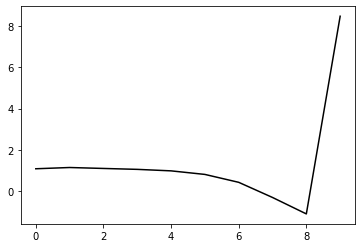

372900 0.2073438957859514
0.25216387523203054 -0.17788914512416631 -0.20822195291531334 -0.12433978964883816
[ 1.05514567  1.18477682  1.17401727  1.12233543  1.03995216  0.86331768
  0.47868718 -0.25626715 -1.05499961  8.48376138]


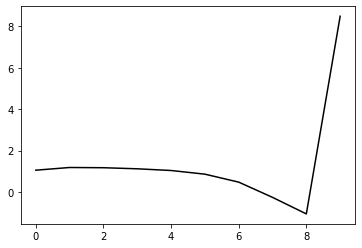

374000 0.20241395053037742
0.24943255197331424 -0.17944622906749513 -0.2090359765166786 -0.12292075076846225
[ 1.07470563  1.12297343  1.12260466  1.08174448  0.99795511  0.82243931
  0.44134462 -0.29094109 -1.08805875  8.45663032]


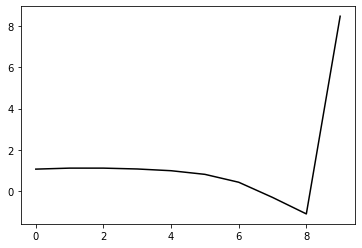

375100 0.1937170812511308
0.24962045247409778 -0.176878985609276 -0.2070924710455161 -0.12431268202492342
[ 1.11116596  1.14428135  1.15374465  1.12113622  1.03650011  0.85938501
  0.47937706 -0.25251752 -1.05055997  8.49214091]


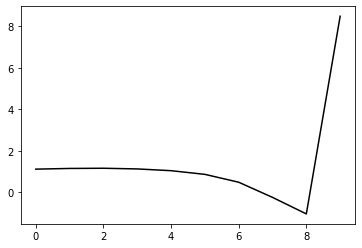

376200 0.1896119294073339
0.24143955225145247 -0.18291451422842772 -0.20971797807362655 -0.12274903189113397
[ 1.09829864  1.03050229  1.02684854  0.99731446  0.91085839  0.73139944
  0.35256702 -0.3764922  -1.17006347  8.45091653]


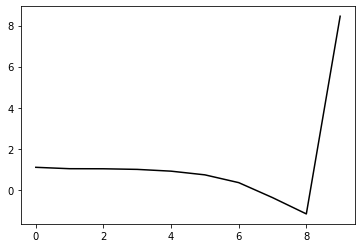

377300 0.17326795536715903
0.24742947654070582 -0.18173519907033275 -0.20996148399422737 -0.12517756590869775
[ 1.0445082   1.13159601  1.12559074  1.08644557  0.99376895  0.8075125
  0.42418282 -0.3087079  -1.10645428  8.49280045]


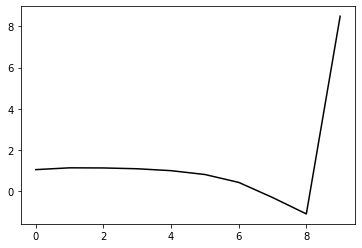

378400 0.17387123736533897
0.2471934809849089 -0.18062498814863237 -0.20890490596139594 -0.12667619393034862
[ 1.13436437  1.13445111  1.15071251  1.11959328  1.03168969  0.84826572
  0.46880892 -0.26008603 -1.05419143  8.44187528]


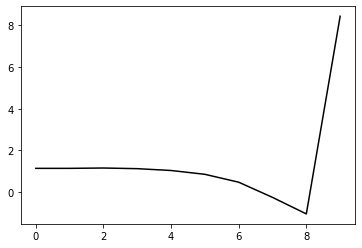

379500 0.19106117942712952
0.2525055811468992 -0.17463207984333642 -0.20577168259391967 -0.1258403557020994
[ 1.08796696  1.23504422  1.24782419  1.21082758  1.11514983  0.92203485
  0.53405077 -0.2033488  -1.00762372  8.50596631]


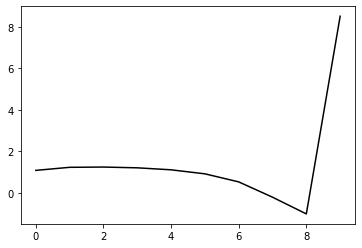

380600 0.17605528441541318
0.2400906081051264 -0.1821949553339645 -0.20915468373163765 -0.12373141690204846
[ 1.11510966  1.01601867  0.99132289  0.96284996  0.87359908  0.68531422
  0.30306206 -0.42764991 -1.22430022  8.44421204]


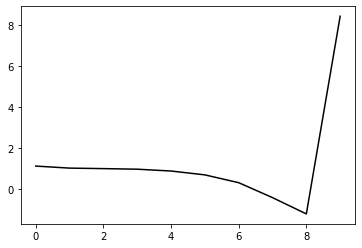

381700 0.12429452006560045
0.25080815266497997 -0.17769684801242094 -0.2082315967666351 -0.12442136099789985
[ 1.09394657  1.13021519  1.13645298  1.09880134  1.00629091  0.81336037
  0.42606169 -0.31033249 -1.11474174  8.49331869]


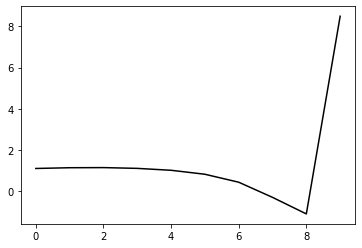

382800 0.12828831528656687
0.24582440061654548 -0.17914426102004086 -0.20833609869893607 -0.1266265123412044
[ 1.09965745  1.17425111  1.14808834  1.11205528  1.02339151  0.83364742
  0.44936251 -0.28381277 -1.08528566  8.46666395]


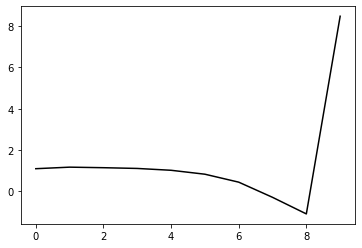

383900 0.18732144326007816
0.25028500642857315 -0.17671587472908915 -0.20751323366607924 -0.1250885270775785
[ 1.07614618  1.1759019   1.15544032  1.10147666  0.99969179  0.79910419
  0.40521626 -0.33657788 -1.14721776  8.46823118]


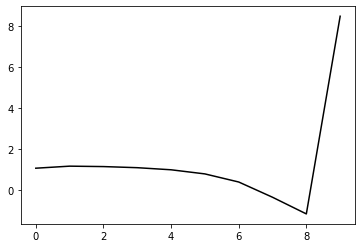

385000 0.24756589663587975
0.251427501041108 -0.1807101608613695 -0.210904364669918 -0.12188906022949694
[ 1.04270015  1.09802267  1.10134803  1.05572298  0.95204156  0.7511825
  0.35883327 -0.37985367 -1.18686287  8.42816506]


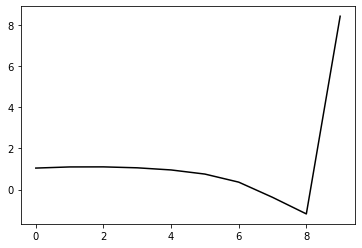

386100 0.18749328468806947
0.2523452340762849 -0.17464548591784265 -0.20639984158805033 -0.12587934009525567
[ 1.08882753  1.1772863   1.17433104  1.12508037  1.01695136  0.80978185
  0.41113407 -0.33383065 -1.14836861  8.47253794]


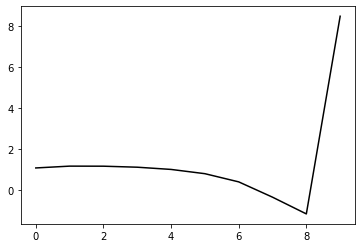

387200 0.1784633533016465
0.2512397464334367 -0.17551726171915255 -0.20673947479945765 -0.12670785031445195
[ 1.09033567  1.17469181  1.19489541  1.16148332  1.06061413  0.85816303
  0.4643234  -0.27527926 -1.08480171  8.45341837]


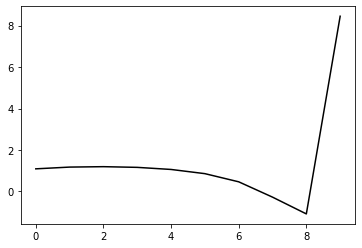

388300 0.17252167263530965
0.24538108282944424 -0.17906915279547592 -0.20817006020843437 -0.12616842112835297
[ 1.09169528  1.07783751  1.07880226  1.04912003  0.9485502   0.74412977
  0.34901001 -0.39040673 -1.1989035   8.47336624]


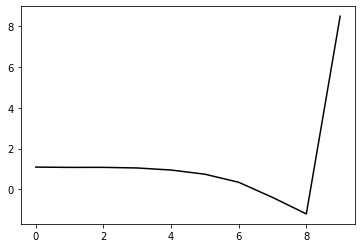

389400 0.19222721309832105
0.2552298474176234 -0.17072789743079067 -0.20429048772682384 -0.1270157149212304
[ 1.10541314  1.20688885  1.24367866  1.211112    1.10637908  0.89450808
  0.49085889 -0.25738935 -1.07655567  8.44724817]


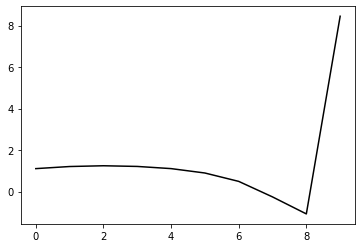

390500 0.27049101544944737
0.2555323578189268 -0.17560061825898887 -0.2081436079593838 -0.12454608753097884
[ 1.02061051  1.1033436   1.14535079  1.12511344  1.02721657  0.81879085
  0.41810911 -0.32586281 -1.13996097  8.50340739]


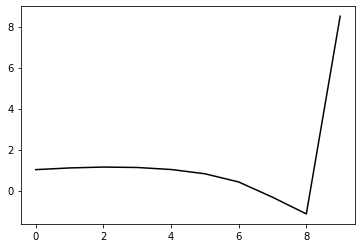

391600 0.15712026815224484
0.2520899859739671 -0.17688886293546313 -0.20820447203389666 -0.1253592335149984
[ 1.10105049  1.02931634  1.06089463  1.0536024   0.97028716  0.77230077
  0.38015097 -0.35492951 -1.1599188   8.42621135]


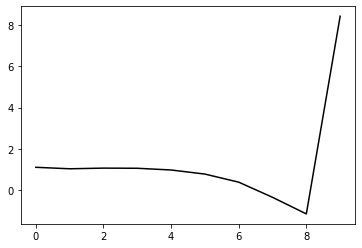

392700 0.15377124116794566
0.24767145122900197 -0.17582303242845404 -0.20621568956429043 -0.12861697671426878
[ 1.11938204  1.04279939  1.06627698  1.0656675   0.99455401  0.80579587
  0.41993305 -0.30906596 -1.10833283  8.48546279]


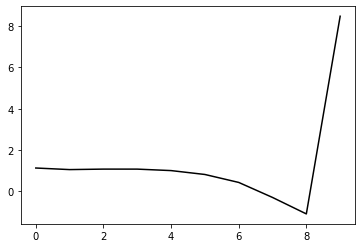

393800 0.13239940563703823
0.24788436960945778 -0.1760290065293698 -0.20641647219023884 -0.12824355696739653
[ 1.09484247  1.09200138  1.05584921  1.03229956  0.95307136  0.75779989
  0.36464842 -0.37093999 -1.17666761  8.45679889]


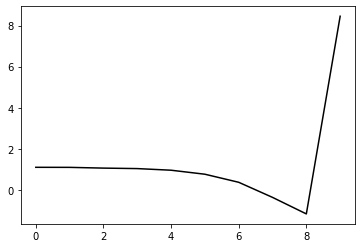

394900 0.1814191071743647
0.250246057242607 -0.1764537699666376 -0.2073078215459713 -0.12814045731073254
[ 1.08033403  1.07169198  1.07202244  1.04138069  0.96135706  0.76894195
  0.37738126 -0.35676087 -1.16127151  8.48084677]


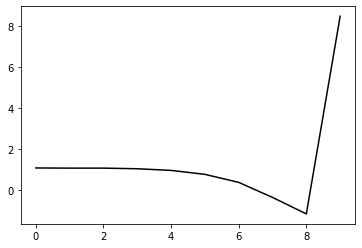

396000 0.20720912649863074
0.25312633030978804 -0.17677645175949164 -0.20849438824238534 -0.12610150606777337
[ 1.0664187   1.07577027  1.08733549  1.06027385  0.97801541  0.78592274
  0.39347887 -0.34247634 -1.15012059  8.45095599]


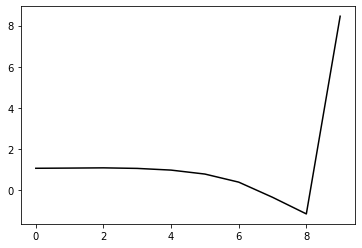

397100 0.18942428194522545
0.2523296618988277 -0.1758906972265686 -0.20769151461865928 -0.12731659513079324
[ 1.08655754  1.1119243   1.12363507  1.10535243  1.0285804   0.84197435
  0.45368915 -0.27928028 -1.08505     8.48025873]


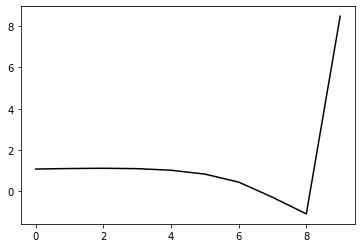

398200 0.16893090788698698
0.2470568406776372 -0.18220582378260686 -0.2111500062029773 -0.12850971653550064
[ 1.08698523  1.06543348  1.07656519  1.07696825  1.01977949  0.85283075
  0.48364993 -0.23015207 -1.01522754  8.45388321]


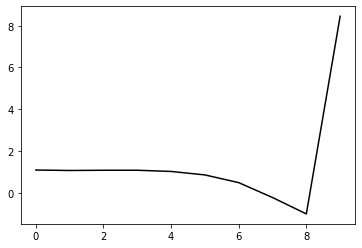

399300 0.1741785672387812
0.25086290945850803 -0.17964851191186687 -0.21001652031332732 -0.12745386316921797
[ 1.08852242  1.0740088   1.06636983  1.04396536  0.97264437  0.79422289
  0.41423158 -0.31021098 -1.1062307   8.48979857]


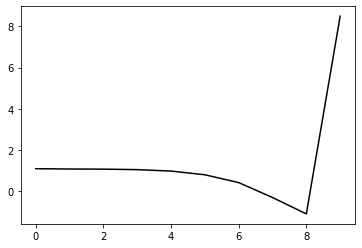

400400 0.18933381583007378
0.24444936424784564 -0.18192295568438102 -0.21064550435580445 -0.12859519460104835
[ 1.07874944  1.04416808  1.02377678  1.00403251  0.93697522  0.76488494
  0.3909701  -0.32822628 -1.11973337  8.43500244]


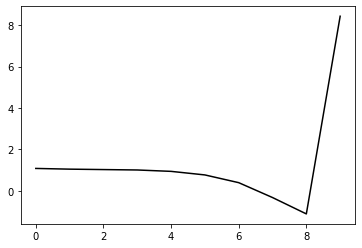

401500 0.2065283833634907
0.2463620548176506 -0.18111284844874306 -0.21038213137851675 -0.12879719265816195
[ 1.10557851  1.04824251  1.02695562  0.9970918   0.9256275   0.75233917
  0.37828167 -0.34069409 -1.13149493  8.48271458]


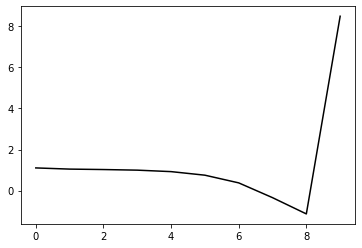

402600 0.14638602179403715
0.2552114436640706 -0.17522037665330478 -0.20815178564744832 -0.12976489723675286
[ 1.07243763  1.20505592  1.22099543  1.18405894  1.10238585  0.92086444
  0.53846946 -0.19038223 -0.99360564  8.46809794]


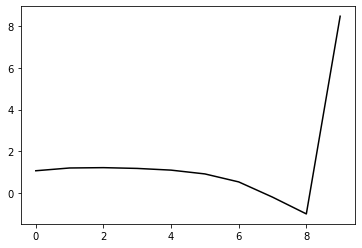

403700 0.2855103918682696
0.2521429203867392 -0.1725777507746699 -0.20555067762982188 -0.13099730547714483
[ 1.14068736  1.05768065  1.07855469  1.0526287   0.97198408  0.79200283
  0.41202383 -0.31483686 -1.11648867  8.49552345]


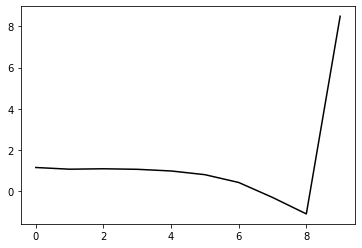

404800 0.13799837628014444
0.2454997345910708 -0.17686166083784083 -0.20753350432844542 -0.12941977790204431
[ 1.10375875  1.10271818  1.05735272  1.02170581  0.93765193  0.7543764
  0.37208009 -0.3570104  -1.16095331  8.44805342]


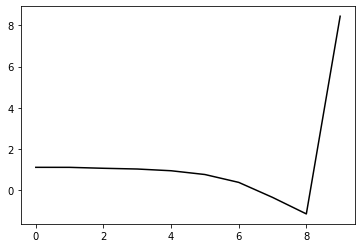

405900 0.1806497660711413
0.2502362528806809 -0.17497861284075222 -0.20760671632632582 -0.12831030972309
[ 1.05982167  1.01526865  1.02925021  0.99178272  0.9078182   0.72568361
  0.34474819 -0.38383864 -1.1885135   8.4819565 ]


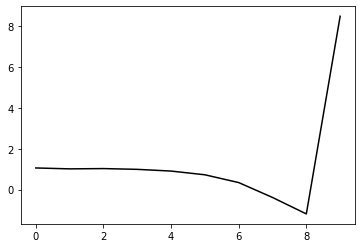

407000 0.21787112644593695
0.24798046218044462 -0.17724847049976025 -0.20893696258015101 -0.12709462018674555
[ 1.08252708  1.01368076  1.00061335  0.96739307  0.88354688  0.70216776
  0.32310946 -0.40359574 -1.20660775  8.44494326]


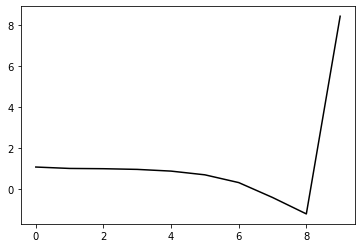

408100 0.18865994105618503
0.2505149950157108 -0.17539670175725613 -0.20812705054115282 -0.12785059003105623
[ 1.0824884   1.10920568  1.10375367  1.06879712  0.98194673  0.79705806
  0.415062   -0.31515177 -1.12315306  8.46844928]


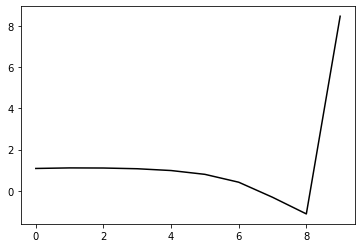

409200 0.1779365041265319
0.2509009446113004 -0.17356542616509807 -0.2067602100189868 -0.12971457601140607
[ 1.09379215  1.16673395  1.17738619  1.15011315  1.06718617  0.88508286
  0.50613106 -0.22149202 -1.027871    8.45836483]


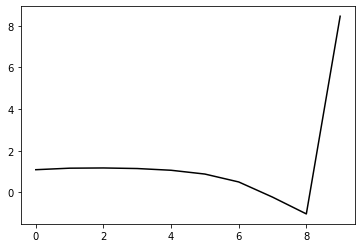

410300 0.17650977927680378
0.25454677551905763 -0.17444936149536766 -0.20842823985026962 -0.12776690761243678
[ 1.04470795  1.18828446  1.2041669   1.17733688  1.09261064  0.9075757
  0.52634513 -0.20371774 -1.01390338  8.50585881]


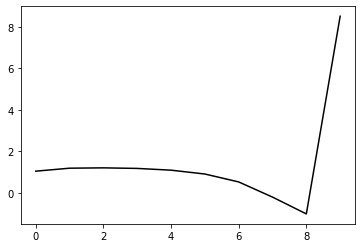

411400 0.16349827363797242
0.25308254166767563 -0.17538259481228513 -0.20870676632302523 -0.1286640501571112
[ 1.08085013  1.16280624  1.186425    1.16911474  1.09239205  0.91379887
  0.53945552 -0.18321302 -0.98567791  8.45308083]


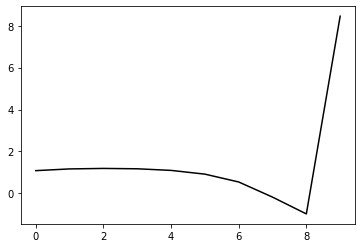

412500 0.2016848416735921
0.24683066060326878 -0.17620488644861648 -0.20791503316601181 -0.13007983573412746
[ 1.10227973  1.0508523   1.04659498  1.03233197  0.95743223  0.77950037
  0.40655132 -0.31376307 -1.11328229  8.47963544]


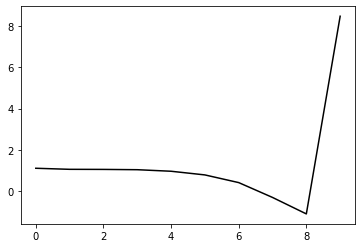

413600 0.20953898613509
0.25183395834611344 -0.17335152889843086 -0.20702323382114854 -0.12935798393949724
[ 1.12769887  1.09107858  1.08960488  1.06935575  1.00008423  0.82712955
  0.45797728 -0.25940929 -1.05750481  8.47372283]


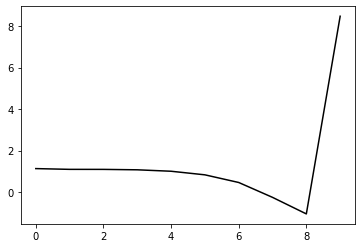

414700 0.12350315817493263
0.2496983819757486 -0.17848348240035145 -0.21034333398214433 -0.12771428393358783
[ 1.07025632  1.1430223   1.11140959  1.07635741  1.00065445  0.82458211
  0.45324238 -0.26518931 -1.06349379  8.46582985]


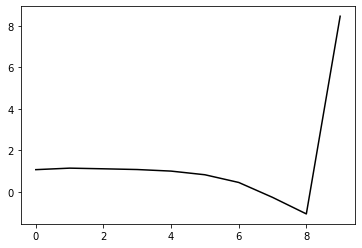

415800 0.1260531332079102
0.24937096510646023 -0.17452672611579137 -0.20725508115885324 -0.1300446295879581
[ 1.08178432  1.1287198   1.13988351  1.10911326  1.03193741  0.85687856
  0.48616455 -0.23262764 -1.03323863  8.48752484]


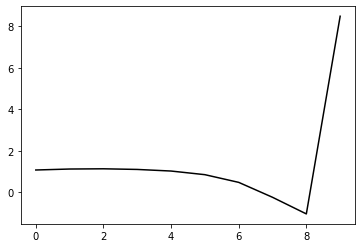

416900 0.18169118216411848
0.25045253997499034 -0.1750823690750154 -0.20811728202302915 -0.12812021150785313
[ 1.08023891  1.05872029  1.06009191  1.03140853  0.95229212  0.77641108
  0.40580783 -0.31289156 -1.1143678   8.49381559]


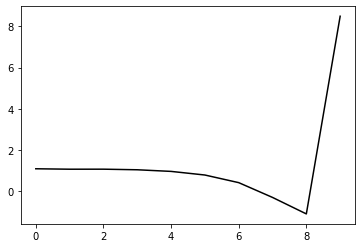

418000 0.2221184551692834
0.24937106749471014 -0.18060641630911708 -0.2121683901169655 -0.12601125003585203
[ 1.04645892  1.01882472  1.01881696  0.9988909   0.92748809  0.759761
  0.39849946 -0.31025022 -1.1015055   8.44500525]


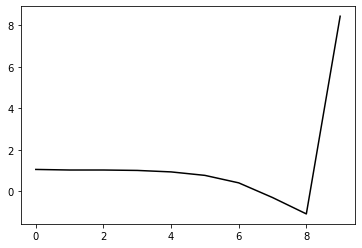

419100 0.24165594412725788
0.2479093070056112 -0.17658511869334595 -0.2087342721057897 -0.12981561223113436
[ 1.12629882  1.04667667  1.03984676  1.01779693  0.95112567  0.78823756
  0.43194054 -0.27219065 -1.05972879  8.48170663]


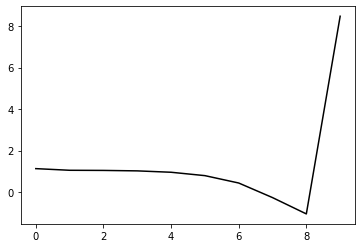

420200 0.17242475407523902
0.2509401287711561 -0.17591973639892236 -0.20873970342600112 -0.12762592273166076
[ 1.05846318  1.12967825  1.10250345  1.05561095  0.97146456  0.79650552
  0.43164119 -0.27869413 -1.07127341  8.44656747]


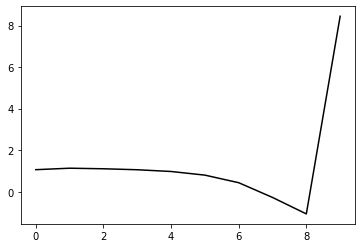

421300 0.21451428135334927
0.25391713591704307 -0.1696767444476081 -0.2050071516878511 -0.12907896636747232
[ 1.11074695  1.08679934  1.10819963  1.06596891  0.97422203  0.79281558
  0.4225545  -0.29332746 -1.09296923  8.51157533]


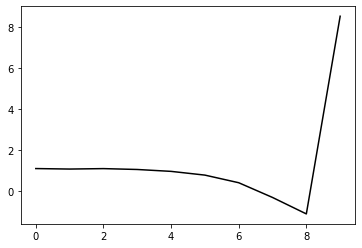

422400 0.22864963520819884
0.24299558550994557 -0.18004875434141296 -0.21037190620004004 -0.12978662421233453
[ 1.1641702   0.99949439  0.99770266  0.97681521  0.9007035   0.73340217
  0.37872979 -0.32011055 -1.10087825  8.4569228 ]


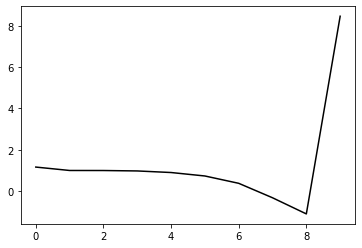

423500 0.21059473841368437
0.24350495965575947 -0.17754113805764096 -0.2088137237973284 -0.13064561111169554
[ 1.11265538  1.10481698  1.06726984  1.02690964  0.94413394  0.76989007
  0.40911505 -0.29567193 -1.08397474  8.47683463]


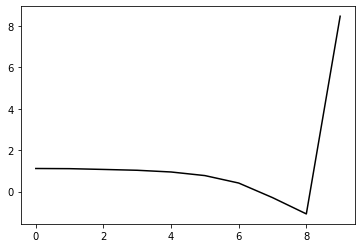

424600 0.15938438016914946
0.24889134244979233 -0.17764715243241982 -0.21049480502728157 -0.1264015015152892
[ 1.10546654  1.07809222  1.07057087  1.02173658  0.93208152  0.75338876
  0.389298   -0.31823483 -1.11016519  8.47038607]


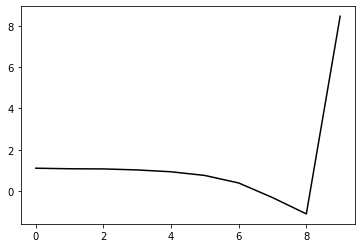

425700 0.11887870554782505
0.24943095784847985 -0.17630982689145647 -0.20933084868814383 -0.1284533248086857
[ 1.09966538  1.11967947  1.15204933  1.11733626  1.02762736  0.84873713
  0.4855807  -0.22032282 -1.01121975  8.47618768]


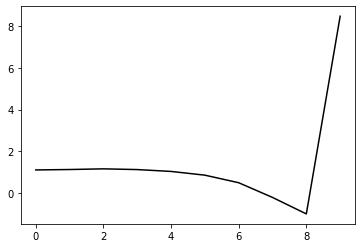

426800 0.14419113419468166
0.24643624018272475 -0.17173498258733708 -0.2051476252203992 -0.13019848829217567
[ 1.09205961  1.02093318  1.03652548  1.0017757   0.9049638   0.71694989
  0.34659021 -0.36481291 -1.16097285  8.4516665 ]


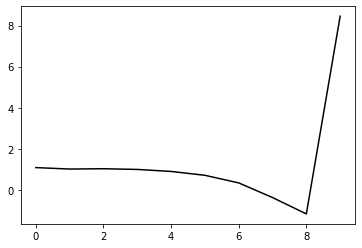

427900 0.17303464987314288
0.24433685501247002 -0.17619313972433728 -0.20813350434236466 -0.1271269597308056
[ 1.07856348  1.04526547  0.99132638  0.94516168  0.84509207  0.65242827
  0.27825221 -0.43594    -1.23461506  8.46067513]


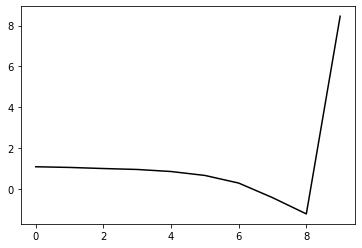

429000 0.20248074403079638
0.24874352883357234 -0.18003696605377445 -0.2123287343676099 -0.1260340135133688
[ 1.07091675  1.01164913  1.02710277  0.98779699  0.89617804  0.71068758
  0.34316533 -0.36403294 -1.15574752  8.45156088]


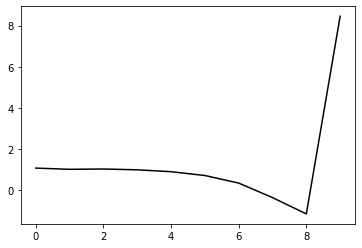

430100 0.195048351662947
0.2472024539403527 -0.1778987062094137 -0.2105911295598912 -0.1269065084982093
[ 1.08964811  1.12112059  1.10316964  1.06197534  0.96698006  0.77666315
  0.40356513 -0.3094845  -1.10893271  8.49789589]


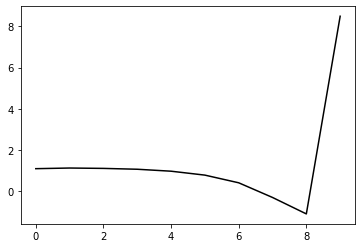

431200 0.19438685007529785
0.24505938135766922 -0.1741075876074813 -0.20761754573664218 -0.12959908444853563
[ 1.10948015  1.07203921  1.07620144  1.04528904  0.95837272  0.77488212
  0.40761889 -0.29977562 -1.09487117  8.46172572]


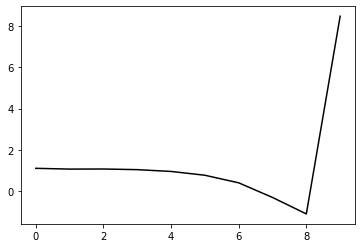

432300 0.1683417865592436
0.24969417735777616 -0.17729898868822141 -0.21147104762292762 -0.1278298205904453
[ 1.0671226   1.20600304  1.22347834  1.20320136  1.12390802  0.94448757
  0.57879271 -0.12831426 -0.92567988  8.51004575]


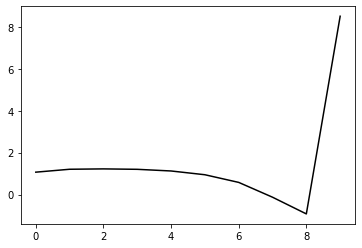

433400 0.18634284874353946
0.24458593188590494 -0.17740205522676072 -0.21064089595837743 -0.12697703860360257
[ 1.09515962  1.12650107  1.10656837  1.0781303   0.99548954  0.8128978
  0.44412713 -0.26518371 -1.0650285   8.4304274 ]


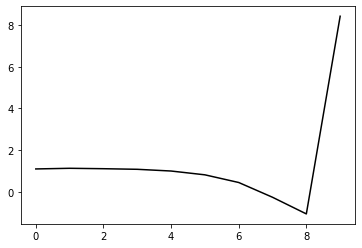

434500 0.23390649116492138
0.24439373867583017 -0.18133521915297074 -0.21405445252785038 -0.12457400562236552
[ 1.08515353  1.08974755  1.06887609  1.04267054  0.96578847  0.78880554
  0.42468125 -0.27995765 -1.07532063  8.4843994 ]


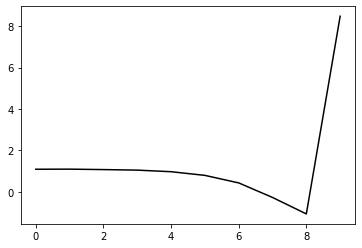

435600 0.16334272285561657
0.24640269922542327 -0.17923005403366737 -0.21290344257452237 -0.12641255059958814
[ 1.11887811  1.07770466  1.07169462  1.04117261  0.96415822  0.78831926
  0.4248737  -0.27913792 -1.07456925  8.45569038]


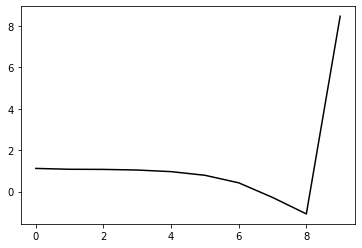

436700 0.11743659382466154
0.2473921916759607 -0.17699248853826893 -0.21146620072250344 -0.1273243826164819
[ 1.08910688  1.15702326  1.15387146  1.11943071  1.03721411  0.85766178
  0.49032564 -0.2176902  -1.01818426  8.48046039]


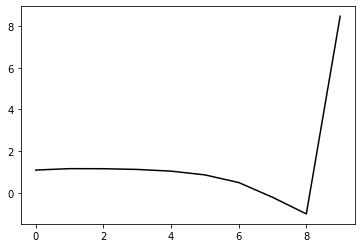

437800 0.13918989336143428
0.24718032531616443 -0.17444248454524844 -0.20971986343866297 -0.12885880393619292
[ 1.1275509   1.13050539  1.15438709  1.13136893  1.05418923  0.87927368
  0.51570451 -0.18915627 -0.98745962  8.47890991]


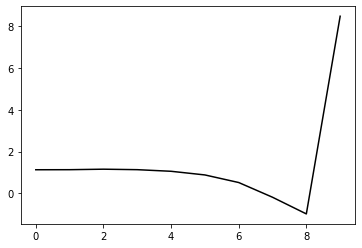

438900 0.18784544766891004
0.2486740781248129 -0.1746204602572019 -0.21022796180419387 -0.12623640184047383
[ 1.06645657  1.04914876  1.05081911  1.01675312  0.93041459  0.74809185
  0.37913913 -0.32925232 -1.1300194   8.48987437]


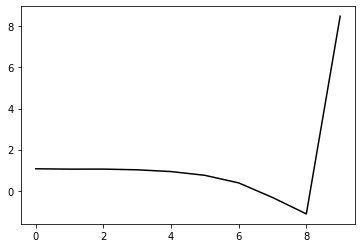

440000 0.21769719954239938
0.2502123417542446 -0.17639802010651573 -0.21203132585214263 -0.1258553683900514
[ 1.05904671  1.15841744  1.13866896  1.09509975  1.00334961  0.81572487
  0.44164641 -0.27163167 -1.07779409  8.46491426]


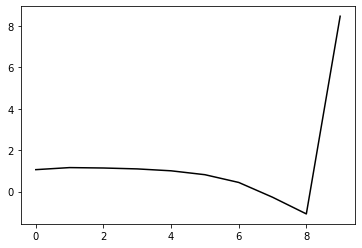

441100 0.26285165871846855
0.24399932676840103 -0.17785721898358223 -0.21171829636467834 -0.12884012554954555
[ 1.16156707  0.98926773  1.00685592  0.98511172  0.90966378  0.73746085
  0.3778862  -0.32117604 -1.11296311  8.50974405]


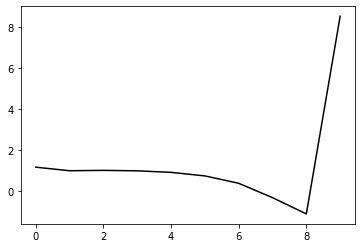

442200 0.20979159452162874
0.24611330858218303 -0.17177835884931916 -0.20767836181674454 -0.13143867306765564
[ 1.13215054  1.13851847  1.13440684  1.10011373  1.01498327  0.83331399
  0.46459485 -0.24344838 -1.04508524  8.46532003]


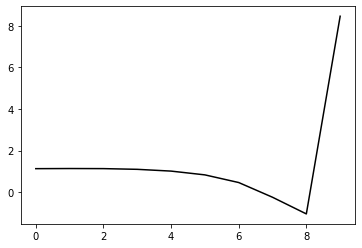

443300 0.16518639139342262
0.2537683517746488 -0.16917834690597475 -0.20759729188280354 -0.12729546267158834
[ 1.05688749  1.18929778  1.17824418  1.11893994  1.01032951  0.80872115
  0.42288071 -0.30020897 -1.11634192  8.50597912]


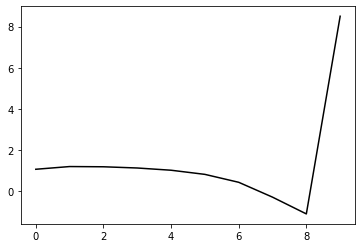

444400 0.19419851989827733
0.25137658802523277 -0.17457844821358676 -0.21097534406291246 -0.12631310255967823
[ 1.08278616  1.02339976  1.03506167  1.00310233  0.91011773  0.72190963
  0.34982758 -0.35849895 -1.15834954  8.43017691]


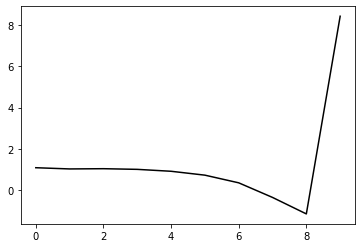

445500 0.21783647292705574
0.2437671547766355 -0.17961941836151749 -0.2131052986050442 -0.1262753466243109
[ 1.11270568  1.00088253  0.96152149  0.93086274  0.84292368  0.6569284
  0.28676192 -0.41910976 -1.21602694  8.46687463]


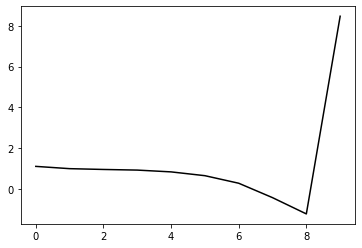

446600 0.1529115761409328
0.24921558619666262 -0.17222098397153238 -0.20847786505313887 -0.12873067189734824
[ 1.08790568  1.1092259   1.07894917  1.02716451  0.92843133  0.73275195
  0.35305268 -0.36194335 -1.16864174  8.44492164]


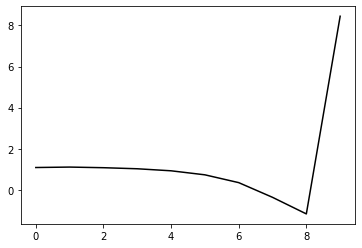

447700 0.11652672028818302
0.25352462656222496 -0.17271057145807064 -0.20976509359908901 -0.12864181197767124
[ 1.08040938  1.13870367  1.13976797  1.09603534  1.0025789   0.81319826
  0.43948384 -0.26932689 -1.06978307  8.47718816]


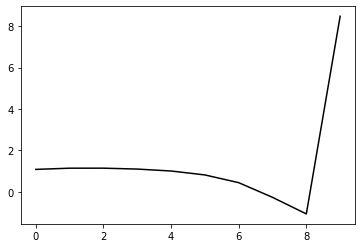

448800 0.12747593661308723
0.2465940579332585 -0.17630032046028002 -0.21096240906778718 -0.13103773980370687
[ 1.09773853  1.14507058  1.10289617  1.05642179  0.96249098  0.77366053
  0.40115125 -0.30556926 -1.10315999  8.46387525]


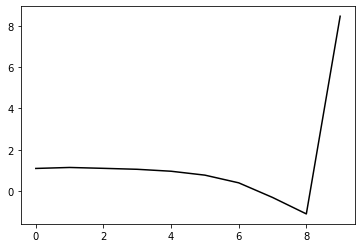

449900 0.178343492470854
0.24985071156291275 -0.17373641461612113 -0.210075256565495 -0.1298335132810025
[ 1.0686793   1.02158709  1.02884057  0.98199739  0.88551032  0.69524278
  0.32145182 -0.38641233 -1.18549541  8.49052803]


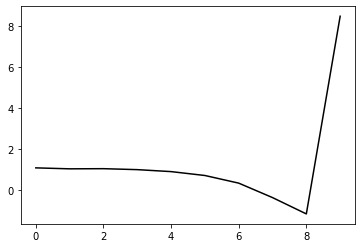

451000 0.21690205904426846
0.2495220154322726 -0.17526724876061275 -0.21134566929983056 -0.1279241116921064
[ 1.08516421  1.04025419  1.02807495  0.98471164  0.88709636  0.69549921
  0.32090946 -0.38726328 -1.18656886  8.4549009 ]


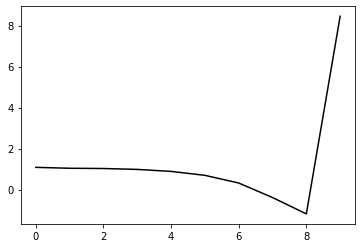

452100 0.19070062620063855
0.25220792137169934 -0.1733702852739968 -0.21039773772895948 -0.12932011729478948
[ 1.08990198  1.10210639  1.1117594   1.07402401  0.97801331  0.78647042
  0.41175262 -0.29658035 -1.09670515  8.46722208]


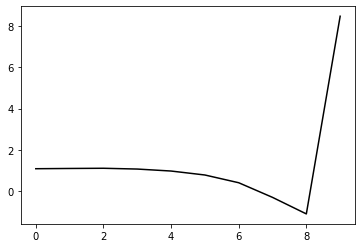

453200 0.17077092161399324
0.253620124808459 -0.17119607108100798 -0.20921325891436168 -0.12962682182852947
[ 1.08159631  1.18432164  1.19017228  1.15542472  1.05842876  0.8635199
  0.48512384 -0.22680554 -1.03110687  8.46437951]


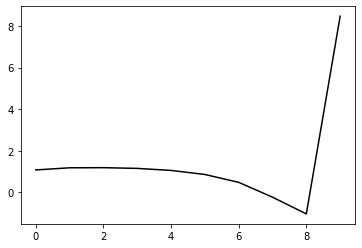

454300 0.17198076274068688
0.25666799516101335 -0.17164264372520482 -0.21034886815571616 -0.12884309173704442
[ 1.0507796   1.19141781  1.2052653   1.17287317  1.07692128  0.88071765
  0.50052679 -0.21300802 -1.01927189  8.52028062]


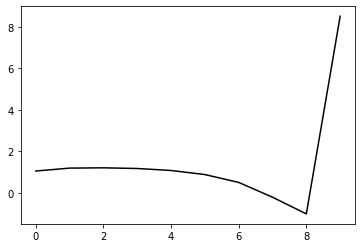

455400 0.1739206281209513
0.25482612949900235 -0.1705781387285246 -0.20910710969332905 -0.13053135153916168
[ 1.10751541  1.15902354  1.18468721  1.16273226  1.07588377  0.88585663
  0.51054101 -0.19811192 -0.9993792   8.45737132]


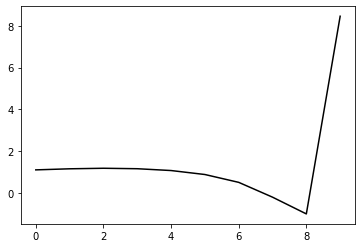

456500 0.23324181225003163
0.2550207773975568 -0.17309523958862516 -0.21124870501395498 -0.12866587326850315
[ 1.03759874  1.08318793  1.0975726   1.07797134  0.99600898  0.80961688
  0.43711911 -0.26837968 -1.06636413  8.50883741]


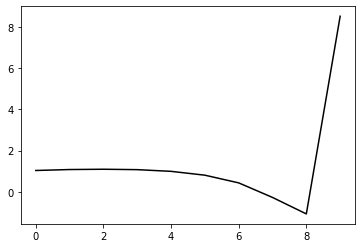

457600 0.1565273065638363
0.2555155305519268 -0.17342780869830335 -0.21159441264956935 -0.12826294786830938
[ 1.09412284  1.04842255  1.07661681  1.06185087  0.98748791  0.80762095
  0.43997359 -0.26084996 -1.05407623  8.45309367]


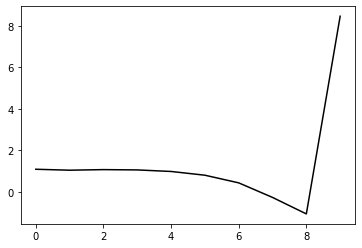

458700 0.13810180622559665
0.25010210774992175 -0.17182631479357596 -0.20923179952380225 -0.13068631279885035
[ 1.10911513  1.04279945  1.05170391  1.04172923  0.97355332  0.7991845
  0.4351883  -0.26274679 -1.05381045  8.48898133]


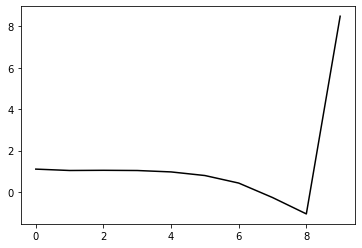

459800 0.12796396860270468
0.2516401560912773 -0.17175651839938025 -0.20953744440684466 -0.13022053071124357
[ 1.08092856  1.08991686  1.09018897  1.07388596  1.00418721  0.82928345
  0.46366115 -0.23616822 -1.02935252  8.46595537]


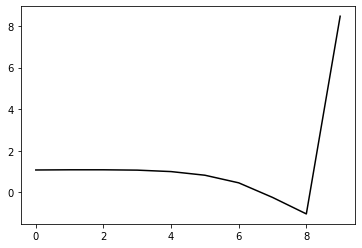

460900 0.19021538416554173
0.2546042415423742 -0.17095164071604882 -0.20977875612751284 -0.12867220014063133
[ 1.06645883  1.06871525  1.07040723  1.04825712  0.97483178  0.79809553
  0.42988767 -0.27309673 -1.07012191  8.48706746]


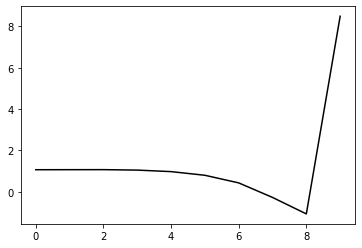

462000 0.20661228007218946
0.25521846521397257 -0.1724558167563839 -0.21104685861804437 -0.1275031858266874
[ 1.06363235  1.07687184  1.06970199  1.04615449  0.97284464  0.79805562
  0.43173551 -0.26935126 -1.06398131  8.46146323]


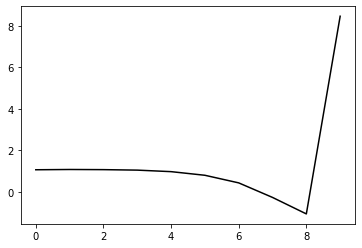

463100 0.19037248544685667
0.25454917730285703 -0.17206214058422784 -0.21058514278526652 -0.12841676044484968
[ 1.09108494  1.0825631   1.07722228  1.05552173  0.98673159  0.81762626
  0.45631891 -0.24061013 -1.0314058   8.48614234]


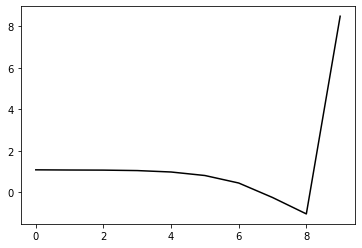

464200 0.15672619952631514
0.2550956995547156 -0.17117981396161172 -0.2101423442042619 -0.12928085043532092
[ 1.07917358  1.1649194   1.1650559   1.14425495  1.07769735  0.91198876
  0.55343473 -0.14191688 -0.93204991  8.47106949]


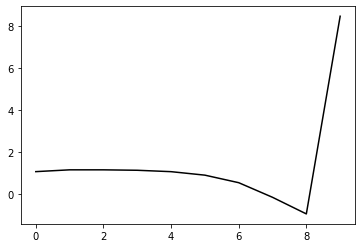

465300 0.17593004085552724
0.2571347722963605 -0.17169555047270418 -0.21118725191351057 -0.12830696203849062
[ 1.05542932  1.17127893  1.17295672  1.14747555  1.07749796  0.91055297
  0.55112007 -0.14585512 -0.93842342  8.52001902]


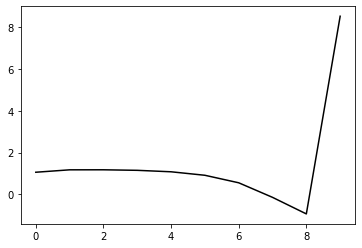

466400 0.15263886900508733
0.2567431229827896 -0.17055345647045203 -0.21034652851916527 -0.12906232614583246
[ 1.10121425  1.16632415  1.18261374  1.16051766  1.09305138  0.93023715
  0.57543504 -0.1175433  -0.90641364  8.46581006]


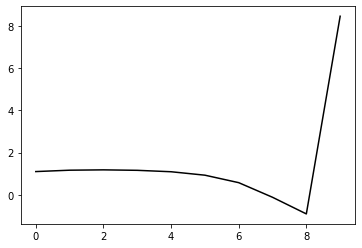

467500 0.19155452489204683
0.25063950526776774 -0.17653396419968093 -0.21366635914075763 -0.12868990533324906
[ 1.08811179  1.04279503  1.03350541  1.03157502  0.98356745  0.84078216
  0.50674146 -0.16568681 -0.93302617  8.51510837]


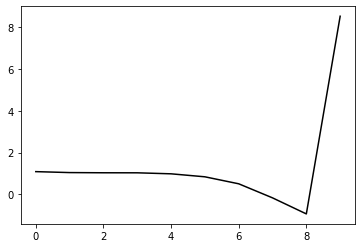

468600 0.19912330285305557
0.24745324279539 -0.17821879638992502 -0.21448718265537423 -0.12943730084709992
[ 1.14355759  0.98142136  0.96456642  0.9592433   0.91824725  0.78398601
  0.45857529 -0.20613046 -0.96657143  8.47286975]


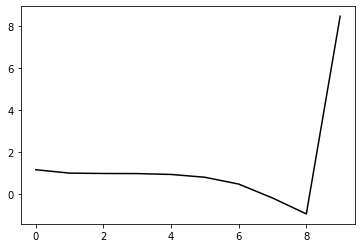

469700 0.1356343133938875
0.25199785879308406 -0.17461620364375938 -0.2131374598753298 -0.12493061605501271
[ 1.06856468  1.04175318  0.98530501  0.93911207  0.87092639  0.71539923
  0.37067405 -0.3134654  -1.094897    8.48564903]


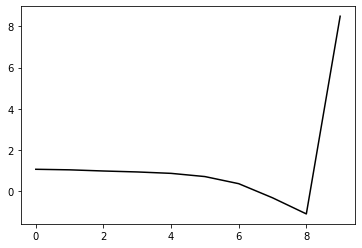

470800 0.1317396049378787
0.2508015766609348 -0.17131018120009595 -0.21013560941397091 -0.12925657529178194
[ 1.08044268  1.12039419  1.09200331  1.04815158  0.98382152  0.8370964
  0.50183112 -0.1742967  -0.94940764  8.48985578]


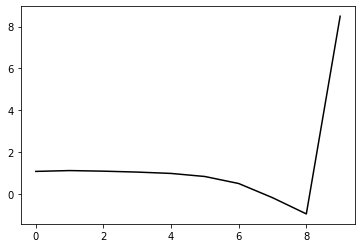

471900 0.1753606547874186
0.24829146395586063 -0.17016600147842673 -0.2085271693818723 -0.12820337889973102
[ 1.07446678  0.96620963  0.92999091  0.87633425  0.79618595  0.63933987
  0.29792044 -0.38295825 -1.16197801  8.48992034]


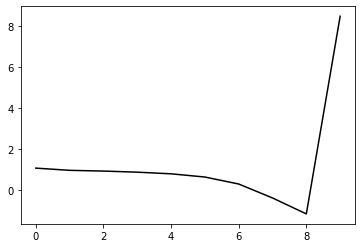

473000 0.1954525306277789
0.25358234169278265 -0.1677100811804663 -0.20790841790120348 -0.12816772460347056
[ 1.06798243  1.13117849  1.09431203  1.02625954  0.92906837  0.75776388
  0.4050341  -0.28678517 -1.07777407  8.4875411 ]


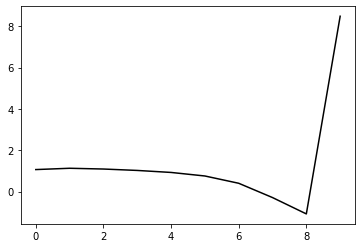

474100 0.18543314545990547
0.25347136821237304 -0.16816740189217558 -0.20823769791411356 -0.128040300060071
[ 1.06767321  1.09866841  1.08921199  1.03209942  0.9325059   0.75873858
  0.40668238 -0.28356284 -1.0729061   8.46580417]


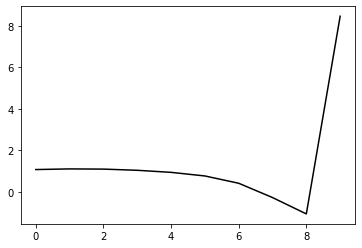

475200 0.18120192456379283
0.2504409613779995 -0.1695457804477625 -0.2086002316916995 -0.12960744968183038
[ 1.09266819  1.10038281  1.09594968  1.05996329  0.97347715  0.8093765
  0.46909577 -0.20875044 -0.98575713  8.46043985]


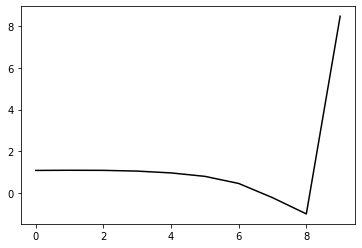

476300 0.1764503513359586
0.2475906936033944 -0.17244574629668763 -0.21013276138853987 -0.12977604578712135
[ 1.09023793  1.00815533  0.9955187   0.96557905  0.88489112  0.72407891
  0.38928531 -0.28126145 -1.04980798  8.50361452]


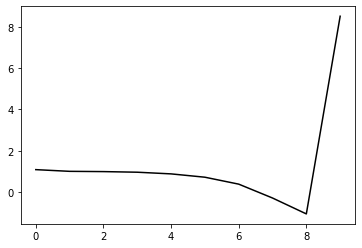

477400 0.27093750879597517
0.25206080369932005 -0.16702028874153238 -0.20712798333459295 -0.1315321691782547
[ 1.13050138  1.12519178  1.11572388  1.08099024  1.00184949  0.84016415
  0.50478596 -0.16618903 -0.93662896  8.46761221]


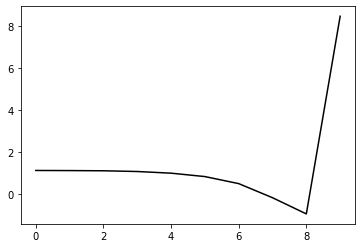

478500 0.22239720326568777
0.25075030136092047 -0.17199053692053276 -0.210871147518043 -0.12831623138529613
[ 1.04625499  0.99765878  0.98668707  0.94806201  0.8669276   0.7042209
  0.3699409  -0.29755706 -1.06335974  8.50804321]


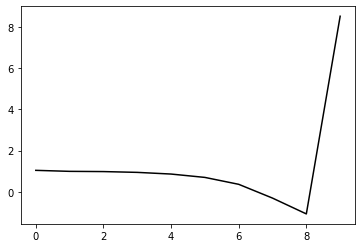

479600 0.15975372932573084
0.25215569554309775 -0.17173861444038527 -0.21146528642118861 -0.12620200746312812
[ 1.09680426  1.00059755  0.99200756  0.95441751  0.87605049  0.71464632
  0.38091385 -0.28646163 -1.0540859   8.45149829]


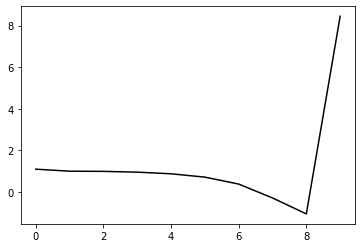

480700 0.12086850402956287
0.251453265905556 -0.17289382219022054 -0.21195860544982909 -0.12733371541919872
[ 1.07956448  1.08356645  1.07341891  1.03576747  0.95484688  0.79152702
  0.45699965 -0.2095346  -0.97590495  8.49978974]


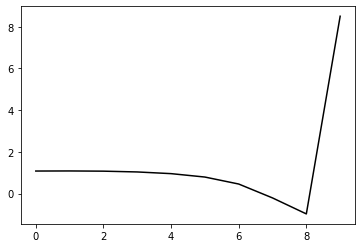

481800 0.23237587439043791
0.2519983550636889 -0.17950004874275619 -0.2173400343299729 -0.12395384848567804
[ 1.0539915   0.97003341  0.97710078  0.94808869  0.87278602  0.715559
  0.38862185 -0.26817894 -1.02337581  8.44563552]


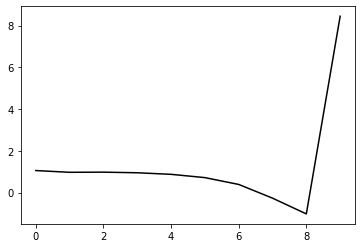

482900 0.18980402453037543
0.25027475502067736 -0.1724692711813809 -0.2112915328319144 -0.13043365030927578
[ 1.08424489  1.07528516  1.04663352  1.0153762   0.94362121  0.78882987
  0.4639705  -0.19060915 -0.94447524  8.49226232]


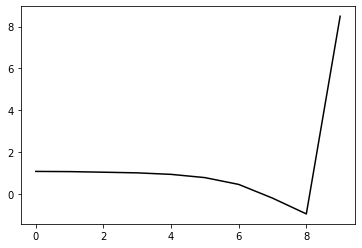

484000 0.2033008400527508
0.25324801108577444 -0.1743645934051494 -0.2138747408132381 -0.12536478714707858
[ 1.06032643  0.93769728  0.9368491   0.90083525  0.82480784  0.66704364
  0.33990204 -0.31573097 -1.07064808  8.47043997]


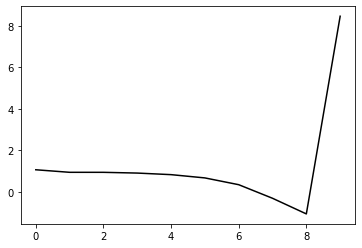

485100 0.23433188899410254
0.24717626446067287 -0.1752415154186512 -0.21327538198598087 -0.12928413652289722
[ 1.1400418   0.99921113  0.97364841  0.94578358  0.881603    0.73554399
  0.41983598 -0.22401691 -0.96739499  8.53196493]


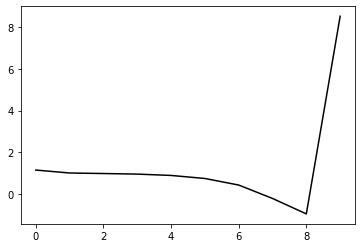

486200 0.18698588218455542
0.2475214157852038 -0.1762988145042949 -0.21409087424949141 -0.12727263843603887
[ 1.07040073  1.0293936   0.97648924  0.92550593  0.84458971  0.68547847
  0.35890716 -0.29348332 -1.04426346  8.46370651]


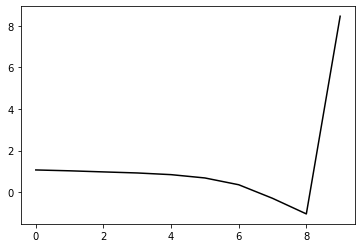

487300 0.1862578895481162
0.2505263607859961 -0.17827528046068594 -0.21653762202379506 -0.12709581697897113
[ 1.05737183  1.07678404  1.02235718  0.96826833  0.88830696  0.73240433
  0.40964672 -0.23834181 -0.98484517  8.50201355]


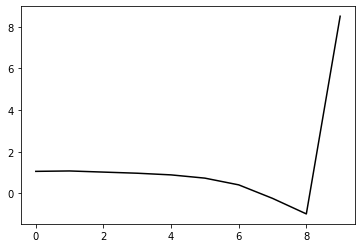

488400 0.20171784640498436
0.2562439600938236 -0.1664242280025644 -0.20872945894663195 -0.1305840711310103
[ 1.1147606   1.1613203   1.14355574  1.08021492  0.9873428   0.81978993
  0.48522059 -0.17523005 -0.93659382  8.47430021]


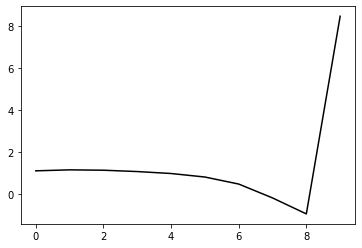

489500 0.1904657211217835
0.25660911240209194 -0.16710516053236188 -0.20948598511060407 -0.12962630695835256
[ 1.06750823  1.15534969  1.14303643  1.08592614  0.98924316  0.81918095
  0.48405258 -0.175634   -0.93612151  8.5090482 ]


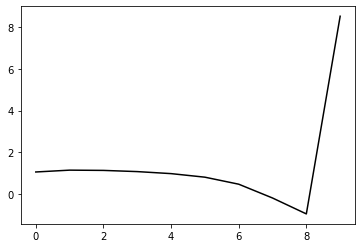

490600 0.16187288775248845
0.2494317034656237 -0.17135513427565366 -0.2110268751453034 -0.12864932127884135
[ 1.10444502  1.0393468   0.99315739  0.93955104  0.84222783  0.67089728
  0.33640462 -0.32072998 -1.07718168  8.46028234]


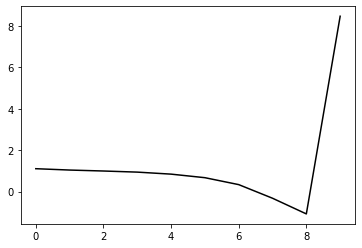

491700 0.12362997989043432
0.2527039344426743 -0.17014809944738118 -0.21054695171118307 -0.12981477771820862
[ 1.09908516  1.07347033  1.05275762  0.99374892  0.89275299  0.71756587
  0.38103407 -0.2762919  -1.03210879  8.48255262]


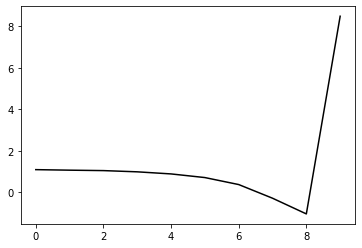

492800 0.1275737578694201
0.2537816990217038 -0.16879174635602234 -0.20967731458591654 -0.13092946566178812
[ 1.07728302  1.10630719  1.09498038  1.04148899  0.93864208  0.75990062
  0.42087828 -0.23753725 -0.99432008  8.46980206]


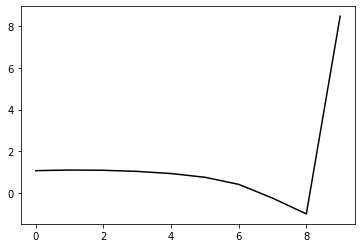

493900 0.19561341848303263
0.2561019178263635 -0.16941886577652332 -0.2108239406838524 -0.1290051800887008
[ 1.0539879   1.0821772   1.06488478  1.01366272  0.9088152   0.72522103
  0.38245613 -0.27781488 -1.03609659  8.49165184]


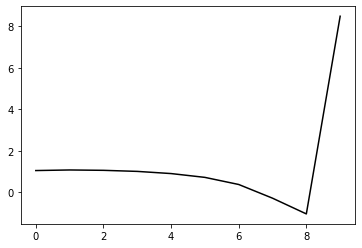

495000 0.20809370592737625
0.25578645393662053 -0.17188234817689677 -0.21285955096588707 -0.12759818508730844
[ 1.05239185  1.03954625  1.01853208  0.97590259  0.88083651  0.70331633
  0.36617741 -0.28721524 -1.03841202  8.46470993]


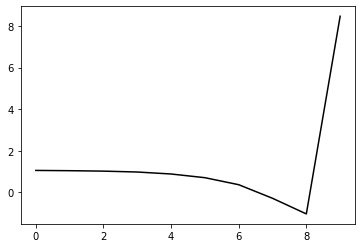

496100 0.19979648439209471
0.2512221630266547 -0.17441036712250937 -0.2139088100486676 -0.1285171808007732
[ 1.09491911  1.01466268  0.99398155  0.96122611  0.87989016  0.71393252
  0.38728783 -0.25451016 -0.99343971  8.49847748]


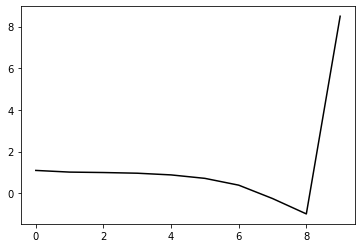

497200 0.17812335564595855
0.25452023702840226 -0.16721832510311863 -0.20931252898292635 -0.1293673026822915
[ 1.09052108  1.17410468  1.13528438  1.08033714  0.98317269  0.80139623
  0.45800383 -0.19958056 -0.95517231  8.4513762 ]


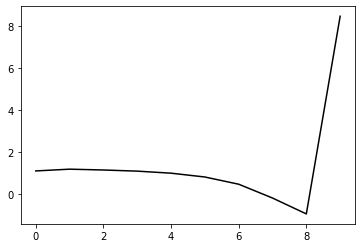

498300 0.17790843519438793
0.2492039754170013 -0.17068427571630088 -0.2105697467285543 -0.1304333417794162
[ 1.0930817   1.08883251  1.03320105  0.97992823  0.88551478  0.70746535
  0.36719614 -0.28628448 -1.03695443  8.4910322 ]


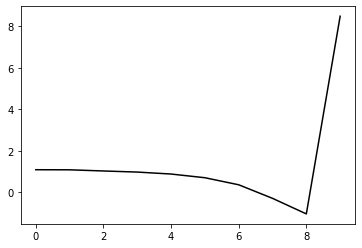

499400 0.24688344542865215
0.25642628479177393 -0.165257508636019 -0.20821102577682718 -0.1299618012972553
[ 1.13918366  1.11629702  1.10639709  1.05578244  0.96391763  0.78881836
  0.45016916 -0.20208707 -0.95273364  8.46767658]


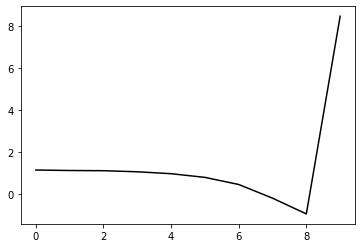

In [21]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

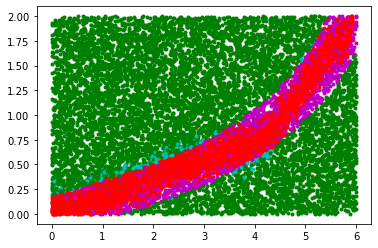

In [22]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 0.40063600702000346
0.26085743578286724 -0.1621098530586501 -0.21967930654862608 -0.1199520313584514
[ 1.03685648  1.07156001  1.04536571  0.99313868  0.89879317  0.7228398
  0.38472777 -0.26501417 -1.01087572  8.44933162]


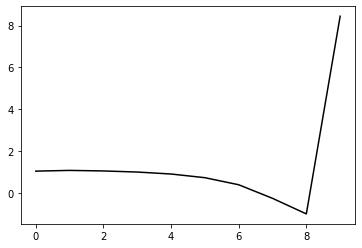

1100 0.25567309459357823
0.2466587254567332 -0.16134434840754214 -0.21499867798501493 -0.12568242594447998
[ 1.10454193  0.85473254  0.77974633  0.7070875   0.59773178  0.40967312
  0.06201918 -0.59442498 -1.34421412  8.43056051]


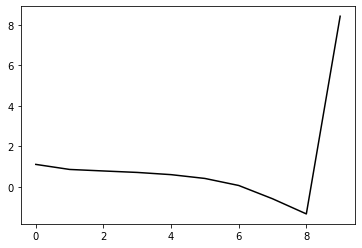

2200 0.1832500746790557
0.2563813922367373 -0.1556727517020821 -0.21187681865920077 -0.1346629694085046
[ 1.07656279  1.13115523  1.06166501  0.98036572  0.86895184  0.67993136
  0.33149604 -0.32479828 -1.07342865  8.46388776]


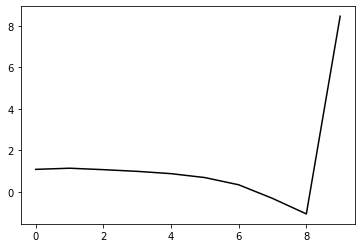

3300 0.1736722930098035
0.2516996208145532 -0.1609156998249696 -0.21458744650053385 -0.13583048402597733
[ 1.05647711  1.09128366  1.03106369  0.94918805  0.83277632  0.64079077
  0.28992274 -0.36791501 -1.117354    8.49634838]


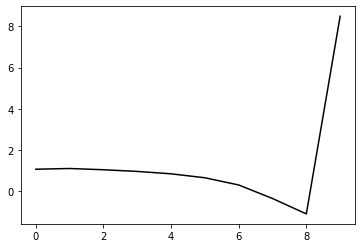

4400 0.22278782435240888
0.2413049098542534 -0.16613022467601798 -0.2170293273090489 -0.13097687581143705
[ 1.07286499  0.88684032  0.81748809  0.73859626  0.62185074  0.43099754
  0.08257996 -0.57141456 -1.31544859  8.40787049]


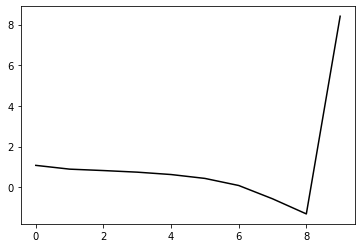

5500 0.19743688138973237
0.25492563624454445 -0.16065812765546106 -0.21525135756801653 -0.13573160402508333
[ 1.07486931  1.11568885  1.05407762  0.96754034  0.84601916  0.6503748
  0.29747734 -0.3606661  -1.10905672  8.47479734]


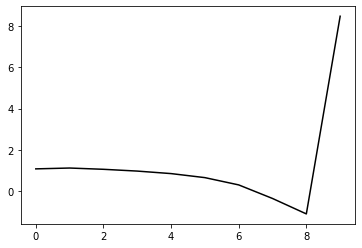

6600 0.17665358606979242
0.25890688294242703 -0.158800549832809 -0.21512959632755 -0.13378826587259576
[ 1.09985511  1.09558068  1.08464689  1.00884375  0.88684619  0.69005587
  0.33624395 -0.3225623  -1.07184582  8.47686979]


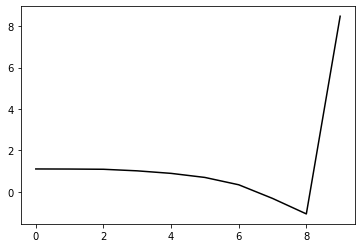

7700 0.1261462220968507
0.2543938706618778 -0.16070572219169724 -0.21538173921961304 -0.13302203604511426
[ 1.08280478  1.09519386  1.03293235  0.94672947  0.8111297   0.599976
  0.23484802 -0.43171687 -1.18550894  8.46598818]


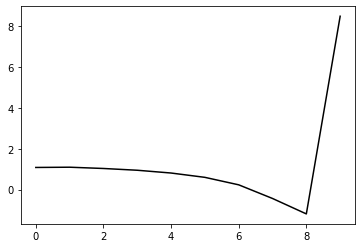

8800 0.145441063987672
0.25025135566421824 -0.16068668165583447 -0.21423696044095303 -0.13458930663029026
[ 1.09744556  1.07271827  0.98751241  0.88987409  0.74731193  0.52864226
  0.15766626 -0.51234433 -1.2674779   8.4479251 ]


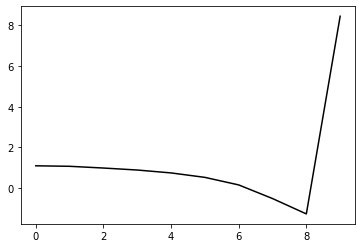

9900 0.18305809198044648
0.2530445169076609 -0.16603191400497572 -0.21939337301705705 -0.13456771327545514
[ 1.07201956  1.07014677  1.04093769  0.95953897  0.82941495  0.62115617
  0.25965446 -0.4007846  -1.14637386  8.50143095]


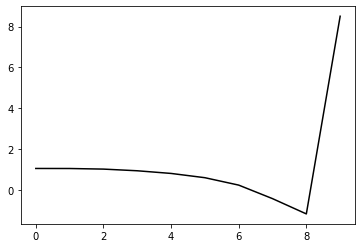

11000 0.21908968434488618
0.2577856370433692 -0.1662846864310712 -0.2206810434131865 -0.13219545188246157
[ 1.05733614  1.16940184  1.12025215  1.02383135  0.87755706  0.65320202
  0.27679996 -0.39710976 -1.15606345  8.44865595]


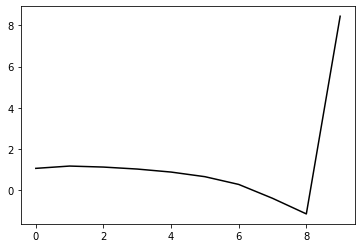

12100 0.19534267186511184
0.25789318903860403 -0.16269166740291494 -0.217990226666771 -0.13421865232053834
[ 1.10374394  1.13677127  1.13872133  1.05852787  0.91397633  0.68813889
  0.30990423 -0.36506576 -1.12481966  8.47874415]


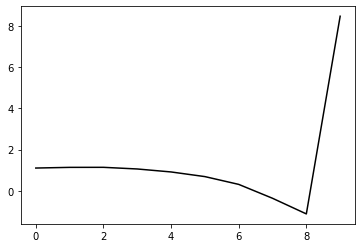

13200 0.1884094881389463
0.2558954482005139 -0.1596636370515589 -0.21543197848922757 -0.13454093393818364
[ 1.09450292  1.08611628  1.09321895  1.0295961   0.88506583  0.65238666
  0.26660156 -0.41472279 -1.18025991  8.44942472]


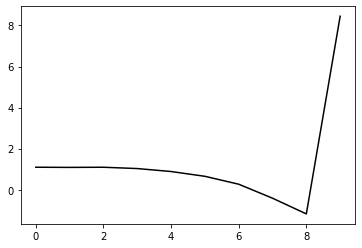

14300 0.21228515248822066
0.24333140021437716 -0.16363234250890915 -0.21614660990152298 -0.13600588602860852
[ 1.10656428  0.89692607  0.86812298  0.81208048  0.67519782  0.44499225
  0.06122485 -0.61631528 -1.37589042  8.45164442]


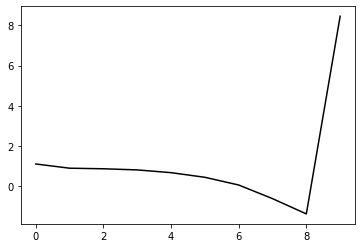

15400 0.15634327924009608
0.26192953343514996 -0.1600076149222074 -0.2174387484942981 -0.1352708543623349
[ 1.08548099  1.21627072  1.20133793  1.13927459  1.00374147  0.7691657
  0.37783506 -0.30817929 -1.0778411   8.43253016]


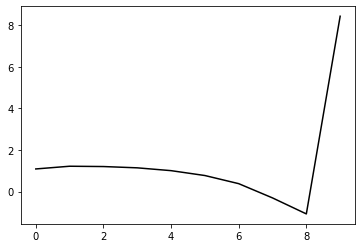

16500 0.1992438445227027
0.2553318542588452 -0.16550473961685966 -0.220074271165345 -0.13498859159137244
[ 1.09779338  1.10200568  1.09901495  1.04754724  0.92056189  0.69213814
  0.30600453 -0.37216798 -1.13000536  8.48094965]


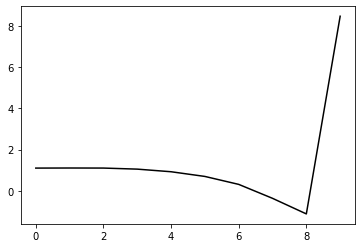

17600 0.16812756063475087
0.25378744373458023 -0.16675237544887397 -0.22096119711991696 -0.13563417657107887
[ 1.10829939  1.12228443  1.09640478  1.04554559  0.92195316  0.6937986
  0.30540232 -0.37475753 -1.1340267   8.46259069]


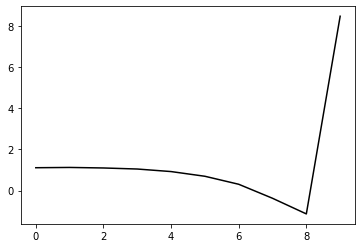

18700 0.1247587336861274
0.25865862509114546 -0.162230432922377 -0.21815910499204 -0.13448354325923748
[ 1.07272765  1.12932279  1.09688404  1.02305479  0.88285096  0.63954619
  0.23609525 -0.45673674 -1.22649778  8.4575523 ]


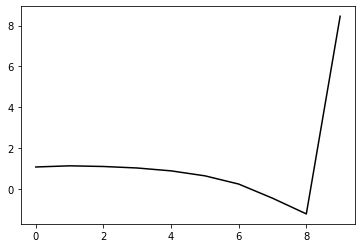

19800 0.12646377678053194
0.2587190508398503 -0.16137384789926565 -0.2176126025435407 -0.1362661098765934
[ 1.09218291  1.10285122  1.11604616  1.05952443  0.92815941  0.69090366
  0.28999358 -0.40046265 -1.16692558  8.45098307]


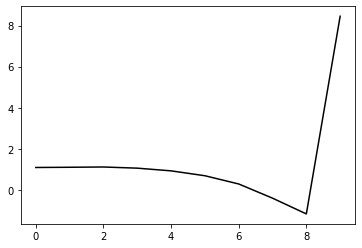

20900 0.19520567775004236
0.26018125941545617 -0.16208863336595855 -0.21843627213909744 -0.1352784153389939
[ 1.0592091   1.11371975  1.11345738  1.06292595  0.93149682  0.69035806
  0.28273018 -0.41376723 -1.18448411  8.47124781]


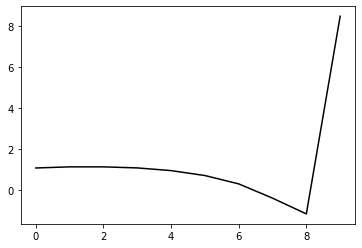

22000 0.2569795801770232
0.2592247237878385 -0.16637826557246338 -0.22182939920597947 -0.13056644802613657
[ 1.03435882  1.00712489  1.00160594  0.95021519  0.81873446  0.57483599
  0.16211209 -0.53859335 -1.31120682  8.41725911]


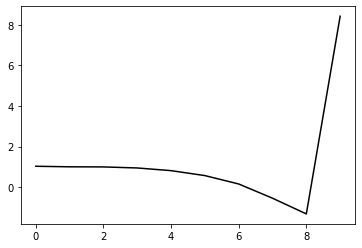

23100 0.19261803398264996
0.26050380345184676 -0.16041669162934458 -0.21718930631061903 -0.13544720533399127
[ 1.09301646  1.13974149  1.11456398  1.05479104  0.92280741  0.67570422
  0.25629224 -0.45201147 -1.23195079  8.46410595]


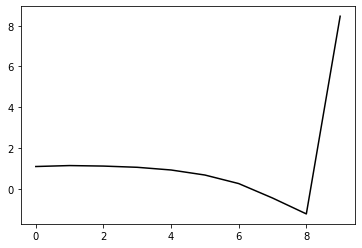

24200 0.18423588807308572
0.2561747645054741 -0.16726030143093806 -0.22153036413934532 -0.13473411329137408
[ 1.06150578  1.03606437  1.0450205   1.00557867  0.89023421  0.6591562
  0.25318123 -0.4411271  -1.20362392  8.44186025]


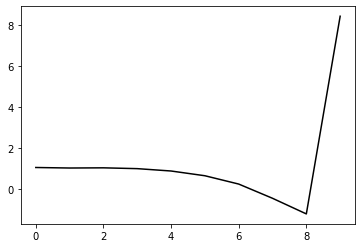

25300 0.17898972974437558
0.2546391394515576 -0.1655031397326774 -0.22004316765674167 -0.1363058806916356
[ 1.10120269  1.06308938  1.03427192  0.98824085  0.87492711  0.64484642
  0.23620102 -0.46224846 -1.2285156   8.49792701]


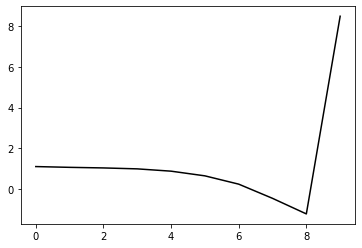

26400 0.1708083606502723
0.2618139520599727 -0.1565438901001985 -0.21499666362670714 -0.13543483687446056
[ 1.09030404  1.17220054  1.15379518  1.08920908  0.96177865  0.71906441
  0.29459199 -0.42159064 -1.20625529  8.42601345]


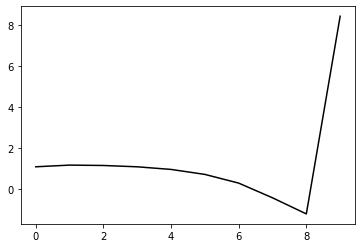

27500 0.19728121579089725
0.25399869649924584 -0.1625101634748493 -0.2178719583901251 -0.13744554896218913
[ 1.09509072  1.11137697  1.09085294  1.03667987  0.91812145  0.68583753
  0.26984032 -0.43825184 -1.21171382  8.47031913]


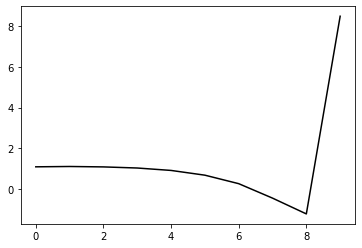

28600 0.17225571892569846
0.2575570141930217 -0.1636056113367769 -0.21973128838249498 -0.13407255324419623
[ 1.06433197  1.1290311   1.09703249  1.02822651  0.8996053   0.66060684
  0.23698638 -0.47939785 -1.25919278  8.4416811 ]


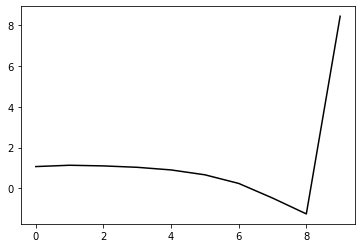

29700 0.13542630317617455
0.2607247548325835 -0.15561416458439575 -0.2145364348931552 -0.13467777377268392
[ 1.09510794  1.12201313  1.14888079  1.0929054   0.95949686  0.71353111
  0.27986388 -0.44959492 -1.24271125  8.45439336]


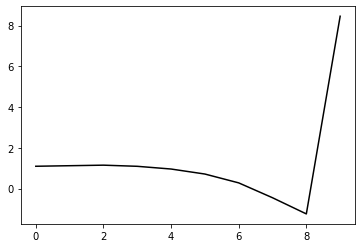

30800 0.16692334841930617
0.26181915918203913 -0.15355802473658528 -0.2132810956153292 -0.13408590206454923
[ 1.12351961  1.03984166  1.07259499  1.03693101  0.91142372  0.667978
  0.23513838 -0.49483268 -1.28665697  8.43407641]


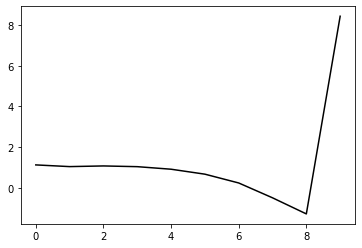

31900 0.1684469396805122
0.25674760099510013 -0.16537314008957563 -0.22128537820437347 -0.13236069122873062
[ 1.09854861  0.96287169  0.95181201  0.92816383  0.82789798  0.60564399
  0.19205365 -0.51895177 -1.28788403  8.45564613]


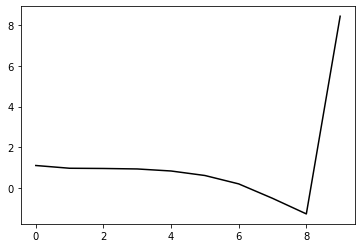

33000 0.25680372221931347
0.2571562235733607 -0.16747168570640564 -0.22324405568809266 -0.1322944564183229
[ 1.0465361   1.03975212  1.02752259  0.99892425  0.91057263  0.6998981
  0.29315978 -0.41437302 -1.18005051  8.44100207]


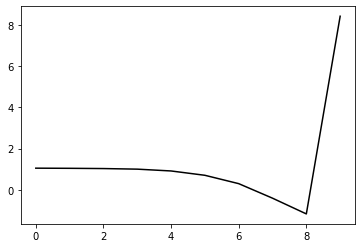

34100 0.199159732805644
0.2599522103705351 -0.15865318969137995 -0.21716103437891526 -0.13244305878379103
[ 1.11023219  1.13880676  1.09077766  1.03044192  0.92277339  0.69698517
  0.27348087 -0.452838   -1.23785443  8.45385607]


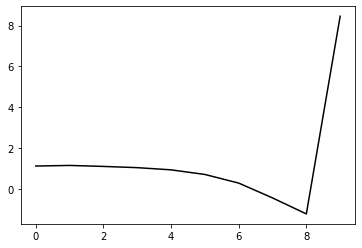

35200 0.17888445316945972
0.2597925700366817 -0.15874299700139458 -0.21708559398887 -0.1338272816076336
[ 1.08802049  1.12857128  1.12962644  1.07821493  0.97139697  0.75087978
  0.33157255 -0.39219735 -1.17342102  8.4551488 ]


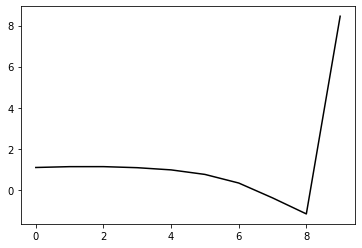

36300 0.18797566967004392
0.2573602429565897 -0.16692568429640958 -0.22323700572213442 -0.13170360562853115
[ 1.06032126  1.10831195  1.09558356  1.06032854  0.96541911  0.7577948
  0.35059454 -0.36289184 -1.13232639  8.47366791]


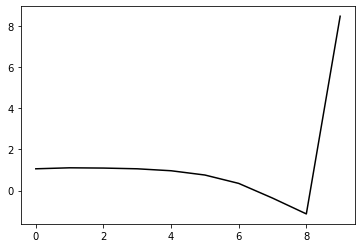

37400 0.16905404557309345
0.26168690536442696 -0.1556693115079733 -0.21610261970287092 -0.13165636102298156
[ 1.07728062  1.12722342  1.13187679  1.07909801  0.96471071  0.73801294
  0.31042776 -0.42723451 -1.22343218  8.40815336]


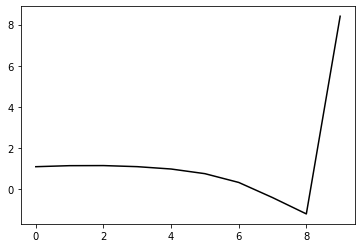

38500 0.19770265788249958
0.2606528731714083 -0.15667507422005617 -0.21648816416793779 -0.13342890485657866
[ 1.09604062  1.15287703  1.16111107  1.12379348  1.01871906  0.80075734
  0.3817913  -0.3483652  -1.13538263  8.47508626]


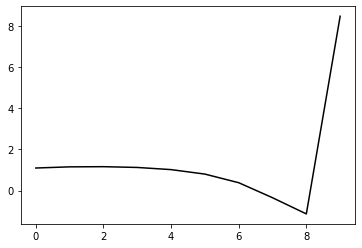

39600 0.1831271248989927
0.24969958174544024 -0.1638926221875645 -0.2197670619388566 -0.13112179303716634
[ 1.13975686  1.01492762  0.97275458  0.93014762  0.8249837   0.60752982
  0.19017592 -0.53817889 -1.32081945  8.43249204]


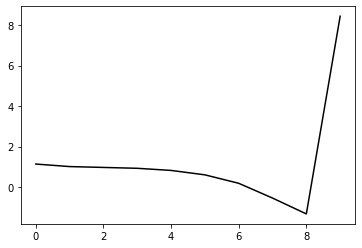

40700 0.11304296474322895
0.25803389963515255 -0.16333889982462718 -0.22085420611491302 -0.13489010396007922
[ 1.09460577  1.23254662  1.22155908  1.17469281  1.0718925   0.85657787
  0.43991239 -0.29020441 -1.07535747  8.49660638]


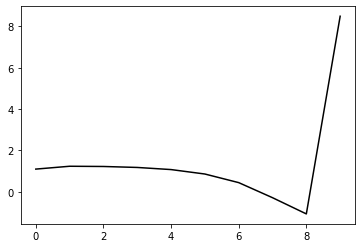

41800 0.13335175056010903
0.2575679205808432 -0.1596510621694918 -0.21833910526318648 -0.13379856342578997
[ 1.12509809  1.17076547  1.17311238  1.12681138  1.01847482  0.79943514
  0.37920614 -0.35632653 -1.14679941  8.46471007]


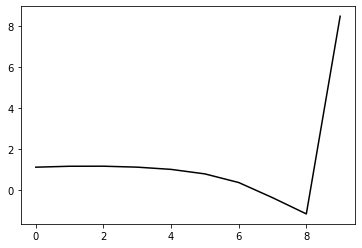

42900 0.18746851911436974
0.25706202244437953 -0.16093956085554867 -0.2198476783231216 -0.1309711642864795
[ 1.07252688  1.00659509  1.02874507  0.99622254  0.89546968  0.68302999
  0.26881105 -0.46287925 -1.24967617  8.46241678]


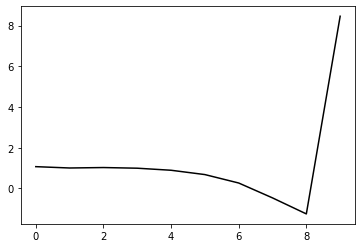

44000 0.20608269760679154
0.2537707595435111 -0.1634291301758427 -0.22131824145638 -0.13033962131810883
[ 1.08963126  1.08992416  1.05117846  1.010217    0.9072569   0.69156782
  0.27378155 -0.46275923 -1.25461917  8.43129197]


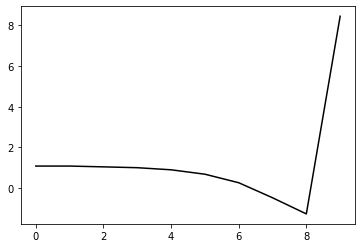

45100 0.199273395626164
0.2545993236642489 -0.1625534787726058 -0.22134020991199502 -0.1307477980158511
[ 1.12715205  1.06670642  1.06173627  1.02712786  0.93381788  0.72716152
  0.31669905 -0.41511189 -1.20309509  8.47353665]


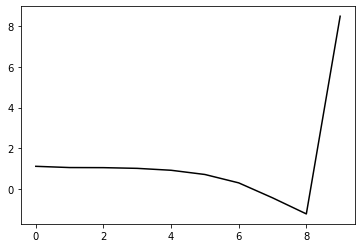

46200 0.17273561357335926
0.25253974080617886 -0.1644828937113932 -0.22260888387574307 -0.1304946064538573
[ 1.10700163  1.11068103  1.08708056  1.05061573  0.95818307  0.75369888
  0.34517819 -0.38613482 -1.17320931  8.43317751]


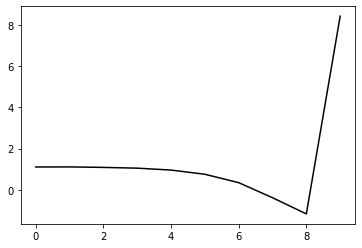

47300 0.16372647198353354
0.26174416355537167 -0.15592394060279133 -0.2181074137921612 -0.12963243511497843
[ 1.07681398  1.25464381  1.22365591  1.15623503  1.03756386  0.81045149
  0.38017319 -0.37450896 -1.18641892  8.50107971]


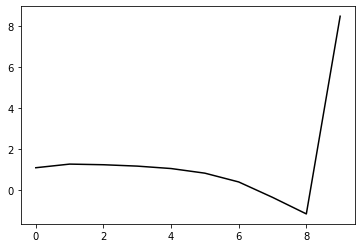

48400 0.1668539623376792
0.25755206001013187 -0.15982221416802983 -0.2201882558601184 -0.1320201787282156
[ 1.13675591  1.13170777  1.14304198  1.1090182   1.01352893  0.80919756
  0.40074259 -0.33429401 -1.12595162  8.45692359]


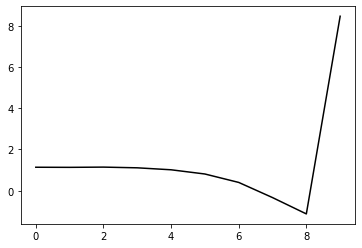

49500 0.30774537380221473
0.2637262888234678 -0.15655278982173304 -0.21974086250169847 -0.12749044422837083
[ 1.02870095  1.13096564  1.14345311  1.10219259  0.99636621  0.78080807
  0.36105371 -0.38776623 -1.19560668  8.47217389]


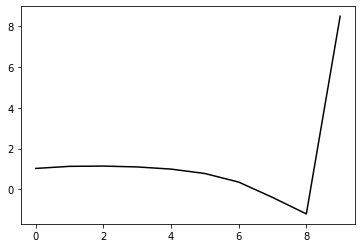

50600 0.21193662704316502
0.2572246712971681 -0.15655540140227822 -0.21793730539671277 -0.13187815013135992
[ 1.1520525   1.0673829   1.08219954  1.06013714  0.97238712  0.77315016
  0.36946077 -0.36468988 -1.15711845  8.4305457 ]


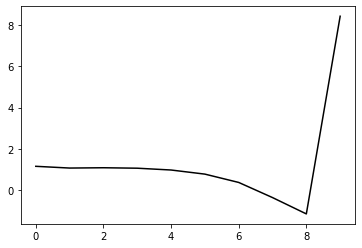

51700 0.1748839799867312
0.2581922667084677 -0.16216220969074435 -0.22275727222582437 -0.12713018382787222
[ 1.06829966  1.11294554  1.07463956  1.03300179  0.93608235  0.72905516
  0.3187733  -0.42216504 -1.22125027  8.43924099]


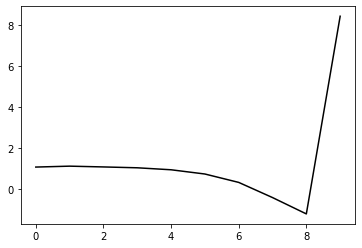

52800 0.13386237934312178
0.2581740284220363 -0.1588085212517017 -0.22032120352804296 -0.130294750775893
[ 1.10986936  1.17291773  1.15992608  1.11860576  1.02668356  0.82553469
  0.41982192 -0.31903531 -1.11754099  8.48838539]


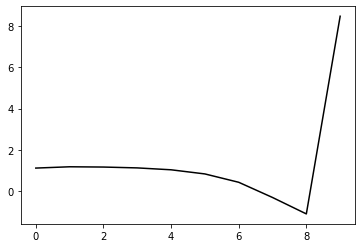

53900 0.2019940763052677
0.25723707480704644 -0.15995209178436529 -0.22154447909074476 -0.12834385025479098
[ 1.06184052  1.05969581  1.06965577  1.03328072  0.94057837  0.74053314
  0.33631429 -0.40223744 -1.20074598  8.48137393]


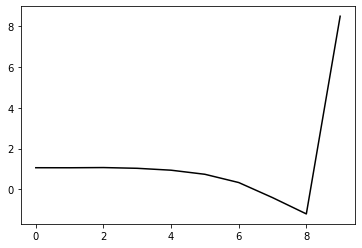

55000 0.2167222342632415
0.25271289611476444 -0.16058802194592522 -0.22122898777267888 -0.12724585168569633
[ 1.10906169  1.06607671  1.03259455  0.98614354  0.88597979  0.67918528
  0.26890435 -0.47652441 -1.28228766  8.41937552]


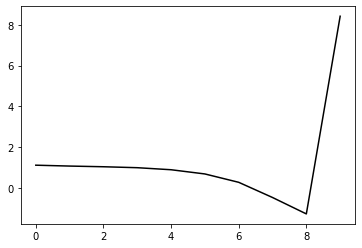

56100 0.21607858905148944
0.25493711921251017 -0.15884276387565607 -0.220316445254017 -0.12745409106688238
[ 1.14628647  1.05519708  1.04085072  0.99229794  0.89114857  0.68496621
  0.27605165 -0.46884227 -1.27427194  8.46665078]


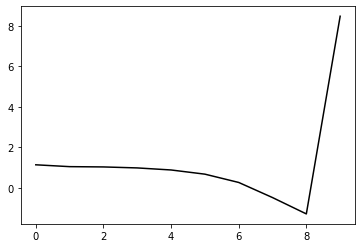

57200 0.17382221462056002
0.25953239798241595 -0.15496251952130205 -0.21805965604719826 -0.12956454254012426
[ 1.10733241  1.22325296  1.22015538  1.16787408  1.06026525  0.84801977
  0.43341378 -0.31838627 -1.13189861  8.44447146]


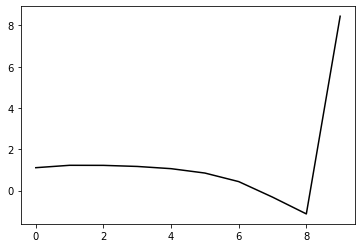

58300 0.16921273860598063
0.2589610505657014 -0.1550194075710192 -0.21792326490432662 -0.12956363343303837
[ 1.09283785  1.14230757  1.13968671  1.08908066  0.97698523  0.76102733
  0.34470251 -0.40867129 -1.22322301  8.47754759]


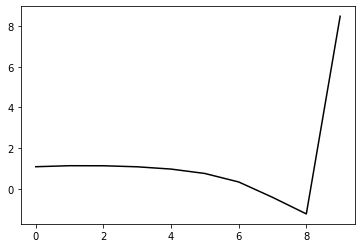

59400 0.19176508165935988
0.2558584222889468 -0.1609411228177227 -0.2217419835713899 -0.1286642752102457
[ 1.1276641   1.08371128  1.07865691  1.04838357  0.95340971  0.75250963
  0.35193286 -0.38550704 -1.18239075  8.43722699]


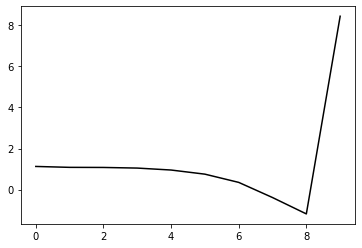

60500 0.18757309442621023
0.2608982595985384 -0.15670105080774932 -0.2196233965551735 -0.13017058246856333
[ 1.09487546  1.22628893  1.24276929  1.2093363   1.1114052   0.90532161
  0.49910681 -0.24510428 -1.05006396  8.51964612]


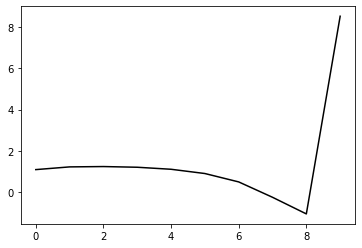

61600 0.19174771656003478
0.256697862524599 -0.15733633226239338 -0.21945544833105982 -0.1272407468017491
[ 1.06939703  1.02901623  1.02501428  0.98686779  0.87901774  0.66285317
  0.24861435 -0.50207643 -1.31184808  8.42534432]


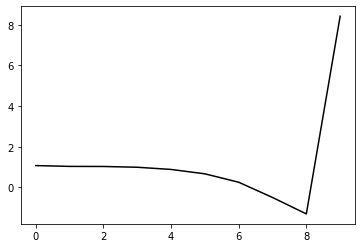

62700 0.12952213895221185
0.2542802595773754 -0.15741435863071895 -0.21860175634448312 -0.1313190570888831
[ 1.12311802  1.08344102  1.08127013  1.05464304  0.96493073  0.76399661
  0.36346516 -0.3745695  -1.17193894  8.46089823]


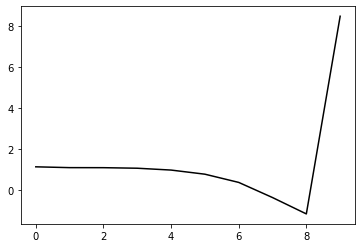

63800 0.1412303001877918
0.25276967626404057 -0.1592416283395133 -0.21947712460166385 -0.1327458051331636
[ 1.13978787  1.09689174  1.1125362   1.09465453  1.01566862  0.82498235
  0.43337538 -0.29664348 -1.08619813  8.45779974]


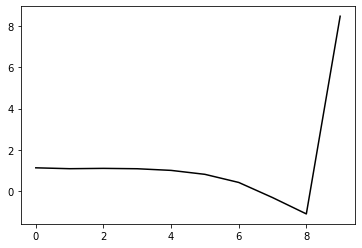

64900 0.1871892335767257
0.25519413147515674 -0.15801332736345497 -0.21929578480420334 -0.13092031033913443
[ 1.10943461  1.10527955  1.09419388  1.06046411  0.97286763  0.77544481
  0.37713831 -0.35989955 -1.15711944  8.47413807]


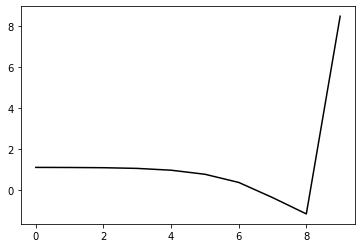

66000 0.22410513119519782
0.2595330647495666 -0.1540561295675077 -0.2180277386670778 -0.12838279871136873
[ 1.06236619  1.15035571  1.16274681  1.12836768  1.03308026  0.82848151
  0.42171175 -0.32580946 -1.13612378  8.45571647]


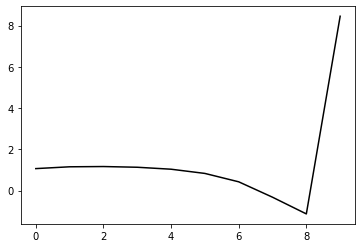

67100 0.19611062898953321
0.25502241176392126 -0.15554197331304084 -0.21844517723209217 -0.12737993483998755
[ 1.12367673  1.0437475   1.04082643  1.02008221  0.93925173  0.74897314
  0.35625245 -0.37797364 -1.17486124  8.46652313]


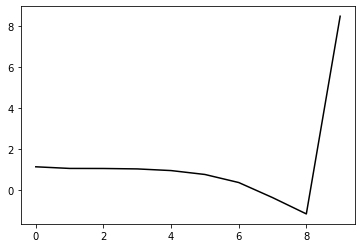

68200 0.18549087102044726
0.252480702294142 -0.15519020974912784 -0.21724296330278137 -0.13139770868268594
[ 1.12618984  1.12544985  1.11339876  1.09294948  1.02010447  0.83802286
  0.45257321 -0.27570011 -1.06761519  8.46690169]


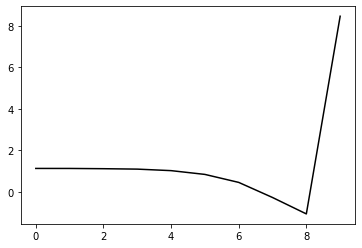

69300 0.17366763686915268
0.2514770376416968 -0.1626701109121195 -0.22289309910666566 -0.1259118572171223
[ 1.07110743  1.08992516  1.0525261   1.01609293  0.93435052  0.74685447
  0.35738662 -0.37392587 -1.16756388  8.47391993]


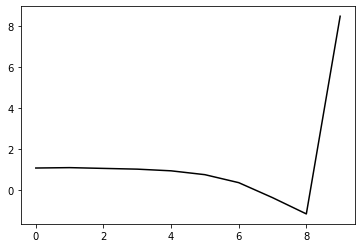

70400 0.1736292488547475
0.25536378197684084 -0.15732945421298006 -0.21970006097298897 -0.1287903512368538
[ 1.10104832  1.16431676  1.14596099  1.10098671  1.01590105  0.82776891
  0.43746972 -0.29570576 -1.09219293  8.46369564]


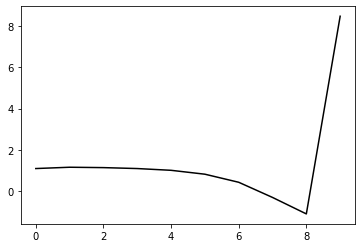

71500 0.2082600220075688
0.24291316516356595 -0.16257041349398563 -0.2211926277744087 -0.13158381166382982
[ 1.12975079  0.9862475   0.97145174  0.94959991  0.88308945  0.71529592
  0.34504389 -0.36914785 -1.14644486  8.44674512]


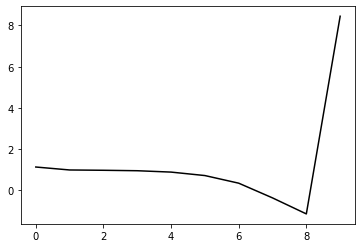

72600 0.16608493345077002
0.248460518644733 -0.1619705140634072 -0.22176317336767493 -0.13001336076544484
[ 1.12691727  1.14876066  1.1170435   1.07509079  0.99372542  0.81332222
  0.43146092 -0.29462241 -1.08426663  8.4632187 ]


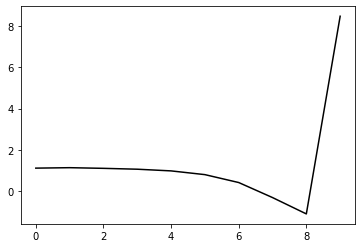

73700 0.13121268736151254
0.24734645275298378 -0.1586072451996993 -0.21873268914500113 -0.1304173252498221
[ 1.12716708  1.13279035  1.08066071  1.01742019  0.91766889  0.72460728
  0.33382127 -0.39962389 -1.19565303  8.46003232]


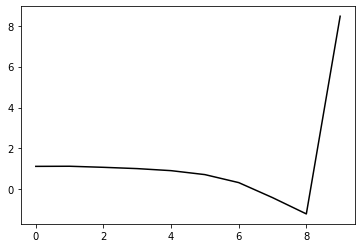

74800 0.14673082340080726
0.2501733191662204 -0.15568699058510457 -0.21691157864755065 -0.1293851927337016
[ 1.13351254  1.0911022   1.07351536  1.00325935  0.88953695  0.68620179
  0.28810588 -0.4520424  -1.25488134  8.41658254]


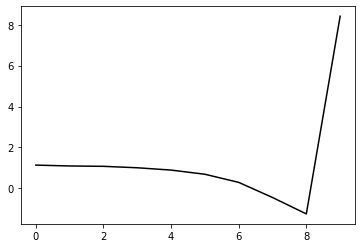

75900 0.1940463321747973
0.25396402640595395 -0.15805179226443264 -0.2197018090301987 -0.12964656328405216
[ 1.08224034  1.14578571  1.15207785  1.09732052  0.98562408  0.78297163
  0.38726614 -0.35053617 -1.15141498  8.47883001]


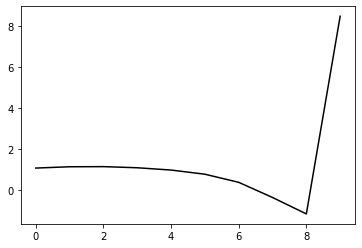

77000 0.2470539163239823
0.25095646608904876 -0.15780608556427783 -0.21895125753399036 -0.13010872629715603
[ 1.1615513   0.96210302  0.99509399  0.96499862  0.86506988  0.66923293
  0.28179705 -0.44738036 -1.23949205  8.45402533]


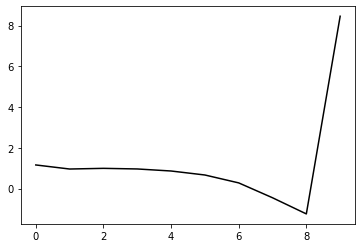

78100 0.18501454257407415
0.257297710910258 -0.15202897341786895 -0.21613697197154488 -0.12866273540385187
[ 1.0789966   1.16693186  1.16058317  1.11509152  1.00240107  0.78900396
  0.38444307 -0.3619578  -1.17335509  8.41683092]


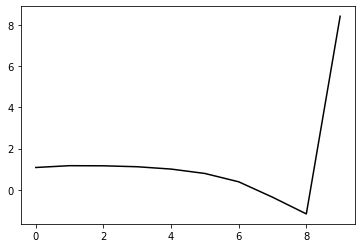

79200 0.18397209130365114
0.24995146542834432 -0.15640242406382923 -0.21787527342216503 -0.13048329141962037
[ 1.11970974  1.12854034  1.13706229  1.11019348  1.01473951  0.8151853
  0.4239205  -0.30883222 -1.10612232  8.45904906]


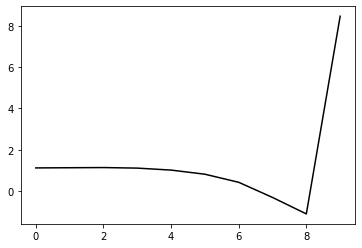

80300 0.1784646032131089
0.25093364899291687 -0.1543589878342564 -0.2163454547875174 -0.13069980407587828
[ 1.10252473  1.08371803  1.08071796  1.04997215  0.95324556  0.75084248
  0.35667864 -0.37833934 -1.17790231  8.46465503]


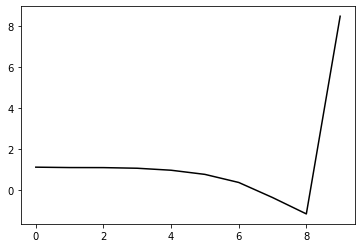

81400 0.18224819777000267
0.25657976219307466 -0.15206111588521065 -0.21661994924164438 -0.12847744291658675
[ 1.06434345  1.1477927   1.15390418  1.12538974  1.03337226  0.83351415
  0.44014601 -0.29515675 -1.09694479  8.42349098]


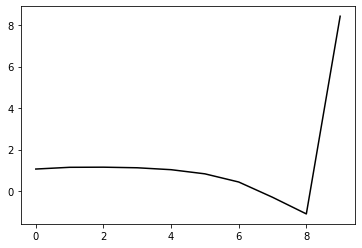

82500 0.20220804044378737
0.24688038756639855 -0.16026812612377384 -0.22057532067629823 -0.12937575962007367
[ 1.13844159  1.06029911  1.04322238  1.02502946  0.94770331  0.76225869
  0.38312093 -0.33658037 -1.12035922  8.46912601]


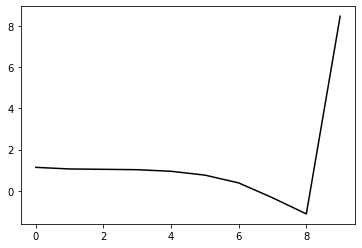

83600 0.1906485317102188
0.250469905170262 -0.16227655305349345 -0.22296811768108898 -0.12709424013585333
[ 1.0923812   1.05437773  1.04466689  1.01396673  0.93221711  0.74470913
  0.36361146 -0.35724537 -1.14194756  8.46923053]


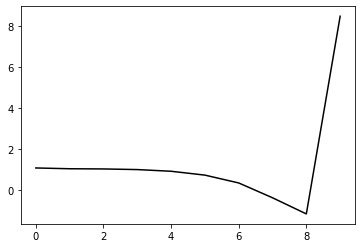

84700 0.12027087264715156
0.2531113019476189 -0.16006114821336215 -0.22204156815915888 -0.12889900598118373
[ 1.10047146  1.11248062  1.12399829  1.09875256  1.02220195  0.83982902
  0.46149618 -0.25836858 -1.04429923  8.49466236]


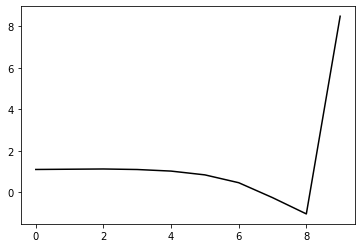

85800 0.13144641635342472
0.24669397809454363 -0.15846413059843706 -0.21950261679986993 -0.129482010099674
[ 1.12905995  1.12714247  1.08650831  1.04556499  0.95780874  0.76700714
  0.38087817 -0.34613954 -1.1391512   8.46593171]


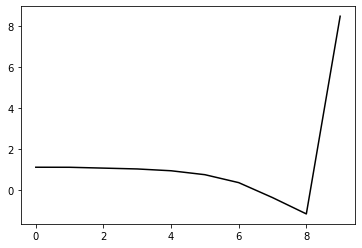

86900 0.18857226166054775
0.24738616014562004 -0.15777838545655903 -0.21932304215748316 -0.12967344616821416
[ 1.11955171  1.08330716  1.07266573  1.02940501  0.93950305  0.74887161
  0.36235031 -0.36609276 -1.16210534  8.46759647]


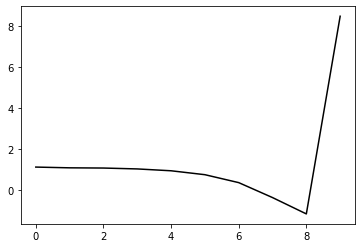

88000 0.26859798994602785
0.25136869299660897 -0.16181921684106865 -0.22402528574709188 -0.12428868071398015
[ 1.0666193   1.08101739  1.08080189  1.04273574  0.95099161  0.7591201
  0.3712848  -0.35928882 -1.158929    8.43580593]


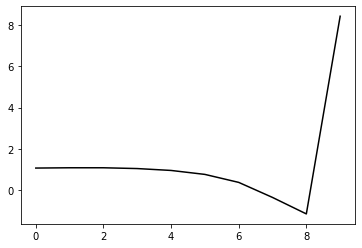

89100 0.25047622849262585
0.24583334558721245 -0.1589567898774401 -0.2204399738503862 -0.12800975378188434
[ 1.16828266  1.02590062  0.99405838  0.94921583  0.85654336  0.66427044
  0.27663051 -0.45362666 -1.25295759  8.47735917]


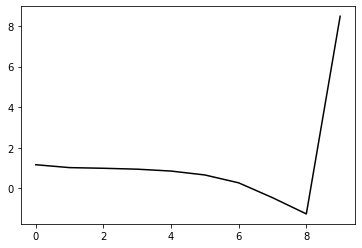

90200 0.2164836341302898
0.24631776983947623 -0.15503907200158598 -0.21734495639155477 -0.132516452524921
[ 1.1567958   1.1563468   1.14072991  1.09006841  0.99364413  0.79865435
  0.40831005 -0.32520137 -1.12887945  8.45079259]


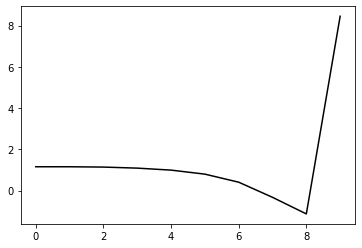

91300 0.16511574618709862
0.2561074899835452 -0.15337310126991324 -0.218457977882734 -0.1276920602942413
[ 1.06735084  1.2425106   1.23659114  1.16463823  1.04029652  0.82121151
  0.41032358 -0.34171947 -1.16356897  8.49751104]


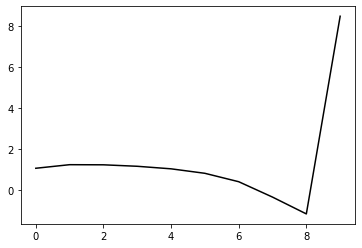

92400 0.16742800160572766
0.2516235573017823 -0.15728077365009774 -0.22027606718109558 -0.12931122034244072
[ 1.13765772  1.14453862  1.15963103  1.11688298  1.00820254  0.80216738
  0.40521282 -0.33269885 -1.14009966  8.45105093]


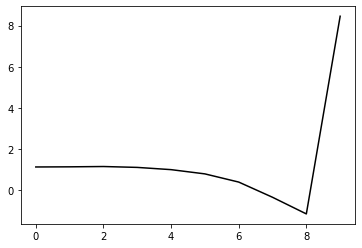

93500 0.19616179046017637
0.25383515704769394 -0.15404440943732728 -0.21863096026614318 -0.12791600020307756
[ 1.09313212  1.16673523  1.19469824  1.15572726  1.04290475  0.82793019
  0.42252494 -0.32347984 -1.14002357  8.45835833]


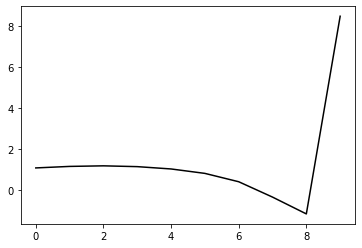

94600 0.16543260594169712
0.24966638147901643 -0.1612641760364943 -0.22307833624110185 -0.12975043622445182
[ 1.09229446  1.1517429   1.17226703  1.15385637  1.05895544  0.85725448
  0.46461513 -0.26793687 -1.06997322  8.4561094 ]


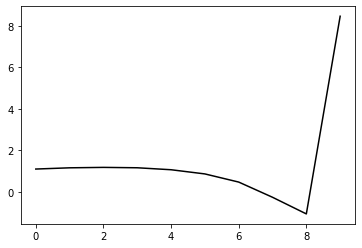

95700 0.1220895540186144
0.25040986648538505 -0.15695285742697418 -0.22010174598789015 -0.12824233837325918
[ 1.09050674  1.17659732  1.14938375  1.10348897  0.99336197  0.7761509
  0.36965426 -0.3743609  -1.18696433  8.4391509 ]


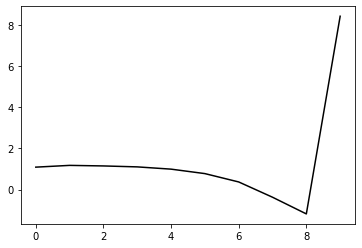

96800 0.12656348168948842
0.2498909630372052 -0.1558102783445634 -0.218968271181524 -0.13142037748892613
[ 1.10351342  1.15121155  1.17867581  1.14879046  1.04988733  0.84135663
  0.44099799 -0.29759254 -1.10559958  8.45054371]


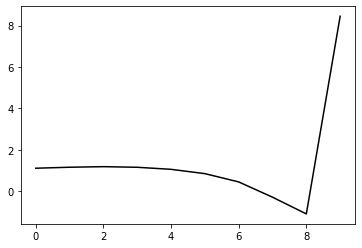

97900 0.18180619578381868
0.24932988922244137 -0.15748621125429937 -0.22019713084717998 -0.12905981474159284
[ 1.08992316  1.06394934  1.0631034   1.03439259  0.93532113  0.72538943
  0.32330795 -0.41578749 -1.22354417  8.47715084]


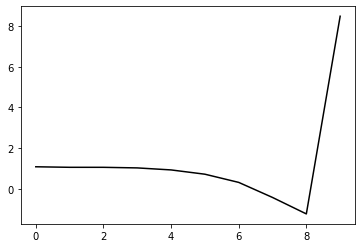

99000 0.22608377360896406
0.25115259378245547 -0.16014727578134386 -0.2226795480187678 -0.12804725956892404
[ 1.06400598  1.09110669  1.09209995  1.07121748  0.98549493  0.78670715
  0.39308597 -0.33837018 -1.13938973  8.4504719 ]


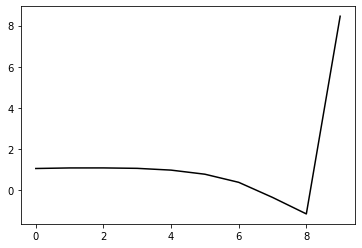

100100 0.20987895317893002
0.2507577443996662 -0.15543403138624876 -0.21887539675476317 -0.12933866034561245
[ 1.12689775  1.08641219  1.0712191   1.02964421  0.93522649  0.73034425
  0.33031744 -0.40655848 -1.21214411  8.45860662]


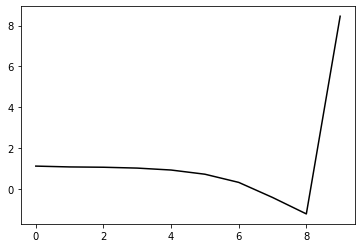

101200 0.1856836274352118
0.2576227398235523 -0.15156008032314244 -0.21798516847961583 -0.1284358072077865
[ 1.04538361  1.23803756  1.2553446   1.2121654   1.10726529  0.89217325
  0.47975285 -0.27077511 -1.09169304  8.43285357]


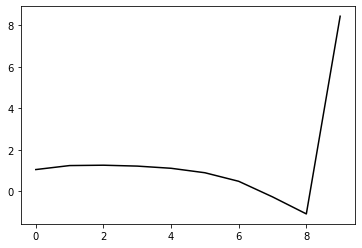

102300 0.19535893646489372
0.2541819111509895 -0.1563518704121145 -0.2209899487814928 -0.1290106936395416
[ 1.06225694  1.20674838  1.23440472  1.21434227  1.12508945  0.92372581
  0.52327323 -0.2165664  -1.02763702  8.50011767]


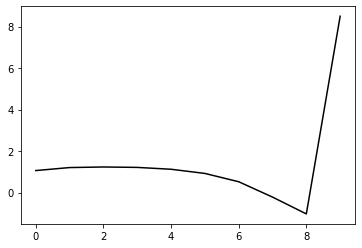

103400 0.1948281120024405
0.24522263901364308 -0.16002467414154717 -0.2216716208384462 -0.12898500591376325
[ 1.11887971  1.05874194  1.05128824  1.03298892  0.94730538  0.74850714
  0.35041242 -0.38657102 -1.1936434   8.43739371]


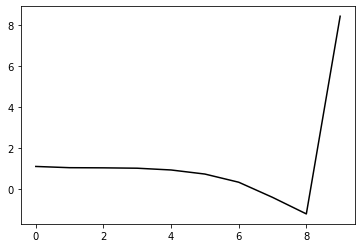

104500 0.18278280475938694
0.25232522559081233 -0.15532746087032964 -0.21988369924297643 -0.13027225234182538
[ 1.10288205  1.20134252  1.22516806  1.20752583  1.1266825   0.9308861
  0.53306456 -0.20570443 -1.01656373  8.52573018]


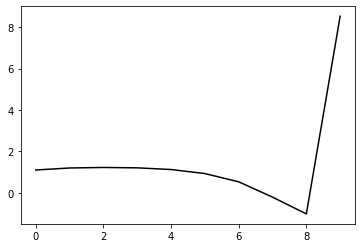

105600 0.16343615777650117
0.24078021355398752 -0.16190865652927916 -0.22224800350100263 -0.1291824913327245
[ 1.1134396   1.07872098  1.05243546  1.02257934  0.93392194  0.73250333
  0.32994    -0.4125046  -1.22568154  8.43832956]


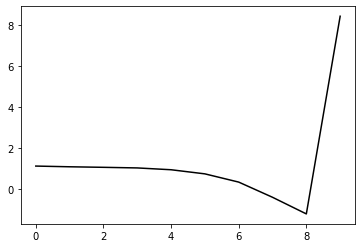

106700 0.14229308589596545
0.24508016690791037 -0.1555482360582547 -0.21851902319431227 -0.13155871545333273
[ 1.12654367  1.12673305  1.13515862  1.10113914  1.01034877  0.80739601
  0.40169323 -0.34560264 -1.16556015  8.46438028]


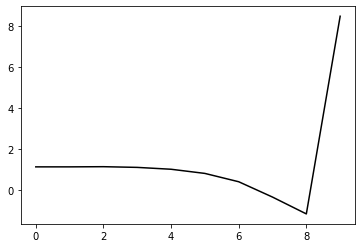

107800 0.12721470398561838
0.24526275420283805 -0.15539950268309044 -0.21843110295271506 -0.13166869446609017
[ 1.10560257  1.12391649  1.13467167  1.10706221  1.01687558  0.81535161
  0.41061466 -0.3364302  -1.15654729  8.44314975]


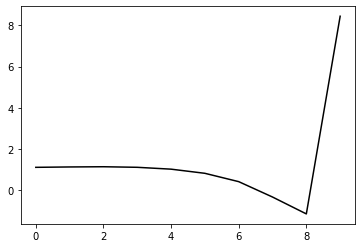

108900 0.17848778252465644
0.24770393082471365 -0.15449829703253815 -0.21833270091104895 -0.12936765775959774
[ 1.09382195  1.09127974  1.07034722  1.02588468  0.92492049  0.71458931
  0.3022899  -0.45172402 -1.27819278  8.46033481]


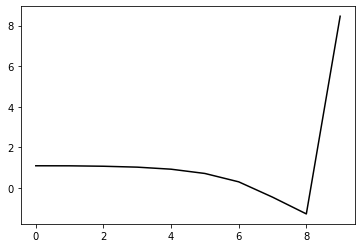

110000 0.20362154798422794
0.25069790620700044 -0.1569579793075469 -0.22101471609890766 -0.1265832656895788
[ 1.06799631  1.07187509  1.07111567  1.02778411  0.92436346  0.71336439
  0.30112567 -0.45283604 -1.27896466  8.43119394]


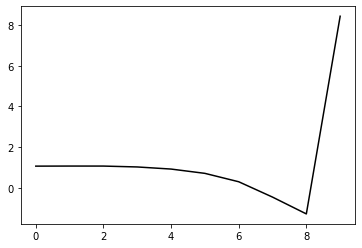

111100 0.21948189428827877
0.24361737702494715 -0.15983255702889013 -0.22156708012890544 -0.12632365892294228
[ 1.11976263  0.99815817  0.99762288  0.96271023  0.86242885  0.65289348
  0.24139119 -0.5127319  -1.33943824  8.43982021]


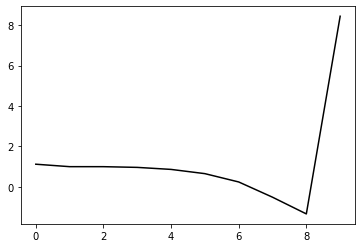

112200 0.1568892558404604
0.24870204215237887 -0.15625102623477102 -0.21966919092003087 -0.13123293626558308
[ 1.08913221  1.22903547  1.23938408  1.2031754   1.10340474  0.89338234
  0.48130338 -0.2735606  -1.10097224  8.44319318]


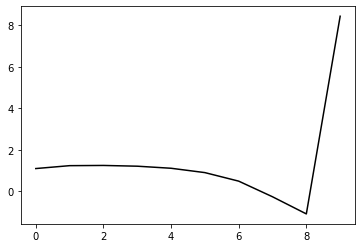

113300 0.16464523521040836
0.2506651163228391 -0.15517348718612428 -0.21947622900346886 -0.1300760075805753
[ 1.06676869  1.21563953  1.22729819  1.19107229  1.08805999  0.87395829
  0.4575612  -0.3023528  -1.1359245   8.49620223]


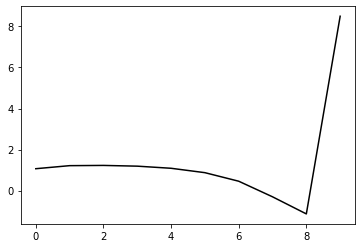

114400 0.16013787362959356
0.24934104871841148 -0.15274214157311702 -0.2174194422405112 -0.13107741804205367
[ 1.10439116  1.19318271  1.20955572  1.18025787  1.08208243  0.87075454
  0.45613614 -0.3030473  -1.13682432  8.43039128]


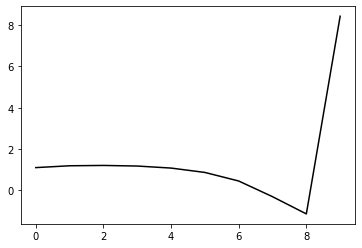

115500 0.20561001037452611
0.24901336964847515 -0.15371040158925453 -0.2180024108317818 -0.13061039381945647
[ 1.06912849  1.09654335  1.11700741  1.08955309  0.99345207  0.78365948
  0.37090385 -0.38576851 -1.21578472  8.48137657]


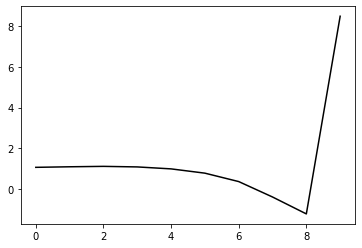

116600 0.16229089308716851
0.24371777776373002 -0.16080156006174898 -0.22228706272944992 -0.13076757534467903
[ 1.11704519  1.11521674  1.09893226  1.08091772  0.99743537  0.79799403
  0.39406572 -0.35448375 -1.1759995   8.44974871]


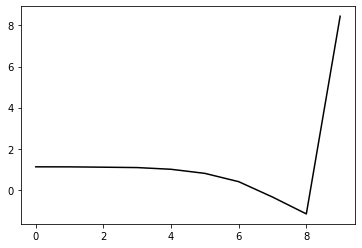

117700 0.13256134031227013
0.2489030252820157 -0.15951970351608602 -0.22256606641375462 -0.12919539733027527
[ 1.07523425  1.11722211  1.11968697  1.08963293  1.00085108  0.79753361
  0.38931421 -0.36384    -1.1903332   8.45844221]


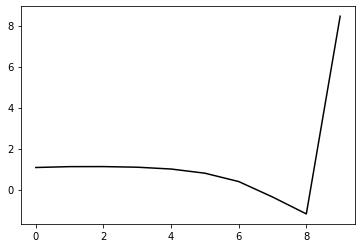

118800 0.13524353254765017
0.24567882657409348 -0.15521084343249797 -0.21879541738352898 -0.1310331839981443
[ 1.11862572  1.07940089  1.07763746  1.05057955  0.96523891  0.76592365
  0.36012376 -0.3920796  -1.21864224  8.41436695]


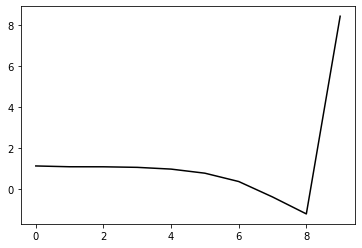

119900 0.18740951753684615
0.24714470064800606 -0.1551559778915657 -0.21935810635805286 -0.129619944413805
[ 1.1204354   1.06398485  1.06284366  1.03342978  0.94807781  0.75003841
  0.34472497 -0.4081034  -1.2360811   8.45703655]


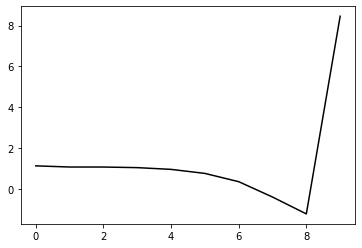

121000 0.2089452759987592
0.24932509390715907 -0.1556254692448396 -0.22070430004648206 -0.12935931914309995
[ 1.0988123   1.10978401  1.14095864  1.12239524  1.04308789  0.85092242
  0.44993811 -0.30070593 -1.1285838   8.45351779]


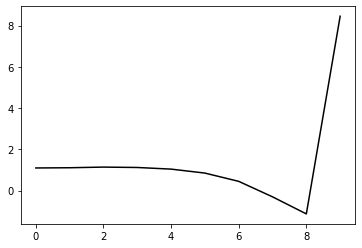

122100 0.2195622944183736
0.23888836469463876 -0.16016189111092477 -0.22215682979832538 -0.12756281039131676
[ 1.12824273  0.98056207  0.97291952  0.95956945  0.88349999  0.69424269
  0.29576266 -0.45335431 -1.28033142  8.46268991]


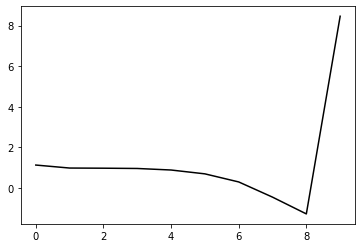

123200 0.15895484831953163
0.25024970565119914 -0.15344321069543096 -0.21960160987934918 -0.12732908451355993
[ 1.09583816  1.23174563  1.22129015  1.18814497  1.10159322  0.90234847
  0.49324022 -0.26789609 -1.10879463  8.4297928 ]


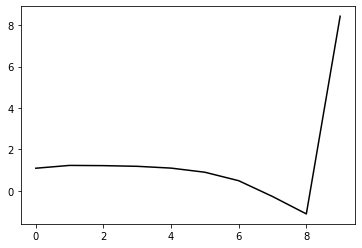

124300 0.16412876523161704
0.25146447156896545 -0.15294804041628277 -0.2194934925622031 -0.1270228650437151
[ 1.08796538  1.21935255  1.20866845  1.16619138  1.07051958  0.86558573
  0.45202326 -0.3134156  -1.15840924  8.48013142]


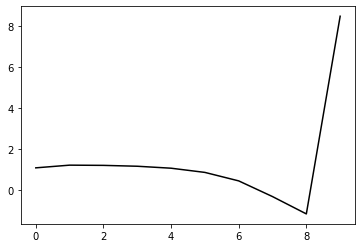

125400 0.19991503390601803
0.24394907322734052 -0.15873628526363692 -0.22178611980034654 -0.1274988345737841
[ 1.14699321  1.07785092  1.07283616  1.03648662  0.94312099  0.74183329
  0.33306608 -0.42670784 -1.26404529  8.43649302]


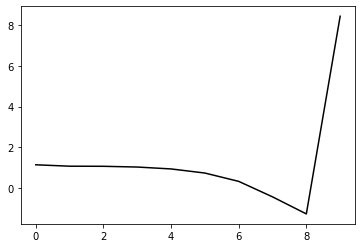

126500 0.19724086274459487
0.24542443560843905 -0.1556924083518485 -0.2194359477267783 -0.13022743611192372
[ 1.11694912  1.17303816  1.14459661  1.10194154  1.00575427  0.80204903
  0.3912225  -0.37101984 -1.21121172  8.46110255]


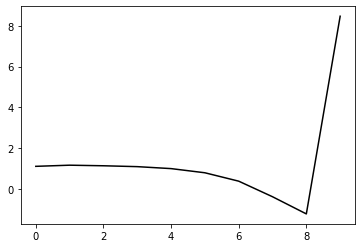

127600 0.18104689609170838
0.2523265648746239 -0.15314881149536977 -0.2191098172955133 -0.12981286139800455
[ 1.11620912  1.22391123  1.24699949  1.20897412  1.11443873  0.91258269
  0.50334266 -0.25845871 -1.09936453  8.42109233]


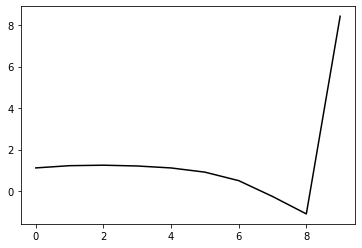

128700 0.1755347488730026
0.25205900102762674 -0.15645119499512652 -0.22178044421924442 -0.1283441290551493
[ 1.0482248   1.14118414  1.17134295  1.14844034  1.0582468   0.86023638
  0.45599901 -0.3008458  -1.1367138   8.48670679]


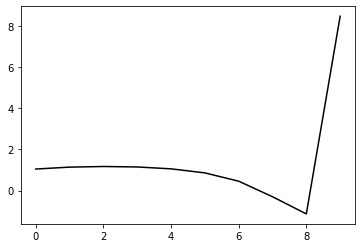

129800 0.12893765872163424
0.25109351011323333 -0.15173644878119108 -0.2180338187729809 -0.13134110108218447
[ 1.11019183  1.21078386  1.23273732  1.21722443  1.13556394  0.94179678
  0.54019986 -0.21607103 -1.05360546  8.46475518]


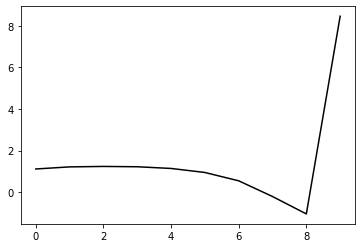

130900 0.1842083567728524
0.2474881176538797 -0.15448096406584175 -0.21929950704530937 -0.12785322538575103
[ 1.08791017  1.12216046  1.10155474  1.06941788  0.97829377  0.77558449
  0.36579556 -0.39828698 -1.24363405  8.46779856]


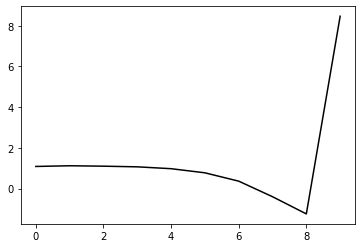

132000 0.2224584527959631
0.24911156443391608 -0.15746723396574386 -0.22205826354135041 -0.12572521408765922
[ 1.06076014  1.1039881   1.09850387  1.06623086  0.97750336  0.77844038
  0.37244671 -0.38797496 -1.22970436  8.43442234]


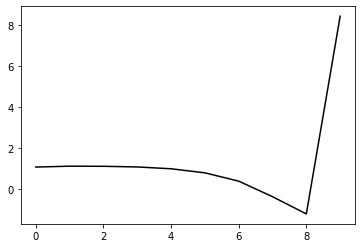

133100 0.2037493714310639
0.24345215921530042 -0.15596979171319725 -0.2194349878423057 -0.12718472790743443
[ 1.11026228  1.04126453  1.00975184  0.96587947  0.87055083  0.66750182
  0.25880391 -0.50360823 -1.34661179  8.43703811]


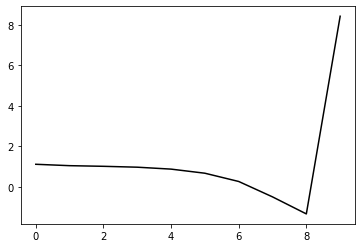

134200 0.1730006278313268
0.2559651703620808 -0.15060104498583157 -0.21820992297153402 -0.12794243033958866
[ 1.05433521  1.21907071  1.2182726   1.17279961  1.07490501  0.86972369
  0.45825499 -0.30806933 -1.1564788   8.4099065 ]


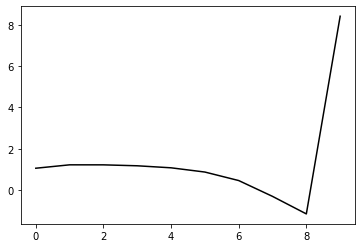

135300 0.20943902925036734
0.23666829268883657 -0.15667113721282186 -0.21863760348214173 -0.13148166284211216
[ 1.1273768   0.94386606  0.92003673  0.88314656  0.79141193  0.5943
  0.19231104 -0.56365177 -1.40015467  8.45468239]


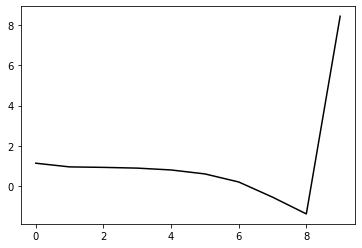

136400 0.18100227852809034
0.24989048089768184 -0.153700530032878 -0.2196385448155115 -0.13025909492965068
[ 1.13774803  1.17237034  1.17112901  1.13163925  1.04026603  0.84253768
  0.43866529 -0.32117669 -1.16425941  8.43512267]


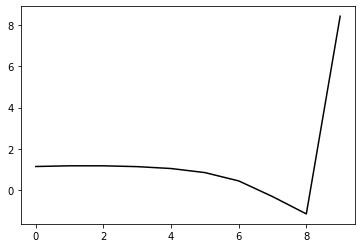

137500 0.22848606400339505
0.24973111048427185 -0.15620941936398708 -0.22154088076740983 -0.12910841325384223
[ 1.06426833  1.12137221  1.13606047  1.09836304  1.00372255  0.80479123
  0.40134917 -0.35748803 -1.19934048  8.48817816]


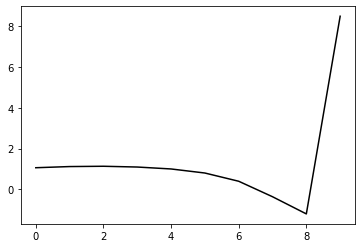

138600 0.22245661845155332
0.2534241660300198 -0.1553048791263284 -0.2216687695608469 -0.12888745658149917
[ 1.05836589  1.24668515  1.27727961  1.24555239  1.14859909  0.945391
  0.53791618 -0.22564261 -1.07376898  8.4488413 ]


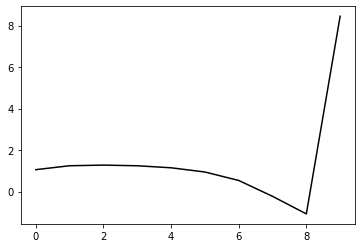

139700 0.1258437770808439
0.24642898080499184 -0.1561614978374621 -0.22077833182560794 -0.12991623146857798
[ 1.11562615  1.11747594  1.09553963  1.06923877  0.97791157  0.77852911
  0.37552627 -0.38326837 -1.22640197  8.45000784]


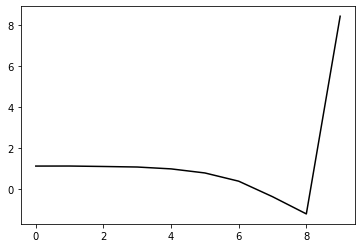

140800 0.1336608902554856
0.2478286520042935 -0.15525838576030687 -0.22057891711628336 -0.12895843450580496
[ 1.12876936  1.06508513  1.06396319  1.03380054  0.94483322  0.74698828
  0.34500465 -0.41339505 -1.25722142  8.42894835]


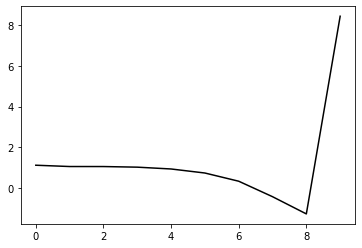

141900 0.17824532816334634
0.24856913195979682 -0.15536757736426346 -0.22114003704522966 -0.1285567044140186
[ 1.10930016  1.07859907  1.07612512  1.04471422  0.95610625  0.7586802
  0.35657112 -0.40261155 -1.2484342   8.47651841]


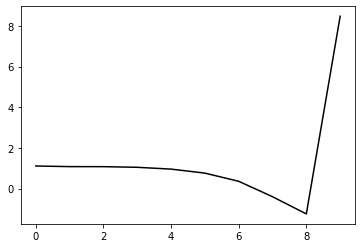

143000 0.20883207898284986
0.25003896072646287 -0.15275844628602464 -0.21983914005376504 -0.1273166278905399
[ 1.09492572  1.115465    1.1098778   1.07325785  0.97784472  0.77392957
  0.36490053 -0.40224465 -1.25839624  8.4246973 ]


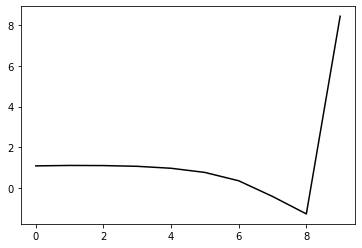

144100 0.18760323494146672
0.250495665098139 -0.15248381137439357 -0.21991856463295104 -0.12682229483043322
[ 1.11074333  1.12833972  1.12125922  1.08755479  0.99374448  0.79112591
  0.38330561 -0.38284131 -1.2385256   8.45395612]


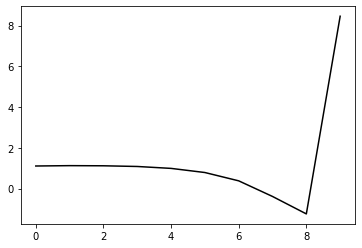

145200 0.16542574700354887
0.2505831976189187 -0.15392553259638111 -0.22118440579358986 -0.12701472320332227
[ 1.0949145   1.18008263  1.17991802  1.1544454   1.06878417  0.87281831
  0.47035958 -0.29163958 -1.14455118  8.44121062]


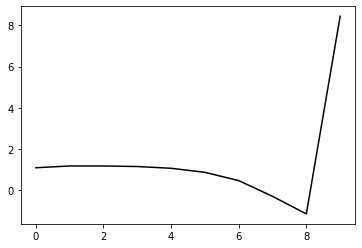

146300 0.19449652086453273
0.2533310480386113 -0.1542823115591044 -0.22213296426945395 -0.127794627539316
[ 1.07096303  1.23379977  1.25350176  1.23185459  1.14938448  0.95604591
  0.55550894 -0.20527541 -1.05809032  8.50472085]


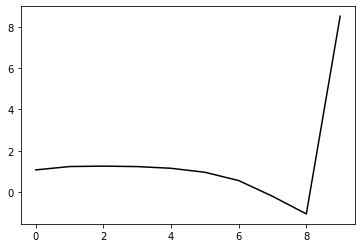

147400 0.20279628352983942
0.24411807617678072 -0.1582142357702018 -0.2229283620407971 -0.13036567150928507
[ 1.17885767  1.06093962  1.06288213  1.05585578  0.98881106  0.81117596
  0.42655368 -0.3179137  -1.15327748  8.45102663]


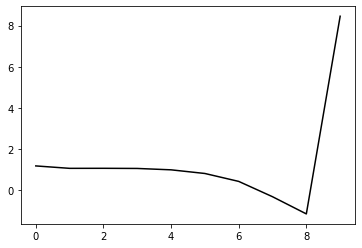

148500 0.21005006782836214
0.24739762800325515 -0.15330965726056675 -0.2199911703614281 -0.13022370905705946
[ 1.1333341   1.15340075  1.13199853  1.09647828  1.01268744  0.82053447
  0.42184205 -0.33699799 -1.1886761   8.49248567]


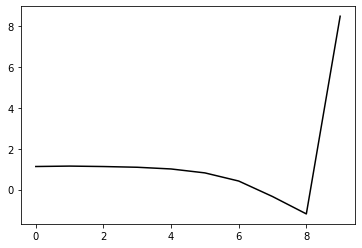

149600 0.17786764352356407
0.25083077475568755 -0.15093265681933277 -0.21929296386924121 -0.12651015586874073
[ 1.14753625  1.00732944  1.02886534  0.98932326  0.89667672  0.69866365
  0.29446347 -0.4704836  -1.32971678  8.41750927]


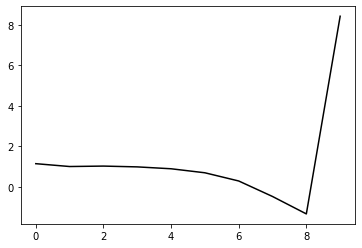

150700 0.13391156836581591
0.2454956378099456 -0.15707617560264123 -0.2225512518962401 -0.12787257582419942
[ 1.0720147   1.0801729   1.06190611  1.02710229  0.93786783  0.74381985
  0.34457548 -0.4148468  -1.26785226  8.45468619]


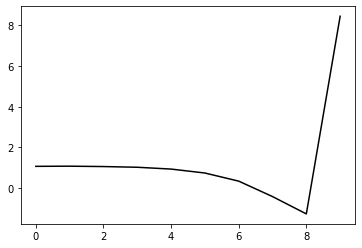

151800 0.14755693744717388
0.24899187716163038 -0.15466721367644506 -0.2213646409073716 -0.12839901390339806
[ 1.09582224  1.19967273  1.18529383  1.13913242  1.04380618  0.8442683
  0.43983861 -0.32494858 -1.18396813  8.46729567]


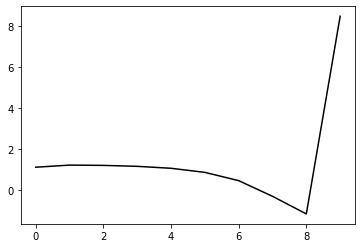

152900 0.17271159504320024
0.24330383430319721 -0.15432128936187964 -0.21992968391405443 -0.1281498057961643
[ 1.09115406  1.03776066  1.03675715  0.99174955  0.88938114  0.6841491
  0.27495444 -0.49483606 -1.36012266  8.43936584]


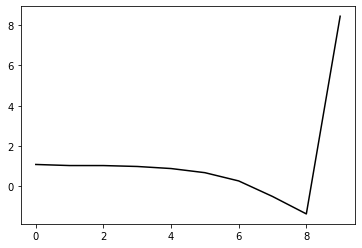

154000 0.22762650523692404
0.2459314011860597 -0.15882241756638557 -0.22421652235013873 -0.12809928168320395
[ 1.07037586  1.11542577  1.13938095  1.11866578  1.03379132  0.84298415
  0.44736926 -0.30970608 -1.162824    8.42694527]


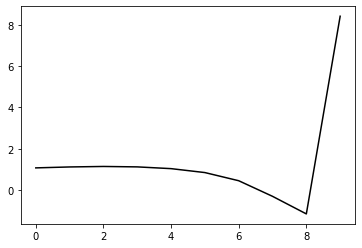

155100 0.19200238587442797
0.2448343371975923 -0.15585245012350635 -0.22164086856411075 -0.128982251629094
[ 1.11220363  1.12658469  1.12238697  1.09377027  1.00528233  0.80987152
  0.41015864 -0.35095999 -1.20892555  8.45399307]


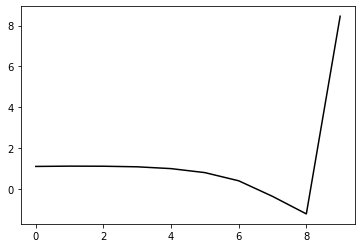

156200 0.15385996816278658
0.24827548422854823 -0.152713625142708 -0.22029039546972448 -0.12924286863631282
[ 1.08383482  1.21329388  1.23016181  1.20220401  1.11299669  0.91566242
  0.51336227 -0.25124099 -1.1146475   8.45319394]


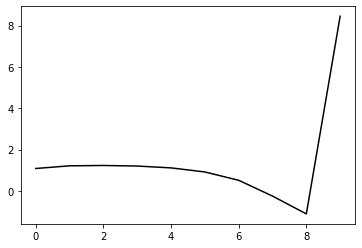

157300 0.17457703602132388
0.24928369015304536 -0.1541074854541 -0.2215851919929393 -0.12902648625712163
[ 1.06926309  1.206       1.2298683   1.20805551  1.12117518  0.92486179
  0.52340055 -0.24053094 -1.10411777  8.50269582]


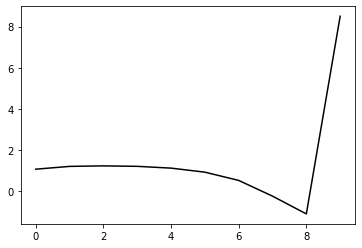

158400 0.19545390864261034
0.24550078261764294 -0.15832425208215933 -0.22392627391824058 -0.1270298560899704
[ 1.10033593  1.02237597  1.02184515  1.00674072  0.92971222  0.7427741
  0.35103876 -0.40248972 -1.25489457  8.41698762]


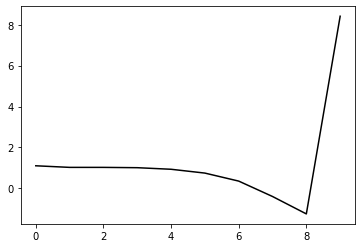

159500 0.1851821617088185
0.24918759215410222 -0.1530362421894026 -0.22069989406590754 -0.13034817586312564
[ 1.08772174  1.21935802  1.23242073  1.21157088  1.13458616  0.94679602
  0.55288958 -0.2037585  -1.06103812  8.50337825]


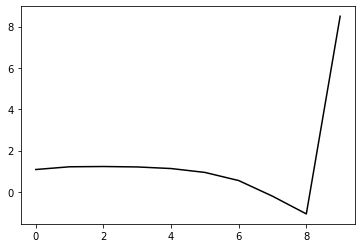

160600 0.2944956298308393
0.2515617233240789 -0.15367023177475278 -0.22191689923601063 -0.1282123471704498
[ 1.02749424  1.18467831  1.19383251  1.17232549  1.09392027  0.90603163
  0.51202116 -0.24472753 -1.10272157  8.45126349]


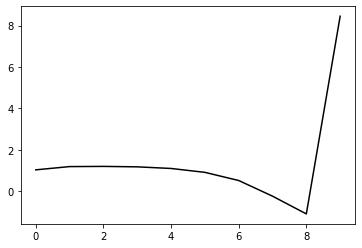

161700 0.1139902082022656
0.24550974007002735 -0.15697936084052486 -0.22260396404186625 -0.13059337114080066
[ 1.10368333  1.17862334  1.1743065   1.15338906  1.07992496  0.89805841
  0.51047186 -0.23892202 -1.08801649  8.48714128]


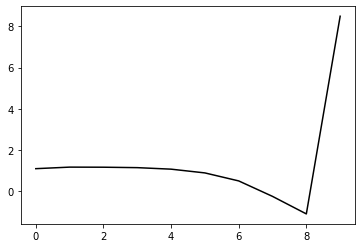

162800 0.13141467303249627
0.24073040850046018 -0.15659700921243688 -0.22099102562376405 -0.13074892560715587
[ 1.11238938  1.10149027  1.04888007  1.01306445  0.93422457  0.7498359
  0.3605226  -0.39007983 -1.24030167  8.44408037]


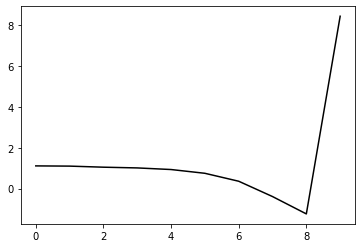

163900 0.19634833070387311
0.2449498984283059 -0.15780298429708736 -0.22307408623378128 -0.13144800045803795
[ 1.09124856  1.15772402  1.16112486  1.12573081  1.05030124  0.87253252
  0.48918649 -0.25668509 -1.1037135   8.48657849]


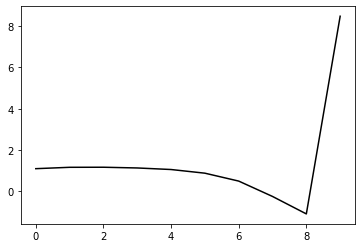

165000 0.21150944031882002
0.2454753154649827 -0.15475421788077792 -0.22118717911806784 -0.12759522493384196
[ 1.08788211  1.13955355  1.10076861  1.03603512  0.9308246   0.72961071
  0.32658236 -0.4373784  -1.30268003  8.42104636]


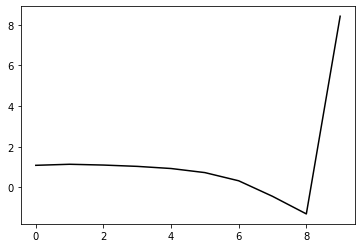

166100 0.1895098877701887
0.24624056319531198 -0.15344151535668404 -0.2206810368492358 -0.12696749291174778
[ 1.11043846  1.14148226  1.13385106  1.07986507  0.97204694  0.76860791
  0.36426522 -0.40181192 -1.27103644  8.45572018]


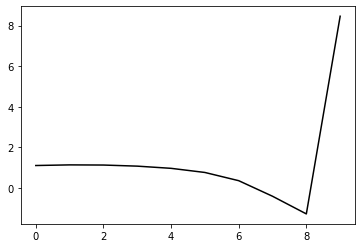

167200 0.15679616229196475
0.2483630542585396 -0.15255762984784516 -0.22051873961936158 -0.1285030271128784
[ 1.0886281   1.22973193  1.24474223  1.2047258   1.10013989  0.89686614
  0.49358897 -0.27152585 -1.14072885  8.43732865]


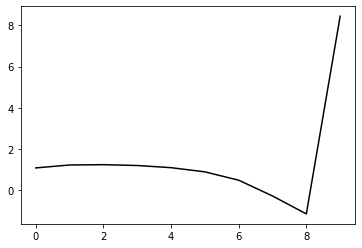

168300 0.18871424721240845
0.23913310657183887 -0.15366640607076973 -0.21927443809748504 -0.1299933308693497
[ 1.1182081   0.99809364  0.99313264  0.961263    0.85998542  0.65693482
  0.25540609 -0.50689325 -1.37283846  8.46073715]


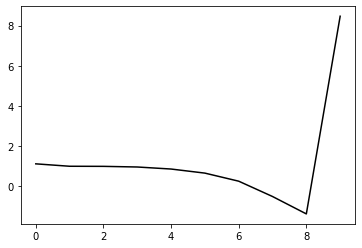

169400 0.15857661874347073
0.24988291836822782 -0.15305532808024955 -0.2213622886879956 -0.13026681100447454
[ 1.12682356  1.20398969  1.23094842  1.20229359  1.10569115  0.903371
  0.50182172 -0.26087525 -1.12847079  8.43704837]


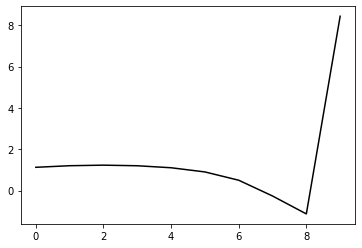

170500 0.18935197313303326
0.24993863208915376 -0.1515030824708284 -0.220198007973482 -0.13006979388775067
[ 1.10174685  1.20209753  1.22460251  1.20043129  1.10439961  0.90014713
  0.49691523 -0.26652037 -1.13478276  8.47204318]


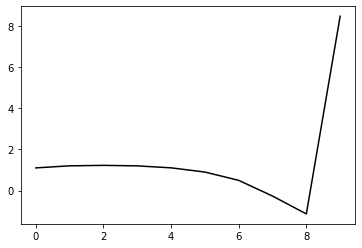

171600 0.17100328884794933
0.2448446442820903 -0.15649701853438866 -0.22270331063584733 -0.12849917986472556
[ 1.09209836  1.0855668   1.07532866  1.04827026  0.95295226  0.74783104
  0.3441577  -0.41826703 -1.28453801  8.43804192]


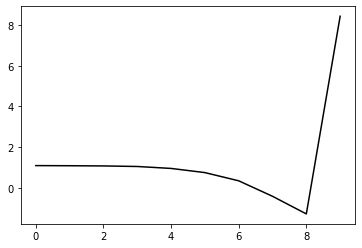

172700 0.11650471553073322
0.2511383811772573 -0.15112821133298562 -0.2205911702765976 -0.12879730772122597
[ 1.10701201  1.16001993  1.19102465  1.16707404  1.07567226  0.87182526
  0.46699076 -0.29804205 -1.16959888  8.46952622]


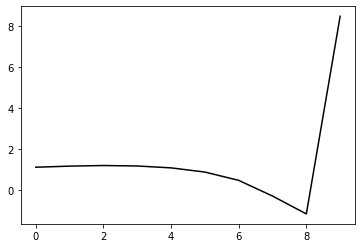

173800 0.1327487722814558
0.24306192181071565 -0.15371143854045066 -0.22052728730299734 -0.12908175401429156
[ 1.11699073  1.12131644  1.08205014  1.04628683  0.94926873  0.73991944
  0.32967505 -0.43955292 -1.31444979  8.43146521]


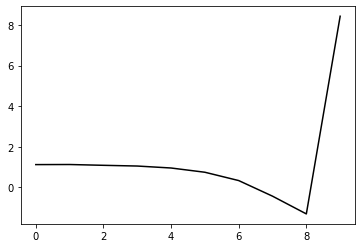

174900 0.18895642652705827
0.24823838807731624 -0.15251004508622146 -0.22101098253011775 -0.12806843628549242
[ 1.07540096  1.06172338  1.07334813  1.03541464  0.94017211  0.73341268
  0.32455591 -0.44341256 -1.31748073  8.4718495 ]


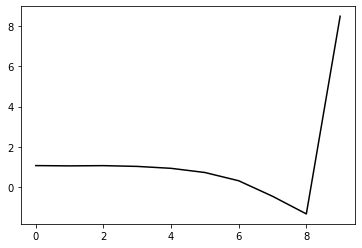

176000 0.20983169713855332
0.24845104586249317 -0.15360484891502219 -0.22178329623445397 -0.12727642360676297
[ 1.09291642  1.15187213  1.12725185  1.07961399  0.97614132  0.76238146
  0.34637408 -0.42839857 -1.30949121  8.42734807]


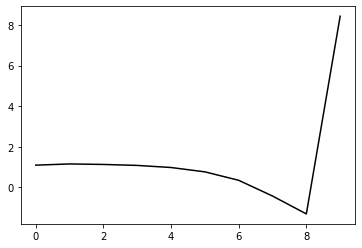

177100 0.2385234918366556
0.2455651659778886 -0.1548931267149511 -0.22202161703836876 -0.12902378541414017
[ 1.15480232  1.02527869  1.03471617  1.00016635  0.90631672  0.70311971
  0.29721219 -0.46728244 -1.33756204  8.45909009]


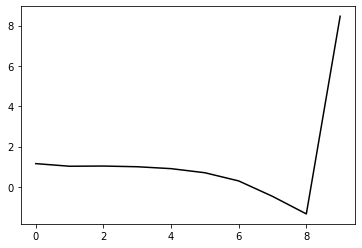

178200 0.17505250161899139
0.24915390747790805 -0.15261373887749627 -0.2211940917445532 -0.13075032428198347
[ 1.10965221  1.19633527  1.20686714  1.17159021  1.07437823  0.86694167
  0.45570101 -0.31505407 -1.19329678  8.44937941]


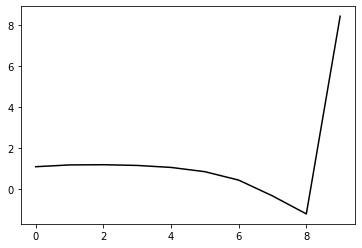

179300 0.175507734570658
0.2481506805515244 -0.1592875180959459 -0.22597031606672324 -0.1264366707891549
[ 1.07653999  1.12550259  1.1207546   1.08275102  0.98005311  0.76802902
  0.35341093 -0.41922365 -1.29791641  8.44399595]


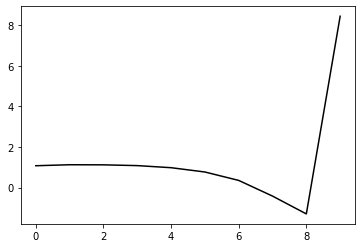

180400 0.17963975794154627
0.24776961074212242 -0.15461625794661357 -0.22184882525762953 -0.13084373559091747
[ 1.08716066  1.18572075  1.1637696   1.12474017  1.02387591  0.81184428
  0.39588704 -0.37898511 -1.26099198  8.38644201]


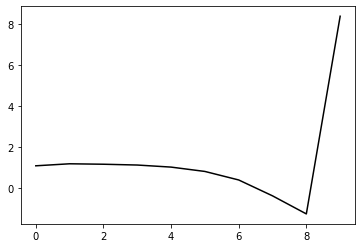

181500 0.24081755981712316
0.25053843140111753 -0.15279348391297906 -0.2210714086424249 -0.13256351822410736
[ 1.13718232  1.19285684  1.21798731  1.18970387  1.09678772  0.8918115
  0.4818053  -0.28762471 -1.16446298  8.47748993]


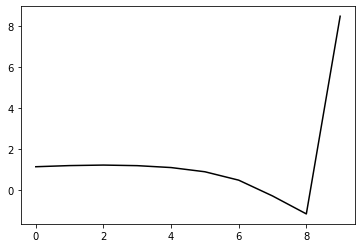

182600 0.1575693393686836
0.2510954754328322 -0.15448380112332918 -0.22264664187187153 -0.12966899206357432
[ 1.11460667  1.06752001  1.09309891  1.06664517  0.97197201  0.76491503
  0.35299211 -0.4179002  -1.29588411  8.42218256]


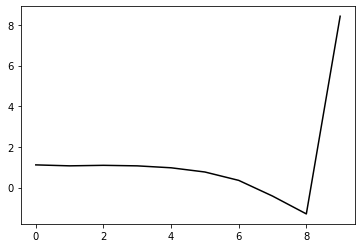

183700 0.12787732874097893
0.24823931451742068 -0.15389319534241624 -0.2213115689718227 -0.13222649560591218
[ 1.12053745  1.10215558  1.13113939  1.11345138  1.02371831  0.81955816
  0.40993652 -0.35850975 -1.23378433  8.46056706]


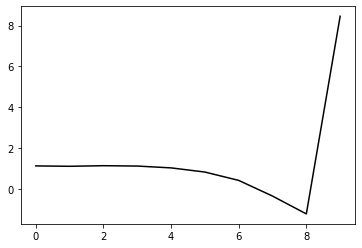

184800 0.12853136314556107
0.24939276243520653 -0.15330461462745262 -0.22109949479800228 -0.13294580699859143
[ 1.11724837  1.13315884  1.16006305  1.14850472  1.06460728  0.86362892
  0.45581666 -0.31132408 -1.18587166  8.44629441]


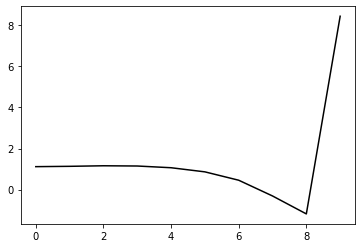

185900 0.20034435787987526
0.2516449068895053 -0.1550233345529386 -0.22320038165987896 -0.1306479463016576
[ 1.05849102  1.04809989  1.08107804  1.07344028  0.99531981  0.79865182
  0.39373952 -0.37079373 -1.24294372  8.47348639]


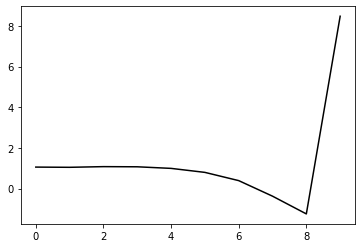

187000 0.21635909001496634
0.24873254541783055 -0.15888210474689435 -0.22606826349651402 -0.1282530461942451
[ 1.07676246  0.99547793  0.99383516  0.99177081  0.92971793  0.74799885
  0.3553192  -0.39889699 -1.26232005  8.42974703]


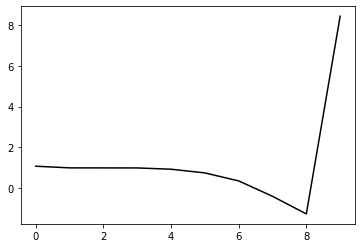

188100 0.18968233171165425
0.24910176138762777 -0.1532604194985943 -0.2217953448972996 -0.13025072904089174
[ 1.09800851  1.12710524  1.09170505  1.06019603  0.98565082  0.79555198
  0.39334107 -0.37163439 -1.24775516  8.46145485]


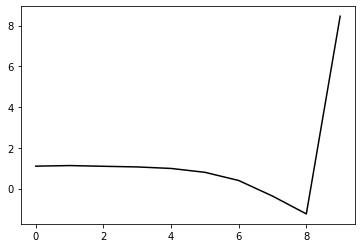

189200 0.18838401259034168
0.24898583903310476 -0.14996398902690747 -0.2192444536128982 -0.13257273051080862
[ 1.12731293  1.17652975  1.17218362  1.14118662  1.06572935  0.88005098
  0.48157134 -0.28094627 -1.15547021  8.44919412]


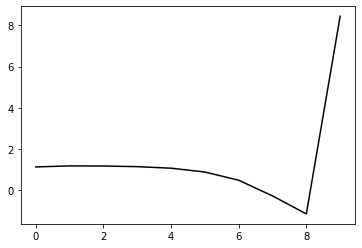

190300 0.1704817333697547
0.24051106009641182 -0.156631166092474 -0.22276993795416325 -0.13072425543808333
[ 1.09604993  0.93988553  0.89707945  0.86446329  0.79169796  0.61484986
  0.22743885 -0.52330667 -1.38428095  8.47306178]


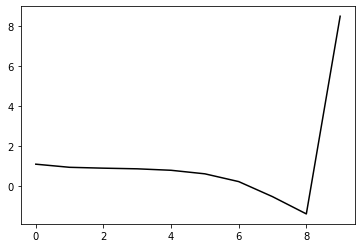

191400 0.18176378867434262
0.2486080558601633 -0.15571710611299575 -0.22380353467515127 -0.13045569217911554
[ 1.10042018  1.16403776  1.13596599  1.08836168  1.00827123  0.82787531
  0.43739738 -0.31770677 -1.18456848  8.43358139]


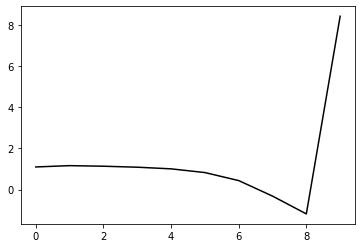

192500 0.243144346736909
0.2434331214832089 -0.16042823525640545 -0.22666991101522857 -0.12650098754174835
[ 1.11181034  1.00901892  0.96435419  0.911707    0.82346812  0.64109191
  0.25207893 -0.50056354 -1.36381288  8.44410351]


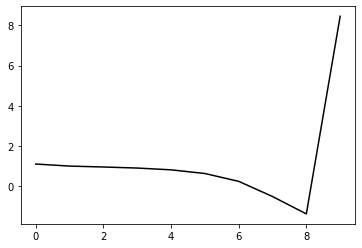

193600 0.15955721296738223
0.24993881758856235 -0.1551914594941371 -0.22400943865835962 -0.12903949970323883
[ 1.1142034   1.09078415  1.08550356  1.02881387  0.93541274  0.75013651
  0.3596948  -0.39535942 -1.26253782  8.41102662]


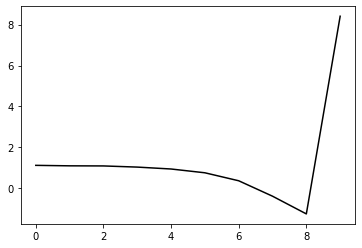

194700 0.12435998272150425
0.2532410971946343 -0.15056402085567688 -0.22091845143620994 -0.1320097088943261
[ 1.11316673  1.20489171  1.22334367  1.17140537  1.06855431  0.87468499
  0.47840415 -0.28238568 -1.15627619  8.48576804]


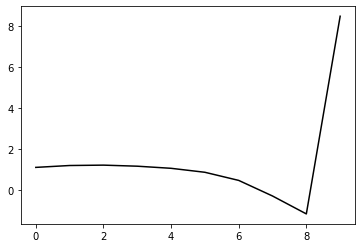

195800 0.14420320336338624
0.2502972773277072 -0.1488357075655595 -0.21872137656120252 -0.13338700804476591
[ 1.11827173  1.11690283  1.12981412  1.09001054  0.98939537  0.79584004
  0.40257321 -0.35420738 -1.2233968   8.42489573]


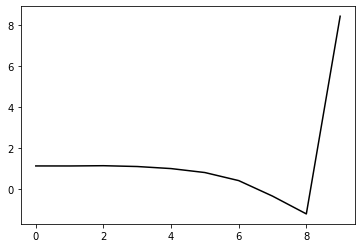

196900 0.18216031507195693
0.24502238295645776 -0.15557594711239925 -0.22287493510338313 -0.13145368511419894
[ 1.12488032  1.04212728  1.0166337   0.97961327  0.88611756  0.69669333
  0.3089974  -0.44154501 -1.30400583  8.45203655]


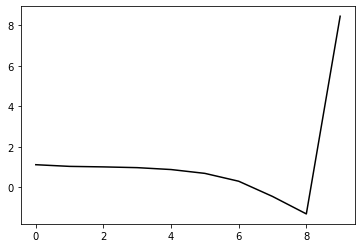

198000 0.19613332653009036
0.2505335015437733 -0.14863564903533144 -0.21935138759921818 -0.13045794669752706
[ 1.09557758  1.14026744  1.13076035  1.0822665   0.97819016  0.77594742
  0.37497132 -0.39058653 -1.27226706  8.43529092]


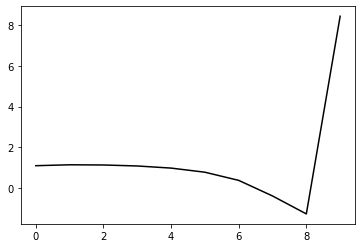

199100 0.24495386646503725
0.24152517817734545 -0.15196574476709193 -0.21996177538011258 -0.1314107927741116
[ 1.13176411  0.97667379  0.97785036  0.94424824  0.84969318  0.65544868
  0.26347509 -0.49175827 -1.36166327  8.44012242]


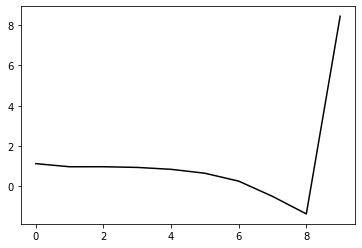

200200 0.1977543215782453
0.2431653419847061 -0.15501035503199032 -0.22243822729446025 -0.13175555420788107
[ 1.12263075  1.0665432   1.05379605  1.02559135  0.94160943  0.7565105
  0.37418885 -0.3704311  -1.22904754  8.42852443]


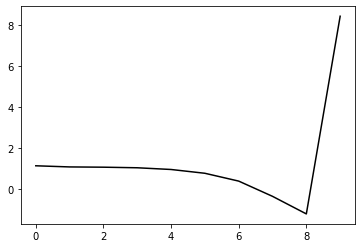

201300 0.18912136325407597
0.251152592748476 -0.15285251579836376 -0.22306756060631197 -0.12994658443357332
[ 1.05960051  1.22582324  1.21544286  1.17553344  1.08508595  0.89297111
  0.5025954  -0.25147555 -1.12323826  8.48848624]


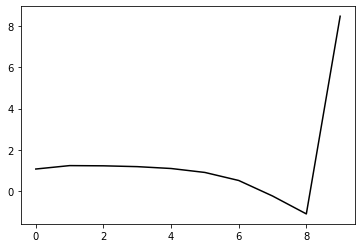

202400 0.1808765235610471
0.2498293265378947 -0.15186834975862867 -0.22189142365404677 -0.12986343227520292
[ 1.08642425  1.10332551  1.11165214  1.07901967  0.98885149  0.7977813
  0.40922076 -0.34192294 -1.21021025  8.41633259]


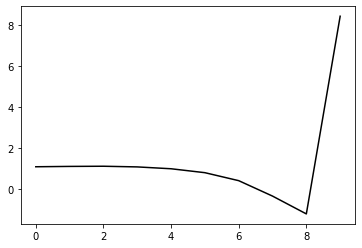

203500 0.21773883502682884
0.23931239520996894 -0.15950808834474123 -0.2259087325610294 -0.12865327811896723
[ 1.10585734  1.03246276  0.98824613  0.95964001  0.87687972  0.69209898
  0.30964982 -0.43515443 -1.29701556  8.4545601 ]


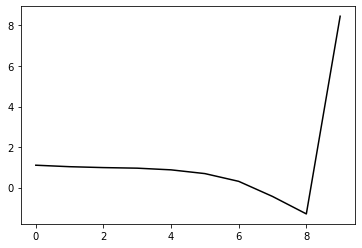

204600 0.15477672258452163
0.24481980082418553 -0.15174249699073983 -0.2209765684455638 -0.13259052232457216
[ 1.09641535  1.16192689  1.11872993  1.06006969  0.95912522  0.75887648
  0.36205987 -0.39630673 -1.27260036  8.42514803]


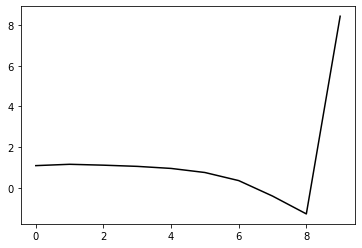

205700 0.133878453210608
0.2470330001006285 -0.1558760162314952 -0.22481458001883595 -0.12922161533863638
[ 1.07737058  1.16392899  1.14318464  1.08882619  0.98771239  0.78987358
  0.39608712 -0.35885653 -1.23215661  8.45470505]


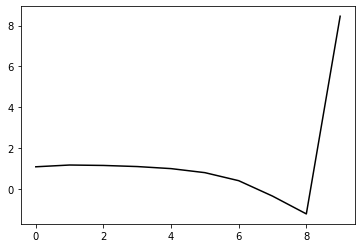

206800 0.15110142173418326
0.24687997376536217 -0.1552791694025292 -0.2245614313458545 -0.1287447613322894
[ 1.10210042  1.09040409  1.09380069  1.05156268  0.95503591  0.7616962
  0.37252886 -0.37819447 -1.24867928  8.44542813]


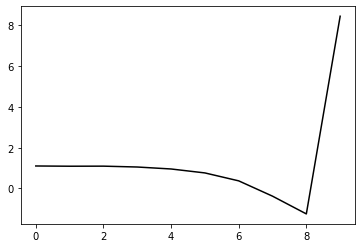

207900 0.17807900961423667
0.24335145839880984 -0.1524077290751958 -0.22160031053665183 -0.12913570813647346
[ 1.06547906  0.97975296  0.97061354  0.92031792  0.81347055  0.60997364
  0.21224652 -0.5460824  -1.42483146  8.47296529]


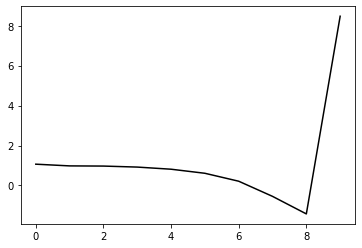

209000 0.212767129593819
0.2453394927782765 -0.1510736221682296 -0.22087863174493505 -0.12898223443549434
[ 1.08031439  1.1111093   1.06070941  1.00006031  0.88739679  0.67718786
  0.27292278 -0.49196134 -1.37842914  8.42047883]


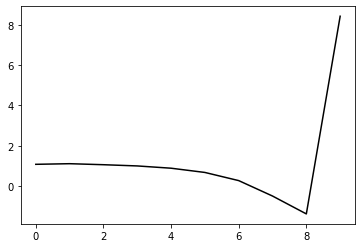

210100 0.20657447066972376
0.24338528599507786 -0.1566865245747502 -0.22475335729232807 -0.1299252945030909
[ 1.11767189  1.02592404  1.03239452  0.99078706  0.8941631   0.69925979
  0.31030646 -0.43849055 -1.30748523  8.44568992]


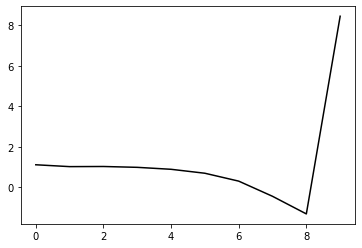

211200 0.1670283923010046
0.2466960185118623 -0.15162841515002604 -0.22173754195552461 -0.13112066187360513
[ 1.09409757  1.22163481  1.20040254  1.15357775  1.05096439  0.84795989
  0.44973522 -0.30959973 -1.1922268   8.41823236]


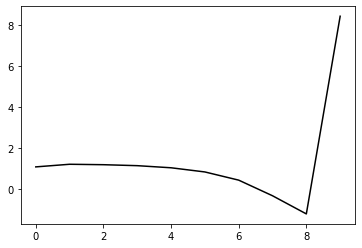

212300 0.19315613604254492
0.24967897530341146 -0.15366602337463492 -0.22424666050845135 -0.12922304433639145
[ 1.05738367  1.20027519  1.20708175  1.16652986  1.06700229  0.86597837
  0.46922645 -0.28884793 -1.17141246  8.47448995]


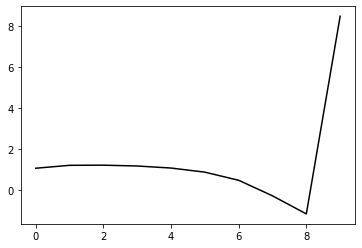

213400 0.15742601051251165
0.24888341387297797 -0.15356501506700362 -0.2237937770713696 -0.13297334561167923
[ 1.12205864  1.23480341  1.26406451  1.24156828  1.15467711  0.96396534
  0.57727856 -0.1699421  -1.04096718  8.45758293]


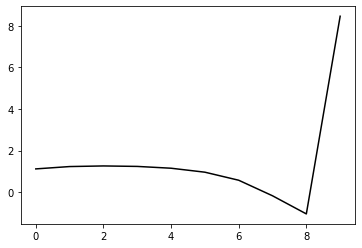

214500 0.21208078534649416
0.24395914151631423 -0.15272064608867264 -0.22184660110871932 -0.13396747731805575
[ 1.12356331  1.1217586   1.12308949  1.09684388  1.00645872  0.81138169
  0.42078832 -0.32944126 -1.20368067  8.46886133]


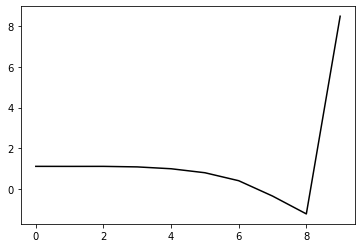

215600 0.15245080012058834
0.2491209770747726 -0.15028857883224456 -0.22170863588234085 -0.130100753056015
[ 1.09599926  1.1337988   1.15155598  1.12243981  1.02912007  0.82929179
  0.4328094  -0.32388218 -1.20661382  8.4566917 ]


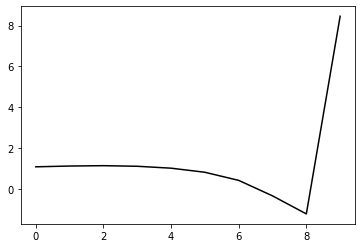

216700 0.12370620174469872
0.24499693014111149 -0.1553167743783091 -0.22477754840966446 -0.12982762606708592
[ 1.1119375   1.09221115  1.10616373  1.09039242  1.01040171  0.82249485
  0.43721615 -0.30778547 -1.17823393  8.47726792]


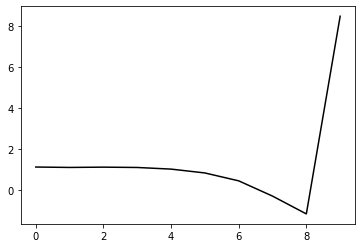

217800 0.14396715215522424
0.2489945106251384 -0.14709977268382868 -0.21957178502087132 -0.13275492074705864
[ 1.12195437  1.17493909  1.19359134  1.17229302  1.08975874  0.89765553
  0.50618205 -0.24634644 -1.12702958  8.45732791]


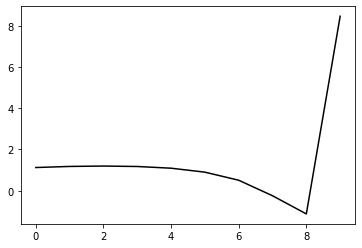

218900 0.19988408169745284
0.247570749968309 -0.15318814925173838 -0.22409137348175578 -0.12959467573456646
[ 1.05876827  1.05497666  1.06345611  1.04765831  0.97332462  0.78980759
  0.40659356 -0.33681634 -1.20712113  8.46958214]


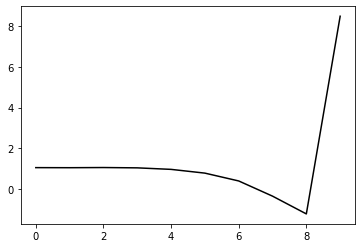

220000 0.2330112043761158
0.247738789644616 -0.15408886189861312 -0.22509369202970142 -0.12825906603736079
[ 1.05861126  1.11033925  1.09857325  1.07573811  1.0026247   0.82130333
  0.43919343 -0.30352257 -1.17398691  8.41670687]


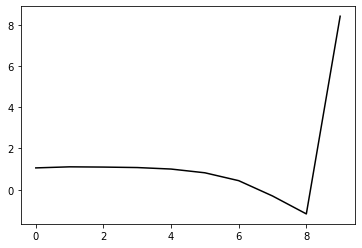

221100 0.18994436940101564
0.2461810607450569 -0.15099267794733448 -0.22258750520292112 -0.12835725739452028
[ 1.11340282  1.14920009  1.11682077  1.07119826  0.98449693  0.79307031
  0.40015393 -0.35384263 -1.23691397  8.44885479]


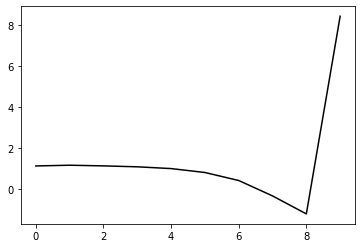

222200 0.17952985355781262
0.24494101153357342 -0.15406585768220463 -0.22459330276902306 -0.12701172136788855
[ 1.09420258  1.11036632  1.08634231  1.04279822  0.95560295  0.76818363
  0.3804418  -0.36741974 -1.24301627  8.43661494]


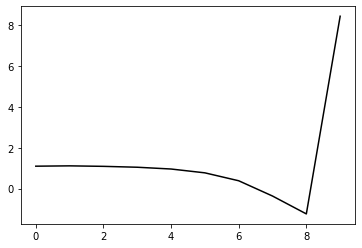

223300 0.1644334468778026
0.24839835311604472 -0.15089482391123896 -0.22291982692580295 -0.1297468438270615
[ 1.08545939  1.20907673  1.20553353  1.15811608  1.06352382  0.87076897
  0.47828609 -0.27479748 -1.1569648   8.51501242]


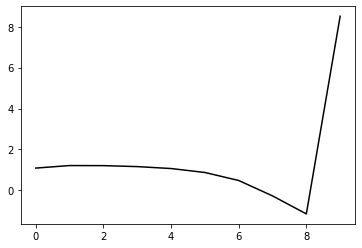

224400 0.16720182408122566
0.24699045052010005 -0.147873775539315 -0.22045128515240806 -0.12964479541729268
[ 1.11768694  1.13815394  1.14578765  1.10904295  1.01286326  0.81815575
  0.42468648 -0.32925572 -1.21258842  8.44055217]


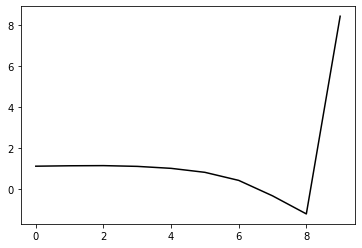

225500 0.2065414825371246
0.23895233551877354 -0.15543849472660545 -0.224420831626293 -0.13138137458962604
[ 1.12608021  1.01529377  1.00819185  0.98954775  0.91191053  0.73381919
  0.35789659 -0.37729337 -1.23948017  8.45453612]


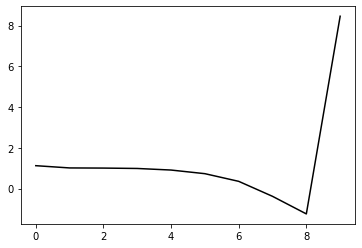

226600 0.163527577542815
0.24229376862081192 -0.1534660754069011 -0.22370650298284703 -0.12730298224468564
[ 1.12491929  1.10051796  1.05072883  1.0019914   0.90450977  0.70638749
  0.31112298 -0.44286813 -1.324332    8.43301662]


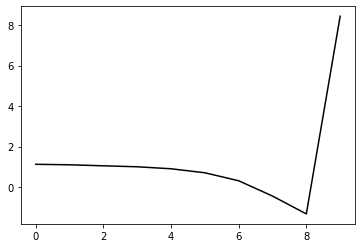

227700 0.12559772947299438
0.24638925696142394 -0.14919789112557955 -0.2209069578776742 -0.1292448252036387
[ 1.10378182  1.16096983  1.12599075  1.05686286  0.94247768  0.73122043
  0.32499638 -0.43836397 -1.32862506  8.45015345]


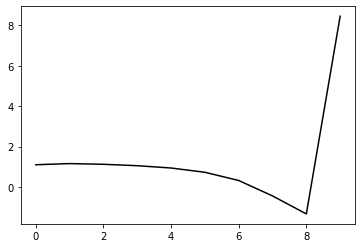

228800 0.12997308046913802
0.2463353516853024 -0.1482678124781386 -0.21996013211352272 -0.13117408397265526
[ 1.11049959  1.15939889  1.16401348  1.10819218  0.99272621  0.78078439
  0.37506947 -0.38705725 -1.27579837  8.43893744]


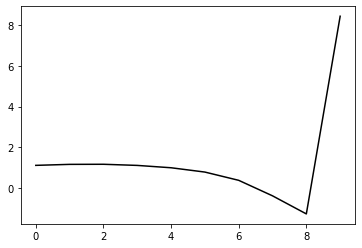

229900 0.17631704219211494
0.2460300178304382 -0.1519056443723968 -0.22268897254911477 -0.12942660969477054
[ 1.08621796  1.08802442  1.04824105  0.98744716  0.87031489  0.65682125
  0.2522215  -0.50651113 -1.38987941  8.43453078]


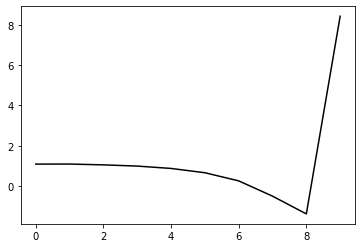

231000 0.19486047147868157
0.24973773296720878 -0.1489311297498649 -0.22147742509003748 -0.13059820820768162
[ 1.09433597  1.22367289  1.21705244  1.15631615  1.03586939  0.81598514
  0.40349057 -0.36473333 -1.26067133  8.41182067]


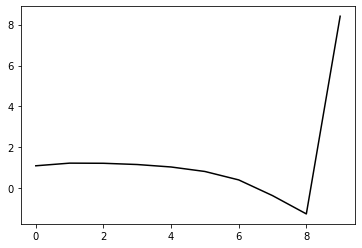

232100 0.2201023177179138
0.243507547449074 -0.15633188600545087 -0.2262423728588279 -0.12696452453047993
[ 1.13416832  1.01982979  1.0370265   0.99824644  0.89049667  0.68135487
  0.28013284 -0.47536586 -1.3565096   8.44094046]


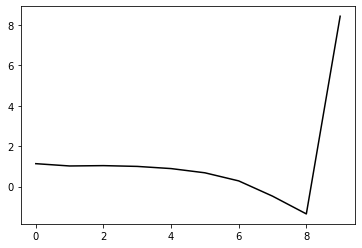

233200 0.1694968056059091
0.250552383809447 -0.14763274860798684 -0.22132173708713937 -0.12766634666311688
[ 1.09616513  1.23613779  1.22754596  1.18034157  1.06433665  0.84232053
  0.42613184 -0.34623845 -1.248288    8.42933449]


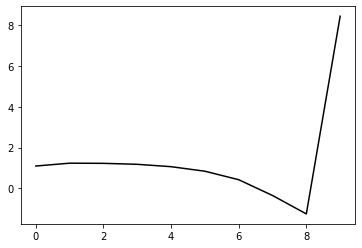

234300 0.16843615161284126
0.2520961755221526 -0.14995633605329364 -0.2233291501390927 -0.12875535868711674
[ 1.08088781  1.22865934  1.26073795  1.23069672  1.12709731  0.91395755
  0.50524178 -0.25956645 -1.15414506  8.49592621]


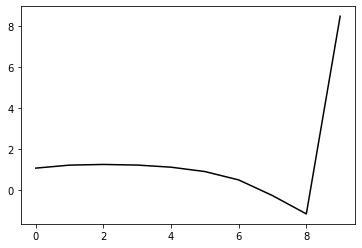

235400 0.1917936926389656
0.24617329877039953 -0.15395450511628894 -0.22464442273748778 -0.12901257594774593
[ 1.12655094  1.10937696  1.10640902  1.07429403  0.97229795  0.75971376
  0.35274458 -0.40705435 -1.29238237  8.42792013]


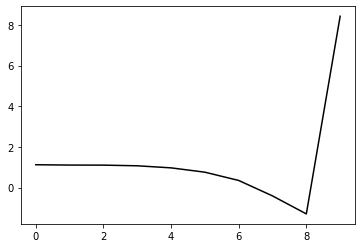

236500 0.20336268362074533
0.24243583598953683 -0.15453185678347997 -0.2240304750675678 -0.1323522905593731
[ 1.11828832  1.08051932  1.07629963  1.04436489  0.94956934  0.74340413
  0.341934   -0.41108015 -1.28789153  8.39271878]


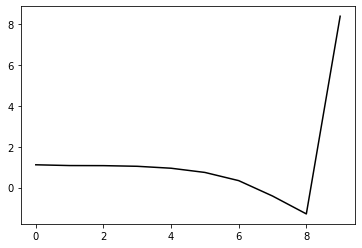

237600 0.19582202720759861
0.2500462823032265 -0.15174312116368205 -0.22400699152532189 -0.1268651152032269
[ 1.07416236  1.11792297  1.12505927  1.07214226  0.95633527  0.72971042
  0.30610673 -0.46976111 -1.37175886  8.4178034 ]


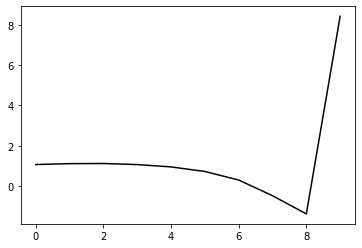

238700 0.1404273523645627
0.248675885407979 -0.15050765589616094 -0.22285004061938268 -0.12911601346731283
[ 1.15277508  1.12561979  1.14129334  1.10597542  1.00188071  0.78437328
  0.36743334 -0.40255671 -1.29877004  8.4435523 ]


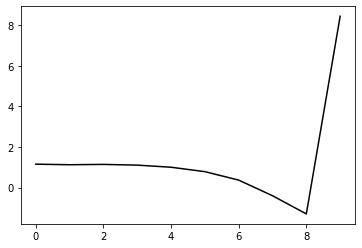

239800 0.15129067842917795
0.24656117894356733 -0.1554732729448754 -0.2264217830609877 -0.1267848163096728
[ 1.12166635  1.14293713  1.13106943  1.09711073  0.9978032   0.78436465
  0.37074989 -0.39540579 -1.28663216  8.42187966]


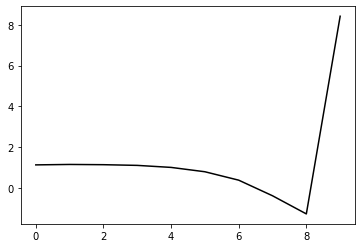

240900 0.19234864406847563
0.243393286124185 -0.15317969352332472 -0.22408558290127156 -0.1303970947425669
[ 1.14283907  1.08002906  1.08778822  1.06217335  0.974221    0.77169284
  0.36680747 -0.3916749  -1.27566784  8.47058543]


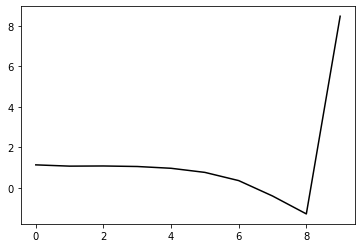

242000 0.2817025952618994
0.2485356076844996 -0.1543013521779249 -0.22683604531129217 -0.12230798304881661
[ 1.06018943  1.03902009  1.03802675  1.00503025  0.90914126  0.69959533
  0.28671004 -0.48037502 -1.37378881  8.41813859]


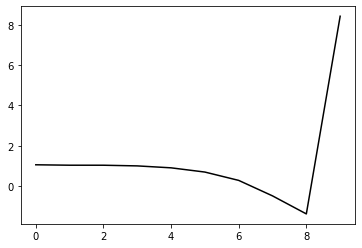

243100 0.19797814837580052
0.24494584858494212 -0.1532421740856549 -0.22525152803856288 -0.12717838595316056
[ 1.12319671  1.14980747  1.11362096  1.07071091  0.97451072  0.76512065
  0.35125184 -0.41756678 -1.31310813  8.43999012]


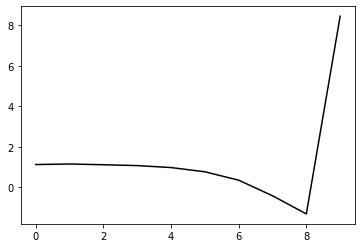

244200 0.2278032551448756
0.23845270138935465 -0.15045958079288108 -0.22187833200897444 -0.13231569613669641
[ 1.18017308  1.04176509  1.04894772  1.01959805  0.93478064  0.7386268
  0.33657588 -0.42156026 -1.30642969  8.4171865 ]


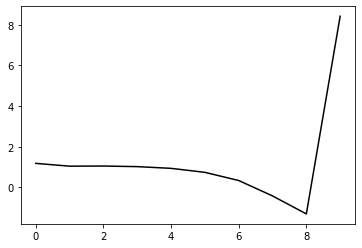

245300 0.16692445684734175
0.2496280344535017 -0.14913445193216462 -0.22344049189919696 -0.12833846433599
[ 1.09788786  1.23274515  1.21955966  1.16589298  1.05940329  0.84426489
  0.42392741 -0.35263483 -1.25681414  8.47782919]


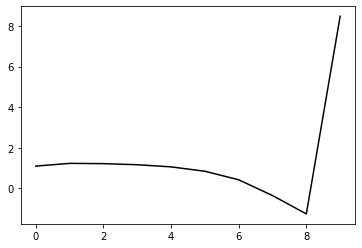

246400 0.19196510768563133
0.24519734487147918 -0.15515343517800695 -0.22673254316384833 -0.12657512106143912
[ 1.11710844  1.14504266  1.14194677  1.09299039  0.9839644   0.76827454
  0.34895494 -0.42517524 -1.32457812  8.43468372]


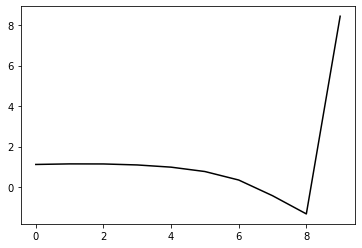

247500 0.22077837205229942
0.2514304944420633 -0.14971636275888364 -0.2238561999858494 -0.12892210807064858
[ 1.07793391  1.1991375   1.22971919  1.18117472  1.06514558  0.84218901
  0.41632569 -0.36450992 -1.27114674  8.45216082]


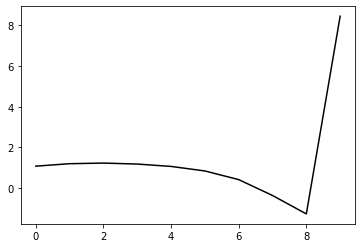

248600 0.16289376032692854
0.24646093636026792 -0.1545183219321502 -0.22657060918412708 -0.12810744280586983
[ 1.14330048  1.0833044   1.11826596  1.0941901   0.99232071  0.77952429
  0.36345044 -0.40784492 -1.30415103  8.40977297]


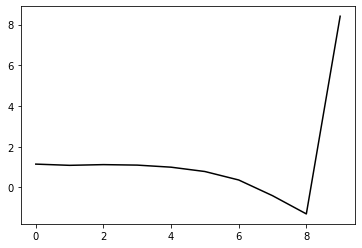

249700 0.11487542272523908
0.2490557308124646 -0.15164949308889225 -0.2247621922571636 -0.13063721744406034
[ 1.11904708  1.24817373  1.25860091  1.22920559  1.12393805  0.90406658
  0.48051721 -0.29845158 -1.20289538  8.45921583]


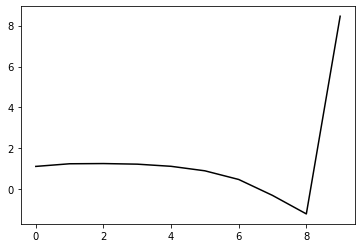

250800 0.1286232747503178
0.24854150950504006 -0.1528284973109343 -0.22556908720475966 -0.13020831451039738
[ 1.12572491  1.22268979  1.2307355   1.19980324  1.09644746  0.87662799
  0.45268624 -0.3263809  -1.23021232  8.45089173]


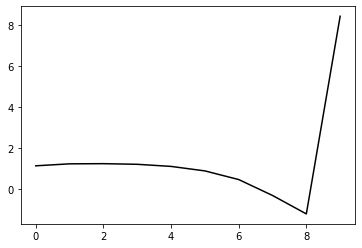

251900 0.18867285951039067
0.25091207757181877 -0.14930245856283186 -0.22353171515413778 -0.12927581814237377
[ 1.09959418  1.15996077  1.18816921  1.15572991  1.04746241  0.82182218
  0.39148496 -0.39410792 -1.3048276   8.44811893]


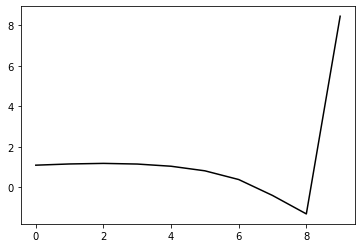

253000 0.21033734578216526
0.2511986769764753 -0.15166091532580317 -0.22543829071373256 -0.12817843566785148
[ 1.0850985   1.14118863  1.16916574  1.15228706  1.05508054  0.83720768
  0.41291732 -0.3672519  -1.27250555  8.42678434]


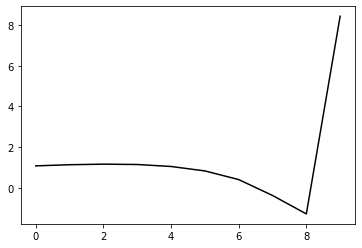

254100 0.22053335017168316
0.24354636646244077 -0.15472641759597086 -0.22612887610564536 -0.12769635209054087
[ 1.14052782  0.99421268  1.00857157  0.99450606  0.90339213  0.68967402
  0.26843698 -0.50845579 -1.40922465  8.45300308]


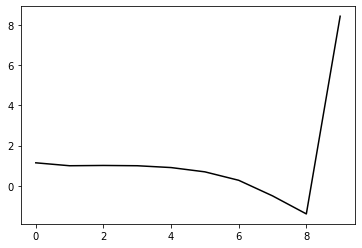

255200 0.18981611639637208
0.24540296871317982 -0.14908271816697138 -0.22195706528985457 -0.13319908345804873
[ 1.13708066  1.19305522  1.20000613  1.18195497  1.09558971  0.88513646
  0.46475969 -0.31241935 -1.21401058  8.43507469]


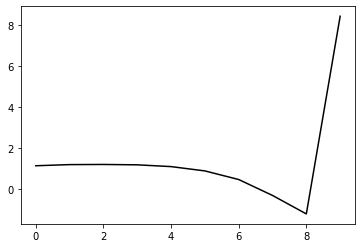

256300 0.1864226947463816
0.2506401750112007 -0.1458576407999622 -0.2211751336473593 -0.12987669958633719
[ 1.130838    1.13599179  1.1578168   1.12924285  1.03527271  0.81869932
  0.39063654 -0.39511096 -1.30589693  8.47681862]


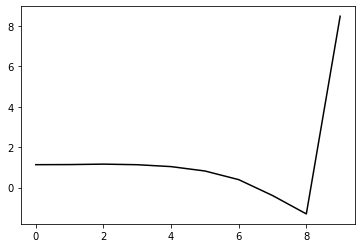

257400 0.20591766475690595
0.24006063033426386 -0.15237663566308765 -0.2239240119941434 -0.12833210721711852
[ 1.10679173  1.02843759  1.00507958  0.97756874  0.88532762  0.67216892
  0.24728384 -0.53501543 -1.44079851  8.39250855]


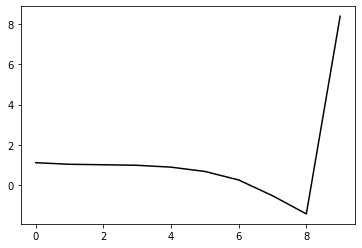

258500 0.18795381548587925
0.24904335629651303 -0.1486013454683356 -0.22291383613532828 -0.13060786493367457
[ 1.09879846  1.23287345  1.23701786  1.20291725  1.11027918  0.89752928
  0.47123619 -0.31403224 -1.22378077  8.48439705]


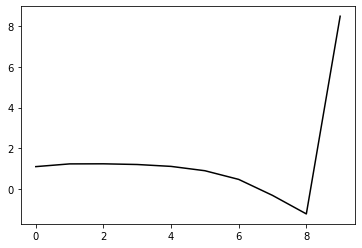

259600 0.17092571826049685
0.24432079596059186 -0.1530183656306974 -0.22506430337904057 -0.12877818345308736
[ 1.09767845  1.11459874  1.10560219  1.06839778  0.97001017  0.75466301
  0.32657492 -0.45986033 -1.36898741  8.41638991]


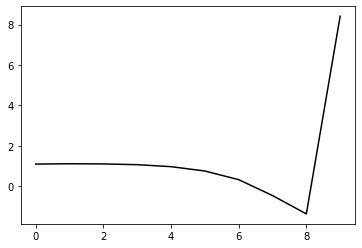

260700 0.11731075527869704
0.25105786755736625 -0.14676405120592195 -0.2223622029128903 -0.12832888998629552
[ 1.09830762  1.17010133  1.20133182  1.16809965  1.06768551  0.8498098
  0.4176128  -0.37537052 -1.29346806  8.43454971]


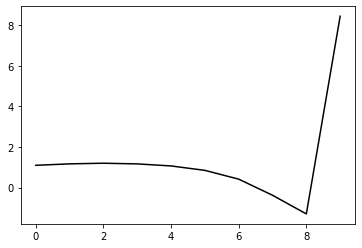

261800 0.1311238907545235
0.2432601651897689 -0.1502763067931537 -0.22327347086156712 -0.1293019083794548
[ 1.11759716  1.15130837  1.12835708  1.09499909  0.99609915  0.77955739
  0.34879893 -0.44297294 -1.35912759  8.42622216]


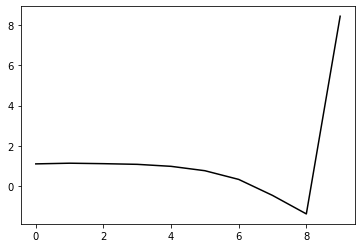

262900 0.1965072752573593
0.2474436122644608 -0.1523793831736167 -0.22614390040413906 -0.12885136407486392
[ 1.07253522  1.09722376  1.13059024  1.10791971  1.0196367   0.81287332
  0.39052154 -0.39434636 -1.30389254  8.46139495]


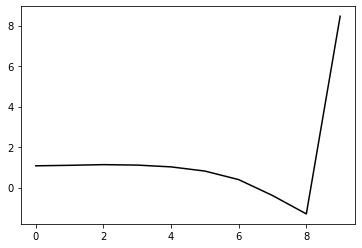

264000 0.20692094151224366
0.24358928298784105 -0.15443779219770185 -0.22708624830381566 -0.12770476791586846
[ 1.11141926  1.10323016  1.0966414   1.07173372  0.98389408  0.7774625
  0.35486807 -0.43142159 -1.34298878  8.42115551]


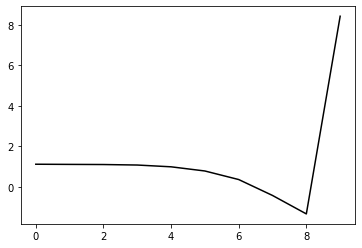

265100 0.18937460724351285
0.2465457149003413 -0.14871066280573644 -0.223739854791731 -0.12675188349373348
[ 1.12083051  1.15588992  1.14815219  1.11303893  1.01834289  0.8060186
  0.37670602 -0.41815391 -1.34012874  8.43752465]


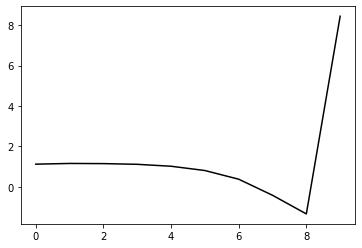

266200 0.18260797213974073
0.2462339492467412 -0.14792818924896603 -0.22295525187048962 -0.1293811757152056
[ 1.13713468  1.21367052  1.22274415  1.1957435   1.10540266  0.89780834
  0.47270083 -0.31898436 -1.23778376  8.4380076 ]


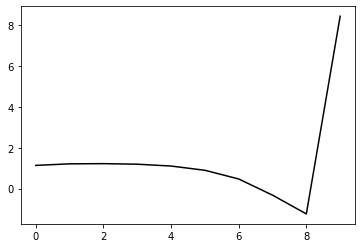

267300 0.18090952845512914
0.2383441079244815 -0.1507448691829953 -0.2233288753287184 -0.1294117233720729
[ 1.11948978  1.01295259  0.99902718  0.96970876  0.87863817  0.67191599
  0.24880306 -0.5406332  -1.45596009  8.46426071]


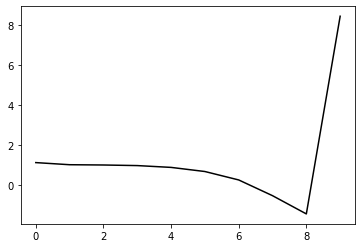

268400 0.25034083559554665
0.24839197131999305 -0.14588783107000575 -0.221858188695356 -0.13124200105668354
[ 1.16817537  1.20260832  1.22310482  1.19363434  1.10419596  0.89856053
  0.47532477 -0.31619769 -1.23529829  8.43178899]


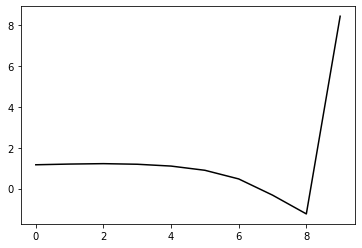

269500 0.210465107077081
0.23981422280880035 -0.15471538977528707 -0.2265033140685764 -0.13141947061553202
[ 1.15327705  1.0984928   1.10164048  1.08345831  1.00404728  0.80940517
  0.39798888 -0.38119917 -1.2856601   8.44406079]


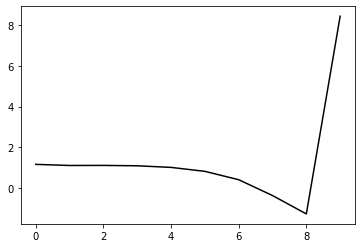

270600 0.17859742835093476
0.24564375522409126 -0.15213452736163355 -0.22596578810692755 -0.12798073606519086
[ 1.09048691  1.16482941  1.14702021  1.1017056   1.00087906  0.78777071
  0.35953382 -0.43666068 -1.35931265  8.46048985]


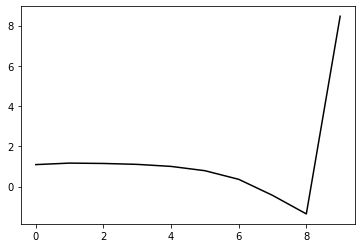

271700 0.12709625743058003
0.24545771837807667 -0.1535110703326581 -0.22707700502742006 -0.12793176337040155
[ 1.11773056  1.13682958  1.16815116  1.14145377  1.05065463  0.84691485
  0.42721115 -0.36212892 -1.27856593  8.44119582]


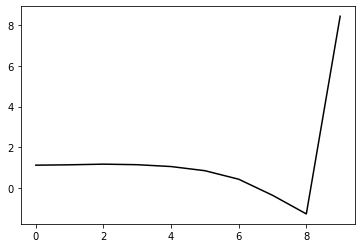

272800 0.14545094255910404
0.24420801791138014 -0.1491010852551506 -0.2236323561933149 -0.1300979409607305
[ 1.15278197  1.14026086  1.17076596  1.15397325  1.06610064  0.86245923
  0.44188746 -0.35033273 -1.27165997  8.4304911 ]


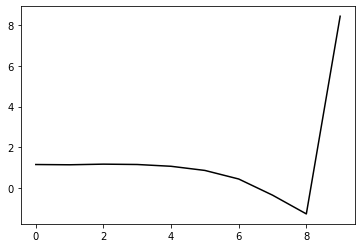

273900 0.17329793778508132
0.24443755673202508 -0.1484489388577318 -0.22329227832935197 -0.12721822055195012
[ 1.12860613  1.06211149  1.04977512  1.01714623  0.92118727  0.70972614
  0.28255115 -0.51602277 -1.44353591  8.42542432]


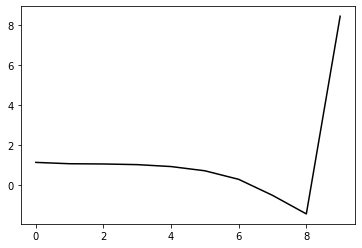

275000 0.20992500933786606
0.24733171533658962 -0.1491181808247746 -0.22448351982448925 -0.12716488157184797
[ 1.10603746  1.15804062  1.16662403  1.13402622  1.03724886  0.82475658
  0.39628549 -0.40420729 -1.33399904  8.42943192]


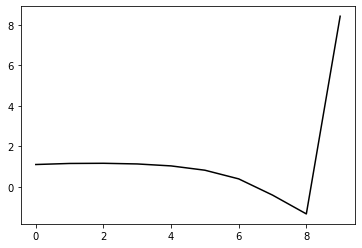

276100 0.19614908287813035
0.24318613224313748 -0.15051126079056507 -0.224384112214135 -0.1274673487601549
[ 1.13008042  1.12598599  1.11423715  1.08556034  0.99046116  0.77903948
  0.35172208 -0.44775564 -1.37604687  8.45204168]


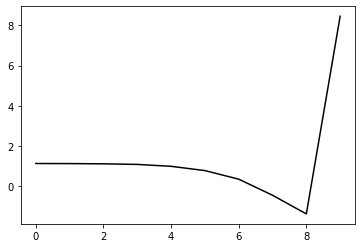

277200 0.3232552301312165
0.23355460920513052 -0.1462346161266939 -0.21850075617467232 -0.13318511586766865
[ 1.19799568  0.9726635   0.98367835  0.96009401  0.87057107  0.66413349
  0.24155705 -0.55330159 -1.4762335   8.37598692]


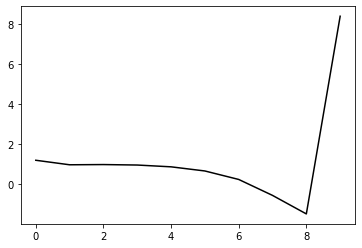

278300 0.15478741168879942
0.24273547157199848 -0.15552108865256828 -0.22813968350081387 -0.1283972895924692
[ 1.10138311  1.15225696  1.12892456  1.09818076  1.00938841  0.80380742
  0.38185335 -0.41270319 -1.33543353  8.45610823]


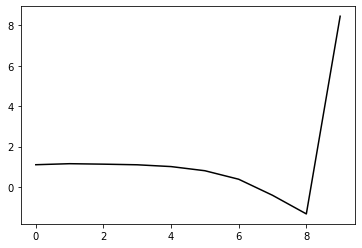

279400 0.19303761877647588
0.24546978257934515 -0.15459856560700005 -0.22796720160717804 -0.1295041767409263
[ 1.09684282  1.19477226  1.19960113  1.1682641   1.0797614   0.87594381
  0.45542872 -0.338367   -1.26092655  8.42900145]


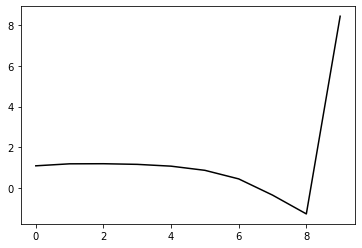

280500 0.20280665405388407
0.24470426570231715 -0.14966356973141845 -0.22397163662701344 -0.12865887774988571
[ 1.13316666  1.11618497  1.11546278  1.07303574  0.97101214  0.75705999
  0.32836736 -0.47277209 -1.40215903  8.44413075]


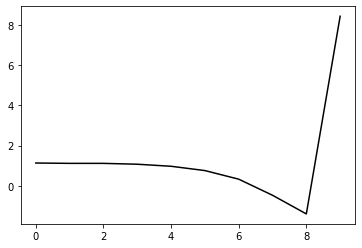

281600 0.15905308941768787
0.24478850194022095 -0.14902435040379403 -0.22337947625479207 -0.1291544559408852
[ 1.12816937  1.13363472  1.11713446  1.07426095  0.96989537  0.75397318
  0.32409711 -0.47828398 -1.40896431  8.42026445]


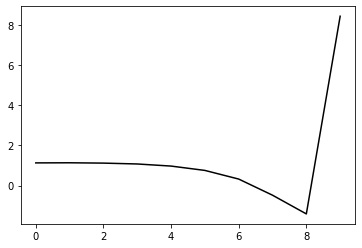

282700 0.1641327662546442
0.24453689220828123 -0.14804653678866153 -0.2222526271441612 -0.1321882787346255
[ 1.14298474  1.10506209  1.12922001  1.09525672  0.99536433  0.78362205
  0.35842464 -0.43928903 -1.36494661  8.44288078]


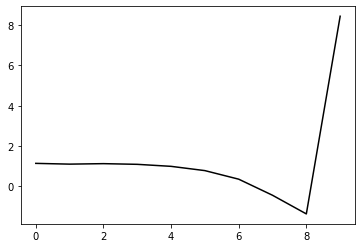

283800 0.13302580841316403
0.2409412301812497 -0.15135806638449267 -0.22401259473746124 -0.13212598841078715
[ 1.11858417  1.1498666   1.11109123  1.06655495  0.96050609  0.74228954
  0.31169772 -0.49077864 -1.42064245  8.42103834]


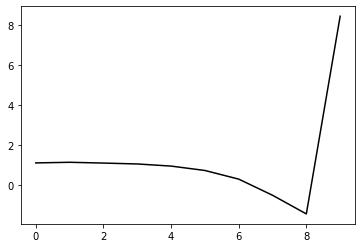

284900 0.1939445083297436
0.248224170379442 -0.14945038958969678 -0.22439137488246996 -0.1307048612738822
[ 1.08074149  1.19015993  1.19532757  1.14412653  1.03131871  0.80651169
  0.36902558 -0.44135384 -1.38100085  8.44195524]


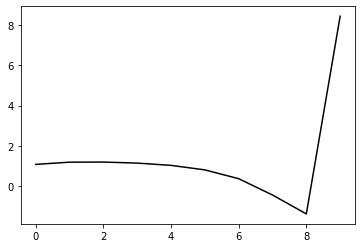

286000 0.2239562006416257
0.24893451447703177 -0.15194097179543808 -0.2266618704559856 -0.128623868185281
[ 1.06443562  1.14243717  1.16096396  1.1274539   1.02136859  0.80133522
  0.36838404 -0.43805982 -1.37441264  8.41163815]


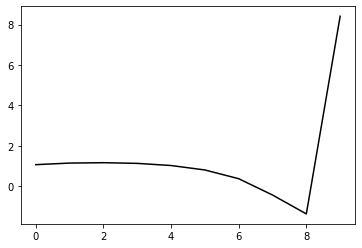

287100 0.20633988247245022
0.24646220895255966 -0.1529065716398638 -0.22666230603615656 -0.12908088843417292
[ 1.11744461  1.07163168  1.07721463  1.04325602  0.9400881   0.7216552
  0.29126704 -0.51140453 -1.44232338  8.43659934]


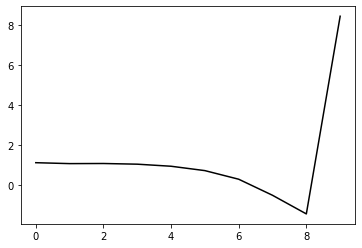

288200 0.17444392858376834
0.24344335797985814 -0.15492330031765292 -0.22722264467486658 -0.13159432144938776
[ 1.11110251  1.12258795  1.12048113  1.09492611  1.00143661  0.79070575
  0.36727305 -0.4282542  -1.35111724  8.41236655]


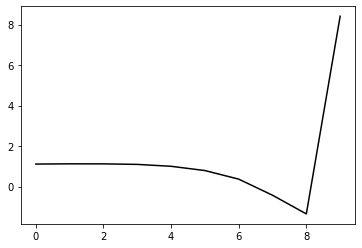

289300 0.1664383911220384
0.24965841827711302 -0.14840424292396912 -0.2236838387623572 -0.1323485335303045
[ 1.07783902  1.18295273  1.21033092  1.17418835  1.06883098  0.84595061
  0.40958533 -0.39951224 -1.33762501  8.45946355]


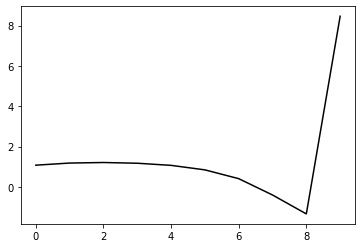

290400 0.18880375686742448
0.24609304981156194 -0.1506222093097307 -0.22444737844977 -0.1310243583064561
[ 1.08705283  1.11996638  1.13838711  1.11337802  1.00854259  0.78396463
  0.34591092 -0.46402806 -1.40176012  8.42230209]


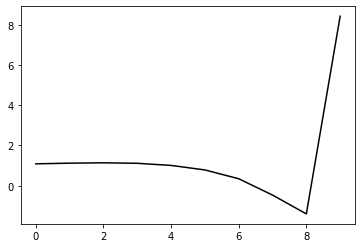

291500 0.2316754512172735
0.24736232433716085 -0.14959668844939547 -0.22404212125230702 -0.13502093946981708
[ 1.12656278  1.19244537  1.23498046  1.23223234  1.14889417  0.94050533
  0.51545793 -0.28351395 -1.21173972  8.47476126]


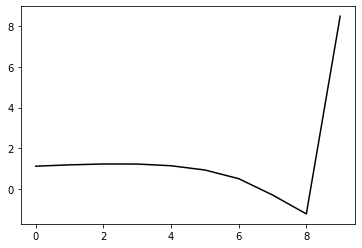

292600 0.1575933304248426
0.24199145888241005 -0.15105471828390676 -0.22411754018862698 -0.1332200623445351
[ 1.10266443  1.0859158   1.09146859  1.08260746  1.00027194  0.79138895
  0.36460611 -0.43651972 -1.3672821   8.42207759]


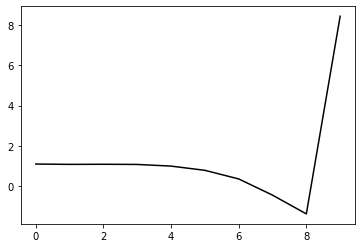

293700 0.12273082156924911
0.24487578389712902 -0.15245120826588296 -0.22573494171155228 -0.13274091969765459
[ 1.09757546  1.10586431  1.12615675  1.11164307  1.03001225  0.82261246
  0.39611121 -0.40490273 -1.33536313  8.44683797]


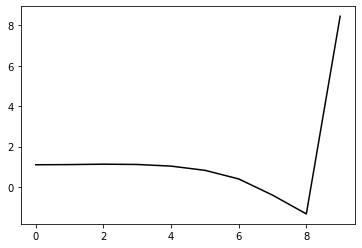

294800 0.14831789243719884
0.24705743450051107 -0.1491787398099535 -0.22404251373650313 -0.1321296798068993
[ 1.08203937  1.18218914  1.18416166  1.15666572  1.06865304  0.85639777
  0.42335368 -0.38557496 -1.32568432  8.41831987]


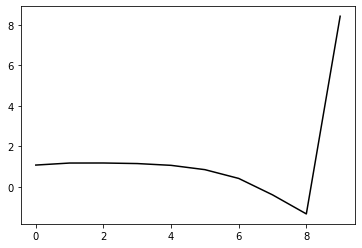

295900 0.21474957982688822
0.24618651576479125 -0.15109977540028705 -0.2257521041350937 -0.1318073167194994
[ 1.05022517  1.12141027  1.15695061  1.14328667  1.06352059  0.8606822
  0.43535288 -0.36746114 -1.30238822  8.45233978]


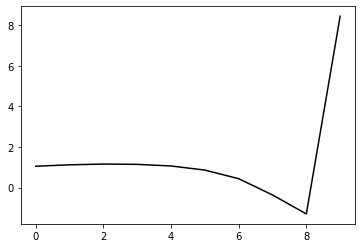

297000 0.22242017765798938
0.24259805690920797 -0.15532854635498772 -0.22832193884905255 -0.1255509459569499
[ 1.07668789  0.9874434   0.99498462  0.97378706  0.88687612  0.67821202
  0.24729957 -0.56132247 -1.50233258  8.40708039]


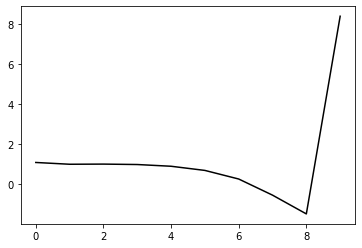

298100 0.19237232216558142
0.24608582858856484 -0.15006081795705314 -0.22442915146338502 -0.13241467600419382
[ 1.10641598  1.17214495  1.18320597  1.15551082  1.06655381  0.85698651
  0.4253601  -0.38395299 -1.32530313  8.46597522]


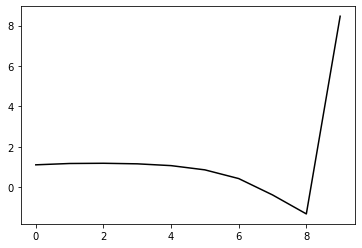

299200 0.17730958757958964
0.24572909640679463 -0.14795297192480164 -0.22268190234315366 -0.13368210767956554
[ 1.10582988  1.20210759  1.22506391  1.2026891   1.11290506  0.90336344
  0.47182209 -0.33794637 -1.27999344  8.41621507]


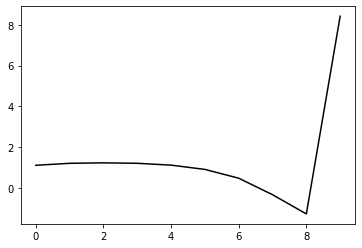

300300 0.17263885871308032
0.2457233991245707 -0.14742240467422021 -0.2225364508461354 -0.13263686928597584
[ 1.08733198  1.08582245  1.1077022   1.09891319  1.01639965  0.81192359
  0.38438969 -0.4229221  -1.36363015  8.44496902]


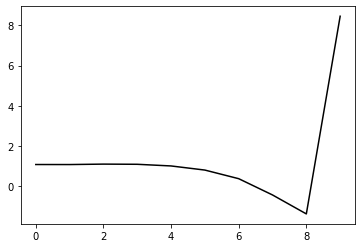

301400 0.23738908766926092
0.2327670619447202 -0.15235659126177625 -0.22352484311384788 -0.1323806650208622
[ 1.12058495  0.94075196  0.8935779   0.87404259  0.792213    0.58914417
  0.16378724 -0.64093063 -1.57806162  8.38667541]


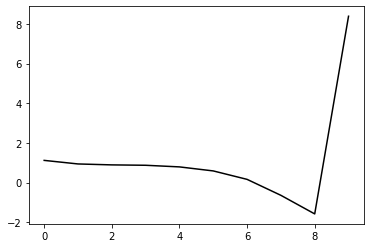

302500 0.18725353397635508
0.24837641637341704 -0.14681700704728246 -0.2229484791957694 -0.13324774415215765
[ 1.08565371  1.26283064  1.251216    1.21579843  1.13108862  0.92577881
  0.49611419 -0.31538896 -1.26218895  8.47322078]


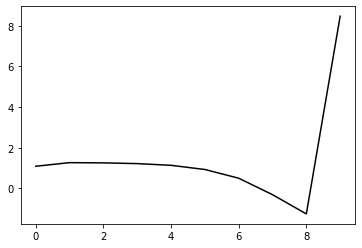

303600 0.15784727282016547
0.24220070062339707 -0.15357890157652831 -0.226261080594807 -0.13308204978950122
[ 1.09388352  1.1544532   1.15227215  1.11586329  1.02827219  0.82464666
  0.39812199 -0.40902312 -1.34909223  8.44391048]


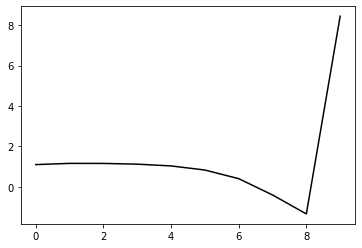

304700 0.135755935175797
0.2427070224545524 -0.14945529497782978 -0.22331526619349928 -0.13443786484207637
[ 1.11948665  1.13002351  1.16245752  1.13227486  1.04137659  0.83625733
  0.40846366 -0.40117553 -1.34522194  8.43906271]


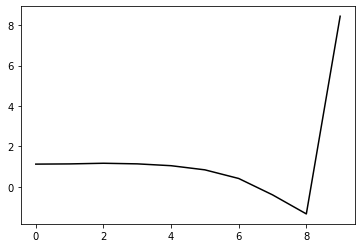

305800 0.12630600330898706
0.2437518333566691 -0.14980593374554946 -0.22367711442074836 -0.13453278879034122
[ 1.10243867  1.1421477   1.17753612  1.15894564  1.06879205  0.86331349
  0.43595143 -0.37371469 -1.31811752  8.44051849]


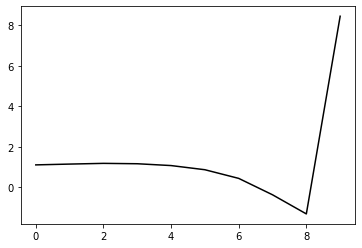

306900 0.19013929515898376
0.24510528277102606 -0.15090607162337288 -0.2249775316980311 -0.13321534399108972
[ 1.08108527  1.09012272  1.12122256  1.11228574  1.02885607  0.826972
  0.40331263 -0.40347493 -1.34581496  8.4521594 ]


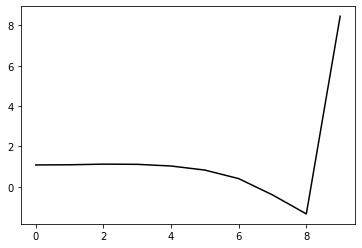

308000 0.2097524111518022
0.24577462248731277 -0.15250910944040177 -0.22664268759744827 -0.12943454051807202
[ 1.06284223  1.026593    1.04577385  1.0372352   0.95809562  0.7582178
  0.3360868  -0.46993295 -1.4122998   8.40546498]


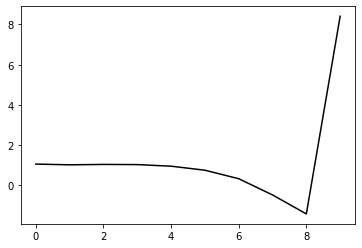

309100 0.197194918716428
0.24343444645135348 -0.15351926985703865 -0.226956090499504 -0.13155204950236915
[ 1.11892223  1.08395927  1.08496683  1.07756735  1.01008089  0.8209151
  0.40808961 -0.38991944 -1.32517427  8.45146269]


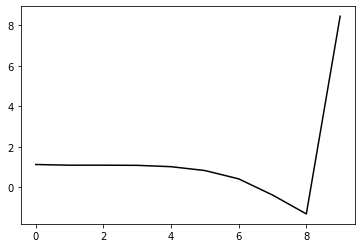

310200 0.16525427722758113
0.2460211890139273 -0.15076472065354635 -0.2255785544524953 -0.1304573571477155
[ 1.08365327  1.20345454  1.18668396  1.16045046  1.08363773  0.88657837
  0.46397722 -0.34606871 -1.2962203   8.42485781]


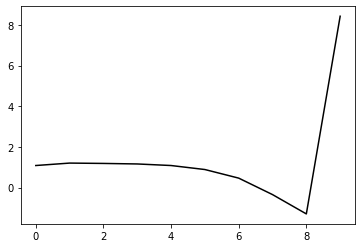

311300 0.18658884522673344
0.24835378642792127 -0.14621809830582147 -0.22287897126805067 -0.13107199097735628
[ 1.13156028  1.12833009  1.15794658  1.13212452  1.0505273   0.85241537
  0.4285189  -0.38432916 -1.33908754  8.49935579]


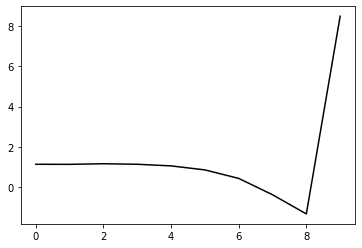

312400 0.16751526832459443
0.24754254714883936 -0.14863107600963793 -0.2247509114478365 -0.13105435314073433
[ 1.09800727  1.18484838  1.2108993   1.20082375  1.12812999  0.9391072
  0.52425896 -0.28102406 -1.22969074  8.43194175]


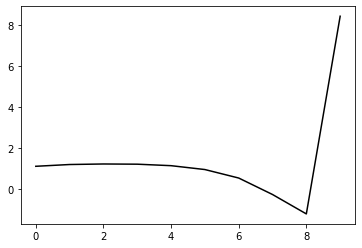

313500 0.22846920797754802
0.23496430379364303 -0.15069945980590713 -0.22360776136678273 -0.12802629898475482
[ 1.1226503   0.94825012  0.89469369  0.86965071  0.79024764  0.59719524
  0.18080709 -0.62453076 -1.57145296  8.40628615]


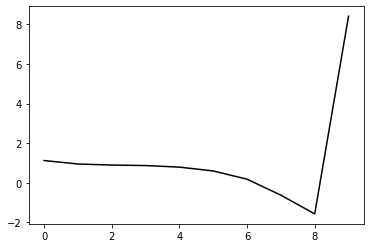

314600 0.15371102122640876
0.2453772886288297 -0.14714204561143313 -0.2227847895877445 -0.13256884485259493
[ 1.08145697  1.18247353  1.15587685  1.10966895  1.02131578  0.82217315
  0.40062904 -0.40993272 -1.36254568  8.42702122]


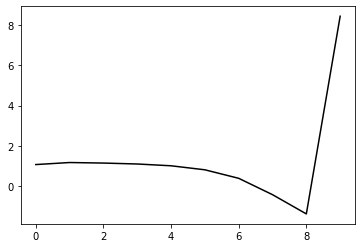

315700 0.13813595657430794
0.2428653697261113 -0.14915625802644458 -0.2236947448729442 -0.13395327040776878
[ 1.12440066  1.11578309  1.14674062  1.12098859  1.04095482  0.85254346
  0.44240215 -0.35739862 -1.29944301  8.43649671]


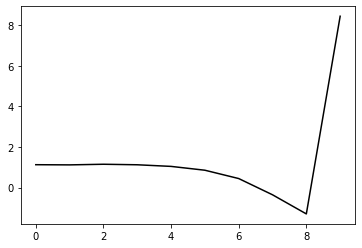

316800 0.13541178143332752
0.24117252057743618 -0.15167097533520824 -0.2251339875834331 -0.13451916514526954
[ 1.13064166  1.1026642   1.13314842  1.1262052   1.0562449   0.87687092
  0.47675278 -0.31350921 -1.24640419  8.4341886 ]


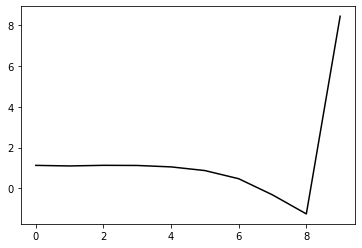

317900 0.19395985544774927
0.24509979685726926 -0.1499755168584204 -0.225070363183346 -0.13183501277855242
[ 1.07661103  1.12155526  1.12922503  1.1105636   1.03063233  0.83987931
  0.42890718 -0.37356387 -1.3220466   8.4558316 ]


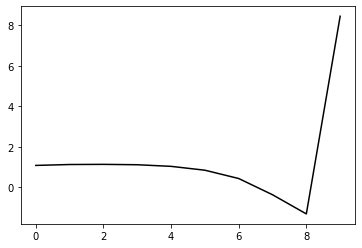

319000 0.21244649873185567
0.2450518826440443 -0.15276841016616322 -0.2275780836206008 -0.1276604868178539
[ 1.06524047  0.98443095  0.98659201  0.96844836  0.89310402  0.70718298
  0.30202981 -0.49468727 -1.43803695  8.41015447]


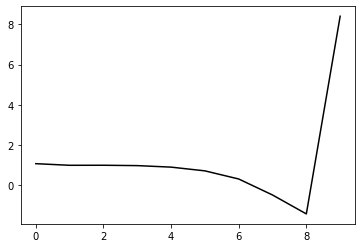

320100 0.1846408778036355
0.24862817559688571 -0.14406938544868622 -0.2218074310595315 -0.13011215894263148
[ 1.08245957  1.15934965  1.14671072  1.10646797  1.01599332  0.81586411
  0.39670192 -0.4151623  -1.37690649  8.46401555]


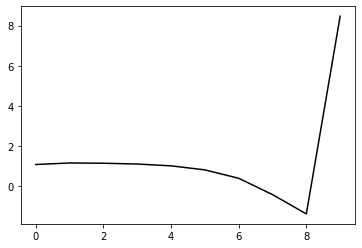

321200 0.178213709350735
0.24256545778526747 -0.14887482549406245 -0.2241292177090981 -0.1296862239626568
[ 1.07605502  1.11526267  1.10861578  1.08149666  0.99996668  0.80922956
  0.39943281 -0.4035137  -1.35673515  8.4263461 ]


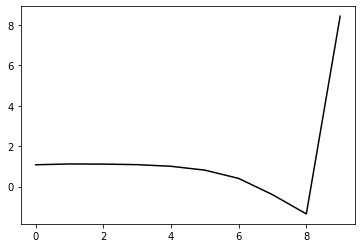

322300 0.16463791607402908
0.24810413751323707 -0.14420380856178672 -0.2222058576463339 -0.13035059872093
[ 1.07789896  1.15948453  1.17324572  1.14435265  1.06001549  0.86622225
  0.45314002 -0.35417933 -1.31393885  8.42878563]


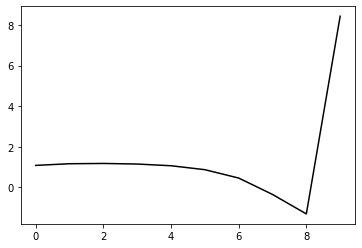

323400 0.16962635269500803
0.2447389098988626 -0.14567394635203942 -0.22245703139045905 -0.13158856254282886
[ 1.0751187   1.14297934  1.15132057  1.13215049  1.05542261  0.8692249
  0.46425759 -0.33512103 -1.28751712  8.39165151]


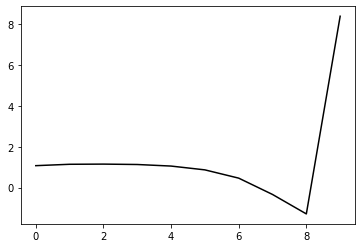

324500 0.2113425975917752
0.24092125961739524 -0.1473450447122702 -0.22248297046429724 -0.13312228401733373
[ 1.11624954  1.11915925  1.11024854  1.09640163  1.02620708  0.84631344
  0.4482673  -0.34366789 -1.28799496  8.4590578 ]


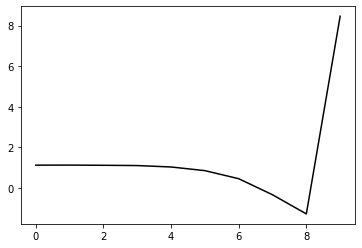

325600 0.14440864307971524
0.24604178669787455 -0.14662183902713974 -0.22347429905219865 -0.13168744762858764
[ 1.08452405  1.17231238  1.18987786  1.17438393  1.10480678  0.92542215
  0.52748565 -0.26528987 -1.21243303  8.45205396]


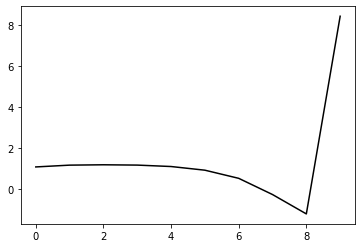

326700 0.13042594128135016
0.2430854151040702 -0.15098030795989822 -0.2260277947515439 -0.13006958157294843
[ 1.08954912  1.05902171  1.06041472  1.04472154  0.97674657  0.8003869
  0.40671116 -0.38080732 -1.32182982  8.44060594]


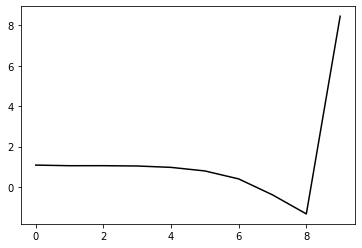

327800 0.13205941090983875
0.24022261726126282 -0.14604916236449098 -0.22162422925325237 -0.13407502785129755
[ 1.10331595  1.13517962  1.1341328   1.11290268  1.04244642  0.86431558
  0.46880168 -0.32119111 -1.26631262  8.44930224]


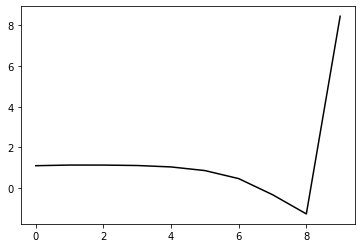

328900 0.1829572643674951
0.24186482754761782 -0.15164364775735117 -0.22650911424771644 -0.12949367327072434
[ 1.0889927   1.05242568  1.04143332  1.01698411  0.94919514  0.7764545
  0.38738808 -0.39594292 -1.3347469   8.44402366]


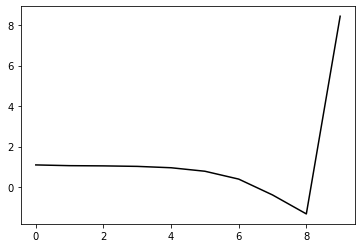

330000 0.20459989205569942
0.2419447660008784 -0.14533983069637474 -0.22194963547501478 -0.13102657583799338
[ 1.09864516  1.11502757  1.09899422  1.05885062  0.97533014  0.79027901
  0.39003432 -0.40524979 -1.35905002  8.42707349]


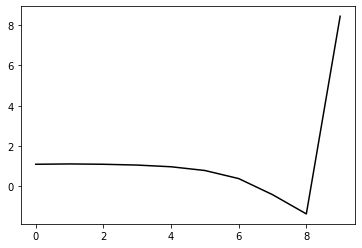

331100 0.18976657517860937
0.24458202604322 -0.14631005225054755 -0.2237135559706004 -0.13072024068195476
[ 1.0896077   1.14770671  1.1750692   1.15105183  1.07415482  0.89519646
  0.50096647 -0.28939535 -1.24033559  8.47715938]


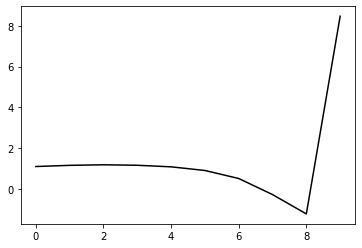

332200 0.1629689193034147
0.24324566370499778 -0.14535165394266733 -0.22325220589428504 -0.12979024830308694
[ 1.09084575  1.17514987  1.19302075  1.17713601  1.10333976  0.92561468
  0.53293658 -0.25660255 -1.20879269  8.44536936]


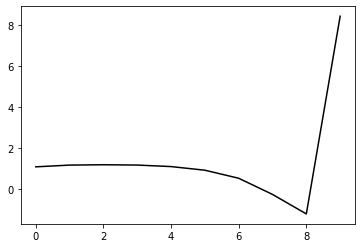

333300 0.22511307726763805
0.2272208974709784 -0.14856000050123683 -0.22158499010086194 -0.1328653716039653
[ 1.13156039  0.90224524  0.85825023  0.83428615  0.75923822  0.58215617
  0.19359253 -0.58898578 -1.53174785  8.43583535]


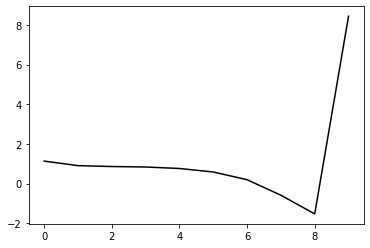

334400 0.15371961751621235
0.24351759547584992 -0.14480348198086107 -0.2229389652225655 -0.13044292071719907
[ 1.10349242  1.23137109  1.21142248  1.17033232  1.08920396  0.90561795
  0.50934859 -0.28284274 -1.23931057  8.41134432]


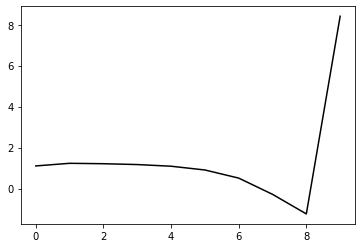

335500 0.19828122180204139
0.23770742003382245 -0.15206990457120076 -0.22657292701195803 -0.1309304803967504
[ 1.11018315  1.1161147   1.11729637  1.08723818  1.01102763  0.83582005
  0.45041318 -0.3284674  -1.26888853  8.45987833]


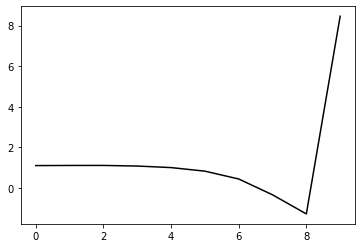

336600 0.15893789292083718
0.23617071896997552 -0.1526466818006585 -0.22665469913709846 -0.13165944780049263
[ 1.10888761  1.12287141  1.10033072  1.0669543   0.98701499  0.80909099
  0.42229292 -0.35753634 -1.29985452  8.4403731 ]


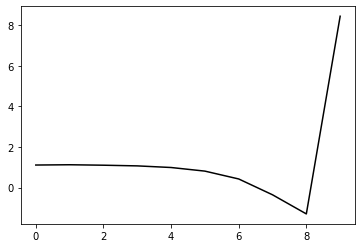

337700 0.13956492842048168
0.23701752869487766 -0.1492258174622539 -0.22423699161658442 -0.13296140080151178
[ 1.12825122  1.10987467  1.11566172  1.08098548  0.99835755  0.81878678
  0.43165517 -0.34802653 -1.29109608  8.47086668]


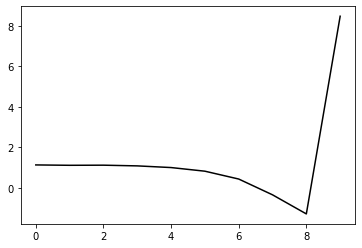

338800 0.13045809800898236
0.23849407709094306 -0.1497662303863913 -0.22485031983738776 -0.13394216139908371
[ 1.11897727  1.15044347  1.15621082  1.12794313  1.04751972  0.86973901
  0.48558825 -0.29056956 -1.23089547  8.45113546]


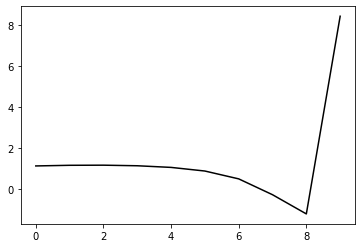

339900 0.19904765945449304
0.24181983742676716 -0.14963424573203943 -0.22597827316837493 -0.1310641669360409
[ 1.0524633   1.05786238  1.08768501  1.06414823  0.98141549  0.80026393
  0.41425278 -0.36291609 -1.30546057  8.45263473]


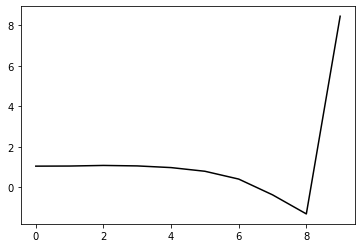

341000 0.23829831303931084
0.23883862958758803 -0.15199539921449917 -0.22700743446410843 -0.132810119154645
[ 1.12506664  1.06250391  1.07598754  1.06441189  0.99640882  0.82696377
  0.45266532 -0.31243114 -1.24354361  8.42876389]


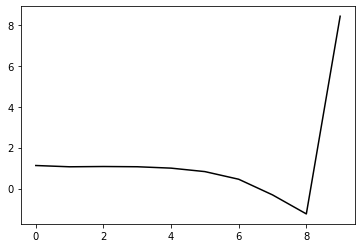

342100 0.3586713808197859
0.2346917138350937 -0.14908200994178777 -0.22367157370916135 -0.13574014370456544
[ 1.18830531  1.01991011  1.0259776   1.00972954  0.94356974  0.7763149
  0.40507516 -0.35574111 -1.28310506  8.4663537 ]


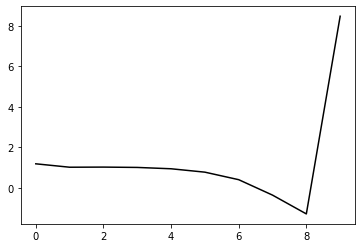

343200 0.17158924299392178
0.24014275561396375 -0.15033691904039356 -0.2261076866071244 -0.1304686303578461
[ 1.07781013  1.17731867  1.12990874  1.07890178  0.99189393  0.8080913
  0.42255145 -0.35093024 -1.29177531  8.43276549]


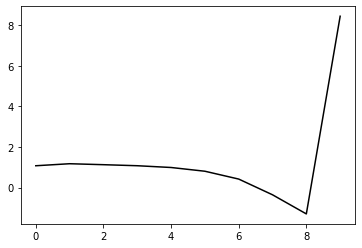

344300 0.16154340092412603
0.24427569505340405 -0.1444526601869396 -0.22289364545169235 -0.1304279144020585
[ 1.05841364  1.22095348  1.1924796   1.12713851  1.02195605  0.82448553
  0.42697469 -0.35761927 -1.31125212  8.45658494]


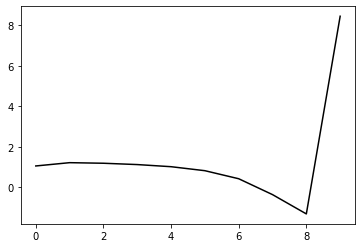

345400 0.19001710047888226
0.23859551307203944 -0.1491853502544252 -0.22507061798400843 -0.13223972845736448
[ 1.14401703  1.05558655  1.06853959  1.03949055  0.95500445  0.77670563
  0.39877209 -0.36545667 -1.29790584  8.41508782]


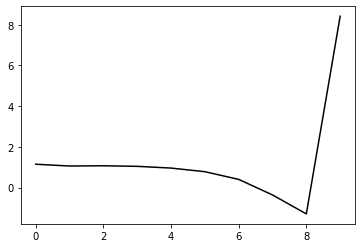

346500 0.20799615926677106
0.234998431455534 -0.15255685206896408 -0.22678192220185697 -0.13101503245476068
[ 1.12552446  1.07378707  1.04390099  1.00888911  0.92084065  0.73795293
  0.35710971 -0.40846843 -1.34235849  8.44936405]


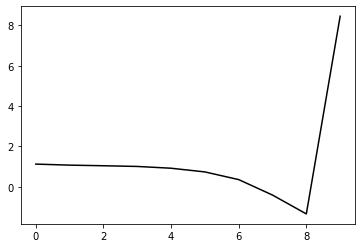

347600 0.17675729862605
0.24055693541822812 -0.14945833824222393 -0.22544653696864528 -0.13149989270198
[ 1.06249344  1.13087597  1.10282869  1.04652428  0.94337453  0.74706106
  0.35510964 -0.41955603 -1.36277303  8.41736619]


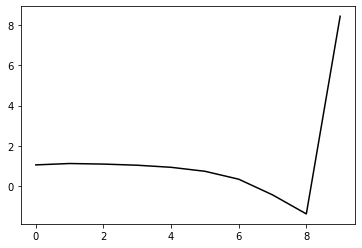

348700 0.14469014037483469
0.2413493070494621 -0.15228864668445258 -0.22804579117377574 -0.1295770744221745
[ 1.07283603  1.14889705  1.13509355  1.08800878  0.98903111  0.79597793
  0.40762443 -0.36279214 -1.30275054  8.44738705]


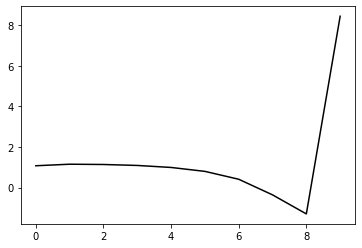

349800 0.15954011455345188
0.2418664884963689 -0.15239822897354402 -0.2282662750691244 -0.1292238944513734
[ 1.08563105  1.12422356  1.11802261  1.07195251  0.97382807  0.78129134
  0.39496735 -0.37146234 -1.30768916  8.42113566]


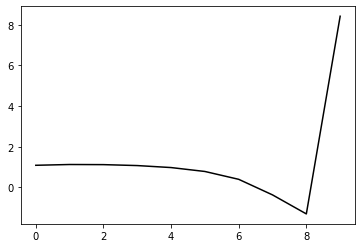

350900 0.17570440010850205
0.24036590818848083 -0.15249226284856277 -0.22796283283269456 -0.1300915845328059
[ 1.10780631  1.07454677  1.07865067  1.03435743  0.93558208  0.74228053
  0.35712088 -0.40540554 -1.3374479   8.44907859]


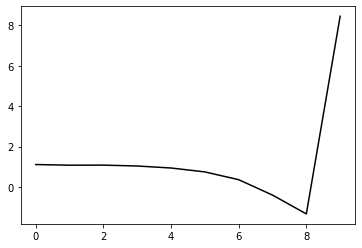

352000 0.19247043568010874
0.2433217172159875 -0.14429743465424968 -0.22282783065149192 -0.13053902816580693
[ 1.08808806  1.22508716  1.22094045  1.16019117  1.03880117  0.81911826
  0.40664164 -0.38339047 -1.34760066  8.42468458]


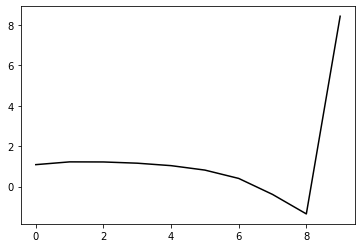

353100 0.21194053594856846
0.23747702680987504 -0.15220925465082183 -0.2275989496709352 -0.12817953154522585
[ 1.13426463  1.02705818  1.05814367  1.02790475  0.92465746  0.71975037
  0.32209092 -0.45096894 -1.39605885  8.43171748]


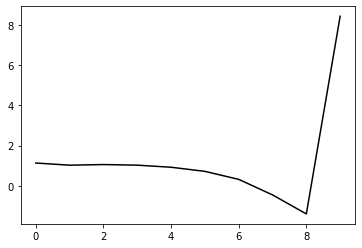

354200 0.1686675229718123
0.24167444285268633 -0.14814870987065662 -0.22569777639747987 -0.12816094529272126
[ 1.08715591  1.2199059   1.21168128  1.17558612  1.06910382  0.85582254
  0.44790865 -0.33582891 -1.29418766  8.41703814]


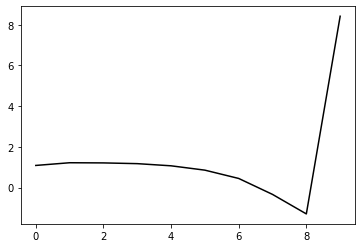

355300 0.16361434930069324
0.2377769617814323 -0.15028643898096036 -0.22631001333455664 -0.1289839739901665
[ 1.08107382  1.06280213  1.0624503   1.02811048  0.9243649   0.71237867
  0.30565249 -0.47474824 -1.4282359   8.47312255]


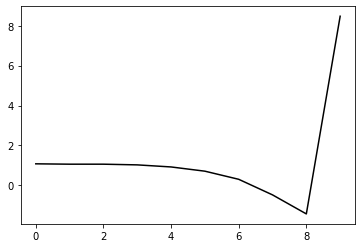

356400 0.24132556913168987
0.24515172882972833 -0.14298988470085428 -0.22207233438146112 -0.13104457293620572
[ 1.15825521  1.19565458  1.22752779  1.18918051  1.08098985  0.86258245
  0.44823644 -0.33886345 -1.29944038  8.42297285]


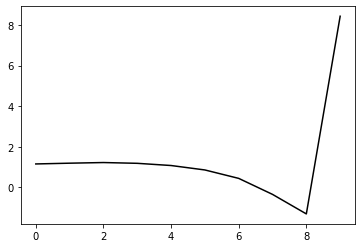

357500 0.2536821252899745
0.24347815182171864 -0.1432967820473935 -0.22196154591608816 -0.13187256470155206
[ 1.12693618  1.15275927  1.19213621  1.16371823  1.05782466  0.83912817
  0.42355297 -0.36327506 -1.3228073   8.45782082]


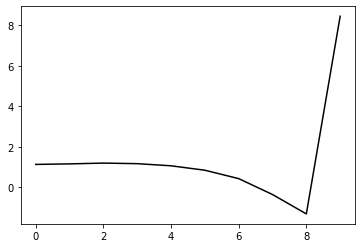

358600 0.17783625614166243
0.246845635580836 -0.14511206790844705 -0.22428937928068565 -0.1293688404287218
[ 1.12682524  1.21335545  1.24922058  1.23039146  1.13350143  0.91867081
  0.50404654 -0.28181144 -1.24082124  8.43580184]


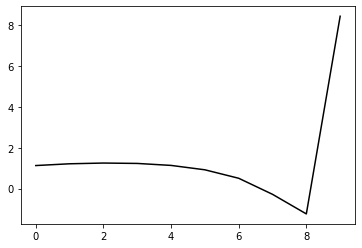

359700 0.11585630489243187
0.24230856969417106 -0.15045844420094004 -0.2271070664800645 -0.13149280264474056
[ 1.11885138  1.20771855  1.21878052  1.21209579  1.13187021  0.93080504
  0.52744686 -0.24631964 -1.19176628  8.47075216]


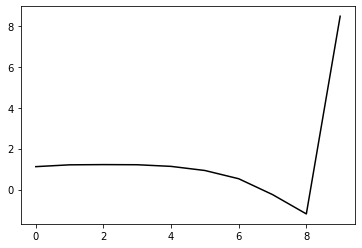

360800 0.15630045805430826
0.2400776311683749 -0.149393952341094 -0.22585741591705938 -0.13138981690128232
[ 1.16980807  1.14775543  1.1521208   1.14217163  1.06826869  0.87347937
  0.47349981 -0.29690038 -1.23878933  8.43992092]


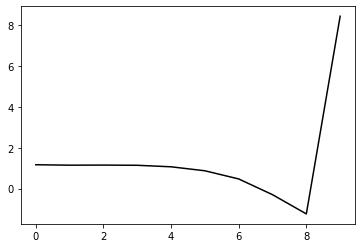

361900 0.1781757345685929
0.2406682060934284 -0.1520653138084523 -0.22838890147037672 -0.1284103500129048
[ 1.11064656  1.15086952  1.104936    1.06638151  0.97868146  0.77351018
  0.36259652 -0.41819081 -1.37048709  8.44375045]


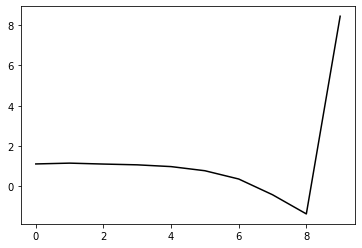

363000 0.22218364144744276
0.23949814891077217 -0.15039266927274475 -0.2267125914497035 -0.12847069187103438
[ 1.12693497  1.07943332  1.06027247  1.01095279  0.91481249  0.70658805
  0.29214266 -0.49168286 -1.44621282  8.40146096]


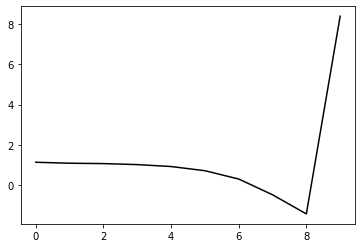

364100 0.2692267418136396
0.2382854646689707 -0.15149400054576506 -0.22739316554984448 -0.13100780787936403
[ 1.19194487  1.02695779  1.05162084  1.02242865  0.93633605  0.7399783
  0.33624633 -0.43746552 -1.38145125  8.47499107]


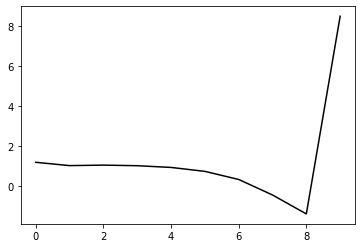

365200 0.19383206590315136
0.23793165887326612 -0.1516295993649551 -0.2274480265380701 -0.13166670508261855
[ 1.14060494  1.13900351  1.13844942  1.1068869   1.01759374  0.8185284
  0.41201188 -0.36467746 -1.31179679  8.41874385]


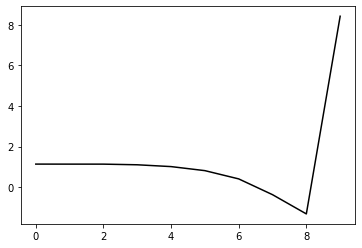

366300 0.1566264936566655
0.24597352624761384 -0.14707118074009917 -0.2260103557194157 -0.12982393889583516
[ 1.07436526  1.16769231  1.18216071  1.14245546  1.0415372   0.83188152
  0.41505148 -0.37247897 -1.33177371  8.46243656]


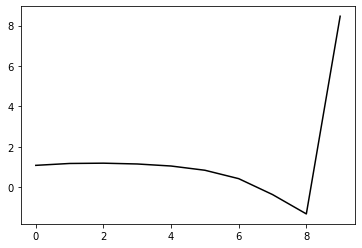

367400 0.16847465272212564
0.24670101839359898 -0.14316094763811812 -0.2235489947882259 -0.12899672175648957
[ 1.09829032  1.15405398  1.18627661  1.15336876  1.05017857  0.83619032
  0.41460943 -0.37827909 -1.3435221   8.41100785]


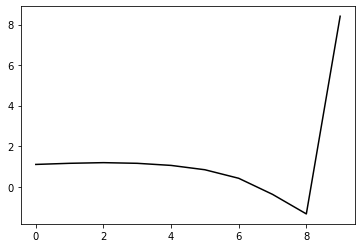

368500 0.20382181127629184
0.24162283172477875 -0.15024146025996882 -0.22782190857234816 -0.1305383905040336
[ 1.14952358  1.14097758  1.17430989  1.16988107  1.09025331  0.89601004
  0.49315419 -0.28110801 -1.2260967   8.46840665]


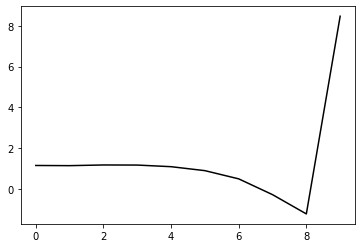

369600 0.15776937355094642
0.2398993824243585 -0.1458021416253851 -0.2241331051304658 -0.12899221711174588
[ 1.12059072  1.11274348  1.08337138  1.04543111  0.94456628  0.7303537
  0.30967993 -0.48029727 -1.43947279  8.43331221]


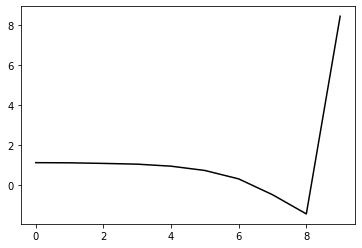

370700 0.12815989583901605
0.2450458484704632 -0.1478764083289544 -0.22666546439348434 -0.1270794718240809
[ 1.09921904  1.1521449   1.16513611  1.12536891  1.0211545   0.80453973
  0.38146645 -0.41011385 -1.36957103  8.46598381]


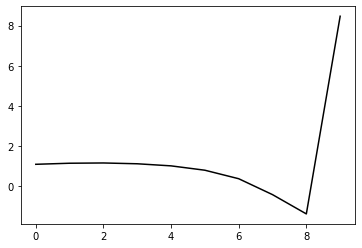

371800 0.12793253718853426
0.2433476947195741 -0.14332294308817697 -0.2226583519759598 -0.13029464019217502
[ 1.10773521  1.14172429  1.16450219  1.13171061  1.02666988  0.80757196
  0.38127186 -0.41383715 -1.37689636  8.42192987]


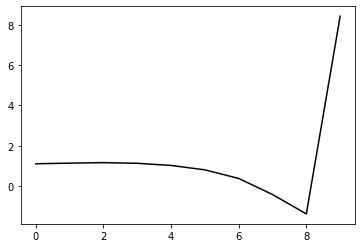

372900 0.18357411231667686
0.24690338801312228 -0.1448613177063863 -0.2247990287888831 -0.12902152420658392
[ 1.11402395  1.12524392  1.16125073  1.14228005  1.04808559  0.83623348
  0.41542369 -0.37501529 -1.33337427  8.44074764]


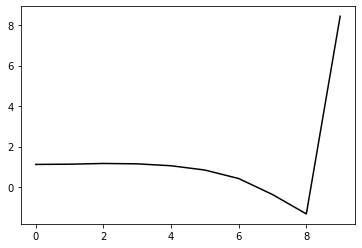

374000 0.20183904507406342
0.24474436474940037 -0.1495172166162086 -0.2283180556778983 -0.1282043539740853
[ 1.10384038  1.08214121  1.13200546  1.13448391  1.05770454  0.85904987
  0.44873118 -0.33276369 -1.28279188  8.43254701]


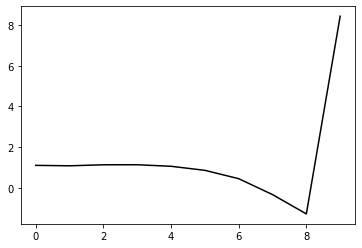

375100 0.21766834877443084
0.24286775331854707 -0.14802261319068455 -0.22715029819627716 -0.12790507136362672
[ 1.07668618  1.15650124  1.1589218   1.15534938  1.07908646  0.87786183
  0.46208944 -0.32701285 -1.28705934  8.45809996]


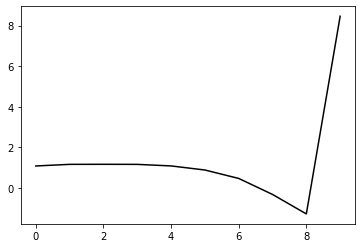

376200 0.1672474317936439
0.2397498841264271 -0.15152147116972536 -0.2291213036566968 -0.12877611834134697
[ 1.11534117  1.14521039  1.15307833  1.15653596  1.10015747  0.9194714
  0.52161265 -0.25071954 -1.1932388   8.4447902 ]


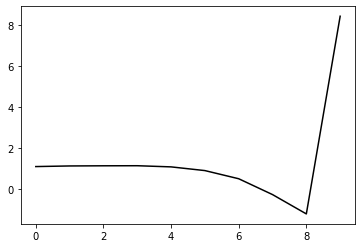

377300 0.20095280642380234
0.2455219803210225 -0.14219377446355386 -0.22359765442090515 -0.12869782270277727
[ 1.14934775  1.15536909  1.1793679   1.1565032   1.07857751  0.880746
  0.46463794 -0.32721314 -1.29077796  8.46908914]


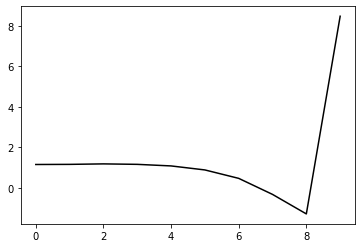

378400 0.21157229445113834
0.24375328323599899 -0.14475851575837245 -0.22517970076709273 -0.13005221916904877
[ 1.16916512  1.18811213  1.2282026   1.21976785  1.14860995  0.95890841
  0.55007795 -0.23550405 -1.19261185  8.43479379]


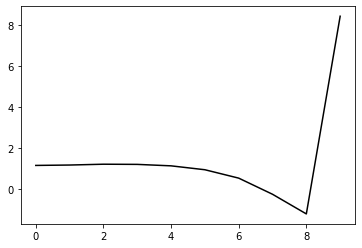

379500 0.22861389999937007
0.2444401943108486 -0.14484001277007175 -0.22526641925183846 -0.13023453199012824
[ 1.13944343  1.21096207  1.2586269   1.25574124  1.18834414  1.00262265
  0.59736141 -0.18553664 -1.13977871  8.47713808]


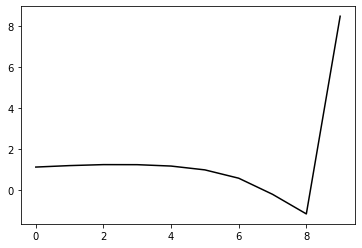

380600 0.2731891753771345
0.2391027818764122 -0.14264473034342276 -0.22258055707461383 -0.12986272300241686
[ 1.18364126  0.99484494  1.02192112  1.01758212  0.94834294  0.76159891
  0.35578245 -0.42823251 -1.38337183  8.42490838]


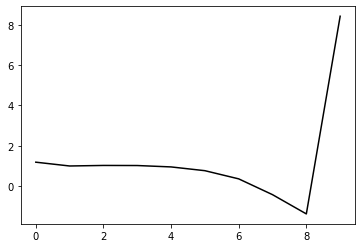

381700 0.12294047939795073
0.24277818887904487 -0.14667655475328334 -0.22607401924858736 -0.12756247097156911
[ 1.09153765  1.17891702  1.15854933  1.13396895  1.05550533  0.86128877
  0.44898356 -0.34114687 -1.30186744  8.45277925]


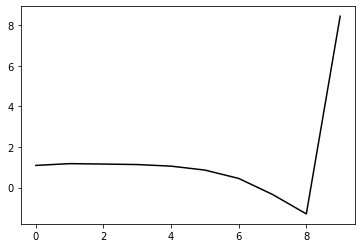

382800 0.1297266220479935
0.24038080193364525 -0.14400351147271523 -0.22340318835970846 -0.12956661927092428
[ 1.10046164  1.12932702  1.13491655  1.10764127  1.02691103  0.83292953
  0.42106067 -0.36918771 -1.32988268  8.43471005]


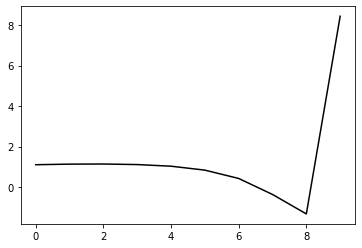

383900 0.18040326988022937
0.23984418861271706 -0.14737933838210493 -0.22576808218757163 -0.12872662636439583
[ 1.09855991  1.07509569  1.08091518  1.06070988  0.98406419  0.79630042
  0.39171944 -0.39122642 -1.34322131  8.45553561]


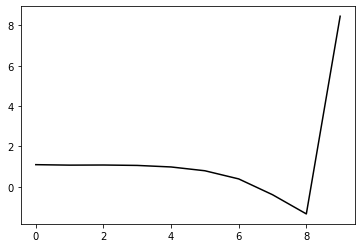

385000 0.21120284857713795
0.24060064354899813 -0.14629399083749187 -0.22513114577042248 -0.12839255980352043
[ 1.09969874  1.10754055  1.11006539  1.08731246  1.00772896  0.81784089
  0.41175474 -0.37360157 -1.32860205  8.41287631]


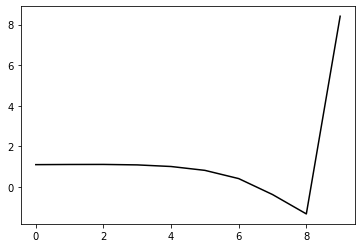

386100 0.1913525287937572
0.23941113338932596 -0.14621648217269836 -0.22494753346453955 -0.1276259914676195
[ 1.11452518  1.09160152  1.07832058  1.05677414  0.97906447  0.79115635
  0.38722857 -0.39718182 -1.35203441  8.44634512]


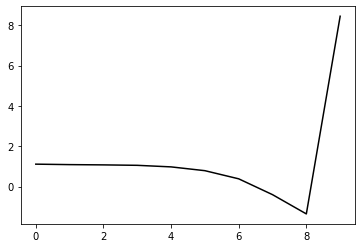

387200 0.17981374731428004
0.23583614325231428 -0.15054182404791205 -0.22717934384613067 -0.12986880578813573
[ 1.11660965  1.08397373  1.08599233  1.0769817   1.01575813  0.845177
  0.45886462 -0.30820197 -1.24449414  8.42198862]


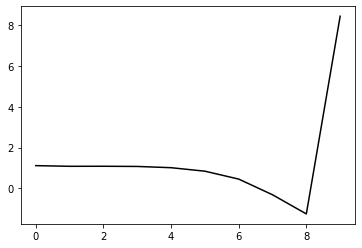

388300 0.1704327819577394
0.24428905996392236 -0.14428847874428816 -0.22454244699196751 -0.12959544257045
[ 1.09678228  1.21088413  1.22376177  1.19794208  1.12378223  0.94198728
  0.54464418 -0.23481713 -1.18572508  8.49474114]


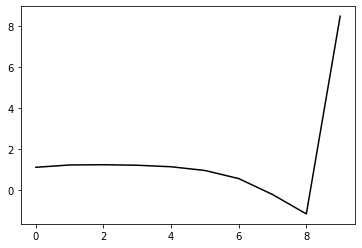

389400 0.17372753679101516
0.23369332458510217 -0.14782136473442925 -0.2245203639340502 -0.13060679708547512
[ 1.11418106  1.12260282  1.10420536  1.07662485  1.0007358   0.81949427
  0.42412472 -0.35299144 -1.30079739  8.4212645 ]


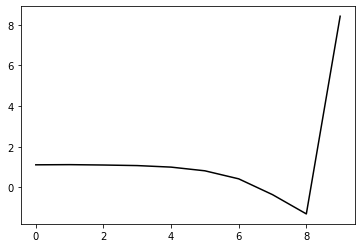

390500 0.19384725126477104
0.23804456452357853 -0.1460313095005137 -0.22426659431749071 -0.1314366992392513
[ 1.1041642   1.16008324  1.17391855  1.14803067  1.07361985  0.89518311
  0.50317495 -0.27125637 -1.21689164  8.46640535]


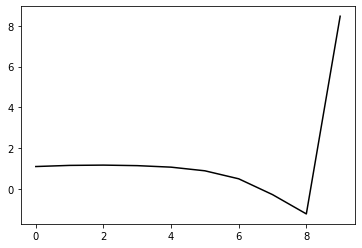

391600 0.160926259191311
0.2335157878275885 -0.15166021317707887 -0.22739169918793847 -0.13093068936619603
[ 1.11498877  1.12188617  1.10204502  1.0808361   1.01353327  0.84374199
  0.46183404 -0.302165   -1.23621682  8.44839807]


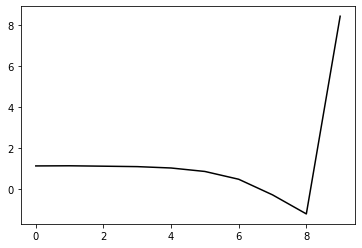

392700 0.12629904987015236
0.23410235553651731 -0.15029964107682242 -0.226435346838152 -0.13227990610564977
[ 1.1212133   1.18097727  1.14731288  1.11293014  1.03944778  0.865915
  0.48162625 -0.28470269 -1.2214148   8.45384473]


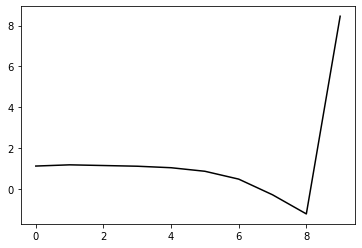

393800 0.1391277281381799
0.2412765387270842 -0.1422204073378273 -0.22184645350870025 -0.13338832232361503
[ 1.11095635  1.23367291  1.24724218  1.19989659  1.11059585  0.92505861
  0.53101205 -0.24468981 -1.19143475  8.43676589]


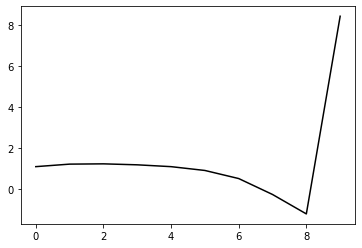

394900 0.18562810922511333
0.23355635752540618 -0.14957040799055799 -0.2253583025107309 -0.1330388343385041
[ 1.09836017  1.08478911  1.0869665   1.05380695  0.97164654  0.7941308
  0.41007614 -0.35456463 -1.28847995  8.4673438 ]


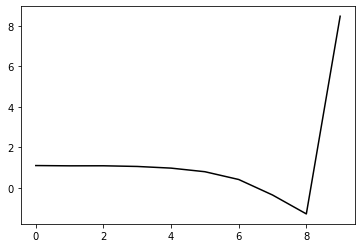

396000 0.19612526184292078
0.2391622332559096 -0.1429657461803076 -0.22185772325397182 -0.1316061468234395
[ 1.09126619  1.20181887  1.20770378  1.15940399  1.0568323   0.85826969
  0.45487675 -0.3294194  -1.28537542  8.43852549]


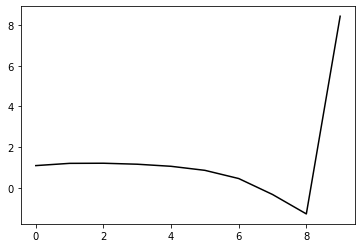

397100 0.23940095904080871
0.232028342585763 -0.15102438987987654 -0.22654645424433942 -0.12962153359096204
[ 1.15250918  0.97390562  0.99214916  0.96672855  0.87879172  0.6932511
  0.30492382 -0.46273825 -1.39984065  8.44795134]


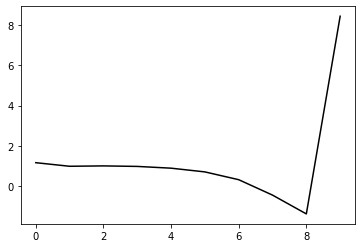

398200 0.1740376463601101
0.2376504112401619 -0.14563852326493526 -0.22353107821580803 -0.13074756403343907
[ 1.09194043  1.23389211  1.20178562  1.15620811  1.05593895  0.85639963
  0.4551287  -0.32516835 -1.27622594  8.43379861]


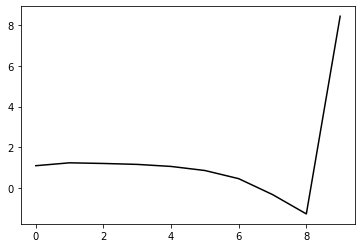

399300 0.17965161551216627
0.2316120884434289 -0.1514219458920058 -0.22639485689459946 -0.13257725491810932
[ 1.11365395  1.09286932  1.09406607  1.06371251  0.97754933  0.79147772
  0.40413717 -0.36153746 -1.29702036  8.46433181]


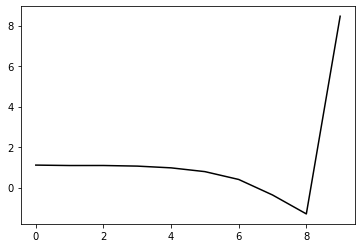

400400 0.19295866034161588
0.23109706361151613 -0.1514147711616797 -0.2263814032878732 -0.13109909915113607
[ 1.09520928  1.08104534  1.06376009  1.02968278  0.93944133  0.74895034
  0.35787332 -0.41108172 -1.35051486  8.39275058]


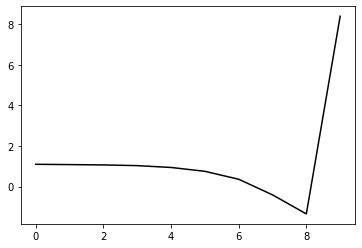

401500 0.2085659024446846
0.23369170585829638 -0.14947307338490123 -0.22536943303223003 -0.13104046100178196
[ 1.13746193  1.08493048  1.06007837  1.01127054  0.90948862  0.70816795
  0.30767242 -0.46929642 -1.41632638  8.45949328]


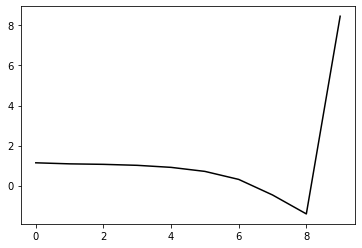

402600 0.28272711992474675
0.2442956979979958 -0.14644208568976172 -0.22558389356106168 -0.12995345655303528
[ 1.02600905  1.24782256  1.26421249  1.21299234  1.10519751  0.89719197
  0.48997552 -0.29361019 -1.24840185  8.42825604]


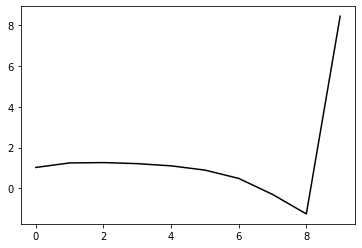

403700 0.12633153207148723
0.23836382187071672 -0.1496684531724515 -0.22641568953954466 -0.13028548901065357
[ 1.07586396  1.166834    1.16618736  1.12597725  1.02033318  0.81335992
  0.40852093 -0.37085523 -1.31994356  8.44789158]


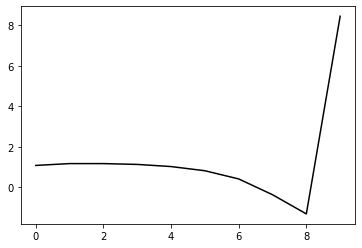

404800 0.14400921706251227
0.23975462867012134 -0.14328558036779823 -0.22238787635766083 -0.1316199000055624
[ 1.12608611  1.13028476  1.16750076  1.14042973  1.04140449  0.83654016
  0.4321789  -0.34775348 -1.29961103  8.44546761]


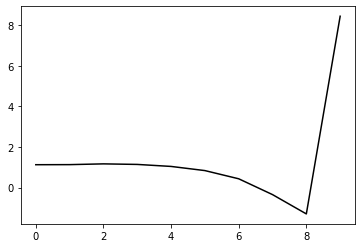

405900 0.1701886195370144
0.2335264736616055 -0.14937238122976967 -0.22536169701522507 -0.13040142449316913
[ 1.0898335   1.06077622  1.02121335  0.98566557  0.88667561  0.68078854
  0.27651932 -0.50111317 -1.44850553  8.42685656]


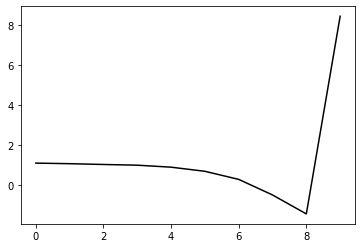

407000 0.2062973858049025
0.23587204614066337 -0.1533764184322278 -0.22909256694985103 -0.12964575925391655
[ 1.09595683  1.11852656  1.1075396   1.07005238  0.97807055  0.77896005
  0.38035219 -0.39132229 -1.33279822  8.4060144 ]


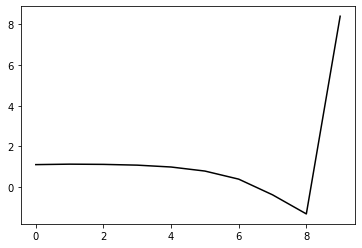

408100 0.19207598294174444
0.23841100785853458 -0.1484270784107595 -0.22589671286136512 -0.12903725628821494
[ 1.11565173  1.17788199  1.16465302  1.11513148  1.00934553  0.79622379
  0.38173081 -0.40665363 -1.36711123  8.45190413]


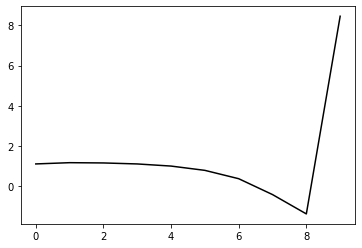

409200 0.2079765659483896
0.23572963828991308 -0.14565790453324973 -0.22310473776169076 -0.13296859708472183
[ 1.15112864  1.1617977   1.18401724  1.15039711  1.05179627  0.84538197
  0.43672763 -0.34594395 -1.30111437  8.40021065]


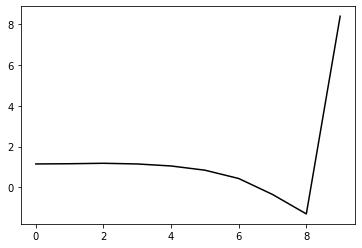

410300 0.16566909228834337
0.24497134397386985 -0.1448220120805769 -0.22461280733724287 -0.12928462454286302
[ 1.07034665  1.24738335  1.27131776  1.22976756  1.1187036   0.89824008
  0.47553827 -0.3206604  -1.29019323  8.46315844]


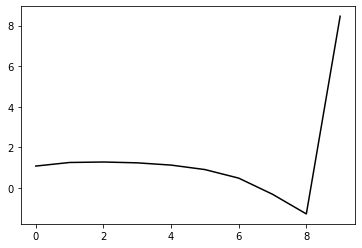

411400 0.2291681966044259
0.24220129059410359 -0.14339940252742614 -0.2227275078870255 -0.13242933294021234
[ 1.14818785  1.18867313  1.23053631  1.2082474   1.10990737  0.89862845
  0.48409455 -0.30356125 -1.26386495  8.42376895]


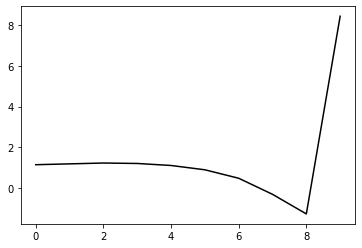

412500 0.22840259804200436
0.24263699071882514 -0.14784358469584624 -0.22624039454024733 -0.13001906300104124
[ 1.06408391  1.12490279  1.15949624  1.14151995  1.04680897  0.83655666
  0.42275096 -0.36293362 -1.31999764  8.47294175]


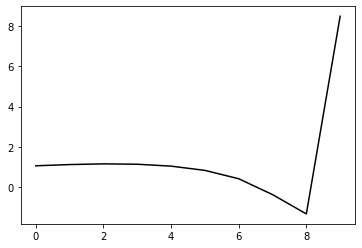

413600 0.1610198436508214
0.24077286679728913 -0.14917149777530125 -0.2267806805746145 -0.12974286325698006
[ 1.12651098  1.05269742  1.09245127  1.08601622  1.00295435  0.80066192
  0.39266562 -0.38724596 -1.33812614  8.4048398 ]


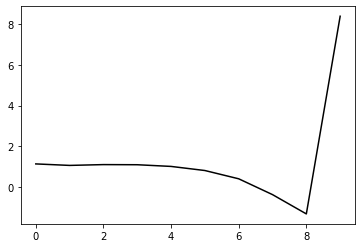

414700 0.1459371231171703
0.23988729323391372 -0.14546448184335148 -0.22357126253857046 -0.13210951105666174
[ 1.12921148  1.11262037  1.14678248  1.13824001  1.05551675  0.85169234
  0.44034718 -0.34282291 -1.29708848  8.45809459]


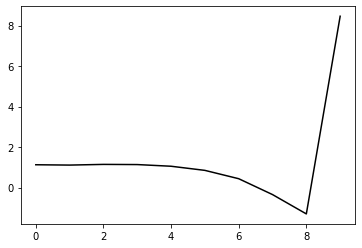

415800 0.13540201387542636
0.2399587030170434 -0.14723456871143212 -0.2248409009045506 -0.13224057210270307
[ 1.13293549  1.13170615  1.16009692  1.15907857  1.08626143  0.89074618
  0.48539207 -0.29187971 -1.23948961  8.44050627]


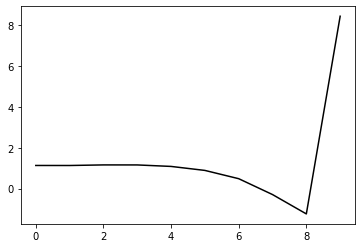

416900 0.19223344748707663
0.24153840633676338 -0.14724280615035648 -0.22535900032087255 -0.12962409635939856
[ 1.06314053  1.04252678  1.05711293  1.04134668  0.96091921  0.7594079
  0.34739171 -0.43604689 -1.38933734  8.47147175]


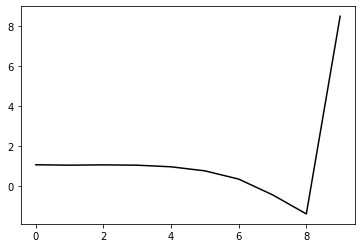

418000 0.21558248875932212
0.237727009042813 -0.14915059080444207 -0.22575078839704185 -0.13053366469978933
[ 1.09378573  1.10616268  1.06880684  1.04040143  0.95702654  0.75358919
  0.33835875 -0.44883341 -1.40615868  8.41763048]


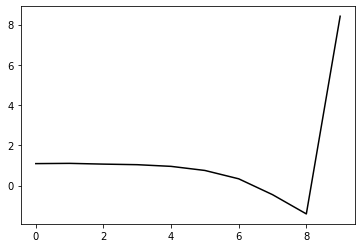

419100 0.18746578892366045
0.24508530861190908 -0.14328422456435505 -0.22312452975908786 -0.13071466759402461
[ 1.08548149  1.19501794  1.20552     1.16559932  1.07197202  0.86184693
  0.43895404 -0.35669357 -1.32343009  8.46401943]


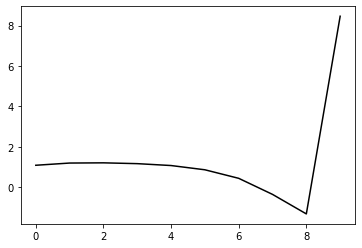

420200 0.1615081210803195
0.24058414987324206 -0.14888203719382512 -0.2267472023967209 -0.13039248683166718
[ 1.08791365  1.16126971  1.19048729  1.17978901  1.10533829  0.91444216
  0.5089766  -0.2707741  -1.22174901  8.43434836]


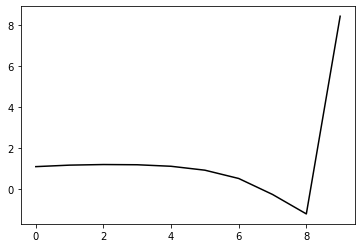

421300 0.18528164838519073
0.2447090447099173 -0.1471924478923001 -0.22631431847368105 -0.13004536833082442
[ 1.06571262  1.22880123  1.24977213  1.23030166  1.14816242  0.95030704
  0.53800613 -0.24893394 -1.20746464  8.47472178]


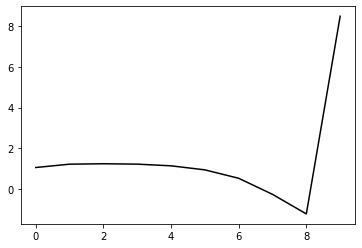

422400 0.1611717799617953
0.2429954982809213 -0.1435338522988673 -0.2233927586962549 -0.1309317002135555
[ 1.114602    1.14562585  1.19485967  1.18740096  1.10960873  0.91506559
  0.50525273 -0.28023943 -1.23766321  8.42815888]


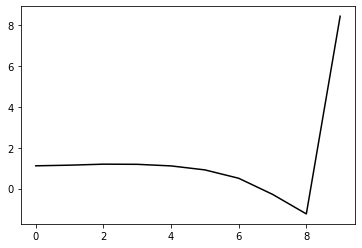

423500 0.2026117627260217
0.23984110713474383 -0.14605710406306588 -0.2247310411508985 -0.13114361130545094
[ 1.12393883  1.16145637  1.18172755  1.17850903  1.10858292  0.92028359
  0.51610637 -0.26419319 -1.21572573  8.46983287]


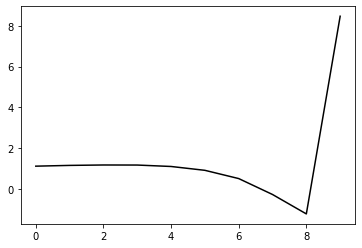

424600 0.18748094654573036
0.2425214884520404 -0.1429787428156919 -0.22364526530505582 -0.12942998602748945
[ 1.12777959  1.17922048  1.21430015  1.20970157  1.14130042  0.95335368
  0.54722637 -0.23757193 -1.19610717  8.44823815]


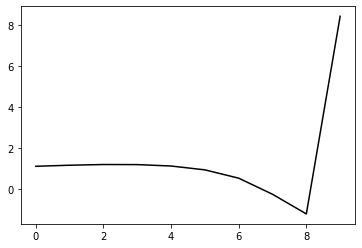

425700 0.11302853149761208
0.24078778151322064 -0.14545146052067093 -0.22526999959217484 -0.12893143100981563
[ 1.09918643  1.15566851  1.18985769  1.19065044  1.12696369  0.94398232
  0.54203227 -0.23941091 -1.19446038  8.46931568]


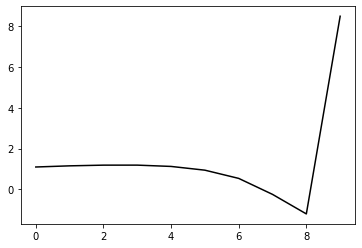

426800 0.1267295912810112
0.23992682679314561 -0.14349042880689597 -0.2238245834704395 -0.12923557228184998
[ 1.1091054   1.13756521  1.15841939  1.1575963   1.097106    0.91808664
  0.5194364  -0.25976644 -1.21306725  8.43477361]


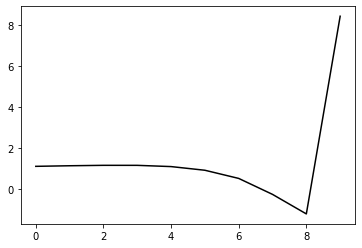

427900 0.19657103121566824
0.2333666111909614 -0.14742749282959886 -0.22534002828216218 -0.1300862480030055
[ 1.14221539  1.03714404  1.04147319  1.04640974  0.99793582  0.83235835
  0.44631595 -0.32141185 -1.26304895  8.46092519]


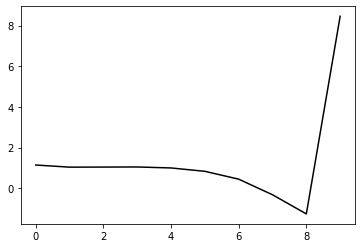

429000 0.20213105522106936
0.23628320567303904 -0.14864888219089029 -0.22733663975263355 -0.12668024693577803
[ 1.08929448  1.07718487  1.06624863  1.05600083  1.00064848  0.83132801
  0.44129671 -0.33196131 -1.28097305  8.43693828]


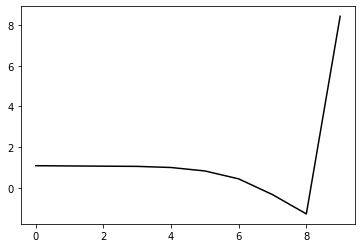

430100 0.19894647097209892
0.23653877165761455 -0.14770323697990714 -0.22686613671526093 -0.12570512743002865
[ 1.12679122  1.03488245  1.02761389  1.01457824  0.960863    0.79702423
  0.41255604 -0.35642032 -1.30189222  8.45594007]


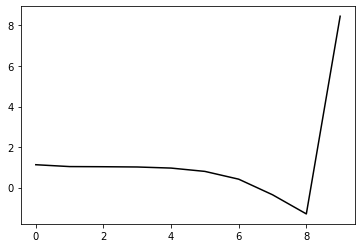

431200 0.16395097919081345
0.2424014615315093 -0.1422814283231083 -0.22411973508404914 -0.1266457040299999
[ 1.07130682  1.22256374  1.22481907  1.19355879  1.1224669   0.94601612
  0.55018985 -0.23111702 -1.19024255  8.40997306]


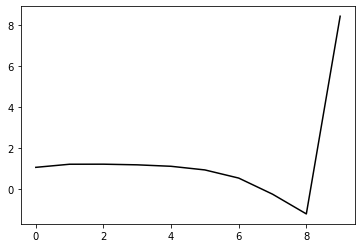

432300 0.1656375265445294
0.2408489906965964 -0.14433846519561755 -0.2252158433794577 -0.12751412808731363
[ 1.07241885  1.18525888  1.19987186  1.17709794  1.10795363  0.93639336
  0.54717543 -0.22818003 -1.18157305  8.46932311]


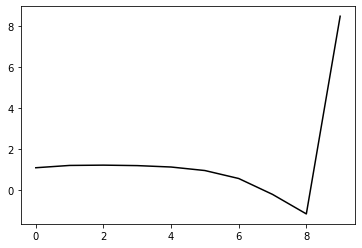

433400 0.1643280364699613
0.23764579084044396 -0.14277437014396022 -0.22367103025825982 -0.12748759486196307
[ 1.10617682  1.14205208  1.14304518  1.12281369  1.05541626  0.88590601
  0.49955618 -0.27451273 -1.22831105  8.4237595 ]


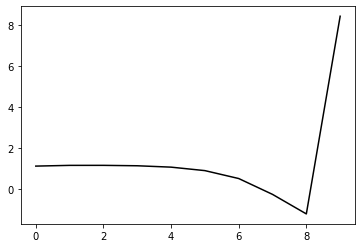

434500 0.22229515019493826
0.2318271648893907 -0.15025696193459187 -0.22814171220539464 -0.12448673149442938
[ 1.11375651  1.03886965  1.00126279  0.97950245  0.91454381  0.74904066
  0.36872767 -0.39877692 -1.34479444  8.44154368]


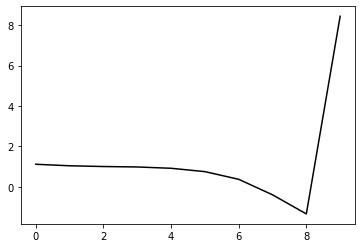

435600 0.1667732725649371
0.2339623692605035 -0.14867994114776573 -0.22744198688760878 -0.1275752233882642
[ 1.14047773  1.1751877   1.13605356  1.09972455  1.02999853  0.86188347
  0.47993929 -0.28989127 -1.23922017  8.44018462]


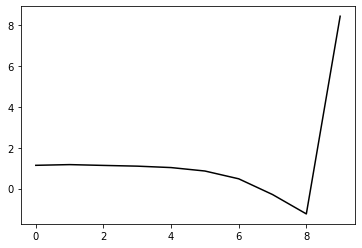

436700 0.12465055736584314
0.23508543764201634 -0.1485510213351822 -0.2273865386148562 -0.1287396012418767
[ 1.12988496  1.14822363  1.16231422  1.12848965  1.05569791  0.88867055
  0.51012689 -0.2561888  -1.20220954  8.47454827]


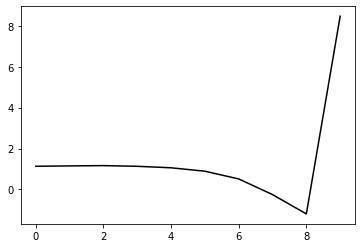

437800 0.13333910946384517
0.23687755067111313 -0.14368955258374905 -0.22401520374412565 -0.1296421162577867
[ 1.12889444  1.18123639  1.17620314  1.13489703  1.04765655  0.86802964
  0.48039612 -0.29412362 -1.24861608  8.45186966]


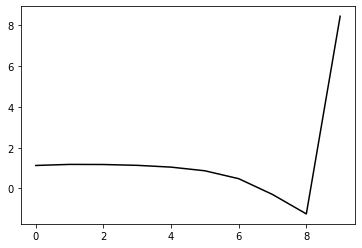

438900 0.1931198675667338
0.23981899462993173 -0.1450590509397156 -0.2257620945042492 -0.12815150834090555
[ 1.0852189   1.17386394  1.1630637   1.11426711  1.01893804  0.83244606
  0.44124192 -0.33554176 -1.29188624  8.44705585]


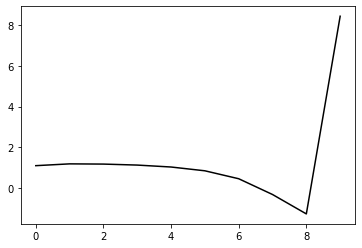

440000 0.22421130718153362
0.24079628339765977 -0.14745668887924096 -0.22772773769967242 -0.12664740054446713
[ 1.06525599  1.1311075   1.14107375  1.1031545   1.00932502  0.82359082
  0.43618866 -0.33539388 -1.28594284  8.41933749]


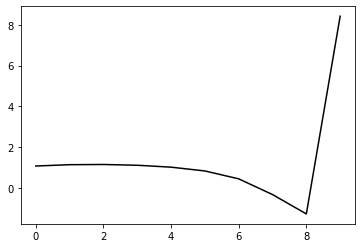

441100 0.2167618140842774
0.23677197780869258 -0.14941272072061296 -0.22810183475105478 -0.12591752310215842
[ 1.11845787  1.06257546  1.02934878  0.98250631  0.88649235  0.69831373
  0.31216868 -0.45543907 -1.39999153  8.43406091]


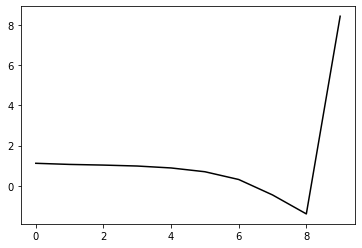

442200 0.17380554831675665
0.24030873197867167 -0.14722998555906433 -0.22714808882945076 -0.12723623419457866
[ 1.08189823  1.19663664  1.18177186  1.13267162  1.03273859  0.8396135
  0.44967291 -0.32098651 -1.26938531  8.41151615]


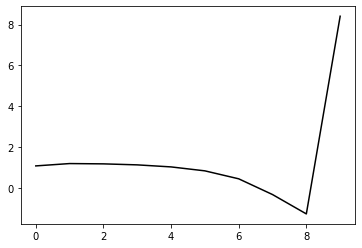

443300 0.16944108871377325
0.23181178273404215 -0.15403895550289082 -0.23004826083734842 -0.1277313954646038
[ 1.11969586  1.04182505  1.03523921  0.9966772   0.9022858   0.71412933
  0.33054523 -0.43208714 -1.3708841   8.40960622]


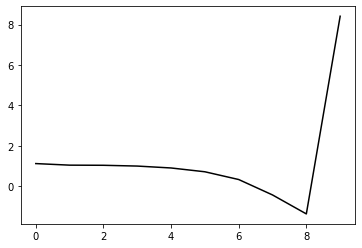

444400 0.22271476930508563
0.23802196476361734 -0.15348776404625913 -0.23085057391050479 -0.12706662077207517
[ 1.09573933  1.09388392  1.08106428  1.03397444  0.93245465  0.73712187
  0.34809191 -0.41836374 -1.3606306   8.41609208]


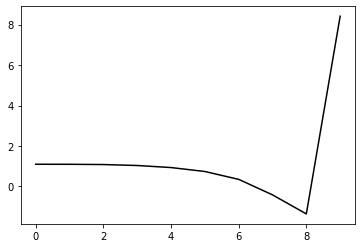

445500 0.19035252042490858
0.24367784171391313 -0.1441348436410515 -0.22466918168231864 -0.13003905888746808
[ 1.09154129  1.24364406  1.26164761  1.20619804  1.09173048  0.88220086
  0.47997533 -0.2985321  -1.25366326  8.45853224]


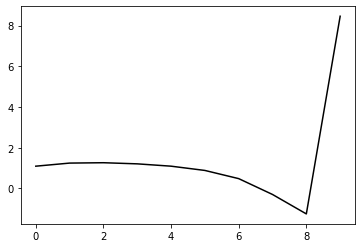

446600 0.16410737752368962
0.23910874343101848 -0.15076334582097803 -0.2287835222625983 -0.13039540332289498
[ 1.09459107  1.16071238  1.18361894  1.15845294  1.06090883  0.86361744
  0.4736371  -0.29133634 -1.2319664   8.44378567]


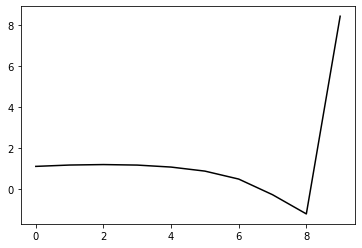

447700 0.14126886117187573
0.23377189278353652 -0.1482434873956881 -0.2255091627369091 -0.13113719727027962
[ 1.14455108  1.10462052  1.07302308  1.03880874  0.93896677  0.73642508
  0.34196273 -0.42542016 -1.36759908  8.43440786]


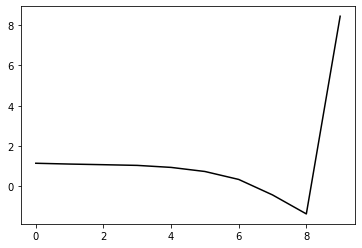

448800 0.12735782994109998
0.2389449589518889 -0.1470900421346487 -0.22583589002749302 -0.13113236723009494
[ 1.11162242  1.20187391  1.20269456  1.15894537  1.05513457  0.84761269
  0.44750585 -0.32464467 -1.27204502  8.41781524]


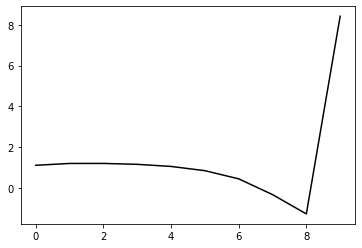

449900 0.18313889948863477
0.2370069311481668 -0.14889206093028257 -0.22682263715728498 -0.13105592817126985
[ 1.12263536  1.05187399  1.0790612   1.05289983  0.95837284  0.75850735
  0.36526465 -0.39872209 -1.33701957  8.4643796 ]


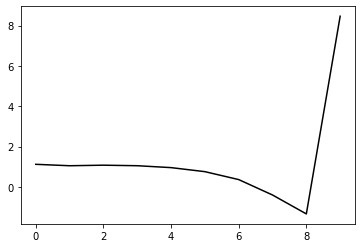

451000 0.21830985472134742
0.24020683515292024 -0.15210752397501637 -0.23023902737375154 -0.1286393176825621
[ 1.08915359  1.10250773  1.12674493  1.10805462  1.02141935  0.82617541
  0.43597233 -0.3244198  -1.2594243   8.42245843]


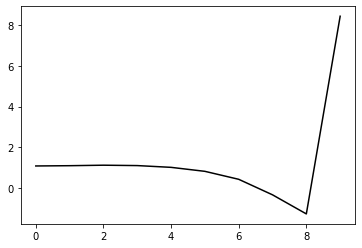

452100 0.19542608521106344
0.24229301409759121 -0.1460838327683985 -0.22597329410421751 -0.12921426608085768
[ 1.1286449   1.17261676  1.18295443  1.15025752  1.05194583  0.84451857
  0.44174353 -0.32994748 -1.27661833  8.45603421]


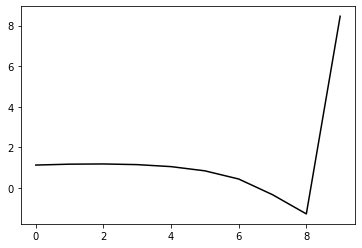

453200 0.19368000701855298
0.23999159764271427 -0.1442393678135132 -0.22381701987591246 -0.13254034234477577
[ 1.14085653  1.18936192  1.21234837  1.19200063  1.10223216  0.90092767
  0.50231875 -0.264621   -1.20613619  8.42801414]


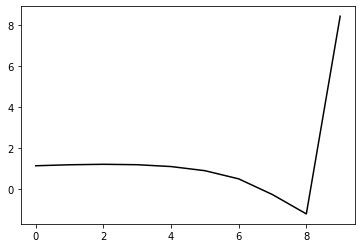

454300 0.23011828374993293
0.24227563017150966 -0.1523962952517424 -0.23072264061335943 -0.12799543677981015
[ 1.05951356  1.14879753  1.15460697  1.13866518  1.05842412  0.86554478
  0.47403831 -0.28492517 -1.21740965  8.47689429]


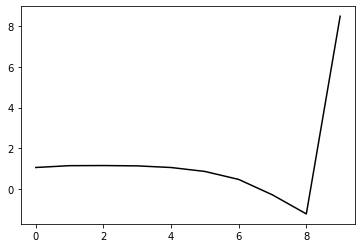

455400 0.21440272480987688
0.24568505137207203 -0.13990827585724283 -0.22203029853763406 -0.1303574738818296
[ 1.13561652  1.22964046  1.25125201  1.21396612  1.11451865  0.90333254
  0.4921142  -0.28685572 -1.24138872  8.41786177]


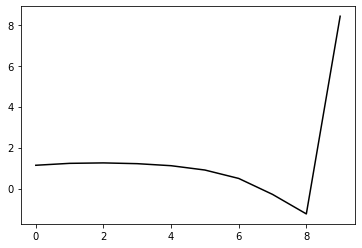

456500 0.23647872777408901
0.23659119488380878 -0.1470341549516026 -0.22492635576853923 -0.1321426265371137
[ 1.14617808  1.09301776  1.09655356  1.0754325   0.98983879  0.79269815
  0.39530739 -0.36814697 -1.30382083  8.45599925]


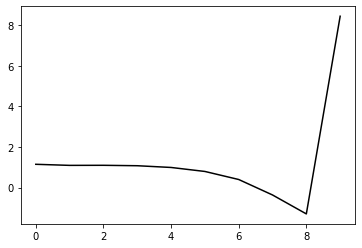

457600 0.1668005827153815
0.24078329353975803 -0.14944447087829252 -0.2278002057143745 -0.13151106238502341
[ 1.07840392  1.1019242   1.13175546  1.11497393  1.03729333  0.84759473
  0.45618454 -0.30098339 -1.22917633  8.45953363]


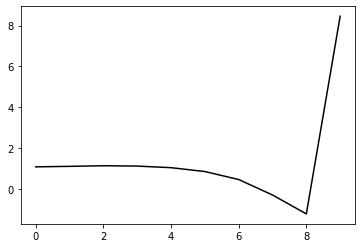

458700 0.1209766233688227
0.24093834842277326 -0.15025794963989392 -0.22848094058149285 -0.1301518985473538
[ 1.09751596  1.19191458  1.19124986  1.16417174  1.07924739  0.88266416
  0.48292981 -0.28331212 -1.22193024  8.39678659]


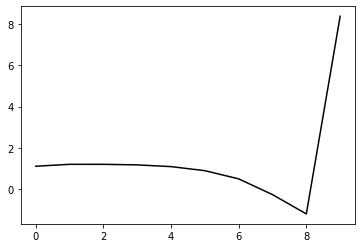

459800 0.1297967286588561
0.243033098815626 -0.14574261170956088 -0.22577503434469426 -0.13152756601004212
[ 1.1241341   1.22910031  1.27847116  1.26350594  1.18284786  0.98962481
  0.59079429 -0.176442   -1.11802626  8.45398994]


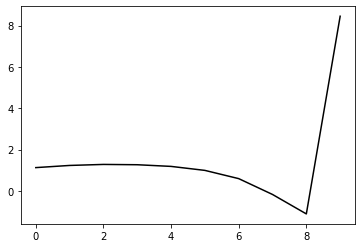

460900 0.18395539558917606
0.238471330238418 -0.14758773471723588 -0.22622067737198168 -0.1298894428443984
[ 1.11683274  1.10503688  1.11752564  1.10081176  1.01641911  0.8190865
  0.41626232 -0.35441902 -1.29864356  8.46210745]


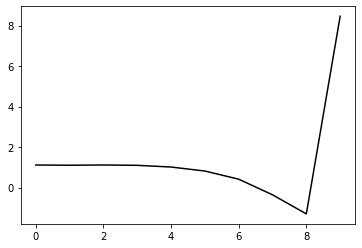

462000 0.19573223285600175
0.24268057411057464 -0.14325109297481828 -0.22413956840895308 -0.12815646277418044
[ 1.10726354  1.18464172  1.19179262  1.16372704  1.07008044  0.86231514
  0.44763054 -0.33641295 -1.29650975  8.42269676]


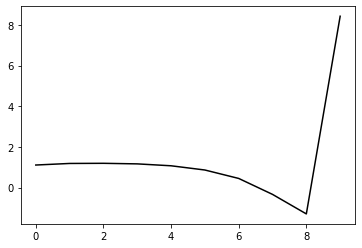

463100 0.20668748169181841
0.23736453412635508 -0.14678930028425138 -0.22577060003307706 -0.12774446450313343
[ 1.13649116  1.05531209  1.0835045   1.07068027  0.98894572  0.79215175
  0.38771129 -0.38572637 -1.33336378  8.43543708]


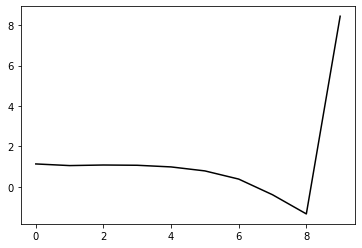

464200 0.1826443920858376
0.23691498253288598 -0.15108412897628398 -0.22910769241374057 -0.12647222309365455
[ 1.10917272  1.05890386  1.06965308  1.06556692  0.99484367  0.80807966
  0.41299285 -0.35086548 -1.2874051   8.43264556]


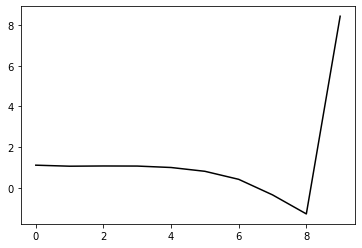

465300 0.1612447162868534
0.24647012758236586 -0.14175862062290953 -0.2242302391223711 -0.12580046237300913
[ 1.08467539  1.23496238  1.22346007  1.19438459  1.10814606  0.90533458
  0.49190781 -0.29287519 -1.25432595  8.49908329]


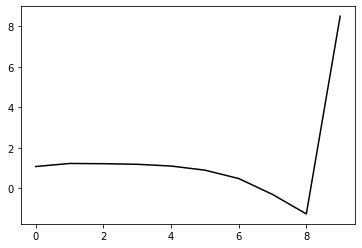

466400 0.22187623626715205
0.23125116323952977 -0.14781156260661196 -0.22557689707058404 -0.12701403427905486
[ 1.12958346  1.02963558  0.98568318  0.95073274  0.86433657  0.6648697
  0.25545571 -0.5242317  -1.47806269  8.38353165]


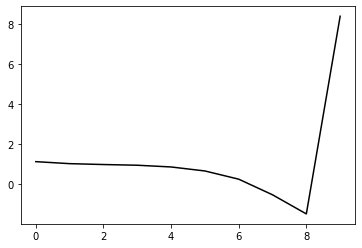

467500 0.20700760140900035
0.24100678571299736 -0.14494519315146986 -0.2255530791496461 -0.1285019634067928
[ 1.09266534  1.15070389  1.15003313  1.1097705   1.02277002  0.82485061
  0.41585005 -0.36464807 -1.31995323  8.47575605]


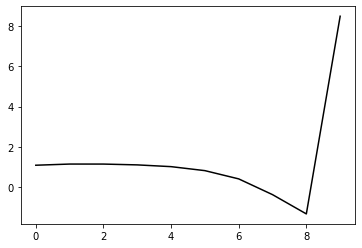

468600 0.17955173184260875
0.23843733159321842 -0.14932217708846712 -0.22850527283422473 -0.1266751981752294
[ 1.10052868  1.13778119  1.12863511  1.09191777  1.00344452  0.80650333
  0.39868842 -0.38103537 -1.3352834   8.42579841]


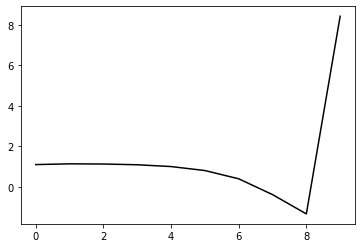

469700 0.13436671509499878
0.2380538673200973 -0.14914219097534398 -0.228241926747331 -0.1274607609166002
[ 1.15404874  1.14253687  1.13876484  1.10208375  1.0107605   0.8126185
  0.40442808 -0.37581453 -1.32998647  8.44337851]


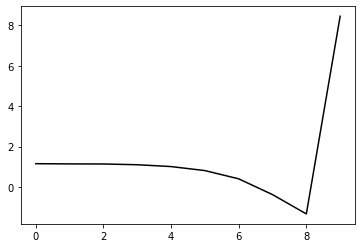

470800 0.1464321265759647
0.23895846423243097 -0.14672371315573088 -0.22643603394929848 -0.12921407857243344
[ 1.16486352  1.17662546  1.1989384   1.16995917  1.08194666  0.88698902
  0.48228727 -0.29487255 -1.24553663  8.42444507]


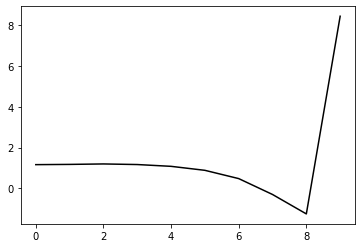

471900 0.18940778527859092
0.2415491064402086 -0.14628210539211037 -0.2266937974019464 -0.12803043584505522
[ 1.13452579  1.17462748  1.18959466  1.15753005  1.06513904  0.8656035
  0.45730107 -0.32345632 -1.27760814  8.44824609]


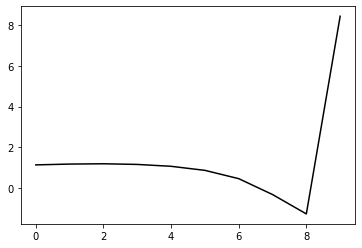

473000 0.24021019499067725
0.23884066099806922 -0.14835903260357197 -0.22807541061106368 -0.12570912434229542
[ 1.17060191  1.03439119  1.07484953  1.0535283   0.96311304  0.76400871
  0.35652074 -0.42347754 -1.37638294  8.43385062]


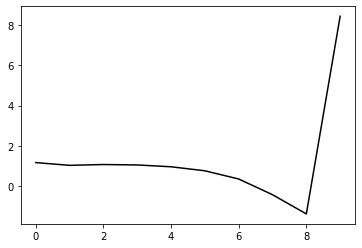

474100 0.24379255443868966
0.24012469392019348 -0.14511304674010334 -0.22559593660714652 -0.12754377876959141
[ 1.16689469  1.1301419   1.15382692  1.13634315  1.04846951  0.84939209
  0.44170541 -0.33899566 -1.29316493  8.47433325]


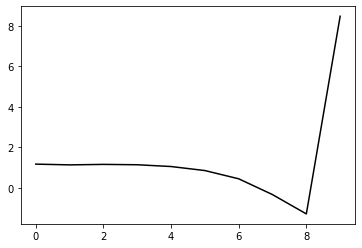

475200 0.2825717472655123
0.23358216697768883 -0.14194902524014075 -0.2213850203660514 -0.13019658794093372
[ 1.19389289  1.04732681  1.04627603  1.02075411  0.9300052   0.72808168
  0.31906706 -0.46137691 -1.4132067   8.38768074]


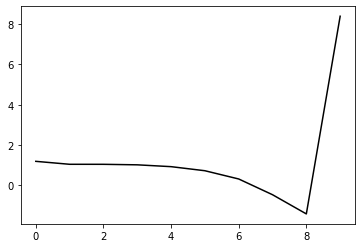

476300 0.17230588090394688
0.24362710660341877 -0.14276614107144106 -0.22439319243335393 -0.128234603586212
[ 1.10947635  1.18043016  1.1887218   1.15363422  1.05642255  0.84712833
  0.43008204 -0.35882954 -1.31981915  8.45663433]


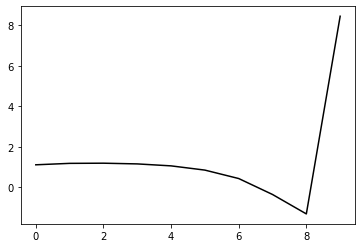

477400 0.28058068919685014
0.24300990346293228 -0.14155330044044065 -0.22317278178658212 -0.13056411084995756
[ 1.17069525  1.20520683  1.23853757  1.21514867  1.12554673  0.92271421
  0.51117841 -0.27270746 -1.22854094  8.43511302]


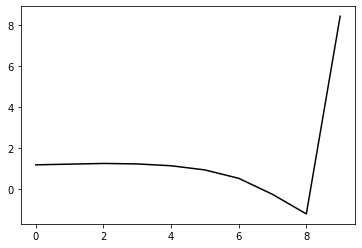

478500 0.2150186355146166
0.2385455936354241 -0.14545068399388028 -0.22476569065790497 -0.1304221978362882
[ 1.14012241  1.14580741  1.14278023  1.11310148  1.01996761  0.81455828
  0.40192285 -0.38112469 -1.33341029  8.43972008]


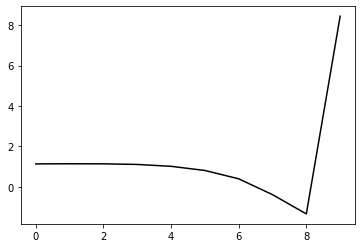

479600 0.16059953687607156
0.2434253756617328 -0.14403834098593943 -0.22525267610633612 -0.12814215021908615
[ 1.12150917  1.20031701  1.23330602  1.2059282   1.11145177  0.90337606
  0.48656954 -0.30203392 -1.26152875  8.44478585]


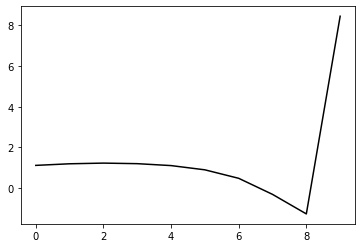

480700 0.12674650326301137
0.23948572004778768 -0.14965212978702247 -0.2286854490470638 -0.127581669040386
[ 1.12517931  1.12127864  1.15222699  1.14171442  1.05972464  0.86269208
  0.45656775 -0.3210907  -1.26830225  8.43711132]


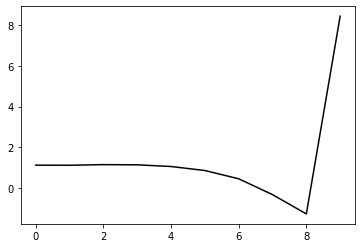

481800 0.13714206058584882
0.23799855052053143 -0.14684761257102918 -0.22630652653403904 -0.12994288434489285
[ 1.14834313  1.13956004  1.16225387  1.15645168  1.08279641  0.89213371
  0.49071941 -0.28365383 -1.22899936  8.44272659]


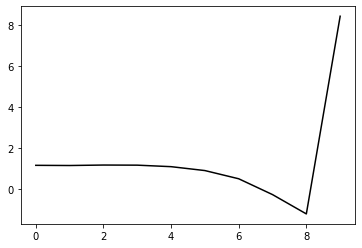

482900 0.1862040511857543
0.24007577579182976 -0.15111648960625113 -0.23038389090330597 -0.12792107027158597
[ 1.10951815  1.10565998  1.13749098  1.13890137  1.07563378  0.89445642
  0.50076408 -0.26704781 -1.20637483  8.46811282]


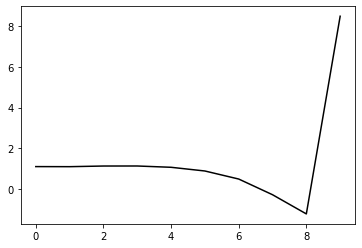

484000 0.23731621723848734
0.24263620254433613 -0.14940359031889927 -0.2297914727354506 -0.12609597083296475
[ 1.08042438  1.13426203  1.15528356  1.1471299   1.07806899  0.89227016
  0.49318354 -0.28083019 -1.22745471  8.44078287]


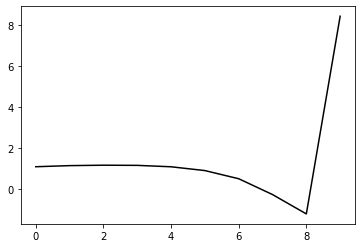

485100 0.19188445791036307
0.24035917904253584 -0.14649545816534873 -0.22695891291587544 -0.12695708503921507
[ 1.12219432  1.17537341  1.14219433  1.10788008  1.02588128  0.83022754
  0.42157592 -0.36199243 -1.31822036  8.44341608]


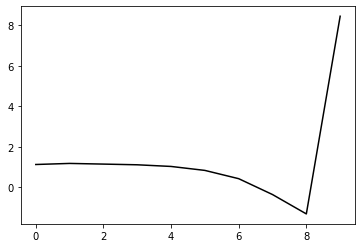

486200 0.16048433532723339
0.23998781670677863 -0.14760321818901814 -0.2276620461905827 -0.13006804191722712
[ 1.13035328  1.2319965   1.24508238  1.22978401  1.16043375  0.97855641
  0.5817556  -0.1918433  -1.13882253  8.41214113]


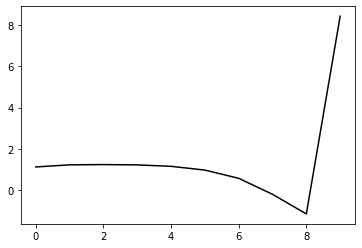

487300 0.17389166785764784
0.2414421467065105 -0.14641603305215728 -0.22732450182441788 -0.1291709361554393
[ 1.11153359  1.18783353  1.20215185  1.18583551  1.11431757  0.93191872
  0.53447499 -0.24117807 -1.19171297  8.48605568]


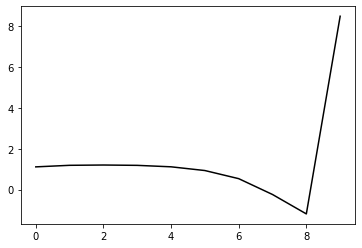

488400 0.21045720930076023
0.23874021447537147 -0.1481557281938341 -0.22849151637147286 -0.12567988090203283
[ 1.14433532  1.03044268  1.01883746  0.99390301  0.91436729  0.72651429
  0.32536253 -0.45374272 -1.40739332  8.40973398]


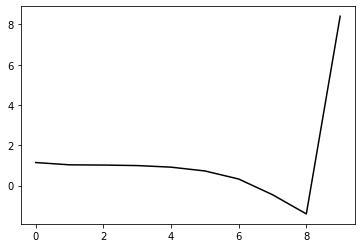

489500 0.2561439797182415
0.24365131653219904 -0.1460817725504944 -0.22818499345435597 -0.12615778575514836
[ 1.06543973  1.17492331  1.17999369  1.14350694  1.05845493  0.86607356
  0.46039147 -0.32423    -1.28422786  8.46763499]


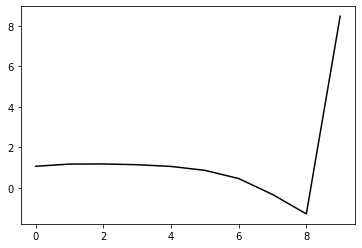

490600 0.15938840813506422
0.2402794740520436 -0.14818173596815518 -0.22912932971566877 -0.12603322082277008
[ 1.13421118  1.08996421  1.11113765  1.08953242  1.01325794  0.82996275
  0.43293788 -0.3444455  -1.29797551  8.40646907]


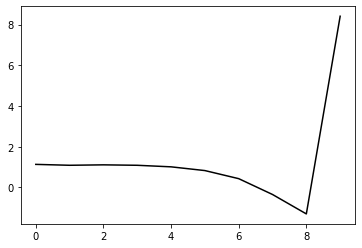

491700 0.16627319682048947
0.24451476137152667 -0.14524024132390756 -0.2277914485775789 -0.1268080810188757
[ 1.06429385  1.17277924  1.19579059  1.17142242  1.08828089  0.89869025
  0.49673882 -0.28554925 -1.24431957  8.46290892]


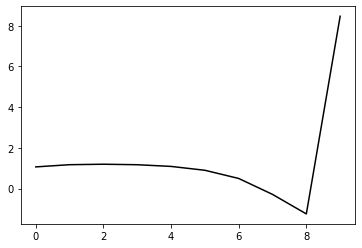

492800 0.15240158934410306
0.23974920059083712 -0.14235445725602291 -0.22453362688638698 -0.12819185875037464
[ 1.15832398  1.09627603  1.10703349  1.09315255  1.01963353  0.83776675
  0.4432968  -0.33251117 -1.28532263  8.42727876]


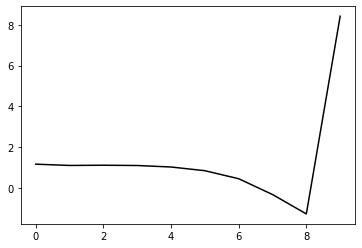

493900 0.17195468841628583
0.23755581045708465 -0.1452946956542379 -0.22638683524286765 -0.12680466550610514
[ 1.11882033  1.11147562  1.05298146  1.01520733  0.93333112  0.74451047
  0.34393033 -0.43800438 -1.39739003  8.43712446]


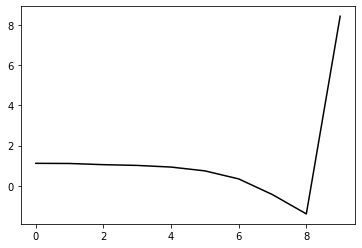

495000 0.24771415334534266
0.24297469848064332 -0.14752539751181487 -0.2295306036326404 -0.1239534682085944
[ 1.06983405  1.13808468  1.12729015  1.08317806  0.99719388  0.80780876
  0.407244   -0.37501785 -1.33525177  8.42210446]


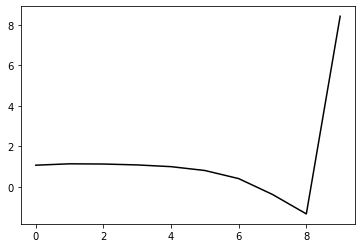

496100 0.1994524664251647
0.2414521262213549 -0.14458978620100657 -0.22688895792992664 -0.1275810074614755
[ 1.14067868  1.14333182  1.14391772  1.1034466   1.01748844  0.82962769
  0.43072774 -0.35072459 -1.31102022  8.44336653]


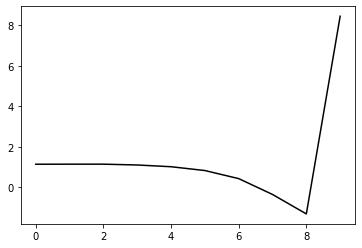

497200 0.1622566160177339
0.2422408706791971 -0.14339708219256914 -0.22608586128509361 -0.12826944807886997
[ 1.10203813  1.22404328  1.22551781  1.18764015  1.0979261   0.90744527
  0.50736759 -0.27518385 -1.23686813  8.43495732]


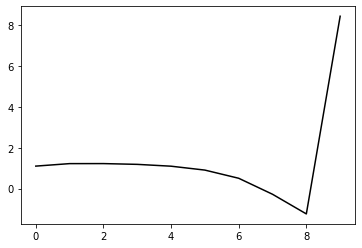

498300 0.1681355029259163
0.24609498828024218 -0.14015109537063056 -0.22499195809721206 -0.12608979927863578
[ 1.06915236  1.22175373  1.22605532  1.18298617  1.08217539  0.88001197
  0.46956782 -0.3237256  -1.29779947  8.46436525]


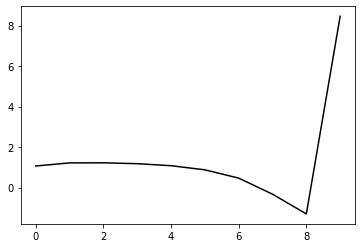

499400 0.15390087793890628
0.2448360344409387 -0.14063168021528094 -0.22498902290661074 -0.12789916183229938
[ 1.12038045  1.22013244  1.23499695  1.20419505  1.1133579   0.91912314
  0.51718912 -0.26748358 -1.23248941  8.419109  ]


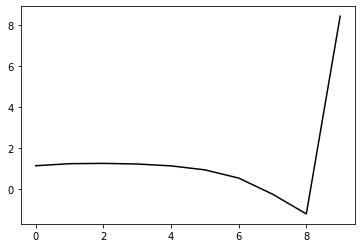

In [23]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

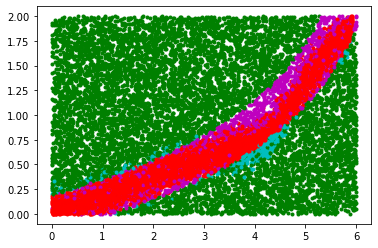

In [24]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 0.5001261741840237
0.25217248102039314 -0.15613117613054328 -0.23576584825862046 -0.12885928000749056
[ 1.03593852  1.08052943  1.08245666  1.03565001  0.93588117  0.73654526
  0.34010584 -0.42959951 -1.37390558  8.44634696]


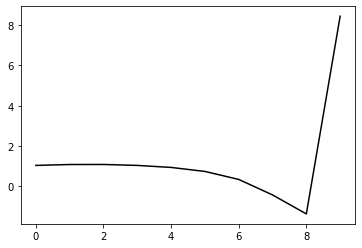

1100 0.21767539056108803
0.24501077641375077 -0.14675416697763105 -0.22627994003908689 -0.13440611763602392
[ 1.07320901  0.96332323  0.92174118  0.8618561   0.75038306  0.54116585
  0.13669923 -0.6392577  -1.58860646  8.39423111]


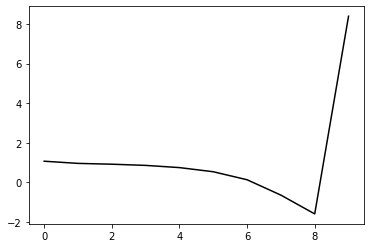

2200 0.1639857560780256
0.2566601711346916 -0.1401725909416083 -0.22391266400097348 -0.13885140732254928
[ 1.0431132   1.18414448  1.16586401  1.09760368  0.97637602  0.75681121
  0.34193142 -0.44421349 -1.40471176  8.42379354]


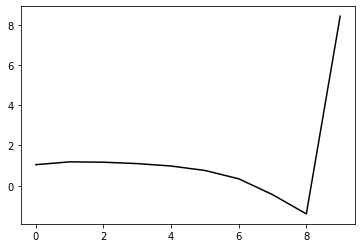

3300 0.18000433309514435
0.24762610831061216 -0.15395748426524164 -0.2313413981721547 -0.13833551001135969
[ 1.03963527  1.0447365   1.01709449  0.96715953  0.85897037  0.65256327
  0.25237477 -0.51666973 -1.45679173  8.44957182]


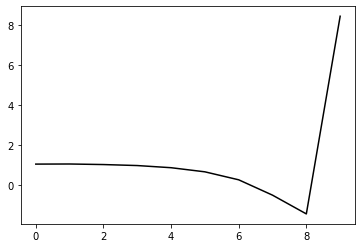

4400 0.17863933521655692
0.24870712008249934 -0.14510053594819 -0.2251548644589288 -0.1408319236892624
[ 1.0916063   1.06843948  1.04781609  0.98901689  0.87569192  0.66269089
  0.25515218 -0.52177518 -1.47167594  8.36760177]


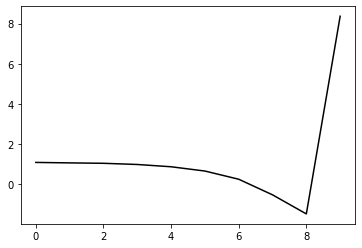

5500 0.23951668653605115
0.2472190866250774 -0.14850399798683958 -0.22701715243496529 -0.14322432708108357
[ 1.11872744  1.10446683  1.08220206  1.03216299  0.92673586  0.72117957
  0.3211372  -0.44745032 -1.38811595  8.43864805]


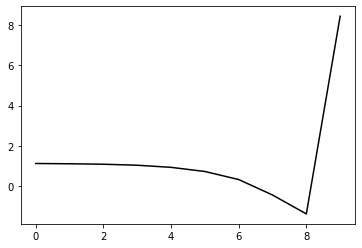

6600 0.17056319567703349
0.24654297205266706 -0.14876451237909832 -0.22623600028675525 -0.14255865355516206
[ 1.04499025  1.06045227  1.00527257  0.92819836  0.80245882  0.57997056
  0.16592996 -0.61370399 -1.56341425  8.40835836]


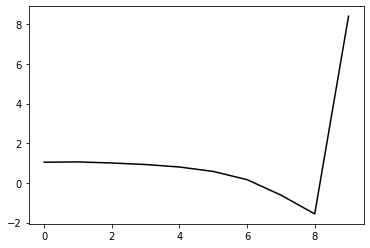

7700 0.11773129628164206
0.2500090993041778 -0.14695178158657105 -0.22546036975316702 -0.14468050920394737
[ 1.05558107  1.08228141  1.08147212  1.01427882  0.89038243  0.66958583
  0.25724118 -0.52014562 -1.46734859  8.45343188]


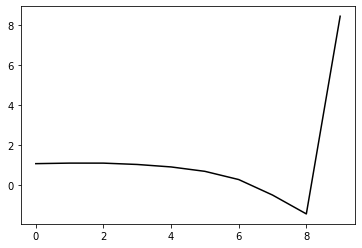

8800 0.13147215027734085
0.2505905637200191 -0.1473361441263002 -0.22574288498007042 -0.14427924947817977
[ 1.05568614  1.07835824  1.08253966  1.02870301  0.90562195  0.68297983
  0.26957324 -0.5073186  -1.45300827  8.40347793]


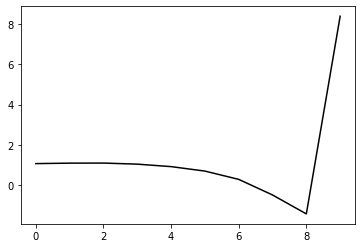

9900 0.19640568967418862
0.2531803161501943 -0.14695535493252446 -0.22584709975624795 -0.1431827224563907
[ 1.03016794  1.07310187  1.07032469  1.0202259   0.89646443  0.66860035
  0.24998524 -0.53078389 -1.47994487  8.42304551]


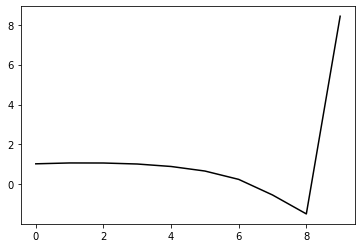

11000 0.24192338516955744
0.24232123490048946 -0.15205210593048538 -0.2270418215492452 -0.1448796704175846
[ 1.08794999  0.88861427  0.88233819  0.84594679  0.73753715  0.52180572
  0.11479391 -0.65282489 -1.58661429  8.38814456]


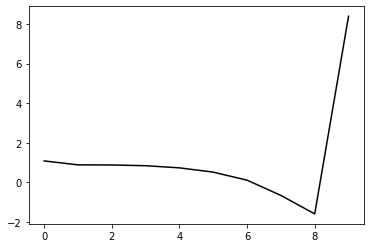

12100 0.18967291897773428
0.25199415167104366 -0.14776385514660567 -0.22613804683708377 -0.143587228665303
[ 1.05925452  1.07317538  1.05013663  1.0043112   0.89441677  0.67443961
  0.26084353 -0.51407443 -1.45693748  8.41704596]


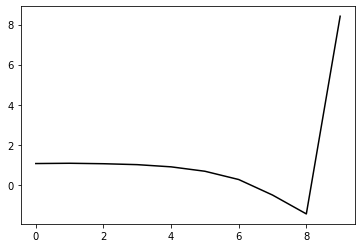

13200 0.17452517544899215
0.25210333636966675 -0.14580062725475476 -0.2248198096896457 -0.14533959788757186
[ 1.06336739  1.15036742  1.14077171  1.10183543  0.99974248  0.78585845
  0.37536835 -0.39767617 -1.34013312  8.42697498]


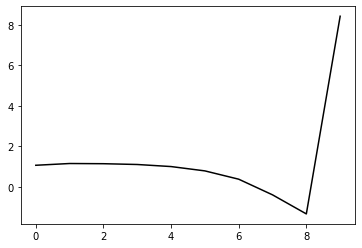

14300 0.16894779588157907
0.2549189328225154 -0.1465079425779676 -0.22617536832403282 -0.14428251385832438
[ 1.02836279  1.12889811  1.13119787  1.09468565  0.99575949  0.78504985
  0.37599388 -0.39582658 -1.33733046  8.47892475]


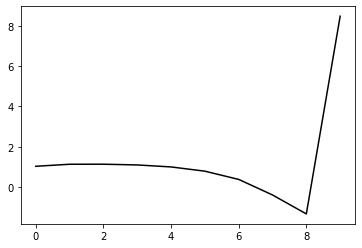

15400 0.1516507397478266
0.25488347902505204 -0.14442847252987304 -0.2248561067991058 -0.1440063595055392
[ 1.05554508  1.10557062  1.10604724  1.0739213   0.98065309  0.77516156
  0.36918632 -0.40044388 -1.34056935  8.41740535]


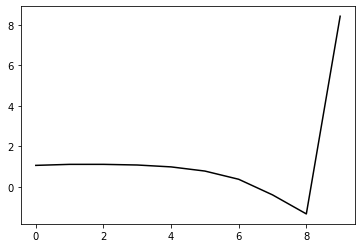

16500 0.20434080563948068
0.24779820936675054 -0.151785288820832 -0.22850755632191855 -0.14208248310624913
[ 1.05627923  1.03848377  1.00638416  0.96590613  0.86860822  0.66101914
  0.25378202 -0.51522035 -1.45205368  8.43747281]


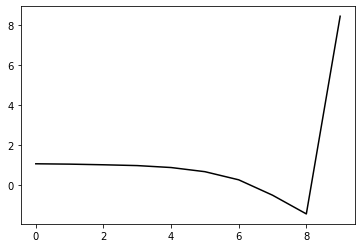

17600 0.18833663536597472
0.25323764222258016 -0.14606419693342051 -0.22500945708734338 -0.14525479019850546
[ 1.07698018  1.10203959  1.10051347  1.05248543  0.95011872  0.73935899
  0.32861129 -0.44377581 -1.38388308  8.41488539]


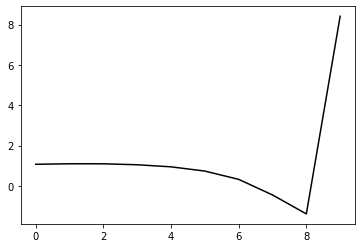

18700 0.11660629410919408
0.2519958193980769 -0.14634673693518374 -0.22491765457514984 -0.14452763903247837
[ 1.05740501  1.09945036  1.07069564  1.01647436  0.90763691  0.69256331
  0.27790783 -0.49781432 -1.44053987  8.4222172 ]


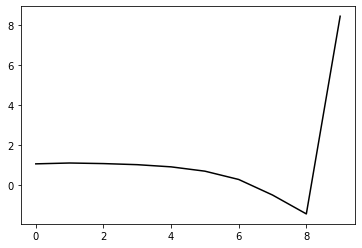

19800 0.15133371218053995
0.24953824195829846 -0.15269266492218272 -0.22967170985867685 -0.1434278300039229
[ 1.06096617  1.07146661  1.0473308   1.00901511  0.91833423  0.72121431
  0.32272776 -0.43815556 -1.36613868  8.40915328]


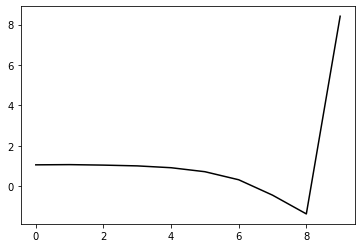

20900 0.19281087751156542
0.24887589658853707 -0.1516039773693655 -0.2287460345086061 -0.14466422193909262
[ 1.06056878  1.06480781  1.05042084  1.01059423  0.92071904  0.72596412
  0.32894291 -0.43186929 -1.36120095  8.44004546]


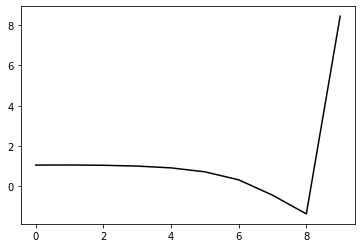

22000 0.22595348383478853
0.2525454168746299 -0.15054829167272998 -0.22885717152043406 -0.1431019836597476
[ 1.02495014  1.11464402  1.08659776  1.02886319  0.92436037  0.71782289
  0.31001931 -0.46145866 -1.40185014  8.42624632]


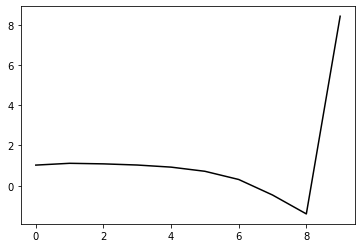

23100 0.18547932834396458
0.25518304301113615 -0.14376800809982657 -0.2241732705907794 -0.14223491650396763
[ 1.0468939   1.11029063  1.08121478  1.00651547  0.88276018  0.66092764
  0.24029611 -0.54284428 -1.49414985  8.43724233]


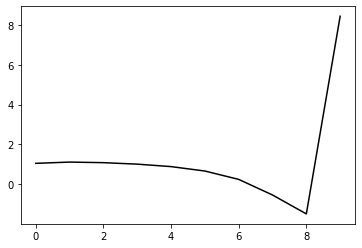

24200 0.1701950118177113
0.2555089082030696 -0.14369846804804812 -0.2240087726556696 -0.14356380554074372
[ 1.04745279  1.14185284  1.14295065  1.08743464  0.9676809   0.74779216
  0.32963337 -0.45107608 -1.3994796   8.4091723 ]


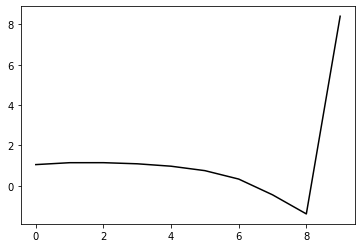

25300 0.16592386056573086
0.2568894437646396 -0.1440839089185041 -0.22449501264747473 -0.14345584413876997
[ 1.02535167  1.12304252  1.12117551  1.07164235  0.95427265  0.73371559
  0.31584356 -0.46395546 -1.41063147  8.4478567 ]


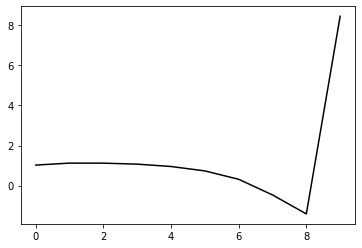

26400 0.20095419651705052
0.24624042839830257 -0.15055258289721404 -0.22642881168181436 -0.14297443550631656
[ 1.04780243  0.95430922  0.9190576   0.86931983  0.75291518  0.53276558
  0.11739639 -0.65719796 -1.59487506  8.39011989]


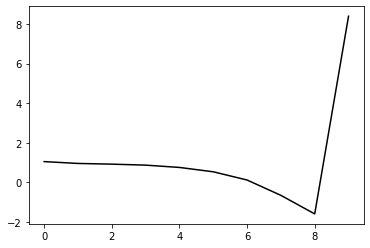

27500 0.19821961338420163
0.25696571008715025 -0.14502207050150245 -0.2243373723452042 -0.14639330583229543
[ 1.02355859  1.12312223  1.10335726  1.05097902  0.93755554  0.71895043
  0.30469143 -0.46866126 -1.40471103  8.46939353]


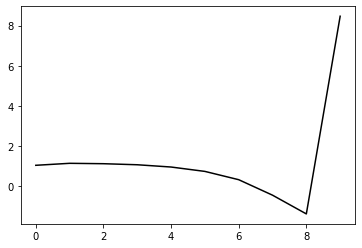

28600 0.1585666868032242
0.2565597165800167 -0.14550019505193523 -0.2246195513709529 -0.14621121457512976
[ 1.01077236  1.07488891  1.0587982   1.00735327  0.89453841  0.67587137
  0.26119648 -0.51223427 -1.4477524   8.42050267]


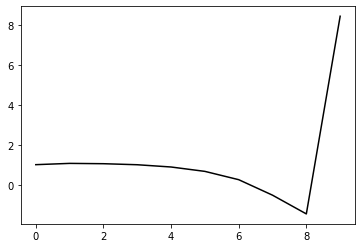

29700 0.1141388060722872
0.25512787106757123 -0.14791620354651472 -0.22590826368767694 -0.14728870883861978
[ 1.0476816   1.09919874  1.077963    1.03437931  0.9325462   0.7239901
  0.31882157 -0.44458775 -1.3684414   8.42956569]


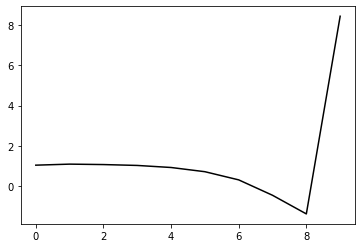

30800 0.13412437592664658
0.2489914835502561 -0.1500523383839981 -0.22620021673621912 -0.14723919924983025
[ 1.07766639  1.05390798  1.00273024  0.95172188  0.85071592  0.64417586
  0.24086006 -0.52013567 -1.44043886  8.39196449]


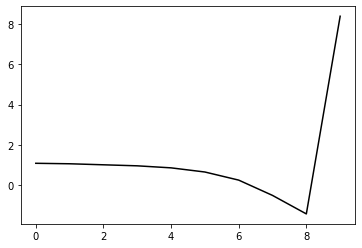

31900 0.1743947976125986
0.2479937997759431 -0.14999859041065178 -0.2261363849891804 -0.14561608998056416
[ 1.03198233  0.93449673  0.88384945  0.81699513  0.7058345   0.49365474
  0.08570631 -0.67883    -1.60127862  8.40776052]


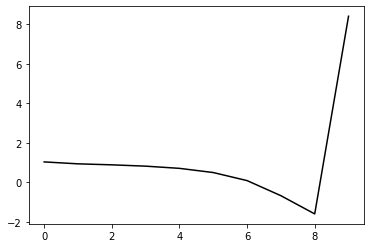

33000 0.20631648381125456
0.2548993454517051 -0.1469587597764507 -0.22526200462746335 -0.14571651076242925
[ 1.02541769  1.09761911  1.06308204  0.98851858  0.86932741  0.65145507
  0.23766271 -0.53348013 -1.46385978  8.41111109]


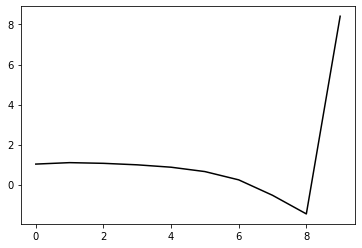

34100 0.1900383212995539
0.252898209997881 -0.14806855334831018 -0.22564175639183182 -0.14495277564209935
[ 1.053226    1.00119326  0.98120712  0.9181832   0.80078213  0.58658179
  0.17796257 -0.58719994 -1.51011967  8.41915266]


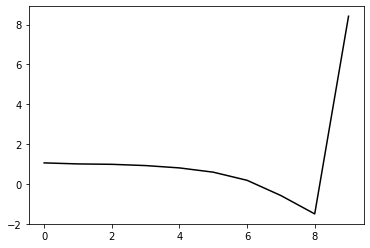

35200 0.2123238424600512
0.2466080373666933 -0.14968724272340814 -0.22541772977842622 -0.14552185703369927
[ 1.05932193  0.98489341  0.95246036  0.89203865  0.77253082  0.55530118
  0.14462133 -0.62193603 -1.54534058  8.39419077]


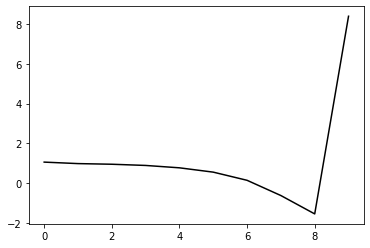

36300 0.1706030570145633
0.2565966687947118 -0.14626635624351267 -0.2250023526771713 -0.14621556576786002
[ 1.01387374  1.15495541  1.14422471  1.07783465  0.95221337  0.72741893
  0.30936634 -0.46477866 -1.39661643  8.45873549]


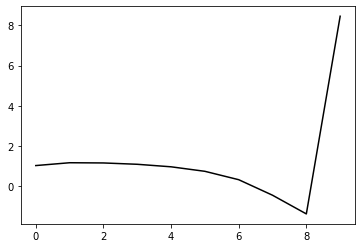

37400 0.1654514529672814
0.2556166551485117 -0.1444117990011269 -0.2234362670069733 -0.1460230067400906
[ 1.02485636  1.11376665  1.1051336   1.04856069  0.92583023  0.70146444
  0.28383195 -0.48989542 -1.42141079  8.38811482]


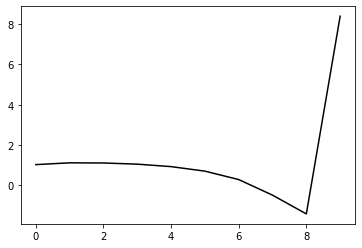

38500 0.22537391533785714
0.2523761985845438 -0.1454940124425355 -0.22336988467037514 -0.1472710418672532
[ 1.0683076   1.07692212  1.05391304  1.00941935  0.89879408  0.68372558
  0.27524226 -0.48844709 -1.40789685  8.43454178]


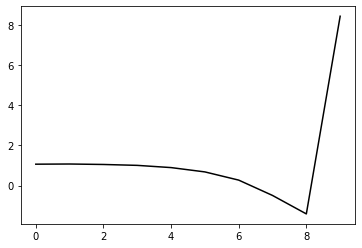

39600 0.15695286970469094
0.2526205783811081 -0.1486209971399935 -0.22585422627450194 -0.14622225376837333
[ 1.04947181  1.05018516  1.03187249  0.98986359  0.88719023  0.67877949
  0.27647004 -0.48049931 -1.39196059  8.45069726]


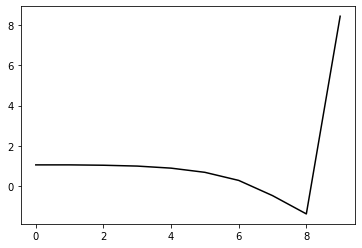

40700 0.114996578146547
0.2540572135960004 -0.1471238646562651 -0.22515918286894324 -0.14731077186153982
[ 1.04563293  1.06406993  1.04897485  1.00807812  0.91091746  0.70755937
  0.30909898 -0.4444534  -1.3527408   8.44195122]


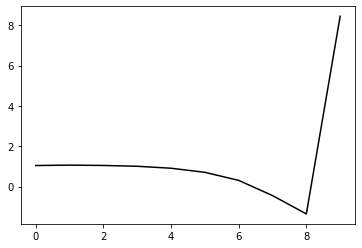

41800 0.1566159035833477
0.2522328886957526 -0.15065471196183064 -0.22766988707371 -0.14366487383738502
[ 1.04190629  0.98922977  0.94496503  0.89191144  0.79118535  0.58629039
  0.18638453 -0.56780465 -1.47536496  8.39115897]


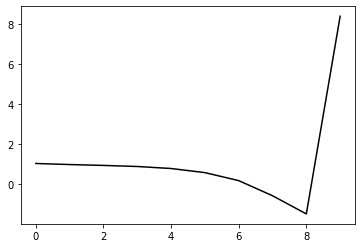

42900 0.19598099016470735
0.2527566288044417 -0.1478124134479004 -0.22584353763868312 -0.1440248880884456
[ 1.00743018  0.95731559  0.93142568  0.87781374  0.77877367  0.57736408
  0.17947458 -0.57394621 -1.48178095  8.42742132]


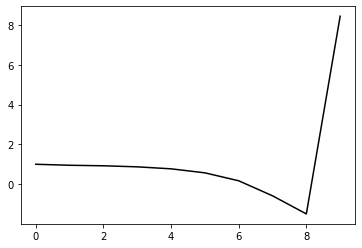

44000 0.21489281278559477
0.24994588380756988 -0.14822833774398178 -0.2258627862351898 -0.1428583941160413
[ 1.03930897  0.97810362  0.9194789   0.85619036  0.75286821  0.54980002
  0.14987431 -0.60625777 -1.51714898  8.39943007]


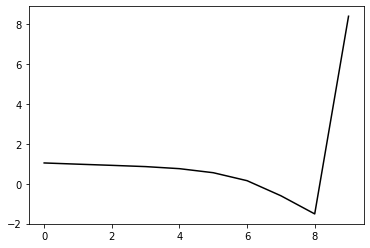

45100 0.19854940551173111
0.2493771596391071 -0.14956948164650935 -0.226659843418422 -0.14342654612500957
[ 1.07109127  0.98620266  0.9423875   0.88175357  0.78116576  0.58398632
  0.19030677 -0.55972752 -1.46382261  8.42745866]


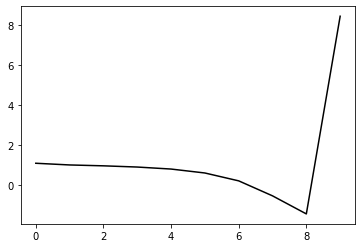

46200 0.20763853082514364
0.24255007451302327 -0.14822832038095882 -0.22386987945978487 -0.1463020166656661
[ 1.06094087  0.94646924  0.91925458  0.85847174  0.75279657  0.55286327
  0.15757145 -0.59371587 -1.49817299  8.3939993 ]


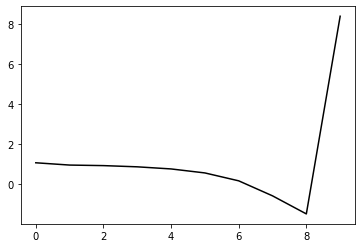

47300 0.17417504737992687
0.25137904336064 -0.14539504826564448 -0.22363307729160256 -0.14645833197813865
[ 1.03293254  1.06285214  1.03839174  0.97552424  0.86478957  0.66019227
  0.26102076 -0.49452954 -1.40391744  8.46233877]


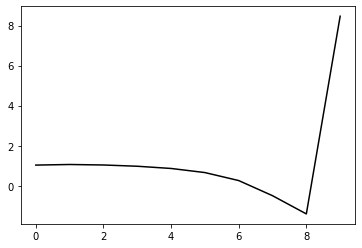

48400 0.22360235445691573
0.2522502066399664 -0.14366039031238934 -0.22257756321401345 -0.14756181692943546
[ 1.08264825  1.11139724  1.11112722  1.05935076  0.95327686  0.75214352
  0.3568684  -0.39542311 -1.30219035  8.41169472]


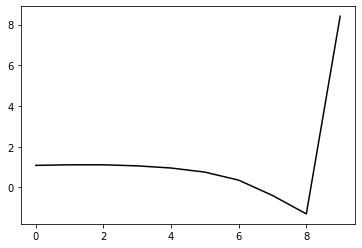

49500 0.251578841378092
0.25316057532261355 -0.14800487658235884 -0.2263933270356181 -0.14427469418394054
[ 0.99095466  1.05306874  1.04429334  0.99560642  0.89133404  0.69071047
  0.29659907 -0.45473076 -1.36101349  8.46914053]


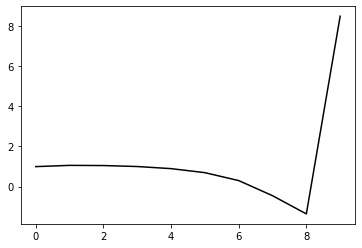

50600 0.15884893649888032
0.25142857769875854 -0.14730934567088075 -0.2253449944667673 -0.14466720993609117
[ 1.06539732  1.00028622  0.99601717  0.95382539  0.85579772  0.66022879
  0.27177139 -0.47339764 -1.37259785  8.40685541]


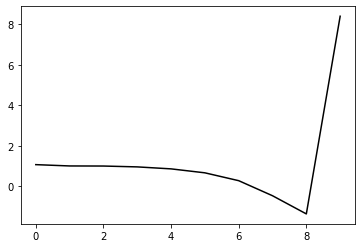

51700 0.15820865630954545
0.24691115409569442 -0.14497822080075082 -0.22214019826703765 -0.14729830777076502
[ 1.06757415  0.99264982  0.97431922  0.92816784  0.82717163  0.62847182
  0.23799425 -0.50815913 -1.40747717  8.43584111]


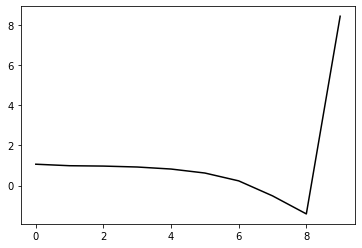

52800 0.12857834340395924
0.24764939684634626 -0.14949944699205583 -0.22611556390261664 -0.14603819188565897
[ 1.05334235  1.07827179  1.03977298  0.99419159  0.90113659  0.70963322
  0.3255569  -0.41500609 -1.30965271  8.41076155]


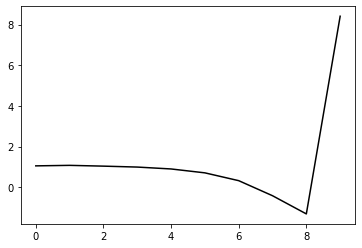

53900 0.19475107444240763
0.2495221743227829 -0.14780511824871195 -0.22543800308944908 -0.14504570319834983
[ 1.02316005  1.01854058  1.00553165  0.9562505   0.85712454  0.66158736
  0.27391828 -0.47005574 -1.36840632  8.4501048 ]


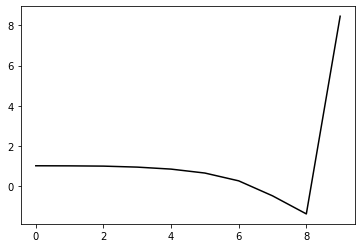

55000 0.2570548378725506
0.24933505652259605 -0.15164873008584592 -0.22861823017566163 -0.1408860803313992
[ 0.99506644  0.96950746  0.92699238  0.87797901  0.77936525  0.58440701
  0.1976278  -0.54549131 -1.44329142  8.41236752]


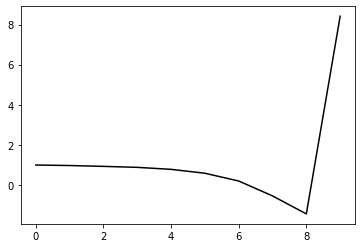

56100 0.19045253640961338
0.2507328844694803 -0.1450839630489376 -0.22362088228043114 -0.14477864138247867
[ 1.05037268  1.02736581  0.97107684  0.9050568   0.80038939  0.60096265
  0.21006745 -0.53712842 -1.43934671  8.42036287]


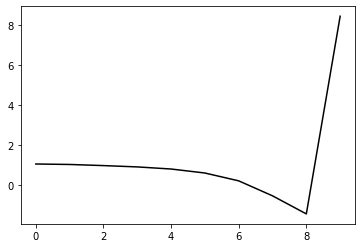

57200 0.18433921500897754
0.24598225823878042 -0.15291677245117657 -0.22822539913806533 -0.14446821296668025
[ 1.02912248  0.93934967  0.91521821  0.86071239  0.76383993  0.57508405
  0.19630372 -0.53710116 -1.42268549  8.4089746 ]


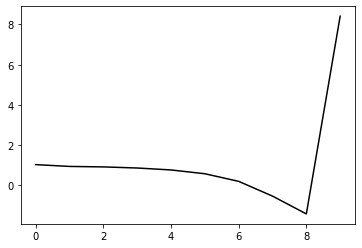

58300 0.17666987213157306
0.2524472105989895 -0.14355549149679922 -0.22249978724145245 -0.14640715969317478
[ 1.03048586  1.06842484  1.0290628   0.958385    0.84487062  0.6403992
  0.24627567 -0.50319775 -1.40702635  8.40391293]


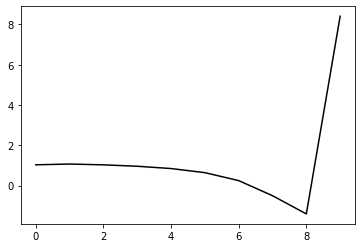

59400 0.1927865007233504
0.24610267045850742 -0.15216425336205885 -0.22759178498081628 -0.14633302310595914
[ 1.0698874   0.99204966  0.95305695  0.89762913  0.79715839  0.60675199
  0.22804068 -0.50476875 -1.38969826  8.44089161]


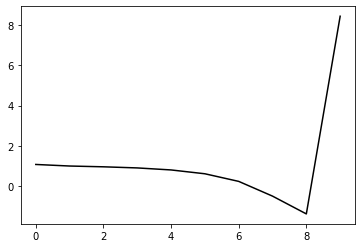

60500 0.295413440605663
0.2552265739188182 -0.14704872439342775 -0.22609188372466985 -0.14371440468811816
[ 0.97153874  1.04007964  1.01521162  0.94832386  0.8361716   0.63436636
  0.24464297 -0.4998873  -1.39877784  8.44895717]


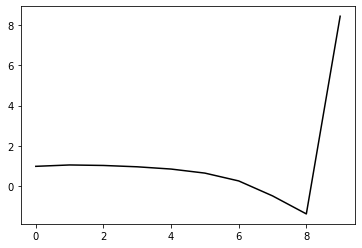

61600 0.1578889468966539
0.2519457451122294 -0.1492857395315862 -0.22728212655225025 -0.1444259653189601
[ 1.05153449  0.98615079  0.98379282  0.93754953  0.8410628   0.65318371
  0.27674505 -0.4553937  -1.34256217  8.41605454]


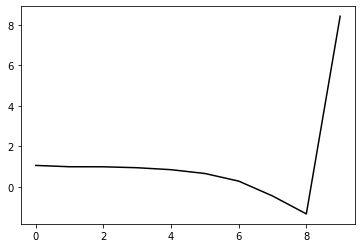

62700 0.13551795716502485
0.24690906237329152 -0.14685663465694507 -0.22422080005524564 -0.14753847274711573
[ 1.06803396  1.00041582  0.99117862  0.95058377  0.85639868  0.66910238
  0.29323666 -0.43870471 -1.32676264  8.45708727]


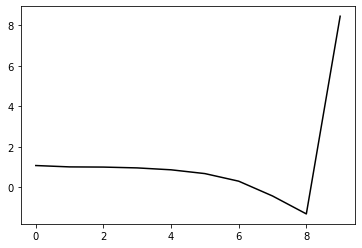

63800 0.1266371663059729
0.24839149540221828 -0.145979528768815 -0.22388388043469906 -0.146853601474895
[ 1.04211675  1.03125186  1.01018211  0.96656309  0.87037502  0.68010173
  0.30169986 -0.43241186 -1.32297215  8.42980868]


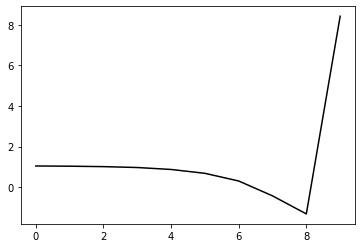

64900 0.20394621418658906
0.2509259610102274 -0.14694844635896326 -0.22525121710806315 -0.1443349965392666
[ 1.00042739  0.99424327  0.95651587  0.90382968  0.80306512  0.60880806
  0.22742738 -0.50861374 -1.40066963  8.4404317 ]


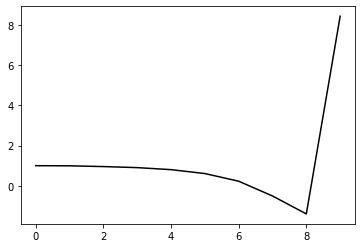

66000 0.20752288320101503
0.24531681241675038 -0.15433521111362997 -0.23003107234336917 -0.14349511035392934
[ 1.04131575  0.87411895  0.83539494  0.7954312   0.71571944  0.54322287
  0.18324716 -0.53114222 -1.40036573  8.39404107]


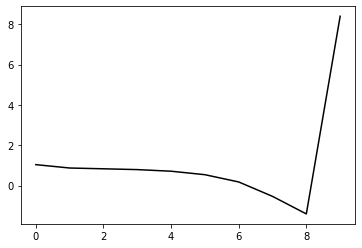

67100 0.20246536806631923
0.2450906690661911 -0.15238927431844554 -0.2285344816386952 -0.1443471076129952
[ 1.07437855  0.97384762  0.92032648  0.86690223  0.7838151   0.611762
  0.25253984 -0.46123664 -1.33072228  8.45264795]


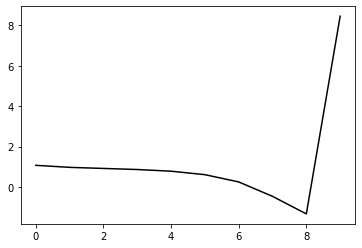

68200 0.18842178682884844
0.2494591587463573 -0.1434240589120532 -0.22252251308659296 -0.1451318036203295
[ 1.07696236  1.13753068  1.08796714  1.00610843  0.89323897  0.69409019
  0.30759578 -0.43380515 -1.33200493  8.41541413]


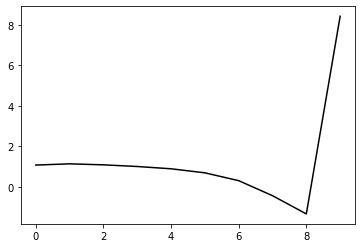

69300 0.17594747954180978
0.2565526756448904 -0.14178572871856415 -0.22358178662847863 -0.14143178537423323
[ 1.01540871  1.15389861  1.13873539  1.06521763  0.94535207  0.73950279
  0.3466276  -0.40207781 -1.30938909  8.47009918]


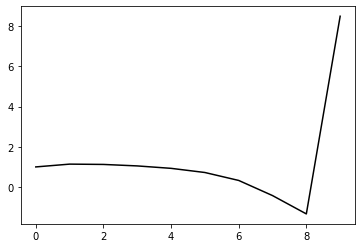

70400 0.18999243835162638
0.24574496158784936 -0.1487791631477251 -0.22640941990760444 -0.14280168031531199
[ 1.07394186  0.98586973  0.95615963  0.90103957  0.79524321  0.6028376
  0.22553854 -0.50574567 -1.39278887  8.42487505]


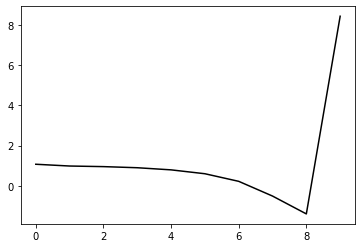

71500 0.19967639382298116
0.24204124493517168 -0.1484158751577574 -0.22524885263746647 -0.1454159258647169
[ 1.0654841   1.01336526  0.96499677  0.90375025  0.7968383   0.60242485
  0.22459145 -0.50609982 -1.39190975  8.44256409]


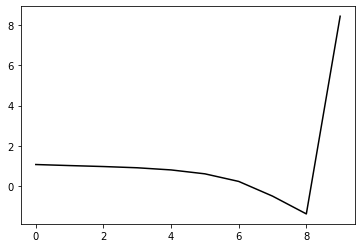

72600 0.15932678159663483
0.25144629300140103 -0.14231075916766642 -0.22349513043991018 -0.14224411947998997
[ 1.04797675  1.14155171  1.14999558  1.09048986  0.97619519  0.77069197
  0.37951755 -0.3671176  -1.27345747  8.41954055]


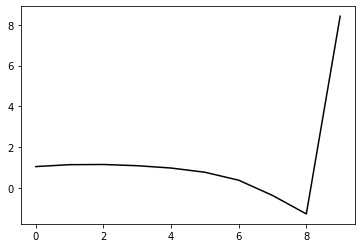

73700 0.20236110177652175
0.2465616379975865 -0.14992121207827147 -0.2283674121580251 -0.13957169447876705
[ 0.99842372  0.95880805  0.94910524  0.90419146  0.79794466  0.59917643
  0.21654616 -0.5192183  -1.41207037  8.45023198]


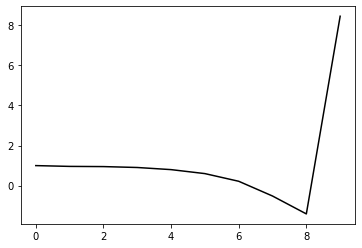

74800 0.13043659368326346
0.2446300743292637 -0.14886309971730852 -0.22663291474749148 -0.14501036419871435
[ 1.08280481  1.10858437  1.08830112  1.05002535  0.9571435   0.76816617
  0.39429137 -0.33251737 -1.21584455  8.4346839 ]


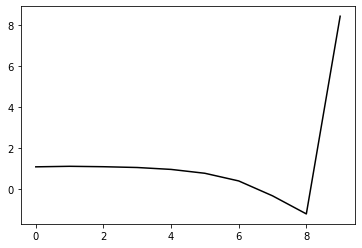

75900 0.18578790738534084
0.24473679483574404 -0.14744442796299778 -0.22588719560386264 -0.14103509126867855
[ 1.04156207  1.07559528  1.01378341  0.94231805  0.82673855  0.617345
  0.22467991 -0.51879187 -1.41799403  8.4273193 ]


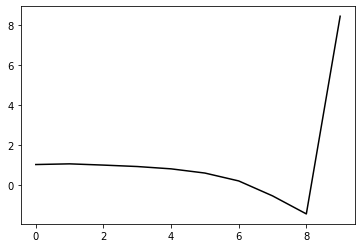

77000 0.21468346732385346
0.23758631364288002 -0.15475341529573866 -0.22983949779297058 -0.1407486637825877
[ 1.07142395  0.9059826   0.88588048  0.82963572  0.7252582   0.52964172
  0.15204337 -0.57410206 -1.45293299  8.40573087]


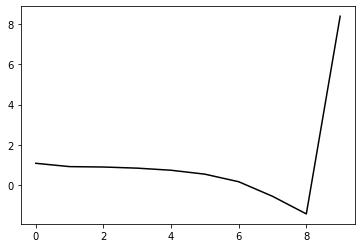

78100 0.2065486435743134
0.24314841320653122 -0.15211878465120549 -0.22881998171507134 -0.14072382960108137
[ 1.08236046  0.98778841  0.97246153  0.92033621  0.81584296  0.61819737
  0.23709985 -0.49357035 -1.37876792  8.46182052]


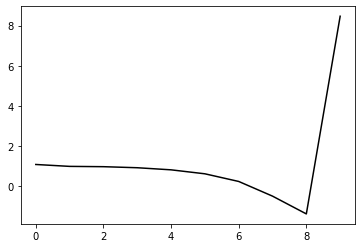

79200 0.16617082602560218
0.2430597713699537 -0.15284506595911218 -0.22949630758050302 -0.14154868415925118
[ 1.0573781   1.08217236  1.06051047  1.01496071  0.9178568   0.72643667
  0.35079203 -0.37481365 -1.25608495  8.42449729]


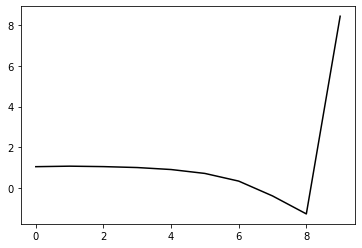

80300 0.2264301917806055
0.24469500824360532 -0.1555714031087822 -0.2322268326392379 -0.1394450572231283
[ 1.02750298  1.08645933  1.06626193  1.02157422  0.92494988  0.73398146
  0.35882756 -0.3656956  -1.24597571  8.47619702]


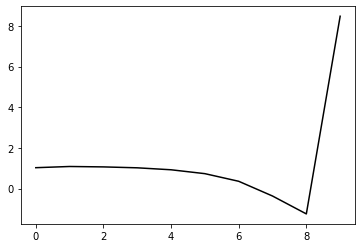

81400 0.2219955944212738
0.25120325385903036 -0.14515378042661137 -0.22577755741893638 -0.13969524339370415
[ 1.01688783  1.18019362  1.19630139  1.13110015  1.00332419  0.78110416
  0.37643616 -0.37551523 -1.283186    8.40721827]


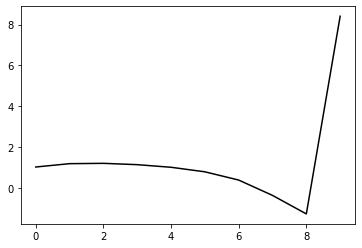

82500 0.2216456080251099
0.2372042922682054 -0.1500395592625345 -0.22657530833517586 -0.14255608477127424
[ 1.1078225   0.9280568   0.9176821   0.88276154  0.77663154  0.57233869
  0.18646348 -0.54418657 -1.42674277  8.44165476]


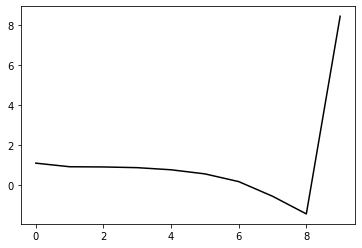

83600 0.19172026568327374
0.24025902481033357 -0.15230220629948688 -0.2295209834766933 -0.13747613809922504
[ 1.05977778  1.03097928  0.96926271  0.90826446  0.79325897  0.57725291
  0.17816623 -0.56584418 -1.46308501  8.41598282]


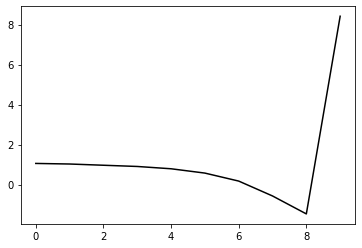

84700 0.1362841579428496
0.2465842354061471 -0.1462150441904238 -0.2264266179857754 -0.13582395467487046
[ 1.09800129  1.02138583  1.00644298  0.93565351  0.81192547  0.58742694
  0.17752104 -0.57850027 -1.48981348  8.46028837]


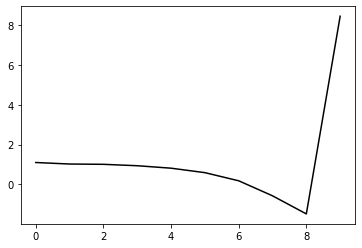

85800 0.12976456022004748
0.24646820033523414 -0.14742785572313935 -0.22722116539630866 -0.1383957091675076
[ 1.08579875  1.16879998  1.15125165  1.09095218  0.97204145  0.75181457
  0.34525131 -0.40714664 -1.31419531  8.44198994]


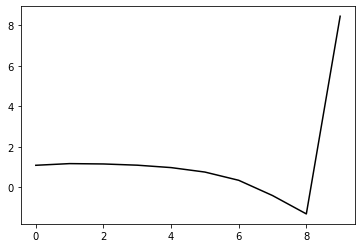

86900 0.17389495838794514
0.24242680831558874 -0.14679532159334838 -0.2260452373775788 -0.13707317120177703
[ 1.06214318  0.9917779   0.98410464  0.92791726  0.80498689  0.58021871
  0.16899911 -0.5874279  -1.49795491  8.42361722]


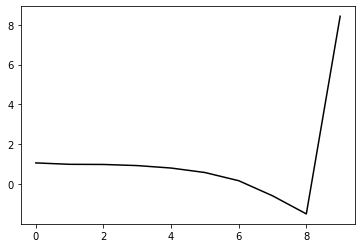

88000 0.20854637541274884
0.2455959222322392 -0.14653095597491678 -0.2264869428731254 -0.1377748889550971
[ 1.06036571  1.10204708  1.09560434  1.04262702  0.92171379  0.69557673
  0.2820229  -0.47603154 -1.38712697  8.38941452]


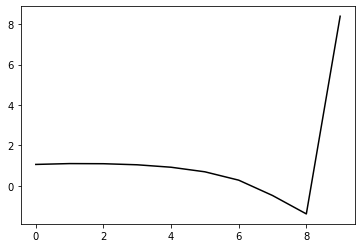

89100 0.20897559900552024
0.2417064411018417 -0.15176617214899035 -0.2296513795466217 -0.137463390275084
[ 1.08516144  1.00918419  1.02277559  0.99745128  0.8968674   0.68661891
  0.28653536 -0.45833928 -1.35518115  8.4433768 ]


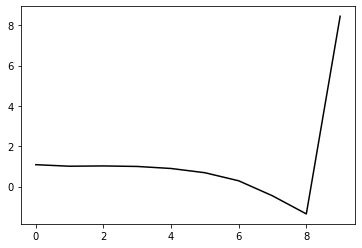

90200 0.17585397007455322
0.24540250978413541 -0.14472810242883527 -0.22501597880060237 -0.14014085218569344
[ 1.08491636  1.16178766  1.1699513   1.1366825   1.0342289   0.81878468
  0.41098787 -0.34212366 -1.24766847  8.40454631]


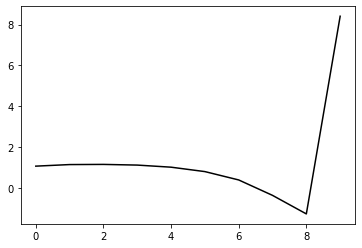

91300 0.17333795361476295
0.2477611617613744 -0.14489242494967783 -0.22612578235074052 -0.13775500105447808
[ 1.03747186  1.17974425  1.17174331  1.13508181  1.03413228  0.81840199
  0.40706067 -0.35059734 -1.26111341  8.46440801]


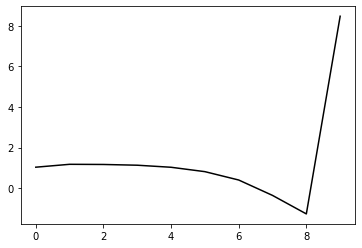

92400 0.19082114148824328
0.24217853338050502 -0.14840618578949027 -0.2273571259919024 -0.13903638924778502
[ 1.13364438  1.09062388  1.07225169  1.03879888  0.94762989  0.74267871
  0.34047907 -0.40741084 -1.30519875  8.44113954]


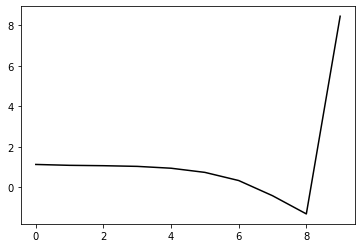

93500 0.1931481234739965
0.24757744245876315 -0.14437951549204303 -0.22597414039860342 -0.1358500348966768
[ 1.0704196   1.1494917   1.16182406  1.11687378  1.01324437  0.79829503
  0.38442303 -0.37669073 -1.28939213  8.45050284]


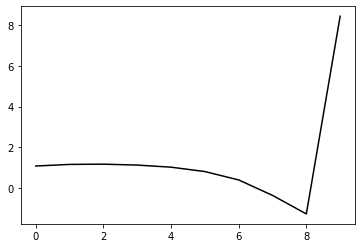

94600 0.21814641510933772
0.24941653302563202 -0.14421666488830903 -0.22626762894494618 -0.13536944118405073
[ 1.02605207  1.11597051  1.12332401  1.08355015  0.97859547  0.76271208
  0.34754734 -0.41492878 -1.32811198  8.43130056]


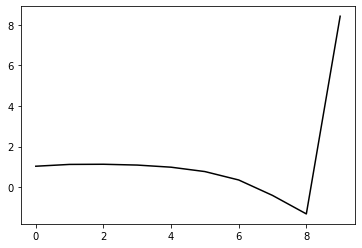

95700 0.1287788742489187
0.2458385617971888 -0.14387892154192028 -0.22530397093010146 -0.13505275820924184
[ 1.10085549  1.03093168  1.02024844  0.98305081  0.88286809  0.67125511
  0.25987322 -0.49886684 -1.40686172  8.42684545]


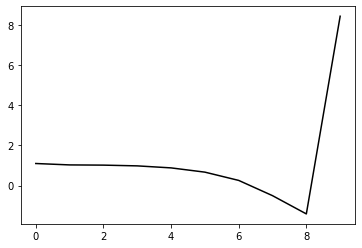

96800 0.16953113954746413
0.24617057606250428 -0.14709470658054233 -0.2280649045193809 -0.13215713605129092
[ 1.05324724  1.09047655  1.04870334  0.99932621  0.89581059  0.68152451
  0.26693538 -0.49526045 -1.40591229  8.41793719]


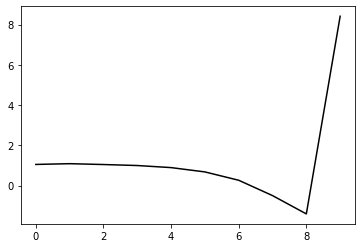

97900 0.1843069540851388
0.24212433746663475 -0.14772521488787269 -0.22767370784968738 -0.13526325123470118
[ 1.06392978  1.05468271  1.02192707  0.97137614  0.87237931  0.66444285
  0.25482797 -0.50340646 -1.40930226  8.46671274]


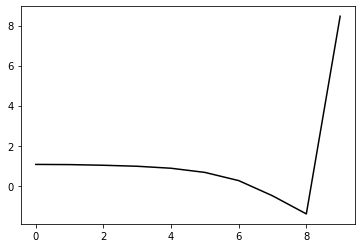

99000 0.21320022399932645
0.2427744646049342 -0.14669955497454298 -0.2273005760349278 -0.13369920331300603
[ 1.07606368  1.13206897  1.07585828  1.00357761  0.88856317  0.66775355
  0.2451232  -0.52724386 -1.44843367  8.40845778]


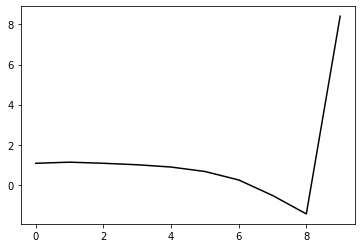

100100 0.24924434596227185
0.23958911203017952 -0.1485374981261434 -0.22794107887791992 -0.13489708755024918
[ 1.14652849  0.93904696  0.9591574   0.9061758   0.79902472  0.58822707
  0.17559175 -0.58730192 -1.49763888  8.43602114]


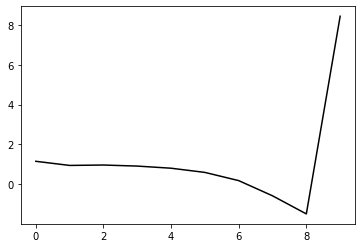

101200 0.16959665120690084
0.2472410254896718 -0.14371530741323585 -0.22579171630348918 -0.13635775437960565
[ 1.07888646  1.20625312  1.19421661  1.1377608   1.02200101  0.80206225
  0.38044699 -0.39250388 -1.31409574  8.41780843]


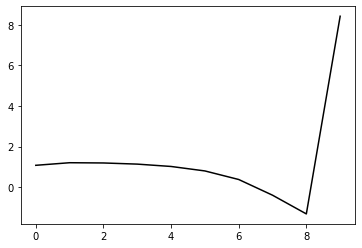

102300 0.1642842469205
0.24913177500619899 -0.14411821442591197 -0.22657118352167627 -0.13628031171157118
[ 1.05360028  1.18224557  1.19500924  1.14700839  1.03229537  0.81209377
  0.39058869 -0.38284922 -1.30483062  8.4566441 ]


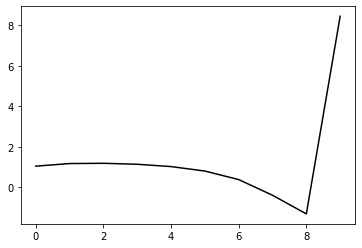

103400 0.15669174582556808
0.24718865111974225 -0.14276969681242616 -0.2251205723331227 -0.1369197957518921
[ 1.08590722  1.14908953  1.15405666  1.11504256  1.00558612  0.78743538
  0.36783373 -0.40434938 -1.32479162  8.40395946]


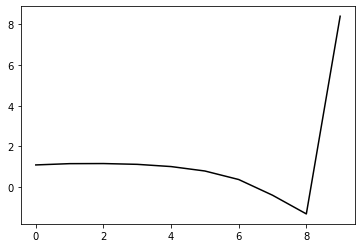

104500 0.21371509729555288
0.24129331786184247 -0.15026093491354667 -0.22957332064016475 -0.13472056917956185
[ 1.08598567  1.04298661  1.01216149  0.97612108  0.87301343  0.65960871
  0.2453349  -0.52060576 -1.43226367  8.43099737]


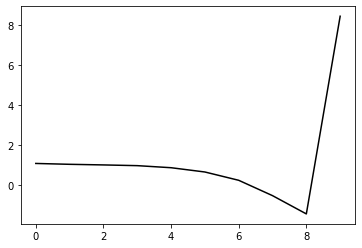

105600 0.22192905364553503
0.25104828224115777 -0.14457326864941472 -0.2271704343593565 -0.13623675768051463
[ 1.0278127   1.16360148  1.15439732  1.10266249  0.99090036  0.76892891
  0.34585861 -0.42921873 -1.35032185  8.42026826]


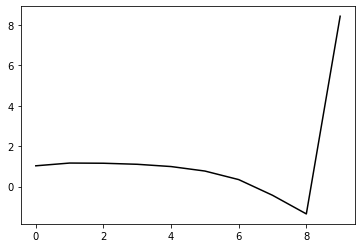

106700 0.12876031150369036
0.24369026690511517 -0.14483890040483666 -0.2256214441751825 -0.1382958264407643
[ 1.09787002  1.10643686  1.07368368  1.02561424  0.91845983  0.70106477
  0.28206823 -0.48907221 -1.40514047  8.43030382]


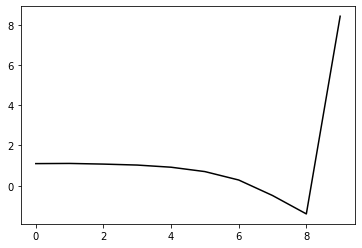

107800 0.12927484107546397
0.2448240896887808 -0.14399069166595604 -0.22490997095592152 -0.13901687718582478
[ 1.08612529  1.09732352  1.08575714  1.03427614  0.92391325  0.70475963
  0.28428826 -0.48803768 -1.40413928  8.42076046]


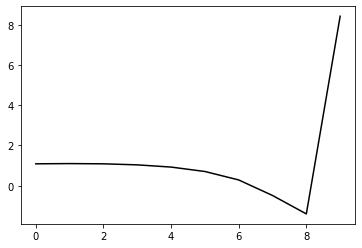

108900 0.1907704431853687
0.24776904561772917 -0.14582631518265304 -0.2269440603360576 -0.13814274805553234
[ 1.05965887  1.08577385  1.0898033   1.0466761   0.93891096  0.72227212
  0.30433637 -0.46542439 -1.37777206  8.45529268]


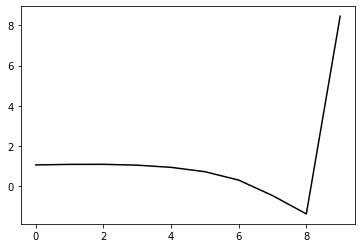

110000 0.22593291100032686
0.2486195900486017 -0.14811249574160024 -0.22906664582968508 -0.135432735262477
[ 1.03462722  1.07887864  1.065385    1.02744274  0.9234262   0.70839733
  0.29146522 -0.47793682 -1.38957794  8.41032909]


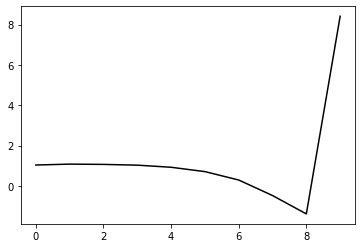

111100 0.19046574534741967
0.248902777007029 -0.14431914321127123 -0.22611751089641477 -0.13795537206323993
[ 1.08586297  1.13119315  1.10843548  1.05487362  0.94597311  0.7270125
  0.30622396 -0.46689957 -1.3813771   8.43587397]


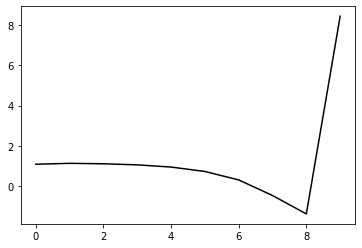

112200 0.16245326757477022
0.24938994786442664 -0.14405798981874135 -0.22595345354899354 -0.13924817387199132
[ 1.06752358  1.17253382  1.17259225  1.13209684  1.03088188  0.81935
  0.40431357 -0.36473323 -1.27587055  8.42454001]


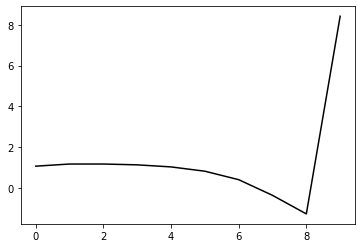

113300 0.16783990636957952
0.252096036745105 -0.1436569306286164 -0.2264107060940789 -0.13792558997278018
[ 1.04388451  1.17345207  1.17110981  1.12690355  1.02039371  0.80390511
  0.38404599 -0.39005754 -1.30603848  8.45535755]


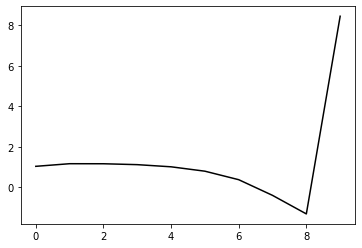

114400 0.24295264533235467
0.249526934256594 -0.14118261319020434 -0.22414310190344353 -0.1401152402757137
[ 1.12548564  1.13585684  1.15050613  1.11964988  1.0243475   0.81663249
  0.40340672 -0.36615775 -1.27869195  8.41646758]


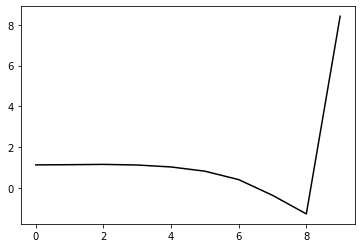

115500 0.2076371052334475
0.24441390204154906 -0.14894253758957673 -0.22871775395157334 -0.13922793956396445
[ 1.12121743  1.0690724   1.05884486  1.03840195  0.95823739  0.76527662
  0.36662512 -0.38780692 -1.28231238  8.45949078]


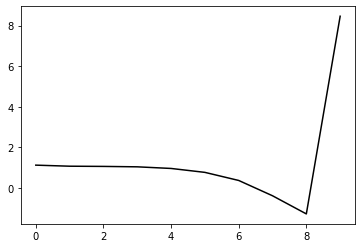

116600 0.14884712759514293
0.2488152732387575 -0.1464583302478161 -0.22818313347898403 -0.13750686843695628
[ 1.06938595  1.15798003  1.16886939  1.13419379  1.04183857  0.8382818
  0.42843116 -0.33848775 -1.24697272  8.4437917 ]


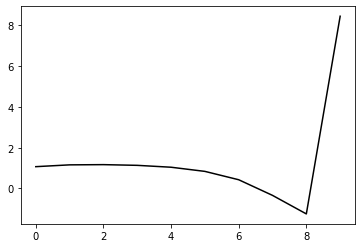

117700 0.16242844566183848
0.24940764627443737 -0.14236334226786487 -0.22520397734633077 -0.13762767401965123
[ 1.12116012  1.08424631  1.08892091  1.05076465  0.95285703  0.74512525
  0.33177663 -0.43846041 -1.3493711   8.46185619]


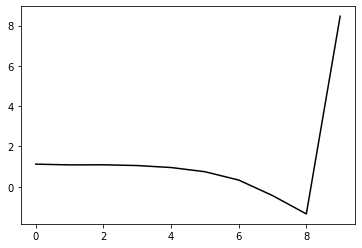

118800 0.14149707469348372
0.24506293516718985 -0.1455148684414915 -0.2263581438085069 -0.1388990388855598
[ 1.11580665  1.1086709   1.09217314  1.05595815  0.96293187  0.76048864
  0.35273261 -0.41169655 -1.31521572  8.4388897 ]


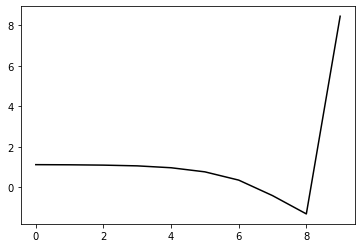

119900 0.1950243669654558
0.2450381059356963 -0.14900021999975732 -0.22905203921201722 -0.13947286948058446
[ 1.07471038  1.10863237  1.10336829  1.06857703  0.98144997  0.78644325
  0.38618904 -0.37106579 -1.26666762  8.45527727]


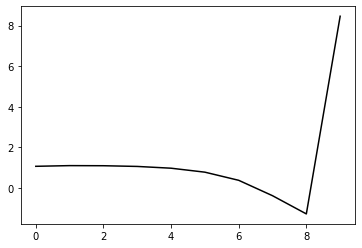

121000 0.2183627785123282
0.24682280705796963 -0.1488672240462509 -0.22963509703686802 -0.1342683069628429
[ 1.04830302  1.12287285  1.07758983  1.01705482  0.91065505  0.69987652
  0.28537059 -0.48593227 -1.39591564  8.41366505]


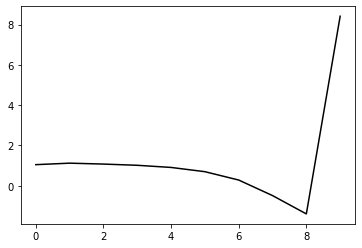

122100 0.1919387703387701
0.24792551671476404 -0.14495510183712165 -0.22679451986751165 -0.13698161459887565
[ 1.09368536  1.13649151  1.12953796  1.07206891  0.96402211  0.7536091
  0.33973094 -0.43177931 -1.34234328  8.44300301]


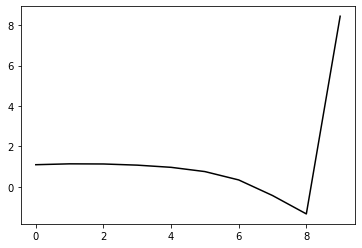

123200 0.16251706068163727
0.24918553297430895 -0.14324935191233204 -0.22614049345777856 -0.13592285749862024
[ 1.06839581  1.1873122   1.17563974  1.12631176  1.0159096   0.80179425
  0.3840324  -0.39299549 -1.31084967  8.42688582]


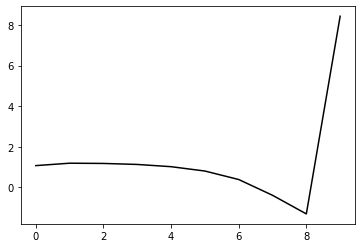

124300 0.22424035123871353
0.24566398154446248 -0.15341880203725877 -0.2330464258730798 -0.135087330279073
[ 1.0446336   1.09292713  1.09355095  1.06525862  0.9737114   0.7766971
  0.37651114 -0.38268077 -1.28081911  8.46820015]


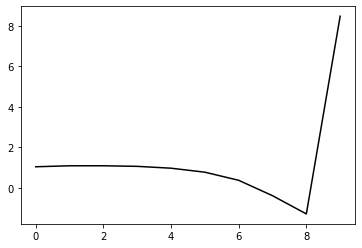

125400 0.16154502765735934
0.25066839360999726 -0.14346491382107546 -0.22596460912009372 -0.13749556436841215
[ 1.07460049  1.18926999  1.18221225  1.13239825  1.02291268  0.80750855
  0.38980763 -0.38672548 -1.30261824  8.4083811 ]


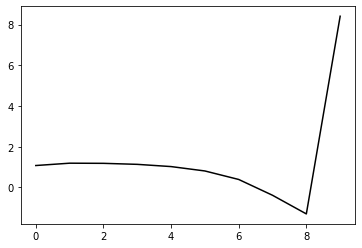

126500 0.27193042595644185
0.24340522810395557 -0.14474709069897473 -0.22498597024145267 -0.14083175072648596
[ 1.11571614  1.09638471  1.09799964  1.05779967  0.95204762  0.73973838
  0.32605105 -0.44539018 -1.35401679  8.44625697]


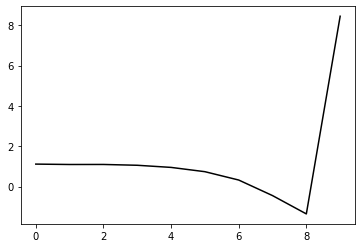

127600 0.18981706744875845
0.24736065344282923 -0.14712003048317918 -0.22771455415911174 -0.13731057322573645
[ 1.03805061  1.08022385  1.05278703  0.99641801  0.87967429  0.65759295
  0.2366565  -0.54004996 -1.4521379   8.42197259]


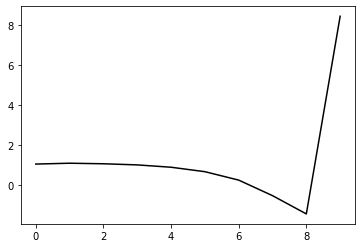

128700 0.13256893714260387
0.2437019838098173 -0.14905118039584994 -0.22855177496869652 -0.13774009618412214
[ 1.1125114   1.1058897   1.06008562  1.00897776  0.90292504  0.68721589
  0.26875348 -0.50801007 -1.42133404  8.4554837 ]


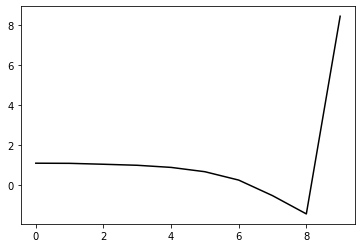

129800 0.1314519318557067
0.24673233842172448 -0.14499404156595852 -0.22570963203276864 -0.1383175253495253
[ 1.07673839  1.15688049  1.10780699  1.03731011  0.91823745  0.69251386
  0.26499133 -0.51962743 -1.43921391  8.41424211]


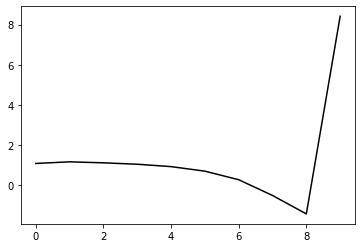

130900 0.15625965941584924
0.24440590794970574 -0.15314526081211927 -0.2316157960604274 -0.1352290100088362
[ 1.09991643  0.94471347  0.94538852  0.89082623  0.7806321   0.56692855
  0.15285977 -0.61683248 -1.51839435  8.42997187]


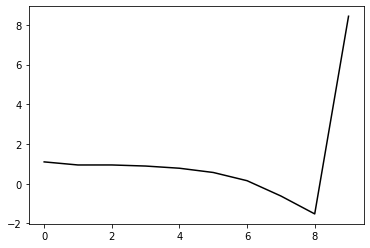

132000 0.21669219174508308
0.25020346092134 -0.14820423275110087 -0.22882564091879282 -0.13627186992291743
[ 1.0448472   1.11996841  1.10126378  1.04158689  0.92377977  0.70165082
  0.27871382 -0.50129463 -1.41570722  8.41031602]


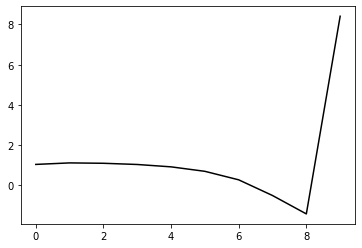

133100 0.2932001266144815
0.24177205602058321 -0.14802660547839547 -0.22673457335281944 -0.1400928078672692
[ 1.17015007  0.95245272  0.9512137   0.90904616  0.80431812  0.59420178
  0.18332822 -0.58451859 -1.48544525  8.4467234 ]


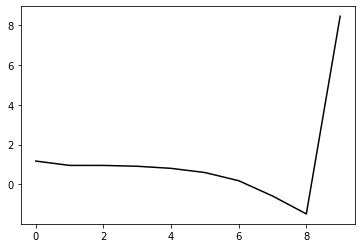

134200 0.165535710995243
0.24814598605041133 -0.14814389496547697 -0.22826849754290982 -0.13986805287024126
[ 1.08074501  1.19065801  1.17422699  1.11961804  1.00663985  0.78766112
  0.36792978 -0.40922576 -1.32059467  8.4175359 ]


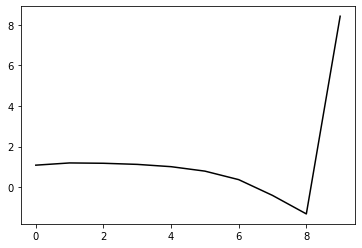

135300 0.1556416617595504
0.24983666902008986 -0.14854785326529774 -0.22973118210828564 -0.13680255499050342
[ 1.06283887  1.10650809  1.11004551  1.06806809  0.96067503  0.74550556
  0.3284027  -0.44761574 -1.35948696  8.46194872]


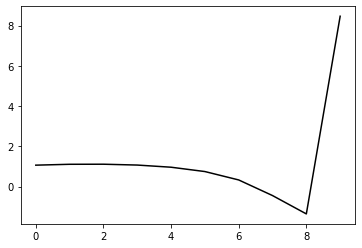

136400 0.2363822566714665
0.24485991868375218 -0.15301507380895185 -0.23256090912287938 -0.13404343720176096
[ 1.06789939  1.0306104   1.00144087  0.9576275   0.85027863  0.63398904
  0.21590911 -0.56092194 -1.47336544  8.38592752]


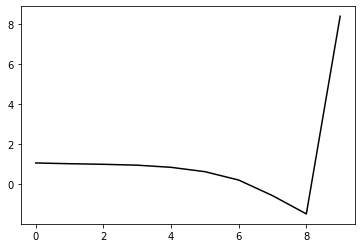

137500 0.23174469124644262
0.25456359626221536 -0.14231161724382263 -0.2262513424753557 -0.13600016843131316
[ 1.03602655  1.22519316  1.22290886  1.16486901  1.04535939  0.81498894
  0.38091913 -0.41349705 -1.34574974  8.47094468]


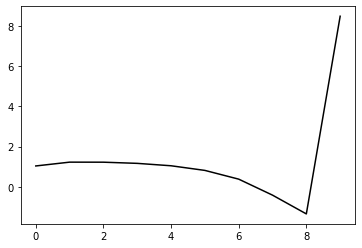

138600 0.18161947518386823
0.24612483166677532 -0.14992432372959974 -0.23025204204994296 -0.13579026886862886
[ 1.07240584  1.08948876  1.07546147  1.02905769  0.91732843  0.6951737
  0.26997694 -0.51448445 -1.43468253  8.40615026]


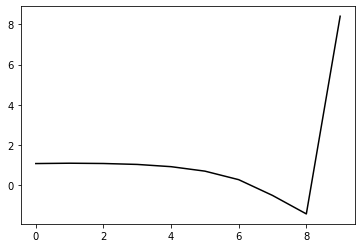

139700 0.15318327036178375
0.24863972839067652 -0.1503153686609239 -0.23118679489264035 -0.13417997546115265
[ 1.06558811  1.16616948  1.14716356  1.09290763  0.9766281   0.74957243
  0.31937334 -0.46977787 -1.39426892  8.42671004]


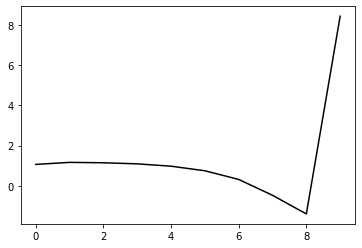

140800 0.1324491616065581
0.2511221378327338 -0.1441489862916048 -0.22707544130668614 -0.1350833161390054
[ 1.09682688  1.20963281  1.21347641  1.15035715  1.02138727  0.78053624
  0.3356214  -0.46863805 -1.40873585  8.42302935]


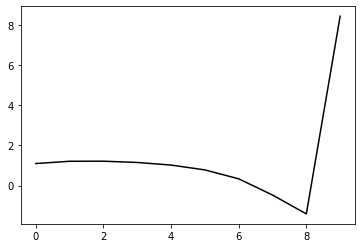

141900 0.17054920088418002
0.24347201642306368 -0.14658552004212885 -0.22734436370607683 -0.1340085135014965
[ 1.08419123  1.05141587  1.04609213  0.9877994   0.85067542  0.60012531
  0.14616056 -0.66605944 -1.6124719   8.40096326]


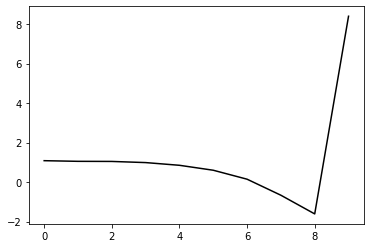

143000 0.20881526686663088
0.2479470771556379 -0.14564782927830128 -0.22776013357523886 -0.1343547805193804
[ 1.08097758  1.17783771  1.18238037  1.13042915  0.99806935  0.74694826
  0.29013295 -0.52641016 -1.47879546  8.39398138]


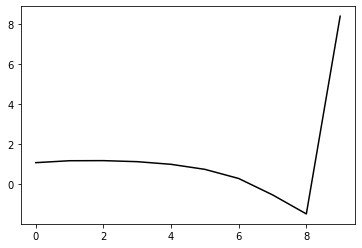

144100 0.1914266381618212
0.2526507659377598 -0.13975827754247824 -0.22494556740635477 -0.13246644667431412
[ 1.06657155  1.18252245  1.2079502   1.16511279  1.03214271  0.77473285
  0.30850652 -0.51966635 -1.48657441  8.44475955]


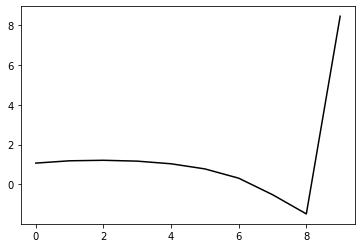

145200 0.17145461212231916
0.24541549823526765 -0.14920291198633961 -0.23056827366435834 -0.13302050488858957
[ 1.09492705  1.11328467  1.15112777  1.14277503  1.04111164  0.80943871
  0.36639412 -0.43860674 -1.38005296  8.41949031]


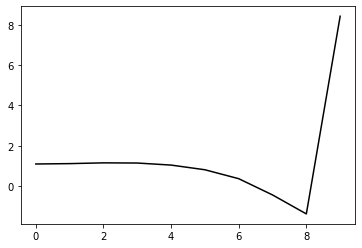

146300 0.18597789095110667
0.25262239376889745 -0.1447133733350084 -0.22904589279027432 -0.13133213185011652
[ 1.06703874  1.23972969  1.25599963  1.23237844  1.12386072  0.88103625
  0.42311487 -0.3989337  -1.36022032  8.43998945]


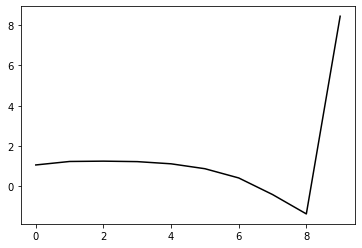

147400 0.18753854357222485
0.2405542598912538 -0.14529703217320994 -0.22623912510182195 -0.13460806004852013
[ 1.11031978  1.08435338  1.08506766  1.05780935  0.94894604  0.70609509
  0.24738384 -0.57452871 -1.53360066  8.39704285]


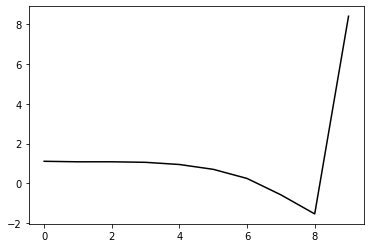

148500 0.18963940043520283
0.25178217953654414 -0.14267191912324956 -0.22664385910868548 -0.13516283158660936
[ 1.08527138  1.21980336  1.23829837  1.21125923  1.10611417  0.86653164
  0.40917269 -0.411956   -1.36989871  8.46392669]


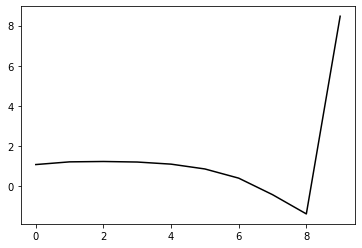

149600 0.18623506851630517
0.24623246810173435 -0.14802539560073014 -0.2295372885801725 -0.13336889533492866
[ 1.0715068   1.10220523  1.10108966  1.07226832  0.96654188  0.72714175
  0.26859897 -0.55391986 -1.51249397  8.40492474]


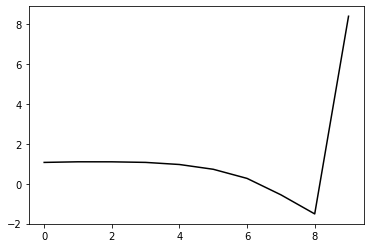

150700 0.1380459487622779
0.247907049205178 -0.14948829250732776 -0.23105220189117448 -0.1320346495481576
[ 1.09219701  1.10604797  1.09628759  1.05986806  0.95521963  0.71912978
  0.26261131 -0.55801426 -1.51334415  8.40830336]


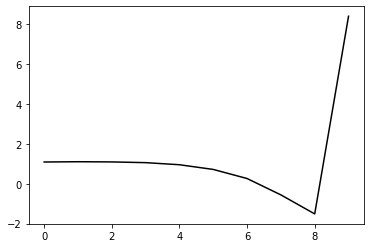

151800 0.12984948490203616
0.2471467163933168 -0.14557508713976472 -0.22795912458370074 -0.13499455287232104
[ 1.12410971  1.12447161  1.14074321  1.11424162  1.02062255  0.79593512
  0.34689815 -0.46936242 -1.42167178  8.39754718]


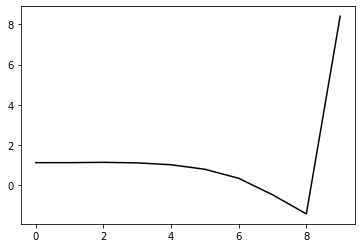

152900 0.18870908300045522
0.2451317897061774 -0.14601425179665886 -0.22792162441087027 -0.13551943028320296
[ 1.11249649  1.07689201  1.09371777  1.07379651  0.98417444  0.76495414
  0.31951288 -0.49518919 -1.44633207  8.44376161]


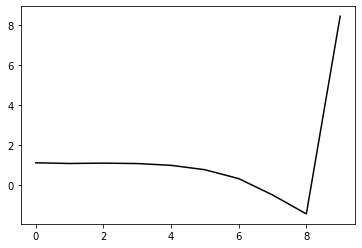

154000 0.2072489752128618
0.24872241436109055 -0.14540740450391176 -0.22872302091607413 -0.13363709759985018
[ 1.08791141  1.17627539  1.18982592  1.16620703  1.07137418  0.84649069
  0.39305864 -0.43284679 -1.39808875  8.41482367]


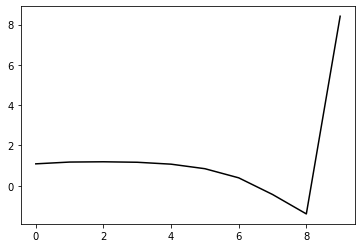

155100 0.19126500555705045
0.2502063359988115 -0.14442360948132935 -0.22833293788547998 -0.1329741216820381
[ 1.11345326  1.14558066  1.17320722  1.15709255  1.06746961  0.84782823
  0.39844153 -0.42525135 -1.38846165  8.44216537]


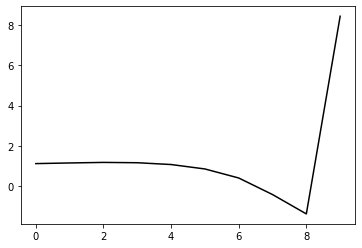

156200 0.17535381389464114
0.24979268343004202 -0.14249621287202788 -0.2267276435967202 -0.13414084396158274
[ 1.10734499  1.20047864  1.21635979  1.202521    1.11641857  0.8997101
  0.45196775 -0.37214365 -1.33643859  8.4182791 ]


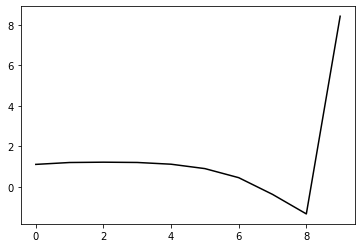

157300 0.22465136709167288
0.2372496915409547 -0.14390245103626223 -0.22484015052077372 -0.13662933962974214
[ 1.13060356  0.92779093  0.91890676  0.90380726  0.81982381  0.60691634
  0.16316997 -0.65750774 -1.61697757  8.41923598]


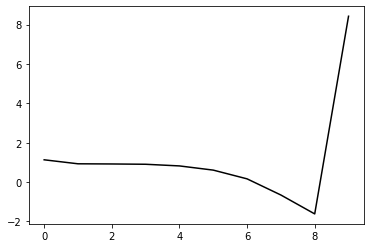

158400 0.158366651051754
0.252012211849705 -0.1428968652225135 -0.22757670350264989 -0.13432284239328743
[ 1.10267386  1.22939903  1.2325881   1.20435131  1.11638085  0.89988191
  0.45080891 -0.37786043 -1.34760277  8.39467495]


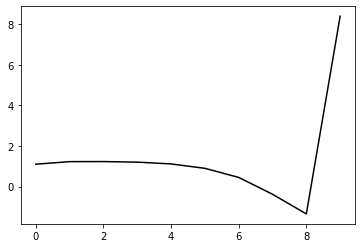

159500 0.19930676003820966
0.24616444218725964 -0.14791718489763783 -0.22994421208831228 -0.13466713290934482
[ 1.12294145  1.10506068  1.11869459  1.10618888  1.02999459  0.8276561
  0.39274013 -0.42237204 -1.37657234  8.44292989]


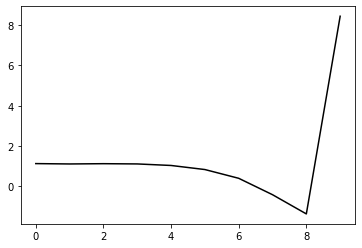

160600 0.15301808554154514
0.2479541978063278 -0.1436117002235698 -0.2269543438063722 -0.1347337068019474
[ 1.09961     1.12992111  1.11841849  1.08234569  0.98762849  0.77102088
  0.32379141 -0.5040265  -1.47111757  8.41572633]


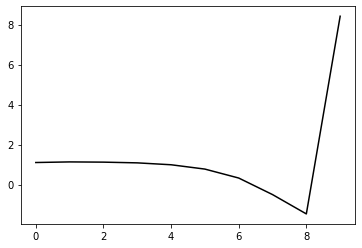

161700 0.13690576325668957
0.2456462843030623 -0.14344623702280176 -0.22601928978396948 -0.13552550031875032
[ 1.12066528  1.10653822  1.06342345  1.02094102  0.92536189  0.71084033
  0.26686004 -0.55814306 -1.52153241  8.41891577]


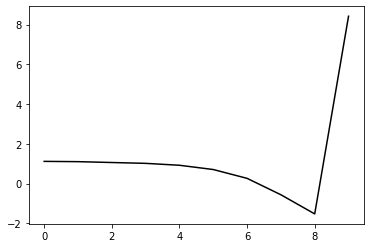

162800 0.18762064714876
0.25101926938950486 -0.14023057300679867 -0.22464471905728642 -0.13748840619383615
[ 1.14308743  1.13758273  1.16035412  1.11979414  1.02332506  0.81026653
  0.36804737 -0.45670927 -1.42042231  8.40115224]


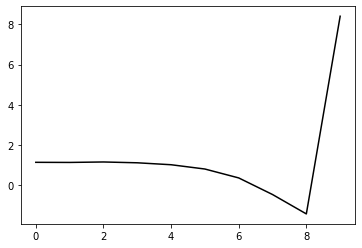

163900 0.19215669188245182
0.25121277490909905 -0.14556128459914044 -0.22872258630118458 -0.1363139583303458
[ 1.07747503  1.15430332  1.13873834  1.09659048  0.99742945  0.78318924
  0.34104427 -0.48401679 -1.44780087  8.42445112]


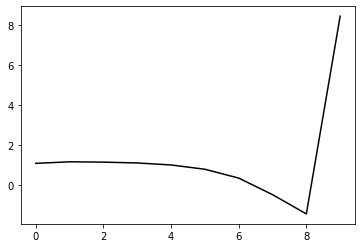

165000 0.21645815576619498
0.25291847950317203 -0.14666773888052917 -0.23016016363993214 -0.13398199276677072
[ 1.05987194  1.11180727  1.11276782  1.07311914  0.97341504  0.7595206
  0.31876258 -0.50603991 -1.4703497   8.40926092]


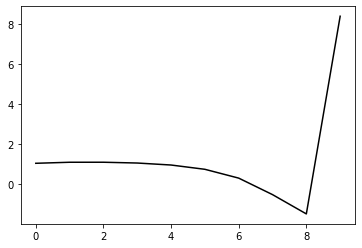

166100 0.1898053857361326
0.25117994973642316 -0.1443825281595928 -0.22824342358347155 -0.13478384278734762
[ 1.09499031  1.10505954  1.09784165  1.06389192  0.96755881  0.75597467
  0.31777971 -0.50628486 -1.47112017  8.41888709]


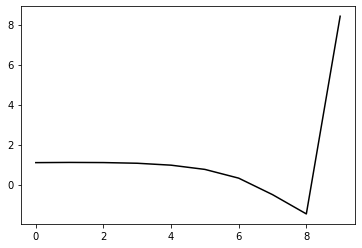

167200 0.2800502815386347
0.24010684593665174 -0.1419522098284935 -0.2235686370909479 -0.14043385279657283
[ 1.16550246  0.94530572  0.94254477  0.92309017  0.8398799   0.64054821
  0.21516654 -0.5965801  -1.54799623  8.38573464]


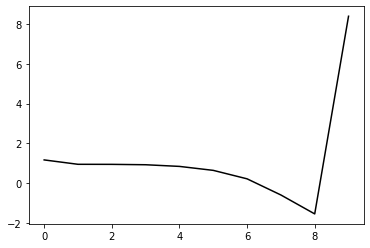

168300 0.17253757782472207
0.25279912982229696 -0.1435617290693351 -0.2278012692548628 -0.1378099009991074
[ 1.08213432  1.17076556  1.16041998  1.12026391  1.02434731  0.81297228
  0.37613479 -0.44806434 -1.41387499  8.45688041]


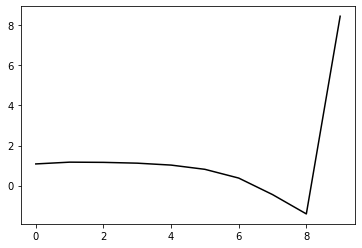

169400 0.18881102147928286
0.24846342633180754 -0.14764263760796353 -0.22975795597061455 -0.13730895960876163
[ 1.13762905  1.05630523  1.06049733  1.02752746  0.93385406  0.72648137
  0.29534243 -0.52251703 -1.48042483  8.40892271]


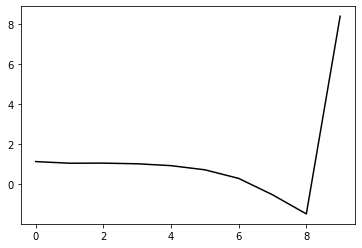

170500 0.20756615587019622
0.24739893382791978 -0.14692281095429943 -0.2289251725679729 -0.13823226283831183
[ 1.09472918  1.06611567  1.05400919  1.01651989  0.92012775  0.71087873
  0.27921974 -0.53943799 -1.49874868  8.43071156]


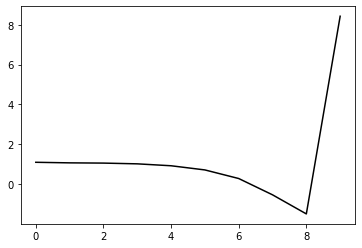

171600 0.18594838278619766
0.25283097381298625 -0.1430138051657636 -0.2277209278841267 -0.13686776742902146
[ 1.11911633  1.15340707  1.18023379  1.14700039  1.05003708  0.83875262
  0.40407706 -0.4201554  -1.38860183  8.40897106]


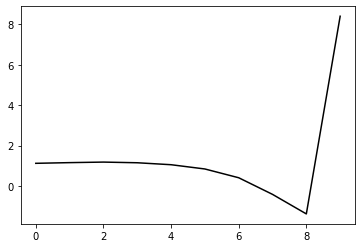

172700 0.16004447820506396
0.24767608884599557 -0.15142899149660619 -0.23320978299877432 -0.1335674304745549
[ 1.07971398  1.10516992  1.07718014  1.04215952  0.94426632  0.73212213
  0.29837392 -0.52423713 -1.49037111  8.41866682]


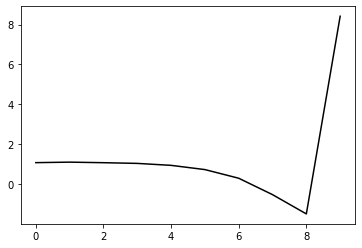

173800 0.1275874537336678
0.25155695227517727 -0.144343909138457 -0.2289185964061141 -0.13545415143729678
[ 1.11082051  1.15805693  1.15736194  1.12253156  1.031598    0.82573739
  0.3967445  -0.42410437 -1.39272348  8.42883786]


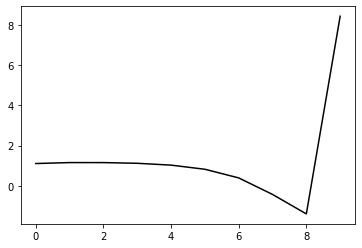

174900 0.1838105554971403
0.24573528232611971 -0.14547849099677165 -0.22838397157913032 -0.13492825486138924
[ 1.05991021  1.0035858   1.01013002  0.96625251  0.86020517  0.64257142
  0.20499769 -0.6223153  -1.59567426  8.44808973]


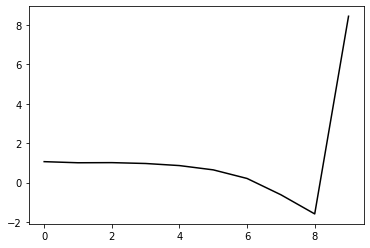

176000 0.20634548779525852
0.2471448393081552 -0.1455333308407144 -0.22858804320515894 -0.1361074780405794
[ 1.06403739  1.12390894  1.10002621  1.05305466  0.94532178  0.72511023
  0.28489685 -0.54587554 -1.52429438  8.40450258]


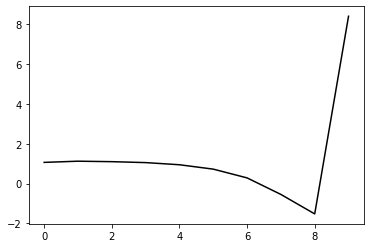

177100 0.19020549882806653
0.24947000519251217 -0.14388834585662102 -0.22797421687829744 -0.137364285077686
[ 1.08816846  1.14073343  1.1517576   1.11382664  1.01243001  0.79758497
  0.36237163 -0.46429443 -1.43982026  8.42869478]


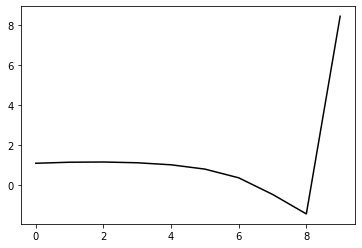

178200 0.15352499317855745
0.25088034286356775 -0.1431085196706042 -0.2276717557763825 -0.13781666977373247
[ 1.06934185  1.19287747  1.21573269  1.18705766  1.08880789  0.87547023
  0.44179173 -0.38381647 -1.35938558  8.40555953]


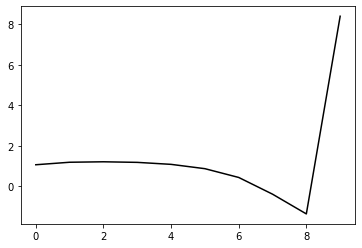

179300 0.18301860123143798
0.2533760619950242 -0.14303389116796308 -0.2282921008066968 -0.13692058215333128
[ 1.04996565  1.19762963  1.22420069  1.20040606  1.10367174  0.88931394
  0.45439382 -0.37298711 -1.35179263  8.46028472]


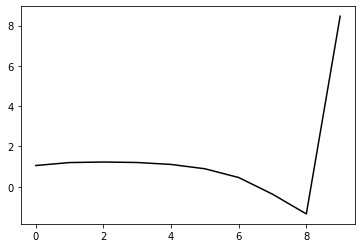

180400 0.22450307598500177
0.2502455383528409 -0.14076795699577688 -0.22572590623642147 -0.1396302925070006
[ 1.1295183   1.13212864  1.16329289  1.15018224  1.06421829  0.85760702
  0.42944091 -0.39169619 -1.36483467  8.40939324]


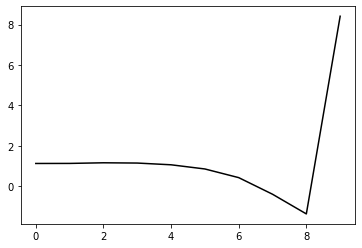

181500 0.2280007474814025
0.25075338956842497 -0.14474275058831654 -0.22891160219219722 -0.13711257262212717
[ 1.04535136  1.08724782  1.10290913  1.08510793  1.00013953  0.79426555
  0.36678763 -0.45331365 -1.42558603  8.45720147]


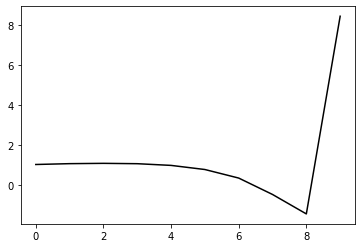

182600 0.1572556156024679
0.24977711166957473 -0.14571545466440022 -0.229482697079881 -0.136547078396231
[ 1.09626262  1.04937694  1.07110192  1.05885516  0.98256557  0.78483189
  0.36379473 -0.4509255  -1.41902775  8.3959307 ]


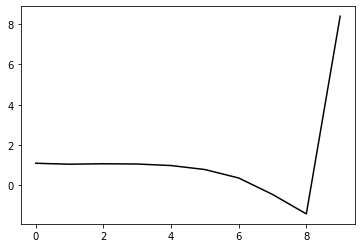

183700 0.12221921815837374
0.24692614968162951 -0.14619080696913717 -0.2290479283409443 -0.13814279651576275
[ 1.10756919  1.08665718  1.09859178  1.08866208  1.0172023   0.82525148
  0.40925613 -0.40068712 -1.36427912  8.44516975]


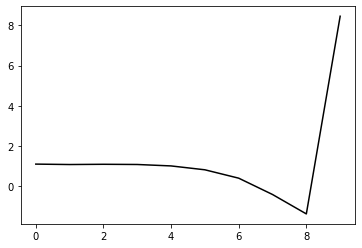

184800 0.12870994714845713
0.24713528413095864 -0.14478239269638019 -0.2279272569859213 -0.13886144274767548
[ 1.10562175  1.07520352  1.08295983  1.07166681  1.00263407  0.81480612
  0.4022507  -0.40517278 -1.36760622  8.42846758]


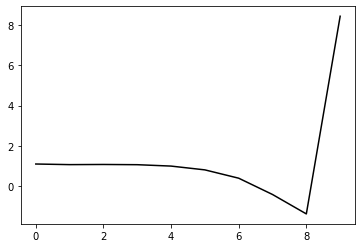

185900 0.1890562487072837
0.24989691359807614 -0.14426255044530137 -0.22829784797012162 -0.136989850813643
[ 1.0745785   1.07705364  1.07307186  1.05091618  0.9747564   0.78219132
  0.36482978 -0.44835662 -1.41856221  8.4409938 ]


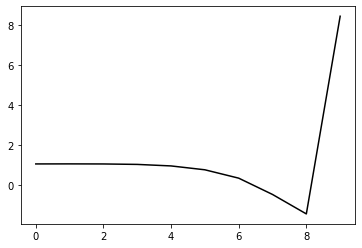

187000 0.20773381032210408
0.2517060485873921 -0.14398492177480082 -0.22855541198954527 -0.1357981531042053
[ 1.06831477  1.09298737  1.09244614  1.06843889  0.99067225  0.79863081
  0.38194713 -0.43137506 -1.40313597  8.41386042]


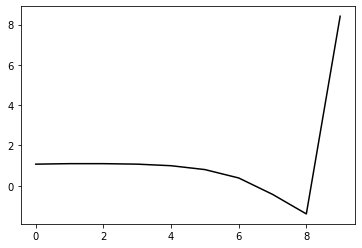

188100 0.18991153139219843
0.25125573062467627 -0.14351829458167742 -0.22805004408159837 -0.13633995879828445
[ 1.0912332   1.08732198  1.08858998  1.06850787  0.99467487  0.80772055
  0.39617247 -0.41294879 -1.38170362  8.4385447 ]


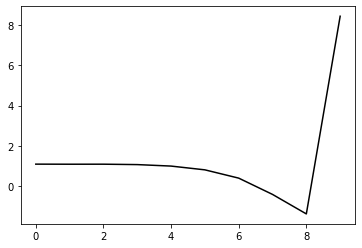

189200 0.1528125030904326
0.25318993943100604 -0.14206355709043686 -0.22747446467116308 -0.13631557577177192
[ 1.06746928  1.17032331  1.17310457  1.15099322  1.0762643   0.88959928
  0.47860582 -0.3309996  -1.30207635  8.41890474]


190300 0.18020238753119977
0.25402658945025186 -0.14299727983896668 -0.22842651397117444 -0.1362120335477957
[ 1.05372942  1.16994435  1.17085496  1.14905301  1.07639984  0.89317906
  0.48605806 -0.32063522 -1.29045537  8.4736401 ]


191400 0.18860069059484552
0.25254984570660444 -0.1410222353890285 -0.22653683813563227 -0.1379668417953011
[ 1.11898044  1.14871985  1.16108466  1.14112068  1.07202016  0.8939857
  0.49269338 -0.30880849 -1.27444926  8.41942884]


192500 0.23300965399160825
0.25239914548233044 -0.14329416553680588 -0.22831475960162215 -0.13566378297006648
[ 1.04226535  1.06522595  1.06588004  1.03802717  0.96276262  0.78215139
  0.3808392  -0.41996648 -1.38513684  8.45858735]


193600 0.15783452350334468
0.25046716667262303 -0.14420898711247487 -0.22851116148287062 -0.1357907783220859
[ 1.10864748  1.01705888  1.02433692  1.00341081  0.9349349   0.76214614
  0.36938719 -0.42363976 -1.38234782  8.40700265]


194700 0.14849577617202636
0.2477865123457012 -0.14205424923465187 -0.2261590502403442 -0.13769917196320844
[ 1.11831175  1.03631632  1.0378328   1.01610193  0.9459639   0.77325742
  0.38243509 -0.40857543 -1.36643404  8.44669961]


195800 0.1387469811187328
0.2483208248547561 -0.14375665129841175 -0.22766480658930874 -0.1382438870278516
[ 1.12537701  1.09324253  1.09201067  1.07567324  1.01430464  0.85089814
  0.47016642 -0.31137508 -1.26125582  8.4233325 ]


196900 0.18976543352038575
0.24784094626911382 -0.14646296361164451 -0.22956252943533134 -0.13689235909829736
[ 1.08154351  1.10396756  1.05871324  1.02071583  0.9482747   0.77708158
  0.39085089 -0.39528145 -1.35022346  8.43912048]


198000 0.2605125330502021
0.24865111319622926 -0.1501188434427104 -0.23261233280079996 -0.13383885678873197
[ 1.04678417  1.04983155  1.01918509  0.97376966  0.89775894  0.72864898
  0.34739246 -0.43274416 -1.3818098   8.41560468]


199100 0.2273987823633146
0.2482757529525945 -0.14536907495112886 -0.22870437622387518 -0.13804252828708127
[ 1.13103406  1.10226075  1.06941961  1.01657955  0.93486     0.76298339
  0.3806366  -0.40056813 -1.35199149  8.44318062]


200200 0.15700620963490627
0.2534700757065305 -0.14129893841121935 -0.22689464312726026 -0.1365207322087681
[ 1.06326209  1.20375765  1.18451307  1.11796153  1.01563994  0.82709343
  0.4317739  -0.36120354 -1.32561024  8.4106765 ]


201300 0.17394551345749507
0.25394668437688045 -0.14316146752929673 -0.22835354068291377 -0.13648309721251928
[ 1.05350966  1.18373422  1.18607089  1.13327062  1.03005554  0.84027851
  0.4470927  -0.34266431 -1.30476205  8.46026345]


202400 0.2099384820532303
0.25378855990125304 -0.1402984682168028 -0.2262029080129983 -0.13829892248590248
[ 1.12535     1.20459488  1.22739685  1.18616762  1.0858525   0.89482316
  0.50256092 -0.28541786 -1.24719554  8.42910959]


203500 0.2255187970858453
0.2524420033554793 -0.14424763904273638 -0.22890654654714676 -0.1362639107560492
[ 1.05147592  1.08825084  1.09855392  1.06577806  0.97012365  0.78031586
  0.39143289 -0.39132087 -1.3480935   8.46908378]


204600 0.15844921173384943
0.2511071951782317 -0.14595459487653492 -0.2299081799310251 -0.1352548838300861
[ 1.10779334  1.00776565  1.02707689  1.00303751  0.91663404  0.73154799
  0.34756901 -0.42910796 -1.38053496  8.40390822]


205700 0.14128361176072474
0.248133544786689 -0.1429283029675724 -0.22678009024719264 -0.1377903316461751
[ 1.11825161  1.04631282  1.05127687  1.02771962  0.94327126  0.75753261
  0.37294502 -0.40306122 -1.35487909  8.44841605]


206800 0.12785727198985786
0.24970505677281435 -0.1428882003212958 -0.22710920722015943 -0.13726854284207274
[ 1.08949557  1.10723609  1.09912474  1.06987029  0.98395757  0.79558461
  0.40817897 -0.36928921 -1.32361969  8.425789  ]


207900 0.19256996615525104
0.2512706519068867 -0.1441931788979054 -0.22841576141372008 -0.13605789392029594
[ 1.07396429  1.08465953  1.07775874  1.04628698  0.95964094  0.77053958
  0.38215392 -0.39500158 -1.34975251  8.44466346]


209000 0.2053657053854864
0.25266260736002166 -0.14468294913244759 -0.2292744805506005 -0.1346795810142365
[ 1.07185382  1.08158284  1.07385271  1.04326019  0.95909892  0.77256639
  0.38632417 -0.38775928 -1.34034186  8.42652035]


210100 0.18970174274398918
0.25213668294212954 -0.14308684316490605 -0.2279522025032389 -0.13514125005176844
[ 1.09806241  1.07696402  1.06729117  1.03719057  0.95539733  0.77132832
  0.38687483 -0.384833   -1.3361892   8.44494376]


211200 0.1614213561268586
0.25075244029091615 -0.14534472256562872 -0.2293043967309055 -0.13576722997335688
[ 1.0848611   1.1299432   1.11551724  1.08903813  1.01363346  0.83642772
  0.45834302 -0.30623819 -1.25071727  8.42865976]


212300 0.1809551156807704
0.2535020310484609 -0.14449391835822845 -0.22936555046653148 -0.13592064563605522
[ 1.0601842   1.17244761  1.16771422  1.13729337  1.05926186  0.88105679
  0.50195502 -0.26290685 -1.20855395  8.48471685]


213400 0.20584416176919382
0.2529222314767755 -0.1404654856551018 -0.2263299185753107 -0.1370707212553817
[ 1.13131262  1.16788198  1.16081925  1.12563081  1.04680574  0.86916837
  0.49033625 -0.27426253 -1.22136782  8.42075995]


214500 0.21290024607516186
0.2519717150736749 -0.1429181325260892 -0.22798002144949794 -0.13563169347248233
[ 1.06209985  1.0778159   1.07499643  1.03624291  0.95282173  0.77385134
  0.39537798 -0.36721368 -1.31190213  8.47002434]


215600 0.15780020050794602
0.24731056581570332 -0.14754804109396474 -0.2302531819337168 -0.13630044190080623
[ 1.09229118  1.07224978  1.03725839  1.00426304  0.93027302  0.76186163
  0.39512162 -0.35410016 -1.28387894  8.43902954]


216700 0.11454403368497627
0.25127695746922285 -0.14406418037011906 -0.22873583449404433 -0.1358522051630846
[ 1.10270021  1.16615811  1.168955    1.12998981  1.04780767  0.87262886
  0.49943546 -0.25642194 -1.1950774   8.45695383]


217800 0.12734295042563454
0.24319010095001667 -0.1478688826210243 -0.2300324048025256 -0.136410194909136
[ 1.11344255  1.07680226  1.05366978  1.02058344  0.94328675  0.77425658
  0.40875237 -0.33818243 -1.26753599  8.42267628]


218900 0.19056300416512828
0.24973160737089573 -0.14173852352704905 -0.2270516968685136 -0.1340400253495229
[ 1.11320257  1.0994903   1.07619938  1.02037697  0.92356179  0.73669982
  0.35493139 -0.40761683 -1.35467023  8.44487033]


220000 0.2057378961933831
0.24775365108670552 -0.14859731997955378 -0.23224631316530217 -0.13047885091326616
[ 1.10226746  0.98447992  0.99136082  0.94987554  0.85759015  0.67503439
  0.29866466 -0.45740915 -1.39776592  8.42613211]


221100 0.19455873379023467
0.24601172128179957 -0.14744498264274802 -0.2306645502167183 -0.1345434348137567
[ 1.10310888  1.09910257  1.09202186  1.05627545  0.9690255   0.78992206
  0.4178307  -0.3330519  -1.26839487  8.46880166]


222200 0.15179841669896174
0.2472224855957092 -0.14601332165918196 -0.2297400749842686 -0.13545677458605096
[ 1.10487533  1.21755655  1.19993761  1.16525102  1.08169199  0.90497448
  0.53571684 -0.21154569 -1.14397925  8.42820114]


223300 0.17510429064181698
0.2411520692894046 -0.1467766172105862 -0.2288290694922964 -0.13493533015254527
[ 1.09986562  1.03725101  1.01812541  0.97510585  0.88342393  0.70040234
  0.32708045 -0.42183732 -1.35468256  8.4518588 ]


224400 0.23582351714353242
0.24930419747543875 -0.13650461579256712 -0.2233433706335332 -0.1355398693247854
[ 1.12212764  1.15712323  1.15667003  1.10924269  1.01134713  0.82085816
  0.43960836 -0.31760454 -1.26112094  8.39440068]


225500 0.20915139635739907
0.24006190161202856 -0.14217227000987817 -0.22501610686786877 -0.13689471795549218
[ 1.09970584  1.10521979  1.07484469  1.02619503  0.92823907  0.73824355
  0.35896931 -0.39410736 -1.33150803  8.44887475]


226600 0.16509350951700827
0.24746182064025585 -0.14187205702964722 -0.22679185192143686 -0.1325760632770587
[ 1.08163317  1.04573022  1.04921824  0.9964391   0.89172428  0.69517249
  0.31022791 -0.4472371  -1.38916294  8.42616921]


227700 0.12494449189044195
0.24429452928014778 -0.14393755446682233 -0.22730078808661563 -0.13450121139511578
[ 1.05636355  1.12708014  1.10652264  1.0567087   0.95133113  0.75272356
  0.3664963  -0.3906189  -1.33152937  8.42781284]


228800 0.14807820866642155
0.2425338565149074 -0.14134186437066074 -0.22519723969528396 -0.13709857918275137
[ 1.11982155  1.102115    1.11696879  1.0845167   0.99191027  0.80279397
  0.42477257 -0.32410598 -1.25741433  8.46834266]


229900 0.1746280278474217
0.24152113311219012 -0.1431733916069427 -0.226280457971893 -0.13314034195474356
[ 1.08633835  1.05389167  1.00791571  0.95376002  0.84773239  0.64516337
  0.25497686 -0.50369361 -1.44552921  8.42986082]


231000 0.2066315068851292
0.24046611518558195 -0.14943906321032766 -0.23076523872484686 -0.1321267950512221
[ 1.06650755  1.03507254  1.0193151   0.97090779  0.8711638   0.67547348
  0.29226564 -0.4577089  -1.38941852  8.41880202]


232100 0.19501224922985894
0.2397076376307099 -0.14573674775958265 -0.22767435390849095 -0.13458697224679242
[ 1.10465996  1.1075499   1.08475636  1.03715182  0.93691498  0.74027095
  0.3553749  -0.3958489  -1.32974315  8.47235996]


233200 0.1592014964993886
0.2430958597765174 -0.14362672630967666 -0.22675220985925698 -0.13585900613774365
[ 1.0788144   1.17795599  1.18425502  1.14562656  1.0502001   0.85698001
  0.47449237 -0.27424601 -1.20647486  8.43803667]


234300 0.167774677144329
0.24517721185544317 -0.14383115527369073 -0.22739870993698896 -0.1349538816066814
[ 1.05403665  1.17588927  1.18414288  1.14489753  1.04565524  0.8476117
  0.46053134 -0.29147053 -1.22677084  8.47866432]


235400 0.19709775062284882
0.2438678941896644 -0.14136448359158574 -0.22533583867645376 -0.13654139643646981
[ 1.11914026  1.1550805   1.16725877  1.13623833  1.0440861   0.85047651
  0.46660286 -0.28198857 -1.21419281  8.42629484]


236500 0.23295475024941467
0.2455260093724456 -0.14318125300397344 -0.22727257513092622 -0.13371670258700402
[ 1.03934317  1.12819749  1.12978658  1.09661142  1.0042267   0.80969765
  0.42462631 -0.3241604  -1.25619563  8.48419851]


237600 0.17682913246383808
0.24473439188361804 -0.14472192883433546 -0.22820068221122403 -0.1329038332975699
[ 1.06074917  1.11674553  1.12347528  1.0903636   0.99850148  0.80409522
  0.41875116 -0.32898106 -1.25874708  8.41145117]


238700 0.13062542639208446
0.2365780961859018 -0.14774615820893122 -0.2287607935059182 -0.13607095584631407
[ 1.11434972  1.10414456  1.06230909  1.03152727  0.94809463  0.76105237
  0.38170035 -0.36007661 -1.28362662  8.4467316 ]


239800 0.13256726388970475
0.24283144749113822 -0.14549044221112797 -0.228549443800597 -0.1349932687931599
[ 1.09490369  1.15771377  1.14220359  1.09857132  1.00915796  0.81818651
  0.43431155 -0.31189346 -1.24030551  8.45394443]


240900 0.19532474400524782
0.24286257774671047 -0.14425005940874877 -0.2277142790208993 -0.13486177656434636
[ 1.06498356  1.10758915  1.11314204  1.07161815  0.9775128   0.78403533
  0.39782055 -0.35014824 -1.2799873   8.45285748]


242000 0.21588136055921872
0.2430646262291057 -0.14635521848125657 -0.2294273078389389 -0.13382788647481575
[ 1.06038129  1.11291235  1.11035807  1.07691163  0.98708016  0.7975731
  0.41524232 -0.32859509 -1.2540895   8.43412439]


243100 0.2661681610479469
0.23662818602264254 -0.14486900625901938 -0.2264539458477518 -0.13484622629649048
[ 1.15656129  0.90371469  0.89572287  0.85829816  0.76500339  0.5726425
  0.18861584 -0.55523724 -1.47870137  8.44317923]


244200 0.17601591210718187
0.24251369390041333 -0.14243713960050158 -0.22590809029246825 -0.13657725527755674
[ 1.08736347  1.21106129  1.17910305  1.12601818  1.0237059   0.82178647
  0.42758369 -0.32679875 -1.26182355  8.42331577]


245300 0.17376823446832465
0.23844428983552082 -0.14506614503829643 -0.22679921859286195 -0.1348584456690302
[ 1.09668641  1.04226596  1.02251119  0.96892024  0.86254929  0.65850726
  0.26338761 -0.49030262 -1.42264116  8.4347433 ]


246400 0.16804226523287658
0.24584571906174404 -0.1399713107371906 -0.2248629941079207 -0.13453604681483364
[ 1.06536277  1.1601099   1.16153202  1.1061146   0.9938013   0.78332044
  0.38150227 -0.37933624 -1.32009642  8.41198944]


247500 0.21596244529034508
0.23794736908590086 -0.1473275582263991 -0.22879344620772796 -0.13269524644401012
[ 1.11265881  1.02408761  0.99715094  0.95105914  0.84346454  0.63657894
  0.23897504 -0.51631462 -1.44926818  8.44099295]


248600 0.1753991392690615
0.2436205999604874 -0.14567571300764962 -0.2285638841225666 -0.1321686786005317
[ 1.08077245  1.06117564  1.05432309  1.00187879  0.89127267  0.68077398
  0.28007082 -0.47722203 -1.4110235   8.38691836]


249700 0.13933073305195806
0.2440055075477446 -0.14622594294211733 -0.22906091705398904 -0.13190505493026017
[ 1.08041126  1.03061146  1.03907932  0.99422397  0.88514657  0.67476054
  0.27405615 -0.48262008 -1.4150395   8.44623417]


250800 0.1286411492917683
0.24224854170102042 -0.14372242979271888 -0.2264790556060719 -0.13604112172580934
[ 1.08614895  1.13651264  1.14092676  1.1039717   1.00254634  0.79679544
  0.3997029  -0.35304633 -1.28066679  8.441326  ]


251900 0.1764699222598146
0.2396107433908914 -0.1438210642994855 -0.22586580266528672 -0.13478481504324097
[ 1.08791447  1.01355373  0.99948516  0.95981689  0.85499206  0.64477612
  0.24302515 -0.5135306  -1.4439931   8.44581582]


253000 0.2061136304067244
0.2451309093436057 -0.14510777768713312 -0.2282448015729935 -0.13351247302767638
[ 1.06427428  1.12633064  1.1215458   1.07917136  0.97431903  0.76277218
  0.35873644 -0.39981558 -1.33178057  8.41233323]


254100 0.1910329390552332
0.24463646352060478 -0.14423262392654634 -0.22737379629070903 -0.1346519404397739
[ 1.09636885  1.12222185  1.12870497  1.09373263  0.99384427  0.78579609
  0.38387409 -0.37252353 -1.3016869   8.44984854]


255200 0.1553501820765342
0.2450697233790305 -0.14396159339401357 -0.22722699290438397 -0.13574913790246018
[ 1.08276759  1.19085439  1.20697953  1.18016191  1.08620723  0.88200501
  0.48229247 -0.27201873 -1.19851498  8.43625878]


256300 0.1639521447627011
0.24660100891774947 -0.14294795334694868 -0.22689126762557996 -0.13480079652882132
[ 1.06179887  1.17305535  1.17676683  1.14562801  1.04964186  0.84232277
  0.43818936 -0.32074504 -1.25187388  8.46968784]


257400 0.2002537023284368
0.2376494744137076 -0.14630572753821303 -0.22747119819095432 -0.13457593701852855
[ 1.08615427  1.00087894  0.97233253  0.94276099  0.84970768  0.64549496
  0.24392719 -0.51166417 -1.43740676  8.40154168]


258500 0.22777952310644203
0.24618707866385064 -0.14430101549346336 -0.2278383923012977 -0.13520838829805687
[ 1.04497776  1.10614375  1.1051365   1.06690236  0.97308081  0.76864042
  0.3655642  -0.39189189 -1.3192111   8.48260056]


259600 0.1571827353045627
0.244860580441388 -0.1460186574531763 -0.22883689939269286 -0.13479578785072258
[ 1.09911057  1.06589057  1.0829074   1.05440943  0.96637411  0.76841692
  0.37038534 -0.38271574 -1.30514927  8.4102998 ]


260700 0.11846881186042366
0.24726362617044145 -0.14323513134321966 -0.22721880226420502 -0.13619746534145266
[ 1.09564952  1.14858487  1.18529258  1.16226036  1.07361565  0.87456638
  0.47453849 -0.28107899 -1.20573192  8.47387312]


261800 0.13985597335345692
0.2420619687965819 -0.14657526976332758 -0.22860070976357327 -0.1379604372421205
[ 1.13482981  1.12730224  1.12833891  1.12089551  1.05379466  0.87425797
  0.49197168 -0.24675401 -1.15310486  8.45774275]


262900 0.1824219461538869
0.23971958054838907 -0.14990491302854786 -0.23084129485837682 -0.13564093660210488
[ 1.08628536  1.05953714  1.0283206   1.00602575  0.9378363   0.75992054
  0.37869593 -0.3596707  -1.26580068  8.45306146]


264000 0.20844183314163825
0.24137982507299635 -0.14983471317183714 -0.2313579022899013 -0.13240336729629676
[ 1.07142409  1.01762991  0.98717046  0.9481669   0.87185286  0.6924957
  0.3104574  -0.42913318 -1.33617418  8.39663591]


265100 0.1916913614435028
0.24245253846155676 -0.14389275415523012 -0.22693316914089742 -0.13374455433065952
[ 1.10002496  1.12170838  1.07404986  1.00864195  0.90626849  0.70882148
  0.31138016 -0.44330697 -1.36481699  8.43348558]


266200 0.18470805776871327
0.23742134716945787 -0.1496913942144322 -0.22993460124343434 -0.13271705199461784
[ 1.09209074  1.03466208  1.01756883  0.9617958   0.85822908  0.66176372
  0.26736943 -0.48338858 -1.39869541  8.42538013]


267300 0.1818806684346812
0.2493687176827639 -0.14386215787283094 -0.2278643206107092 -0.13444422910397283
[ 1.05735823  1.2491249   1.25629282  1.19404753  1.07723408  0.86732409
  0.46092682 -0.30232791 -1.23137706  8.43565299]


268400 0.19821621973556824
0.2465745249006267 -0.14243370627981972 -0.22605402569601216 -0.13655309912337044
[ 1.12919145  1.1686416   1.20157987  1.16121945  1.0517885   0.84550255
  0.44380838 -0.31478205 -1.23851007  8.40566534]


269500 0.22793613225529452
0.24637419041759923 -0.14534695417860663 -0.22841393973152313 -0.13439673675470726
[ 1.05214188  1.09863678  1.11916553  1.08810411  0.98315683  0.77630297
  0.3754876  -0.38128474 -1.30200926  8.45775826]


270600 0.18731152054132458
0.24992172287300973 -0.14426740086615428 -0.22828004490903264 -0.13457239936461568
[ 1.05846917  1.19306502  1.23128995  1.20412765  1.10295182  0.89390219
  0.48995596 -0.26989648 -1.19355813  8.45706133]


271700 0.1265771572423898
0.24401044514477754 -0.14449268444565636 -0.22712269280138056 -0.13558756468374192
[ 1.11207142  1.09627496  1.09994198  1.07963152  0.98830741  0.78566588
  0.3873778  -0.36597036 -1.2813717   8.47882388]


272800 0.12705833401931646
0.2444248802341088 -0.14369872382311336 -0.22652724775805258 -0.1360102369067615
[ 1.09186628  1.11820448  1.11854425  1.09264609  1.00168759  0.7983614
  0.3979565  -0.35733705 -1.27422436  8.43324895]


273900 0.18532765947812924
0.2432078881721587 -0.1461693171138081 -0.2281453329473939 -0.1359551378488415
[ 1.09782605  1.03234758  1.0371328   1.01872681  0.93870025  0.74637126
  0.35532957 -0.39047764 -1.29641703  8.45470561]


275000 0.19097594642143906
0.24834216264468081 -0.14114731532903513 -0.22553002950086082 -0.13450875670281892
[ 1.08312855  1.17117015  1.16458937  1.120597    1.01943371  0.80774299
  0.39611389 -0.37111033 -1.30012394  8.40046872]


276100 0.18908062109361548
0.24921189623743847 -0.14058955194659128 -0.22581672178411305 -0.13371917461320182
[ 1.08148296  1.1458587   1.16444451  1.13429256  1.04012412  0.83491425
  0.42795995 -0.33592035 -1.26212023  8.46935404]


277200 0.1886825305709569
0.2514834464662647 -0.13905396007080384 -0.22579695122634114 -0.13162599093536173
[ 1.04044991  1.19227542  1.21659386  1.19572552  1.10664082  0.90394157
  0.49712188 -0.26872932 -1.19859574  8.42374127]


278300 0.18151200410231944
0.24817739479556247 -0.13753500675951358 -0.22463998614045588 -0.13064537813962238
[ 1.11183419  1.10392306  1.11593383  1.09868198  1.01495674  0.81563811
  0.41027134 -0.35561763 -1.28613834  8.47595907]


279400 0.16440047813614925
0.245635103674917 -0.13793479748061438 -0.224832824328751 -0.13030327735073113
[ 1.09007546  1.09442836  1.10701472  1.09088926  1.01153196  0.81565912
  0.41179339 -0.35403758 -1.2850436   8.40853473]


280500 0.23755312422178454
0.24404035366440735 -0.1425433764182338 -0.22797127482762702 -0.12916648584030258
[ 1.05815402  1.09287799  1.08485972  1.07142542  0.99988403  0.81261961
  0.41675186 -0.34107987 -1.26250267  8.48440523]


281600 0.18022550030856785
0.2421972964736457 -0.14741260971015982 -0.23130547298266224 -0.12793830585412622
[ 1.10996047  1.03565998  1.03200147  1.01437892  0.94804611  0.76858754
  0.38004675 -0.37080412 -1.28410324  8.424677  ]


282700 0.12902873536887025
0.2405337827534151 -0.14461619263378728 -0.22876111401019583 -0.13040837173853892
[ 1.13545986  1.0842246   1.08421425  1.06118545  0.99149657  0.81134861
  0.42105747 -0.33319576 -1.25091231  8.46832551]


283800 0.12635323934972742
0.23960626659008577 -0.14306033111592584 -0.22728588603453273 -0.1318149496819017
[ 1.11314309  1.12546099  1.12312034  1.09844835  1.02738942  0.84896506
  0.4604997  -0.29282766 -1.20969975  8.44349737]


284900 0.18820959553132052
0.2432383545789674 -0.14059386088428283 -0.22618094859829022 -0.13033894656274794
[ 1.11577596  1.10308689  1.0957815   1.05890198  0.97684939  0.79161822
  0.3981602  -0.36005698 -1.28119368  8.44458233]


286000 0.2709991885491979
0.2435277585308618 -0.1460040403839988 -0.2310410721193983 -0.12588621692084237
[ 1.05736217  1.04430706  1.05440123  1.03077265  0.95414756  0.77535552
  0.38881272 -0.36378672 -1.27979859  8.42643465]


287100 0.22185189862036986
0.2382642952477188 -0.14566266381243353 -0.22911719069741568 -0.12692243304060707
[ 1.13846703  1.02406556  0.9637684   0.91793878  0.83186249  0.64616178
  0.25519781 -0.50069059 -1.41821138  8.43081546]


288200 0.17607655083562332
0.2432521975564655 -0.14050483619295456 -0.2260803572136731 -0.1318553108357566
[ 1.11192248  1.24203984  1.24027754  1.1850041   1.08934181  0.89700092
  0.50021127 -0.26246987 -1.1877332   8.42801845]


289300 0.23910062402132773
0.23025161019434506 -0.14244807170334498 -0.22437437190231202 -0.13440805299416964
[ 1.13995995  0.9780529   0.93447869  0.8875417   0.79388381  0.60683386
  0.21873502 -0.5340436  -1.44716722  8.46307054]


290400 0.17840133120471663
0.239935036804485 -0.14472314765276703 -0.228465422860224 -0.13268341304953135
[ 1.14910482  1.15810551  1.1504682   1.09906347  1.00428034  0.81610843
  0.42780428 -0.32585708 -1.24061137  8.42473036]


291500 0.1879688689961354
0.243399106759228 -0.14273174511806355 -0.22830683984363337 -0.13051866400807144
[ 1.1151821   1.19068337  1.22395799  1.18187701  1.08152031  0.88664528
  0.49253274 -0.2679537  -1.19143811  8.47410298]


292600 0.17217256788071825
0.23763311868691003 -0.14892842466393372 -0.23204346907539536 -0.1279223192722827
[ 1.13184158  1.01178292  1.02203279  0.99510895  0.90293624  0.71389831
  0.32821534 -0.42231356 -1.3340136   8.41789527]


293700 0.11812322106326516
0.2419069896024092 -0.14398847515972668 -0.2294102030022268 -0.1289291904651256
[ 1.10396273  1.18730005  1.19394001  1.15915043  1.06210576  0.86380939
  0.46830088 -0.29297955 -1.21766642  8.47575976]


294800 0.12996365393743772
0.24039604563344646 -0.1418372097864185 -0.22780890245007987 -0.13062013979477372
[ 1.13708406  1.17996031  1.21642973  1.19795345  1.11111617  0.91928129
  0.52900134 -0.22790101 -1.14940881  8.45346436]


295900 0.1769569306794178
0.23386558270859256 -0.14765014806527635 -0.23064955176605306 -0.13046012784673466
[ 1.12526068  1.02108589  1.04200736  1.03419916  0.95749134  0.7733451
  0.3907197  -0.35750816 -1.26874844  8.48152719]


297000 0.21295808202289035
0.2407284409360809 -0.1447192643002616 -0.22990181689199377 -0.12791642590945032
[ 1.08484595  1.17450743  1.16005998  1.12651302  1.03664602  0.83929197
  0.44360641 -0.31699142 -1.24107386  8.44673484]


298100 0.18682705589150878
0.24460926012586112 -0.1372139345379146 -0.22522660619451113 -0.12821954628064036
[ 1.0871723   1.20738763  1.21563534  1.17219817  1.07042247  0.86174651
  0.45389737 -0.31883841 -1.2557358   8.46159097]


299200 0.1893424343684335
0.23539472135656953 -0.14791435878709697 -0.23157873359093062 -0.1260251673949972
[ 1.10725322  1.06508055  1.07802591  1.06379774  0.98407889  0.79631409
  0.40870206 -0.3432065  -1.25730237  8.42616658]


300300 0.20869223339524576
0.24302340483258594 -0.14427064362350925 -0.23068543438353922 -0.12499123476091586
[ 1.07255244  1.24150274  1.22418413  1.19113145  1.1017246   0.90300406
  0.50304331 -0.26223457 -1.19173126  8.48072924]


301400 0.19594365496802882
0.23308029013646972 -0.1466588391125679 -0.23009522190995696 -0.12660456376138404
[ 1.11228749  1.07632165  1.05949991  1.02388148  0.93263203  0.73422179
  0.3351537  -0.42791327 -1.35333122  8.41335628]


302500 0.2281135324705482
0.2347161686330201 -0.14292004943857767 -0.22716187555993494 -0.13070114711567765
[ 1.1504281   1.16312691  1.14781135  1.10409906  1.00714537  0.80418109
  0.40068931 -0.36634801 -1.29533457  8.47076241]


303600 0.2004572240248456
0.24200117877760907 -0.14220342029660799 -0.22858184980151233 -0.126020310180354
[ 1.07541981  1.16164124  1.16864391  1.11680505  1.00719692  0.79375893
  0.38071515 -0.39537039 -1.33362687  8.42469108]


304700 0.13056454831260608
0.238897134246989 -0.14405480859216 -0.22928589396871576 -0.12620823665538308
[ 1.12490186  1.12551474  1.14628816  1.11441999  1.0157934   0.81083325
  0.40551019 -0.36312971 -1.29343488  8.44444517]


305800 0.126683356150308
0.2397375798382952 -0.14330465651986135 -0.22903559469414325 -0.12850922766191475
[ 1.13871763  1.1948039   1.22939159  1.21450936  1.12857719  0.9317053
  0.53241331 -0.23144269 -1.15780289  8.43301611]


306900 0.18421415594654525
0.23925420600832734 -0.1411796668096911 -0.2279370985946109 -0.12662113470993458
[ 1.1323596   1.12253879  1.15264774  1.13858693  1.05106121  0.84991777
  0.4453761  -0.32421202 -1.25719978  8.44595894]


308000 0.20787075196161955
0.23820108734458373 -0.1460202044015077 -0.23185066327119547 -0.12270795326766575
[ 1.10999284  1.0623794   1.08855039  1.08197382  1.00280467  0.80752521
  0.40763287 -0.3573238  -1.28511721  8.43453951]


309100 0.19306097969849023
0.23679805581363417 -0.14305020440072685 -0.22922296811573417 -0.12452061295526233
[ 1.13723251  1.14400131  1.14184313  1.12492015  1.04436282  0.84690066
  0.44339358 -0.32563037 -1.25804272  8.47026348]


310200 0.3331790065353716
0.22567499975832628 -0.13649903638947136 -0.22143857838627573 -0.1292925220002297
[ 1.206977    0.98408912  0.95825057  0.93154167  0.84843162  0.65045142
  0.24608702 -0.52327898 -1.45481848  8.36845584]


311300 0.15382166162489347
0.2348498295067964 -0.1474087450438689 -0.23200934576986856 -0.1250082891105799
[ 1.10823755  1.17873697  1.1367718   1.0967732   1.01251567  0.81589422
  0.41249126 -0.35579226 -1.28551534  8.45452175]


312400 0.16872849070965407
0.24136852382760207 -0.14117731608159517 -0.228916681178965 -0.12643147106889455
[ 1.12295852  1.26417426  1.28034829  1.23289484  1.13776509  0.9346336
  0.52447934 -0.25115493 -1.18876575  8.44771215]


313500 0.1995967055569499
0.23381890716904305 -0.1467390319832803 -0.2308081561257149 -0.12720475620309857
[ 1.13775691  1.17076994  1.16854473  1.13264026  1.03892535  0.83967079
  0.4350356  -0.33340007 -1.26062553  8.41929807]


314600 0.1686787814781877
0.23956237459658442 -0.1418946129656443 -0.2282471586370823 -0.1268807392679522
[ 1.08751408  1.19906686  1.19706663  1.14286407  1.02988588  0.81357801
  0.39417382 -0.3882555  -1.32961391  8.44370354]


315700 0.12195179510195321
0.23889983287018138 -0.14123625564559636 -0.2276374069075695 -0.12741782351546596
[ 1.12922644  1.15000239  1.20391303  1.17915799  1.07827728  0.8693753
  0.45630295 -0.32096334 -1.25753394  8.44815803]


316800 0.12639801363812575
0.23728137364610022 -0.1420631453775937 -0.22757880652454754 -0.12993897963360962
[ 1.12361922  1.2006033   1.20659727  1.18409171  1.08606011  0.87631241
  0.46258711 -0.31486993 -1.25066552  8.45177067]


317900 0.21773233645466805
0.24190857449251468 -0.1421959925539819 -0.22885660316853634 -0.12702561902860174
[ 1.05834076  1.13358455  1.15716169  1.12942153  1.02922851  0.81534224
  0.39754325 -0.3833965  -1.32199038  8.46517955]


319000 0.27064889410717674
0.2412230519960297 -0.14628134340563628 -0.23168944405354833 -0.12512756634533734
[ 1.0618727   1.05828889  1.0843554   1.0667922   0.97621122  0.76979942
  0.35875777 -0.41487726 -1.34444545  8.39801897]


320100 0.1948108276292871
0.23916076215316148 -0.14320509281185045 -0.2287203083231451 -0.12951845773933743
[ 1.12934767  1.16369911  1.15669866  1.13204061  1.04197419  0.8345657
  0.42110486 -0.35558358 -1.28861755  8.44937126]


321200 0.15816627302853276
0.24111774700688704 -0.14167648842567115 -0.22803467982613804 -0.13015058469639804
[ 1.0990435   1.21427512  1.22665884  1.20320918  1.11624068  0.91186646
  0.4996964  -0.27673639 -1.21028649  8.43751108]


322300 0.1745981531038526
0.23976055092141613 -0.14199980834957102 -0.22786017707515963 -0.1311804746145734
[ 1.10377669  1.14113452  1.1593672   1.13881406  1.05382895  0.85219889
  0.44195662 -0.33267699 -1.26376766  8.48064946]


323400 0.1998059135905287
0.23718854014685217 -0.14180047653428138 -0.22716142334383366 -0.1285182023203244
[ 1.09431637  1.06811823  1.05099614  1.01997253  0.92470755  0.71395894
  0.29475878 -0.48857908 -1.42801223  8.39554544]


324500 0.21812930398336322
0.24293312863070446 -0.14134665139663313 -0.22798221023361961 -0.13039683802307986
[ 1.07245291  1.15456392  1.15730789  1.13011318  1.04262306  0.8394515
  0.42661691 -0.35103027 -1.28441967  8.48493718]


325600 0.15358989165850728
0.24078385376297667 -0.14420345643283153 -0.2295016594254855 -0.1326497002193384
[ 1.08628364  1.10328271  1.12964783  1.11738793  1.04419995  0.85588241
  0.45719422 -0.30625335 -1.22334259  8.44899063]


326700 0.12740839135167206
0.2376600731512018 -0.14586558817523687 -0.22981320333338703 -0.13336795346133468
[ 1.12599325  1.10185396  1.11733241  1.10312745  1.0296425   0.84185708
  0.44317805 -0.32107215 -1.23942079  8.46752604]


327800 0.13892546276836162
0.24076787132181485 -0.14271691909090806 -0.22814053806040763 -0.12936299277413318
[ 1.12499335  1.06072635  1.04378273  1.00541238  0.91533909  0.71475196
  0.30447775 -0.4712432  -1.40105641  8.42988429]


328900 0.1733598102295793
0.2396051880940839 -0.14256969964718538 -0.2278938913852244 -0.12973481788791172
[ 1.09699443  1.0560546   1.04059082  0.99794222  0.9036527   0.70142242
  0.28958543 -0.48856457 -1.42104096  8.43342921]


330000 0.2129835742829757
0.2398414332954318 -0.1431726520931558 -0.22853088193024515 -0.1297452531293114
[ 1.09815297  1.10282335  1.09880745  1.06137073  0.96806294  0.76727178
  0.35650794 -0.42205557 -1.35604336  8.41030318]


331100 0.19165329315723773
0.24240804698090063 -0.14221356241522348 -0.22838238997775576 -0.1300422405553247
[ 1.11939115  1.15408548  1.16513909  1.134446    1.04419477  0.84586587
  0.43756722 -0.33947479 -1.27236701  8.45876773]


332200 0.15616331513419812
0.24302571308795184 -0.14157256059203147 -0.22800161430773108 -0.13087600263461063
[ 1.10039151  1.2138293   1.23595612  1.21267184  1.12546092  0.92879999
  0.52233743 -0.25357462 -1.18562466  8.43639804]


333300 0.21394157562033905
0.23341604697323853 -0.14031099453258744 -0.22468372061313568 -0.132579138326975
[ 1.12975097  0.95934999  0.9438032   0.91996757  0.83051046  0.63154204
  0.22442108 -0.55128088 -1.48172751  8.43934001]


334400 0.28720618373324097
0.24393523065958797 -0.1378895566963875 -0.22522745514594575 -0.13319163813569534
[ 1.163453    1.18623611  1.19661342  1.16643953  1.07855208  0.87963724
  0.47161221 -0.30597519 -1.23915652  8.41928937]


335500 0.24966596079196265
0.24580868652393023 -0.1401456532158409 -0.22781719281269083 -0.12779337672665533
[ 1.05024067  1.0840899   1.08198277  1.03732419  0.93540282  0.72549334
  0.30831269 -0.47746928 -1.41818413  8.46083858]


336600 0.1509884827429458
0.24252425750497725 -0.1440590084414983 -0.22958863024743742 -0.13134799006834752
[ 1.10739655  1.19376072  1.19060972  1.16249095  1.07849488  0.8850793
  0.4831666  -0.28812275 -1.21353383  8.4412547 ]


337700 0.11491088615986776
0.24287904939413463 -0.14367283568176564 -0.2295851606071757 -0.13120156635566285
[ 1.1147941   1.17596434  1.18630305  1.1628399   1.08200431  0.89200927
  0.49300275 -0.27630107 -1.2005084   8.46624304]


338800 0.14134871051357406
0.23967123942125756 -0.14293708850695172 -0.22807884007917836 -0.13131936058397553
[ 1.14478187  1.13380997  1.10879681  1.07401498  0.98858449  0.79593298
  0.39533641 -0.37499926 -1.29947796  8.41676304]


339900 0.1824575127256619
0.24136014935429362 -0.14256648055582455 -0.22849276849617584 -0.12949154193384077
[ 1.09279678  1.07908123  1.0710246   1.03069921  0.93962555  0.74372113
  0.34023699 -0.43361597 -1.36247836  8.44867148]


341000 0.2232686231834743
0.2440916319164304 -0.14415833392908003 -0.23030875692199326 -0.12822856266936128
[ 1.06846057  1.12389812  1.12398419  1.08847205  0.99871988  0.80509432
  0.40472176 -0.36604343 -1.29165199  8.43056768]


342100 0.19576178047690118
0.2428349983043083 -0.14055309890468848 -0.2272002496808991 -0.1276074006044556
[ 1.09083123  1.16569104  1.12463577  1.0638031   0.95457536  0.7438156
  0.32884952 -0.45509027 -1.39288366  8.4309865 ]


343200 0.16586338077729804
0.24296147096307547 -0.14139417133273782 -0.22763985634557418 -0.13091992612139522
[ 1.10393487  1.21874134  1.21829221  1.17488617  1.07828746  0.87978016
  0.47646347 -0.29710562 -1.22556647  8.43571321]


344300 0.15730506797780622
0.24024098570606897 -0.14477898581842155 -0.22961514564902022 -0.1296393650421739
[ 1.06661151  1.0912233   1.07473926  1.02683644  0.92287014  0.71887552
  0.31289294 -0.46150773 -1.38914102  8.46678954]


345400 0.19775262026315257
0.2451561479830526 -0.1384028420843633 -0.2256216409903255 -0.13139430702070615
[ 1.13867939  1.19331892  1.21015205  1.16402353  1.05885657  0.85139772
  0.44182256 -0.33661947 -1.2690848   8.41783421]


346500 0.2095374552309318
0.23767228570631446 -0.14378607543819208 -0.22802440314921724 -0.1305263307264371
[ 1.12333646  1.07746415  1.04420361  0.99900135  0.89423848  0.68765677
  0.28133738 -0.49188196 -1.41704104  8.43818225]


347600 0.1621714260321816
0.24441292181075544 -0.1443034591196673 -0.22988190759171043 -0.1295524298413772
[ 1.11449115  1.07904938  1.09157985  1.04585182  0.94108447  0.73381199
  0.32716939 -0.44600784 -1.37112445  8.39883008]


348700 0.11651422706403324
0.24554923030961714 -0.14221813213114243 -0.22834805434938904 -0.13261885092650683
[ 1.11071395  1.18320981  1.22308417  1.19552556  1.09728799  0.89282235
  0.48806801 -0.28360606 -1.2078955   8.48052729]


349800 0.12756631926455175
0.24344678688987503 -0.14142613002147758 -0.22703885173935479 -0.13196936119917502
[ 1.1155702   1.15707521  1.13141477  1.09176345  0.9881414   0.77690611
  0.36662793 -0.40879766 -1.33554414  8.42546059]


350900 0.17834074393869037
0.24309651462491402 -0.14375561007969262 -0.2288507133338614 -0.13118893838943696
[ 1.11105111  1.08373554  1.08964244  1.0553098   0.9568984   0.74961168
  0.3422449  -0.43014728 -1.35374401  8.4492849 ]


352000 0.21984582388735174
0.24114635073836035 -0.1440219390352804 -0.22882411068124311 -0.13210146068982218
[ 1.11513434  1.11022215  1.12019894  1.09490214  1.00122208  0.79602228
  0.38871678 -0.3847571  -1.31110736  8.41332425]


353100 0.2062278440190192
0.24104916271443722 -0.145490285040752 -0.23030504347717493 -0.12944068106137768
[ 1.09625176  1.05831452  1.0648994   1.04632608  0.95949206  0.7589218
  0.35458831 -0.41642158 -1.34074059  8.45020653]


354200 0.2974432107222974
0.2315737051906009 -0.14011882552788438 -0.22361985649323946 -0.13659432989922557
[ 1.18050298  0.9820604   0.96835967  0.9473903   0.86552177  0.66997427
  0.27013507 -0.4957205  -1.41368295  8.40098172]


355300 0.17169295433859083
0.2451866062619248 -0.1456228773368713 -0.23148367621356625 -0.13078238196154873
[ 1.08153817  1.22772686  1.21672961  1.18007335  1.09028182  0.88723576
  0.47806375 -0.29859997 -1.22975292  8.48199023]


356400 0.2641798679738051
0.2456827678137306 -0.13640923377682856 -0.22524993497105122 -0.13155809109579025
[ 1.1641171   1.17603043  1.18625233  1.1474885   1.05275639  0.84612419
  0.43161692 -0.35204494 -1.29233237  8.415839  ]


357500 0.21755629511438168
0.23721721104319826 -0.14590333208755063 -0.23049695651057642 -0.128834345601802
[ 1.12996753  1.04690192  1.02099425  0.98749479  0.8972287   0.69664385
  0.28875507 -0.48727131 -1.41774314  8.43606442]


358600 0.17442515204998682
0.24269157651426085 -0.14390902145839451 -0.2299972067970448 -0.13007185100806049
[ 1.08464461  1.14481334  1.1287067   1.08200942  0.98321631  0.77632336
  0.36274361 -0.41862751 -1.35423716  8.43188975]


359700 0.13099834051977405
0.2416061304976713 -0.1467669259025733 -0.23185641961056425 -0.13027379353573662
[ 1.13031047  1.13551951  1.13702473  1.0991883   1.00439884  0.80229433
  0.39329416 -0.38391753 -1.31524052  8.48133634]


360800 0.13534498051204968
0.2460519650665986 -0.14108602171391438 -0.22876687556873374 -0.1292360535905711
[ 1.11773054  1.19195755  1.19673829  1.15034073  1.04492883  0.83263102
  0.41378484 -0.37392393 -1.31720369  8.44547653]


361900 0.1678538155929062
0.23577332426023515 -0.14278752303018963 -0.22770181461055752 -0.1277119589381076
[ 1.10657181  0.99580115  0.99787303  0.95074274  0.83683752  0.61619091
  0.19022196 -0.60412295 -1.55386151  8.40537147]


363000 0.20706269804781752
0.24081317087852203 -0.14594037444099936 -0.23102179576729823 -0.13033070668728103
[ 1.0841006   1.13799265  1.14935988  1.11695658  1.01555222  0.80448599
  0.38770367 -0.39721159 -1.33617486  8.43690574]


364100 0.1998391766352483
0.239271877967564 -0.14464330575809975 -0.2298869092156898 -0.1308168341194404
[ 1.13228281  1.06680641  1.10061362  1.08316294  0.99119079  0.78598521
  0.37370042 -0.4077505  -1.34411087  8.42816267]


365200 0.17956191608390137
0.24303598553752795 -0.14423610467603956 -0.23055948927191638 -0.12948343415161506
[ 1.07613873  1.14139651  1.16517998  1.15053913  1.06042072  0.85399891
  0.43950048 -0.34463302 -1.2843368   8.41879352]


366300 0.1697926066075638
0.2412115489699458 -0.1419122008876524 -0.22817375675501989 -0.13238725460344963
[ 1.08604158  1.12336072  1.13169446  1.1139312   1.02705339  0.82249525
  0.40905828 -0.37414982 -1.31301299  8.47690533]


367400 0.16867681602342535
0.2420663293512829 -0.1424884845380359 -0.2289253170834894 -0.13248838836693072
[ 1.14133998  1.15065703  1.17058749  1.15938436  1.0824912   0.88654146
  0.47963893 -0.29791272 -1.23128833  8.43168107]


368500 0.2213477315262834
0.23452233926302846 -0.14372728405341123 -0.22812741798745406 -0.13297135782735836
[ 1.14598517  1.03586141  1.00909754  0.99347849  0.91997613  0.72842945
  0.32486125 -0.44966183 -1.37961536  8.43875632]


369600 0.20945400464121552
0.2400715972825044 -0.14551796608431242 -0.23086507714075152 -0.13051901172607136
[ 1.06651446  1.13824046  1.1055913   1.0670762   0.9875549   0.7955014
  0.39130514 -0.38377178 -1.31364261  8.49752908]


370700 0.16180420094234463
0.23781397479858074 -0.1407487551974192 -0.22651769306985836 -0.1334127120918241
[ 1.13631411  1.12542106  1.12308183  1.08118957  0.99718933  0.80618997
  0.40322438 -0.3711997  -1.30038104  8.4534093 ]


371800 0.13452445763418033
0.24219999978867943 -0.14139710497569072 -0.22806145165654493 -0.1307798778911398
[ 1.10529226  1.16792476  1.16645043  1.1192091   1.02316351  0.82410129
  0.41489255 -0.36584557 -1.30160637  8.43483556]


372900 0.19237723407430415
0.24106601773500325 -0.14197721082019127 -0.22877741833154594 -0.12863466923616942
[ 1.05453777  0.97455191  1.00207856  0.9710439   0.87836256  0.68312467
  0.27925343 -0.49645288 -1.42709555  8.44125159]


374000 0.20229352750892077
0.24390612528475186 -0.13985283967142917 -0.2272005881578421 -0.1302130727485817
[ 1.09656186  1.18372273  1.15988136  1.11471952  1.01253406  0.80642297
  0.39280651 -0.39268821 -1.33373312  8.41786529]


375100 0.21010334905935063
0.23963691264335535 -0.1454415880282001 -0.23036240563711063 -0.12909335920373038
[ 1.11505154  1.01453164  1.01409213  0.98051742  0.88808177  0.69166535
  0.28912934 -0.48431593 -1.41128001  8.4298033 ]


376200 0.16833959173551077
0.24723481546073894 -0.1386713917311213 -0.22704606337762775 -0.12961436889122416
[ 1.06569377  1.24262522  1.23946763  1.19349495  1.08866877  0.87804029
  0.46082257 -0.32873369 -1.27468064  8.41400424]


377300 0.1756569102421747
0.24051428577164005 -0.14019073154936454 -0.2267389741008876 -0.13169849830538494
[ 1.10804408  1.10265899  1.11282426  1.08140339  0.98574918  0.78333491
  0.37468478 -0.40602487 -1.34236245  8.44582229]


378400 0.24339671918204145
0.23476004132372896 -0.14630998693923322 -0.22988113573508437 -0.13398868348982573
[ 1.1943896   1.06144733  1.06874219  1.0554077   0.97831117  0.79263651
  0.40082034 -0.36236242 -1.27919402  8.4408054 ]


379500 0.2249120110923923
0.23300536007267258 -0.14499642180353453 -0.2285726387834283 -0.1330688682000297
[ 1.15323311  1.08088024  1.03251567  0.99374966  0.90725517  0.7131591
  0.31312981 -0.45826165 -1.38400017  8.44370025]


380600 0.19472553627450132
0.2369116725015926 -0.14706594869344963 -0.23127597333721664 -0.12888260941420243
[ 1.09135181  1.10234121  1.06713474  1.00278112  0.89864295  0.69329725
  0.28366403 -0.49640218 -1.43061215  8.37479699]


381700 0.1146803302093019
0.2431976264106131 -0.14214468881370915 -0.22875276253949714 -0.1303874929388353
[ 1.11102561  1.23476067  1.24919587  1.19191365  1.08198497  0.87224194
  0.45839842 -0.32673268 -1.26753857  8.4613498 ]


382800 0.146467451652433
0.23731558437061323 -0.1454748025675125 -0.23022278395796258 -0.12850564307036388
[ 1.12680642  1.10615125  1.08207396  1.03380243  0.92588513  0.71731138
  0.30635542 -0.47492081 -1.41072891  8.43436658]


383900 0.18792391901116157
0.240725652350721 -0.14379563283040145 -0.23006519952277465 -0.12877442488970164
[ 1.08033479  1.06143906  1.0968546   1.06007812  0.95940204  0.7551839
  0.34797155 -0.4304614  -1.3645807   8.41692786]


385000 0.20273257510244003
0.2419155331455534 -0.14371702340580267 -0.2299872000001151 -0.1269587288942968
[ 1.09526409  1.1571775   1.12917396  1.07818963  0.9669442   0.75172888
  0.33513648 -0.45143546 -1.39324753  8.41220315]


386100 0.19010407358509204
0.2410329340993087 -0.14220337282936046 -0.22836478553853856 -0.12895158027000614
[ 1.11889356  1.16731611  1.16357113  1.11419401  1.00221736  0.78552743
  0.36801364 -0.41871879 -1.36034225  8.43964179]


387200 0.17357483765839285
0.2409647056971794 -0.14232185308556136 -0.22804724369344923 -0.12970618012702007
[ 1.10072453  1.21470573  1.20397883  1.15652205  1.0424358   0.82222523
  0.40168779 -0.38702666 -1.3297215   8.41691441]


388300 0.19025226038899942
0.2297064093237903 -0.14597055041081172 -0.2286392934617778 -0.13212364427464363
[ 1.12294651  0.98595829  0.98056383  0.9454741   0.84128876  0.62888423
  0.21601349 -0.56424146 -1.49714439  8.43768185]


389400 0.1660677548696633
0.24211240126549094 -0.1447976114435831 -0.23021163223899502 -0.13162366068071735
[ 1.1438667   1.21605065  1.226236    1.18402251  1.076033    0.85814047
  0.43922702 -0.3469181  -1.28626968  8.4126895 ]


390500 0.18805983729913153
0.2459420491835841 -0.1402875556216635 -0.22780001233056127 -0.13045843946082236
[ 1.10401098  1.21741357  1.27150127  1.23801675  1.12579963  0.90137258
  0.47511874 -0.31846911 -1.26640021  8.45795234]


391600 0.18060493660034227
0.24144740308240825 -0.14408083789527054 -0.2297398871547448 -0.12908108413233105
[ 1.0843661   1.13102359  1.14229817  1.11071406  0.99491214  0.76374307
  0.33132914 -0.4665682  -1.41717424  8.40328897]


392700 0.14833091993721345
0.24211404452601096 -0.14402071532245844 -0.2298254910919563 -0.12740465680377236
[ 1.13220037  1.03248751  1.04826816  1.01694283  0.9052627   0.67383949
  0.23947535 -0.55996519 -1.51158023  8.42141789]


393800 0.13673463331104205
0.24405713603111073 -0.142096083268394 -0.22826322220592335 -0.1307622850359501
[ 1.10737971  1.18155769  1.19507992  1.16227929  1.05369946  0.82319718
  0.38838112 -0.41041854 -1.35975132  8.42608902]


394900 0.17041504172853367
0.2374775119348724 -0.14352354085263855 -0.22797403219479428 -0.12984381493255373
[ 1.09151415  1.03040312  1.0417682   1.00847826  0.89717759  0.66299731
  0.22270997 -0.58169821 -1.53696448  8.40920608]


396000 0.2186444053390375
0.23278285124911005 -0.14955383508540168 -0.23145430035494247 -0.13089099874616827
[ 1.11573329  0.97371979  0.97263918  0.95469704  0.86316914  0.6470818
  0.22285962 -0.56495764 -1.50096555  8.42506095]


397100 0.2103217399186435
0.24049391250593916 -0.143979223820411 -0.22861479599897291 -0.13367347672403318
[ 1.13178065  1.14936286  1.16438503  1.14086701  1.04973576  0.83355148
  0.40650563 -0.38545419 -1.32688823  8.45043549]


398200 0.16400147621859007
0.24396700239222868 -0.14031590144433786 -0.22657062071972642 -0.1322222355522988
[ 1.07334467  1.20451596  1.21447442  1.18016191  1.07688663  0.850141
  0.41146706 -0.39216122 -1.34522768  8.41931284]


399300 0.16528704305380518
0.24500062262356037 -0.1410855966568462 -0.22745572375859147 -0.13251659724226467
[ 1.06257325  1.19711917  1.22251565  1.19806429  1.10077639  0.8791716
  0.44339339 -0.3584765  -1.30991285  8.46311599]


400400 0.22130280681967782
0.24282462257448004 -0.13928861542674356 -0.2254803617270638 -0.1350546796340653
[ 1.1379364   1.157087    1.19612286  1.18331657  1.09709341  0.88519936
  0.45679659 -0.33890823 -1.28380582  8.41540227]


401500 0.2207849904445021
0.24333843649070933 -0.1427303429135295 -0.22820695279044345 -0.13311796267874967
[ 1.06028837  1.10375304  1.12950333  1.11444735  1.02934308  0.81938274
  0.39214503 -0.40261892 -1.3456298   8.47201677]


402600 0.17594655949473548
0.23953192219334737 -0.14511419621140081 -0.22909020738161318 -0.13380156959301404
[ 1.12989388  1.04584738  1.05575604  1.0523093   0.98342195  0.78898503
  0.37504436 -0.40780872 -1.33834086  8.41707121]


403700 0.12277709611856973
0.24113218705843906 -0.1413214092085768 -0.22634419380673101 -0.1334261963947812
[ 1.08542506  1.12840652  1.0973825   1.06100935  0.97287116  0.76397171
  0.33633947 -0.46002368 -1.40375884  8.43932548]


404800 0.127865516131348
0.23958068581341618 -0.14253962167812195 -0.22687350803420606 -0.13430418511473954
[ 1.09828873  1.09740181  1.09934959  1.06955445  0.98534415  0.78439553
  0.36384988 -0.42685328 -1.3646059   8.41641303]


405900 0.19122846533727822
0.24215452218581843 -0.1434505800270001 -0.22809720227394029 -0.13389052917884994
[ 1.07629112  1.13671639  1.12742744  1.09090011  1.00201749  0.80000663
  0.3794031  -0.41212527 -1.35036916  8.44151103]


407000 0.21138380682038233
0.24156471232823587 -0.1434339491231211 -0.22803886582096064 -0.13290093638606665
[ 1.08301706  1.08542447  1.08323228  1.05054536  0.95908921  0.75676793
  0.3371147  -0.45435611 -1.392443    8.41760618]


408100 0.1899779165404264
0.24353364964033614 -0.1425296367048539 -0.22767256223177101 -0.1333240243940504
[ 1.09690886  1.13204053  1.14561034  1.11884382  1.0295196   0.82819787
  0.40972763 -0.38202205 -1.32111218  8.45660536]


409200 0.15265844533645564
0.2453022749378935 -0.1415019078469934 -0.22722078988464953 -0.13362354109971106
[ 1.07062091  1.19181681  1.21637648  1.19647597  1.1093703   0.90869069
  0.49129772 -0.30024397 -1.23947096  8.42460562]


410300 0.17861340484101385
0.24223245681683922 -0.14095899832246347 -0.22617664893679335 -0.13472355120871438
[ 1.09112969  1.09536955  1.10105778  1.08658819  1.00764958  0.81310932
  0.40135594 -0.38603696 -1.32208552  8.47137354]


411400 0.20660879659837444
0.23542324359047714 -0.14926045739938573 -0.23096619300035134 -0.13180934716330148
[ 1.0816159   0.98465881  0.94445468  0.92408681  0.8486084   0.65914792
  0.25366898 -0.5266156  -1.45360763  8.3890614 ]


412500 0.2086887205451054
0.24297096952088487 -0.14306252123775715 -0.227810920332513 -0.13472992447989413
[ 1.06397281  1.10770315  1.0986495   1.06193924  0.98069348  0.788163
  0.37943411 -0.40508572 -1.33736583  8.47282549]


413600 0.1994547069800739
0.24221040772691554 -0.14297073254400738 -0.22769896547062082 -0.13448757575547102
[ 1.13444687  1.07188287  1.08709746  1.05853183  0.98049729  0.79327462
  0.3894443  -0.39157695 -1.3212269   8.41908376]


414700 0.13946882407468472
0.24292922846560083 -0.14377489316600517 -0.22866631056205017 -0.13123608121474384
[ 1.10931513  1.01327368  1.01621444  0.98002855  0.89124632  0.69600136
  0.28577732 -0.50204867 -1.43946175  8.43302991]


415800 0.1266141293733573
0.24108322507359614 -0.14174497384173734 -0.2266546994585429 -0.1346306364978576
[ 1.09612623  1.12722919  1.12628918  1.09487643  1.00920888  0.81695187
  0.41008639 -0.37525323 -1.31087868  8.43255598]


416900 0.18134561276858635
0.2417852506298662 -0.14335190238586984 -0.22817149160514266 -0.1328006608873122
[ 1.08832727  1.07035696  1.06362636  1.03273417  0.94761556  0.75660317
  0.35218268 -0.43100089 -1.36478315  8.44515766]


418000 0.20542822091944166
0.24182001607665887 -0.14573164581892303 -0.22990766646454489 -0.13286959406105464
[ 1.07101267  1.09631664  1.09861724  1.07322452  0.9916995   0.80414427
  0.40376638 -0.37598602 -1.30702614  8.42424986]


419100 0.19611705162895135
0.2426667702779647 -0.1435567588688702 -0.22842957671689332 -0.13347431261462764
[ 1.11534278  1.11570743  1.12157356  1.09915597  1.02084837  0.83578085
  0.43803216 -0.33998276 -1.27050513  8.45600643]


420200 0.19814243847751892
0.23968064661706384 -0.14170056801530648 -0.22639047347036073 -0.13617602929568842
[ 1.13616243  1.09922835  1.12398324  1.11835568  1.0511981   0.87574797
  0.4874037  -0.28195662 -1.20440343  8.43468765]


421300 0.18170725002094595
0.2458320292000041 -0.13857554182709889 -0.22570965796291134 -0.13247583474341915
[ 1.11438753  1.09053956  1.09887022  1.07147259  0.98954881  0.80078178
  0.40088592 -0.37939639 -1.31329571  8.46852166]


422400 0.17468878905531515
0.24352869264996285 -0.13907835912100286 -0.22618659829561535 -0.13142798025116018
[ 1.07865179  1.09631455  1.11018801  1.08731558  1.0074439   0.81999969
  0.42084152 -0.35988583 -1.29607141  8.41156824]


423500 0.18930927348023827
0.24243996583694963 -0.14081875521746004 -0.22712972165239687 -0.13288975218690774
[ 1.09401272  1.13733229  1.14878948  1.1364517   1.06620291  0.88780456
  0.49767596 -0.27420681 -1.20168368  8.48507237]


424600 0.19180505515958624
0.24204960406595238 -0.1430002382945151 -0.22832084877150413 -0.1314371048816538
[ 1.05466045  1.11337238  1.08618731  1.05739522  0.97886603  0.79405973
  0.39937988 -0.37540894 -1.3043006   8.44125959]


425700 0.20492968481745824
0.2369462096885739 -0.13932861792832815 -0.22444460977126413 -0.13436072979725017
[ 1.12990379  1.07738332  1.06693205  1.03615623  0.9607538   0.78065054
  0.39036969 -0.38062727 -1.30643539  8.43565752]


426800 0.15154176628230454
0.231948569858174 -0.14724781564290798 -0.22904330345579024 -0.1325792175065417
[ 1.10566838  1.03761741  0.96753199  0.92423553  0.84511665  0.66493102
  0.27627037 -0.49190872 -1.41353022  8.41624756]


427900 0.1840695978549261
0.23785750311591866 -0.1432561565672639 -0.2273797355071431 -0.13348528057817813
[ 1.10864901  1.07800436  1.04741599  0.99069753  0.90464644  0.72207078
  0.33178942 -0.43843293 -1.3631948   8.44416646]


429000 0.21975200598569458
0.2400594504214519 -0.14512101124021834 -0.2294699072236549 -0.13116499654994504
[ 1.04992936  1.1052929   1.09262008  1.03944624  0.94440247  0.75701094
  0.36431314 -0.40804026 -1.33569893  8.42345505]


430100 0.18785501648761788
0.24072565678743812 -0.14126530250515307 -0.2264519509473027 -0.1336574887066938
[ 1.08410679  1.15308664  1.1337743   1.07393619  0.96973687  0.7750259
  0.37828133 -0.39694918 -1.32741967  8.4569685 ]


431200 0.18283135536973838
0.2396446206571713 -0.139541426240487 -0.22506876096610748 -0.13386793074866304
[ 1.09985333  1.18087945  1.15658074  1.10655743  1.0021654   0.80557508
  0.40855946 -0.36700858 -1.29915949  8.42290442]


432300 0.2400507526613427
0.22601959902871263 -0.14167832090764954 -0.22356063981029423 -0.13516740811508426
[ 1.13150167  0.8694894   0.84353213  0.80465052  0.71047067  0.52225469
  0.13469412 -0.63078804 -1.55227029  8.44221388]


433400 0.18387542892232858
0.23904937294312043 -0.14487625077092586 -0.2291498974474609 -0.13349793859869027
[ 1.09004729  1.14694931  1.11025544  1.06251611  0.96821994  0.77895752
  0.3908975  -0.37480976 -1.29709212  8.4228322 ]


434500 0.18836118594190313
0.24116152310401023 -0.14159198569053782 -0.22718087773627788 -0.13545052638127936
[ 1.08072267  1.17694442  1.17065317  1.12499309  1.03027037  0.84060117
  0.45252814 -0.31313384 -1.23647966  8.46342035]


435600 0.21361631241076845
0.24023456236976892 -0.14389792547667488 -0.2285701570838442 -0.13239222715927637
[ 1.03979869  1.08453351  1.05748677  1.00039876  0.8924951   0.69134097
  0.29462506 -0.477314   -1.40598608  8.40904714]


436700 0.12079871248731491
0.24440356457701182 -0.13843686710241526 -0.22575567132692007 -0.13296523571497312
[ 1.05352605  1.16855896  1.16701705  1.11135319  1.00261998  0.79887805
  0.3994968  -0.37528096 -1.30849611  8.43970558]


437800 0.19901703985987146
0.2402052148848788 -0.13681542554313889 -0.22371536383926457 -0.13468822199184968
[ 1.14196923  1.04092758  1.06782077  1.04116752  0.94815607  0.75597534
  0.36762132 -0.39593359 -1.31836366  8.42116415]


438900 0.19968308942522872
0.24421097919228846 -0.1415497323458393 -0.22771546071106402 -0.13357730835226636
[ 1.05695337  1.13802915  1.10610889  1.0628285   0.96473162  0.76682827
  0.37422451 -0.3915692  -1.31525269  8.44810763]


440000 0.20811176536183706
0.23511547255242826 -0.1506221608239585 -0.23294892177554102 -0.12898805141183003
[ 1.10063675  0.94965661  0.93484026  0.89354892  0.79953245  0.60552576
  0.21654895 -0.54499405 -1.46430885  8.41562725]


441100 0.2338393854007409
0.2377626279585405 -0.14616174693962694 -0.22940027727483567 -0.13582600088105706
[ 1.1391696   1.07888266  1.06434058  1.02138007  0.9299741   0.73939144
  0.35418479 -0.40243985 -1.31613467  8.48410407]


442200 0.1591369881232604
0.24300096259218223 -0.14262875892697924 -0.22790665904560056 -0.13476376685091487
[ 1.07844731  1.21474406  1.2032809   1.14624663  1.03966997  0.83552022
  0.4372645  -0.33187344 -1.25944961  8.43677571]


443300 0.1708517519703908
0.24506464516059318 -0.14315521201870104 -0.2288165887965101 -0.134544322074396
[ 1.05916528  1.20708671  1.22178345  1.17394201  1.0661652   0.86036048
  0.46079842 -0.30888369 -1.23738239  8.47903833]


444400 0.16150125091947967
0.24252741167621383 -0.1422952208316298 -0.2275508718184174 -0.13534922826409096
[ 1.09321959  1.15892785  1.17110936  1.13428267  1.02988866  0.82452776
  0.42589087 -0.34150464 -1.26740335  8.39736478]


445500 0.23079513161445805
0.23793341391364278 -0.142731692173831 -0.22650662346970646 -0.13717149915895208
[ 1.1192221   1.08468282  1.08254451  1.04963496  0.94739157  0.74150214
  0.34312955 -0.42162215 -1.34283292  8.44354515]


446600 0.18006587064189317
0.24064541902291062 -0.14432273213188096 -0.228331884716894 -0.13413899407736066
[ 1.05718207  1.09015501  1.05615864  1.00308924  0.88947755  0.67211359
  0.26348757 -0.50895312 -1.43660563  8.43171835]


447700 0.11760662460218015
0.24530697664076234 -0.14284186804101423 -0.22822104039180371 -0.13459554167092394
[ 1.09417546  1.1538874   1.15461748  1.10619707  0.99857444  0.7856681
  0.37948267 -0.39071863 -1.31704874  8.45346829]


448800 0.1547436003922288
0.24287573007516464 -0.14532660698519148 -0.22957540032991242 -0.132604719627115
[ 1.08363656  1.06834851  1.05345218  1.00623081  0.90059007  0.69028651
  0.28686953 -0.47892627 -1.39932618  8.43009673]


449900 0.17163376044054826
0.23973777785640138 -0.14989376717167402 -0.23271799182828024 -0.1317567004449038
[ 1.09169916  0.98192444  0.97870087  0.944057    0.85111258  0.65263702
  0.25938005 -0.49632094 -1.40647125  8.43365074]


451000 0.21910154279291189
0.23968903425557128 -0.14462307868118165 -0.22851746288766778 -0.13319122376732834
[ 1.09487262  1.03294964  1.00560976  0.9551043   0.85098111  0.64276635
  0.23975629 -0.52463604 -1.44330174  8.43537077]


452100 0.19071185136617877
0.24471382795621288 -0.14183835529399136 -0.22757590423619534 -0.13427473834109613
[ 1.09525142  1.15762813  1.16510495  1.12141794  1.01614779  0.8051182
  0.3971251  -0.37327146 -1.29959865  8.44293704]


453200 0.19582463030820654
0.2358318304465833 -0.1466669400909918 -0.22924774751932248 -0.13331292519737833
[ 1.10169747  1.06547459  1.03589738  0.99684725  0.8946224   0.68635984
  0.28163068 -0.48411573 -1.40403043  8.41606686]


454300 0.1626902060415047
0.24452030495666727 -0.14096193418774564 -0.2267632493934883 -0.1343308419244363
[ 1.05535376  1.19580604  1.17972725  1.1283428   1.01900495  0.80331164
  0.39047445 -0.38365409 -1.31313397  8.48181169]


455400 0.19782246548377141
0.2437722600351299 -0.14017332705608415 -0.22602682484264594 -0.13644415085751266
[ 1.12081881  1.1955464   1.21892266  1.18289394  1.08340139  0.87620325
  0.47051293 -0.29663628 -1.21877123  8.42660034]


456500 0.20224915111570008
0.24428626210330423 -0.1411698212877321 -0.2269790010624645 -0.13514384489608014
[ 1.05843616  1.16175773  1.17613146  1.14597041  1.04937379  0.8439804
  0.43967903 -0.32582081 -1.24615818  8.47877394]


457600 0.1468723034780104
0.24202970273351307 -0.14412798953262496 -0.22899790054515437 -0.13504423230882767
[ 1.08004007  1.14091382  1.17056255  1.15805591  1.07570595  0.88111312
  0.48545112 -0.27222888 -1.1850473   8.44425359]


458700 0.12023423859885315
0.23974621031332197 -0.1452271035537887 -0.22954848210619236 -0.13509547214696205
[ 1.10760066  1.10844726  1.10696418  1.09718193  1.02565888  0.84051195
  0.45283221 -0.29717303 -1.20211759  8.46457569]


459800 0.13112142305925528
0.23802209009003591 -0.14265027433204847 -0.22734032436840484 -0.1328360293613317
[ 1.10769834  1.11348392  1.06224632  1.01766297  0.92719146  0.72611686
  0.32216096 -0.44378868 -1.36480967  8.42462204]


460900 0.1803242214589384
0.2376084210763445 -0.14359988139012234 -0.22784753631983373 -0.13401228598040335
[ 1.09624593  1.06124432  1.05140194  1.00765504  0.91815034  0.72221419
  0.32263352 -0.439427   -1.35633146  8.44424383]


462000 0.21152450611746107
0.23992483522249164 -0.14343138108332718 -0.22853253768077897 -0.13227406144611017
[ 1.08813263  1.10083582  1.09518651  1.0530117   0.95864719  0.75969877
  0.35692892 -0.40915737 -1.33103755  8.41956798]


463100 0.19487009117422743
0.24139842444059234 -0.1427274385406747 -0.22822929453708798 -0.1331571781040296
[ 1.11238555  1.12743159  1.13919519  1.10632672  1.01486019  0.81866741
  0.41874254 -0.34496114 -1.26445816  8.46519715]


464200 0.17774165562503352
0.24075156516305857 -0.1404123110667786 -0.22633935516160078 -0.1341625079183159
[ 1.10353858  1.18792586  1.18583984  1.15542217  1.06455853  0.86750716
  0.46691688 -0.29780773 -1.21850801  8.43606522]


465300 0.2569373489727354
0.22713506642715486 -0.1407433566884293 -0.2233382988705896 -0.1372802256346418
[ 1.12688973  0.94278229  0.92127929  0.88946574  0.79862206  0.60199766
  0.20274652 -0.56000916 -1.47764453  8.44402894]


466400 0.16577189861499952
0.23911177110062948 -0.14364548424325171 -0.22848275268154924 -0.13432283090836028
[ 1.12481627  1.17374711  1.15737109  1.11553882  1.02257171  0.82350812
  0.42130571 -0.34491692 -1.26652198  8.41693749]


467500 0.1967934970247688
0.2405782941749076 -0.14144033991092433 -0.2275879341949715 -0.13224516480074086
[ 1.0979682   1.12694056  1.14985401  1.11124248  1.01399185  0.81174242
  0.40638243 -0.36353221 -1.28959924  8.45759842]


468600 0.17957181116727317
0.23142032688184974 -0.14592417143199068 -0.22871451125566286 -0.13241284764643071
[ 1.13291308  1.04747471  1.01401264  0.97462053  0.87581905  0.67222788
  0.26687538 -0.50178145 -1.42474271  8.40646928]


469700 0.11307072247910564
0.2425157150998023 -0.14103469252913664 -0.22758194111628377 -0.13410219405346413
[ 1.08051579  1.22847914  1.23984544  1.19525218  1.09353363  0.88620451
  0.47642155 -0.29761635 -1.22729506  8.48408123]


470800 0.15466503321271224
0.23876955875558603 -0.14065087816421454 -0.22691243448033258 -0.1345213814010477
[ 1.14288538  1.12187773  1.16742542  1.14750955  1.05739367  0.8593722
  0.45792329 -0.3087776  -1.23173569  8.44423714]


471900 0.171357027054038
0.23637734466530635 -0.14714980007531478 -0.23150312742612586 -0.12993822909846275
[ 1.11075112  1.05121704  1.04524385  1.02124998  0.93187259  0.7332426
  0.33194998 -0.43352965 -1.35374878  8.45050294]


473000 0.21334158871969028
0.23820487560790185 -0.1408604593377205 -0.22714607116908422 -0.12991500447336124
[ 1.09354135  1.12201218  1.09127865  1.03614821  0.92565303  0.70740868
  0.28736764 -0.49618268 -1.4349412   8.39293461]


474100 0.3006468073393848
0.23271267743588003 -0.14204457344043997 -0.22667609499715186 -0.13173253554846662
[ 1.19660838  0.90534715  0.93034122  0.89884402  0.80263155  0.59838269
  0.19177404 -0.57802136 -1.50120354  8.44730566]


475200 0.18128351956051014
0.23937042092970792 -0.1400593986333686 -0.22691033871981237 -0.13235431484033494
[ 1.112348    1.22962116  1.20541628  1.16088011  1.05621524  0.84200884
  0.42451228 -0.35722432 -1.2942566   8.42926372]


476300 0.16597701921484978
0.24420570576179423 -0.1397124012372811 -0.22768415185604418 -0.13115620853511856
[ 1.06710337  1.23464022  1.24623991  1.19978474  1.09102081  0.87329231
  0.45234392 -0.33267303 -1.27294431  8.46377592]


477400 0.1604927621315758
0.240884137603486 -0.1391079623986688 -0.22619739058859645 -0.13301648620614676
[ 1.10673382  1.18608892  1.19902818  1.16045587  1.05379318  0.8372833
  0.41778556 -0.36511872 -1.30206272  8.40314194]


478500 0.2032922287101777
0.23685477415246498 -0.1444761355583483 -0.22932019193460493 -0.13350248510482385
[ 1.09946759  1.08541592  1.09385055  1.07246225  0.98053402  0.77632583
  0.36878185 -0.40148389 -1.32379     8.46331078]


479600 0.1579661131935386
0.2409064728418146 -0.14349262188811712 -0.22993561886549235 -0.1303085746755856
[ 1.12108829  1.06314988  1.08883104  1.06669945  0.97801312  0.77470923
  0.36609244 -0.40660747 -1.33283788  8.41415945]


480700 0.12786062450519786
0.23800321028905866 -0.14312670386189025 -0.2286671794016855 -0.13325515430344886
[ 1.12303464  1.11856857  1.14602482  1.1305902   1.04561599  0.84505207
  0.43828069 -0.3324416  -1.25591895  8.458463  ]


481800 0.1315206456835433
0.237553961488567 -0.14300820544883697 -0.22835549156202456 -0.13363859457916635
[ 1.12490642  1.09945772  1.11813513  1.10930919  1.03184197  0.8373561
  0.43522114 -0.331383   -1.25061087  8.44284401]


482900 0.17843305416667782
0.2391388899090543 -0.1424836252913655 -0.2285534127320112 -0.13159601637379517
[ 1.09738638  1.0559196   1.05925081  1.04068492  0.9588745   0.7599587
  0.35210121 -0.42107015 -1.34772119  8.45621004]


484000 0.2009536172720716
0.24184277631071394 -0.1400942976665494 -0.22769984794699047 -0.13096185250178105
[ 1.09905945  1.16146629  1.16268234  1.13601968  1.04884898  0.8447743
  0.42984112 -0.3522955  -1.29027789  8.41452639]


485100 0.201073450767149
0.24076919903570204 -0.1415274688237569 -0.2285775537475787 -0.13090009103104663
[ 1.13051054  1.10375803  1.12113033  1.10633124  1.03023484  0.83811414
  0.43427099 -0.33724887 -1.26377466  8.44841188]


486200 0.20248402920791644
0.2372726865650424 -0.13864134616586835 -0.22522670569667833 -0.1329576950376782
[ 1.13182876  1.06906167  1.06858571  1.04729123  0.96658448  0.7718104
  0.36595233 -0.40689766 -1.33311494  8.43770764]


487300 0.19539731472130406
0.2297803246571605 -0.14425160989455976 -0.2276291517170608 -0.1334042399028559
[ 1.11179294  0.93327949  0.8941992   0.86535653  0.78460586  0.59277439
  0.19122922 -0.57603999 -1.49394927  8.46821503]


488400 0.18886116196932737
0.23799038967305583 -0.14356803863329073 -0.2291108714367758 -0.1320206959232632
[ 1.09184778  1.1381946   1.09487998  1.04776167  0.95831186  0.76024721
  0.35196607 -0.42330178 -1.35067567  8.40386941]


489500 0.18691530629577635
0.2436781340316054 -0.14267163270848054 -0.22986861950884965 -0.13439953214534361
[ 1.0858403   1.23340466  1.24859979  1.2133288   1.12983654  0.93905386
  0.53678765 -0.23446654 -1.15929835  8.48936356]


490600 0.28154435400155325
0.24597075410009486 -0.14221527485360427 -0.23021844707237804 -0.1316729492224387
[ 1.03190925  1.1738535   1.18771251  1.1577317   1.06980086  0.87615047
  0.47218546 -0.30110706 -1.22822147  8.42995707]


491700 0.11590587160707215
0.24088222711047114 -0.14349704032552904 -0.22941195687963817 -0.13507160053052075
[ 1.10145449  1.17406116  1.16592778  1.13844243  1.05455489  0.86504942
  0.46680167 -0.29976814 -1.21783866  8.46359107]


492800 0.12722074771465244
0.2430333187216362 -0.14086744219196481 -0.2280854668330183 -0.13564029504024439
[ 1.10611885  1.16526379  1.18083944  1.15337395  1.0709287   0.88296656
  0.48652014 -0.27911755 -1.19704551  8.45034853]


493900 0.16202656054367667
0.22892842434407348 -0.14756855627961393 -0.2299285063051573 -0.1316300533663622
[ 1.0883808   0.9080982   0.86958343  0.83170289  0.74138239  0.54755985
  0.14737665 -0.62090505 -1.54027383  8.42068325]


495000 0.1924744356779012
0.24193828682864252 -0.13951712715609688 -0.2262375069151469 -0.13567541034208142
[ 1.07596356  1.17487278  1.14964411  1.09958118  1.00275596  0.80293981
  0.39675828 -0.37841318 -1.30616685  8.40609972]


496100 0.19930089344690233
0.23683366064733052 -0.14548959082696972 -0.23013268081700775 -0.13403403741988643
[ 1.11318772  1.03384961  1.03868703  1.00646804  0.92278248  0.73723245
  0.34600549 -0.41403304 -1.32537761  8.44267161]


497200 0.1873940462424526
0.2435381852594165 -0.14178565360727374 -0.22912354957358272 -0.13118362676570458
[ 1.05135332  1.16932659  1.14881286  1.10420883  1.00797117  0.80930629
  0.40467593 -0.37061531 -1.30061722  8.43036703]


498300 0.1548564783671417
0.2385947079981868 -0.14492995123107763 -0.2302038330316984 -0.1326618483705134
[ 1.06649669  1.10484675  1.08521098  1.04067219  0.94597294  0.75042957
  0.35076803 -0.41835703 -1.34042729  8.45849946]


499400 0.19271491008161012
0.23195064763437032 -0.14658189332461766 -0.23010516948862975 -0.13437682025928605
[ 1.07820791  1.03015516  0.99987562  0.96369469  0.87628027  0.68807742
  0.29611256 -0.46558822 -1.38014783  8.41519967]


In [27]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

In [28]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

In [29]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 0.5075340061698987
0.24231957983511757 -0.15552903557726117 -0.23905864409831168 -0.12908095394167166
[ 1.04273367  1.12692505  1.11049631  1.0777103   0.89612941  0.71325973
  0.32657902 -0.42987166 -1.33887189  8.41232336]


1100 0.20540167323291764
0.24249204538222233 -0.13891489262299425 -0.2262352235552676 -0.13811187049625437
[ 1.09062257  1.12239201  1.10499909  1.05446598  0.88128996  0.68459207
  0.29277489 -0.46840682 -1.38246325  8.43436221]


2200 0.18812779317019085
0.24094649459843012 -0.13782471412337893 -0.22421777917283106 -0.13967824633430306
[ 1.07496566  1.12539613  1.09564583  1.03524081  0.87324154  0.66456224
  0.26948623 -0.49338064 -1.40819059  8.42095769]


3300 0.26146468203430506
0.24557319230032348 -0.14935759522466194 -0.23436980392977436 -0.13719474043443025
[ 1.0178854   1.1062871   1.10823506  1.06280204  0.92576195  0.7232487
  0.33865217 -0.41302367 -1.31658088  8.45206773]


4400 0.17390745096807192
0.24299776421655855 -0.14169414085813806 -0.22774389794142696 -0.13923401315437273
[ 1.0871366   1.07201086  1.0617498   1.00785129  0.87287024  0.65829075
  0.26445506 -0.49507973 -1.40750247  8.44972268]


5500 0.22247485890911145
0.24703032600775815 -0.14079773251206715 -0.22827895193634495 -0.13787000850600517
[ 1.0388146   1.09203361  1.08460791  1.03277652  0.90616906  0.69031616
  0.29579525 -0.46283439 -1.37453699  8.45337661]


6600 0.1725543886595612
0.23769278271418048 -0.14478262229232217 -0.2288220431563865 -0.13981887589486205
[ 1.09879613  1.0394735   0.98792842  0.93196936  0.81057558  0.59478279
  0.20172672 -0.55160609 -1.45577248  8.40204942]


7700 0.1561223749693597
0.24198131042471635 -0.14824880080361078 -0.2323628305404709 -0.13879156779986923
[ 1.03888067  0.97400318  0.96931517  0.91332056  0.79733408  0.58524699
  0.19568864 -0.5511651  -1.44725066  8.44836099]


8800 0.13495329561763972
0.2478832949815043 -0.14207846661655923 -0.22838979147481075 -0.13873402973517204
[ 1.07688418  1.16034971  1.11533176  1.04180183  0.91363074  0.68758388
  0.2825946  -0.47886696 -1.39102352  8.43037791]


9900 0.17283712460402978
0.2392909497943661 -0.1503163937165795 -0.23321931348890754 -0.13221730620484776
[ 1.06394222  0.95648725  0.92134558  0.84273935  0.70606303  0.47239188
  0.06007638 -0.70626926 -1.62161494  8.40460956]


11000 0.22184758850674094
0.24961381079071543 -0.1451651384249119 -0.23046994830223885 -0.1356025461462107
[ 1.03029503  1.07941528  1.06649341  0.98873124  0.84774657  0.6087087
  0.19067256 -0.57973672 -1.49830664  8.40024942]


12100 0.20660060665139404
0.244974465916183 -0.14597769673209068 -0.2296637916337435 -0.1392449980582936
[ 1.10000832  1.02992421  1.02017079  0.95658448  0.8245298   0.59254041
  0.18128966 -0.58015601 -1.48761095  8.42601246]


13200 0.21558458089071283
0.2424897823985281 -0.14201391562078125 -0.22552982577961164 -0.14487548533440137
[ 1.11582481  1.10066705  1.09442381  1.03979208  0.91465034  0.6864733
  0.27759497 -0.48056569 -1.38458182  8.40040668]


14300 0.17911863797767819
0.24891622974413088 -0.14012260594809572 -0.22532937085191218 -0.14211384966962173
[ 1.06595051  1.10388501  1.08926261  1.02373412  0.88824475  0.64805169
  0.22660375 -0.54245788 -1.45713243  8.45336382]


15400 0.3135112250210757
0.2532336197919326 -0.1351824650720662 -0.2230838773971054 -0.14264614499481001
[ 1.10850942  1.16510939  1.19161625  1.14315     1.01586272  0.77866035
  0.35665279 -0.41381156 -1.33145077  8.40086269]


16500 0.24411933918153006
0.25500036272697235 -0.13906971653921235 -0.22665444072960955 -0.13849711309060095
[ 1.00797431  1.07023051  1.07747862  1.03473948  0.90939418  0.6708262
  0.24680841 -0.5229604  -1.43727338  8.4531768 ]


17600 0.1645225024028093
0.24874632731786703 -0.1428064675542827 -0.22786507368767825 -0.13991269256455172
[ 1.09684285  0.95402175  0.95721249  0.92527372  0.8182534   0.5942907
  0.18208336 -0.57420825 -1.47193571  8.3940421 ]


18700 0.15854266512013218
0.24101610766544884 -0.14817447575425413 -0.23043717061482286 -0.13931888805477743
[ 1.07017569  0.97699609  0.90278934  0.85192573  0.74096264  0.51344304
  0.09604031 -0.66432529 -1.56461049  8.40505569]


19800 0.1479149971981707
0.2474006040488372 -0.14236089182584302 -0.22699959742455897 -0.1447560941392338
[ 1.10187639  1.13785152  1.0984197   1.03814693  0.93012022  0.70747336
  0.29188927 -0.46766163 -1.36764736  8.42089385]


20900 0.1865041244650617
0.2471990704200141 -0.14490434890389478 -0.22906674798797744 -0.1440025945994629
[ 1.06134773  1.11635259  1.07146088  1.00387255  0.89149588  0.6689809
  0.25246141 -0.5078903  -1.40800171  8.43052686]


22000 0.2659589205786477
0.2494733085783906 -0.14783437927997656 -0.2322418312143637 -0.13833851300647718
[ 1.01296789  1.00376238  0.99492469  0.93179117  0.81573333  0.59308779
  0.17589817 -0.58501718 -1.48484614  8.38259737]


23100 0.18825387757531242
0.2492522167636004 -0.14255264198754772 -0.22771743855187987 -0.1411730598220444
[ 1.06983168  1.10319053  1.06007383  0.98841276  0.86320056  0.63242054
  0.20672114 -0.563046   -1.47188589  8.42702121]


24200 0.192285569130365
0.24787522839278647 -0.1408868679222765 -0.22584928261090506 -0.14432406611694745
[ 1.09090246  1.07742498  1.08125296  1.02386392  0.9039313   0.67860201
  0.25785061 -0.50725954 -1.41070232  8.41849054]


25300 0.17064737418225553
0.25635327640167466 -0.1385760278256618 -0.22660705734706774 -0.14088592957547583
[ 1.02178277  1.12211701  1.12402689  1.07179232  0.95009343  0.72050398
  0.29434533 -0.477465   -1.38879196  8.45296793]


26400 0.15688616491902893
0.2532914819151094 -0.13947102047622065 -0.22627792240771236 -0.1431789975908522
[ 1.06994706  1.111802    1.11512344  1.07438934  0.96336869  0.74133247
  0.32165625 -0.44396514 -1.34797587  8.40181219]


27500 0.18609084846327237
0.252709527249753 -0.1415689417949236 -0.2276902764796671 -0.14371560833142813
[ 1.05248978  1.14438063  1.1546716   1.12197465  1.02093439  0.80607871
  0.39187501 -0.36873175 -1.26657906  8.46712762]


28600 0.1628421842202155
0.2455310808517129 -0.1473420404693643 -0.2300934048005521 -0.1431157211263026
[ 1.08081754  1.08042464  1.05346988  1.0094516   0.90227877  0.68279435
  0.26522871 -0.49687084 -1.39340122  8.40246581]


29700 0.12574336672466688
0.2539014164741285 -0.14215734200005195 -0.22785602458825463 -0.14412077135290147
[ 1.08190404  1.16660215  1.18125757  1.12704772  1.00954776  0.780952
  0.35402241 -0.41764445 -1.32396155  8.45312389]


30800 0.131944605233429
0.2492036175681633 -0.14376314740176743 -0.22812288050554427 -0.14338454790793226
[ 1.08936069  1.02453758  1.03157973  0.99711823  0.89250183  0.67474423
  0.25716501 -0.50576742 -1.40220143  8.42961174]


31900 0.18314176765218365
0.2490297364078618 -0.14381544971859048 -0.2281283683964986 -0.14319546999198998
[ 1.06084547  1.03135567  1.02331363  0.98344319  0.87730685  0.65745951
  0.23732686 -0.52815408 -1.42620482  8.43552598]


33000 0.20680418789268024
0.2508652223707813 -0.1451785672115827 -0.22961552852017608 -0.14096595744125648
[ 1.03431326  1.04075432  1.02471452  0.98199158  0.87578933  0.65584157
  0.23458597 -0.53270505 -1.43231739  8.4091777 ]


34100 0.1974703421100276
0.2447618669164845 -0.14649508694289715 -0.22919520675652655 -0.14328547757464813
[ 1.08032308  1.01506513  0.99940144  0.9672409   0.87359798  0.66605351
  0.25555527 -0.50211954 -1.39156446  8.43283201]


35200 0.1876510493296275
0.24712546790060116 -0.14819266855512317 -0.2312081481905274 -0.14115378986986266
[ 1.03518559  0.9851596   0.97729734  0.94792006  0.85969519  0.65837929
  0.25337889 -0.49930683 -1.38290336  8.40925762]


36300 0.17601196794049187
0.25575595438418675 -0.1388802472206131 -0.22611605391984702 -0.1416641930787113
[ 1.01650242  1.12234924  1.10593509  1.05887922  0.95777823  0.74432938
  0.32551447 -0.44349729 -1.34638103  8.47574978]


37400 0.18259218449340167
0.24754892020882463 -0.14435077849130418 -0.2281352280942003 -0.14279003131097934
[ 1.06209632  1.03001373  0.99384144  0.95072264  0.85795734  0.65648852
  0.2506269  -0.50466191 -1.3906198   8.39667092]


38500 0.2023761783454865
0.2522327529481806 -0.1400180843051061 -0.22642442267847243 -0.14104081305598104
[ 1.04455785  1.07562445  1.05785375  1.00768854  0.9092414   0.70389513
  0.29321746 -0.46885335 -1.3629251   8.43762065]


39600 0.17965834029080016
0.24422434701787513 -0.14661023185304273 -0.2297822363934059 -0.14061369069953034
[ 1.04980643  0.99329375  0.94143046  0.89050122  0.79181476  0.58867569
  0.18114074 -0.57785453 -1.46766774  8.39969796]


40700 0.13173752108463807
0.24577076494856065 -0.1470036601932262 -0.23061224195038396 -0.14063707516888493
[ 1.0874818   1.075977    1.02245802  0.95952048  0.85520218  0.64903837
  0.23888359 -0.52375975 -1.41735017  8.42867714]


41800 0.12765264696681772
0.24854035325137083 -0.1417232589412508 -0.22679329983641258 -0.1411529442131547
[ 1.07426399  1.13918843  1.08089208  1.00227657  0.88582154  0.67126088
  0.25414748 -0.51580407 -1.41654597  8.4198442 ]


42900 0.17912332746921256
0.24746511588356143 -0.14391091025208527 -0.22818617806123112 -0.14046386926832444
[ 1.05512259  1.02666945  0.99974088  0.92964795  0.8087263   0.59304154
  0.17762499 -0.59024321 -1.48748252  8.42830718]


44000 0.20849216952071586
0.24751526231300838 -0.1486370816614948 -0.23194506853944072 -0.13866979558501724
[ 1.04825968  1.0223778   1.0117483   0.95835992  0.8453824   0.6359304
  0.22863679 -0.53112529 -1.41940605  8.40990236]


45100 0.19891551267970775
0.2452784474072471 -0.1476714666193038 -0.23085032199341612 -0.14038361064737123
[ 1.08412218  1.03546306  1.01043894  0.96595711  0.86466926  0.66361279
  0.26517923 -0.48681964 -1.36811154  8.45306678]


46200 0.2744342676169468
0.23753453084852857 -0.14386331311884196 -0.22601034248032528 -0.1462500132933433
[ 1.14812117  1.01608943  0.98079818  0.93691028  0.84378798  0.65046275
  0.25956939 -0.48599051 -1.36200787  8.41663069]


47300 0.15838878784695015
0.24415739803672667 -0.14779350970458696 -0.23078446905412142 -0.14039513036204418
[ 1.02335486  1.00982923  0.96065702  0.88920077  0.77481847  0.56469526
  0.16001244 -0.59744328 -1.48428658  8.45345926]


48400 0.15651822767719928
0.25165800752476686 -0.1391172407508976 -0.22546007268462792 -0.1421393901356012
[ 1.06780066  1.17225613  1.15244608  1.0739027   0.94641401  0.724458
  0.3088334  -0.45966332 -1.35845485  8.38912755]


49500 0.1945453526637723
0.24800205909868137 -0.14315663455804228 -0.22774643327698904 -0.1434254675842449
[ 1.06969959  1.1027658   1.09649485  1.03765369  0.91822269  0.70310471
  0.29547439 -0.46463804 -1.3544424   8.45949649]


50600 0.22608648936046757
0.24842736715586247 -0.13708030990261214 -0.22365418217205962 -0.14053953702901395
[ 1.11236471  0.92898433  0.93127787  0.87130952  0.74500608  0.51994165
  0.10282892 -0.66709502 -1.56811435  8.40570516]


51700 0.13326380471258578
0.24768605680732536 -0.14398675486222962 -0.22841785746663915 -0.13917623361253978
[ 1.0311596   1.08814113  1.05776786  0.99541916  0.86790047  0.63974196
  0.22021457 -0.5510381  -1.45222717  8.44420482]


52800 0.13360037759263446
0.2489114770224231 -0.14278271726948677 -0.2276335993899421 -0.14374640442885714
[ 1.06015624  1.14622431  1.17288913  1.13316945  1.02333205  0.80856474
  0.40069724 -0.35946148 -1.24941133  8.43682627]


53900 0.20873123605786428
0.24672928015122794 -0.14506589503371753 -0.22943774476970785 -0.14119534415062207
[ 1.01656694  1.01220355  1.0359913   1.00769304  0.90312443  0.69038746
  0.28423754 -0.47344341 -1.36014112  8.44919904]


55000 0.20560590176261595
0.2449035528763984 -0.14712411943184064 -0.23062204399030609 -0.13782034919795258
[ 1.03731058  1.02054376  0.98471426  0.94405989  0.83624425  0.61688208
  0.20266772 -0.56306769 -1.45801829  8.38765242]


56100 0.22150141725886804
0.24117791311302095 -0.148931933614979 -0.2311328425485427 -0.14087493536979387
[ 1.11606386  1.00336126  0.98004844  0.94527704  0.85485489  0.65316504
  0.25480279 -0.49511768 -1.37339214  8.43202975]


57200 0.21712777304335576
0.23728356674157933 -0.1436786443462348 -0.22612977567286585 -0.1433765888407629
[ 1.12795386  1.00328807  0.96033352  0.90828494  0.80931238  0.60226918
  0.19740676 -0.5595741  -1.44591135  8.40409061]


58300 0.16661538744552362
0.24980189629085678 -0.14084902143358846 -0.2268220331423481 -0.13978751621844254
[ 1.02989895  1.18856777  1.1706114   1.09309612  0.96784679  0.73935092
  0.31347072 -0.46447071 -1.37290626  8.45699948]


59400 0.19873183355190643
0.24031942067563536 -0.1445171421425304 -0.22753193736078717 -0.14034025849413062
[ 1.06250649  1.0278061   0.98162374  0.91704345  0.79567401  0.57282831
  0.15356689 -0.61711639 -1.5168121   8.37608257]


60500 0.2429696898314458
0.2497906254616888 -0.14272648541874478 -0.22821104948411575 -0.14012551090344644
[ 1.01071139  1.09799379  1.09024723  1.02296117  0.89717166  0.6700536
  0.24725099 -0.5266096  -1.42914451  8.45906571]


61600 0.1778691957517803
0.24909822014273317 -0.14195127996174814 -0.22721363636927105 -0.14253984237048273
[ 1.07591654  1.12763877  1.15197849  1.10944999  0.99660548  0.77861525
  0.36405372 -0.40211449 -1.29672755  8.41492001]


62700 0.11470241406571235
0.24492180299168767 -0.14849629329963093 -0.23104341526447478 -0.14397461393915623
[ 1.06271151  1.13631935  1.12332935  1.09647617  1.00280644  0.80019942
  0.40074669 -0.34956868 -1.22625513  8.45935432]


63800 0.13820177166871966
0.23925024445360002 -0.14621867313582695 -0.22805596265473413 -0.14478893461684564
[ 1.08612681  1.03120851  0.99677008  0.95846109  0.86377649  0.66017213
  0.25899333 -0.49320457 -1.37205343  8.42714969]


64900 0.18708869751608287
0.24324965489620257 -0.147974113856373 -0.23080346943560087 -0.14150356473763578
[ 1.03501569  0.98313627  0.97154392  0.93196063  0.84333894  0.64741905
  0.25216805 -0.49524026 -1.36996513  8.47401789]


66000 0.20919393504456413
0.24422213347981755 -0.14460576174818698 -0.22844011191028007 -0.1409209447911077
[ 1.05082428  1.09306139  1.04700486  0.98330868  0.87605217  0.66544271
  0.25579361 -0.50639755 -1.39704306  8.43194685]


67100 0.2053094930660785
0.24514779332794795 -0.14473034901426374 -0.22868532850265183 -0.13785691624461635
[ 1.06379266  1.00332906  0.97641252  0.91285193  0.79945686  0.58592002
  0.17436974 -0.58924503 -1.4803932   8.41422046]


68200 0.16342754101704615
0.2518709628830181 -0.13909871251338135 -0.22610186871636992 -0.1396656115120118
[ 1.02766129  1.19472605  1.18003052  1.11439145  0.99446783  0.7738964
  0.35481992 -0.41791151 -1.32059975  8.41757234]


69300 0.17773834649351083
0.24433793878369267 -0.14065158186664461 -0.22570824101225623 -0.1410422940829668
[ 1.07237481  1.05182074  1.04676084  0.99574059  0.88182109  0.66609739
  0.25227934 -0.51508458 -1.41160774  8.43944258]


70400 0.18945304793085874
0.2392404208522615 -0.1478985398605582 -0.23013677668736274 -0.14197689130659688
[ 1.12517902  1.03037846  1.02157379  0.98820317  0.89061568  0.68913148
  0.28983746 -0.46235085 -1.34158812  8.42166889]


71500 0.22983013996714313
0.24732772145326598 -0.143477752672873 -0.22922869937736237 -0.1357453235808378
[ 1.04881368  1.05366064  1.04601193  0.99564342  0.88347981  0.66562593
  0.24917964 -0.52152458 -1.42184995  8.42937225]


72600 0.16977030144096003
0.2443007428142374 -0.14471431090259643 -0.22903070070966622 -0.13913529325740284
[ 1.1047881   0.99401325  1.00260261  0.96730856  0.86882565  0.66395688
  0.26093838 -0.49524415 -1.37865571  8.39670729]


73700 0.1213544629232009
0.24245945155492105 -0.14252140997180524 -0.22661936615518313 -0.1415603450315118
[ 1.07241513  1.05170743  1.04276215  1.00069734  0.89807551  0.68825321
  0.27993123 -0.48181249 -1.37144004  8.44196236]


74800 0.12675635072362929
0.24455262513634632 -0.14307549131437428 -0.22752844617305948 -0.1405772867866489
[ 1.08640946  1.08521783  1.08895359  1.05250217  0.95484894  0.74934917
  0.34463187 -0.413706   -1.29968136  8.43202045]


75900 0.18401981431065442
0.2419332241944217 -0.14664320459219243 -0.2294998096282229 -0.1408094810452471
[ 1.05896069  0.99921576  0.99368938  0.96290695  0.87106015  0.67167105
  0.27358773 -0.47693175 -1.35291228  8.45660233]


77000 0.273218812190939
0.24625009188775218 -0.1491180613768401 -0.2324336915689344 -0.1400634343325095
[ 1.02298763  1.12074827  1.09152928  1.04858788  0.95339882  0.75112691
  0.34979888 -0.40429608 -1.28441957  8.44147082]


78100 0.21143012751001802
0.24289513700087648 -0.14697635539403972 -0.2299150587466163 -0.14123192209000845
[ 1.10407605  1.03357818  1.01803606  0.96940673  0.8718786   0.66966702
  0.268525   -0.48519859 -1.36445973  8.44748848]


79200 0.27551752833971666
0.23714944703427807 -0.14402665566051082 -0.22631490250338943 -0.14540297982082087
[ 1.15144465  1.0396723   1.02705844  0.98941714  0.8980143   0.7019595
  0.3057538  -0.44432612 -1.32087857  8.40435257]


80300 0.19553145936081426
0.24390063459245917 -0.1512654388090652 -0.2340391631727112 -0.13868241607296197
[ 1.04340028  1.07297262  1.05300709  1.01323492  0.92182282  0.72693728
  0.3321364  -0.41680243 -1.29248108  8.45645252]


81400 0.19445693383523438
0.24895047580564067 -0.1393143309515015 -0.2263672006352208 -0.13991659206458879
[ 1.10573343  1.16887004  1.15477165  1.09888515  0.99261324  0.78285362
  0.37186955 -0.39565251 -1.29356218  8.43030422]


82500 0.2595295883824075
0.25081519942163444 -0.142097766649151 -0.2289319555073258 -0.13754081239255236
[ 1.0157925   1.12300856  1.11932963  1.06723399  0.95945381  0.7498612
  0.34034333 -0.42516677 -1.32028659  8.48373009]


83600 0.19012808842702625
0.24789769642563037 -0.14661060536219525 -0.23161856280339677 -0.13569940358849247
[ 1.0697121   0.97932901  0.9832179   0.93963257  0.83625227  0.63124889
  0.22785152 -0.53053897 -1.41678616  8.39780549]


84700 0.12058137012759712
0.24414031542541068 -0.14442302620119554 -0.22895705120387397 -0.139738086103959
[ 1.08850372  1.06601014  1.06499559  1.03142915  0.93802993  0.74037805
  0.34329456 -0.41010623 -1.29271984  8.45079445]


85800 0.12623414814977582
0.24441992276449595 -0.14249805957226383 -0.22736304228108262 -0.14115355902866383
[ 1.07544465  1.09526208  1.08827246  1.05194702  0.957124    0.75763141
  0.35888151 -0.39618377 -1.28061886  8.43225825]


86900 0.19259594580649958
0.24601012597088331 -0.1440988827047428 -0.22902746711423205 -0.13943840360931775
[ 1.0576762   1.07252238  1.05938916  1.02163802  0.92651049  0.72651853
  0.3271699  -0.42876783 -1.31453912  8.45042194]


88000 0.1968802272104054
0.24878757626830278 -0.1410553018854184 -0.22762866868046983 -0.13960589164687548
[ 1.06139116  1.12615073  1.13473069  1.10080645  1.00629296  0.8055942
  0.40428117 -0.35499767 -1.2459349   8.42952245]


89100 0.1904037338996875
0.2465577149526184 -0.14227340746146883 -0.22840671441630664 -0.13795006202275087
[ 1.08255449  1.04574807  1.04918422  1.02601712  0.94029502  0.74728305
  0.35345728 -0.39830194 -1.28124036  8.4569072 ]


90200 0.18934252851849298
0.24082468149800942 -0.14706847135237278 -0.2306637231723949 -0.13873604050520116
[ 1.1037649   1.02611386  1.00485482  0.98793445  0.91367046  0.73144923
  0.34816496 -0.39253932 -1.26274218  8.43094504]


91300 0.1546783008400304
0.24348803990032075 -0.14776671623902998 -0.23205267126055093 -0.13714194721749506
[ 1.07120794  1.0328143   1.00944946  0.98423201  0.91335739  0.73636056
  0.35757275 -0.37937061 -1.24655147  8.4677576 ]


92400 0.19272630425955825
0.24631216406353504 -0.14230709049533902 -0.22894567825865414 -0.13773193812839712
[ 1.04639391  1.07872621  1.08284626  1.05193175  0.97593872  0.79638399
  0.41399946 -0.32820704 -1.20278391  8.43827245]


93500 0.24118391701761493
0.2359443899822343 -0.14996357434618768 -0.2330624800714625 -0.13282297043093713
[ 1.10322233  0.93060797  0.86749174  0.82344737  0.73810658  0.55328523
  0.16788618 -0.575966   -1.45060779  8.44028913]


94600 0.17071580726732968
0.2457180303390987 -0.14394279519783523 -0.23036231873659316 -0.13764417939913748
[ 1.05677471  1.21238328  1.17707831  1.12085896  1.03066984  0.84298951
  0.45409635 -0.29493031 -1.17696485  8.43572979]


95700 0.1476194513155327
0.23996866383617543 -0.1417639268398096 -0.22733077907151236 -0.13899178563953468
[ 1.1127743   1.06209794  1.04829405  0.99701062  0.90543163  0.72049877
  0.33626826 -0.40755638 -1.28360942  8.4575209 ]


96800 0.12738126558224167
0.2411374834765261 -0.14160855849861473 -0.22737295422321513 -0.13947504504214658
[ 1.07318603  1.10490483  1.08969047  1.04125071  0.94755549  0.76167079
  0.37798789 -0.36541423 -1.24158094  8.44622774]


97900 0.1943540278934143
0.23891954566745902 -0.14271780469557876 -0.22774719294421833 -0.1392243362272151
[ 1.09921831  1.00711338  0.99126078  0.94909937  0.85774293  0.67411076
  0.29423526 -0.44518927 -1.31728961  8.45794131]


99000 0.24757966812740378
0.24081132747557935 -0.14858503198357775 -0.23327305587321928 -0.13463601701413525
[ 1.04368388  1.00759639  0.99503405  0.95987269  0.87429206  0.6952742
  0.32052584 -0.41452678 -1.28368335  8.41899421]


100100 0.19149291595592816
0.24059474340763215 -0.1430967910738035 -0.22868714318282932 -0.13610899406601432
[ 1.08271852  1.0911969   1.02826764  0.97011583  0.87145196  0.68013528
  0.29438927 -0.45138738 -1.33209013  8.43838811]


101200 0.17376383209610996
0.24944229264344675 -0.13700924769248168 -0.22641774819818528 -0.13589962127084945
[ 1.02883666  1.19204398  1.18620622  1.12320984  1.0144974   0.81424565
  0.42014752 -0.33449508 -1.22588993  8.42248927]


102300 0.17241593800421495
0.2384845854051177 -0.14719507123490513 -0.2320208975339921 -0.13509576264950712
[ 1.09856742  0.98897698  0.98161946  0.94330493  0.85104479  0.66678611
  0.29020844 -0.44557465 -1.31598319  8.45805076]


103400 0.18742260054473853
0.24091122532175563 -0.14325832048277237 -0.2294345565481207 -0.13629977688259495
[ 1.10586972  1.04692859  1.01557959  0.9616609   0.85850355  0.66375636
  0.27912422 -0.46302493 -1.3392721   8.41844509]


104500 0.26893305282628954
0.24387433923283006 -0.14289406812416836 -0.22948942845016637 -0.13508251861676043
[ 1.01556214  1.10425022  1.06555693  0.99840514  0.88512594  0.68049108
  0.28716078 -0.46279759 -1.34711624  8.43206311]


105600 0.2019541901033706
0.23982436418462788 -0.14106902770835977 -0.22696295185467605 -0.14114778350552104
[ 1.0994132   1.13459336  1.13561615  1.08811865  0.98902803  0.79715645
  0.41610929 -0.32174467 -1.19412803  8.47903653]


106700 0.11472439478107346
0.24494997093569731 -0.14125728306443064 -0.22818077614695356 -0.13887258328993812
[ 1.07623876  1.13097768  1.15564057  1.11149112  1.00758201  0.80949297
  0.42322116 -0.31878902 -1.1952736   8.49863732]


107800 0.13759898104034343
0.23657780928023434 -0.1445743414188273 -0.22882484072132414 -0.13958406243393032
[ 1.10809938  1.08854086  1.04753667  1.00684479  0.90942981  0.7159541
  0.33548781 -0.39883527 -1.26591639  8.45426268]


108900 0.1760691277836568
0.23945101121365314 -0.14048661477979765 -0.2266298309303073 -0.1366248292053519
[ 1.0731781   0.9934293   0.96544709  0.90852237  0.8007084   0.59672448
  0.20542397 -0.53988387 -1.41972898  8.42406839]


110000 0.20396278108864002
0.24255898174411383 -0.14547404300128985 -0.23128765911955093 -0.1339783410056508
[ 1.0478685   0.94951925  0.95428816  0.90589507  0.80159761  0.6010736
  0.21360676 -0.52648129 -1.39979375  8.40157127]


111100 0.18572683274037405
0.24589060114068143 -0.13733973150502557 -0.22578861400163147 -0.1367700895358484
[ 1.05536979  1.14501745  1.12460864  1.06500077  0.94868867  0.73443907
  0.33250387 -0.42260732 -1.313487    8.45947785]


112200 0.1889459545871417
0.23839498403177797 -0.14053361310488835 -0.22666858447464436 -0.13849838238130555
[ 1.10090027  1.08146769  1.08179317  1.04052892  0.9372702   0.73449976
  0.34370544 -0.39934659 -1.27684792  8.44591644]


113300 0.22823802181049593
0.22541182150329395 -0.14233968854836992 -0.22522019090401926 -0.1391551457510297
[ 1.11089935  0.86420505  0.82571337  0.78199577  0.67830238  0.47465566
  0.08360757 -0.65823131 -1.53302921  8.42296431]


114400 0.20120534702847873
0.24336733508580863 -0.13896363420433352 -0.2270180938421648 -0.13567568733346608
[ 1.03438644  1.16490443  1.11930015  1.05963131  0.94950873  0.73826725
  0.33806442 -0.41402548 -1.30153282  8.41000012]


115500 0.1935954319989204
0.24246515720362355 -0.14177953665170465 -0.22932055897134995 -0.1362573020859201
[ 1.07260744  1.10944544  1.12609918  1.08321926  0.98364869  0.78283746
  0.39200588 -0.35063638 -1.22823912  8.46598426]


116600 0.1988538584367846
0.24021174012933144 -0.14130680937316933 -0.22874762394579612 -0.13783724149086998
[ 1.11192101  1.10824206  1.13732074  1.11228464  1.02108602  0.8265174
  0.44071779 -0.29719523 -1.17046669  8.45694963]


117700 0.12001660451806022
0.24111327476003236 -0.14037650083791214 -0.22860706014000498 -0.13636694221683143
[ 1.09525341  1.11457863  1.13385254  1.11234391  1.02292754  0.82735203
  0.43936642 -0.30101791 -1.17762622  8.46474726]


118800 0.1278134242008955
0.2426316258168737 -0.13614097387318852 -0.22555299133121715 -0.1383783828656026
[ 1.07985219  1.14828999  1.15523834  1.12722599  1.03533593  0.8363115
  0.4446997  -0.29830891 -1.17662494  8.42217155]


119900 0.19713901344496235
0.2388158473977424 -0.14130171156177188 -0.2281859468291793 -0.13605554308740836
[ 1.03413501  1.03917618  1.01897124  0.98317324  0.88923605  0.68887914
  0.29644367 -0.44549206 -1.32029598  8.42804811]


121000 0.20189836597203417
0.23910841456238038 -0.13989209308521 -0.22747159840770811 -0.13701694872676473
[ 1.05772726  1.14437777  1.12224487  1.07669414  0.97946485  0.77618935
  0.37889243 -0.36909335 -1.25178128  8.44559656]


122100 0.19676155786053467
0.23406070278042293 -0.1420602954243186 -0.22822556742074604 -0.13612878713009996
[ 1.0909925   1.0224799   1.0221341   0.98687748  0.89636125  0.70101411
  0.31098864 -0.42945353 -1.30362453  8.43626163]


123200 0.16282290674534516
0.23842237002113287 -0.13984720793521296 -0.22728978365094651 -0.1376357278174203
[ 1.06141962  1.12688812  1.12525081  1.09248753  1.0044849   0.81202782
  0.42449642 -0.31346593 -1.18498104  8.43986008]


124300 0.21615165041320106
0.23691552129006327 -0.14681945308021388 -0.23258920952511744 -0.13407647608965617
[ 1.02925654  1.08141158  1.06122872  1.03039643  0.94720444  0.75998943
  0.37734097 -0.35558563 -1.22127852  8.46004037]


125400 0.2192662015007913
0.23795843795398156 -0.1381369905492322 -0.2261148479446088 -0.1383357146452288
[ 1.11971856  1.14680637  1.14497578  1.10195572  1.01044539  0.81658539
  0.42673324 -0.3141831  -1.18912784  8.4364183 ]


126500 0.18181394701833134
0.23909758806557732 -0.14092027675905677 -0.2286515312014331 -0.1372882497655781
[ 1.0702661   1.18507009  1.19374888  1.15873658  1.07167389  0.88297341
  0.49785115 -0.23882462 -1.10955618  8.49326886]


127600 0.18316353501818697
0.2353640760096817 -0.14170324982072652 -0.22824966279635836 -0.13619628179754367
[ 1.11497747  1.01077287  1.00335233  0.97073543  0.88211715  0.69275292
  0.30801051 -0.42761105 -1.29621138  8.42616746]


128700 0.12195139469401597
0.2368067426047929 -0.13861512116114885 -0.2260891049082407 -0.13662162233433195
[ 1.07757474  1.10292281  1.07262469  1.02229853  0.92250259  0.72284152
  0.32859628 -0.41625785 -1.29427838  8.4485174 ]


129800 0.13474966828992624
0.23581362724855612 -0.1380800606894403 -0.22513138183632825 -0.13806965432993742
[ 1.08408088  1.08107814  1.06529136  1.01537866  0.91225096  0.71140788
  0.31750558 -0.42593825 -1.30116495  8.42609728]


130900 0.18934554598209807
0.23908352584441558 -0.14087975843586256 -0.22789306803304746 -0.13602679232863402
[ 1.05334239  1.11658465  1.06066569  0.99406228  0.88383653  0.67761225
  0.279829   -0.46661977 -1.34402807  8.4443837 ]


132000 0.20636124711697545
0.23983385866138218 -0.1404999539996392 -0.22758364633655562 -0.1366509083385473
[ 1.05852927  1.10749524  1.09439458  1.03041506  0.9148741   0.70541492
  0.30593459 -0.44126524 -1.31849478  8.42701482]


133100 0.18882781306895496
0.23944824565749806 -0.1414118442386278 -0.22800854798028933 -0.1365735996178934
[ 1.07318945  1.08190454  1.06971209  1.01972087  0.90949447  0.70364601
  0.3087005  -0.43339887 -1.30474394  8.45199184]


134200 0.17247325153724197
0.24027925831711083 -0.13999528756254775 -0.2270547130346647 -0.13863518383963458
[ 1.07126556  1.14452837  1.14666895  1.10603186  1.0022798   0.79979183
  0.40796288 -0.3311027  -1.1995361   8.43676506]


135300 0.17671235472967478
0.2403153114592462 -0.13874370930659533 -0.22614834412962218 -0.1384642358476469
[ 1.06480509  1.09436027  1.08244838  1.04053461  0.93737507  0.73303126
  0.33912698 -0.40187944 -1.27251047  8.4703636 ]


136400 0.2220726293960085
0.24180182873104522 -0.13756760804677112 -0.22550725812796646 -0.1395220057353672
[ 1.10923876  1.14613949  1.16211947  1.12570183  1.02766465  0.82670658
  0.43557931 -0.30223566 -1.16909647  8.43398788]


137500 0.23898343830937652
0.24198400355739458 -0.14117113256043567 -0.2285321299589051 -0.13666213856381812
[ 1.02050156  1.05831712  1.05853922  1.02379865  0.92842297  0.72889981
  0.33844846 -0.39868693 -1.26495288  8.48149288]


138600 0.15970732949820643
0.23893625447995856 -0.14414501332458454 -0.22996648282921495 -0.13631394193267443
[ 1.08822267  0.9772521   0.98003176  0.95264267  0.86667513  0.6756779
  0.29268616 -0.43690255 -1.29483426  8.41439745]


139700 0.14097226386795142
0.23624292674554814 -0.14118932105201806 -0.2269046452483956 -0.13904893152466868
[ 1.1012432   1.01714196  1.01289301  0.98489808  0.90057478  0.71116772
  0.32873165 -0.40052511 -1.25831874  8.46023051]


140800 0.1287781688039241
0.24111737111514922 -0.14012912242780554 -0.227176903359628 -0.13944543080206498
[ 1.08930822  1.11544606  1.1259622   1.09877333  1.0177501   0.83200798
  0.45217996 -0.27476701 -1.13022853  8.4526999 ]


141900 0.18364570337185399
0.236966627890866 -0.14833215280842638 -0.23267569335784327 -0.13239615173159083
[ 1.04997203  0.89160128  0.87500634  0.83959902  0.75298289  0.56367909
  0.1809365  -0.54800796 -1.40422053  8.43452343]


143000 0.21786074640651057
0.2350017012410085 -0.1452223496933492 -0.2294351939013109 -0.1364001468771214
[ 1.07617861  1.00852698  0.9574318   0.911613    0.82278892  0.63278916
  0.24927374 -0.48036567 -1.33690384  8.37937363]


144100 0.2176567716171644
0.23588759646811683 -0.1460181299211046 -0.23020212584942962 -0.13568589165769168
[ 1.10199389  0.93979027  0.92611365  0.87596681  0.78374421  0.59358595
  0.21040125 -0.51867245 -1.37412445  8.4538009 ]


145200 0.25144191017367623
0.23136603070733666 -0.1422479268584925 -0.22599907456660698 -0.14206980727139804
[ 1.14483683  1.06041435  1.03739695  0.9931882   0.90474142  0.71979336
  0.34187254 -0.38224285 -1.23250615  8.42121239]


146300 0.16656787748944685
0.2341361459184067 -0.14534265187475418 -0.22941373257289607 -0.13802135219766123
[ 1.05184139  0.99724218  0.966499    0.91596669  0.82057822  0.63111213
  0.24995262 -0.47713072 -1.33027     8.47076821]


147400 0.15540829433743777
0.24163174688387765 -0.13889122636703125 -0.22577547390760785 -0.13762494748346207
[ 1.07473096  1.15984627  1.1342776   1.0680791   0.95581688  0.75106134
  0.35601446 -0.38477411 -1.25224342  8.41142898]


148500 0.197124554534373
0.23830258330276236 -0.1417008530064462 -0.22703594161978186 -0.13886880109251143
[ 1.08356137  1.08916275  1.07394019  1.01803395  0.90771047  0.70515544
  0.31416942 -0.42124409 -1.28142795  8.46080901]


149600 0.20504671730990748
0.24002964475839264 -0.1414300385535675 -0.2274505542700136 -0.13784972313846974
[ 1.11914373  1.05208916  1.0550384   1.01189595  0.91198828  0.71697955
  0.33344665 -0.39490974 -1.24802482  8.44254048]


150700 0.12559140621540452
0.23805365637247453 -0.14620411932365301 -0.23088729551399687 -0.13616234002329733
[ 1.08028167  1.06339875  1.0628604   1.02532718  0.93047104  0.73857618
  0.35831983 -0.36671792 -1.2165739   8.45849659]


151800 0.14572350452964472
0.23795744952547696 -0.14225114438002373 -0.2279863591529611 -0.13828044814260648
[ 1.12215955  1.07263661  1.08884204  1.06213401  0.97456335  0.78651788
  0.40816946 -0.31668767 -1.16848892  8.441533  ]


152900 0.18600371990068343
0.23700739948727367 -0.1422993358772316 -0.22787110742960598 -0.13664867644564563
[ 1.09289668  1.05049879  1.01454854  0.96835112  0.87144071  0.67457092
  0.28829366 -0.44335506 -1.30117464  8.44415705]


154000 0.21193528594508884
0.23963481286910576 -0.1396664008970025 -0.22720162005115402 -0.13300659220179412
[ 1.07431269  1.04773797  1.02306222  0.97007966  0.86426414  0.65869349
  0.26228733 -0.48105407 -1.3531227   8.42627041]


155100 0.1853566317101878
0.24164401050697384 -0.13809783593369435 -0.22628750834932618 -0.13390172568383707
[ 1.07260219  1.10997089  1.0951455   1.04230497  0.93313995  0.72414398
  0.32446306 -0.42167397 -1.29613843  8.46307649]


156200 0.1655823315569739
0.23888516241013258 -0.14329659898859695 -0.22946092153512648 -0.13467282343367504
[ 1.06767324  1.11275139  1.10704392  1.07431613  0.98172709  0.78773783
  0.40260072 -0.32871826 -1.18709555  8.43372933]


157300 0.18239098393388645
0.2438012150598432 -0.13634755718940259 -0.22546008590323896 -0.1344162972802978
[ 1.09680525  1.09139672  1.10279304  1.05897625  0.95453628  0.74791127
  0.35002196 -0.39410327 -1.2662071   8.48433658]


158400 0.22773649081820255
0.23280598815907658 -0.14500983955555713 -0.22957190860232315 -0.13620174647438837
[ 1.16478924  0.99699392  0.99476932  0.9725383   0.88732611  0.69860342
  0.31879057 -0.40587049 -1.25544451  8.43641213]


159500 0.20413930210824985
0.23323484882517873 -0.1447739077182453 -0.22956269916021496 -0.13612218517553498
[ 1.10110223  1.04981143  1.01908333  0.98027095  0.8918841   0.70073388
  0.31853663 -0.40788787 -1.25869965  8.45474963]


160600 0.169110530395217
0.24060721227193343 -0.14373989645816038 -0.2307780821442379 -0.13135284301034797
[ 1.08448929  1.12355495  1.1176589   1.06650592  0.96593441  0.76328931
  0.36755539 -0.37430592 -1.24314173  8.42495994]


161700 0.12426435331855366
0.23909093963820666 -0.14224359198341216 -0.229262509813521 -0.13333422129280562
[ 1.07733137  1.06972504  1.08918888  1.04700797  0.94442306  0.74098466
  0.3450529  -0.39649775 -1.26434975  8.47272271]


162800 0.13107327220575907
0.2401352773184222 -0.1422064248280245 -0.22951773103767348 -0.13259882041837165
[ 1.10564194  1.18275164  1.17279559  1.12856733  1.02488536  0.81823353
  0.41889124 -0.32620066 -1.19782106  8.44654737]


163900 0.1960920206316556
0.24155660544937096 -0.1410714804795382 -0.22935376758653273 -0.13295661407221646
[ 1.08880928  1.14014586  1.17813755  1.14718274  1.04886996  0.84522124
  0.44732797 -0.29767697 -1.17074487  8.47581659]


165000 0.2162783324948075
0.23631054126301987 -0.14729575430611583 -0.2338191425911497 -0.12788980065129582
[ 1.09110231  0.98649323  1.01048186  0.99926758  0.9149508   0.72185399
  0.33329845 -0.40296407 -1.26730621  8.42767617]


166100 0.2039057899807137
0.23641532686096084 -0.14261853860943532 -0.2299519992490573 -0.13082375682496528
[ 1.13538585  1.12710923  1.11138838  1.08453546  0.99704208  0.79919577
  0.40503067 -0.33705728 -1.20773182  8.45259451]


167200 0.1797906762089437
0.24120726521975702 -0.1350623781683519 -0.22564028176921944 -0.13105263203644024
[ 1.10624219  1.17513362  1.18733799  1.15508202  1.06207312  0.85909577
  0.45824725 -0.29144738 -1.17090162  8.44553521]


168300 0.155713411998302
0.2369254630190873 -0.1439264739709948 -0.2314459630705212 -0.12918329534307504
[ 1.09672506  1.10078045  1.08568127  1.06093533  0.98144616  0.792851
  0.40585183 -0.32949277 -1.19248615  8.4817502 ]


169400 0.16006254130949296
0.2380321323929107 -0.13997483189684956 -0.2287211741872571 -0.13150699532474
[ 1.11613313  1.16001409  1.15800979  1.12830687  1.04617154  0.85675872
  0.46810238 -0.2694493  -1.13474693  8.42343088]


170500 0.25413451271711607
0.23019956186478832 -0.14130408455272453 -0.2273548277650522 -0.13361372593486265
[ 1.14490762  1.07397834  1.03427002  0.99334355  0.90455254  0.71160918
  0.32097012 -0.4168207  -1.27954962  8.42891298]


171600 0.2100793105542446
0.2416428471344572 -0.14069877105788137 -0.22959130798091823 -0.13095112318960536
[ 1.05408097  1.20525026  1.19034043  1.13470271  1.03594902  0.83611089
  0.43887905 -0.30592062 -1.17622425  8.48128071]


172700 0.11919074804663372
0.23669217592168798 -0.1406065580768992 -0.22839924101380235 -0.1312058349809317
[ 1.09948622  1.17655384  1.1446853   1.0927519   0.99377755  0.79550067
  0.400252   -0.3427469  -1.21072711  8.45102062]


173800 0.13556537320556064
0.23108631224694873 -0.14178380650031808 -0.22802105725580582 -0.13178146071875552
[ 1.11496484  1.13092589  1.06347571  0.99855096  0.89218832  0.68916991
  0.29072461 -0.45494885 -1.32494592  8.43592381]


174900 0.19243698928304467
0.23779267242636867 -0.14106724554149772 -0.22884883090393124 -0.13077586494447827
[ 1.05771848  1.07884344  1.07395965  1.00305731  0.88798793  0.67909058
  0.2762666  -0.47336046 -1.346827    8.46998473]


176000 0.2125404771784226
0.23491097214290357 -0.14350102007266635 -0.22994618672308914 -0.1312755990641663
[ 1.08811365  1.13382554  1.09774337  1.02852789  0.90944023  0.69666084
  0.29085007 -0.46185679 -1.33840135  8.42641723]


177100 0.18792664329992761
0.24214299535935857 -0.13663325773857418 -0.2264075103926957 -0.1323367061471572
[ 1.06997112  1.20992604  1.22988885  1.16372656  1.0333144   0.80765952
  0.38983486 -0.37541433 -1.26586674  8.47780726]


178200 0.172072322105571
0.23418346607145665 -0.14528266068011725 -0.23147179202652504 -0.13163617119761833
[ 1.09520937  1.09397051  1.12038924  1.09322831  0.98777403  0.78201304
  0.38504173 -0.35815251 -1.22386198  8.42535976]


179300 0.16170111406577983
0.23951748730008418 -0.14042739445257665 -0.22862478903443445 -0.13177025810112433
[ 1.07273073  1.21155001  1.20069426  1.15470516  1.03533405  0.81072445
  0.39505598 -0.36649326 -1.25127394  8.46435315]


180400 0.2057504488498882
0.23079766271941096 -0.14258371923329582 -0.22846629384746947 -0.1319993829887407
[ 1.08969808  1.01294901  0.99671688  0.9554556   0.84075886  0.61770327
  0.20311213 -0.55661834 -1.43836197  8.4072543 ]


181500 0.19613439301199864
0.23654446310945243 -0.14297288531685032 -0.2297568686335518 -0.13332212276799865
[ 1.09946624  1.14638324  1.15101628  1.11422009  1.00884418  0.79214212
  0.38228534 -0.37248916 -1.24835592  8.4659963 ]


182600 0.1625923019100666
0.23736411004899727 -0.1436793264424022 -0.23078582409653467 -0.13277897717308274
[ 1.11978606  1.05880449  1.09026297  1.06811263  0.97361186  0.76482418
  0.3600139  -0.39112911 -1.26466216  8.41969847]


183700 0.12568841166989161
0.23560400311353322 -0.14216836927812784 -0.22900374078693253 -0.13449593647558652
[ 1.1126314   1.10073413  1.13169872  1.11405919  1.02246361  0.81489042
  0.40988257 -0.34141083 -1.21483555  8.46928848]


184800 0.14705945017754424
0.2391889030015265 -0.14290243506833245 -0.23046430370697854 -0.13329319797522288
[ 1.08405085  1.10854354  1.13556632  1.12230651  1.03654555  0.8325012
  0.4287584  -0.32177476 -1.19440656  8.44468292]


185900 0.19936083562682488
0.2314993308445458 -0.14396506072581022 -0.22936022523333974 -0.13600362939878308
[ 1.12995727  0.99733945  1.01622953  1.01584086  0.94488117  0.75347184
  0.35931941 -0.38226849 -1.24474379  8.47702383]


187000 0.20532015126538214
0.2361287698425934 -0.14572334009360277 -0.23215490793034366 -0.13153851220825655
[ 1.09005981  1.00361316  1.00645357  0.99645113  0.92664931  0.73722325
  0.34290395 -0.39985807 -1.26383632  8.42448491]


188100 0.2642749019972878
0.23360264742828066 -0.14328518495685535 -0.229573145200754 -0.13417282158436378
[ 1.16140517  1.00916339  1.00432837  0.98629839  0.91734336  0.73186274
  0.33998859 -0.40123934 -1.26369412  8.47181253]


189200 0.24928147493302483
0.22888248599437824 -0.1409181098289775 -0.2265161386013308 -0.13796137491480098
[ 1.1634015   1.0273514   1.0084636   0.97985338  0.90716964  0.72210106
  0.33035251 -0.41111505 -1.27329572  8.42334219]


190300 0.16359561733855593
0.24203213383131195 -0.1398475352451112 -0.22867530052062307 -0.13268776805067387
[ 1.06422735  1.23271957  1.20077401  1.1431408   1.04670735  0.84341667
  0.43421049 -0.32531151 -1.20671106  8.47254321]


191400 0.16133779537184292
0.2395472828115704 -0.1388809726922031 -0.22716161109391278 -0.13441464661277558
[ 1.1051768   1.17500128  1.17386445  1.12238568  1.02323001  0.8213325
  0.4145289  -0.34297296 -1.22168761  8.41637305]


192500 0.19852043792572563
0.23507854873714631 -0.14645133954691164 -0.23192352383920153 -0.1344736426184384
[ 1.11945894  1.09269995  1.09669492  1.0741467   0.99505992  0.81333614
  0.42774134 -0.30838799 -1.16308472  8.47695786]


193600 0.1640424445619191
0.23636893021479913 -0.14614280795432438 -0.2321678456945368 -0.131182587877467
[ 1.11446235  1.09702578  1.05396933  1.01400503  0.92504242  0.73359856
  0.33912296 -0.40657359 -1.27139119  8.44507962]


194700 0.12597465606728053
0.2372950569083834 -0.14143221230641065 -0.22842399846674996 -0.1332140108639744
[ 1.10775395  1.15136113  1.10393361  1.03979636  0.93308007  0.72776988
  0.32177791 -0.43484559 -1.31033357  8.45738092]


195800 0.14595399285623914
0.2384852258620856 -0.1409301543019606 -0.22811210709160534 -0.13475332626479938
[ 1.13386927  1.12884456  1.13734018  1.08403717  0.97787264  0.77460189
  0.37185859 -0.38165523 -1.25348042  8.42611755]


196900 0.16924196890909776
0.23906360636797014 -0.1443282544310212 -0.230963791138635 -0.131264879129576
[ 1.10941929  1.02307525  1.01625579  0.9670307   0.86083892  0.65753114
  0.2570651  -0.49342359 -1.36104269  8.44452119]


198000 0.3513249053531054
0.239156637240797 -0.15026522142758722 -0.23584333157866386 -0.12659424846010553
[ 1.05124054  1.0140247   1.0154093   0.9645271   0.85179553  0.64035169
  0.2327051  -0.52517747 -1.40098566  8.40926652]


199100 0.19182354727634346
0.23897992766124443 -0.14216673454544582 -0.22923392969792689 -0.13216704694857212
[ 1.09334435  1.14694947  1.11979257  1.06443143  0.94879879  0.73256805
  0.32006129 -0.44334788 -1.32587558  8.45502585]


200200 0.1793087129910766
0.24673516846761392 -0.13701428730319054 -0.22733243984858845 -0.1322884237500247
[ 1.04290411  1.24136034  1.26210975  1.20910583  1.08898664  0.86622324
  0.44713913 -0.32328834 -1.21380099  8.42092369]


201300 0.16757436670409484
0.236596372573325 -0.1467021585499654 -0.23271578617751199 -0.13123162577674777
[ 1.1093231   1.04431942  1.05162084  1.02422989  0.92433473  0.71887299
  0.31727519 -0.43507639 -1.30585229  8.45535982]


202400 0.2482682467557108
0.2352844361166325 -0.14853369609734568 -0.2339391635737187 -0.12932873478156448
[ 1.0733949   1.02538135  0.99940109  0.96166236  0.85880442  0.64911361
  0.24414684 -0.51024476 -1.38170569  8.40638054]


203500 0.2555003275399091
0.24315295882830865 -0.1400549014465917 -0.22899646310838553 -0.13058341801389797
[ 1.03560945  1.15094147  1.14292883  1.08369922  0.96448107  0.73814701
  0.31620402 -0.45501815 -1.34411036  8.47089362]


204600 0.15620346078648778
0.2362462987699791 -0.14085949780151003 -0.22780497240166894 -0.13333732932329206
[ 1.10319839  1.11447105  1.07702994  1.02068773  0.90390766  0.6802198
  0.26095033 -0.50690764 -1.39148142  8.42142239]


205700 0.15062506338806153
0.23806653094633912 -0.13923790066163388 -0.22679400564368055 -0.13530648736117826
[ 1.121549    1.10256807  1.11363713  1.06628523  0.95463667  0.73563937
  0.32039286 -0.44340411 -1.32349286  8.45932526]


206800 0.1283873653867811
0.23933774369545088 -0.14094796002121535 -0.22819093091754356 -0.13599685128164823
[ 1.10808811  1.15918392  1.15928876  1.11959335  1.01375349  0.7989402
  0.38731727 -0.37264697 -1.24824838  8.44552874]


207900 0.19016955280709816
0.24092961214241293 -0.1393890158137018 -0.2272498661000129 -0.13460025843708012
[ 1.10706319  1.08367189  1.08392198  1.03586017  0.92262569  0.70103632
  0.28371025 -0.48026324 -1.35812164  8.43446718]


209000 0.20046307669215896
0.23713836361513332 -0.145202987725321 -0.2308415252969145 -0.13111911409824087
[ 1.06020263  1.00720959  1.00184331  0.9561177   0.84001252  0.61442864
  0.19297787 -0.57462749 -1.45547447  8.41544089]


210100 0.1848320811484094
0.24163022835359796 -0.13680127473972165 -0.22561482803267524 -0.13394229778021335
[ 1.06008673  1.13971978  1.13015025  1.07787512  0.95668683  0.72325882
  0.29228258 -0.48574296 -1.37829184  8.46404962]


211200 0.1786909050423717
0.23942886650293088 -0.13860927451185562 -0.2260648405851804 -0.1364070142654096
[ 1.08128216  1.14742093  1.1661558   1.13397402  1.02786871  0.80663335
  0.38573126 -0.38296495 -1.26595919  8.43750344]


212300 0.2707964685584533
0.22567549268177906 -0.13940764819624224 -0.2227187226420628 -0.13964975862767262
[ 1.12172189  0.87070574  0.86254369  0.83512299  0.73367652  0.51634841
  0.09933836 -0.66431749 -1.54000181  8.42513761]


213400 0.18925700302514722
0.23256035717730048 -0.14751864416223165 -0.23064925101895825 -0.1369543103078957
[ 1.0777327   1.0926959   1.04578989  1.0109736   0.9163836   0.7049212
  0.29240477 -0.46687664 -1.3374653   8.39590033]


214500 0.20693058405355463
0.23355933971820053 -0.14507146497932927 -0.22890092548691493 -0.13686889167311536
[ 1.09518243  1.07147666  1.04319814  0.99177676  0.88893497  0.67295687
  0.25580697 -0.50753319 -1.38116275  8.44591548]


215600 0.18657066954321602
0.23847293244887527 -0.14194385356846198 -0.227425681191616 -0.13822818669640613
[ 1.10416102  1.10393396  1.11664339  1.06441515  0.9555471   0.7367217
  0.31668887 -0.44950915 -1.32561862  8.42577926]


216700 0.13307670933375684
0.23723720773731216 -0.14629609161735796 -0.2303164740834601 -0.13606257627910456
[ 1.06198686  1.04473441  1.0670431   1.02701726  0.91815756  0.69996954
  0.28119028 -0.48324116 -1.35614424  8.44941768]


217800 0.15486299665872286
0.2378891933375799 -0.14850035976955092 -0.23201799404179033 -0.13633578339518215
[ 1.07657706  1.00726691  1.0264587   0.99805574  0.89811343  0.68582186
  0.27208095 -0.48781654 -1.35557508  8.40864328]


218900 0.1938120868757979
0.2353421290029271 -0.1457370756814815 -0.22923731760384103 -0.14047834673020723
[ 1.05863357  1.07601734  1.08981025  1.06868727  0.97966564  0.77542152
  0.36791181 -0.38702963 -1.2504031   8.47736018]


220000 0.20671811476047777
0.23936634616719416 -0.14150034946220144 -0.2268929925994974 -0.13667179184512174
[ 1.04106039  1.11940177  1.08675839  1.0296126   0.91548584  0.68849499
  0.25909148 -0.51711037 -1.4016355   8.41524048]


221100 0.23490449204111422
0.23476822388640986 -0.14435238137965703 -0.22790870145279957 -0.13719440382807535
[ 1.10871133  0.92814201  0.91549371  0.87236235  0.76949318  0.55545458
  0.13861425 -0.62504791 -1.4952599   8.44185709]


222200 0.1807618544283015
0.2389416232147537 -0.13935655451788787 -0.22496459089168774 -0.13946694291841014
[ 1.07196256  1.18128587  1.14781558  1.08848765  0.97489379  0.75071932
  0.32303575 -0.452572   -1.33604595  8.42336618]


223300 0.18800899787281508
0.2356661766928601 -0.15068889212432224 -0.23264279306864996 -0.1367941420119062
[ 1.03236754  1.01450109  1.02191737  0.98087875  0.87864651  0.66728759
  0.25298751 -0.50828722 -1.37448675  8.44258805]


224400 0.20596801471143453
0.23980449743809262 -0.1388734316700814 -0.22459724420995025 -0.14050176144147053
[ 1.0972942   1.14679206  1.14835764  1.09990453  0.98890914  0.76751071
  0.34203079 -0.43235262 -1.31412671  8.42215772]


225500 0.2019224636035836
0.24060957882186382 -0.14110486159942157 -0.22638927735956074 -0.13964777350608187
[ 1.03574346  1.1312638   1.14880764  1.10815597  0.99966489  0.78039982
  0.35750119 -0.41409408 -1.29200416  8.46734645]


226600 0.19344339391525178
0.2404457406519278 -0.1421452896209944 -0.2276352047785709 -0.13809150314972068
[ 1.02048137  1.07252034  1.10398953  1.07851965  0.97608844  0.75901867
  0.33695955 -0.43520998 -1.3145886   8.44364935]


227700 0.12425761573499398
0.23426644780917702 -0.14322448570272747 -0.22703002969536756 -0.13941069497170724
[ 1.08134039  1.08040237  1.05223589  1.02669973  0.9315466   0.7193169
  0.30130051 -0.46718554 -1.34231715  8.4342806 ]


228800 0.1404636582558263
0.23785349813131354 -0.13963860173497442 -0.2250046285874922 -0.14004143744794068
[ 1.08794076  1.07725029  1.07740092  1.04176555  0.94521972  0.73229096
  0.31285813 -0.45732883 -1.33385328  8.41308528]


229900 0.16573033160734463
0.2332215109849166 -0.1482995579487073 -0.23086823423762914 -0.13668663049119426
[ 1.08446702  0.97637806  0.93803453  0.90342429  0.81726377  0.61664059
  0.20890289 -0.54981577 -1.41359333  8.44022938]


231000 0.1943932376256088
0.23922316433042806 -0.1394557823445977 -0.2257324656146521 -0.13761559025276696
[ 1.05209432  1.17675337  1.15305007  1.08932777  0.97930658  0.7581674
  0.32774623 -0.45705906 -1.35127837  8.42639853]


232100 0.19172245915385347
0.23493781764588675 -0.1442883754937399 -0.22853522009111588 -0.13637108255328453
[ 1.08499505  1.1214656   1.11293239  1.06338884  0.95767382  0.74350021
  0.32078432 -0.45650735 -1.34219967  8.44848038]


233200 0.18938293286625554
0.23483814426249733 -0.1410340750566056 -0.22586629193603414 -0.13999838042663584
[ 1.10298366  1.147861    1.16148557  1.12507097  1.02571312  0.81742049
  0.40060915 -0.37177902 -1.25293448  8.4283197 ]


234300 0.1709513559148316
0.23088694776208862 -0.14626282249399275 -0.22908557725259668 -0.13776260795131703
[ 1.05768543  0.98143348  0.96886111  0.93640995  0.84052301  0.63563986
  0.22357836 -0.54358388 -1.41811446  8.47059734]


235400 0.1551136676280767
0.24041772975318557 -0.14006549404756016 -0.22645555010977622 -0.13695244160797107
[ 1.07713385  1.1693569   1.17956754  1.13517334  1.02928347  0.81331677
  0.38985468 -0.38994326 -1.27875861  8.41966755]


236500 0.19931012020968697
0.23251545869460563 -0.14889757376736729 -0.23076612810911193 -0.1368867465833558
[ 1.08053045  1.09257825  1.0770314   1.03691802  0.9328101   0.71959026
  0.30099551 -0.47167852 -1.34964973  8.4453585 ]


237600 0.15812031837010432
0.2346988829825664 -0.1454433100023709 -0.22833870244371132 -0.13861959272012073
[ 1.07539323  1.11366324  1.10330953  1.05278246  0.94006032  0.71863792
  0.29265085 -0.4873803  -1.37305376  8.43713749]


238700 0.12395923473596757
0.23994109785239254 -0.14371887128726243 -0.22805170729012209 -0.1370663517632164
[ 1.04840652  1.1737096   1.16678694  1.10763916  0.98417616  0.752642
  0.31804421 -0.46977061 -1.36275321  8.45442074]


239800 0.14425657222014462
0.23858218379203083 -0.14101963821543662 -0.22592113545011638 -0.13958906914942873
[ 1.10635502  1.13926961  1.17994364  1.14527425  1.03297485  0.80836399
  0.37916616 -0.40465014 -1.29456471  8.44148302]


240900 0.18018021432530634
0.23396375705399095 -0.14596639004455658 -0.228954732236026 -0.13653675413498428
[ 1.10171462  1.05174117  1.03893692  1.00358122  0.89333395  0.66746644
  0.23686917 -0.54799432 -1.4381198   8.44767469]


242000 0.2101231804943902
0.23674547794353148 -0.14372668530225138 -0.22837520684062965 -0.13386913508532766
[ 1.06248721  1.07386887  1.06312756  1.02078831  0.90887503  0.67920478
  0.24307296 -0.54864496 -1.44738784  8.3871002 ]


243100 0.22532059676385416
0.2326983449787705 -0.14721714530345756 -0.2299695118864129 -0.1316141395946012
[ 1.09260765  0.99888006  0.99482924  0.95224789  0.83885975  0.60727078
  0.16858718 -0.62562845 -1.52653179  8.40848877]


244200 0.16680631107919952
0.23978244288019376 -0.14215314096383913 -0.22702485950998297 -0.13732240205905138
[ 1.07246153  1.21384775  1.22078294  1.17569927  1.0609538   0.82811866
  0.38817644 -0.40671613 -1.30741035  8.42692572]


245300 0.16477393976360766
0.24203328964989887 -0.14258609978745213 -0.22786407086879581 -0.1367256830194692
[ 1.05024809  1.19866627  1.22464828  1.18662222  1.07243958  0.8388095
  0.39705674 -0.40011984 -1.30343795  8.48070749]


246400 0.15669141221685456
0.24054845769097444 -0.14031882526445796 -0.2257674101422476 -0.13701136835545347
[ 1.07980203  1.15801255  1.17341492  1.14159099  1.03095517  0.79793397
  0.35529134 -0.44345004 -1.34866199  8.3988143 ]


247500 0.2116923529947372
0.2357666074445602 -0.1462775100645699 -0.2294174713711593 -0.13563830325809892
[ 1.07681841  1.06029205  1.04566834  1.0223564   0.92335439  0.69994666
  0.26567004 -0.52457373 -1.41966872  8.43500535]


248600 0.26176730573482454
0.24476175775286318 -0.14291192398718922 -0.2287228449500662 -0.13656794542567607
[ 1.0121944   1.17379154  1.17995747  1.1435377   1.03898629  0.81044922
  0.37000054 -0.42682036 -1.32883614  8.41454599]


249700 0.12444196945206612
0.23705011474337936 -0.14536646264116249 -0.22851934003840194 -0.13979297883320072
[ 1.093776    1.13022319  1.11373358  1.08132428  0.98238095  0.75985488
  0.32443453 -0.46739906 -1.36324694  8.43510721]


250800 0.16080215573904252
0.24302252557005888 -0.1402263309077339 -0.22594454661690125 -0.14178785648354775
[ 1.10980578  1.16228616  1.19873658  1.16699705  1.06741137  0.84490816
  0.40800522 -0.3865693  -1.28608241  8.42617914]


251900 0.18801936638755454
0.2412891221521532 -0.1432786019053722 -0.22817510604415922 -0.13899420383688074
[ 1.08225777  1.08535292  1.09346217  1.06728576  0.97202844  0.75354304
  0.319227   -0.47404369 -1.37277704  8.4521364 ]


253000 0.22045431458622222
0.23440317458285279 -0.14582815051475945 -0.2287890440012357 -0.13590817562673502
[ 1.06629098  0.96361138  0.946425    0.91273911  0.81082824  0.58643599
  0.14565486 -0.65496544 -1.56161022  8.39709503]


254100 0.19075125128795656
0.2373957912686866 -0.14422155112713494 -0.22814820120847093 -0.13826751112214697
[ 1.07264718  1.09750202  1.07865472  1.04201154  0.94382882  0.7231749
  0.28459359 -0.51524322 -1.42155407  8.46429365]


255200 0.16654302448074257
0.23878744271187663 -0.14337078007682627 -0.22750422785014354 -0.13942720242980147
[ 1.05400383  1.15517845  1.14691446  1.11045897  1.01184982  0.79245256
  0.35456125 -0.44524356 -1.35095674  8.41811214]


256300 0.18491237403215893
0.2426508261709263 -0.1429136994593707 -0.2282111661179502 -0.13918882049837286
[ 1.0288563   1.18508277  1.20352995  1.17184425  1.07508509  0.85815247
  0.42182107 -0.37812791 -1.28503242  8.46139369]


257400 0.2028585099538826
0.2408012829539163 -0.1399022782279127 -0.22554185181335062 -0.14069914660017366
[ 1.10058631  1.1256433   1.152548    1.13236155  1.04313638  0.83259138
  0.40142624 -0.39535008 -1.30009761  8.41406958]


258500 0.23217347500987148
0.24127846225387792 -0.14271420691818995 -0.22786097737223504 -0.1383877216027163
[ 1.02137071  1.04272278  1.05861976  1.03643651  0.94801321  0.73886178
  0.30934995 -0.48637177 -1.38975421  8.46710536]


259600 0.15899314618524737
0.23966996889944997 -0.14508681472005946 -0.22918205903170757 -0.13804591205190053
[ 1.08328609  0.98658221  1.00730271  0.99362123  0.91561636  0.71638136
  0.2956456  -0.49284434 -1.38910587  8.40012591]


260700 0.1262294488945931
0.23766463516853303 -0.14377289934118187 -0.2275619229400531 -0.14012228802328547
[ 1.08946712  1.0535634   1.06681722  1.05319036  0.9772916   0.7808915
  0.36242824 -0.42516058 -1.32116265  8.44915883]


261800 0.13028899606756125
0.23916676551631197 -0.14263148522269484 -0.22706803976933626 -0.14052413604320999
[ 1.09017934  1.0844315   1.1004943   1.08800501  1.01469299  0.82177568
  0.4060638  -0.3805971  -1.27692741  8.43789795]


262900 0.21479078992253037
0.24259513273265185 -0.14317018500247597 -0.22824478857522107 -0.13759619018929709
[ 1.01349332  1.03399518  1.03887542  1.0108224   0.92679579  0.72666892
  0.30525582 -0.48719018 -1.38926197  8.45468658]


264000 0.2015806704204459
0.23939941151481448 -0.14593655337092215 -0.22954099375747905 -0.13691138398709807
[ 1.04340761  1.02187711  0.9965594   0.9631879   0.87974299  0.6826201
  0.26499819 -0.52416695 -1.42272067  8.39990752]


265100 0.2652759192101087
0.23329796966337846 -0.14720499486214542 -0.22939289418600428 -0.13873591214933406
[ 1.15020145  0.91022939  0.89522035  0.87317988  0.80391833  0.62256629
  0.21977471 -0.55684311 -1.44391958  8.44075133]


266200 0.1786292738086924
0.2400035931511071 -0.14171340038538374 -0.2265165969699562 -0.14036397041453114
[ 1.09165947  1.18806248  1.15682488  1.10866515  1.02288553  0.82916056
  0.41485861 -0.37467449 -1.27688006  8.42085671]


267300 0.1718831130050035
0.23926251003542826 -0.14906602957558499 -0.231909764054787 -0.1365001037906385
[ 1.04248813  1.05403676  1.04851135  1.00653826  0.91906699  0.72917081
  0.32185259 -0.45982502 -1.35250312  8.44782488]


268400 0.18569803379334635
0.23740536863568265 -0.14615121198014278 -0.22919244682224169 -0.14000200040683936
[ 1.12869182  1.11386827  1.09964605  1.05355791  0.96021989  0.76589763
  0.35625591 -0.42845518 -1.32521568  8.43029268]


269500 0.2078706860004174
0.24250651763469305 -0.1408378824028085 -0.22679839847554736 -0.1362970979810969
[ 1.05359835  1.12327255  1.13933625  1.08533928  0.9726089   0.75937625
  0.33330343 -0.46892094 -1.3863841   8.44519977]


270600 0.1959366943288755
0.23600789345027923 -0.14985497929590003 -0.23241737449351704 -0.13569484429740522
[ 1.0626655   1.04988627  1.04426096  1.0101236   0.91014768  0.70704593
  0.29301841 -0.49666667 -1.40095567  8.41254164]


271700 0.12963517014989887
0.23548231896162575 -0.14650174928466958 -0.22948679954599427 -0.13902519469119323
[ 1.10684235  1.15230493  1.12207563  1.07675533  0.97096789  0.75936579
  0.33740433 -0.46033342 -1.3735764   8.42938597]


272800 0.1475692165536266
0.2415644247892718 -0.14594938289769285 -0.23060651583835312 -0.13618281549024444
[ 1.08254     1.12347397  1.12995195  1.08381401  0.97683898  0.76334027
  0.33986533 -0.4597296  -1.37612589  8.43329016]


273900 0.17952582764212816
0.23627920673606423 -0.1458391153403673 -0.22953675254945022 -0.13718051899577188
[ 1.06736715  1.0198595   1.04201341  1.00427324  0.89864007  0.68530791
  0.26272572 -0.53570215 -1.4513472   8.47497594]


275000 0.212919364559116
0.24075224261354805 -0.1442610981756674 -0.2293378463953681 -0.1373042310612107
[ 1.05069595  1.18132965  1.18208927  1.14010264  1.0298838   0.8094141
  0.37942531 -0.42698088 -1.35260275  8.43744089]


276100 0.19638236538058407
0.24014462218962845 -0.14283740125277766 -0.22812297932300377 -0.13702883129725543
[ 1.09860097  1.12023647  1.13783439  1.10373011  0.99777724  0.77912864
  0.35086714 -0.45363746 -1.37806464  8.43630984]


277200 0.30831649928374766
0.23055075552946105 -0.14112947388937735 -0.22419415737980397 -0.14213292763392263
[ 1.16394106  0.97729938  0.98590088  0.96612358  0.87297064  0.66475255
  0.24717351 -0.54519169 -1.4557905   8.38161335]


278300 0.1674325032893496
0.2410755065265266 -0.14238568338090418 -0.2277306915657789 -0.13855363981575464
[ 1.05084712  1.12038873  1.11899722  1.08050615  0.97732013  0.75819006
  0.32920365 -0.47441944 -1.3976344   8.45361789]


279400 0.20386806442651714
0.233853762192403 -0.14523922275942627 -0.2286478849640862 -0.13611682408788528
[ 1.07959161  0.98395452  0.95891902  0.93187827  0.83821101  0.62689747
  0.20383411 -0.59464581 -1.51346824  8.38073188]


280500 0.19981862780783963
0.24020787029114332 -0.14217798158954825 -0.22742428146292767 -0.13726054155691877
[ 1.08725918  1.09782403  1.08380237  1.04113354  0.94185616  0.72650103
  0.2992342  -0.50282288 -1.42511661  8.4451674 ]


281600 0.1601860482817229
0.2374685932471281 -0.1479309489748623 -0.23094749806940665 -0.1393208951590881
[ 1.0855167   1.12240665  1.11185774  1.08123433  0.99369335  0.79101765
  0.3752451  -0.41563064 -1.32653808  8.43336645]


282700 0.13409462222306587
0.23438660779846407 -0.14640564096577963 -0.22900151832305257 -0.1389337606324507
[ 1.10679461  1.08081077  1.0349187   0.99178005  0.89748346  0.6908373
  0.27154652 -0.52256623 -1.43710607  8.42698548]


283800 0.12936594441800536
0.2401931252429726 -0.14354472679299435 -0.22806458397175505 -0.13969370397159422
[ 1.0749397   1.18728891  1.15596818  1.0972857   0.99258014  0.77855159
  0.35205861 -0.44956864 -1.37278622  8.42843604]


284900 0.18739204259172673
0.23994866452384678 -0.1446258113799241 -0.22868825113677035 -0.14002930461941085
[ 1.07718252  1.09111241  1.10787808  1.06298882  0.95994498  0.74975407
  0.32768499 -0.46957379 -1.38859018  8.43924608]


286000 0.20770680973423045
0.24417251782266394 -0.1431727112660765 -0.22881427673295418 -0.13711493035299094
[ 1.0564911   1.12101154  1.13250246  1.09119366  0.98155843  0.76333057
  0.33379317 -0.47159364 -1.40086861  8.40948153]


287100 0.18926904337806577
0.24437379539997123 -0.14198241198264308 -0.22792657844896602 -0.1376025125358274
[ 1.07711302  1.10556433  1.12412701  1.09544122  0.9927717   0.77759382
  0.35082069 -0.45229766 -1.38035748  8.44126699]


288200 0.1565659303385371
0.24492659967945096 -0.14174046238458493 -0.22782484811524104 -0.13838787528231541
[ 1.06678247  1.16671588  1.18638266  1.16632138  1.0716791   0.86045104
  0.43669834 -0.36384797 -1.29023809  8.42463723]


289300 0.16992565306881535
0.24672624190980863 -0.14238932267078913 -0.22878214803842084 -0.1378139335419003
[ 1.04822385  1.16941279  1.18582515  1.16503189  1.07356882  0.86306125
  0.4389021  -0.36247749 -1.29083711  8.47047231]


290400 0.20268994555942926
0.24496442691679526 -0.1403428404727058 -0.2268129138979642 -0.13964579049103662
[ 1.11611356  1.13545578  1.16113768  1.1452436   1.06250202  0.85928587
  0.44056316 -0.35613644 -1.28068519  8.41475428]


291500 0.1853623368281417
0.2452219567683457 -0.14172563498821739 -0.22797634876002842 -0.13878506236440763
[ 1.06611394  1.15190587  1.1571462   1.13972799  1.06017905  0.8607859
  0.44493431 -0.34915427 -1.27165301  8.46890825]


292600 0.16439796188372438
0.24023126622960142 -0.14404590718974408 -0.22842972857608318 -0.13765255262843717
[ 1.10161106  1.05426341  1.02929534  1.00840298  0.93024413  0.73351935
  0.31975027 -0.47236286 -1.39287344  8.40798549]


293700 0.12860628861640472
0.24408164440065877 -0.1457494579663202 -0.23047456122357762 -0.13612611034583894
[ 1.07810734  1.06656635  1.05791848  1.02539136  0.94281114  0.74573189
  0.33200056 -0.45967208 -1.37935131  8.45243659]


294800 0.1315516626168329
0.2427567194325502 -0.14203710664545313 -0.22755615216738148 -0.13824418674289427
[ 1.10386146  1.09141782  1.09418425  1.06176842  0.97698318  0.77979399
  0.36504012 -0.4292811  -1.35376825  8.40510743]


295900 0.19264276313284698
0.24473302573633393 -0.1430826291312544 -0.22880024424109383 -0.13689152319787762
[ 1.06513695  1.1013993   1.0981722   1.06332035  0.97388028  0.77433057
  0.35804555 -0.43813368 -1.365311    8.44534272]


297000 0.20751040082481084
0.24592533238418618 -0.14426644370982197 -0.22995786684380853 -0.13597135202984323
[ 1.06128985  1.11701564  1.11285199  1.08001178  0.9905998   0.79200083
  0.37752776 -0.41711211 -1.34332126  8.4305228 ]


298100 0.1893404835159276
0.24681858191019218 -0.14176953177252075 -0.22820312760946004 -0.13631249801739775
[ 1.08352656  1.10831209  1.11169645  1.08137542  0.99248176  0.79432405
  0.38075058 -0.41367948 -1.34098692  8.4474351 ]


299200 0.15470914073999043
0.247180164536148 -0.14168848597632783 -0.22816204800192635 -0.13702372286948591
[ 1.07366658  1.16301993  1.17328034  1.15070492  1.06726523  0.87336539
  0.46398264 -0.32698941 -1.25191103  8.4253781 ]


300300 0.16901335331779727
0.2499004723139551 -0.14096738611160492 -0.2283935285841801 -0.13599629979269512
[ 1.05834715  1.17459349  1.18758058  1.16296881  1.07847355  0.88290354
  0.47195415 -0.32133731 -1.25031481  8.47052348]


301400 0.17917155441844165
0.24813470229141893 -0.14020654776721042 -0.22725239534621414 -0.13794091705061529
[ 1.11302292  1.15095367  1.16747846  1.14776995  1.07027946  0.88150311
  0.47738567 -0.30931814 -1.23204489  8.41879555]


302500 0.23805357954753303
0.24864490668216727 -0.1424706744778026 -0.22913014640048948 -0.13575499439025518
[ 1.03515726  1.0672319   1.07723968  1.05252884  0.97239035  0.78276559
  0.37892823 -0.40705954 -1.32933542  8.47357839]


303600 0.15728362493835893
0.2464413031611241 -0.14371585111994892 -0.2295401901716209 -0.13574560654037435
[ 1.09764377  1.02619297  1.03698108  1.01924638  0.94679269  0.76491756
  0.36848712 -0.41080225 -1.32727813  8.4082023 ]


304700 0.12291050667466734
0.24443233228143868 -0.1419329179442932 -0.2275859747519505 -0.13774085229689487
[ 1.09482961  1.04177519  1.04634589  1.02427743  0.9493848   0.76712209
  0.3714794  -0.40664295 -1.32232294  8.45725415]


305800 0.12691299050101215
0.24449581228280073 -0.14228493858820257 -0.2276985570850545 -0.1377630950672434
[ 1.08727135  1.09245094  1.09272574  1.0690577   0.99312662  0.81081545
  0.41565629 -0.3621443  -1.27840248  8.43734087]


306900 0.19041235373590637
0.24741566396514006 -0.1415514811339874 -0.22785368798123282 -0.1361920825755079
[ 1.06833601  1.07041595  1.06765532  1.0377016   0.95561974  0.76886627
  0.37043869 -0.41065122 -1.33155958  8.45198437]


308000 0.2064642247530478
0.24764481864580193 -0.143797919654095 -0.2295329393400952 -0.13509045203128792
[ 1.06319938  1.08594149  1.074887    1.04585305  0.96507234  0.78047517
  0.38539492 -0.3919493  -1.30940204  8.42209108]


309100 0.19144130634175202
0.24694343574574912 -0.14267403095957343 -0.2285791286317443 -0.13581089497764123
[ 1.09712082  1.07043204  1.06490222  1.03900451  0.96321151  0.78406599
  0.3947828  -0.37726934 -1.29080075  8.44824155]


310200 0.166466237255014
0.24540341212942932 -0.14532669320861744 -0.2302654954160757 -0.135678422745816
[ 1.08095626  1.08739271  1.07197904  1.04877036  0.97890798  0.80675302
  0.42517361 -0.33907152 -1.2452365   8.43506623]


311300 0.19285980414137976
0.24876101672093498 -0.13879866332048482 -0.22615595082998585 -0.13596961957783674
[ 1.11756914  1.08058032  1.08427352  1.04188274  0.95365919  0.7669998
  0.37328437 -0.40246279 -1.32175267  8.46674071]


312400 0.15703692678711878
0.24746166317911342 -0.13927846025743976 -0.2266895690605713 -0.1359671333720678
[ 1.09865882  1.11352443  1.13692494  1.10944616  1.02636932  0.84372849
  0.4540597  -0.31850593 -1.23666006  8.41625623]


313500 0.22928811053343404
0.23830144409454904 -0.14374113812884085 -0.2278840520281962 -0.13779468355628902
[ 1.12713982  1.05289734  1.02603945  0.99709489  0.91531973  0.7341343
  0.34785032 -0.41976672 -1.33185145  8.44277155]


314600 0.19180638419909588
0.24672066132677667 -0.1451156485581709 -0.23127353704484113 -0.13237607925900918
[ 1.07254626  1.11300703  1.10115369  1.06238763  0.97682803  0.79205552
  0.40264304 -0.36814422 -1.28482074  8.41276885]


315700 0.13438915439447102
0.24244129587989505 -0.14718270174234646 -0.23206332152186795 -0.1323764088699874
[ 1.09716106  1.09895327  1.06391869  1.02188562  0.93537932  0.7506624
  0.36197889 -0.40784377 -1.32443208  8.44254763]


316800 0.14047976070463464
0.24386683730181222 -0.14299880882281255 -0.22919962896857324 -0.13324747554462218
[ 1.13229644  1.00650951  1.00767609  0.96416864  0.87633075  0.69169683
  0.30348358 -0.46608985 -1.38394245  8.4328994 ]


317900 0.182888457052161
0.2451128212844242 -0.14086731419441115 -0.22780898048046244 -0.13375529532789196
[ 1.09091625  1.09647071  1.09239325  1.04583523  0.95179573  0.76213931
  0.37022744 -0.40245608 -1.32416982  8.39391688]


319000 0.20965978370258273
0.24306039825611814 -0.14245425066460488 -0.22849650856930076 -0.13392300811320879
[ 1.08039524  1.08095136  1.07617375  1.03712593  0.94240787  0.75175656
  0.36068873 -0.40982936 -1.32923961  8.41420533]


320100 0.2181152423505108
0.2390509733671168 -0.14702711104243885 -0.23107448443461615 -0.13459626745428563
[ 1.1352322   0.98252055  0.98921129  0.97380482  0.89943347  0.7258607
  0.35187931 -0.40112254 -1.30288705  8.4609791 ]


321200 0.1800286235992503
0.24118942599402 -0.14257094089753766 -0.22840875944320713 -0.13464488364414964
[ 1.10239403  1.10008132  1.08870336  1.06039985  0.98000011  0.7993783
  0.41836762 -0.34180555 -1.25317739  8.42940926]


322300 0.17900950354857725
0.24259325395179673 -0.1463093601269989 -0.23152252266256526 -0.13234596194778792
[ 1.04945014  1.06396168  1.04667323  1.01462383  0.93323034  0.75292742
  0.37345745 -0.38350488 -1.2908551   8.45487384]


323400 0.19362798729065453
0.24584141851602953 -0.13912981844503633 -0.22710144495041495 -0.13258093438710156
[ 1.05497149  1.10839067  1.10466879  1.06022948  0.96719945  0.7755849
  0.38436034 -0.38507928 -1.30825382  8.42588857]


324500 0.2032905944016772
0.2386960786650485 -0.14791376491344285 -0.23226519420493405 -0.13388574228991748
[ 1.08837296  1.08559937  1.0787946   1.057441    0.98561858  0.81565949
  0.44694309 -0.29834272 -1.19521777  8.46993009]


325600 0.16210672207899499
0.2388383693221651 -0.1459573827593608 -0.23084842079234363 -0.13341025136605886
[ 1.09294699  1.11138893  1.0791266   1.03694479  0.94910575  0.76418816
  0.38149287 -0.37681843 -1.28782177  8.45290149]


326700 0.1316556192150202
0.24206255852200537 -0.14175789897833926 -0.22889616404378832 -0.13339794702946536
[ 1.12904441  1.12094862  1.13458781  1.09575612  1.00551665  0.8177478
  0.43129365 -0.33180506 -1.25039745  8.48407028]


327800 0.1323718803683931
0.23908615314245124 -0.14138492363235802 -0.22796269062058064 -0.1345741298082299
[ 1.12069723  1.12242828  1.13025731  1.09950434  1.01220018  0.82677665
  0.44335414 -0.31591447 -1.23087831  8.43959553]


328900 0.17922681344139194
0.2403683004138178 -0.14185624714826173 -0.2288096978625315 -0.13217067373795288
[ 1.10099722  1.06390334  1.05987859  1.02616999  0.93552389  0.74606051
  0.35946742 -0.40202654 -1.31978575  8.45330803]


330000 0.1956858211650364
0.24254074128840078 -0.13756270106250107 -0.22652408969879154 -0.1310417736492421
[ 1.0961643   1.12363265  1.11759027  1.07924149  0.9822029   0.78434046
  0.38877964 -0.38208547 -1.3119667   8.41704625]


331100 0.21120961681374809
0.2379786307757607 -0.14366611602286017 -0.22995643164563306 -0.12931109209829517
[ 1.09785521  1.0133238   0.9854209   0.95313772  0.86487781  0.67546451
  0.28932995 -0.47002412 -1.38642665  8.43122623]


332200 0.1576940789376806
0.24108802293654302 -0.14029242412189308 -0.22788408297430837 -0.13236859097290482
[ 1.07943447  1.21180303  1.19183839  1.14853983  1.05636903  0.86309399
  0.47256719 -0.29062808 -1.21168837  8.43138091]


333300 0.16671668412576174
0.24231349514987247 -0.13637625023618052 -0.22563699046823876 -0.13144965954577656
[ 1.07936728  1.14569733  1.12459603  1.07469718  0.97426936  0.77445815
  0.3776492  -0.39145394 -1.31974488  8.47827241]


334400 0.24052971304566972
0.24178755875661057 -0.13581195644550925 -0.22492058310254348 -0.1337294970590698
[ 1.1377439   1.14636536  1.16364755  1.12796769  1.03668163  0.84543128
  0.45698794 -0.3031725  -1.22225331  8.43202545]


335500 0.20130541002115865
0.23841071755538382 -0.13985525358737172 -0.22674810126046843 -0.13482403615630292
[ 1.10317163  1.12474068  1.11899558  1.08279214  0.99138101  0.80050601
  0.41388504 -0.34245664 -1.25615735  8.46964473]


336600 0.15574895122598073
0.24123063302514247 -0.1388872206736492 -0.22738880057975785 -0.13127321727687258
[ 1.08166134  1.10686051  1.1142832   1.07929614  0.98732644  0.79436871
  0.40469397 -0.35536294 -1.27478977  8.44652294]


337700 0.11990773239487287
0.24106142944876957 -0.1395999309899186 -0.2281202697538606 -0.13224798270525834
[ 1.10861638  1.14632198  1.17323506  1.15408514  1.07249151  0.88718464
  0.50373664 -0.25061656 -1.1653051   8.47127971]


338800 0.16006939017402974
0.2335937802876974 -0.13787778408665147 -0.22476485977378752 -0.13196019301850467
[ 1.14259417  1.05696214  1.02918376  0.99342223  0.89945437  0.70201155
  0.30769631 -0.45558774 -1.37802376  8.38418166]


339900 0.18481271110997616
0.23780178494831863 -0.1409390979249799 -0.22797966968545078 -0.1310194262738934
[ 1.12099283  1.09078011  1.0734271   1.03045634  0.93767749  0.74217883
  0.349825   -0.41058732 -1.32947277  8.43021408]


341000 0.20093794831991066
0.23932432712058213 -0.1379637930703732 -0.22678633358234498 -0.12962873521476545
[ 1.09055561  1.13784654  1.13870038  1.09503331  0.99548138  0.7929239
  0.3920421  -0.37821459 -1.30980498  8.4207531 ]


342100 0.22700082958477877
0.2299292550092556 -0.1455664479095753 -0.23033758707667232 -0.12652112008925545
[ 1.09827138  0.99924376  0.97736362  0.94014116  0.84424862  0.64560708
  0.24930589 -0.5150794  -1.43923963  8.43401484]


343200 0.16469400281861693
0.24142370998355325 -0.136940701785954 -0.22627428788537687 -0.1297795867754619
[ 1.06205293  1.22638405  1.22156288  1.1729853   1.06790996  0.8596961
  0.45374133 -0.32007937 -1.25445     8.41815216]


344300 0.16286594835208365
0.2392110621582234 -0.13973311611749784 -0.227927409162139 -0.13076460992274178
[ 1.06733746  1.19263808  1.20618701  1.17446533  1.07964388  0.87963151
  0.48051287 -0.28714094 -1.2160908   8.46570832]


345400 0.2266574637036615
0.2370552836641151 -0.13760224682051844 -0.22569779669197115 -0.1336481894434698
[ 1.13928933  1.15505525  1.18599863  1.16490668  1.07810665  0.88397822
  0.48999578 -0.27236311 -1.19587538  8.43769335]


346500 0.22040806537485114
0.23670845023086093 -0.1419961420854395 -0.22887336143126344 -0.1316662059530134
[ 1.06230991  1.09467806  1.11119421  1.0900297   1.00474131  0.81152971
  0.41887335 -0.34079114 -1.26041106  8.4808547 ]


347600 0.15954495440901229
0.2354830307652711 -0.1413793448168161 -0.22788677317655026 -0.13203179949552707
[ 1.0764949   1.12698487  1.10442014  1.06618925  0.97143667  0.76976868
  0.3695839  -0.39581391 -1.320039    8.42520079]


348700 0.11953628067245836
0.23887202580985564 -0.13972098573728184 -0.22767889843568834 -0.1326084038805086
[ 1.10250047  1.19242378  1.22997605  1.20549045  1.11793066  0.92175968
  0.52479491 -0.23845705 -1.16166764  8.46156728]


349800 0.15809055249040382
0.23649580210345694 -0.14521416759820943 -0.23138940647512907 -0.12910652746186038
[ 1.09140939  1.1101001   1.11429745  1.09096963  1.00428307  0.8089034
  0.41322376 -0.34744271 -1.26656785  8.42890734]


350900 0.18950705162869808
0.2367249637688004 -0.14002841370704433 -0.2275673079903662 -0.13078967269959324
[ 1.11769211  1.11066383  1.11715194  1.08335786  0.99088749  0.79014669
  0.38873844 -0.37754205 -1.30288195  8.4459762 ]


352000 0.2051219289956817
0.2351977546008817 -0.1461051982612592 -0.23241655580702406 -0.12671714029121814
[ 1.10326156  0.98608672  1.01880549  1.00118718  0.91670312  0.72244006
  0.32613196 -0.43549954 -1.3562266   8.42494544]


353100 0.19269716151162325
0.2343792292340512 -0.14188935703377675 -0.229071083122509 -0.1277795362413057
[ 1.11740859  1.12424239  1.10509825  1.07552179  0.98531522  0.78375349
  0.37897304 -0.39184049 -1.32312826  8.45408669]


354200 0.3417278875688539
0.22198561483536772 -0.1374644485062515 -0.2227444246385102 -0.13484741651681834
[ 1.19127715  0.95951315  0.94416623  0.91978497  0.83863675  0.6465832
  0.25037633 -0.51188211 -1.43372108  8.3854268 ]


355300 0.16383895146738905
0.238200087776831 -0.13924558799066156 -0.22819474468363074 -0.1281295256895072
[ 1.09077206  1.25943032  1.21940517  1.16697166  1.0689196   0.86195092
  0.45025145 -0.32838629 -1.26874976  8.45974744]


356400 0.17761258275322334
0.23462241722540994 -0.14368231759229713 -0.2303529320326196 -0.12936085747880935
[ 1.14582408  1.14441103  1.15682681  1.11524099  1.02050236  0.81992439
  0.41534656 -0.35493896 -1.2844239   8.42988808]


357500 0.20150465235148043
0.23297233961688277 -0.14171593130806284 -0.2281670343474013 -0.13203706243184227
[ 1.12740363  1.15871601  1.16134932  1.11992679  1.01853686  0.81280967
  0.40474785 -0.36793617 -1.29863968  8.45231484]


358600 0.16358304418919428
0.23642724940856674 -0.1417434377069128 -0.22915975987747408 -0.1287467868075795
[ 1.13760578  1.08340169  1.10539952  1.06764672  0.9687604   0.76453497
  0.35838392 -0.41226982 -1.34047377  8.408988  ]


359700 0.13798139536832152
0.22765025727228977 -0.1445792804694475 -0.22913409508583324 -0.13100678973334912
[ 1.13847849  1.10622737  1.05978331  1.01582056  0.9138365   0.70621042
  0.29759339 -0.4745303  -1.40291502  8.43111646]


360800 0.147284435897758
0.23932395480870203 -0.13958094737343826 -0.22803771999867634 -0.13034553551012493
[ 1.08935421  1.2435035   1.25285644  1.19527655  1.08087273  0.86165205
  0.44155871 -0.34231016 -1.28359317  8.42952073]


361900 0.19440581095873577
0.23646318145436573 -0.14245005431069777 -0.22999469129571093 -0.12996784067538522
[ 1.07130956  1.10740217  1.15688805  1.12882068  1.02569757  0.81529511
  0.40363606 -0.37194407 -1.30453393  8.45484317]


363000 0.21186257399985295
0.2368193905029618 -0.1435239089378409 -0.23109947506384368 -0.12874945305192376
[ 1.0829607   1.12861093  1.16593358  1.15295134  1.05982085  0.8543354
  0.44656809 -0.32567514 -1.25551096  8.4331474 ]


364100 0.20380184266831458
0.2328846007514544 -0.1449528916800568 -0.23119921753021552 -0.13100523453779472
[ 1.1402732   1.14506157  1.16364041  1.16335026  1.08582952  0.89008051
  0.48961039 -0.27604362 -1.19934372  8.45841076]


365200 0.2633143175814718
0.22808394922988265 -0.1395354973667713 -0.22583463939414167 -0.13472392303018696
[ 1.17556694  1.05275503  1.06589044  1.05729516  0.98022618  0.7840529
  0.38190949 -0.38532047 -1.31003597  8.42919565]


366300 0.16547387632782426
0.23700856886482402 -0.14349233528650146 -0.23123324334157194 -0.13143254674994612
[ 1.09852781  1.21067137  1.23414789  1.22067166  1.1427447   0.94529306
  0.53959014 -0.23246883 -1.16350851  8.49194799]


367400 0.17010133618589376
0.238797698366745 -0.1411465328795331 -0.23010302667403543 -0.12967004197997348
[ 1.09950044  1.21400012  1.23290295  1.2164926   1.13622915  0.937475
  0.52901133 -0.24657017 -1.18186768  8.4273542 ]


368500 0.1869325782915251
0.23648365318243744 -0.14300133550830033 -0.23084248464503596 -0.13143961515042663
[ 1.10008818  1.15900338  1.18206719  1.17473045  1.10625543  0.91945746
  0.52120874 -0.2448049  -1.16984363  8.49522354]


369600 0.18082920701058242
0.2345806967240287 -0.1428637925071101 -0.23037702481296257 -0.12713350357645561
[ 1.09746847  1.09110729  1.06332722  1.03136848  0.94413175  0.74128846
  0.32711133 -0.45508224 -1.3970592   8.42307458]


370700 0.14546085686847737
0.2372528563296832 -0.1424252538422972 -0.23057242320705748 -0.12641308001017784
[ 1.12659295  1.0842636   1.06734029  1.02418905  0.93221696  0.72930836
  0.31589011 -0.46516477 -1.40499121  8.43228444]


371800 0.13230909924037526
0.23629747977574586 -0.13840741647159369 -0.22718939114237996 -0.1293261363494636
[ 1.13078839  1.15676364  1.16457641  1.12438429  1.02903359  0.82464368
  0.40946201 -0.37427071 -1.31711572  8.4210468 ]


372900 0.1907150299782849
0.23801447127931208 -0.14092661821605137 -0.22958079118688032 -0.12809758007937036
[ 1.091058    1.12898123  1.13966681  1.10666241  1.01179642  0.80803228
  0.39385471 -0.38935544 -1.33164379  8.45186934]


374000 0.20421305083681798
0.24019150068921816 -0.14207458547640905 -0.2310123199827465 -0.12716420845511656
[ 1.10190708  1.10690536  1.11527364  1.0833297   0.99039743  0.78791538
  0.3753686  -0.40647447 -1.34708292  8.43389631]


375100 0.2048719738484211
0.2367956561439909 -0.1430584572849271 -0.23095611554469034 -0.12717766179537057
[ 1.13254069  1.02548357  1.04285315  1.01847876  0.92954262  0.73039521
  0.32157137 -0.45646867 -1.39232559  8.43333624]


376200 0.17121697664324692
0.2352841860737187 -0.14571326179722147 -0.232660525267418 -0.1292853062345035
[ 1.12281353  1.14207313  1.13603074  1.11741754  1.03980099  0.85079048
  0.451731   -0.31705286 -1.24321683  8.409484  ]


377300 0.23345414785987084
0.23893129460601525 -0.14671415017083775 -0.23430328353212074 -0.1275309585562527
[ 1.06738073  1.19744441  1.20211535  1.17355629  1.09015172  0.89698573
  0.49372311 -0.28012514 -1.21237511  8.48228014]


378400 0.2140602431780412
0.23854783182707281 -0.13996023100892677 -0.2289176576855597 -0.13181796694589124
[ 1.16837804  1.23085893  1.25804316  1.22834183  1.13939029  0.94202772
  0.53511354 -0.24301586 -1.18048478  8.43680552]


379500 0.22363218281899613
0.23918976872858608 -0.1405662984542329 -0.22961357633376936 -0.1310650261266758
[ 1.14417598  1.23498533  1.27570761  1.25698038  1.17226146  0.97777209
  0.57371546 -0.20223523 -1.13805133  8.47782879]


380600 0.1814611656314583
0.23784465383697856 -0.14171414297189983 -0.23043977315375058 -0.12711762184150968
[ 1.0887914   1.1192545   1.11614576  1.08832137  0.99359899  0.78791481
  0.37333659 -0.41315865 -1.36014014  8.42579961]


381700 0.14535102080662912
0.2420143687442885 -0.13817365643757304 -0.22858422774964302 -0.12981103040499423
[ 1.14632567  1.20658051  1.24470997  1.22481247  1.1390665   0.94001756
  0.53081472 -0.25122767 -1.19420699  8.46012547]


382800 0.12791315665309405
0.23852558047356312 -0.1394269591605939 -0.22825489338587765 -0.13089777780345183
[ 1.10931218  1.15386829  1.17045486  1.15277184  1.06846929  0.87094834
  0.46423221 -0.31390347 -1.25066206  8.41781325]


383900 0.18818609192130029
0.23854893896021037 -0.14102005876297435 -0.22958911058485065 -0.13015273047297218
[ 1.12528884  1.10410153  1.12228446  1.10997549  1.03235492  0.84040426
  0.43856207 -0.33501324 -1.26706442  8.46484954]


385000 0.20696695961371783
0.24039503676939866 -0.14053685450304396 -0.22996605644192042 -0.12857328238680268
[ 1.09709915  1.14686035  1.16860815  1.15506573  1.07672044  0.88330877
  0.47894633 -0.29811007 -1.23489166  8.43853432]


386100 0.19793867199188592
0.2352584240938505 -0.14208668203312974 -0.23020253829339912 -0.12690885541830949
[ 1.11286123  1.08858771  1.07842071  1.06313868  0.9859049   0.79309812
  0.38832515 -0.38991408 -1.32847383  8.43800477]


387200 0.26886554598004425
0.22776208093967173 -0.13973186244338243 -0.22649662656537164 -0.13176833739817964
[ 1.20267856  1.00674689  0.99025762  0.97981091  0.916662    0.7387271
  0.34777224 -0.41708288 -1.34131116  8.40837248]


388300 0.18170596256856125
0.2428076289836232 -0.13948155215591793 -0.2299969983843771 -0.12807827369866906
[ 1.07549292  1.24583459  1.2320025   1.19665474  1.11846824  0.92907646
  0.52666674 -0.25035442 -1.18831624  8.4732632 ]


389400 0.2017542606253179
0.24023181719629988 -0.14279425205118657 -0.23198199235758613 -0.1257111898257156
[ 1.09897011  1.08520757  1.07473203  1.03702028  0.95477873  0.7669295
  0.36769211 -0.40553978 -1.33855694  8.41075215]


390500 0.22656801158712603
0.23596928208853607 -0.14220148729147708 -0.23023563854491344 -0.12603875700800843
[ 1.12898914  1.0564728   1.00907786  0.9585752   0.86576409  0.67189806
  0.26939078 -0.50580471 -1.43924796  8.4361491 ]


391600 0.1611359006976943
0.239993057456314 -0.14040319947490307 -0.22951576677786753 -0.12882827004820596
[ 1.13787382  1.08171016  1.08865453  1.04213718  0.95125084  0.76139413
  0.36374028 -0.40701573 -1.33602009  8.40866742]


392700 0.13432514502312456
0.23268492143986885 -0.1417285995120528 -0.228591205089738 -0.13091971797575977
[ 1.1344372   1.11018616  1.0546591   1.00041476  0.9015315   0.70572578
  0.30460315 -0.46863884 -1.39909878  8.42957562]


393800 0.12942042229653028
0.23634687121592 -0.14117862268070464 -0.22894577638565483 -0.13235440099180598
[ 1.12605996  1.17643555  1.17090146  1.11706529  1.01673298  0.82050288
  0.42001208 -0.35294013 -1.28368338  8.43126671]


394900 0.1903609226567592
0.23906704203921872 -0.1416772635862477 -0.23003942274271644 -0.1309423523134272
[ 1.09431895  1.15774859  1.16814896  1.1212401   1.0161307   0.81469388
  0.41057942 -0.36599986 -1.30109668  8.4555563 ]


396000 0.20424295175245527
0.2391645967807021 -0.14219337869587542 -0.23061872198299524 -0.12887631371099173
[ 1.09057203  1.10168857  1.10197329  1.06393493  0.95994806  0.75663707
  0.35220977 -0.42429075 -1.35961908  8.41773446]


397100 0.19968587543602792
0.23976494720891023 -0.14014132806488877 -0.22926481336203908 -0.12982450865533185
[ 1.13189946  1.10102924  1.11454119  1.08573619  0.98958961  0.78959143
  0.38822361 -0.38565568 -1.31944436  8.44978804]


398200 0.17931165013472247
0.23467259672826998 -0.14533327536418533 -0.23208776903778056 -0.12986239162327828
[ 1.11640481  1.02868066  1.03708629  1.02607413  0.94767734  0.76202725
  0.37481254 -0.3840389  -1.30132143  8.41902096]


399300 0.17680792027837872
0.24360946917500104 -0.13604934106958197 -0.22718604062464534 -0.1294356630645391
[ 1.11167433  1.17400104  1.17561735  1.13693159  1.04023641  0.83489506
  0.42681848 -0.35383718 -1.29604723  8.48840422]


400400 0.17015711185113808
0.24134924547916956 -0.13700480407065369 -0.22720724861581018 -0.13153481413635904
[ 1.12376418  1.18213232  1.20948487  1.18476545  1.09721258  0.90072073
  0.50084049 -0.27135635 -1.20483667  8.43399308]


401500 0.19448637380755568
0.238424804311454 -0.13940664082989493 -0.22809911007141898 -0.13207445018985703
[ 1.09268115  1.14043989  1.1393281   1.11532556  1.03042223  0.83679711
  0.44049107 -0.32647505 -1.25291078  8.46787491]


402600 0.18399751306626383
0.23204845127268248 -0.14474048369592551 -0.23066641989186173 -0.1305151893993816
[ 1.14920048  1.02373564  0.97695918  0.94836226  0.8688151   0.68183312
  0.29262065 -0.46590581 -1.38196364  8.4163385 ]


403700 0.12063228397904066
0.23862613452443784 -0.14128583551491208 -0.22934185130987744 -0.1314753685136975
[ 1.10787153  1.15616866  1.14390601  1.09570787  1.00584818  0.81198334
  0.41567551 -0.35019523 -1.27474018  8.46471998]


404800 0.1996356846903874
0.24050613545517813 -0.14657946934080046 -0.23375895993159831 -0.12819640587047593
[ 1.06076296  1.09177147  1.07770949  1.02982322  0.9369173   0.74405284
  0.35021842 -0.41190632 -1.33129403  8.41661477]


405900 0.1900190968093881
0.23732130401474594 -0.14182570167579647 -0.2292696283572715 -0.13367629362814337
[ 1.10832667  1.1380139   1.12259677  1.07718721  0.98629222  0.79624469
  0.40493531 -0.35550993 -1.27438056  8.44777809]


407000 0.2138446172855244
0.2388084869274791 -0.14375490736879387 -0.2315116669405129 -0.1307890550682331
[ 1.07493628  1.11690251  1.1301474   1.09511639  1.00590224  0.81812542
  0.42964062 -0.32826342 -1.24535378  8.43975429]


408100 0.1889118414313136
0.23798311064775993 -0.1396888786492466 -0.22847574599614817 -0.13014207097371067
[ 1.10287164  1.10134771  1.09147284  1.05688798  0.96509106  0.77331685
  0.38141733 -0.37988844 -1.3009342   8.46520081]


409200 0.180018754927938
0.2366638334436151 -0.14336907304710422 -0.23048295053241252 -0.1298039373461814
[ 1.08178407  1.09862904  1.07382184  1.03538837  0.94326798  0.75143465
  0.36115217 -0.39672812 -1.31220608  8.41654892]


410300 0.16531249963161568
0.24214469903912994 -0.13855087450280282 -0.22819822202026063 -0.13114997038984982
[ 1.06639273  1.23238474  1.2244105   1.17318189  1.07003733  0.86739293
  0.46655787 -0.30213782 -1.23007202  8.50141632]


411400 0.16491267859334482
0.24097359345930738 -0.1395885609955336 -0.22854443658513673 -0.13210705381308538
[ 1.09486535  1.1925835   1.2057046   1.16666647  1.06979204  0.87273286
  0.47782923 -0.2844067  -1.20527293  8.43177333]


412500 0.20938193970435295
0.23333560361442554 -0.1436921091502641 -0.22982081487457945 -0.1332892442859964
[ 1.10348601  1.01605959  1.02067363  0.99865536  0.91173955  0.72286678
  0.3370447  -0.41468727 -1.32319614  8.44965111]


413600 0.17386142508685348
0.23669356611955775 -0.14441802235051318 -0.2312725423455736 -0.13109398088890303
[ 1.08693236  1.11136748  1.08867052  1.04826424  0.95368239  0.75652067
  0.36302211 -0.39544983 -1.3109077   8.42754108]


414700 0.13188080089544502
0.2369643269367259 -0.14509862956636851 -0.23200588118358195 -0.12988563260358876
[ 1.09952559  1.08342647  1.10213464  1.07025683  0.97931896  0.78541789
  0.39427427 -0.36209209 -1.27617004  8.45531605]


415800 0.12646499807705874
0.23884478108995374 -0.14114896715259576 -0.22941795797003278 -0.13200749485257757
[ 1.11881379  1.16607197  1.18429793  1.15758088  1.06899013  0.87526458
  0.48320337 -0.27461909 -1.19138609  8.41754661]


416900 0.20335096088924992
0.23932227361530645 -0.14274106758746258 -0.23123602608181537 -0.13057692104488458
[ 1.06951031  1.10778919  1.14258331  1.12796824  1.04535941  0.85538843
  0.4662665  -0.28870392 -1.20318908  8.47163876]


418000 0.20442930590074712
0.2378896452872906 -0.14466686909002296 -0.23272714524159985 -0.127471033974441
[ 1.09874888  0.96904903  0.99575661  0.98671144  0.90935191  0.72211297
  0.33475822 -0.41844217 -1.33137653  8.42953133]


419100 0.33769706698606383
0.22943110930693358 -0.1407412461263152 -0.2273509182378707 -0.13302734189152093
[ 1.20490047  0.95084406  0.93487518  0.91563389  0.83947224  0.65334246
  0.26690233 -0.48442057 -1.39439933  8.49789958]


420200 0.17231518289546618
0.23741312583190155 -0.13947453510219446 -0.22841194986350208 -0.1301389742037644
[ 1.09515185  1.2195407   1.16424153  1.11436136  1.02227474  0.82240133
  0.42150096 -0.34489304 -1.27191105  8.43383625]


421300 0.17281433415505396
0.23632455304104935 -0.14652384676255398 -0.23318254378380016 -0.12770516497341403
[ 1.07549819  1.12743896  1.10826655  1.05567935  0.95942208  0.7596679
  0.35983222 -0.40396181 -1.32616893  8.45453826]


422400 0.1628772703543425
0.23468152327914546 -0.1411848049384179 -0.2281513800116571 -0.13340538116064574
[ 1.1108374   1.19750961  1.16702954  1.11539225  1.01741521  0.81716812
  0.41634051 -0.34895002 -1.27310715  8.43638244]


423500 0.1882851787052255
0.24105962904514805 -0.13896879635710097 -0.22825159595311714 -0.13128993801229868
[ 1.09295424  1.19795261  1.21743907  1.17435734  1.07766212  0.87918831
  0.47952222 -0.285769   -1.21149455  8.46493669]


424600 0.30535799125618773
0.24353989995569092 -0.1411140056811395 -0.23051786583959963 -0.13034895793835938
[ 1.02761957  1.2136595   1.23504192  1.20056273  1.10332033  0.9036142
  0.50341961 -0.26193817 -1.18716789  8.43955956]


425700 0.1973262220312196
0.23591615477018058 -0.14557202967755883 -0.23180504373119612 -0.1291529868214051
[ 1.04736984  1.05608378  1.0371397   0.99682333  0.89501234  0.69073185
  0.28775559 -0.47847209 -1.40219297  8.46091436]


426800 0.14911933387149187
0.2409156163964111 -0.14110822958363062 -0.22896199983541143 -0.13119909034124388
[ 1.08840469  1.18502924  1.16507844  1.11777141  1.01435089  0.80721586
  0.40098236 -0.36884415 -1.29677992  8.43917444]


427900 0.20164426450487652
0.24163062474093006 -0.14146091217040807 -0.22947362185373316 -0.13228333637372472
[ 1.06677945  1.12013465  1.15283812  1.12146587  1.02708647  0.82814367
  0.42987155 -0.33172682 -1.25056163  8.46254894]


429000 0.21228769401541772
0.23957039898636115 -0.14297744127292383 -0.23081278491802998 -0.12909177426912682
[ 1.09937398  1.01160482  1.02133534  0.99742592  0.90721618  0.70986833
  0.31237237 -0.4491502  -1.36896131  8.41383607]


430100 0.1897224790996241
0.2393386569924831 -0.1405417239546302 -0.22858363108105853 -0.13165981746529937
[ 1.10160152  1.11701966  1.11559346  1.09046366  1.00368176  0.808282
  0.41214125 -0.3480124  -1.26644203  8.46439068]


431200 0.15423038984498585
0.2398299737963119 -0.1406787242714496 -0.22869056238865126 -0.1326723944102923
[ 1.08168233  1.17549111  1.18190964  1.16127518  1.08174169  0.89319812
  0.50305354 -0.25124484 -1.16366893  8.4332172 ]


432300 0.1599847592481258
0.23534353164335928 -0.14702325561642443 -0.23273543506300307 -0.13044088967018022
[ 1.09802473  1.01701362  1.00488664  0.98806756  0.91497363  0.73372784
  0.3507918  -0.3957472  -1.29916031  8.45595841]


433400 0.19445295468762067
0.23133173669004797 -0.14510351059044543 -0.2302258147801168 -0.13284953787942458
[ 1.09985128  1.05180025  1.0129217   0.9842802   0.90870006  0.72666646
  0.3427865  -0.40463378 -1.30883563  8.40757923]


434500 0.20897788855567215
0.23532276046962014 -0.14129073085514912 -0.22801227175945535 -0.13321143014438394
[ 1.12741998  1.05502829  1.02166353  0.97503928  0.88908638  0.70095132
  0.31190065 -0.44002438 -1.34815032  8.45165901]


435600 0.1771887739024877
0.24132288264465906 -0.1394392161575465 -0.2279321251599501 -0.13455347970027398
[ 1.10016379  1.20406561  1.21449295  1.16489079  1.07146403  0.87921447
  0.48648469 -0.26936693 -1.18185224  8.4494185 ]


436700 0.32612676503101945
0.23940285639860903 -0.13674035420903669 -0.22522211134038056 -0.13615336210850354
[ 1.1552459   1.0946953   1.10512576  1.06447392  0.96816058  0.77416705
  0.38139394 -0.37373572 -1.28448712  8.47431057]


437800 0.12699636692978
0.23930427187132233 -0.142475317892499 -0.22892838150926204 -0.13497592614437418
[ 1.10107839  1.170484    1.14707291  1.10100469  1.00272382  0.80722248
  0.41478603 -0.33846881 -1.24536094  8.46943103]


438900 0.18216409222187555
0.23789676298454002 -0.1445012279562416 -0.23031453813271585 -0.13346834176571548
[ 1.13116494  0.96436089  0.99202037  0.95805086  0.86594508  0.67599024
  0.28966934 -0.45730503 -1.35736032  8.45992603]


440000 0.21749951158852998
0.2397992664757785 -0.14572419095597122 -0.23180719822087997 -0.1319994808055422
[ 1.06170927  1.07137976  1.06380466  1.02977355  0.93750841  0.74571368
  0.35815809 -0.38984888 -1.29119077  8.40648788]


441100 0.19858959736549825
0.23903117983559555 -0.1417727586030671 -0.2287738932991213 -0.13274608526961248
[ 1.112992    1.04389249  1.037342    1.00251749  0.91199557  0.72061995
  0.33299668 -0.41584362 -1.31943634  8.44333341]


442200 0.2105394187849715
0.23229565466589447 -0.14529664441488116 -0.2299372693665439 -0.13396708441948235
[ 1.14117314  1.04755872  1.01083465  0.97522887  0.88635177  0.6955629
  0.30785961 -0.44133174 -1.34529671  8.43113491]


443300 0.18645326754919156
0.24419024060205488 -0.14182355489843315 -0.22958488023443613 -0.13368973759196606
[ 1.05070234  1.1707591   1.17249964  1.13819441  1.05361857  0.86756104
  0.48377471 -0.26256562 -1.16542179  8.52145757]


444400 0.20328474682766082
0.23561044028508993 -0.14551266050352876 -0.2301810763874378 -0.13341026310373683
[ 1.12805743  1.03445314  1.00917143  0.96830773  0.87658209  0.68564387
  0.29917213 -0.44724913 -1.34693167  8.43989684]


445500 0.18990228100979126
0.24150206684514872 -0.14038293727644735 -0.22751019416707902 -0.1349581180080412
[ 1.08191834  1.18411784  1.16596356  1.11517299  1.01781194  0.82189699
  0.43030874 -0.32173336 -1.22827426  8.44063076]


446600 0.18602042555158815
0.23646493301995633 -0.14614590449506185 -0.23127352031487788 -0.13246508910112406
[ 1.07560732  1.06291968  1.03433557  0.98908197  0.89426661  0.70228409
  0.31546458 -0.43121516 -1.33164278  8.41569505]


447700 0.13558584074529392
0.24173900846619473 -0.1432879306565833 -0.23016094434782572 -0.13096573112366844
[ 1.06449185  1.16310204  1.13317846  1.06583776  0.95182606  0.74324199
  0.34220073 -0.41704504 -1.32939408  8.45472739]


448800 0.1386253956386089
0.23990861775439842 -0.14091521512045288 -0.22787248393181891 -0.13447140306249336
[ 1.13130797  1.15373924  1.17863741  1.13783138  1.03502714  0.83483878
  0.44133296 -0.31114313 -1.21723817  8.44228734]


449900 0.18838785660549204
0.2386379283045824 -0.14415438233987923 -0.23021168481415097 -0.1339485350492572
[ 1.08791161  1.14020309  1.11991413  1.07543795  0.97076596  0.76723879
  0.37140826 -0.38245666 -1.2893537   8.44862089]


451000 0.25676155742748047
0.2408086107537042 -0.1469947749562352 -0.2331302186036509 -0.13189386233835257
[ 1.05591422  1.11169108  1.12252575  1.08741958  0.99127524  0.79425891
  0.40453517 -0.34310636 -1.24368352  8.42973048]


452100 0.18854997790232972
0.24257474726098596 -0.1398760600729099 -0.2277942153699869 -0.1323008338721075
[ 1.10066085  1.16241273  1.139735    1.08343258  0.9713365   0.7584239
  0.35353342 -0.40842583 -1.32358887  8.44309095]


453200 0.16463409894933617
0.24270821494912773 -0.13997078518024525 -0.22779761854648653 -0.1331976347415659
[ 1.08718546  1.21041811  1.2066652   1.15684668  1.04626601  0.83402477
  0.42950984 -0.33168439 -1.24585835  8.43066256]


454300 0.17873354732812594
0.23525830559012376 -0.1397975228327409 -0.226051765282661 -0.1341571981854311
[ 1.09601831  0.99848665  0.97472357  0.92700169  0.81627329  0.60320248
  0.19824932 -0.56252056 -1.47560102  8.45532138]


455400 0.1727370634544866
0.24261363212317633 -0.1390268805084235 -0.22715935971920484 -0.13554041272186018
[ 1.11179562  1.17877768  1.17886116  1.13681862  1.03189482  0.82213989
  0.41900258 -0.34062879 -1.25342544  8.42254944]


456500 0.25791184107570736
0.24414358770452174 -0.1427727522419968 -0.23034487819647234 -0.1333330710561027
[ 1.03550474  1.10383869  1.11098765  1.07213436  0.96970579  0.76214231
  0.36135931 -0.39487149 -1.30313948  8.47246745]


457600 0.17320116930601706
0.2419580450875315 -0.1456713214807862 -0.23195637066753627 -0.13302452646540247
[ 1.08663753  1.06882287  1.07815457  1.04873257  0.95494215  0.75460272
  0.3604257  -0.38845109 -1.28800756  8.41266809]


458700 0.13065563617413653
0.24207239847838274 -0.1392570667446114 -0.22689900643511646 -0.13653991681023997
[ 1.10279084  1.11776423  1.14356876  1.11219566  1.0135499   0.80692246
  0.405462   -0.3507016  -1.25814153  8.46829116]


459800 0.1393931584960492
0.24231705294207442 -0.14036974210514944 -0.22774160991152828 -0.13525666340988335
[ 1.07695262  1.11216844  1.12772281  1.09926178  0.99940218  0.78964088
  0.38469535 -0.37388637 -1.28251665  8.43660158]


460900 0.1886307446110926
0.24201116346688736 -0.1416842750186666 -0.2286300784011789 -0.13501196846339758
[ 1.07506339  1.07484371  1.08345276  1.06126022  0.96912388  0.76462417
  0.36340276 -0.39137133 -1.29562515  8.45024805]


462000 0.21418545747832324
0.24074458921824632 -0.1399442844148898 -0.22753590020482078 -0.13258643149693813
[ 1.08108112  1.01537743  0.9911351   0.9619339   0.86950453  0.66371332
  0.25923669 -0.49966358 -1.40903807  8.40508347]


463100 0.18782883852790747
0.2427778393636465 -0.13898673179667098 -0.2270592935511293 -0.13374086078947342
[ 1.08865099  1.10775126  1.09556164  1.05998438  0.96867645  0.76512188
  0.36129251 -0.39703875 -1.30516935  8.45083921]


464200 0.16363311313328333
0.24652390431258742 -0.13698997607964716 -0.2265137113987932 -0.13267119060188784
[ 1.05479342  1.18796558  1.17939857  1.13736855  1.03972517  0.83169799
  0.42220805 -0.34248431 -1.25745127  8.42664013]


465300 0.168686451045543
0.2397237508580982 -0.14517327130323865 -0.2310187572831855 -0.1319287996600938
[ 1.05348857  1.08381152  1.06841263  1.03457488  0.94530553  0.74705436
  0.34717144 -0.40760967 -1.31084229  8.44952561]


466400 0.17575513786458608
0.24126546559000972 -0.14294898312295357 -0.22971596484060972 -0.13427824272408895
[ 1.07875097  1.15744863  1.14940597  1.11364813  1.02752409  0.83332853
  0.43649545 -0.31611275 -1.21710774  8.44844716]


467500 0.19286597491184812
0.24266121468771915 -0.139922847207667 -0.22770171842330325 -0.1361275275560084
[ 1.06020776  1.20905934  1.23054374  1.196787    1.10820226  0.91315687
  0.51514023 -0.23933094 -1.14218469  8.4927363 ]


468600 0.17577294866118745
0.23238954295048245 -0.14558281641411255 -0.22953388195596933 -0.13493777271182755
[ 1.11634002  1.0055213   0.95906711  0.93026589  0.84808779  0.66092597
  0.2719758  -0.47272934 -1.36357208  8.41382855]


469700 0.12835215679804113
0.2412480032974822 -0.14266071483256515 -0.22945479543748853 -0.1329671521404337
[ 1.0626328   1.12678391  1.09863669  1.04106088  0.94178381  0.74158427
  0.34090788 -0.41550115 -1.31850312  8.44652683]


470800 0.1274375126621531
0.23945987321552356 -0.13772454588422425 -0.22514261394885365 -0.1359067674397808
[ 1.07485513  1.10936351  1.11599124  1.06489171  0.95976804  0.75577285
  0.35219294 -0.40752356 -1.31395735  8.43966066]


471900 0.20431446893454644
0.2406551457374664 -0.14207144755699086 -0.22867015915395436 -0.1345053868148736
[ 1.0276407   1.01017013  1.02553287  0.98998516  0.89323557  0.69651426
  0.30139233 -0.44943637 -1.34551787  8.47482853]


473000 0.2090419016526784
0.2395138689267355 -0.14207338084955953 -0.22807252411715367 -0.13494498189570428
[ 1.06764468  1.10148236  1.07059516  1.02566741  0.92514659  0.72333049
  0.32370139 -0.43160349 -1.33208848  8.41715285]


474100 0.1897265251395223
0.24061429638633866 -0.14170606436636796 -0.2278764638400499 -0.13544865184483537
[ 1.08533269  1.11625064  1.1076774   1.06326124  0.96375279  0.76283592
  0.36446353 -0.38954533 -1.2883884   8.45372069]


475200 0.15622722843801692
0.24152309692747034 -0.1416047004605751 -0.22783565446249268 -0.13671861183340112
[ 1.07245406  1.17710039  1.18508423  1.14912666  1.05328253  0.85503059
  0.4594098  -0.29188357 -1.18766313  8.43506172]


476300 0.18762786427000105
0.2446523793612911 -0.1414181665708236 -0.2285912866611671 -0.13523327517985673
[ 1.04461473  1.19095467  1.20334398  1.16797426  1.06988755  0.86782612
  0.46845654 -0.28685099 -1.1872538   8.47758289]


477400 0.23096356692108416
0.24282148233131687 -0.1377398888678795 -0.2252304129963674 -0.13769333356472527
[ 1.12137141  1.14108802  1.16790663  1.1417482   1.04929904  0.85049951
  0.45415025 -0.29799122 -1.19468776  8.43492738]


478500 0.23278455526005634
0.24300474243597012 -0.1421171020181999 -0.22856863756500098 -0.13519004087738634
[ 1.03638419  1.06737021  1.07295794  1.04563062  0.95493341  0.75687607
  0.36153344 -0.38880954 -1.28263373  8.48313963]


479600 0.15685572441551224
0.24202696754499978 -0.14275308492998182 -0.2287891918714711 -0.13501423883854258
[ 1.09821971  1.01025468  1.02937556  1.00885404  0.92756622  0.73725368
  0.34798639 -0.39692537 -1.2852697   8.4132415 ]


480700 0.1161299642365696
0.2410461554798801 -0.14365640147253825 -0.22904776752852873 -0.1360191355831463
[ 1.08922682  1.09375945  1.10485291  1.08591743  1.00665078  0.81836337
  0.4305968  -0.31248639 -1.1981293   8.47296659]


481800 0.14728815938785986
0.24391068625951765 -0.1413435953718335 -0.22777290567504638 -0.13530461086021733
[ 1.06938854  1.15366529  1.14001749  1.09933768  1.00777892  0.80951816
  0.41226263 -0.33956706 -1.23334379  8.44201538]


482900 0.19983318598117258
0.24223865481377446 -0.14186508248442953 -0.2280915236024558 -0.13497565419608404
[ 1.04115656  1.03784694  1.05100093  1.01653199  0.92470298  0.7277007
  0.33151778 -0.41928995 -1.31152043  8.45339128]


484000 0.20845031271287998
0.23966219412143522 -0.14374056428118312 -0.22913883614482072 -0.13370958014224135
[ 1.07203874  1.06003054  1.03620579  0.9983926   0.9070812   0.71060611
  0.31465742 -0.43643025 -1.32919533  8.40893815]


485100 0.1970579503475456
0.24367322090468643 -0.1392077372233689 -0.22696319043704458 -0.13506416528428442
[ 1.09469035  1.13117413  1.15434332  1.12704984  1.04016864  0.84677896
  0.45175056 -0.30074918 -1.19721155  8.48416603]


486200 0.20183216355522762
0.23931120877143622 -0.13812266941672946 -0.2250720783631086 -0.1363036827461158
[ 1.12410724  1.08933656  1.08730289  1.07227054  0.99536181  0.81032532
  0.42346612 -0.32079195 -1.20774828  8.43481586]


487300 0.1620326723499244
0.24347279355956644 -0.13811385362270093 -0.22601552526558286 -0.13391406994924204
[ 1.04764752  1.15451994  1.12222081  1.07358462  0.98062768  0.78323701
  0.38557971 -0.36835248 -1.26395858  8.48109368]


488400 0.24337443331476738
0.22913761826280246 -0.14256036581090029 -0.22581602395076839 -0.13361056072044722
[ 1.10531469  0.8710703   0.82169539  0.78110515  0.69438965  0.5060575
  0.1177897  -0.62644118 -1.51068887  8.38796561]


489500 0.19899784115267272
0.24419146714619674 -0.13958900146001318 -0.22712485460593726 -0.13473129551546484
[ 1.06888316  1.14337746  1.09905128  1.04724941  0.95783236  0.76829132
  0.37857395 -0.36787119 -1.25509786  8.48425438]


490600 0.18084455677671718
0.24131252707743614 -0.14130308889012191 -0.22802595525060934 -0.13657163991535515
[ 1.10273304  1.10921747  1.12000182  1.08158368  0.99864631  0.81749226
  0.43612329 -0.30263535 -1.18213778  8.44155   ]


491700 0.11855573204461596
0.24016216209344304 -0.14346509058690055 -0.2296766731548864 -0.13527735990155032
[ 1.07444239  1.10028101  1.08600706  1.05151041  0.96969202  0.79073519
  0.41233158 -0.32408768 -1.20198979  8.45973033]


492800 0.1537740471237694
0.23753948841697278 -0.1413771225204444 -0.227600933295673 -0.13740708404541016
[ 1.13225993  1.10171426  1.09110393  1.06318237  0.98962418  0.81929452
  0.4499751  -0.27803781 -1.14775506  8.46021152]


493900 0.18511779750349616
0.23583621766152663 -0.14198585405824266 -0.22787402379277577 -0.13511124598041568
[ 1.09876053  1.05171729  1.00189873  0.95416667  0.87081021  0.69354857
  0.31904453 -0.41377822 -1.28831573  8.47905405]


495000 0.2009715946552893
0.2387606460562951 -0.1418833205493845 -0.22933919872346323 -0.12971280187782322
[ 1.06254896  1.01694948  0.98328026  0.92762875  0.83507889  0.65198319
  0.27269494 -0.46578293 -1.34760475  8.42112831]


496100 0.24990089757012346
0.2351756416376852 -0.1390352313993392 -0.225726322908555 -0.13512038815180002
[ 1.11904182  1.00951595  1.00626661  0.95691129  0.86392157  0.681477
  0.30423886 -0.43195618 -1.31114736  8.43349739]


497200 0.15983950805775357
0.2408210693813096 -0.1390272750611993 -0.226806416758689 -0.13524253791537555
[ 1.06069821  1.1586256   1.14374733  1.09333276  0.99647465  0.8102251
  0.43090706 -0.30681263 -1.18729423  8.49618752]


498300 0.18719705752975102
0.23993291471846673 -0.14476092523551948 -0.2311431320493137 -0.1326262600031159
[ 1.04053864  1.09850263  1.07447611  1.0303071   0.93826677  0.75652355
  0.38356993 -0.34700542 -1.21961231  8.48445834]


499400 0.1926073596495631
0.23206860034152177 -0.14621185079895788 -0.23037325333318162 -0.13447403893928486
[ 1.08102718  1.02484413  0.98011122  0.9338375   0.84133956  0.6593582
  0.28803423 -0.43982512 -1.30903686  8.40849306]
